In [82]:
%matplotlib inline

%load_ext autoreload
%reload_ext autoreload
%autoreload 2

from Memory import ReplayMemory
from SACV2 import SoftActorCritic
# import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import argparse
import sys
sys.path.append("..")
from behavioral_sim.custom_envs import BehavSimEnv
from behavioral_sim.custom_envs import HourlySimEnv

from keras.models import Sequential
from keras.models import model_from_json
from keras.layers import Dense
from keras.layers import LSTM
import tensorflow as tf
import pickle
import matplotlib.pyplot as plt
# from IPython.core.interactiveshell import InteractiveShell
# InteractiveShell.ast_node_interactivity = "all"

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [3]:
"""
My rough code to train and experiment with SACV2, I pretty much just call the train function below


"""

replay_size = 10000


total_numsteps = 60
start_steps = 30
batch_size = 1
action_star = None

## Helper functions

In [4]:

def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def series_to_supervised(data,
                         n_in,
                         target_features,
                         col_names=None,
                         n_out=1,
                         dropnan=True,
                         initial_excluded_timesteps=0,
                         removed_features=[],
                         only_current_timestep_features=[]):
    """Takes time series data and converts it into a supervised learning
    problem framework.

        Parameters:
            - data (pd.Dataframe) -- the time series data to be converted.
            - n_in (int) -- Number of time steps to use as lag for the feature 
                matrix
            - col_names (List[str]) -- list of strings to use as column names,
                that get converted into features for each time lag
            - target_features (List[str]) -- List of features that will be used
                as dependent variables in the target matrix.
            - n_out (int) -- Number of time steps to use as lag for the target
                matrix
            - dropnan (bool) -- Whether to drop nan values
            - initial_excluded_timesteps (int) -- The number of input timesteps to 
                ignore before starting the time lag.
            - removed_features (List[str]) -- List of features that should be removed
                from the dataframe. 
            - only_current_timestep_features (List[str]) -- Features that should
            only be included in the current timestep, not any before (e.g.) to avoid
            unintended dependencies
            
            - [Planned] exclude_current_day (bool) -- Whether to include values 
                from the current day. If this parameter is false, then the time lag 
                will always start with the day preceding the current time 
                step.
                
        Outputs:
            - (X, y): (Feature matrix, target matrix)
    """
    
    if col_names is None:
        col_names = data.columns
        
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data).drop(removed_features, axis=1)
    col_names = [x for x in col_names if x not in removed_features]
    cols, names = list(), list()      
        
    only_prev_time_features = df.drop(only_current_timestep_features, axis=1)
    only_prev_column_names = [x for x in col_names if x in only_prev_time_features.columns]

    # (t-n, ... t-1) --> i.e. steps into the past
    for i in range(n_in + initial_excluded_timesteps, initial_excluded_timesteps, -1):
        cols.append(only_prev_time_features.shift(i))
        names += [('%s(t-%d)' % (col, i)) for col in only_prev_column_names]

    # (t, t+1, ... t+n) --> i.e. steps into the future
    for i in range(0, n_out):
        cols.append(df.shift(-i))
        if i == 0:
            names += [('%s(t)' % (col)) for col in col_names]
        else:
            names += [('%s(t + %d)' % (col, i)) for col in col_names]

    # concat
    agg = pd.concat(cols, axis=1)
#     agg.columns = names

    # dropnan
    if dropnan:
        agg.dropna(inplace=True)
    
    if target_features: 
        Y_vals_cols = ([('%s(t)' % (col)) for col in target_features] + 
            ['%s(t + %d)' % (col, i) for col in target_features for i in range(1, n_out)])

        Y_vals = agg[Y_vals_cols]
        X_vals = agg.drop(Y_vals_cols, axis=1)

        agg.columns = names
              
        return X_vals, Y_vals # X_vals.values, Y_vals.values
    
    else:
        return agg, _



In [108]:
def planning_prediction(action, day_of_week, planning_model_type = "OLS", loaded_model = None):

    
    if planning_model_type == "LSTM":
        ## load the minMaxScalers
        with open ("scaler_X.pickle", "rb") as input_file:
            scaler_X = pickle.load(input_file) 
        with open ("scaler_y.pickle", "rb") as input_file:
            scaler_y = pickle.load(input_file) 

        ## prepare the data

        d_X = pd.DataFrame(data = { "action"  : action, "dow" : day_of_week } )
        scaled_X = scaler_X.transform(d_X)
        sxr = scaled_X.reshape((scaled_X.shape[0], 1, scaled_X.shape[1])) 

        preds = loaded_model.predict(sxr)

        inv_preds = scaler_y.inverse_transform(preds)  

        return np.squeeze(inv_preds)
    
    elif planning_model_type == "OLS":
        energy = 246 + -3.26 * np.array(action)
        return energy
    else:
        raise ValueError("wrong planning model choice")
        return

## Train the planning model with more data 

In [19]:
def train_planning_model(
    energy_today, 
    action, 
    day_of_week, 
    loaded_model, 
    filename_to_save = "GPyOpt_planning_model"
):
    
    ## load the minMaxScalers
    with open ("scaler_X.pickle", "rb") as input_file:
        scaler_X = pickle.load(input_file) 
    with open ("scaler_y.pickle", "rb") as input_file:
        scaler_y = pickle.load(input_file) 

    ## prepare the data

    d_X = pd.DataFrame(data = { "action" : action, "dow" : day_of_week } )
    scaled_X = scaler_X.transform(d_X)
    sxr = scaled_X.reshape((scaled_X.shape[0], 1, scaled_X.shape[1])) 
    
    d_y = pd.DataFrame(data = {"energy" : energy_today})
    scaled_y = scaler_y.transform(d_y)
    
    loaded_model.fit(
            sxr,    ## these all need to be changed if the GPyOpt evaluates differently
            scaled_y,
            epochs=100,
            batch_size=10,
            validation_split=0.0,
            verbose=0,
        )
    
    model_json = loaded_model.to_json()
    with open(filename_to_save + ".json", "w") as json_file:
        json_file.write(model_json)
    # serialize weights to HDF5
    loaded_model.save_weights(filename_to_save + ".h5")
    print("Saved model to disk")
    
    return

## load model

In [7]:
def load_model_from_disk(file_name = "GPyOpt_planning_model"):
    json_file = open(file_name + ".json", 'r')
    loaded_model_json = json_file.read()
    json_file.close()
    loaded_model = tf.keras.models.model_from_json(loaded_model_json)
    # load weights into new model
    loaded_model.load_weights(file_name + ".h5")
    print("Loaded model from disk")

    loaded_model.compile(loss="mse", optimizer="adam")
    return loaded_model

## Train function


In [100]:
def train(
    response_type_str, 
    extra_train, 
    planning_iterations,
    one_day = False, 
    energy=True, 
    day_of_week=True, 
    planning_model = False,
    train_planning_model_with_new_data = False,
    batch_size_agent = 1,
    short_term_planning = False,
    planning_model_type = "LSTM",
    ):
    """
    Parameters: 
        - Response_type_str = 'theshold_exp' or 'sin' or 'mixed' or 'linear'
        - Extra_Train = Number of iterations to "overtrain"
        - planning_iterations = number of times to query the planning model
        - One_day: Whether to train from a single day's price signal 
        - Energy: Whether or not to include previous day energy in the state
        - Day_of_Week: Whether or not to include day_of_week multiplier
        - planning_model: whether or not to use the planning model
        - train_planning_model_with_new_data: whether to train the planning model
        - batch_size_agent: number of samples to draw from buffer
        - short_term_planning: whether to erase the short term memory buffer each time
        - planning_model_type: whether to use an LSTM or regression
    
    Summary:
        This code 'simulates' a run of SACV2 training and acting over 30 days (takes a step each day)

    """
    if(response_type_str == 'threshold_exp'):
        #env = HourlySimEnv(response='t', one_day=True, energy_in_state=False)
        env2 = BehavSimEnv(response='t', one_day = one_day, energy_in_state=energy, yesterday_in_state=False,
                            day_of_week = day_of_week)
    elif(response_type_str == 'sin'):
        #env = HourlySimEnv(response='s',one_day=True, energy_in_state=False)
        env2 = BehavSimEnv(response='s', one_day=one_day, energy_in_state=energy, yesterday_in_state=False,
                            day_of_week = day_of_week)
    elif(response_type_str == 'mixed'):
        #env = HourlySimEnv(response='s',one_day=True, energy_in_state=False)
        env2 = BehavSimEnv(response='m', one_day=one_day, energy_in_state=energy, yesterday_in_state=False,
                            day_of_week = day_of_week)
    elif(response_type_str == 'linear'):
        #env = HourlySimEnv(response='l',one_day=True, energy_in_state=False)
        env2 = BehavSimEnv(response='l', one_day=one_day, energy_in_state=energy,yesterday_in_state=False,
                            day_of_week = day_of_week)
    
    else:
        raise NotImplementedError

    #rewards in environment that agents see
    rewards = []

    #optional rewards list for environment that agent doesn't see (used in one-day training -> generalization case)
    rewards2 = []

    min_combined_losses = []
    min_policy_losses = []
    min_alpha_losses = []
    num_iters_list = []
    overall_best_action = None

    memory = ReplayMemory(replay_size)

    #Sometimes use 2 environment, this is used to default to 1 env. 
    #Change if you want to use 2 environments
    env = env2

    action_star = []
    state = None


    agent = SoftActorCritic(env.observation_space, env.action_space, memory)

    reward_planning = []
    
    # Actions 2 save and energy_usage for data_generation
    # actions_2_save = []
    # energy_usage = []

    # Flag corresp to whether first state has been initialized
    start_flag = False

    while (env.day <= 60):
        step = env.day
        day_of_week = env.day % 7 
        print("Day: " + str(step))
        if (not start_flag):
            action = env.action_space.sample()
            next_state, reward, done, info = env.step(action)
            state = np.copy(next_state)
            start_flag = True
            continue

        if env.day <= 30:
            action = env.action_space.sample()  # Sample random action
            next_state, reward, done, info = env.step(action)

            memory.push((state, action, reward, next_state, done))

            state = np.copy(next_state)
            continue
            
        else:
            if(memory.get_len() > batch_size_agent):
                actions = []
                for extra_step in range(extra_train):
                    print("--"*10)
                    print(" Extra Train " + str(extra_step))
                    
                    return_update = agent.update_params(batch_size_agent, memory_type = "replay")

                energy_yesterday = np.copy(next_state[:10])

                if planning_model:
                    
                    ## load model from disk now   
                    if train_planning_model_with_new_data:
                        if (env.day==31):
                            loaded_model = load_model_from_disk("GPyOpt_planning_model")
                        else:
                            loaded_model = load_model_from_disk("GPyOpt_planning_model_training")
                    else: 
                        if planning_model_type == "LSTM":
                            loaded_model = load_model_from_disk("GPyOpt_planning_model")
                        else:
                            loaded_model = None
            
                    agent.reset_short_term_memory()
                
                    for planning_step in range(planning_iterations):
                        print("--"*10)
                        print(" planning step " + str(planning_step))

                        grid_prices_today = env.prices[env.day] # assuming that the env.day here correctly is set to the correct day
                        grid_prices_tmr = env.prices[(env.day + 1) % 365]
                        # state is defined as [previous day energy, current day prices] 
                        # I don't currently want this to change, as it should be the same to allow agent to explore

                        state = np.concatenate((energy_yesterday, grid_prices_today))
                        action = agent.get_action(state)
                        
                        print("action: " + str(action))
                    
                        planned_energy_consumption = planning_prediction(
                            action, 
                            day_of_week, 
                            planning_model_type = planning_model_type,
                            loaded_model = loaded_model)
                        
                        # will define next state as [energy, grid prices tomorrow]

                        next_state = np.concatenate((planned_energy_consumption, grid_prices_tmr))
                        reward = env.get_reward_planning_model(grid_prices_today, planned_energy_consumption) 
                        done = True
                        
                        agent.planning_replay_memory.push((state, action, reward, next_state, done))
                        agent.short_term_planning_replay_memory.push((state, action, reward, next_state, done))
                        
                        # if there's enough in the planning replay buffer, then train with it 
                        if (agent.planning_replay_memory.get_len() > batch_size_agent):
                            if not short_term_planning:
                                return_update = agent.update_params(batch_size_agent, memory_type = "planning")
                        
                        # if we're doing short term memory planning, then train in the same manner
                        if (agent.short_term_planning_replay_memory.get_len() > batch_size_agent):
                            if short_term_planning:
                                return_update = agent.update_params(batch_size_agent, memory_type = "short term planning")
                        
                        reward_planning.append(reward)
            
            action = agent.get_action(state)
            
            next_state, reward, done, info = env.step(action)

            memory.push((state, action, reward, next_state, done))
            
            # train the planning model 
            energy_today = np.copy(next_state[:10])
                        
            # if training the planning model is the flag that we'll change, then 
            # change over to "planning_model_training" and train it 
            
            if train_planning_model_with_new_data:
                if env.day == 31:
                    loaded_model = load_model_from_disk("GPyOpt_planning_model_training")
                    
                train_planning_model(    
                    energy_today = energy_today, 
                    action = action, 
                    day_of_week = day_of_week, 
                    loaded_model = loaded_model
                )
            
            state = np.copy(next_state)

            if(done):
                rewards.append(reward)
            print("--------" * 10)
    
    return rewards, reward_planning



## Testing different numbers of planning iterations

In [83]:
rewards_plan_10, rewards_planning_10 = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 10
         )

BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18
Day: 19
Day: 20
Day: 21
Day: 22
Day: 23
Day: 24
Day: 25
Day: 26
Day: 27
Day: 28
Day: 29
Day: 30
Day: 31
Loaded model from disk
--------------------
 planning step 0
action: [1.000000e+01 8.111000e-04 0.000000e+00 1.000000e+01 0.000000e+00
 1.000000e+01 0.000000e+00 1.000000e+01 9.999977e+00 9.536743e-07]
--------------------
 planning step 1
action: [1.000000e+01 8.111000e-04 0.000000e+00 1.000000e+01 0.000000e+00
 1.000000e+01 0.000000e+00 1.000000e+01 3.876686e-04 9.993983e+00]
--------------------
 planning step 2
action: [1.000000e+01 7.004452e-02 0.000000e+00 1.000000e+01 0.000000e+00
 1.000000e+01 0.000000e+00 1.000000e+01 4.063813e+00 2.861023e-06]
--------------------
 planning step 3
action: [1.0000000e+01 4.0491228e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.00

--------------------
 planning step 4
action: [1.0000000e+01 6.5803528e-05 0.0000000e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.2965202e-03 0.0000000e+00]
--------------------
 planning step 5
action: [1.000000e+01 1.411438e-04 0.000000e+00 1.000000e+01 0.000000e+00
 1.000000e+01 0.000000e+00 1.000000e+01 2.149787e-01 9.999998e+00]
--------------------
 planning step 6
action: [1.0000000e+01 1.9502640e-04 0.0000000e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 3.7843106e+00 9.9999104e+00]
--------------------
 planning step 7
action: [1.000000e+01 4.644394e-04 0.000000e+00 1.000000e+01 0.000000e+00
 1.000000e+01 0.000000e+00 1.000000e+01 0.000000e+00 0.000000e+00]
--------------------
 planning step 8
action: [1.0000000e+01 4.8971176e-04 0.0000000e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 3.6554132e+00 1.1148453e-03]
--------------------
 planning step 9
action: [1.0000000e+01 3.0136108e-04 

--------------------------------------------------------------------------------
Day: 40
Loaded model from disk
--------------------
 planning step 0
action: [1.0000000e+01 9.4750700e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.9073486e-06 1.1444092e-05]
--------------------
 planning step 1
action: [1.0000000e+01 8.5586243e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 4.7683716e-06]
--------------------
 planning step 2
action: [10.       5.63576  0.      10.       0.      10.       0.      10.
 10.       0.     ]
--------------------
 planning step 3
action: [1.0000000e+01 2.2467904e+00 0.0000000e+00 9.9999580e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.6912384e-03 0.0000000e+00]
--------------------
 planning step 4
action: [10.          1.0637591   0.         10.          0.         10.
  0.         10.          0.08513498 10.        ]
--------------------
 plan

--------------------
 planning step 9
action: [10.         9.982188   0.         9.996718   0.        10.
  0.        10.         3.7904758  9.295921 ]
--------------------------------------------------------------------------------
Day: 45
Loaded model from disk
--------------------
 planning step 0
action: [1.0000000e+01 6.8614101e-01 0.0000000e+00 5.2721834e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9995346e+00 2.0952225e-03]
--------------------
 planning step 1
action: [10.          1.8045268   0.         10.          0.         10.
  0.         10.          0.39741707 10.        ]
--------------------
 planning step 2
action: [10.         2.4761178  0.         9.239286   0.        10.
  0.        10.         9.126075  10.       ]
--------------------
 planning step 3
action: [1.000000e+01 2.371752e+00 0.000000e+00 1.000000e+01 0.000000e+00
 1.000000e+01 0.000000e+00 1.000000e+01 3.194809e-05 4.119396e-03]
--------------------
 planning step 4
action: [1.000000

--------------------
 planning step 3
action: [10.         2.1494384  0.        10.         0.        10.
  0.        10.         5.6556964 10.       ]
--------------------
 planning step 4
action: [10.         3.4448166  0.        10.         0.        10.
  0.        10.         9.827449  10.       ]
--------------------
 planning step 5
action: [10.          5.7623215   0.          0.12244415  0.         10.
  0.         10.          0.          9.999873  ]
--------------------
 planning step 6
action: [1.0000000e+01 7.1974030e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.4305115e-05 3.1976700e-03]
--------------------
 planning step 7
action: [10.         7.6662006  0.         9.989845   0.        10.
  0.        10.        10.         5.8755627]
--------------------
 planning step 8
action: [10.          8.680696    0.          1.1499605   0.         10.
  0.         10.          0.04886675  9.846042  ]
--------------------
 planning st

Loaded model from disk
--------------------
 planning step 0
action: [10.        9.981026  0.        9.999875  0.       10.        0.
 10.       10.        9.983061]
--------------------
 planning step 1
action: [1.0000000e+01 9.9245358e+00 0.0000000e+00 1.5224123e-01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 2.0980835e-04 1.3875961e-04]
--------------------
 planning step 2
action: [10.        9.631374  0.       10.        0.       10.        0.
 10.        9.999256 10.      ]
--------------------
 planning step 3
action: [10.          9.050073    0.         10.          0.         10.
  0.         10.          9.999899    0.12410021]
--------------------
 planning step 4
action: [1.0000000e+01 7.1795387e+00 0.0000000e+00 9.9997683e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9987659e+00 9.5367432e-07]
--------------------
 planning step 5
action: [10.          5.081009    0.          9.999988    0.         10.
  0.         10.          9.993288    0.5

--------------------
 planning step 5
action: [1.0000000e+01 6.5708160e-04 0.0000000e+00 9.9999886e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 4.7683716e-07 6.1374140e-01]
--------------------
 planning step 6
action: [1.0000000e+01 1.1725426e-03 0.0000000e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.8831043e+00 2.3841858e-06]
--------------------
 planning step 7
action: [1.0000000e+01 1.0390282e-03 0.0000000e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 6.6543846e+00 4.8637390e-05]
--------------------
 planning step 8
action: [1.0000000e+01 1.2412071e-03 0.0000000e+00 5.9458818e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9914112e+00 7.7736692e+00]
--------------------
 planning step 9
action: [1.0000000e+01 1.2903214e-03 0.0000000e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.4822006e-02 9.9999771e+00]
-------------------------------------------------------

In [85]:
rewards_10, rewards_planning_10 = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = False,
         one_day = True,
         planning_iterations = 10
         )

BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18
Day: 19
Day: 20
Day: 21
Day: 22
Day: 23
Day: 24
Day: 25
Day: 26
Day: 27
Day: 28
Day: 29
Day: 30
Day: 31
--------------------------------------------------------------------------------
Day: 32
--------------------------------------------------------------------------------
Day: 33
--------------------------------------------------------------------------------
Day: 34
--------------------------------------------------------------------------------
Day: 35
--------------------------------------------------------------------------------
Day: 36
--------------------------------------------------------------------------------
Day: 37
--------------------------------------------------------------------------------
Day: 38
--------------------------------------------------------------------------------
Day: 39
------------

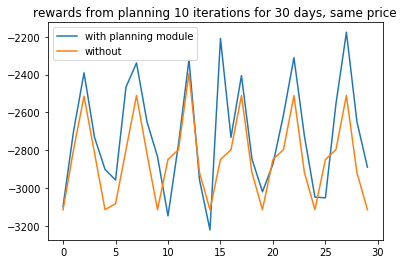

In [36]:
plt.figure()
plt.plot(rewards_plan_10, label = "with planning module")
plt.plot(rewards_10, label = "without")
plt.legend()
plt.title("rewards from planning 10 iterations for 30 days, same price")
plt.show()

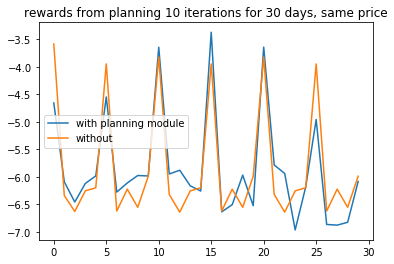

In [86]:
plt.figure()
plt.plot(rewards_plan_10, label = "with planning module")
plt.plot(rewards_10, label = "without")
plt.legend()
plt.title("rewards from planning 10 iterations for 30 days, same price")
plt.show()

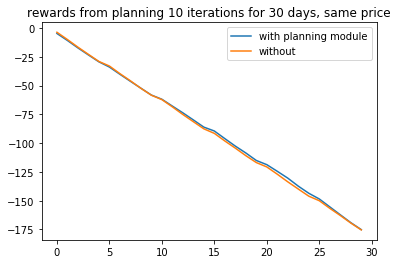

In [87]:
plt.figure()
plt.plot(np.cumsum(rewards_plan_10), label = "with planning module")
plt.plot(np.cumsum(rewards_10), label = "without")
plt.legend()
plt.title("rewards from planning 10 iterations for 30 days, same price")
plt.show()

## Batch size 

In [91]:
rewards_batch_5, planning_10_b_5 = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 10, 
         batch_size_agent = 5                                                                                                                                
         )

BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18
Day: 19
Day: 20
Day: 21
Day: 22
Day: 23
Day: 24
Day: 25
Day: 26
Day: 27
Day: 28
Day: 29
Day: 30
Day: 31
Loaded model from disk
--------------------
 planning step 0
action: [1.0000000e+01 8.3802271e-01 0.0000000e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 7.5445175e-03 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 1
action: [1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00 2.398014e-03
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 2
action: [10.        9.999994  0.        0.        0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 3
action: [10.       10.        0.        0.        0.       10.       10.
  9.999994 10.       10.      ]
--------------------
 planning step 4
action: [

--------------------
 planning step 5
action: [10.         9.998646   0.         0.        10.        10.
 10.        10.        10.         1.2390308]
--------------------
 planning step 6
action: [1.0000000e+01 3.2510757e-03 0.0000000e+00 0.0000000e+00 1.0000000e+01
 1.0000000e+01 1.0000000e+01 9.9999657e+00 1.0000000e+01 2.3277724e+00]
--------------------
 planning step 7
action: [10.          2.806908    0.          0.          9.966815   10.
 10.          0.16495943 10.          1.8750224 ]
--------------------
 planning step 8
action: [10.         3.3805451  0.         0.        10.        10.
 10.        10.        10.         1.4924364]
--------------------
 planning step 9
action: [10.         0.         0.         0.         9.99324   10.
 10.         9.991592  10.         1.3283243]
--------------------------------------------------------------------------------
Day: 36
Loaded model from disk
--------------------
 planning step 0
action: [1.000000e+01 0.000000e+00 0.000000e

--------------------
 planning step 1
action: [1.0000000e+01 5.2404404e-04 0.0000000e+00 0.0000000e+00 1.0000000e+01
 1.0000000e+01 1.0000000e+01 1.6155243e-03 1.0000000e+01 1.4925003e-04]
--------------------
 planning step 2
action: [1.0000000e+01 1.3852334e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01
 1.0000000e+01 1.0000000e+01 9.9998150e+00 1.0000000e+01 7.8201294e-05]
--------------------
 planning step 3
action: [1.0000000e+01 2.7179718e-05 0.0000000e+00 0.0000000e+00 9.7363186e+00
 1.0000000e+01 1.0000000e+01 3.6245346e-02 1.0000000e+01 2.1457672e-05]
--------------------
 planning step 4
action: [1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00 1.000000e+01
 1.000000e+01 1.000000e+01 9.440395e+00 1.000000e+01 1.859665e-05]
--------------------
 planning step 5
action: [1.0000000e+01 9.9859400e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01
 1.0000000e+01 1.0000000e+01 4.3201447e-04 1.0000000e+01 6.8664551e-05]
--------------------
 planning step 6
action: [1.0000000e+01 1.56

--------------------
 planning step 6
action: [10.        9.964664  0.        0.        9.989224 10.       10.
  9.999953 10.        9.910683]
--------------------
 planning step 7
action: [10.          0.14221382  0.          0.          0.53164005 10.
 10.          0.         10.          9.750158  ]
--------------------
 planning step 8
action: [1.0000000e+01 3.5285950e-05 0.0000000e+00 0.0000000e+00 1.3828278e-05
 1.0000000e+01 1.0000000e+01 9.9711075e+00 1.0000000e+01 9.6530342e+00]
--------------------
 planning step 9
action: [10.        9.84486   0.        0.        9.992941 10.       10.
 10.       10.        9.670914]
--------------------------------------------------------------------------------
Day: 45
Loaded model from disk
--------------------
 planning step 0
action: [1.0000000e+01 9.9999943e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01
 1.0000000e+01 1.0000000e+01 9.8965626e+00 1.0000000e+01 2.8133392e-05]
--------------------
 planning step 1
action: [1.0000000e+01 9.

--------------------
 planning step 1
action: [10.        0.        0.        0.        9.999999 10.       10.
  9.999998 10.        9.904933]
--------------------
 planning step 2
action: [1.0000000e+01 4.1961670e-05 0.0000000e+00 0.0000000e+00 2.2983551e-04
 1.0000000e+01 1.0000000e+01 2.2697449e-04 1.0000000e+01 9.8368454e+00]
--------------------
 planning step 3
action: [10.          0.          0.          0.          0.13268042 10.
 10.         10.         10.          9.691889  ]
--------------------
 planning step 4
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.3900566e-01
 1.0000000e+01 1.0000000e+01 2.4318695e-05 1.0000000e+01 9.6196251e+00]
--------------------
 planning step 5
action: [10.          0.          0.          0.          0.31747723 10.
 10.         10.         10.          9.52305   ]
--------------------
 planning step 6
action: [1.00000000e+01 1.18255615e-04 0.00000000e+00 0.00000000e+00
 1.00000000e+01 1.00000000e+01 1.00000000e+01 1.00

--------------------
 planning step 6
action: [10.         1.1333969  0.         0.         9.992041  10.
 10.         0.        10.         9.737755 ]
--------------------
 planning step 7
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 9.0287676e+00
 1.0000000e+01 1.0000000e+01 3.8146973e-06 1.0000000e+01 5.0800586e+00]
--------------------
 planning step 8
action: [1.0000000e+01 1.2578964e-03 0.0000000e+00 0.0000000e+00 1.1257410e-01
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 3.7929487e-01]
--------------------
 planning step 9
action: [10.         10.          0.          0.          1.6004276  10.
 10.          9.999996   10.          0.08927679]
--------------------------------------------------------------------------------
Day: 54
Loaded model from disk
--------------------
 planning step 0
action: [1.0000000e+01 1.9868374e-02 0.0000000e+00 0.0000000e+00 9.9999561e+00
 1.0000000e+01 1.0000000e+01 5.4359436e-05 1.0000000e+01 8.2165432e+00]
--------

--------------------
 planning step 1
action: [1.000000e+01 9.155741e+00 0.000000e+00 0.000000e+00 5.493164e-03
 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 9.959510e+00]
--------------------
 planning step 2
action: [1.0000000e+01 7.1525574e-06 0.0000000e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 1.3351440e-05 1.0000000e+01 9.8242321e+00]
--------------------
 planning step 3
action: [1.000000e+01 9.889098e+00 0.000000e+00 0.000000e+00 6.234646e-03
 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 9.641890e+00]
--------------------
 planning step 4
action: [10.       10.        0.        0.        0.       10.       10.
  7.954013 10.        9.450445]
--------------------
 planning step 5
action: [10.        9.999947  0.        0.        0.       10.       10.
  9.890186 10.        9.339602]
--------------------
 planning step 6
action: [1.0000000e+01 5.5206299e-02 0.0000000e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 1.1920929e-05 1.00000

In [92]:
rewards_batch_15, planning_10_b_15 = train(
         response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 10, 
         batch_size_agent = 15                                                                                                                                
         )

BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18
Day: 19
Day: 20
Day: 21
Day: 22
Day: 23
Day: 24
Day: 25
Day: 26
Day: 27
Day: 28
Day: 29
Day: 30
Day: 31
Loaded model from disk
--------------------
 planning step 0
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 1
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 2
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 3
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 4
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 5
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 6
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 7
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0

Loaded model from disk
--------------------
 planning step 0
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 1
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 2
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 3
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 4
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 5
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 6
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 7
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 8
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 9
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------------------------------------------------------------------
Day: 40
Loaded m

--------------------
 planning step 3
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 4
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 5
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 6
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 7
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 8
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 9
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------------------------------------------------------------------
Day: 48
Loaded model from disk
--------------------
 planning step 0
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 1
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 2
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------

--------------------
 planning step 6
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 7
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 8
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 9
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------------------------------------------------------------------
Day: 56
Loaded model from disk
--------------------
 planning step 0
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 1
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 2
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 3
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 4
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------------------
 planning step 5
action: [10.  0.  0. 10.  0. 10. 10.  0. 10.  0.]
--------

In [93]:
rewards_batch_30,_,_,_,_, planning_10_b_30 = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 10, 
         batch_size_agent = 30                                                                                                                               
         )

TypeError: train() got an unexpected keyword argument 'batch_size_agent_training'

In [44]:
rewards_p_50_batch_5,_,_,_,_, planning_50_b_5 = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 50, 
         batch_size_agent_training = 5                                                                                                                               
         )

rewards_p_50_batch_20,_,_,_,_, planning_p_50_b_20 = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 50, 
         batch_size_agent_training = 20                                                                                                                               
         )

rewards_p_50_batch_50,_,_,_,_, planning_10_b_35 = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 50, 
         batch_size_agent_training = 35                                                                                                                                
         )

rewards_p_50_batch_50,_,_,_,_, planning_10_b_50 = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 50, 
         batch_size_agent_training = 50                                                                                                                               
         )

BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18
Day: 19
Day: 20
Day: 21
Day: 22
Day: 23
Day: 24
Day: 25
Day: 26
Day: 27
Day: 28
Day: 29
Day: 30
Day: 31
Loaded model from disk
--------------------
 planning step 0
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
--------------------
 planning step 1
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
--------------------
 planning step 2
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
--------------------
 planning step 3
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
--------------------
 planning step 4
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00
 0.0000000e+00 2.3841858e-06 1.0000000e+01 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 5
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00
 0.0000000e+00 4.7683716e-07 1.0000000e+01 

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  9.9999],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  0.0207],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(64342.578125, 30329.37890625, 223.3632049560547, -0.41975679993629456)
--------------------
--------------------
 planning step 16
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 9.3775e-03],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.9998e+00, 1.0000e+01, 1.0000e

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  9.9828],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(49285.5859375, 23395.89453125, 239.579833984375, -0.8261758089065552)
--------------------
--------------------
 planning step 27
action: [0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01 0.000000e+00
 0.000000e+00 2.861023e-06 1.000000e+01 1.000000e+01 0.000000e+00]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         2.1458e-05, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9762e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         2.1458e-05, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9762e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9762e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(37947.69921875, 14736.265625, 263.78167724609375, -1.228877305984497)
--------------------
--------------------
 planning step 37
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         6.7234e-05, 1.0000e+01, 1.0000e+0

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9993e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9993e+00, 1.0000e+01, 1.0000e+01, 2.1982e-03]])
(32035.19921875, 12103.7626953125, 275.67962646484375, -1.5164438486099243)
--------------------
--------------------
 planning step 47
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9997e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9997e+00, 1.0000e+01, 1.0000e+01, 1.9237e-02],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9997e+00, 1.0000e+01, 1.0000e+01, 7.2002e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(21914.423828125, 7331.8134765625, 300.3596496582031, -1.929938554763794)
--------------------
--------------------
 planning step 8
action: [ 0.         10.          0.         10.          0.          0.
  0.16757011 10.         10.          0.        ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  5.2230, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  5.2249, 10.0000,
         10.0000, 10.0000]])
(14936.486328125, 3400.900390625, 336.5398254394531, -2.400470733642578)
--------------------
--------------------
 planning step 19
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00
 0.0000000e+00 2.1123886e-04 1.0000000e+01 1.0000000e+01 0.0000000e+00]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9999, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9999, 10.0000,
         10.0000,  0.0224],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9999, 10.0000,
         10.0000, 10.0000]])
(9035.38671875, 1090.583251953125, 362.44525146484375, -2.7177493572235107)
--------------------
--------------------
 planning step 30
action: [ 0.       10.        0.       10.        0.        0.        9.285218
 10.       10.        0.      ]
tensor([[ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.

tensor([[ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.]])
(6266.9775390625, 753.3527221679688, 399.8752136230469, -3.323507785797119)
--------------------
--------------------
 planning step 41
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0490e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  9.9973],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  9.7089],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(671.4032592773438, 270.59814453125, 418.9913024902344, -3.7263541221618652)
--------------------
--------------------
 planning step 3
action: [ 0.        10.         0.        10.         0.         0.
  3.9505544 10.        10.         0.       ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.00

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9995, 10.0000,
         10.0000,  9.9858],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  9.7705,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(1798.197998046875, 1254.2222900390625, 437.97540283203125, -4.160799503326416)
--------------------
--------------------
 planning step 14
action: [ 0.         10.          0.         10.          0.          0.
  0.02089071 10.         10.          0.        ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
 

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(1206.34716796875, 1123.3511962890625, 429.62249755859375, -4.5645365715026855)
--------------------
--------------------
 planning step 25
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  2.2797],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(1153.17041015625, 1062.59619140625, 432.97784423828125, -4.911655902862549)
--------------------
--------------------
 planning step 36
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  0.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  0.7687],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(1457.5164794921875, 1151.573486328125, 450.12158203125, -5.604670524597168)
--------------------
--------------------
 planning step 48
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  0.1377],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  9.8510],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(1142.6209716796875, 1054.387939453125, 455.29962158203125, -5.97343635559082)
--------------------
--------------------
 planning step 9
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  1.2214, 10.0000,
         10.0000,  0.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.8760, 10.0000,
         10.0000, 10.0000]])
(1125.6904296875, 928.3710327148438, 450.2249450683594, -6.442151069641113)
--------------------
--------------------
 planning step 21
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.00

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9999, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9999, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  9.9889],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(1003.4168701171875, 904.5487060546875, 436.1976623535156, -6.669957637786865)
--------------------
--------------------
 planning step 32
action: [ 0.       10.        0.       10.        0.        0.        9.999406
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.00

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  9.9578],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(2282.394775390625, 2034.4293212890625, 480.520263671875, -6.970910549163818)
--------------------
--------------------
 planning step 44
action: [ 0.       10.        0.       10.        0.        0.        9.999985
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  0.5081],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.000

tensor([[ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.]])
(2534.019287109375, 2724.208251953125, 475.18255615234375, -7.462204933166504)
--------------------
--------------------
 planning step 6
action: [ 0.       10.        0.       10.        0.        0.        9.999999
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  0.1180],
        [ 0.00

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(1842.3436279296875, 1874.5177001953125, 496.12933349609375, -8.34123706817627)
--------------------
--------------------
 planning step 18
action: [ 0.       10.        0.       10.        0.        0.        9.919449
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0

tensor([[ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.]])
(3479.397705078125, 3923.103515625, 476.42132568359375, -8.688093185424805)
--------------------
--------------------
 planning step 29
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0014e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000

tensor([[ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.]])
(3696.68798828125, 3373.604736328125, 562.8694458007812, -9.441850662231445)
--------------------
--------------------
 planning step 40
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  4.6654],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  9.9999],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9998, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9998, 10.0000,
         10.0000, 10.0000]])
(2074.3046875, 2242.832275390625, 473.2066955566406, -9.373174667358398)
--------------------
--------------------
 planning step 2
action: [ 0.        10.         0.        10.         0.         0.
  5.1472445 10.        10.         0.       ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9995e+00, 1.0000e+01, 1.0000e+01, 2.7495e-02],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9999, 10.0000,
         10.0000,  9.9936]])
(819.2720947265625, 958.3482666015625, 507.50994873046875, -9.750944137573242)
--------------------
--------------------
 planning step 13
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         8.9980e+00, 1.0000e+01, 1.0000e+01, 2.7514e-04],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9991e+00, 1.0000e+01, 1.0000e+01, 

tensor([[ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.]])
(3437.862060546875, 3365.01220703125, 533.1427001953125, -10.141077041625977)
--------------------
--------------------
 planning step 24
action: [ 0.       10.        0.       10.        0.        0.        9.999996
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.00

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  0.0182],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(2769.6171875, 2261.50146484375, 563.7410278320312, -10.545669555664062)
--------------------
--------------------
 planning step 36
action: [ 0.       10.        0.       10.        0.        0.        9.932902
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  9

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         7.5462e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         7.5719e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         7.4387e-05, 1.0000e+01, 1.0000e+01, 3.0707e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         7.5340e-05, 1.0000e+01, 1.0000e+01, 9.5843e+00]])
(2308.4423828125, 2099.221435546875, 544.3853759765625, -11.636086463928223)
--------------------
--------------------
 planning step 47
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.6554e+00, 1.0000e+01, 1.0

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(2904.369140625, 3469.96044921875, 535.012939453125, -11.858782768249512)
--------------------
--------------------
 planning step 7
action: [ 0.       10.        0.       10.        0.        0.        9.999939
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  1.1800,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10

tensor([[ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10., 10., 10.]])
(1366.0458984375, 1221.4656982421875, 580.10498046875, -12.070043563842773)
--------------------
--------------------
 planning step 19
action: [ 0.       10.        0.       10.        0.        0.        9.999993
 10.       10.        0.      ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         3.4380e-04, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         3.4428e-04, 1.0000e+01, 1.0000e+01, 4.7684e-07]])
(2576.849853515625, 2354.380615234375, 549.7297973632812, -12.575872421264648)
--------------------
--------------------
 planning step 30
action: [ 0.       10.        0.       10.        0.        0.        9.999966
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  0.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  9.9999],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(2414.68408203125, 2527.666015625, 589.9937744140625, -13.185220718383789)
--------------------
--------------------
 planning step 40
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  9.9998],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.000

--------------------------------------------------------------------------------
Day: 38
Loaded model from disk
--------------------
 planning step 0
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.3622e+00, 1.0000e+01, 1.0000e+01, 6.2418e-04],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9039e+00, 1.0000e+01, 1.0000e+01, 2.1982e+00]])
(2585.98046875, 2759.878662109375, 622.7901611328125, -13.678995132446289)
--------------------
--------

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  0.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  6.7489],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  7.8763],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(3721.060791015625, 3002.41357421875, 623.9376220703125, -13.920623779296875)
--------------------
--------------------
 planning step 12
action: [ 0.       10.        0.       10.        0.        0.        9.979483
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9691, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(3601.637451171875, 3528.818603515625, 620.560546875, -14.426547050476074)
--------------------
--------------------
 planning step 23
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.9073486e-06 1.0000000e+01 1.0000000e+01 0.0000000e+00]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.00

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  9.8528],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  5.2338]])
(3638.539794921875, 3149.77099609375, 623.2703247070312, -15.101223945617676)
--------------------
--------------------
 planning step 34
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  0.4197],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9979, 10.0000,
         10.0000,  0.1685],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(4061.612060546875, 3743.8134765625, 687.2478637695312, -15.176050186157227)
--------------------
--------------------
 planning step 45
action: [ 0.       10.        0.       10.        0.        0.        9.989588
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9865, 10.0000,
         10.0000,  0.1145],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9455, 10.0000,
         10.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         5.5506e+00, 1.0000e+01, 1.0000e+01, 2.8133e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         6.7020e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9381e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(1564.953857421875, 1244.8414306640625, 640.0086059570312, -15.414373397827148)
--------------------
--------------------
 planning step 5
action: [ 0.         10.          0.         10.          0.          0.
  0.01934147 10.         10.          0.        ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.4940, 10.0000,
         10.0000,  9.9629],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(7758.36767578125, 7025.07763671875, 609.025390625, -15.954092025756836)
--------------------
--------------------
 planning step 16
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9999, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  8.8623, 10.0000,
         10.0000,  6.5043],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  9.8557],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(3631.504638671875, 4367.76806640625, 621.2003173828125, -16.638843536376953)
--------------------
--------------------
 planning step 27
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9930, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9797, 10.0000,
         10.0000,  9.9944],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  8.7958, 10.0000,
         10.0000,  9.8778]])
(3547.167724609375, 3522.229248046875, 634.5309448242188, -17.055383682250977)
--------------------
--------------------
 planning step 38
action: [ 0.       10.        0.       10.        0.        0.        9.999998
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.1651, 10.0000,
         10.00

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(4677.07421875, 4211.84033203125, 686.545166015625, -17.622608184814453)
--------------------
--------------------
 planning step 49
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9988, 10.0000,
         10.0000,  9.9969],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  9.8724],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9985, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.6094, 10.0000,
         10.0000,  0.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9884, 10.0000,
         10.0000,  0.0000]])
(5218.08642578125, 5160.7138671875, 669.3204345703125, -17.018177032470703)
--------------------
--------------------
 planning step 10
action: [ 0.       10.        0.       10.        0.        0.        9.999999
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9937, 10.0000,
         10.0000,

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9993, 10.0000,
         10.0000,  0.1283],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9938, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(3472.358642578125, 4664.6396484375, 688.9940185546875, -18.670917510986328)
--------------------
--------------------
 planning step 21
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         7.9256e+00, 1.0000e+01, 1.0000e+01, 4.7684e-07],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9994e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9994e+00, 1.0000e+01, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9994e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.6892e+00, 1.0000e+01, 1.0000e+01, 4.7684e-07]])
(2693.672119140625, 2601.4775390625, 724.1568603515625, -18.507186889648438)
--------------------
--------------------
 planning step 31
action: [ 0.       10.        0.       10.        0.        0.        9.999782
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  8.4971, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.7897, 10.0000,
         10.0000,  9.9925],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.8944, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(3729.18701171875, 4277.81982421875, 742.9782104492188, -18.973712921142578)
--------------------
--------------------
 planning step 41
action: [ 0.       10.        0.       10.        0.        0.        9.993992
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9972, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9986e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9896e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         7.2954e+00, 1.0000e+01, 1.0000e+01, 1.6689e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(9226.04296875, 8718.4619140625, 700.44189453125, -19.385482788085938)
--------------------
--------------------
 planning step 2
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         4.1656e-03, 1.0000e+01, 1.0000e+01, 2.6881e-01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         2.1396e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(2102.24951171875, 2657.8505859375, 705.1033325195312, -19.23914909362793)
--------------------
--------------------
 planning step 12
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  9.9967],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9977, 10.0000,
         10.0000,  0.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(3240.1611328125, 3551.6044921875, 761.6050415039062, -19.696117401123047)
--------------------
--------------------
 planning step 23
action: [ 0.       10.        0.       10.        0.        0.        9.990933
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  9.9543,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0162, 10.0000,
         10.0000,  9.9998],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9415, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.8701, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.5549, 10.0000,
         10.0000,  9.9980]])
(9203.11328125, 7899.47998046875, 723.5654907226562, -20.694499969482422)
--------------------
--------------------
 planning step 34
action: [ 0.       10.        0.       10.        0.        0.        9.953878
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9076, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9387, 10.0000,
         10.0000, 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9994e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.9970e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         2.9432e-02, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         3.4332e-05, 1.0000e+01, 1.0000e+01, 9.9996e+00]])
(5690.6943359375, 5489.36083984375, 755.1437377929688, -21.20343780517578)
--------------------
--------------------
 planning step 44
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         5.1419e+00, 1.0000e+01, 1.000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9933, 10.0000,
         10.0000,  3.7583],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9986, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9986, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(8319.224609375, 7772.251953125, 777.7630615234375, -21.247203826904297)
--------------------
--------------------
 planning step 4
action: [ 0.        10.         0.        10.         0.         0.
  0.5986266 10.        10.         0.       ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.2282, 10.0000,
         10.0000,  5.5137],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9979, 10.0000,
         10.0000, 

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9970, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.2290, 10.0000,
         10.0000,  0.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9970, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9503, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(8343.193359375, 7751.00732421875, 772.1077880859375, -21.773014068603516)
--------------------
--------------------
 planning step 15
action: [ 0.        10.         0.        10.         0.         0.
  0.0211935 10.        10.         0.       ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         6.0755e-02, 1.0000e+01, 1.0000e+01, 6.6653e-01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+0

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  5.9345, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.2821, 10.0000,
         10.0000,  7.8034],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  2.0390, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(12041.248046875, 11516.818359375, 830.5201416015625, -21.87778091430664)
--------------------
--------------------
 planning step 26
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.1444092e-05 1.0000000e+01 1.0000000e+01 0.0000000e+00]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9925e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+0

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         4.0784e-03, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9254e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(11914.3681640625, 11735.091796875, 732.2156982421875, -23.54311180114746)
--------------------
--------------------
 planning step 36
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.6498566e-04 1.0000000e+01 1.0000000e+01 0.0000000e+00]
tensor([[ 0.0000, 

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         8.4972e-04, 1.0000e+01, 1.0000e+01, 9.9616e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         5.5956e-01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         6.1182e-02, 1.0000e+01, 1.0000e+01, 1.5020e-04]])
(3834.738037109375, 4429.7353515625, 824.0011596679688, -22.954612731933594)
--------------------
--------------------
 planning step 46
action: [ 0.        10.         0.        10.         0.         0.
  0.3060956 10.        10.         0.       ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         3.3379e-06, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.7785e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         8.9337e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 5.9529e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00]])
(6796.24560546875, 6655.611328125, 871.5149536132812, -23.089473724365234)
--------------------
--------------------
 planning step 5
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.5367e-07, 1.0000e+01, 1.0000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(11248.1376953125, 9417.4814453125, 770.92041015625, -23.968135833740234)
--------------------
--------------------
 planning step 15
action: [ 0.         10.          0.         10.          0.          0.
  0.04118729 10.         10.          0.        ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
       

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  9.9999],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(5751.990234375, 6529.119140625, 849.9295043945312, -24.772571563720703)
--------------------
--------------------
 planning step 27
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9825, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9825, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9994, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9688, 10.0000,
         10.0000, 10.0000]])
(1269.51025390625, 1986.3492431640625, 868.7867431640625, -25.13241195678711)
--------------------
--------------------
 planning step 38
action: [0.00000e+00 1.00000e+01 0.00000e+00 1.00000e+01 0.00000e+00 0.00000e+00
 3.33786e-06 1.00000e+01 1.00000e+01 0.00000e+00]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.5717e-03, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9999, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0465, 10.0000,
         10.0000,  0.0914],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.4703, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9995, 10.0000,
         10.0000, 10.0000]])
(8370.2392578125, 8560.125, 893.9146728515625, -25.096355438232422)
--------------------
--------------------
 planning step 47
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9986e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9996e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01]

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.2321, 10.0000,
         10.0000,  9.9972],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9999, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9997, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  1.8633, 10.0000,
         10.0000,  0.8434]])
(8257.4501953125, 9299.9990234375, 864.5887451171875, -26.149089813232422)
--------------------
--------------------
 planning step 7
action: [ 0.       10.        0.       10.        0.        0.        9.999903
 10.       10.        0.      ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9185e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.5141e-02, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.1553e-05, 1.0000e+01, 1.0000e+01, 2.6840e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         2.0307e-02, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         5.1024e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.1076e-05, 1.0000e+01, 1.0000e+01, 0.0000e+00]])
(5047.60791015625, 5322.0517578125, 886.2360229492188, -25.85394859313965)
--------------------
--------------------
 planning step 17
action: [ 0.         10.          0.         10.          0.          0.
  0.17611885 10.         10.          0.        ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(7569.9765625, 8530.890625, 849.0617065429688, -26.644433975219727)
--------------------
--------------------
 planning step 27
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9984, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         8.5669e-03, 1.0000e+01, 1.0000e+01, 5.7466e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9998e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         8.5669e-03, 1.0000e+01, 1.0000e+01, 9.9933e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         8.6288e-03, 1.0000e+01, 1.0000e+01, 9.9941e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         7.5054e-04, 1.0000e+01, 1.0000e+01, 1.1109e-02]])
(2727.15576171875, 3546.1904296875, 895.5491333007812, -27.32412338256836)
--------------------
--------------------
 planning step 38
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         5.1461e-02, 1.0000e+01, 1.000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         7.6294e-06, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         4.7684e-07, 1.0000e+01, 1.0000e+01, 9.9998e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.6428e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.3298e-02, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0829e-03, 1.0000e+01, 1.0000e+01, 2.3022e-02]])
(11976.025390625, 10924.1181640625, 892.4109497070312, -27.50165367126465)
--------------------
--------------------
 planning step 48
action: [ 0.       10.        0.       10.        0.        0.        9.962309
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9995e+00, 1.0000e+01, 1.0000e+01, 7.7584e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9120e+00, 1.0000e+01, 1.0000e+01, 9.6795e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9998e+00, 1.0000e+01, 1.0000e+01, 3.8147e-06],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9998e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(7002.509765625, 7610.60205078125, 956.4385986328125, -27.098119735717773)
--------------------
--------------------
 planning step 8
action: [ 0.       10.        0.       10.        0.        0.        9.997561
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.00

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 2.2073e-03],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         5.4847e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         8.9821e-01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 8.9645e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         8.9821e-01, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(3895.125732421875, 4431.6552734375, 916.9678955078125, -28.853839874267578)
--------------------
--------------------
 planning step 18
action: [ 0.       10.        0.       10.        0.        0.        9.471036
 10.       10.        0.      ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9999, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9877, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9877, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9964, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(13135.9462890625, 13276.626953125, 965.5963134765625, -28.816329956054688)
--------------------
--------------------
 planning step 28
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.9073486e-06 1.0000000e+01 1.0000000e+01 0.0000000e+00]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.1539e-04, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         6.4668e-02, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         2.3160e-01, 1.0000e+01, 1.0000e+01, 9.5367e-07],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9996e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9899e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(14604.6474609375, 15273.0966796875, 990.5216064453125, -28.789630889892578)
--------------------
--------------------
 planning step 38
action: [ 0.       10.        0.       10.        0.        0.        9.999458
 10.       10.        0.      ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9999e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.9768e+00, 1.0000e+01, 1.0000e+01, 7.3624e-04],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9984e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.4434e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 8.8490e+00, 1.0000e+01, 1.0000e+01]])
(2314.943115234375, 2951.509033203125, 973.2517700195312, -29.152667999267578)
--------------------
--------------------
 planning step 48
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         8.9012e+00, 1.0000e+01, 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         4.1318e-03, 1.0000e+01, 1.0000e+01, 7.1879e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.2398e-05, 1.0000e+01, 1.0000e+01, 9.2843e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         2.2025e-02, 1.0000e+01, 1.0000e+01, 8.2828e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9699e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.5367e-07, 1.0000e+01, 1.0000e+01, 0.0000e+00]])
(7007.1904296875, 7302.16357421875, 930.2498168945312, -29.611013412475586)
--------------------
--------------------
 planning step 8
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  2.2081, 10.0000,
         10.0000, 10.0000],
        [ 

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         4.7684e-07, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9387e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 3.4552e-03],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         2.2474e-02, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 2.2074e+00]])
(12568.65625, 12017.2744140625, 960.5208740234375, -30.705120086669922)
--------------------
--------------------
 planning step 18
action: [0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01 0.000000e+00
 0.000000e+00 5.078316e-04 1.000000e+01 1.000000e+01 0.000000e+00]
tensor([[0.0000e+00, 1.0000e+01

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  1.1587],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(4554.97509765625, 4835.390625, 980.447265625, -30.73653221130371)
--------------------
--------------------
 planning step 27
action: [ 0.       10.        0.       10.        0.        0.        9.999811
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9999, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         5.1236e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         7.5030e-03, 1.0000e+01, 1.0000e+01, 4.1549e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         8.2016e-05, 1.0000e+01, 1.0000e+01, 1.2875e-04],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         7.5340e-05, 1.0000e+01, 1.0000e+01, 2.0981e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         5.1137e+00, 1.0000e+01, 1.0000e+01, 9.9938e+00]])
(8047.39453125, 9057.5, 1054.170654296875, -29.81414794921875)
--------------------
--------------------
 planning step 37
action: [ 0.       10.        0.       10.        0.        0.        8.909769
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.9620

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9998e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9998e+00, 1.0000e+01, 1.0000e+01, 1.3507e-01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9998e+00, 1.0000e+01, 1.0000e+01, 1.3828e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(14216.47265625, 13928.2939453125, 977.1246337890625, -32.103363037109375)
--------------------
--------------------
 planning step 47
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9764e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         2.9087e-05, 1.0000e+01, 1.0000e+01, 6.6204e-03],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         2.8610e-06, 1.0000e+01, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.8937e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9771e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(14555.177734375, 14005.6494140625, 1055.6470947265625, -32.63862228393555)
--------------------
--------------------
 planning step 8
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00
 0.0000000e+00 4.7683716e-07 1.0000000e+01 1.0000000e+01 0.0000000e+00]
tensor([[0.0000e+0

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         3.8147e-06, 1.0000e+01, 1.0000e+01, 1.6634e-02],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         6.5327e-04, 1.0000e+01, 1.0000e+01, 3.0518e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.1288e-01, 1.0000e+01, 1.0000e+01, 9.9997e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.5694e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         6.5279e-04, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(20289.576171875, 19362.01953125, 1008.4447021484375, -32.139434814453125)
--------------------
--------------------
 planning step 17
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.6813e-03, 1.0000e+01, 1.000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         5.7432e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9978e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.6933e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         4.9109e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         2.4796e-05, 1.0000e+01, 1.0000e+01, 0.0000e+00]])
(7831.12890625, 9490.5107421875, 1059.795166015625, -32.94496154785156)
--------------------
--------------------
 planning step 26
action: [ 0.       10.        0.       10.        0.        0.        7.101547
 10.       10.        0.      ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.00

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.7847, 10.0000,
         10.0000,  9.9886],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9276, 10.0000,
         10.0000,  9.9885],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9999, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0603, 10.0000,
         10.0000,  0.0000]])
(27768.279296875, 23588.05078125, 1141.4293212890625, -33.15435791015625)
--------------------
--------------------
 planning step 36
action: [ 0.       10.        0.       10.        0.        0.        8.224684
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  7.1985, 10.0000,
         10.0000,  7.4199],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0206, 10.0000,
         10.0000,  

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         7.1573e-03, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         3.8147e-05, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.8748e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9715e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         4.9055e-01, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(16184.80859375, 17014.3828125, 985.421875, -31.577129364013672)
--------------------
--------------------
 planning step 46
action: [ 0.         10.          0.         10.          0.          0.
  0.01206017 10.         10.          0.        ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9040, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9784,  9.9957,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(12467.1005859375, 12429.734375, 1157.3680419921875, -34.01825714111328)
--------------------
--------------------
 planning step 6
action: [ 0.       10.        0.       10.        0.        0.        9.999356
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0125, 10.0000,
         10.0000,  0.5164],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9979, 10.0000,
         10.0000, 10.

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.2599e+00, 1.0000e+01, 1.0000e+01, 9.9994e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9988e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.2947e-01, 1.0000e+01, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.1444e-05, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.7772e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(16622.650390625, 16341.193359375, 1061.364013671875, -34.327022552490234)
--------------------
--------------------
 planning step 16
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00
 0.0000000e+00 4.7683716e-07 1.0000000e+01 1.0000000e+01 0.0000000e+00]
tensor([[0.0000e+0

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9998e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9993e+00, 5.6389e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         4.4217e-03, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         4.3535e-04, 1.0000e+01, 1.0000e+01, 1.2838e-01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9834e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(20887.45703125, 18272.9375, 1196.632568359375, -35.167198181152344)
--------------------
--------------------
 planning step 25
action: [ 0.       10.        0.       10.        0.        0.        9.996803
 10.       10.        0.      ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.3466, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  7.8616, 10.0000,
         10.0000,  0.2537],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9714, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9997, 10.0000,
         10.0000, 10.0000]])
(8094.5244140625, 7653.349609375, 1071.2584228515625, -34.12086486816406)
--------------------
--------------------
 planning step 35
action: [ 0.        10.         0.        10.         0.         0.
  1.7209256 10.        10.         0.       ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9999e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         6.8874e-02, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         6.3633e-02, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 8.8726e-02],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 2.8419e-04],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0109e-04, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(25649.37890625, 23400.921875, 1113.8447265625, -35.22382354736328)
--------------------
--------------------
 planning step 45
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00
 0.0000000e+00 3.2310486e-03 1.0000000e+01 1.0000000e+01 0.0000000e+00]
tensor([[0.0000e+00, 1.00

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9987e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         8.6921e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         3.8309e-03, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.4688e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.4689e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(6825.2099609375, 6241.751953125, 1130.478759765625, -35.278099060058594)
--------------------
--------------------
 planning step 4
action: [ 0.        10.         0.        10.         0.         0.
  2.1990752 10.        10.         0.       ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9931, 10.0000,
         10.0000,  0.0891]])
(8068.2509765625, 7804.86474609375, 1127.6768798828125, -37.053123474121094)
--------------------
--------------------
 planning step 14
action: [ 0.         10.          0.         10.          0.          0.
  0.04540396 10.         10.          0.        ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9988, 10.0000,
         10.0000,  7.9890],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9988, 10.0000,
    

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.2776, 10.0000,
         10.0000,  9.9310],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(23330.017578125, 24028.51171875, 1235.5677490234375, -36.61212921142578)
--------------------
--------------------
 planning step 25
action: [ 0.       10.        0.       10.        0.        0.        9.999044
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9999, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.2488e-02, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.7856e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.0599e-06, 1.0000e+01, 1.0000e+01, 7.7884e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00]])
(15470.876953125, 16295.0712890625, 1248.88232421875, -35.934730529785156)
--------------------
--------------------
 planning step 35
action: [ 0.       10.        0.       10.        0.        0.        9.999958
 10.       10.        0.      ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9977, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  7.9944, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9977, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9986, 10.0000,
         10.0000, 10.0000]])
(20422.43359375, 21621.759765625, 1213.584716796875, -36.99603271484375)
--------------------
--------------------
 planning step 45
action: [0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01 0.000000e+00
 0.000000e+00 9.536743e-07 1.000000e+01 1.000000e+01 0.000000e+00]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9266, 10.0000,
         10.0000,  5.7764],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0478, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  7.8207, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  7.7109, 10.0000,
         10.0000, 10.0000]])
(4725.833984375, 4436.69140625, 1248.585205078125, -37.38295364379883)
--------------------
--------------------
 planning step 5
action: [ 0.       10.        0.       10.        0.        0.        9.999781
 10.       10.        0.      ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         2.1649e-02, 1.0000e+01, 1.0000e+01, 3.5340e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9462, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.8456, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.8736, 10.0000,
         10.0000,  0.0356],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9462, 10.0000,
         10.0000, 10.0000]])
(26005.939453125, 24638.322265625, 1302.4801025390625, -37.89406967163086)
--------------------
--------------------
 planning step 15
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.4305115e-06 1.0000000e+01 1.0000000e+01 0.0000000e+00]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.00

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.5367e-07, 1.0000e+01, 1.0000e+01, 9.9415e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         5.3384e-02, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.7120e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.5569e-03, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.4639e-04, 1.0000e+01, 1.0000e+01, 9.9962e+00]])
(2968.360107421875, 3963.726318359375, 1205.388671875, -38.04132843017578)
--------------------
--------------------
 planning step 25
action: [0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01 0.000000e+00
 0.000000e+00 2.861023e-06 1.000000e+01 1.000000e+01 0.000000e+00]
tensor([[0.0000e+00, 1.0000e

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         3.7033e-01, 1.0000e+01, 1.0000e+01, 9.9983e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         8.8822e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         3.6798e-01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         3.8147e-06, 1.0000e+01, 1.0000e+01, 4.9543e-04],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9994e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(8461.451171875, 7859.3583984375, 1232.0869140625, -37.68339157104492)
--------------------
--------------------
 planning step 35
action: [ 0.       10.        0.       10.        0.        0.        9.999987
 10.       10.        0.      ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.2275, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  1.7614, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  4.9208, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  2.1332, 10.0000,
         10.0000,  9.9989],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0204, 10.0000,
         10.0000,  9.9982]])
(5572.84619140625, 6595.8251953125, 1301.838623046875, -38.99701690673828)
--------------------
--------------------
 planning step 45
action: [ 0.         10.          0.         10.          0.          0.
  0.33749628 10.         10.          0.        ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.3303e-01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         5.4359e-05, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.6780e+00]])
(20014.232421875, 20074.716796875, 1251.2679443359375, -41.14543533325195)
--------------------
--------------------
 planning step 5
action: [0.00000000e+00 1.00000000e+01 0.00000000e+00 1.00000000e+01
 0.00000000e+00 0.00000000e+00 1.04904175e-05 1.00000000e+01
 1.00000000e+01 0.00000000e+00]
tensor([

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 8.6007e-03],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(25225.357421875, 23952.3671875, 1347.6500244140625, -41.627784729003906)
--------------------
--------------------
 planning step 15
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         2.8610e-06, 1.0000e+01, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         5.0321e-03, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0014e-05, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.5367e-07, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(7653.732421875, 8248.87109375, 1315.538330078125, -41.05388641357422)
--------------------
--------------------
 planning step 25
action: [ 0.        10.         0.        10.         0.         0.
  0.3764615 10.        10.         0.       ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9998, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9998, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9998, 10.0000,
         10.0000, 10.0000]])
(9762.3779296875, 10695.24609375, 1228.2989501953125, -39.163543701171875)
--------------------
--------------------
 planning step 34
action: [ 0.         10.          0.         10.          0.          0.
  0.07265377 10.         10.          0.        ]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0674, 10.0000,
         10.0000,  9.9840],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9999, 10.0000,
      

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 2.3209e-02],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.7466e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         8.8847e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         2.0027e-05, 1.0000e+01, 1.0000e+01, 1.1512e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         2.0027e-05, 1.0000e+01, 1.0000e+01, 9.9985e+00]])
(44857.546875, 40167.48046875, 1414.183349609375, -39.869590759277344)
--------------------
--------------------
 planning step 44
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+0

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  4.8273],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  0.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  0.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000]])
(29588.85546875, 28989.873046875, 1413.450439453125, -42.127960205078125)
--------------------
--------------------
 planning step 4
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 2.4176e-04],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 2.0542

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000,  9.9998,
         10.0000,  9.9994],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000]])
(23393.140625, 21968.70703125, 1361.5589599609375, -43.259361267089844)
--------------------
--------------------
 planning step 15
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  9.9278],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  9.6532],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  9.9964]])
(27891.685546875, 26500.560546875, 1328.6329345703125, -44.16505813598633)
--------------------
--------------------
 planning step 25
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9852e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 3.50

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         3.3808e-04, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.7781e-03, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 4.6095e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00]])
(39954.8359375, 38598.3515625, 1405.296875, -43.513118743896484)
--------------------
--------------------
 planning step 35
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.1126e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         6.3544e-02, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9458e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         5.2452e-06, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         7.0333e-04, 1.0000e+01, 1.0000e+01, 9.5367e-07]])
(28956.50390625, 30633.33984375, 1386.2447509765625, -44.128997802734375)
--------------------
--------------------
 planning step 45
action: [ 0.       10.        0.       10.        0.        0.        9.853828
 10.       10.        0.      ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0359e-01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.1315e-03, 1.0000e+01, 1.0000e+01, 9.1988e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.5367e-07, 1.0000e+01, 1.0000e+01, 2.8896e-02],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.5367e-07, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         8.5831e-06, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(5842.322265625, 4325.259765625, 1378.424560546875, -44.74217987060547)
--------------------
--------------------
 planning step 5
action: [0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01 0.000000e+00
 0.000000e+00 6.246567e-05 1.000000e+01 1.000000e+01 0.000000e+00]
tensor([[0.0000e+00, 1.0000e+01,

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         2.0432e-02, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.8120e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         2.0290e-02, 1.0000e+01, 1.0000e+01, 9.9776e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         3.5907e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9986e+00]])
(30338.525390625, 31181.494140625, 1480.888427734375, -43.1224365234375)
--------------------
--------------------
 planning step 14
action: [ 0.      10.       0.      10.       0.       0.       9.95363 10.
 10.       0.     ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         5.3210e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9834e+00, 1.0000e+01, 1.0000e+01, 9.9510e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9998e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.0089e+00, 1.0000e+01, 1.0000e+01, 2.0862e-03]])
(8308.734375, 9426.6572265625, 1460.4915771484375, -45.28089141845703)
--------------------
--------------------
 planning step 24
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9931,  9.9869,
         10.0000,  0.0973],
        [ 0.00

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.8745e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         8.0927e-01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         4.7684e-06, 1.0000e+01, 1.0000e+01, 4.7684e-07],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         5.7697e-05, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         3.8824e-02, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(14183.6630859375, 15086.0498046875, 1411.71875, -44.581138610839844)
--------------------
--------------------
 planning step 34
action: [0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01 0.000000e+00
 0.000000e+00 9.536743e-07 1.000000e+01 1.000000e+01 0.000000e+00]
tensor([[0.0000e+00, 1.0000e+01, 

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9646, 10.0000,
         10.0000,  9.9962],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9957,  9.5016,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  8.4710, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9999, 10.0000,
         10.0000, 10.0000]])
(16724.419921875, 16702.48046875, 1499.570068359375, -43.85704803466797)
--------------------
--------------------
 planning step 44
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00
 0.0000000e+00 7.2407722e-03 1.0000000e+01 1.0000000e+01 0.0000000e+00]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         8.5409e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         3.2664e-01, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.6394e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.7183e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.5367e-07, 1.0000e+01, 1.0000e+01, 6.0840e-03],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         2.4405e-02, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(35177.015625, 32488.544921875, 1539.748291015625, -43.97488021850586)
--------------------
--------------------
 planning step 3
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.7795e+00, 1.0000e+01, 1.0000e+01

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9999, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  4.5013,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(15379.5224609375, 14874.7900390625, 1567.6650390625, -45.994834899902344)
--------------------
--------------------
 planning step 13
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000,  6.6599],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9562, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  2.4300, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(27311.810546875, 24875.220703125, 1448.3687744140625, -45.51793670654297)
--------------------
--------------------
 planning step 25
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.4212e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 1.0000e+01, 1.00

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         3.0215e-02, 2.1072e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         3.8147e-06, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.4219e-01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         6.0558e-05, 1.0000e+01, 1.0000e+01, 9.5847e+00]])
(33083.3671875, 31106.634765625, 1524.377197265625, -48.24242401123047)
--------------------
--------------------
 planning step 35
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         4.7684e-07, 1.0000e+01, 1.0000e+

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9823e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         4.2582e-03, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.5367e-07, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(15276.3037109375, 14976.732421875, 1611.9669189453125, -46.88572311401367)
--------------------
--------------------
 planning step 45
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         2.6436e-03, 1.0000e+01, 1.00

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9840e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9231e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         4.5109e-03, 1.0000e+01, 1.0000e+01, 8.6317e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9231e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9574e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(54319.58984375, 52945.40625, 1646.5640869140625, -47.22105026245117)
--------------------
--------------------
 planning step 4
action: [ 0.       10.        0.       10.        0.        0.        9.215369
 10.       10.        0.      ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         6.1974e+00, 1.0000e+01, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         6.0331e+00, 1.0000e+01, 1.0000e+01, 9.7173e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         8.8117e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.5901e-01, 1.0000e+01, 1.0000e+01, 6.0081e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9965e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(37613.92578125, 39975.7421875, 1633.6346435546875, -47.39942169189453)
--------------------
--------------------
 planning step 14
action: [ 0.         10.          0.         10.          0.          0.
  0.46919727 10.         10.          0.        ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.00

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.6284e-03, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         4.9310e-03, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9410e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         3.0996e-01, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(48012.0859375, 45498.5078125, 1610.3955078125, -49.00349044799805)
--------------------
--------------------
 planning step 24
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.8549e-04, 1.0000e+01, 1.0000e+01, 

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         4.7684e-07, 1.0000e+01, 1.0000e+01, 9.9995e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.4414e-05, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0490e-05, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9997e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.1683e-04]])
(15074.5322265625, 18509.265625, 1558.2337646484375, -50.265106201171875)
--------------------
--------------------
 planning step 33
action: [ 0.       10.        0.       10.        0.        0.        9.184799
 10.       10.        0.      ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  5.0714, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9927, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9978, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0133, 10.0000,
         10.0000,  9.5782],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  1.0705, 10.0000,
         10.0000,  0.0695]])
(11760.8447265625, 11979.3916015625, 1583.954833984375, -47.965267181396484)
--------------------
--------------------
 planning step 42
action: [ 0.       10.        0.       10.        0.        0.        9.999687
 10.       10.        0.      ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9254e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.1057, 10.0000,
         10.0000,  9.9983],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(5533.509765625, 7488.2041015625, 1607.6978759765625, -49.54450607299805)
--------------------
--------------------
 planning step 2
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00
 0.0000000e+00 3.4399033e-03 1.0000000e+01 1.0000000e+01 0.0000000e+00]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         6.6915e-02, 1.0000e+01, 1.0000e+01, 9.5367e-07],
        [0.0000e+00, 1.0000e+01

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         7.4557e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.3161e-04, 1.0000e+01, 1.0000e+01, 1.5186e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.3928e-03, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.3928e-03, 1.0000e+01, 1.0000e+01, 3.6650e-03],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.9990e+00, 9.9996e+00, 1.0000e+01, 1.0000e+01]])
(51060.95703125, 45667.28125, 1486.56689453125, -48.055755615234375)
--------------------
--------------------
 planning step 12
action: [0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01 0.000000e+00
 0.000000e+00 3.361702e-04 1.000000e+01 1.000000e+01 0.000000e+00]
tensor([[0.0000e+00, 1.0000e+01, 0

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  0.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  9.9994],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  9.5055]])
(33095.61328125, 33110.6640625, 1645.2008056640625, -51.719749450683594)
--------------------
--------------------
 planning step 22
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  0.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  8.1356],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.5367e-07],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 6.5846e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         9.5367e-07, 2.2016e-01, 1.0000e+01, 1.0000e+01]])
(12976.2265625, 14014.1962890625, 1578.487060546875, -53.249717712402344)
--------------------
--------------------
 planning step 33
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.5459e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.5367e-07],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         3.4761e-04, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9960e+00]])
(34302.04296875, 31704.47265625, 1589.6163330078125, -53.42351150512695)
--------------------
--------------------
 planning step 43
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.9997, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.3894, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.4787, 10.0000,
         10.0000,  0.0574],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000]])
(56116.1484375, 58598.47265625, 1626.5052490234375, -52.68572998046875)
--------------------
--------------------
 planning step 2
action: [ 0. 10.  0. 10.  0.  0. 10. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  5.3459, 10.0000,
         10.0000,  0.0121],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.7108, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  0.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  9.7102, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  2.0050, 10.0000,
         10.0000, 10.0000]])
(16947.330078125, 21528.482421875, 1685.345458984375, -53.299346923828125)
--------------------
--------------------
 planning step 12
action: [ 0.       10.        0.       10.        0.        0.        9.998569
 10.       10.        0.      ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.5259e-05, 9.9347e+00, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.9073e-06],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(21959.892578125, 22276.814453125, 1711.2584228515625, -54.14686965942383)
--------------------
--------------------
 planning step 23
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  9.9987],
        [ 

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.2398e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 2.7927e-02],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(45070.9453125, 41966.33984375, 1752.389404296875, -55.9499397277832)
--------------------
--------------------
 planning step 35
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 4.7684e-07],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 3.0597e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(65875.1015625, 66233.9921875, 1914.9609375, -55.894561767578125)
--------------------
--------------------
 planning step 46
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  4.9609],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000]])
(55517.4921875, 56003.1875, 1690.345703125, -55.90715789794922)
--------------------
--------------------
 planning step 6
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  0.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 3.4809e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 5.5504e-04]])
(50783.65625, 46308.07421875, 1853.076904296875, -56.4575309753418)
--------------------
--------------------
 planning step 17
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.7166e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9997e+00]])
(95084.546875, 87388.921875, 1970.9501953125, -57.0184440612793)
--------------------
--------------------
 planning step 27
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00
 0.0000000e+00 2.0980835e-05 1.0000000e+01 1.0000000e+01 0.0000000e+00]
tensor([[ 0.0000, 10.0000,  

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  0.7675],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  9.9996],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  0.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  0.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  2.8134]])
(28839.060546875, 29468.708984375, 1878.4537353515625, -57.67698287963867)
--------------------
--------------------
 planning step 39
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.00

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 2.8610e-06],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00]])
(47848.453125, 45842.3046875, 1916.55078125, -58.27557373046875)
--------------------
--------------------------------------------------------------------------------
Day: 59
Loaded model from disk
--------------------
 planning step 0
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+0

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.6732e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0009e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9682e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9484e+00]])
(45658.29296875, 44745.1953125, 1820.667724609375, -58.616790771484375)
--------------------
--------------------
 planning step 10
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.9073e-06],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 5.1752e-01]])
(27936.556640625, 32662.263671875, 1773.3179931640625, -58.48554611206055)
--------------------
--------------------
 planning step 21
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.8258e-03],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01]])
(48807.015625, 45870.5859375, 1879.274658203125, -59.78960037231445)
--------------------
--------------------
 planning step 32
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  2.4675],
        [ 0.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 5.4836e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00]])
(26417.328125, 27384.857421875, 1839.5377197265625, -59.59409713745117)
--------------------
--------------------
 planning step 43
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 7.4005e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 2.8610e-06],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 7.3685e+00]])
(68772.1875, 59125.60546875, 2132.06005859375, -59.614990234375)
--------------------
--------------------
 planning step 4
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.00

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 4.8833e-03],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 7.7990e-02]])
(22116.69921875, 22990.7421875, 1998.9654541015625, -60.77235794067383)
--------------------
--------------------
 planning step 15
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  9.9984],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000]])
(81994.3671875, 81315.6953125, 2050.904296875, -60.761993408203125)
--------------------
--------------------
 planning step 26
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  9.9999],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  0.0676],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  0.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000,  0.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000]])
(44749.59765625, 50032.44140625, 2044.0982666015625, -61.965362548828125)
--------------------
--------------------
 planning step 37
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 2.7804e-03],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 2.0180e-03],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00]])
(45557.91015625, 45881.69140625, 2020.972412109375, -62.510292053222656)
--------------------
--------------------
 planning step 48
action: [ 0. 10.  0. 10.  0.  0.  0. 10. 10.  0.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000,  0.0000, 10.0000,
         10.0000, 10.0000],
        [ 0.

tensor([[ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.6778e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.4305e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9994e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.2859e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.0599e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.5378e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9915e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.3879e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.4095e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.8301e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.6294e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5697e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.3938e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9990e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.8610e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9921e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.8291e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.2508e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.8342e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9997e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9978e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.6287e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.9924e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000, 10.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000, 10.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000, 10.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000, 10.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  9.9918,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000, 10.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000, 10.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000, 10.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000, 10.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

--------------------------------------------------------------------------------
Day: 32
Loaded model from disk
--------------------
 planning step 0
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0. 10.]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.7353e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9804e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0578,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  6.3711,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000, 10.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000, 10.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000, 10.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0983,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000, 10.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000, 10.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000, 10.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.8579e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0543e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9996e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.1739e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.5524e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.8588e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.4455e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.3634e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9978e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9975e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9564e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.0118e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9998e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.8760e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9975e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9985e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.4353e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9965e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9997e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.0242e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9960e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.8534e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9293e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0931e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.7969e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5709e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9999e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.3088e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.0981e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.4652e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.8987e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.6696e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.1002e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9998e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.7812e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9998e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.1075e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9994e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.6530e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9894e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.2561e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.8936e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9995e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.3432e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.8336e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9747e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.2907e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.2016e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0410e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9998e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.7189e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.0095e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.1210e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.6595e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9073e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.4305e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9793e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.6972e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9997e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.8056e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.9987e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.8895e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.8285e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9021e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.4295e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.6791e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.4796e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.1834e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.5676e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.8887e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9102e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.6794e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.5879e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.3392e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.3361e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.4809e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.2002e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.8147e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.8703e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.3520e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.8641e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.2079e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.9580e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.2970e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.1022e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.6294e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.3902e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9997e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.1757e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9598e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.9618e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.2452e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9967e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.4441e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.6073e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.8610e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.3883e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9911e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9714e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.4756e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9900e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.1731e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.7361e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9840e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.7786e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0152e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.0270e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.4836e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0018e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9726e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

--------------------------------------------------------------------------------
Day: 34
Loaded model from disk
--------------------
 planning step 0
action: [ 0.        10.         0.        10.         9.9987135  0.
 10.        10.         0.        10.       ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9910e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.8278e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9073e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9732e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.8517e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.1039e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.8487e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9524e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.6304e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.7066e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.8610e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.5007e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.6120e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.9052e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9569e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.7786e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.6006e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.2172e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9889e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.0218e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.7432e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9990e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.3842e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.3417e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9999e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.2452e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.2383e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9997e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.3198e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.8678e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.3004e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.2040e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.2623e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.0760e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.8493e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.8147e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.3638e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.2398e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9641e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.3652e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.4540e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.6019e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.5428e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.0504e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.5286e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.7193e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7289e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.1598e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.8743e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.5516e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.3379e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.5620e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.9639e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.9255e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.8969e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.4202e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.1605e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.2834e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.7411e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.3962e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9986e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.2793e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.5764e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.1715e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.2915e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.6558e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9991e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.1585e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.3882e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.9784e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.4836e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.4782e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.6047e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.7365e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.2915e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.0981e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9980e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.6342e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.3379e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.5111e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.8147e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.1151e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.1036e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.4915e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.5272e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.3890e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9931e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.1560e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.2663e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0681e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.4206e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.5831e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.3724e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.1526e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.9542e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9999e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.8733e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.3188e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.5831e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.8331e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9979e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.6225e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5686e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.1778e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.3685e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.1975e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.8147e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.4305e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.1746e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.6097e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.8610e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.3399e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.0384e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9581e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.0972e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9977e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9073e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9073e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.3461e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.8692e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.4877e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.6757e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0509e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.6212e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.8832e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.2627e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.1526e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.3842e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.0297e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.1015e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.6981e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.6529e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.6498e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9273e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.4418e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.2222e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.2043e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9983e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.8855e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.2001e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.3151e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.5068e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9992e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.3434e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.9051e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.1873e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.6757e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.5528e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9481e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.9449e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.7402e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.3869e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.1854e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.5152e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0538e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.7220e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.6294e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.5173e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

--------------------------------------------------------------------------------
Day: 37
Loaded model from disk
--------------------
 planning step 0
action: [ 0.        10.         0.        10.         2.3935046  0.
 10.        10.         0.        10.       ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.4897e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.2647e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.4332e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.0603e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.3902e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.1444e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.1526e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.6674e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0967e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.5831e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9999e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.5092e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.5345e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.1962e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9622e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.3939e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.6793e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.3610e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.7166e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0819e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.2354e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.5313e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.1305e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.1826e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.4257e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0977e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.7240e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.9967e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5832e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.0783e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9455e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.4775e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.5009e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.0136e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.6010e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0729e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.6702e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9073e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.6921e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.1426e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.8696e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.1966e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.4878e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9359e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.0445e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.5286e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9793e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.0558e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.4319e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.5510e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.2534e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.0011e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.4578e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9364e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.6757e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.4332e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.8147e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.2064e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.0511e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.1969e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.0284e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.6932e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.5572e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.9287e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.4361e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.5068e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.6499e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0687e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9073e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.2709e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.2620e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.6877e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.3392e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9598e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.5074e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.9591e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.9478e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.3721e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.7438e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.2531e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0138e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.7220e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.2981e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.3220e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.0599e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9990e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9974e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.3379e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.8086e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.2915e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.6703e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.0112e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.6757e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9850e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.8826e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.1049e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.8713e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.5988e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.6192e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.6429e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.8762e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.2452e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.0560e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.5286e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.2440e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.7220e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9308e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.0217e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.6635e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.6565e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.4305e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9670e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9073e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.6376e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.5327e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.0804e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.2905e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.4305e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.9023e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.1750e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.5305e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.3179e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.0116e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

--------------------------------------------------------------------------------
Day: 40
Loaded model from disk
--------------------
 planning step 0
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.4305115e-06
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.4945e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
    

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9073e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.7639e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9992e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.1094e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9999e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.6744e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.3155e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.7845e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.4283e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.7665e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.8692e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.5351e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.2875e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.7220e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9925e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5133e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.0218e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.2006e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.4525e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.5831e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.3379e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9972e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.8629e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.7275e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.7220e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.0000e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.1370e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.0339e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.6596e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.2663e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.7220e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9979e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.2467e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.2888e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.8460e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9073e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.7372e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.7561e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.8501e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.0518e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.5558e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.4319e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.4305e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.0981e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.3399e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9953e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.8835e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.9879e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.1286e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.4027e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.5719e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.2439e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.6348e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5060e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.0531e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.6958e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9073e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.8181e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.3692e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.5167e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9329e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.7220e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0615e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.3658e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.5651e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.6798e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.6689e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.2902e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.3379e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.4305e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9954e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.4601e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.3805e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.6474e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.1604e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.9571e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9302e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.5736e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.1234e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.4480e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.1062e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.8889e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.4134,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0125,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.9343e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

--------------------------------------------------------------------------------
Day: 43
Loaded model from disk
--------------------
 planning step 0
action: [ 0.       10.        0.       10.        9.150234  0.       10.
 10.        0.       10.      ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9550e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.4269e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9020e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9971e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.0181e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.7142e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.9395e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9524e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.4929e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.1674e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0967e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.6587e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9893e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.6490e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.7065e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.4404e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.6294e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.9416e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.7495e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.8420e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.1648e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.4782e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.7034e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.5511e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.5500e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.5962e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.8156e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.5940e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9659e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9945e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.8147e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.1182e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.0267e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.6784e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.2078e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.3322e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.9114e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.8010e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9073e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.1253e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.0003e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.8793e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.6103e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.6253e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.6035e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.3406e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9073e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.4305e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.1015e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

--------------------------------------------------------------------------------
Day: 45
Loaded model from disk
--------------------
 planning step 0
action: [ 0.       10.        0.       10.        9.244321  0.       10.
 10.        0.       10.      ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9826e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9503e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.4305e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.1444e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.9167e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.3123e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.3930e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.2583e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.4702e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.2273e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9598e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.4809e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.2779e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.9259e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.8610e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.8134e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.2228e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0434,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.5368e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.9101e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.2915e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.2565e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.8610e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.2725e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.0755e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0630e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9073e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.2350e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.3024e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.1921e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.8277e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.7611e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.4836e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.5179e-01, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.8769e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.1369e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.8782e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0250,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.1342e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 8.0930e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.6532e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.6269e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.4319e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.1768e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.9995e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.4278e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.7935e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.4359e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.3917e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.9424e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.2572e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.8361e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.8656e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.2452e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.9727e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  9.9984,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.2965e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0538e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.8590e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.1851e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.9214e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.5119e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.1467e-03, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 2.1381e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.4268e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.1565e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.0404e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5701e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 3.8147e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 7.4788e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  9.9994,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 6.6757e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  9.9984,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  9.9959,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  9.9882,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0163,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.5122e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 1

tensor([[ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [1.8625e-03, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.4305e-06, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 9.9998, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

--------------------------------------------------------------------------------
Day: 50
Loaded model from disk
--------------------
 planning step 0
action: [ 0. 10.  0. 10.  0.  0. 10. 10.  0. 10.]
tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 1

tensor([[ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.9991e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.9996e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.0556e-02, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 5.9652e-04, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  1.7686,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

tensor([[ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 10., 10.,  0., 10.],
        [ 0., 10.,  0., 10.,  0.,  0., 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 1.9550e-05, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [1.0490e-05, 1.0000

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

--------------------------------------------------------------------------------
Day: 51
Loaded model from disk
--------------------
 planning step 0
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 3.1375885e-04
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [1.4305e-06, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
    

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [6.7529e-01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [2.7880e-02, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.9999e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [2.8853e-03, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [1.2173e-02, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [2.2678e-03, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [6.6757e-06, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [1.4305e-06, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [4.3817e-03, 1.0000

tensor([[7.2479e-05, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [2.7736e-02, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [4.7684e-07, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [4.6828e-02, 1.0000

tensor([[9.9993e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [1.8692e-04, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [6.6757e-06, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [4.2915e-06, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [2.0007e-02, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [4.7684e-07, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.9999e+00, 0.0000e+00, 1.0000e+01],
        [8.3121e-01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [1.8311e-04, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [4.7684e-07, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [4.7052e+00, 1.0000

tensor([[2.5086e-02, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [4.1957e-03, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [9.7231e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.9999e+00, 0.0000e+00, 1.0000e+01],
        [7.5960e-04, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.9877e+00, 0.0000e+00, 1.0000e+01],
        [2.2359e-03, 1.0000

tensor([[9.9684e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [9.5260e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.8744e-03, 0.0000e+00, 1.0000e+01],
        [2.3371e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [1.5831e-04, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [9.5367e-07, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [9.9421e+00, 1.0000

tensor([[9.5367e-07, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.5655e+00, 0.0000e+00, 1.0000e+01],
        [9.8597e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [6.0072e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [6.9380e-04, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [9.5367e-07, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 4.7684e-07, 0.0000e+00, 1.0000e+01],
        [1.9073e-06, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.9961e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [9.6943e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [9.9635e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [9.5539e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [2.9087e-05, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 2.1831e+00, 0.0000e+00, 1.0000e+01],
        [7.5752e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [7.4602e-02, 1.0000

tensor([[5.1622e-03, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 7.8240e+00, 0.0000e+00, 1.0000e+01],
        [9.9997e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.9073e-05, 0.0000e+00, 1.0000e+01],
        [9.9946e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.9371e+00, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.9952e+00, 0.0000e+00, 1.0000e+01],
        [2.1398e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 3.6860e-04, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.9999e+00, 0.0000e+00, 1.0000e+01],
        [9.6416e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [1.2391e-01, 1.0000

tensor([[1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [1.6922e-02, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [6.3937e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [3.8147e-06, 1.0000

tensor([[6.9388e-01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 7.3470e+00, 0.0000e+00, 1.0000e+01],
        [9.9551e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.0744e+00, 0.0000e+00, 1.0000e+01],
        [9.8160e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [9.7553e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.9991e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 2.8778e-01, 0.0000e+00, 1.0000e+01],
        [4.7684e-07, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [6.4864e-03, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[5.4828e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [6.1989e-06, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.9994e+00, 0.0000e+00, 1.0000e+01],
        [1.2512e-03, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 5.5703e-02, 0.0000e+00, 1.0000e+01],
        [1.5259e-05, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [9.9259e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [9.9181e+00, 1.0000

tensor([[7.8201e-05, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.5565e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [7.1735e-03, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 3.9439e-03, 0.0000e+00, 1.0000e+01],
        [8.1062e-06, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.9990e+00, 0.0000e+00, 1.0000e+01],
        [5.5565e-02, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.9837e+00, 0.0000e+00, 1.0000e+01],
        [1.3553e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [9.8208e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[1.3731e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.9994e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 6.6322e-01, 0.0000e+00, 1.0000e+01],
        [5.6553e-04, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [9.9857e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 8.6308e-05, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 3.4666e-04, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 7.0183e+00, 0.0000e+00, 1.0000e+01],
        [4.5347e-04, 1.0000

tensor([[4.7631e-03, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.8477e-03, 0.0000e+00, 1.0000e+01],
        [1.1273e-02, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [4.7684e-07, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [1.3809e-03, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.9196e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [6.6280e-05, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [2.6483e-01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 4.7112e-04, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[9.7527e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 6.5710e-02, 0.0000e+00, 1.0000e+01],
        [8.1949e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [9.9999e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [3.0756e-04, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.9881e+00, 0.0000e+00, 1.0000e+01],
        [2.1328e-02, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [9.9945e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [2.5573e-03, 1.0000

tensor([[9.9998e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [3.2625e-01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [9.9989e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 4.7684e-07, 0.0000e+00, 1.0000e+01],
        [8.3656e-03, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [9.8504e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 9.7249e+00, 0.0000e+00, 1.0000e+01],
        [9.5426e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000

tensor([[1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 4.2439e-05, 0.0000e+00, 1.0000e+01],
        [9.5074e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [9.2252e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9996, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9992, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.8375, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         1.0000e+01, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [1.0000e+01, 1.0000

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9998, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9999, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9999, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9997, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 1.8925, 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

--------------------------------------------------------------------------------
Day: 54
Loaded model from disk
--------------------
 planning step 0
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0. 10.]
tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 0.7794, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9913, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9936, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9927, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9981, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9929, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9998, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9998, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9968, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9983, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 6.2481, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.7839, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.9743,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9995, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9996, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9993, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[ 9.9998, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9998, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9280, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 0.1509, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9998, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9994, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9997, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 0.0327, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.7237, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9994, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9996, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 1.0125, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9631, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[ 9.9999, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9999, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.2874, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9988, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9981, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9997, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 10.,  0.,  0., 10.],
        [10., 10.,  0., 10.,  0.,  0., 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 4.0810, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 0.0747, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9945, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [ 9.9608, 10.0000,  0.0000, 10.0000,  0.0000,  0.0000, 10.0000,  0.0000,
          0.0000, 10.0000],
        [10.0000, 1

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000,  9.9996,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  9.9998,
          0.0000, 10.0000],
        [ 0.0000,  9.9995,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  9.9999,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  9.9991,
          0.0000, 10.0000],
        [ 0.0000, 1

tensor([[ 0.0000,  9.9998,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  9.9805,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  9.9999,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

tensor([[ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000,  9.9460,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,  0.0000, 10.0000,
          0.0000, 10.0000],
        [ 0.0000, 1

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8105e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.6267e-05, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

--------------------------------------------------------------------------------
Day: 38
Loaded model from disk
--------------------
 planning step 0
action: [ 0.      10.       0.      10.       0.       9.99946  0.       0.
  0.      10.     ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.1595e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9897e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 9.7221e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.3696e-02, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9087e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.0315e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.2539e-01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4509e-03, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7016e-04, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8565e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.2888e-05, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9898e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9996e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.3828e-05, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 9.9988e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0311e-01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9996e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8931e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9857e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0799e-01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9966e+00, 9.0512e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9638e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9515e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.4567e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.4379e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.3012e-03, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.5711e-01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.4468e-04, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9659e-05, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.5711e-01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.2425e-05, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.1704e-01, 1.5907e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9956e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9680e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9587e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9976e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9754e+00, 9.5367e-07, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.5211e-04, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.9890e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.9662e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.5091e-02, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.1376e-04, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9327e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.2297e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5652e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6254e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.3021e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8673e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.2151e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.3877e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5367e-07, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7284e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0170e-01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.8009e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.3842e-05, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.7427e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.8147e-06, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.4241e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.2140e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.1498e-05, 5.0033e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0954e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.9121e-04, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.9213e+00, 1.0967e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7390e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.1639e+00, 5.2427e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9969e+00, 1.1387e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.1905e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6111e-01, 2.6769e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

--------------------------------------------------------------------------------
Day: 39
Loaded model from disk
--------------------
 planning step 0
action: [ 0.        10.         0.         9.999987   0.         4.5324845
  0.         9.465321   0.        10.       ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9525e+00, 1.0320e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.6554e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.8441e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9326e+00, 1.6785e-04, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9826e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9996e+00, 1.0000e+01],
        [0.0000e+00, 9.1315e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5736e-05, 7.3445e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.0662e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.2510e-03, 1.3982e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9926e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0929e-02, 9.3189e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9813e+00, 1.8787e-04, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.3729e-01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6382e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.9147e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.0109e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.3828e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9986e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.9645e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.4305e-06, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.2866e+00, 8.7982e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9866e+00, 1.2589e-04, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.7569e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9915e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9979e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.3073e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5367e-07, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.4863e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.3646e-01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4477e-02, 9.9423e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.0131e+00, 2.3166e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5842e-01, 3.7670e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9690e+00, 5.2452e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9806e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.0086e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.7602e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.9955e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.8331e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.3667e-03, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.1143e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9991e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9540e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8365e+00, 1.8682e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9811e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 5.1456e-02, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.8688e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8101e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.2709e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.6381e+00, 2.5300e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.1935e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.2559e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5367e-07, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4278e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.8127e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9823e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.1022e-05, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.4830e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9988e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.0264e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5367e-07, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.9530e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.4823e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5136e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8048e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9996e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.7045e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9992e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9967e+00, 5.5064e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.6118e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6098e+00, 9.8475e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 5.8186e-02, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9560e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.8678e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.2915e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8570e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.8689e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.8193e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.1564e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9855e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.7731e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6414e+00, 5.0249e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9735e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9701e+00, 9.9989e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8283e+00, 9.9996e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.8228e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.8908e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9971e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8388e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.2807e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9983e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.9967e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0412e+00, 2.2364e-04, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 9.9992e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9659e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9806e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0105e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.8128e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.8556e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5367e-07, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9970e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

--------------------------------------------------------------------------------
Day: 40
Loaded model from disk
--------------------
 planning step 0
action: [ 0.       10.        0.       10.        0.        9.99815   0.
  9.995575  0.       10.      ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9957e+00, 9.9990e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.7847e-04, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.8115e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2550e-03, 5.2146e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.3031e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.1498e-05, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9479e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.2433e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.4195e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5121e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9889e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9787e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.2915e-06, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.3334e-02, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.5716e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6891e+00, 9.9977e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5367e-07, 5.0789e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.1839e-02, 9.9889e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.0572e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.1233e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4705e+00, 9.4423e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9824e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.8624e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 9.9992e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9790e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.7879e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7882e+00, 9.9995e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-07, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.8935e-01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.2915e-06, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9994e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8673e+00, 9.9995e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4560e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8680e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9990e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.0772e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9645e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.8525e-02, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.4404e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.4964e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.5880e+00, 1.1139e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 2.2524e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.7861e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.2506e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.2970e-04, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.2811e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.1062e-06, 8.5335e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.1734e+00, 8.6641e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.4312e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 9.9979e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.3087e-02, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.2279e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.2677e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 9.9993e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.4051e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 4.8637e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.8988e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9994e+00, 9.9990e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.6817e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9988e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5311e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.4293e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9922e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9887e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7855e+00, 3.7260e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.1211e+00, 9.7000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9994e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 7.6294e-06, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.7220e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.3917e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.8610e-06, 9.5367e-07, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.6660e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.8702e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.9243e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.9581e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9274e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8535e+00,
         0.0000e+00, 9.9999e+00, 1.9022e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.6230e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.6866e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9995e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.1272e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9976e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.6652e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9976e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7493e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.8090e-01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9970e+00, 9.9979e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.3937e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0600e+00, 4.5627e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.4890e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

--------------------------------------------------------------------------------
Day: 41
Loaded model from disk
--------------------
 planning step 0
action: [ 0.        10.         0.         9.997625   0.         3.8931062
  0.         1.0431991  9.991415  10.       ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.9958e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.3842e-06, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7998e+00, 9.8500e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.5658e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9958e+00, 2.9845e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9979e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9830e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.6916e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.9181e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 5.2023e-04, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7115e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.6320e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.1826e-04, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9742e+00, 1.9574e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.6050e+00, 9.7352e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.7390e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0896e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9941e+00, 2.8445e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9976e+00, 9.9990e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.2642e-01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4795e-04, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.1821e-01, 9.9509e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.2897e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4118e+00, 4.3219e-01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.6955e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.0435e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.8499e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.2114e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9996e+00, 1.8478e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6107e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9935e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9639e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.3229e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.1704e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9944e+00, 9.9996e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.8555e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9447e+00, 9.9995e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9989e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.5340e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.9486e-02, 9.9841e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.6543e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9994e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.8120e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9675e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9925e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9666e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.3299e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9949e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.9902e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.6294e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9996e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8498e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9949e+00, 4.1485e-04, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.7302e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.7359e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 9.9975e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0612e+00, 8.9767e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.7431e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9993e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0102e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8472e+00, 9.9984e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 9.9966e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9995e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9991e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.8147e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.2253e-01, 9.9985e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9987e+00,
         0.0000e+00, 9.9989e+00, 9.0262e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0199e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.7293e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.2500e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3856e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.0572e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7283e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.9360e-04, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.9024e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9326e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9902e+00, 9.9795e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 6.7112e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.1215e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.3347e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9875e+00, 1.7025e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.5265e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.8610e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0504e+00,
         0.0000e+00, 9.6301e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.0449e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.9446e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.0556e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1943e+00, 9.5898e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7899e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.4850e-05, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.1809e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.2061e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 2.9668e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1883e+00, 9.8822e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4191e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.9993e+00, 9.9986e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8955e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.3065e-04, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0077e-01, 9.9620e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6030e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.7713e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.0863e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.6641e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9985e+00, 9.8822e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.4814e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.4025e-02, 1.9073e-06, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9664e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.3446e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 8.1874e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3054e-02, 9.9738e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8558e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.1282e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.2439e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9711e+00, 4.7359e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2363e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5367e-07, 1.0000e+01],
        [0.0000e+00, 1.0000

--------------------------------------------------------------------------------
Day: 42
Loaded model from disk
--------------------
 planning step 0
action: [ 0.        10.         0.         0.         0.         9.997663
  0.         0.         5.4612646 10.       ]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.5483e-01, 2.2895e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.6353e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9929e+00],
        [0.0000e+00, 1.0000e+01, 0.

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9970e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.1610e+00, 3.8147e-06, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.4985e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 9.5982e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0256e-01, 1.6403e-04, 9.9998e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.7941e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0789e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4305e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0125e-02, 9.9983e+00, 5.4794e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2274e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.4850e-05, 1.2889e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.0113e+00, 9.7442e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9769e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.8610e-06, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5034e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.5117e+00, 7.6294e-06, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.6091e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2293e+00, 1.0000e+01, 9.9989e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.6867e-01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7192e-01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.7499e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.9073e-06, 9.9997e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9977e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9182e-05, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.1640e+00, 2.3871e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.0588e-02, 9.9999e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6015e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.8187e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.3452e+00, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.5753e-03, 1.3351e-04, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9970e+00, 9.9995e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1935e-05, 9.9926e+00, 9.3339e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5446e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9867e+00, 9.9751e+00, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.3831e-01, 4.7684e-07],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9977e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.4295e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0538e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9613e+00, 9.9999e+00, 5.4550e-04],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.6354e-01, 9.6703e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0683e-01, 7.9641e-03, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9806e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.5856e-02, 9.9277e-04],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 8.6533e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.2365e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9987e+00, 7.2866e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.1785e-04, 1.0000e+01, 8.7538e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9525e+00, 9.9990e+00, 9.9987e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8760e+00, 9.6110e+00, 2.7657e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.7828e-02, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 2.4305e-01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8114e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.7156e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.5340e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.7309e+00, 9.9281e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4305e-06, 9.9974e+00, 8.5803e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9277e+00],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9601e+00, 1.7166e-05, 9.9969e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9966e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.9125e+00, 1.0000e+01, 9.7060e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.0545e-05, 1.0000e+01, 9.9592e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9792e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9993e+00, 7.7058e+00, 1.6150e-01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9994e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9978e+00, 1.0000e+01, 3.8247e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.0700e+00, 3.9244e-04, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8608e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0490e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0167e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8024e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9816e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.8637e-05, 9.9983e+00, 9.9781e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.7056e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.4747e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9352e+00, 9.9982e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5367e-07, 9.9875e+00, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.2765e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.0137e+00, 4.5897e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.8692e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9993e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.4608e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9432e+00, 9.9788e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.2625e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-07, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8733e+00, 0.0000e+00, 9.9983e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9993e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9882e+00, 9.9998e+00, 9.9999e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.6940e-01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9994e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.5855e+00, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.9974e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8085e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4155e+00, 3.6087e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00,
         0.0000e+00, 4.7684e-07, 1.0000e+01, 9.9998e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0478e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9073e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 2.5846e-01,
         0.0000e+00, 2.2950e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.9054e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.5423e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9263e+00, 9.9989e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.1962e-05, 9.5367e-07, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.8564e-02, 1.0000e+01, 2.6547e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9486e+00, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9986e+00, 1.0000e+01, 1.0706e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9945e+00, 0.0000e+00, 9.9956e+00],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9994e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.2479e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-07, 9.9997e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.7567e-01, 1.0000e+01, 9.9073e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7491e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5367e-07, 3.6240e-05],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.8147e-06, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.5399e-01, 2.3355e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.7234e-05, 1.0000e+01, 9.9996e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.3552e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.0674e-04, 3.8624e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.6002e+00, 0.0000e+00, 2.4748e-04],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.9073e-06, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9967e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9978e+00,
         0.0000e+00, 9.6086e+00, 9.9982e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9506e+00, 4.4280e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9996e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3379e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.4438e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8764e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.1256e+00, 1.0000e+01, 1.0490e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5068e-04, 1.9073e-06, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.5581e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9801e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

--------------------------------------------------------------------------------
Day: 43
Loaded model from disk
--------------------
 planning step 0
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 4.7683716e-07 0.0000000e+00
 5.8541298e-03 0.0000000e+00 9.2664738e+00 9.9992161e+00 1.0000000e+01]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.4434e-01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.3381e-01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.3358e-04, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9719e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1483e-01, 1.0000e+01, 1.0000e+01],
    

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.2916e+00, 3.2983e-02, 3.5443e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 4.9050e+00,
         0.0000e+00, 1.0000e+01, 8.7061e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9763e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.6382e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9691e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9988e+00, 5.2198e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9085e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.7457e-03, 9.9998e+00, 9.9999e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9996e+00, 9.8792e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.8255e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.6529e+00, 2.8610e-06, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.2702e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.6986e-02, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8840e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9210e+00, 1.0000e+01, 9.9029e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.0973e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.4496e-04, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.3018e-04, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9859e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.3842e-06, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4907e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.8455e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.2888e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8016e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.1962e-02, 1.1892e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.2138e-01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9988e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7786e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.6937e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8237e+00,
         0.0000e+00, 9.9960e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9073e-06, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7120e+00, 8.5826e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.7865e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1222e+00, 1.7346e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0839e+00, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9996e+00, 1.2317e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9837e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9994e+00, 9.9908e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 6.4833e-01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.9152e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.5749e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9627e+00, 2.6552e-01, 5.7459e-04],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.8045e+00, 8.5545e-04, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.0758e-01, 3.0916e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-07, 3.2133e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.1310e+00],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9996e+00,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0351e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0027e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1219e-04, 1.4081e+00, 2.2360e+00],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9557e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.4521e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9977e+00, 6.6480e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.3464e+00, 1.0000e+01, 9.9323e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.6780e+00, 3.1895e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6892e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 9.4710e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9949e+00, 1.0000e+01, 9.9988e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9966e+00, 9.9665e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9394e+00, 3.3006e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4968e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9996e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9269e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9073e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9963e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 4.3101e+00,
         0.0000e+00, 1.0000e+01, 9.9981e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.3924e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4399e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.5470e+00, 8.9200e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.3587e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8665e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.7305e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.3351e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 9.9995e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0678e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9930e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.7178e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8649e-02, 9.9899e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9977e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9931e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.6033e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.6884e+00, 4.2023e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.3075e+00, 1.4782e-05, 9.9993e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9957e+00, 8.8004e+00],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9657e+00, 8.6668e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.1782e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.5179e+00, 1.0000e+01, 9.9997e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9882e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9998e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.7686e-02, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.3864e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.2959e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.6028e-04, 3.3755e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.1295e+00, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4275e-01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8733e+00, 9.7322e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.5610e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.8174e-05, 1.8983e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.0938e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7083e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.0299e-04, 1.2764e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9939e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5778e+00, 7.4394e-01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.0675e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1251e-01, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 9.9780e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.4831e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.3175e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.2690e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.0178e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-06, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1269e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9955e+00, 2.2364e-04, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.0003e+00, 9.9987e+00, 4.9466e+00],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9996e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.5194e-03, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.5433e-01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.0744e-02, 9.9120e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9789e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.1361e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.5831e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.2452e-06, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 8.8560

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.6024e+00, 9.9996e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.0485e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9980e+00, 1.0000e+01, 9.9997e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.3518e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.6742e+00, 1.0935e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9655e+00, 6.8356e-01],
        [0.0000e+00, 1.0000

--------------------------------------------------------------------------------
Day: 44
Loaded model from disk
--------------------
 planning step 0
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 2.1266937e-03 0.0000000e+00
 4.0292740e-04 4.2915344e-05 1.0000000e+01 3.9011526e+00 9.1289864e+00]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9217e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.8269e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.5607e+00, 9.9780e-01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 5.4374e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9984e+00, 1.0000e+01],
    

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9842e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6602e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.7217e+00, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5158e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9151e+00, 9.1667e+00, 1.4468e-01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7001e+00, 9.9650e+00, 9.9996e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9988e+00, 1.0000e+01, 9.9997e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9988e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9995e+00, 9.7575e+00, 2.7824e+00],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9713e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.5828e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8475e+00, 1.0000e+01, 1.7929e-04],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.2915e-06, 1.0000e+01, 9.9207e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.0311e+00, 1.0000e+01, 9.9937e+00],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.3719e-04, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.4105e-01, 8.3465e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.6274e-04, 9.9992e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.6015e-04, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.8106e-04, 9.9768e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9987e+00, 6.5804e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9998e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.0766e-01, 9.9993e+00, 4.7207e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5367e-07, 2.8610e-06, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.3542e-04, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9110e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9957e+00, 1.0000e+01, 1.6773e-02],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9376e+00,
         0.0000e+00, 9.9988e+00, 9.9839e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.4357e-02, 9.9997e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9645e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9980e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.7453e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9529e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9970e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9991e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8977e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.5402e+00, 2.4319e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.5038e-01, 2.8610e-06],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9989e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7882e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9998e+00, 9.9997e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.7577e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.1662e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9900e+00, 5.1246e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.8907e-01, 9.9830e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9913e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.3214e-02, 9.9994e+00, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.3654e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9994e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.9073e-06, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.2794e-01, 1.9550e-05],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9987e+00, 1.0000e+01, 9.9960e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9994e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 9.9983e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9998e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6052e-02],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.5831e-06, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.9343e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9989e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.4305e-06, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-07, 9.9971e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9423e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.8147e-06, 1.0000e+01, 1.8054e-02],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9987e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7914e+00, 9.9987e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9998e+00, 9.9623e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 2.4219e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.2015e-01, 4.5308e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.6084e+00, 1.0000e+01, 1.7023e-04],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.6741e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7549e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9998e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.5636e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 5.2452e-06],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9749e+00, 2.1942e-02, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0858e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5851e+00,
         0.0000e+00, 8.1062e-06, 2.6997e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.9125e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9657e+00, 4.2757e+00, 1.0000e+01],
        [0.0000e+00, 9.9957e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 5.3120e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-06, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.3379e-06, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9640e+00, 9.9951e+00, 1.0000e+01],
        [0.0000e+00, 4.1583e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.5464e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.6064e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.4735e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0490e-05, 4.9179e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.6751e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.1935e+00, 1.0000e+01, 9.9992e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3123e+00, 9.9879e+00, 1.3667e-01],
        [0.0000e+00, 4.2963e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8276e-01, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.2291e+00, 0.0000e+00],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.4684e-01, 1.0000e+01, 2.4642e-02],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.1975e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9998e+00, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 9.9997e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.2646e-02, 9.7899e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9370e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 3.3111e+00],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 2.4223e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.1550e+00, 1.0000e+01],
        [0.0000e+00, 9.9379e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7126e+00, 7.6376e-01, 1.0000e+01],
        [0.0000e+00, 9.9920e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.2377e-04, 1.0000e+01, 1.8120e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9899e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.3410e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9911e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.1297e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.2521e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9982e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 8.7342e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.3485e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.3375e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9994e+00, 7.0572e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4679e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.7695e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9920e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.3949e-03, 9.0170e-04, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.2393e+00, 9.9979e+00, 1.0000e+01],
        [0.0000e+00, 8.3053e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.2302e-04],
        [0.0000e+00, 9.9591

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.2277e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.6757e-06, 1.0000e+01],
        [0.0000e+00, 9.9983e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.2915e-06, 3.8147e-06, 1.0000e+01],
        [0.0000e+00, 3.1951e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0170e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 8.7549e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 9.9953e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 9.9881

--------------------------------------------------------------------------------
Day: 45
Loaded model from disk
--------------------
 planning step 0
action: [0.0000000e+00 9.9998646e+00 0.0000000e+00 9.9989758e+00 0.0000000e+00
 9.9982529e+00 0.0000000e+00 9.5367432e-07 9.9361801e+00 4.4608464e+00]
tensor([[0.0000e+00, 1.7980e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 3.6714e-01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1694e-01, 5.2470e-01, 1.0000e+01],
        [0.0000e+00, 2.6417e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.4305e-06, 1.0000e+01],
        [0.0000e+00, 1.6880e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
    

tensor([[0.0000e+00, 3.8449e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.5563e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9724e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 4.9114e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.0599e-06, 9.3460e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.3854e+00, 9.6054e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 7.0550e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.9654e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9987e+00, 9.9910e+00, 1.0000e+01],
        [0.0000e+00, 9.5367e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.9101e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9993e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.2862e-02, 9.4531e+00, 1.0000e+01],
        [0.0000e+00, 9.9999

tensor([[0.0000e+00, 9.5581e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.7643e-05, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9103e-02, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 3.3379e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9976e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.6644e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.6688e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 4.7444

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9983e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.3022e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.8624e-05, 9.9817e+00, 1.0000e+01],
        [0.0000e+00, 9.9655e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8372e-04, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.6362e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 3.8580e+00],
        [0.0000e+00, 8.9264e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9996e+00, 0.0000e+00, 7.4788e+00],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9916e+00, 1.0000e+01, 6.9618e-05],
        [0.0000e+00, 9.9955e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9977e+00, 4.8161e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1982e-04, 3.0877e-01, 1.0000e+01],
        [0.0000e+00, 1.1051e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.7009e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.5551e-01, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9807e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.3247e-02, 5.4667e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9678e+00, 2.8610e-06, 5.4457e+00],
        [0.0000e+00, 2.8704e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.2273e-02, 9.9916e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.6141e-01, 1.0000e+01],
        [0.0000e+00, 1.9073e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.4305e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.9055e-01, 1.0000e+01],
        [0.0000e+00, 1.6955e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.0081e-05, 1.0000e+01],
        [0.0000e+00, 3.1053

tensor([[0.0000e+00, 9.9988e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.8596e-04, 7.2479e+00, 8.8423e+00],
        [0.0000e+00, 3.6240e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.3971e-04, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.4329e-03, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.3063e-03, 1.0000e+01],
        [0.0000e+00, 2.0184e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3568e+00, 1.0000e+01, 9.7664e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 0.0000e+00, 9.9998e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.1219e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5835e-01, 9.9986e+00, 9.9885e+00],
        [0.0000e+00, 1.8110e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9810e+00, 8.6745e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0642e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 7.5747e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.2030e-03, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 2.2415e-01, 2.3512e-02],
        [0.0000e+00, 5.2452e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5379e+00, 9.9996e+00, 0.0000e+00],
        [0.0000e+00, 1.9073e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9944e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.8072e-02, 2.1133e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.4714e-04, 1.0000e+01],
        [0.0000e+00, 1.3699e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7757e+00, 3.6460e+00, 1.0000e+01],
        [0.0000e+00, 1.7223

tensor([[0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.8610e-06, 1.0000e+01, 9.9997e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8632e+00, 1.9598e-04, 1.0000e+01],
        [0.0000e+00, 3.6857e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9898e+00],
        [0.0000e+00, 7.9673e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 5.1548e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.1351e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.3939e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 8.5942e+00, 9.9665e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8905e-01, 2.0637e-02, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.5879e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.2452e-06, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.4680e+00, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.2197e+00, 2.6703e-04],
        [0.0000e+00, 6.6558e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5981e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.6253e-05, 9.9810e+00],
        [0.0000e+00, 9.9998e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 5.7220e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 9.6409e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9880e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.7167e-02, 2.6583e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.8114e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.9753e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.8120e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.4076e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.4319e-05, 1.7214e-04, 9.9724e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5070e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9995e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8250e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.4210e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3133e-02, 0.0000e+00, 9.9140e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5824e+00, 1.0000e+01],
        [0.0000e+00, 6.3224e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.0692e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.7684e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9930e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.9836e+00, 1.1590e+00, 9.9755e+00],
        [0.0000e+00, 7.2375e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5884e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.8911e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 8.2522e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9996e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.9920e+00, 9.9182e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9873e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 4.1437e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.3761e-02],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9969e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 9.5741e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.8241e+00, 5.6315e+00],
        [0.0000e+00, 5.0020e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.1076

tensor([[0.0000e+00, 3.6024e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.4875e-01, 1.0000e+01, 8.8347e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.2492e-03, 3.6190e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.3356e-02, 1.0000e+01, 9.9826e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.1572e-02, 3.1156e-01, 9.6159e+00],
        [0.0000e+00, 8.8100e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9987e+00, 1.7614e-03],
        [0.0000e+00, 8.6936

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.8456e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.3665e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.9679e+00, 8.9408e+00],
        [0.0000e+00, 4.1962e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9988e+00],
        [0.0000e+00, 1.6035e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.6370e-02, 1.0000e+01, 9.9964e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.9073

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.8133e-05, 2.7973e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9984e+00, 1.0000e+01, 9.9918e+00],
        [0.0000e+00, 3.6578e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.6238e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5367e-07, 1.0000e+01],
        [0.0000e+00, 7.3529

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.5907e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5367e-07, 9.8063e+00, 1.0000e+01],
        [0.0000e+00, 3.3567e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9995e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.9930e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 3.2879e-01,
         0.0000e+00, 3.2254e-02, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.7417e+00, 2.4533e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9985e+00, 9.9984e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9917e+00, 0.0000e+00],
        [0.0000e+00, 4.1736

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 3.4145e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.7193e-05, 9.3680e+00, 9.9994e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 9.9997e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.5959e+00, 1.6212e-05, 1.0000e+01],
        [0.0000e+00, 1.2350e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.7303e-01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.9992e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.4823e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.7756e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.1780e-01, 1.0000e+01, 1.1396e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.2393e-03, 4.8065e-04, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.1526e-06, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9963e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.0865e-04, 1.0000e+01],
        [0.0000e+00, 3.1890e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.3304e-01, 8.2388e+00, 1.8458e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.2915e-06, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9994e+00, 0.0000e+00],
        [0.0000e+00, 1.0767e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9974e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.1069e+00, 1.0000e+01, 9.9998e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4639e-04, 1.0000e+01, 4.7287e-01],
        [0.0000e+00, 0.0000

--------------------------------------------------------------------------------
Day: 46
Loaded model from disk
--------------------
 planning step 0
action: [0.0000000e+00 7.7078528e+00 0.0000000e+00 9.8295174e+00 0.0000000e+00
 6.3046155e+00 0.0000000e+00 7.0614815e-03 0.0000000e+00 1.0495186e-03]
tensor([[0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8808e-01, 1.0000e+01, 9.7169e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.1557e-02, 1.0397e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.6389e-04, 1.0000e+01, 1.0000e+01],
    

tensor([[0.0000e+00, 9.9763e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9962e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9996e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9853e+00, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9950e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.1743e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.8610

tensor([[0.0000e+00, 9.0889e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9997e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.7220e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.3519e+00, 6.6451e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.3828e-05, 1.2989e-03, 1.0000e+01],
        [0.0000e+00, 7.6220e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 9.9971e+00],
        [0.0000e+00, 1.0872

tensor([[0.0000e+00, 9.9903e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.2324e+00, 8.7580e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9997e+00,
         0.0000e+00, 8.6797e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.6824e-02],
        [0.0000e+00, 5.8333e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.5804e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.6471e-04, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 3.9577e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.6928e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.1977e+00, 0.0000e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.9306e+00, 1.5248e+00, 1.0000e+01],
        [0.0000e+00, 9.9995e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.3683e+00, 1.0000e+01],
        [0.0000e+00, 2.5978e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 2.2483e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.7297e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9994e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.0812e-03, 1.0000e+01],
        [0.0000e+00, 8.8310e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 7.2183e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.1897e+00],
        [0.0000e+00, 9.9681e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.6051e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0478e-02, 1.1989e+00],
        [0.0000e+00, 4.1819e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8108e+00, 1.0000e+01, 9.8528e+00],
        [0.0000e+00, 2.3298e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.3885e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7404e+00, 8.3326e+00, 1.0000e+01],
        [0.0000e+00, 8.6164e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.6458e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9904e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9945e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8870e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9943e+00, 1.0000e+01],
        [0.0000e+00, 2.2501e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.7697e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.2448e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9993e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.8747

tensor([[0.0000e+00, 1.8357e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2154e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.2452e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9462e+00, 1.0000e+01, 9.9995e+00],
        [0.0000e+00, 8.9516e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.7134e-03, 1.2398e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.2013e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 5.7316e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8235e+00, 1.0000e+01, 9.9893e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.8742e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9570e+00,
         0.0000e+00, 4.7116e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 9.9189e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.8692e-05, 9.9998e+00, 6.6387e-01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 2.9766e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9758e+00, 1.0000e+01],
        [0.0000e+00, 9.4252e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.4086e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9970e-02, 3.4156e+00, 3.5362e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9163e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 7.5044e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9380e+00, 0.0000e+00, 9.9955e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9974e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.3427e+00, 9.9945e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.8138e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9996e+00, 1.0000e+01],
        [0.0000e+00, 6.7657e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9990e+00, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 6.0372e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.2040e+00, 9.9998e+00, 9.9921e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.2289e+00, 1.0000e+01, 6.6452e+00],
        [0.0000e+00, 9.9993e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.7128e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.6953e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9497e+00, 1.0000e+01, 9.9995e+00],
        [0.0000e+00, 1.0014e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.7451e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.2915e-06, 1.0000e+01],
        [0.0000e+00, 9.7139e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.9340e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9406e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9922e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.8504e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5535e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.0325e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.3913e-02, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9966e+00, 3.7869e-01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9446e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.9884e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.4407e-02, 1.4719e-01, 1.0000e+01],
        [0.0000e+00, 2.7246e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9748e+00, 1.0000e+01, 3.3474e-04],
        [0.0000e+00, 2.1362e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.5061e-04, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4782e-05, 1.8854e+00, 1.0000e+01],
        [0.0000e+00, 9.9964e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 8.4630e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.7204e+00, 1.0000e+01, 9.9990e+00],
        [0.0000e+00, 1.9693e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.7728e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.8610e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 8.8723e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.4776e+00, 1.0000e+01],
        [0.0000e+00, 6.8222e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9974e+00],
        [0.0000e+00, 2.1458e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.2586e+00, 1.0000e+01, 9.9994e+00],
        [0.0000e+00, 1.3828e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9960e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7640e+00, 9.1604e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.2207

tensor([[0.0000e+00, 6.2513e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7281e+00, 1.0000e+01, 9.9941e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4845e+00, 6.5618e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.1062e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 6.1464e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9978e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5973e+00],
        [0.0000e+00, 2.1935e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.0054e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 3.7172e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9978e+00, 9.9993e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9981e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.3348e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 2.1975e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.4850e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.3379e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 2.0218e-04],
        [0.0000e+00, 1.9760e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9994e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 8.2934e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.4855e-01, 0.0000e+00, 4.2125e-02],
        [0.0000e+00, 3.8798

tensor([[0.0000e+00, 2.1610e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0265e-04, 2.6999e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7308e-03, 9.9977e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.9174e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9959e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.8671e-02, 9.9997e+00, 1.0000e+01],
        [0.0000e+00, 2.0364e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1241e+00,
         0.0000e+00, 7.1943e-01, 9.9538e+00, 1.0000e+01],
        [0.0000e+00, 1.0351e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9999

tensor([[0.0000e+00, 1.9073e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4073e+00, 1.0000e+01, 1.0934e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7437e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0981e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 6.9809e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 2.6479e-01,
         0.0000e+00, 1.5997e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.9550e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.4410e-03, 0.0000e+00],
        [0.0000e+00, 2.0359e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.9348e+00, 9.8889e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.2559e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.6756

tensor([[0.0000e+00, 4.2915e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0354e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.1208e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9594e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7842e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.2937e+00, 9.9996e+00, 5.4046e-01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9993e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.8340e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.0400e-03, 9.9844e+00, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.9061e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.7406e+00, 1.0000e+01],
        [0.0000e+00, 4.2206e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0621e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5791e+00, 1.0000e+01],
        [0.0000e+00, 6.6190

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.7797e+00, 7.6771e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.1073e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.1629e-03, 2.2997e-01, 1.0000e+01],
        [0.0000e+00, 1.1484e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.0732e-02, 1.0000e+01],
        [0.0000e+00, 5.7220e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.6228e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.2365e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9542e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.9073

tensor([[0.0000e+00, 2.3125e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 3.6528e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9995e+00, 2.3736e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.3746e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3703e-01, 7.8824e-01, 9.9912e+00],
        [0.0000e+00, 9.2206e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

--------------------------------------------------------------------------------
Day: 47
Loaded model from disk
--------------------
 planning step 0
action: [ 0.          9.999999    0.          0.03494787  0.          9.999998
 10.          0.02424383  4.034243    0.        ]
tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9994e+00, 9.7029e+00],
        [0.0000e+00, 9.9181e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.6889e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.9647e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-07, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.5548e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.2067e-02, 8.6279e+00, 1.0000e+01],
        [0.0000e+00, 0.000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 6.6757e-06, 1.5408e-01],
        [0.0000e+00, 4.1468e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.2713e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.4049e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.6807e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.7797e-02, 5.9237e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.2102e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.6648e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.9846e-03, 9.8314e+00],
        [0.0000e+00, 7.8201

tensor([[0.0000e+00, 2.3842e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9911e+00,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9993e+00, 9.9976e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9997e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 9.3925e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0014e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 2.1491e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9995e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.2283

tensor([[0.0000e+00, 1.6742e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 9.9913e+00],
        [0.0000e+00, 3.3760e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1162e-03, 9.2732e+00, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.5306e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4305e-06, 4.0100e-01, 1.0000e+01],
        [0.0000e+00, 9.0599e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7277e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.2561e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.3074e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9991e+00, 4.5945e+00, 3.9620e-03],
        [0.0000e+00, 1.7410e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0837e-04, 8.9177e+00, 9.9999e+00],
        [0.0000e+00, 2.8133e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.9128e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.3761e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.6884e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.1544e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.2025e-01, 1.0000e+01],
        [0.0000e+00, 2.0256

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9982e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.7773e-01, 1.0000e+01, 9.9997e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9979e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.1893e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9230e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.7529e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9984e+00, 9.9882e+00, 1.0000e+01],
        [0.0000e+00, 1.2039e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9986e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6501e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 8.7802

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.0451e+00, 1.4768e-03, 9.9984e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9987e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0014e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.1008e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9753e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9335e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.7485e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.8309e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 6.6757e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9948e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9075e+00, 3.1037e-03, 2.5545e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9725e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.8212e-01, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9981e+00, 2.6827e-03, 9.9994e+00],
        [0.0000e+00, 4.7363e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.5784e-01, 8.2495e+00, 9.9988e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.6639e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.4305e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.6332e+00, 1.0000e+01],
        [0.0000e+00, 2.7657e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9575e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2493e-04, 8.5700e-01, 1.0000e+01],
        [0.0000e+00, 9.7275e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 8.2726e-03],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.1302e-03, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 3.7670e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.1108e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4687e-04, 4.4565e-03, 1.0000e+01],
        [0.0000e+00, 7.3624e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.1294e-04, 8.4415e+00, 1.0000e+01],
        [0.0000e+00, 5.0572e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.6942e+00, 3.5148e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9788e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.2411e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 3.0923e-03, 1.0204e-04],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.8147e-06, 1.9073e-06, 1.9511e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.3828e-05,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.0312e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.0666e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-07, 1.0000e+01, 1.2776e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 2.7479e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.4000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9751e+00, 1.0000e+01, 9.9936e+00],
        [0.0000e+00, 9.9237e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.6310e-03, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9080e+00, 1.2351e+00, 9.9945e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1577e-03, 9.9997e+00, 1.0000e+01],
        [0.0000e+00, 4.0942e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.3193e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7099e+00,
         0.0000e+00, 0.0000e+00, 9.9033e+00, 1.0000e+01],
        [0.0000e+00, 1.9503e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9073e-06,
         0.0000e+00, 1.9073e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9994e+00, 9.5367e-07, 9.3421e+00],
        [0.0000e+00, 1.4305e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.1176e+00, 1.0000e+01],
        [0.0000e+00, 6.3344e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2383e+00, 2.8750e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9099e+00, 5.3810e+00],
        [0.0000e+00, 9.9995e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.3941e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 6.1989e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.6757e-06, 1.5774e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9997e+00, 1.0000e+01],
        [0.0000e+00, 1.4305e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0588e+00, 9.9904e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7971e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.4516e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9865e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.6696

tensor([[0.0000e+00, 8.3318e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9980e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 7.8903e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.2322e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.1939e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.4124e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8686e+00, 2.5272e-05, 1.5843e-01],
        [0.0000e+00, 2.5749

tensor([[0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.6923e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9235e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.0783e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 2.3603e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9978e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 7.9397e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0295e-01, 9.9835e+00, 9.4801e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9968e+00, 1.0000e+01],
        [0.0000e+00, 2.2316

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5367e-07, 1.0000e+01],
        [0.0000e+00, 4.3785e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.2332e-01, 7.8152e+00, 9.7485e+00],
        [0.0000e+00, 8.7806e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4728e+00, 1.5823e+00, 9.9999e+00],
        [0.0000e+00, 9.9723e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.2289e-01,
         0.0000e+00, 4.0617e-02, 1.2562e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.7871e+00, 9.9223e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 7.2600e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.7407e+00],
        [0.0000e+00, 9.9966

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 7.2732e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-07, 9.9999e+00],
        [0.0000e+00, 2.8610e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5155e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4247e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.0618e+00, 4.5300e-05],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 5.1444e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.9674e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9989e+00, 9.9451e+00, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.1115e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.2929e-05, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9755e+00, 9.9864e+00, 1.0000e+01],
        [0.0000e+00, 9.9926e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9881e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9374e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.8669e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.3351e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9988e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 6.0129

tensor([[0.0000e+00, 2.8610e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.7377e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.3842e-04, 1.0000e+01],
        [0.0000e+00, 1.7770e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-07, 9.6888e+00, 1.0000e+01],
        [0.0000e+00, 2.3842e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.3514e+00, 9.9934e+00],
        [0.0000e+00, 6.8665e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3275e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 9.9598e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.9073e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5994e+00, 1.0000e+01, 9.9998e+00],
        [0.0000e+00, 4.6968e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9991e+00, 1.0000e+01, 9.9991e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.6784e-04, 9.9988e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.8564e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9867e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9943e+00, 9.9877e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.4704e-01, 6.8097e-03],
        [0.0000e+00, 1.3407e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9982e+00,
         0.0000e+00, 8.1017e+00, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9094e+00, 1.5259e-05, 1.0000e+01],
        [0.0000e+00, 9.5367

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5462e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2687e+00, 9.6798e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.2175e-01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5367e-07, 1.0000e+01],
        [0.0000e+00, 9.9998e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1281e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.7079e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

--------------------------------------------------------------------------------
Day: 48
Loaded model from disk
--------------------
 planning step 0
action: [0.000000e+00 0.000000e+00 0.000000e+00 0.000000e+00 0.000000e+00
 0.000000e+00 1.000000e+01 2.644105e-01 6.198883e-06 1.000000e+01]
tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 7.9883e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9838e+00],
        [0.0000e+00, 8.5973e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.6496e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9989e+00, 0.0000e+00, 1.2654e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.8910e+00],
        [0.0000e+00, 3.2227e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.4305e-06,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.8702e+00, 1.0300e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7632e+00, 0.0000e+00, 1.0788e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.5367e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4317e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 7.6246

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.0545e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.7303e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.3352e-02,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2094e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9953e+00,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.2902e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.3256e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9995e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.9833

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9534e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.5320e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.3281e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0309e-03, 1.0000e+01],
        [0.0000e+00, 9.9697e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9950e+00, 1.0000e+01],
        [0.0000e+00, 4.0190e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9996e+00, 1.0000e+01, 1.6361e-01],
        [0.0000e+00, 7.3175

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9450e+00, 1.1221e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9960e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 3.0722e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 9.9995e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9972e+00, 1.0560e-02, 1.0000e+01],
        [0.0000e+00, 9.6986e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 2.6557e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9523e+00, 9.9999e+00],
        [0.0000e+00, 2.8362

tensor([[0.0000e+00, 2.6703e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.9080e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9958e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.6386e-01, 6.9136e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9973e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.1811e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9970e+00, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 6.6376e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.2078e-04, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.6757e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.8610

tensor([[0.0000e+00, 6.8331e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.4074e+00, 1.0000e+01, 1.2265e-02],
        [0.0000e+00, 6.5123e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 8.5322e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.7266e-03, 9.8393e+00, 6.1989e-06],
        [0.0000e+00, 1.6490e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 8.6975e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 6.9141e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.0420e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.9688e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9805e+00, 1.0000e+01, 9.9991e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8884e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.3368e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.7411e+00, 9.9998e+00, 7.0199e-01],
        [0.0000e+00, 6.3896e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0665e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.8291e-03, 9.9563e+00],
        [0.0000e+00, 9.0599

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 5.9590e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.8147e-06, 1.0000e+01],
        [0.0000e+00, 9.9527e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.5293e-04, 9.8365e+00, 1.0000e+01],
        [0.0000e+00, 5.1970e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.0241e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 5.8183e-01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8717e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8783e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 8.7999e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.6442e+00, 1.0000e+01, 9.9958e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1993e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9996e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.3016e-02, 1.9073e-06, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.9978e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9988e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9859e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8279e+00, 4.0035e-03, 1.9498e-01],
        [0.0000e+00, 9.9257

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.7711e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.6998e-01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.0667e-04, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9996e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9991e+00, 1.0000e+01],
        [0.0000e+00, 5.7210e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 5.4276e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 7.6066e+00, 1.0000e+01],
        [0.0000e+00, 8.5831

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9950e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 3.7718e-04, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0967e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9949e+00, 9.9987e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.0134e+00, 1.5259e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9972e+00, 1.4175e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9995e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-07, 2.1458e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9902e+00, 1.3200e-02, 4.5611e-01],
        [0.0000e+00, 8.1415e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9997e+00, 1.0000e+01],
        [0.0000e+00, 1.1539e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.8370e+00, 1.0000e+01],
        [0.0000e+00, 2.0061

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9982e+00, 1.0000e+01, 9.9165e+00],
        [0.0000e+00, 9.9500e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8895e+00, 9.9993e+00, 1.6075e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0121e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9886e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9916e+00, 9.8055e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9564e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5202e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.2831

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.9240e+00, 9.9892e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2982e-02, 3.5572e-04, 1.0000e+01],
        [0.0000e+00, 2.8133e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 5.6831e-02, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9739e+00, 0.0000e+00, 7.5861e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 8.6069e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5990e-02, 9.8797e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.7422e-03, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.4387e-05, 2.8563e-04],
        [0.0000e+00, 1.0014e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.7819e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9828e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.5883e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3379e-06, 1.0000e+01, 3.8147e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9779e+00, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 9.8009

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5367e-07, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9980e+00, 9.9557e+00],
        [0.0000e+00, 1.0472e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9983e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0184e-02, 4.2404e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-06, 5.5174e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.7193e-05, 9.9989e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.8321e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.4346e-05, 1.0000e+01, 2.5697e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9881e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9792e+00, 1.0000e+01, 3.7029e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9981e+00, 9.5367e-07, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9924e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9991e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.8751e-02, 3.4531e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9171e+00, 6.4157e+00],
        [0.0000e+00, 6.6853e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 3.6144e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7899e+00, 6.0616e-03, 0.0000e+00],
        [0.0000e+00, 6.8056e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9995e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.3842e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.4256e+00, 9.9991e+00, 9.9553e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.6055e-02, 1.6022e-04],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.4798e-01],
        [0.0000e+00, 7.3433e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.8410e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 4.5624e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.0687e+00, 2.1095e-03, 1.0000e+01],
        [0.0000e+00, 3.9625e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.2773e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0718e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.2022e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.9749e+00, 7.4587e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9453e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0011e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9905e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.7870e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.6300e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.8892e+00, 1.0000e+01, 3.4339e-01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.3351e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9503e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4782e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 2.4796e-05,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9843e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5888e+00, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0729e-01, 9.9999e+00, 8.7192e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.5716e-03, 6.8041e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07,
         0.0000e+00, 7.3223e-02, 5.2452e-06, 1.0000e+01],
        [0.0000e+00, 1.4305e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9657e+00, 1.0000e+01],
        [0.0000e+00, 6.0506e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.6837e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 9.7804e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8811e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.9605e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 3.4246e-03,
         0.0000e+00, 9.9914e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 1.7415e-02, 1.0000e+01],
        [0.0000e+00, 8.8456e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.6267e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9873e+00, 9.9998e+00],
        [0.0000e+00, 8.5831e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 2.3417e-03,
         0.0000e+00, 9.9999e+00, 9.9728e+00, 1.0000e+01],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 6.9080e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9884e+00, 6.0320e-04, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9971e+00,
         0.0000e+00, 1.6060e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.9011e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.1471e-05, 9.9057e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.9674e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9974e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

--------------------------------------------------------------------------------
Day: 49
Loaded model from disk
--------------------
 planning step 0
action: [0.0000000e+00 8.5175848e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
 2.6879311e-03 1.0000000e+01 7.6293945e-06 1.9422054e-02 0.0000000e+00]
tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.0156e-04, 8.9645e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1688e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 3.9582e-03,
         0.0000e+00, 0.0000e+00, 1.5306e-04, 1.0000e+01],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.7537e+00, 0.0000e+00, 9.9992e+00],
    

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.1062e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.2782e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.3251e-03, 9.9856e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.4273e-01, 1.4572e-03],
        [0.0000e+00, 2.2650e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.2730e+00, 8.2970e-05, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9981e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9556e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 9.9787e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.5259e-05,
         0.0000e+00, 2.8563e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 8.1062e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9804e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8056e+00, 9.8433e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 3.7670e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.7644e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.0998e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.2100e-03, 5.9457e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.3019e+00, 9.4198e+00, 1.0000e+01],
        [0.0000e+00, 1.5926e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9450e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9996e+00, 3.4666e-04],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.3863e-02, 9.9996e+00, 9.9986e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.1498e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.7220e-06, 8.3913e-01, 1.0000e+01],
        [0.0000e+00, 4.2444e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.8872e-03, 1.6471e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.0124e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9913e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 2.8610e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9468e+00, 9.4671e+00, 1.0000e+01],
        [0.0000e+00, 6.2466

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.1457e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.6298e+00, 9.9963e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.2030e-04, 9.9983e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9510e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.4882e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9211e-01, 4.5941e+00, 5.3253e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 3.8052e-04],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 2.2429e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 8.4029e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.9892e+00, 0.0000e+00, 9.5367e-07],
        [0.0000e+00, 4.3980e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9973e+00, 1.0000e+01, 9.9997e+00],
        [0.0000e+00, 6.5799e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.7471e-02, 3.2152e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.6746e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 7.1409e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7575e-02, 9.5422e+00],
        [0.0000e+00, 6.1974e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8232e+00, 1.0000e+01, 9.9750e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 2.2686e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9962e+00, 1.5104e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.4191e-01, 1.0000e+01],
        [0.0000e+00, 3.6192e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9019e+00, 1.1301e-04, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.6144e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9987e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9833e+00, 5.0271e+00],
        [0.0000e+00, 3.6450e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9991e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.3897e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8167e+00, 9.9701e+00, 1.0000e+01],
        [0.0000e+00, 3.6335e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.3528e-01, 1.0000e+01, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.3497e-03, 0.0000e+00, 9.9962e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 1.8263e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9287e+00, 1.0000e+01, 7.7842e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9959e+00, 9.7887e+00],
        [0.0000e+00, 1.4982e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.2051e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.6346e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.4806e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 8.1263e-03],
        [0.0000e+00, 1.2398e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9831e+00, 1.0000e+01, 9.9997e+00],
        [0.0000e+00, 2.9049

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9995e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.4238e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.3733e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.4809e-05, 1.0000e+01, 9.9968e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.1710e+00, 9.9864e+00, 1.0000e+01],
        [0.0000e+00, 9.3189e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.0850e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9792

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.1129e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.2453e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 4.1615e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.1925e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         5.2452e-06, 1.0000e+01, 4.7684e-07, 8.5831e-06],
        [0.0000e+00, 5.2452e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 3.8123e+00, 1.9073e-05],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.6249e-02, 1.0000e+01, 1.5471e+00],
        [0.0000e+00, 1.6804

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9519e+00, 9.9995e+00, 1.0000e+01],
        [0.0000e+00, 9.8228e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.7678e-03, 1.0000e+01, 2.0888e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5856e+00, 9.9996e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8834e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6555e+00, 9.9990e+00, 1.0000e+01],
        [0.0000e+00, 8.7579e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8093e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.2307

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.2134e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 8.8184e+00, 8.6819e+00],
        [0.0000e+00, 7.6041e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.5719e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9993e+00],
        [0.0000e+00, 9.7453e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.7166e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.1826e-04, 4.8614e-01, 3.4177e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.9865e+00, 1.0000e+01],
        [0.0000e+00, 9.9955e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4260e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0196e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.1984e-01, 1.0000e+01],
        [0.0000e+00, 7.8917

tensor([[0.0000e+00, 4.8358e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9960e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.6671e-01, 6.6350e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.3092e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.7220e-06, 1.0000e+01],
        [0.0000e+00, 7.3598e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9968e+00, 5.1186e+00, 9.9953e+00],
        [0.0000e+00, 9.4098e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         6.7026e-02, 1.0000e+01, 9.7301e+00, 7.3910e-05],
        [0.0000e+00, 3.8147

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1973e+00, 1.0000e+01, 9.9219e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.2128e-01, 3.8671e-04, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5673e+00, 1.2732e-04],
        [0.0000e+00, 1.6212e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5748e+00, 2.7030e-02, 1.0000e+01],
        [0.0000e+00, 3.8147e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0014e-05, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.1444e-05, 1.5068e-04, 4.7684e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.4414e+00],
        [0.0000e+00, 1.4305e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.9827e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 6.3238e+00],
        [0.0000e+00, 1.8206e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9953e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8922e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 9.0337e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.8528e-01, 1.0000e+01],
        [0.0000e+00, 3.0495e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.7734e+00, 1.0000e+01, 9.9970e+00],
        [0.0000e+00, 3.2663e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.9560e+00, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.6222e-02, 9.9912e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7460e+00, 0.0000e+00, 3.6214e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.6798

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5367e-07, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.6539e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.5979e-01],
        [0.0000e+00, 1.7166e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.2282e+00, 9.9999e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 7.0238e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.1594e+00, 1.1491e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.2016e-05, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 6.1177e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9395e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.8365e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.8147e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.6617e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.3842e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9982e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1558e-03, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 3.2859e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         1.0000e+01, 1.0000e+01, 0.0000e+00, 4.5443e-04],
        [0.0000e+00, 4.2439e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9911e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.1201e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9987e+00],
        [0.0000e+00, 4.3680e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5367e-07, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 8.8244

tensor([[0.0000e+00, 2.0570e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         9.4091e+00, 1.0000e+01, 0.0000e+00, 2.8610e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.6022e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.0930e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9988e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9368e+00, 1.0000e+01],
        [0.0000e+00, 9.2247e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7791e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0792e+00, 9.9998e+00],
        [0.0000e+00, 4.7522

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.7724e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.5302e-02, 6.3637e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 6.5041e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 5.7220e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8632e-01, 0.0000e+00, 2.0779e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8032e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.3917e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9820e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.2967e-01,
         0.0000e+00, 1.1908e-01, 1.4295e-02, 1.0000e+01],
        [0.0000e+00, 4.1189e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.3842e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.4388e-02, 9.9988e+00, 1.0000e+01],
        [0.0000e+00, 2.8610e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8162e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4549e+00, 9.4123e-03, 3.2608e-02],
        [0.0000e+00, 7.9665e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9858e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000

--------------------------------------------------------------------------------
Day: 50
Loaded model from disk
--------------------
 planning step 0
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00
 9.5367432e-07 9.9825840e+00 3.6096692e+00 0.0000000e+00 9.9091530e-03]
tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.2425e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5187e+00, 7.9187e+00, 1.0000e+01],
    

tensor([[0.0000e+00, 7.6294e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4782e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9926e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9925e+00, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9617e+00, 0.0000e+00, 4.9810e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.7610e-02, 9.9913e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9991e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.1176e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0599e-06, 9.8606e+00, 1.0000e+01],
        [0.0000e+00, 9.2662e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 9.9997e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 6.3429e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.6360e+00, 0.0000e+00, 6.7414e-02],
        [0.0000e+00, 1.8597e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9046e+00, 8.3080e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.7262e-04, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9321e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.6053e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.8773e-02, 1.0000e+01],
        [0.0000e+00, 8.0289e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.7661e-03, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 2.4748e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9952e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.1469e-01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 9.7920e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 6.9618e-05,
         0.0000e+00, 3.6481e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9600e+00,
         0.0000e+00, 0.0000e+00, 9.3550e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.2174e-02, 0.0000e+00],
        [0.0000e+00, 6.9618

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.6397e-01, 9.7950e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9023e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9997e+00, 1.0000e+01],
        [0.0000e+00, 9.9998e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9456e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9522e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 7.9079e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 4.5112e+00, 2.8539e-03],
        [0.0000e+00, 2.5539

tensor([[0.0000e+00, 4.8970e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.9022e-01, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 2.0027e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 7.6644e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.9073e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.5205e+00, 0.0000e+00, 9.9979e+00],
        [0.0000e+00, 1.0525e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.3442e-01, 9.8164e+00, 1.0000e+01],
        [0.0000e+00, 1.3385e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.9392e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.4305e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.4162e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.8170e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.4534e+00, 9.9858e+00, 1.0000e+01],
        [0.0000e+00, 1.6814e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 9.9762e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9999e+00, 2.6226e-05],
        [0.0000e+00, 1.3023e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9073e-06, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5017e+00, 8.4972e-04, 1.0000e+01],
        [0.0000e+00, 4.2220

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9697e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 8.5831e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.4307e-02, 1.9073e-06, 0.0000e+00],
        [0.0000e+00, 1.4544e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9865e+00, 9.9962e+00, 6.4902e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9732e+00, 1.2809e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.1808e+00, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 2.0647e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.4872e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5050e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.1527e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.3950e-03, 1.4426e+00, 1.0000e+01],
        [0.0000e+00, 8.2970e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9907e+00,
         0.0000e+00, 5.7220e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.6598e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.7166e-04, 3.3960e+00, 1.0000e+01],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 4.0421e+00],
        [0.0000e+00, 1.2767e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0680e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.3842

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.4305e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.9414e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2655e+00, 9.6850e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9867e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3379e-06, 5.0850e-01, 1.0000e+01],
        [0.0000e+00, 9.9924e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00,
         0.0000e+00, 4.9591e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.1098e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9998e+00],
        [0.0000e+00, 2.7657e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 2.7800e-04,
         0.0000e+00, 9.9879e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9827e+00, 0.0000e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.1062e-06, 1.0000e+01],
        [0.0000e+00, 9.9981e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9918e+00, 4.4918e-04, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9983e+00, 9.6544e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 4.7684e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6035e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9935e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9799e-01,
         0.0000e+00, 1.0000e+01, 1.4305e-06, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.2026e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.7220e-06, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3845e+00, 3.3490e-01, 9.9981e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.1954e-03, 5.7146e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.6280e-05, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 2.0676e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2850e-02, 7.1049e-05, 1.0589e+00],
        [0.0000e+00, 8.5831e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.3100e+00, 1.4587e-02, 1.0000e+01],
        [0.0000e+00, 1.7248e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.2779e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9978e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.3285e-02, 1.0000e+01, 9.9998e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.9651e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 2.6194

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.8407e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 7.6700e-01, 9.9995e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.6248e-03, 4.2934e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 4.9743e+00,
         0.0000e+00, 9.9868e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.3445

tensor([[0.0000e+00, 4.3126e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9677e+00,
         0.0000e+00, 3.7924e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.1206e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.5447e-02],
        [0.0000e+00, 3.8147e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9984e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.0974e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5367e-06, 1.0000e+01],
        [0.0000e+00, 5.0166e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8141e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.0347e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.1526e-06, 1.0000e+01],
        [0.0000e+00, 6.1369

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5131e+00, 9.9992e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.5864e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.2806e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.8610e-06, 4.9792e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0490e-04, 1.1921e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9897e+00, 9.9994e+00, 0.0000e+00],
        [0.0000e+00, 4.7684

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.3842e-06, 4.1651e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.3900e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 6.5029e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.5608e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.7316e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.2129e+00, 9.9997e+00, 9.5367e-07],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9994e+00, 9.6958e+00, 1.0000e+01],
        [0.0000e+00, 5.7220e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9906e+00, 9.9530e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.9395e-01, 3.1471e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.6523e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.4230e-04, 9.9964e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.6716e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.3018e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.7422e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0989e+00, 1.2512e-03],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 6.1417e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.3057e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.7655e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.1595e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4305e-06, 1.0000e+01, 9.9923e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9988e+00, 1.0000e+01],
        [0.0000e+00, 9.5367

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.9884e+00, 9.9973e+00, 9.9989e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.8494e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.6267e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.6716e-05, 0.0000e+00, 2.3413e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0109e-04, 7.2113e+00, 4.6271e+00],
        [0.0000e+00, 9.9998e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.5402e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.7856e-01, 6.2272e-02, 4.2629e-04],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.2592e-03, 0.0000e+00],
        [0.0000e+00, 1.6652e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9125e+00, 9.8951e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 9.9988e+00, 1.1140e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.4206e+00, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3359e-02, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 2.5845

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.3270e-04, 1.0000e+01],
        [0.0000e+00, 9.9325e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9735e+00, 3.9841e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9700e+00, 4.1118e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9984e+00, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 1.0681e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.8147e-06, 1.0000e+01, 9.6314e+00],
        [0.0000e+00, 1.8934e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9939e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 7.2926e+00, 1.0000e+01],
        [0.0000e+00, 2.3746e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.5150e+00, 4.1580e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.4718e-02, 7.3785e-01],
        [0.0000e+00, 6.4850

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.1716e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9923e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.2452e-06, 1.0000e+01],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9965e+00, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.1346e-01, 1.0000e+01],
        [0.0000e+00, 3.8209e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9955e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.4061

--------------------------------------------------------------------------------
Day: 51
Loaded model from disk
--------------------
 planning step 0
action: [0.0000000e+00 8.7228203e-01 0.0000000e+00 0.0000000e+00 0.0000000e+00
 9.3951225e-03 1.0000000e+01 1.0000000e+01 9.0603905e+00 2.8610229e-06]
tensor([[0.0000e+00, 9.9996e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6287e+00, 1.6403e-04, 2.7084e-04],
        [0.0000e+00, 8.5406e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9931e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.9998e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 5.4836e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9993e+00, 2.2334e+00, 0.0000e+00],
    

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9841e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8641e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9531e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.8377e-01, 3.8182e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9979e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6361e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         2.5543e+00, 9.5449e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.3379

tensor([[0.0000e+00, 6.3858e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.3050e+00, 1.0000e+01, 1.4083e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6326e+00, 9.8999e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         5.5313e-05, 1.0000e+01, 1.5225e-02, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9995e+00, 0.0000e+00],
        [0.0000e+00, 9.9657e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6030e+00, 1.0000e+01, 9.9986e+00],
        [0.0000e+00, 8.2850e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.4176e-04, 1.0000e+01, 9.9997e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9815e+00, 9.9930e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 6.6757e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.7156e-01, 7.4239e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.8435e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.2470e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5232e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9993e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 2.0993e-01, 1.0000e+01],
        [0.0000e+00, 9.6637

tensor([[0.0000e+00, 9.5543e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.8610e-06, 9.3412e-04, 9.9230e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9021e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.5182e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.0181e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.8133e-05, 9.9109e+00, 9.9826e+00],
        [0.0000e+00, 9.5709

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1225e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.5121e+00, 1.5948e-02, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.1235e+00, 1.0000e+01],
        [0.0000e+00, 7.4360e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5367e-07, 2.2785e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9678e+00, 3.8147e-06, 1.0000e+01],
        [0.0000e+00, 9.8451

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.3114e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.2698e-01, 9.1694e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.3195e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 7.4622e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8985e+00, 2.8515e-04, 1.0000e+01],
        [0.0000e+00, 6.5303e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4441e-02, 1.3755e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 2.5473

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.5287e-03, 1.0000e+01],
        [0.0000e+00, 9.9261e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.6124e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9925e+00, 1.0000e+01, 9.9994e+00],
        [0.0000e+00, 1.4317e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.6757e-06, 6.1989e-06, 3.4428e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.2382e-03, 1.2548e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.5723e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 2.7003e+00,
         0.0000e+00, 1.0000e+01, 9.9985e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 7.1516e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.4805e+00, 7.0466e-02, 9.9850e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5367e-07, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 7.2479e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6269e+00, 4.1474e+00, 1.0000e+01],
        [0.0000e+00, 2.8610e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.2593e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9984e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.1346e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7163e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.5143

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.1637e-03, 1.0000e+01, 6.5565e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.6248e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.3923e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9994e+00, 1.0000e+01],
        [0.0000e+00, 2.0892e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.2452e-06, 2.3127e-04, 1.0000e+01],
        [0.0000e+00, 1.7643e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6241e+00,
         0.0000e+00, 6.0114e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.3896e-05, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4575e+00, 9.8993e+00, 1.0000e+01],
        [0.0000e+00, 6.6757

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9734e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9996e+00,
         0.0000e+00, 6.6757e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.7745e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.4305e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.6675e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.1921e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.1598e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.8283e-04, 9.9943e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9993e+00],
        [0.0000e+00, 4.9877e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 9.4665e+00, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.1250e-01, 1.9298e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.4506e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.4348e+00, 0.0000e+00],
        [0.0000e+00, 1.9073

tensor([[0.0000e+00, 2.5272e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.4538e-03, 2.8181e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9996e+00, 6.8665e-05, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.8183e-02, 3.8622e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.2253e-01, 2.8563e-04, 9.3737e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9962e+00, 9.9989e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9780e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.5131e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.2464e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 8.1061e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.0768e+00, 1.6212e-05, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 4.2391e-04, 1.0000e+01],
        [0.0000e+00, 9.9425e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9578e+00, 1.0000e+01, 9.9905e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9955e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.3991e-01, 9.9994e+00],
        [0.0000e+00, 4.2582e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         5.1143e+00, 5.7220e-06, 9.8823e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.9861e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.1989e-06, 2.0313e-04, 1.0000e+01],
        [0.0000e+00, 4.3154e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 2.8610e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 9.1076e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 5.5027e-04],
        [0.0000e+00, 3.4809e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.4767e+00, 1.0000e+01],
        [0.0000e+00, 1.8120e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 6.2389e+00,
         0.0000e+00, 1.0000e+01, 9.5367e-07, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.0314e-03, 1.6708e-03, 2.0991e-01],
        [0.0000e+00, 1.0313e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9634e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 6.7329e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.4494e-01, 9.7708e+00, 7.8034e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4444e-01, 1.0000e+01, 1.4514e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9992e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.2458e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.0068e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.3149e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.8730e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 5.8222e-04, 1.0000e+01],
        [0.0000e+00, 8.6068e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 0.0000e+00, 3.2564e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.2741e-01, 9.7816e+00],
        [0.0000e+00, 1.4404e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9928e+00, 1.5354e-04, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.5736

tensor([[0.0000e+00, 5.5313e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 3.3374e-03],
        [0.0000e+00, 1.9073e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 3.5286e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0933e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 9.9996e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2485e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5367e-07, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.5029

tensor([[0.0000e+00, 9.9996e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9073e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.3830e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 2.8958e-03, 1.0000e+01],
        [0.0000e+00, 2.2087e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.3390e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.0470e-04, 9.9995e+00, 7.2343e+00],
        [0.0000e+00, 2.0159e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.1737e-01, 9.0599e-06, 9.9952e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 5.5299e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.6882e-02, 9.9969e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9999e+00, 0.0000e+00],
        [0.0000e+00, 9.0599e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9970e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.4563e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.7325e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.4698e+00],
        [0.0000e+00, 1.0717e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.6123e+00, 2.3315e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.4102e+00, 9.9960e+00, 1.0000e+01],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.6506e-01, 1.8378e-02, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0488e-01, 1.0000e+01],
        [0.0000e+00, 3.8147e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.3092e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.3346e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 7.1526e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2159e-03, 1.0000e+01, 7.4300e-01],
        [0.0000e+00, 7.2849

tensor([[0.0000e+00, 9.9935e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.8730e-03, 1.0000e+01],
        [0.0000e+00, 9.9997e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.8949e-03, 4.0483e-04, 1.0000e+01],
        [0.0000e+00, 9.9899e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0113e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9996e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9884e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 8.1868e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9984e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 9.3764e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.8888e+00, 3.6130e-03],
        [0.0000e+00, 1.9612e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.9876e+00, 9.9898e+00, 1.0000e+01],
        [0.0000e+00, 4.2901e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 6.4373e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 5.3130e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9344e+00, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.0293e-04, 1.0000e+01, 5.5097e-01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.9984e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9948e+00, 9.9349e+00, 1.0000e+01],
        [0.0000e+00, 4.0674e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 3.8147e-06,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9988e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.6294e-06, 1.9073e-06, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4563e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-07, 1.3606e-01, 4.7301e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.7220e-06, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.1463e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.4519e+00, 2.9087e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7624e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.5611e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.5127e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.1961e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0093e-02, 8.6784e-01, 1.0000e+01],
        [0.0000e+00, 8.7123e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.5299e+00, 1.2918e-03, 1.0000e+01],
        [0.0000e+00, 0.0000

--------------------------------------------------------------------------------
Day: 52
Loaded model from disk
--------------------
 planning step 0
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00
 1.9073486e-06 1.0000000e+01 1.0000000e+01 9.9996719e+00 9.9700928e+00]
tensor([[0.0000e+00, 2.6817e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.3803e+00, 1.0000e+01, 8.3643e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9956e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9454e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9289e+00, 2.1553e-04, 1.0000e+01],
        [0.0000e+00, 9.9830e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.6689e-05, 5.1366e-02, 1.0000e+01],
    

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.7319e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9897e+00, 9.1572e+00, 5.2844e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9644e+00, 6.7234e-05],
        [0.0000e+00, 7.8344e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.3226e-02, 9.5429e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3379e-05, 1.0000e+01, 9.9994e+00],
        [0.0000e+00, 2.8658e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9930e+00, 8.0217e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 2.8610e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 8.2419e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.8532e-02, 1.2058e-01, 2.3842e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9708e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 9.0599e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5504e+00, 9.9999e+00, 3.7909e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.7214e-02, 9.0080e+00, 4.5016e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5943e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9187e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9905e+00, 1.9073e-06, 1.6129e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9981e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9993e+00, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9989e+00, 5.8079e-04, 9.9998e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.6212e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8220e+00,
         0.0000e+00, 5.7220e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.3066e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.3828e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7569e+00,
         0.0000e+00, 6.2079e-01, 1.0128e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0675e-02, 1.0000e+01],
        [0.0000e+00, 1.5886e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.2002e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.8260e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9893e+00, 1.0000e+01],
        [0.0000e+00, 5.2786e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.0599e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9767e+00,
         0.0000e+00, 9.8193e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.3270e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.9073e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.1444e+00, 8.0186e+00],
        [0.0000e+00, 9.6647e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.9305e-04, 1.1770e-01, 1.0000e+01],
        [0.0000e+00, 2.2708

tensor([[0.0000e+00, 1.0014e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9979e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.1983e+00, 1.0000e+01, 9.9993e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.9073e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9992e+00, 1.0000e+01],
        [0.0000e+00, 1.3466e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9983e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.7918e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.0307e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9927e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7706e+00, 9.9563e+00, 1.0000e+01],
        [0.0000e+00, 6.1989e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.8131e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4813e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9182e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.4447

tensor([[0.0000e+00, 5.7726e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4563e-03, 2.2745e-04, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9668e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 9.5286e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.1853e+00, 9.9996e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.1989e-06, 1.9073e-06],
        [0.0000e+00, 9.8878e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2739e-02, 1.2398e-05, 3.2379e+00],
        [0.0000e+00, 3.5103e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.2617e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.6618e+00, 1.9550e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.5789e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.1060e-02, 1.0000e+01, 9.9995e+00],
        [0.0000e+00, 7.5054e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.4922e+00, 9.6721e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.2193e+00, 5.3944e-01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.4461e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 3.1433e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9453e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.1407e+00, 9.9865e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9215e+00, 1.1156e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5668e+00, 9.9700e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.8740e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9606e+00, 5.7023e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8320e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.0755e-01, 9.5367e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.1464e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.3379e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 4.1676e-03,
         0.0000e+00, 1.0920e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9652e+00],
        [0.0000e+00, 3.8147e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 9.9610e+00, 4.2658e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.7014e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.1461e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.8351e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.3542e-04, 1.0000e+01, 9.9970e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.9993e-04, 9.9199e+00, 1.0000e+01],
        [0.0000e+00, 6.0904e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.3993e+00, 6.0992e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.4843e-04, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9431e+00, 1.0000e+01, 9.6107e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.8635e-02, 1.0000e+01, 4.6291e-03],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.4971e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.8331e-04, 5.3596e-04, 7.9464e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.1104e+00, 3.6302e-03, 9.9999e+00],
        [0.0000e+00, 3.0961e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4527e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9561e+00, 9.9999e+00, 3.5036e-02],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9876e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.0154e-01, 0.0000e+00, 1.6880e-03],
        [0.0000e+00, 5.0368e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.4319e-05],
        [0.0000e+00, 6.1989e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.1501e+00, 2.9762e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9782e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.7588e+00, 2.0418e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.1319e-03, 1.4305e-06, 1.0000e+01],
        [0.0000e+00, 5.7220

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.9092e-01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.3161e-04, 2.1497e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9834e+00, 9.9996e+00, 9.9985e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.3372e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 7.9803e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.3351e-05, 1.0000e+01],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9340e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 3.6126e-01,
         0.0000e+00, 1.0000e+01, 9.9970e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 1.0000e+01, 2.4047e-03],
        [0.0000e+00, 2.3403e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.8187e-02],
        [0.0000e+00, 7.6294e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.8689e-01, 9.9845e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.3503e-03, 1.0000e+01, 1.5588e+00],
        [0.0000e+00, 8.1062e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00,
         0.0000e+00, 3.0276e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.2649

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0648e-01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.8401e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8794e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9915e+00, 3.8147e-06, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9726e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.8856e-02, 1.9073e-06, 1.0000e+01],
        [0.0000e+00, 4.3730e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.3933e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.8867e-01, 1.0000e+01],
        [0.0000e+00, 7.8406e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-07, 1.0000e+01, 9.8216e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.6234e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9688e+00, 1.0000e+01, 6.6757e-06],
        [0.0000e+00, 4.6758e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9975e+00, 1.0000e+01],
        [0.0000e+00, 1.4307

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9993e+00, 9.2793e-04, 4.1840e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8323e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 9.8237e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9546e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 2.3842e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 2.9755e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.1782e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.7526e-03, 5.1918e-03, 1.0751e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7773e+00, 1.0000e+01, 5.5170e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9954e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8771e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.4796e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.0709e+00, 2.6873e-01, 5.3892e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.9951e-01, 1.0000e+01],
        [0.0000e+00, 1.6251

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.9087e-05, 4.2915e-06, 9.9997e+00],
        [0.0000e+00, 1.9073e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9091e+00,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.6241e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 8.2447e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 8.6962e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.2125e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9641e+00, 7.2382e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.9788e+00, 1.0000e+01],
        [0.0000e+00, 1.7524

tensor([[0.0000e+00, 9.9991e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9883e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9864e+00, 0.0000e+00, 9.9342e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9708e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.5166e+00, 3.0062e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.3406e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.9087e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.3842e-06, 9.9994e+00, 1.0000e+01],
        [0.0000e+00, 9.9702

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9941e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.3455e+00, 5.6694e-02, 9.9735e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9164e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9947e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.9829e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0928e-03, 8.4782e-04, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9609e+00, 9.9855e+00],
        [0.0000e+00, 4.7684

tensor([[0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 9.9987e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7245e-01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.1252e-02, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.2589e-04, 0.0000e+00],
        [0.0000e+00, 0.0000

--------------------------------------------------------------------------------
Day: 53
Loaded model from disk
--------------------
 planning step 0
action: [0.0000000e+00 1.8191814e-02 0.0000000e+00 1.9073486e-06 0.0000000e+00
 9.9683332e+00 1.0000000e+01 9.9899769e+00 9.9999809e+00 0.0000000e+00]
tensor([[0.0000e+00, 8.9083e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.0585e-05, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.9073e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9927e+00, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.4909e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9468e+00, 2.8610e-06, 9.5367e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
    

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9995e+00, 8.8701e-02, 5.7497e-03],
        [0.0000e+00, 1.2350e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.4890e-01, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.6929e-02, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 4.2915e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.2221e+00, 4.3488e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.7301e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8765e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.8120e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.6434e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.1443

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.1129e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.9122e+00, 0.0000e+00],
        [0.0000e+00, 1.3437e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9707e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.7220e-06, 9.8988e+00, 4.6635e-04],
        [0.0000e+00, 4.7159e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 2.8863e+00, 1.0000e+01],
        [0.0000e+00, 7.2869e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0137e+00, 1.9550e-05, 1.0000e+01],
        [0.0000e+00, 1.4719

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.0599e-06, 1.0000e+01],
        [0.0000e+00, 1.4305e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9995e+00, 9.9932e+00, 2.1972e-01],
        [0.0000e+00, 2.4020e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.6313e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.2971e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9683e+00, 5.7615e-02, 9.9987e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 7.3115e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.4632e-04, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9997e+00, 1.0000e+01],
        [0.0000e+00, 5.7220e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.8389e-01, 8.6093e+00, 1.0000e+01],
        [0.0000e+00, 5.0296e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9888e+00, 0.0000e+00],
        [0.0000e+00, 2.5280e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.7045e+00, 4.6390e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5606e+00, 1.8644e-04, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.2987e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9995e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.1349e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.9441e-04, 9.9944e+00],
        [0.0000e+00, 8.6246e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9993e+00, 1.0000e+01],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9979e+00, 9.9998e+00, 8.1084e+00],
        [0.0000e+00, 2.9564e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 1.0000e+01, 3.2725e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.0660e+00, 1.0000e+01, 2.1935e-05],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.2425e-05, 6.1989e-06, 1.0000e+01],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 9.0971e+00, 1.0000e+01],
        [0.0000e+00, 4.0245e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.6635e+00, 9.9293e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9458e+00, 3.0313e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 5.6744e-05, 9.9959e+00],
        [0.0000e+00, 5.0217e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5002e-02, 4.6405e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.6403e-04, 3.7766e-04],
        [0.0000e+00, 5.3406

tensor([[0.0000e+00, 2.1948e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.4751e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.6998e+00, 9.9984e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.4200e-02, 1.0000e+01],
        [0.0000e+00, 1.8120e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7809e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 3.2200e-01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.1237e-02, 9.9996e+00, 9.4484e+00],
        [0.0000e+00, 5.5981e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9975e+00, 1.0000e+01, 8.8386e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.3866e+00, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 5.7220e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.1337e-01, 9.5421e+00, 9.9420e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0367e-01, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.6884e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9735e-01, 9.9979e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.1616e+00, 9.9999e+00, 0.0000e+00],
        [0.0000e+00, 4.4076e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.7112e-02, 9.8206e+00, 9.9996e+00],
        [0.0000e+00, 8.0501e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9995e+00, 2.2145e+00, 9.9994e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.5699e+00, 6.6757e-06, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.6962e-02, 1.0000e+01, 2.8610e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9969e+00, 9.9890e+00, 0.0000e+00],
        [0.0000e+00, 6.6735

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9507e+00,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9636e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0533e-03, 9.9999e+00, 8.1285e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.3079e-04, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9914e+00, 9.9999e+00],
        [0.0000e+00, 9.5920e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.9932e-03, 9.9493e+00],
        [0.0000e+00, 1.0967e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9979e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2868e-01, 8.8692e-05, 4.7590e-02],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.0130e-02, 9.6954e+00],
        [0.0000e+00, 1.9832e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.1419e+00, 9.9996e+00, 1.0000e+01],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9957e+00,
         0.0000e+00, 9.7766e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.2476e+00, 9.9991e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9766e+00, 3.9752e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.3527e+00, 1.2579e+00, 1.0000e+01],
        [0.0000e+00, 1.1105e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 3.8147e-06, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.9207e+00, 9.9762e+00, 4.8590e-04],
        [0.0000e+00, 4.1609e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.0205e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9938e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 9.9984e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9500e+00, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 9.1453e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-07, 0.0000e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.4272

tensor([[0.0000e+00, 3.9101e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.7996e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9300e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9973e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9058e+00, 8.5526e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0920e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 8.5533e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 5.8414e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.2303e+00, 1.0000e+01],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 4.7116e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4772e-02, 0.0000e+00, 9.9992e+00],
        [0.0000e+00, 7.8566e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7982e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.1066e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 8.2103e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 2.4145e-01, 0.0000e+00],
        [0.0000e+00, 3.1089e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9986e+00, 1.0000e+01, 6.6156e+00],
        [0.0000e+00, 1.6699e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6719e+00,
         0.0000e+00, 9.5367e-07, 9.9885e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2808e-03, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.6839e+00, 1.0000e+01],
        [0.0000e+00, 1.8498e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9100e+00, 9.9989e+00, 9.9928e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9832e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.2346e+00, 9.8848e+00, 9.9975e+00],
        [0.0000e+00, 2.4486e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9996e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.9278e-04, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9985e+00, 3.9421e-01, 1.0000e+01],
        [0.0000e+00, 7.0667e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 2.7744e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.7542e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.0764e+00, 4.6196e-01, 1.0000e+01],
        [0.0000e+00, 2.2691e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.3851e-03, 1.0000e+01],
        [0.0000e+00, 3.6419

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.1253e-04, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9992e+00, 1.0000e+01],
        [0.0000e+00, 5.3687e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.7166e-05, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 9.8218e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-07, 1.0000e+01, 3.0984e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9997e+00, 2.0262e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8723e+00, 9.9970e+00, 5.1403e-04],
        [0.0000e+00, 2.4261e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.9551e-01, 9.9998e+00, 9.9957e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 3.0928e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.3828e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9327e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.8988e-01, 1.2155e-03, 9.9997e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.5954e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.8503e+00, 1.4305e-06, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 9.9995e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9978e+00, 1.0000e+01],
        [0.0000e+00, 9.9997

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 8.8873e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.0734e+00, 2.8214e-02, 1.0000e+01],
        [0.0000e+00, 1.5068e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9963e+00, 1.0000e+01],
        [0.0000e+00, 2.7114e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9989e+00, 6.0688e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8737e+00, 1.0000e+01, 9.9996e+00],
        [0.0000e+00, 2.0242e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9965e+00, 9.9877e+00, 1.0000e+01],
        [0.0000e+00, 9.9899e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.5731e+00, 1.0000e+01, 1.8374e+00],
        [0.0000e+00, 4.0466

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9843e+00, 2.1121e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.1730e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.7781e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.9770e+00, 1.0000e+01],
        [0.0000e+00, 1.8961e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.7697e-05, 2.1486e-03, 0.0000e+00],
        [0.0000e+00, 3.5448e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.6564e+00, 9.8814e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.1311e-02, 9.9976e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 7.9431e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.5360e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.6046e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.5367e-07],
        [0.0000e+00, 3.5286e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9761e+00, 2.5082e-04, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.1328e-04, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 9.9931e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9997e+00, 1.0000e+01],
        [0.0000e+00, 7.1733e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.6033e+00, 2.7927e-02, 1.0000e+01],
        [0.0000e+00, 5.2452e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.7576e-01, 0.0000e+00, 9.9986e+00],
        [0.0000e+00, 2.6748

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.5831e-05, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3379e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.0878e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9998e+00, 0.0000e+00],
        [0.0000e+00, 9.9955e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         4.7684e-07, 1.0000e+01, 1.0000e+01, 1.4782e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.8549e-04],
        [0.0000e+00, 7.4115

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4400e-04, 9.1044e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.8120e+00, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 5.3883e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 5.9375e-01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.5259e-04,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 8.4126e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.8663e-03, 9.7116e+00, 1.0000e+01],
        [0.0000e+00, 6.8188e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.0621e-02, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.6922e-03, 0.0000e+00, 9.9937e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.7488e+00, 9.9984e+00, 4.7684e-07],
        [0.0000e+00, 7.8073e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.7620e-03, 3.8013e+00],
        [0.0000e+00, 2.8241e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9786e+00, 2.3699e-04, 1.0000e+01],
        [0.0000e+00, 0.0000

--------------------------------------------------------------------------------
Day: 54
Loaded model from disk
--------------------
 planning step 0
action: [0.0000000e+00 9.9752026e+00 0.0000000e+00 7.9574575e+00 0.0000000e+00
 9.9346905e+00 2.2318697e-01 1.8978119e-04 0.0000000e+00 0.0000000e+00]
tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9597e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.2369e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.7915e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.1776e+00, 1.0000e+01],
    

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.1062e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.2865e+00, 9.9977e+00],
        [0.0000e+00, 6.1035e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9767e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.4247e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.8084e-03, 1.2985e-02],
        [0.0000e+00, 6.5430e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.0278e-03, 1.0000e+01, 7.6989e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9822e+00],
        [0.0000e+00, 9.3955e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9390e+00, 3.7479e-04, 1.0000e+01],
        [0.0000e+00, 3.4823e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-07, 2.3365e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.7314e-02, 1.0000e+01, 2.1215e-01],
        [0.0000e+00, 9.9994e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.3022e-03, 9.9901e+00],
        [0.0000e+00, 5.9319e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8550e+00, 2.2684e+00, 9.4373e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9689e-03, 0.0000e+00, 9.9639e+00],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.5750e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.8487e-04, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 1.0867e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8441e+00, 1.0000e+01, 9.9579e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.2183e-03, 6.5574e-01],
        [0.0000e+00, 6.5633e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9978e+00, 6.4744e-01, 1.0000e+01],
        [0.0000e+00, 6.0081e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.7355e-01, 8.5715e+00],
        [0.0000e+00, 1.0205e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 2.2038e+00],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9943e+00, 1.6950e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.3337e-03, 9.9983e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.8610e-06, 1.0000e+01, 9.8811e+00],
        [0.0000e+00, 9.5607e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         4.9071e-03, 4.6301e-03, 4.9977e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.1975e-05, 1.1444e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.8152e-03, 9.9998e+00, 4.1476e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.2793e-04, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.9819e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9550e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.8489e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.6451e-01, 3.3632e-02, 0.0000e+00],
        [0.0000e+00, 8.4162e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.1014e-01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 4.8085e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9763e+00, 0.0000e+00, 2.3842e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9993e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9974e+00, 9.7579e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9997e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.8305e+00, 2.5749e-05, 9.9986e+00],
        [0.0000e+00, 1.8501e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 6.4890e+00],
        [0.0000e+00, 9.8921e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.6880e-04, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.1534e+00, 7.5600e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.9550

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.6776e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 8.1657e-01, 8.7261e-05],
        [0.0000e+00, 9.9081e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.8653e+00, 1.6436e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 9.9664e+00, 9.9999e+00],
        [0.0000e+00, 1.6131e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 6.9325e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.9112e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.2915e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.5498e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.2526e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.8147e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9979e+00, 5.0420e-02, 0.0000e+00],
        [0.0000e+00, 1.3026e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.7934e+00, 9.9975e+00, 9.7198e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.0960e-04, 1.0000e+01],
        [0.0000e+00, 1.5641e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.0683e+00, 1.0000e+01],
        [0.0000e+00, 9.1856e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.1037e-01, 6.9167e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         1.4355e+00, 1.0000e+01, 9.9929e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9982e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.3101e-02, 4.8580e-03, 1.0000e+01],
        [0.0000e+00, 8.1004e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.6329e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9822e+00, 8.5354e-05, 4.7684e-07],
        [0.0000e+00, 2.6125e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9830e+00, 1.0000e+01, 9.7161e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2493e-04, 3.8147e-06, 6.1560e-03],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.9089e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9713e+00, 4.7684e-07, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.5803e-02, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9913e+00, 9.9961e+00, 1.0000e+01],
        [0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.3351e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9998e+00,
         0.0000e+00, 3.6240e-05, 9.9598e+00, 1.0000e+01],
        [0.0000e+00, 5.8956e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.2801e+00, 2.9142e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-07, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 1.0000e+01, 1.1673e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.5177e-04, 1.0000e+01, 9.7903e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.2013e-03, 1.0000e+01, 9.9995e+00],
        [0.0000e+00, 4.0434e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9161e+00, 1.1594e-01, 2.4852e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.6920e+00, 9.9996e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.1383e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.4947e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.4792e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.6771e-04, 6.4420e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.8738e-01, 3.1180e-03],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.9551e+00, 9.9994e+00, 1.0000e+01],
        [0.0000e+00, 4.0722e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.6433e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.8147

tensor([[0.0000e+00, 7.6294e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.3956e-03, 1.0000e+01],
        [0.0000e+00, 3.2768e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8104e-02, 9.7561e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9795e+00, 2.2593e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9993e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5483e+00, 1.0000e+01, 9.9903e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9076e+00, 5.5838e-04, 1.0000e+01],
        [0.0000e+00, 9.9953e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.3955e-02, 9.9710e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.2902e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.4782e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9990e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.5340e-05, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9952e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.5191e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9288e-02, 1.0000e+01, 9.1801e+00],
        [0.0000e+00, 9.9971e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9805e+00,
         0.0000e+00, 9.9770e+00, 9.9982e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.2398

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9484e-03, 1.0000e+01, 9.9991e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4760e+00, 1.6765e-01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.8646e+00, 9.9996e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.0748e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.6165e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3100e-02, 4.7895e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.4124e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.3099e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.7794e-01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 6.1989e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.6873e-01, 1.0000e+01, 2.5120e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.4551e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.3842e-06, 4.7684e-07, 9.9968e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9668e+00, 1.0000e+01, 9.9536e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.7017e+00, 9.9990e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9597e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.6005e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.2846e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9033e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9724e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9970e+00, 9.9999e+00, 9.7387e+00],
        [0.0000e+00, 8.8316e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8943e+00, 0.0000e+00, 5.7106e-03],
        [0.0000e+00, 6.6506e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9972e+00, 8.5687e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9991e+00,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.3153e-02, 1.0000e+01],
        [0.0000e+00, 9.9288e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.9073e-06, 1.6224e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.5558e-04, 9.9995e+00],
        [0.0000e+00, 1.2506e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8642e+00,
         0.0000e+00, 1.0000e+01, 9.9994e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9478e+00, 2.0082e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9980e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.9074e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.8529e+00, 8.8107e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.7302e+00, 9.8098e+00, 1.0000e+01],
        [0.0000e+00, 2.2969e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0945e+00, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9876e+00, 1.0000e+01, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.6231e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9983e+00, 1.5116e-04],
        [0.0000e+00, 9.5367

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 2.4617e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0889e+00, 3.7146e-04, 1.6804e-03],
        [0.0000e+00, 9.9998e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5367e-07, 9.9741e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.6892e+00, 0.0000e+00],
        [0.0000e+00, 1.6212e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8582e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.6846e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.6937e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9993e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.4269e+00, 9.9846e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9863e+00, 4.2915e-06, 1.0000e+01],
        [0.0000e+00, 8.4305e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9147e+00, 7.4232e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.2888e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.3983e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1458e-05, 8.4462e-01, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 3.4809e-05, 3.7273e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9979e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 6.7126e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.8895e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.0942e-01, 1.0000e+01],
        [0.0000e+00, 8.8389e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.2634e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7309e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9110e+00, 9.0599e-06, 1.8210e-03],
        [0.0000e+00, 2.6178e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5408e+00, 9.2443e+00, 9.9861e+00],
        [0.0000e+00, 2.2750

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 9.9995e+00],
        [0.0000e+00, 1.9554e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.7052e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9994e+00, 5.9246e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 9.9812e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9633e+00, 1.0000e+01, 9.8876e+00],
        [0.0000e+00, 2.0967e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.1223e+00, 9.5367e-07, 9.7643e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.6805e-03, 1.4582e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0967e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.4518e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9364e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.7336e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.8975e-02, 1.0000e+01],
        [0.0000e+00, 1.4963e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.6860e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

--------------------------------------------------------------------------------
Day: 55
Loaded model from disk
--------------------
 planning step 0
action: [0.000000e+00 6.389618e-05 0.000000e+00 0.000000e+00 0.000000e+00
 9.995728e+00 9.552301e+00 1.000000e+01 9.999319e+00 0.000000e+00]
tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.1062e-06, 3.5354e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.8485e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 9.8273e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9992e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.1035e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7712e+00],
        [0.000

tensor([[0.0000e+00, 6.1989e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.8421e+00, 0.0000e+00, 9.9681e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9997e+00, 8.1731e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.6625e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.1690e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9997e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.4387e-02, 7.9971e+00],
        [0.0000e+00, 2.8610

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-07, 7.3824e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9973e+00, 9.9281e+00, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.5019e+00, 3.8147e-06, 9.9467e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.4266e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9993e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.8576e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.1260e-02, 0.0000e+00, 1.4983e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.6320e+00, 9.9996e+00, 9.9834e+00],
        [0.0000e+00, 3.7317e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.4289e+00, 9.6247e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2745e-02, 1.0000e+01, 9.9707e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8151e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 5.2452e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9672e+00, 3.5572e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-07, 5.4395e+00, 2.3501e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.4295e-02, 9.9982e+00, 1.0000e+01],
        [0.0000e+00, 6.6605

tensor([[0.0000e+00, 9.9970e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.4259e-01, 9.9259e+00, 9.9998e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.8147e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.9585e+00, 1.0000e+01, 9.9996e+00],
        [0.0000e+00, 2.1935e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9967e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 8.6526e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 2.1910e-01, 2.8610e-06],
        [0.0000e+00, 9.2461e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7569e+00, 4.1845e-01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 5.8165e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.9395e-03, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 9.9994e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.4692e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 6.1417e+00,
         0.0000e+00, 1.4305e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.9635e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9893e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 3.4494e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.6342e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.3218e-03, 0.0000e+00, 2.1982e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.8520e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9995e+00, 1.0000e+01, 2.4045e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8190e-01, 1.2007e-03, 9.9999e+00],
        [0.0000e+00, 1.4358

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.7866e-03, 1.8402e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5649e+00],
        [0.0000e+00, 1.5068e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 5.6744e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.7561e-03, 1.0000e+01],
        [0.0000e+00, 3.3244e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4782e-05, 0.0000e+00, 3.1667e-03],
        [0.0000e+00, 8.8024e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.5056e-03, 5.2404e-04, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 2.2888e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.2711e-04, 9.2450e+00, 3.3379e-06],
        [0.0000e+00, 9.0122e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9275e+00, 9.0894e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-07, 9.2036e+00, 4.0837e-01],
        [0.0000e+00, 1.0061e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 4.0679e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8692e-04, 8.0919e-04, 1.0000e+01],
        [0.0000e+00, 3.0041e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9977e+00, 9.9992e+00, 4.9750e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.6159e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.5139e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.4088e-03, 1.0000e+01],
        [0.0000e+00, 1.5800e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9872e+00, 4.8661e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9969e+00, 1.0000e+01, 1.9499e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 3.2294e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9974e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.8366e+00, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 6.0157e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9991e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.8158e+00, 9.2532e+00],
        [0.0000e+00, 7.2098e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5751e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8753e+00, 9.9949e+00, 1.0000e+01],
        [0.0000e+00, 4.9305e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.6199e+00, 5.0237e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.9531e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.8477e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.4203e+00, 1.1872e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9543e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.7380e-03, 0.0000e+00, 1.9073e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9970e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5367e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 0.0000e+00, 9.9997e+00],
        [0.0000e+00, 6.7234e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-07, 7.6294e-06, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-07, 2.8610e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.2411e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9766e+00, 9.9997e+00, 1.0000e+01],
        [0.0000e+00, 9.9641

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.7150e-03],
        [0.0000e+00, 9.9447e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.6226e-05, 1.0000e+01],
        [0.0000e+00, 9.9670e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9920e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.1591e+00, 1.3604e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.1666e+00, 9.9880e+00, 3.4949e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9684e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.1518e-02, 1.0000e+01],
        [0.0000e+00, 8.1062

tensor([[0.0000e+00, 7.1526e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 5.2452e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 9.0397e+00],
        [0.0000e+00, 4.2915e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9991e+00, 3.6086e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.6069e-02,
         0.0000e+00, 3.8147e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9998e+00, 9.9959e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.1975e-05, 1.4004e+00, 1.0000e+01],
        [0.0000e+00, 1.9469e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9922e+00,
         0.0000e+00, 2.1172e-04, 3.6763e-01, 8.1326e+00],
        [0.0000e+00, 8.2317e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.1408e-02, 1.0000e+01, 8.9630e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0014e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.6273e-01, 1.0000e+01],
        [0.0000e+00, 1.9073

tensor([[0.0000e+00, 2.9564e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 9.9964e+00, 9.8517e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5384e+00, 6.3896e-05, 4.2842e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9988e+00, 1.7604e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9975e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         6.6757e-06, 4.0271e-01, 1.0130e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8516e+00],
        [0.0000e+00, 1.5788

tensor([[0.0000e+00, 3.8147e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.3351e-04, 1.0000e+01],
        [0.0000e+00, 5.2482e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9981e+00, 1.0000e+01, 9.9808e+00],
        [0.0000e+00, 1.4000e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.8176e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7112e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7136e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 6.0081

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 6.1035e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9994e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5259e-05, 9.9854e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.9421e-02, 9.9711e-03, 1.0000e+01],
        [0.0000e+00, 2.4991e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 9.9913e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 4.3039e-01],
        [0.0000e+00, 2.8610

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.7142e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9462e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2952e+00, 6.1430e+00, 8.2398e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.8165e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 9.1553e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9997e+00, 1.0000e+01],
        [0.0000e+00, 5.8721e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.8277e+00, 0.0000e+00],
        [0.0000e+00, 5.4932e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.0318e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9998e+00,
         0.0000e+00, 4.0393e+00, 2.3619e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.5038e-02, 6.0617e-02, 1.7908e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.9196e-04, 1.0000e+01],
        [0.0000e+00, 9.9775e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.3629e+00, 4.5819e+00, 8.4597e+00],
        [0.0000e+00, 1.2021e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.3174e-04, 9.9967e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.9630e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 2.9099e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1416e-02],
        [0.0000e+00, 3.3379e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-07, 1.6837e-03, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.2479e-05, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.0672e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4583e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 3.4795e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.0931e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 4.4394e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.8815e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 7.9221e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 7.4612e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9727e+00, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 1.6851e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8062e+00, 9.9997e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9302e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9995e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9906e+00, 9.6714e+00, 1.0000e+01],
        [0.0000e+00, 3.8719

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8837e+00, 1.8528e-01, 1.0967e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2780e+00, 5.4040e-02, 9.5367e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 2.6040e+00],
        [0.0000e+00, 3.3379e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0405e+00, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.1458e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-07, 2.1374e+00, 3.8147e-06],
        [0.0000e+00, 1.4191

tensor([[0.0000e+00, 1.9073e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 2.6746e+00,
         0.0000e+00, 2.4319e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 6.8887e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9925e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 3.7670e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.0341e+00, 1.0000e+01, 3.3903e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.6878e-02, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.9556e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5367e-06, 8.6598e+00, 6.1035e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9418e+00, 8.1885e+00, 9.9997e+00],
        [0.0000e+00, 0.0000

--------------------------------------------------------------------------------
Day: 56
Loaded model from disk
--------------------
 planning step 0
action: [0.0000000e+00 4.7683716e-07 0.0000000e+00 0.0000000e+00 0.0000000e+00
 8.7414265e-02 1.0000000e+01 9.7749538e+00 9.9999962e+00 1.4305115e-06]
tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9974e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 2.3121e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.3644e+00, 1.3514e-03, 5.4255e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.6744e-05, 4.9591e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9807e+00],
    

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.4305e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2492e+00, 2.1810e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 3.8147e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.1842e-03, 9.9893e+00, 5.6009e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.4975e-03, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.4072e-02, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 2.6618e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 5.3844e-02,
         0.0000e+00, 9.9747e+00, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 7.1940e+00, 1.0490e-05],
        [0.0000e+00, 3.7670e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.6109e+00, 1.0000e+01, 1.5742e+00],
        [0.0000e+00, 7.0868e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.2875e-05, 1.0000e+01],
        [0.0000e+00, 1.6067e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.2395e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9997e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 4.3244e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0754e-01, 5.1069e-04, 2.2819e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 7.8716e-01, 6.1989e-06],
        [0.0000e+00, 2.1267e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9950e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.5066e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.1773e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.9520e+00, 3.9858e-01],
        [0.0000e+00, 8.5831

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4782e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9996e+00, 1.5039e-03, 9.9998e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6859e+00, 4.2797e-02, 9.5367e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 3.7924e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9955e+00, 8.9562e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.0557e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.9956e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.9974e+00, 9.1660e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0247e-03, 9.9990e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.5158e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.2030e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0599e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 6.8145e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.4560e+00, 1.0000e+01],
        [0.0000e+00, 4.9543e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.4433e-03, 0.0000e+00, 1.0130e-01],
        [0.0000e+00, 2.3842

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.6278e+00, 9.9997e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4684e+00, 1.0000e+01, 3.1795e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.9803e-03],
        [0.0000e+00, 4.7207e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.5592e+00, 1.0000e+01, 2.6149e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7173e+00, 1.0000e+01, 1.8095e-02],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3513e-02, 9.9993e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.6150e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9814e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 2.7615e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9997e+00,
         0.0000e+00, 3.1416e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0586e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0588e+00, 7.3147e-04, 1.0000e+01],
        [0.0000e+00, 3.5238e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.1237e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9847e+00, 7.3044e-01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.3127e+00, 9.8612e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.3578e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.0809e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 4.4579e+00],
        [0.0000e+00, 9.9802e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.7938e-02, 1.0000e+01, 9.9668e+00],
        [0.0000e+00, 9.6904e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.1181e-01, 2.9716e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 2.2364e-04, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.7152e-01, 8.7136e-01],
        [0.0000e+00, 4.3952

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 4.3575e+00,
         0.0000e+00, 2.1839e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.5545e-04, 8.3628e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.5243e+00, 9.5615e+00, 1.0000e+01],
        [0.0000e+00, 1.8943e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 9.9970e+00, 8.9264e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.1791e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7938e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 8.0111e+00, 2.4080e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.1749e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 9.5879e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.6738e-02, 2.7361e-03, 1.3253e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9963e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 5.5695e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.7697e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5272e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 2.6784e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9489e+00, 1.0000e+01],
        [0.0000e+00, 2.3842e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9989e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.8120e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.5620e+00, 9.9962e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7748e+00, 9.9993e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.3342e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8780e+00, 9.8939e+00, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9993e+00, 9.9893e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.8289e+00, 3.4867e+00, 7.8929e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.8147e-06, 1.3828e-05, 4.2915e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9960e+00, 9.9996e+00],
        [0.0000e+00, 4.7899e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9968e+00, 0.0000e+00],
        [0.0000e+00, 8.7785e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5520e-01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5618e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.3882e+00, 9.9493e+00, 1.0000e+01],
        [0.0000e+00, 1.1030e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 8.3876e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0602e+00, 9.9924e+00, 9.9983e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.8695e+00, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 9.9989e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5628e+00, 2.3424e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 2.9087e-05, 1.0000e+01],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 3.8401e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9557e+00, 9.9909e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.5313e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.3842e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0202e-02,
         0.0000e+00, 1.1428e-02, 5.0599e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.9769e-01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.1186e+00, 7.5547e+00, 1.0000e+01],
        [0.0000e+00, 8.7564e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.2790e+00, 9.9998e+00, 1.0967e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.0041e-03, 1.5163e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.1395e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.3679e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0257e-03, 1.0000e+01],
        [0.0000e+00, 3.7412e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9687e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9929e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.3556e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.2731e-02, 0.0000e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.7657e-05, 1.0000e+01],
        [0.0000e+00, 4.4333e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9291e+00, 8.2872e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 6.9373e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.0435e+00, 9.4414e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8894e+00, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9997e+00,
         0.0000e+00, 9.9868e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.8311e-04, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9909e+00, 2.4338e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.2207e-02, 0.0000e+00],
        [0.0000e+00, 1.4305e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.8435e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.6263e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7784e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9858e+00, 1.4278e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.6818e-04, 8.3780e-04, 1.0000e+01],
        [0.0000e+00, 1.6074e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.3567e+00, 1.0000e+01, 9.0776e+00],
        [0.0000e+00, 2.3363e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9977e+00,
         0.0000e+00, 9.9954e+00, 9.9983e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.2063e+00, 1.0000e+01],
        [0.0000e+00, 4.0889e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.2659e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9962e+00, 9.7110e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8583e+00, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3920e+00, 1.0000e+01, 9.9332e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.4522e-02, 1.0000e+01, 2.3374e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 2.0981e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.2314e-01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0281e-01, 9.9620e+00],
        [0.0000e+00, 9.7121

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9832e+00, 4.9944e-01, 1.0000e+01],
        [0.0000e+00, 6.6021e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00,
         0.0000e+00, 1.0000e+01, 3.3331e-01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.9791e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.4732e+00, 9.9984e+00],
        [0.0000e+00, 7.4024e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.0359e-03, 1.0000e+01],
        [0.0000e+00, 3.6907e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.1420e-02, 3.9117e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.6077e-02, 9.9976e+00, 2.7030e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9946e+00, 7.9493e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.6993e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9915e+00, 1.3098e+00, 1.2450e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.9878e-01, 9.9945e+00, 5.0519e-02],
        [0.0000e+00, 2.8610e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.5520e-01, 9.9989e+00],
        [0.0000e+00, 1.2875

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.7738e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1120e+00, 1.6656e-01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8120e+00, 5.4491e-01, 8.0931e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.3034e+00, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.7602e+00, 2.1667e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.3571e-03, 9.9953e+00, 3.0136e-04],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7351e-03, 3.9058e-03, 1.5259e-05],
        [0.0000e+00, 1.6165e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0274e-02, 1.0000e+01, 9.9905e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 9.7670e+00],
        [0.0000e+00, 2.9373e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6842e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.3883e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9996e+00, 2.7641e-01, 1.0467e+00],
        [0.0000e+00, 1.1444e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.0511e-04, 9.9960e+00],
        [0.0000e+00, 9.5367

tensor([[0.0000e+00, 1.3752e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.3365e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.7759e-04, 9.2935e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.1313e-02, 1.0000e+01, 9.9998e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.7447e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9964e+00, 7.3915e+00, 9.9966e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9963e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.5612e-02, 9.5367e-07, 1.0000e+01],
        [0.0000e+00, 9.5367

--------------------------------------------------------------------------------
Day: 57
Loaded model from disk
--------------------
 planning step 0
action: [0.0000000e+00 9.9781876e+00 0.0000000e+00 2.7484894e-03 0.0000000e+00
 9.9839058e+00 1.0000000e+01 9.9533472e+00 1.0000000e+01 1.0000000e+01]
tensor([[0.0000e+00, 1.9073e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.0856e+00, 9.8094e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0037e+00, 4.1109e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.4818e+00, 1.0000e+01, 6.3782e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6675e+00, 8.1062e-06, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.3581e+00, 3.7370e-02, 1.0000e+01],
    

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.8144e-02, 3.2425e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 6.6757e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9159e+00, 4.5300e-05, 1.0000e+01],
        [0.0000e+00, 1.1921e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9996e+00, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9995e+00, 9.9982e+00],
        [0.0000e+00, 6.7711e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.8172e+00, 4.3594e+00, 0.0000e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9982e+00, 1.0000e+01],
        [0.0000e+00, 2.4739

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9913e+00, 0.0000e+00, 6.3897e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9938e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.3785e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9976e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.3133e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 6.9950e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9997e+00,
         0.0000e+00, 0.0000e+00, 1.8103e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.4326e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.5402e-02, 1.5259e-05],
        [0.0000e+00, 1.4305

tensor([[0.0000e+00, 7.2248e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9971e+00, 9.9959e+00, 1.2465e-01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.4146e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 8.5831e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.7485e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 3.7623e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.1268e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 7.3269e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0490e-05, 1.1942e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.6682e-03, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8120e-05, 9.8334e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9031e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 8.0872e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9995e+00, 9.9977e+00, 9.9776e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.0122e-01, 1.0000e+01],
        [0.0000e+00, 9.9541e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8932e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.1965e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5468e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.7279e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.3855e-05, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9983e+00, 1.0000e+01, 7.9929e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.7127e+00, 2.5940e-04, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.6394e+00, 9.9981e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4955e+00, 0.0000e+00, 9.3124e-02],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 2.7609e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07,
         0.0000e+00, 9.9999e+00, 6.6212e+00, 1.0000e+01],
        [0.0000e+00, 7.5741e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.4676e+00, 9.1694e+00],
        [0.0000e+00, 6.1369e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.8147e-06, 1.4292e-01],
        [0.0000e+00, 6.4198e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4691e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.3674e+00, 2.0080e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.2984e-04, 1.0000e+01, 9.9998e+00],
        [0.0000e+00, 6.7234

tensor([[0.0000e+00, 1.5974e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 2.4113e+00, 8.8419e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.1424e+00, 5.8201e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 2.0064e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.8147e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.3073e+00, 2.5749e-05],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.6081e-03, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.3380e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4018e-02, 9.9922e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.9085e-03, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.2888e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.8002e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.5036e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00,
         0.0000e+00, 1.0000e+01, 4.9769e+00, 1.0000e+01],
        [0.0000e+00, 4.6778

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.0624e-02, 9.9602e+00, 9.9994e+00],
        [0.0000e+00, 1.1444e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 3.8147e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.5364e-02, 9.9995e+00, 9.9941e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.6499e+00, 1.0000e+01, 9.9863e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.9073e-06, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.8120e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.1783e-02, 9.9934e+00, 9.9981e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.8147e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9993e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9957e+00, 9.9997e+00, 1.0000e+01],
        [0.0000e+00, 8.5831e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.5624e+00,
         0.0000e+00, 1.0000e+01, 2.8515e-04, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9840e+00, 9.9990e+00, 6.7140e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9768e+00, 9.9980e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 2.6193e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.8860e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7650e+00, 5.4157e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8652e+00, 4.7684e-07, 9.7788e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9582e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9987e+00, 1.9073e-06, 9.1623e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.5477e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.6212e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.3253e-02, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5076e+00, 9.9997e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9990e+00, 9.8266e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9562e+00, 0.0000e+00, 9.9625e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9984e+00, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.3906e-02, 7.2505e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9994e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.3934e+00, 1.2830e-02, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8532e+00, 9.1174e+00, 1.0000e+01],
        [0.0000e+00, 2.4009e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9381e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 2.3842e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 4.3616e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.3160e-01, 9.9997e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9983e+00, 0.0000e+00, 5.9033e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9810e+00, 3.6240e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5983e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.6999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0681e-02, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 3.4888e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         1.3828e-05, 9.4537e+00, 1.9073e-06, 9.9807e+00],
        [0.0000e+00, 2.0739e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.5367

tensor([[0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9094e+00, 3.6716e-05, 9.3092e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0014e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.2080e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.2696e-03, 9.9978e+00, 6.7734e+00],
        [0.0000e+00, 4.1485e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9445e+00,
         0.0000e+00, 9.9966e+00, 9.8321e+00, 1.0000e+01],
        [0.0000e+00, 7.1206e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7944e+00, 9.9963e+00, 9.9958e+00],
        [0.0000e+00, 2.3842e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.7180e-03, 3.5793e-01, 9.9998e+00],
        [0.0000e+00, 3.2355

tensor([[0.0000e+00, 4.9162e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 7.9202e-01, 2.7710e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0980e-02, 0.0000e+00, 9.9672e+00],
        [0.0000e+00, 1.5783e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5844e-05, 5.6061e+00, 9.9994e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.6431e+00, 5.2452e-06, 1.0000e+01],
        [0.0000e+00, 2.2384e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9997e+00, 0.0000e+00, 5.7664e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5981e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.3892e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6745e-02, 4.7684e-07, 8.3052e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.3600e-01, 2.3842e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-07, 3.8147e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0490e-05,
         0.0000e+00, 1.0000e+01, 6.6757e-06, 1.0000e+01],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9995e+00, 6.0586e-01, 3.4356e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.5471e+00, 9.9998e+00, 9.9994e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.7219e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-07, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 7.3395e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.6929e+00, 1.9954e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.8843e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8241e+00, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7275e-05, 1.8597e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9977e+00, 3.8795e-03, 9.8798e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0046e+00, 1.0000e+01, 9.9717e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9108e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9450e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9427e+00, 4.2915e-06, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 9.7771e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.5032e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8203e+00, 1.3721e-02, 1.0000e+01],
        [0.0000e+00, 3.0622e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 2.2310e+00,
         0.0000e+00, 7.2079e+00, 9.9991e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         3.2043e-04, 2.7662e-02, 1.4305e-06, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.3011e-04, 9.9975e+00, 4.3632e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.1526e-06, 1.0000e+01, 6.7724e-02],
        [0.0000e+00, 2.9142e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5367e-07, 9.7168e+00],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.0200e-01, 3.3379e-06, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.6126e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.3225e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.7248e-05, 9.8881e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.6428e+00, 3.5572e-04, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         4.1199e-04, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.6157e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9376e+00, 6.7811e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9944e+00, 0.0000e+00, 3.6240e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9990e+00, 9.9285e+00, 1.0014e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.7881e-01, 5.6043e-02, 2.2564e-03],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 2.7657e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9901e+00,
         0.0000e+00, 1.7090e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.1734e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.5663e+00, 1.0000e+01, 6.6829e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0367e-01, 7.1000e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.6356e-04, 2.4238e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.5367e-07, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9990e+00, 9.9616e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2019e-01, 1.0000e+01, 9.8446e+00],
        [0.0000e+00, 0.0000

--------------------------------------------------------------------------------
Day: 58
Loaded model from disk
--------------------
 planning step 0
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 5.2452087e-06 0.0000000e+00
 0.0000000e+00 1.5211105e-04 9.4522982e+00 9.9938288e+00 1.0000000e+01]
tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9746e+00, 1.2193e-02, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1045e+00, 1.0000e+01, 9.9953e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.4131e-01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1510e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 7.8573e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9551e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
    

tensor([[0.0000e+00, 2.6552e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.8803e-01, 3.3569e-01, 1.4305e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.8610e-06, 6.2667e-01],
        [0.0000e+00, 6.5804e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.0037e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.3582e+00, 4.8447e-04, 7.1526e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.3961e-01, 9.7017e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.2304e+00, 5.0219e+00, 1.9550e-05],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.2213e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9989e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9961e+00, 5.7034e-03, 8.1725e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.5218e-01, 9.9726e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.9907e-03, 7.6294e-06, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 8.2782e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 4.0109e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.1519e-04, 7.3663e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.8700e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9991e+00, 7.0841e-01, 9.9997e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 6.6913e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.0483e+00, 1.2331e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.2453e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9901e+00, 2.3842e-06, 9.8536e+00],
        [0.0000e+00, 1.5846

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 9.7665e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.5293e-01, 4.0432e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 9.9989e+00],
        [0.0000e+00, 3.7193e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5367e-07, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 9.9020e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3379e-06, 5.2861e-01, 1.0000e+01],
        [0.0000e+00, 1.9073e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0729e-03],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.2028e-02, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9997e+00,
         0.0000e+00, 1.0000e+01, 1.7643e-04, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9950e+00, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 3.6600e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9891e+00,
         0.0000e+00, 4.8559e+00, 2.5749e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8969e+00, 4.7684e-06, 2.9216e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9940e+00,
         0.0000e+00, 1.9550e-05, 3.0681e-02, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.9686e-01, 0.0000e+00, 9.9983e+00],
        [0.0000e+00, 4.8205e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 6.9709e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0539e-02, 0.0000e+00, 2.3842e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.0599e-06],
        [0.0000e+00, 2.8653e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 7.8201e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.8120e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7270e+00, 1.0263e-01, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.2435e+00, 9.9453e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.4114e-04, 6.6456e+00],
        [0.0000e+00, 7.0293e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9690e+00, 1.2350e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.2473e-03, 9.9953e+00, 3.2425e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1557e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.9053e-04, 9.9961e+00, 9.9988e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9888e+00, 1.1335e+00, 1.0000e+01],
        [0.0000e+00, 9.0837e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.2124e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.2092e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.3106e-04, 9.8887e+00, 1.0000e+01],
        [0.0000e+00, 1.1873e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.1204e-01, 9.9320e+00, 7.5994e+00],
        [0.0000e+00, 2.0933e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9996e+00, 8.3237e-01],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.3208e-04],
        [0.0000e+00, 9.9276

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.6755e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-07, 6.4564e-04],
        [0.0000e+00, 2.3842e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9994e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9955e+00, 1.0000e+01, 2.3842e-06],
        [0.0000e+00, 2.2845e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9987e+00, 3.0069e-03, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 7.4434e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.8724e+00, 2.4043e-02, 9.9996e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.8582e+00],
        [0.0000e+00, 2.3475e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9728e+00, 9.9168e+00, 9.9544e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9868e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.5831e-06, 9.9634e+00, 1.0681e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4977e+00, 1.0000e+01, 9.9983e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4751e+00, 9.9870e+00, 1.0000e+01],
        [0.0000e+00, 9.5367

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.5533e-02, 5.6744e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0672e+00, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 1.0000e+01, 9.2187e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1824e-02,
         0.0000e+00, 0.0000e+00, 1.5783e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.2354e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 9.9966e+00, 9.5367e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.4346e-05, 9.9967e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8159e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 2.2507e-04,
         0.0000e+00, 9.9123e+00, 3.8362e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.6621e-04, 9.9999e+00, 6.3903e+00],
        [0.0000e+00, 6.5184e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.3803e-02, 6.2864e+00, 2.3577e+00],
        [0.0000e+00, 1.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.3585e-03, 1.0000e+01, 9.9960e+00],
        [0.0000e+00, 2.2602e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9744e+00,
         0.0000e+00, 4.2434e-03, 9.9993e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.1471e-05, 7.0395e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9963e+00, 1.0000e+01],
        [0.0000e+00, 2.8229e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 9.9988e+00, 9.9984e+00],
        [0.0000e+00, 6.8041e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9996e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 4.9763e-02],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.3173e+00, 2.5746e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4386e+00, 9.9913e+00, 0.0000e+00],
        [0.0000e+00, 1.8539e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8553e+00, 9.9829e+00, 9.9937e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9970e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.8312e+00, 7.6480e+00],
        [0.0000e+00, 9.4891e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.1114e-03, 1.0000e+01],
        [0.0000e+00, 2.7704

tensor([[0.0000e+00, 4.2915e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.9436e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.8404e-02, 3.9291e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.3080e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.0899e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.0166e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9214e+00, 9.9997e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.1395e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 5.5926e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9981e+00,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 8.5831e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07,
         0.0000e+00, 1.5259e-05, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9996e+00, 1.0000e+01],
        [0.0000e+00, 3.5971e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9994e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9932e+00, 9.4099e+00, 9.7615e+00],
        [0.0000e+00, 2.3048e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 3.1338e-03],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.3011e-01, 2.5935e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 9.9179e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0872e-04, 1.3001e-01, 0.0000e+00],
        [0.0000e+00, 7.1604e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9998e+00,
         0.0000e+00, 9.0728e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.4378e-01, 5.8691e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4739e+00, 9.9994e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9448e+00, 1.5268e-03, 9.9999e+00],
        [0.0000e+00, 1.3879

tensor([[0.0000e+00, 1.0490e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.1270e+00, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.6478e-04, 1.0000e+01, 3.0613e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.1029e-04, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9217e+00, 0.0000e+00, 9.9959e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9780e+00, 4.7684e-07, 6.1989e-05],
        [0.0000e+00, 2.6078e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 3.6764e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.6327e+00, 0.0000e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9879e+00, 0.0000e+00],
        [0.0000e+00, 2.9564e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8533e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00,
         0.0000e+00, 2.1605e-03, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9351e+00, 9.5367e-07, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9990e+00, 3.2319e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.5458e+00, 9.3120e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.9934e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9587e+00, 1.1444e-05, 6.5248e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.1513e-03, 9.4842e+00],
        [0.0000e+00, 9.9852e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.2738e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.2970e-04,
         0.0000e+00, 1.0000e+01, 9.9852e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.0891e-03, 4.7684e-06, 0.0000e+00],
        [0.0000e+00, 1.3563e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.2812e-03, 1.0000e+01, 9.9995e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.1711e-02, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 3.1539

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.5875e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.8697e+00, 1.4261e-02, 1.6204e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 5.8174e-05, 1.0152e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 4.2903e-01, 7.0963e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 1.6685e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.1062e-06, 9.7359e+00, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.5011e-03, 3.9005e-04],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.2827e-04, 3.6120e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9958e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.0612e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.2112

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.3532e+00, 1.0000e+01, 1.4997e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.7680e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9801e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8659e+00, 3.2883e-03, 9.9991e+00],
        [0.0000e+00, 2.6703e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.8610e-04, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.4595e-03, 2.4929e-02],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.9073e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.9073e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.2779e-01, 9.9992e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9974e+00, 4.0802e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.7919e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.2793e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.9454e+00, 3.8673e-01, 4.0598e-03],
        [0.0000e+00, 1.9073e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9198e+00, 9.9999e+00],
        [0.0000e+00, 2.2888

--------------------------------------------------------------------------------
Day: 59
Loaded model from disk
--------------------
 planning step 0
action: [0.0000000e+00 9.9999733e+00 0.0000000e+00 3.2549381e-02 0.0000000e+00
 9.6292953e+00 5.4836273e-04 2.0947456e-03 8.7146759e-03 0.0000000e+00]
tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.2970e-05, 0.0000e+00, 5.0159e+00],
        [0.0000e+00, 5.3967e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00,
         0.0000e+00, 9.0218e-04, 1.0000e+01, 9.9875e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1935e-05, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 1.8177e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9982e+00, 1.0000e+01, 1.0000e+01],
    

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9998e+00, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 9.9659e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.4310e-03, 5.2452e-06, 3.6664e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9745e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0681e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.0248e+00, 9.9974e+00, 9.7844e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 2.0712

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0490e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.2956e-05, 9.6315e+00],
        [0.0000e+00, 2.3703e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 3.1023e-03],
        [0.0000e+00, 3.8432e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0885e-04, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.4519e+00, 9.8909e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0104e-03, 9.5367e-07, 7.9155e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.3351e-05, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9189e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0437e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0061e-04, 0.0000e+00, 9.9444e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.2636e-04, 9.9621e-03],
        [0.0000e+00, 1.9073e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0781e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.2452e-06, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 7.6294e-06, 1.0000e+01],
        [0.0000e+00, 5.2452

tensor([[0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.6689e-05, 9.9082e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4331e+00, 3.1272e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.1471e-05, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 1.6642e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 6.1327e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9994e+00, 6.8269e-03, 1.0000e+01],
        [0.0000e+00, 5.0563e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.6238e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 4.7684

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9994e+00, 2.5728e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9947e+00, 9.9874e+00, 1.0000e+01],
        [0.0000e+00, 9.9535e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 4.1427e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.7995e+00, 9.9458e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.8967e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8760e+00, 6.9420e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9073

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9998e+00, 3.2446e-02],
        [0.0000e+00, 9.8774e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 2.2407e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9896e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.6336e-02, 1.0000e+01, 9.8435e+00],
        [0.0000e+00, 1.4305e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9944e+00, 9.9960e+00, 2.4319e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 3.2452e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.0233e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.1826e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.8816e-03, 0.0000e+00],
        [0.0000e+00, 2.3842e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.6947e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5511e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7267e+00, 1.0000e+01, 1.2398e-05],
        [0.0000e+00, 9.9967

tensor([[0.0000e+00, 9.9754e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.1869e-01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 6.7452e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0981e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.6914e-04, 5.2452e-06],
        [0.0000e+00, 9.9565e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.8020e+00],
        [0.0000e+00, 5.7220e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4305e-06, 1.0000e+01, 3.2125e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.9979e-04, 9.9528e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7269e+00, 1.7486e-03, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.5369e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 4.1659e+00],
        [0.0000e+00, 9.4751e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.7976e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.9831e+00, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.4373e+00, 9.9985e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 3.1233e-04],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9601e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0309e-03, 1.1159e-01, 9.9896e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.4568e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9488e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 6.3198e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.8239e+00],
        [0.0000e+00, 1.1921e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.4011e-02, 8.6493e+00, 1.0688e-01],
        [0.0000e+00, 9.9952e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.8147e-06, 8.5269e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0014e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.8818e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9991e+00,
         0.0000e+00, 9.5581e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.2660e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9986e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.7071e-04, 9.9867e+00, 1.0000e+01],
        [0.0000e+00, 1.5163e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9992e+00, 1.0000e+01],
        [0.0000e+00, 9.9523

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.8384e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.3239e-01, 6.6757e-06, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7875e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0593e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.1584e-03, 1.0000e+01, 7.1885e+00],
        [0.0000e+00, 1.9073e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0014e-05, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.9171e-01, 8.5296e+00, 9.5263e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.0054e-05, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.2693e+00, 1.0000e+01, 8.9501e+00],
        [0.0000e+00, 1.3370e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9841e+00, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.6240e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.6757e-06, 9.8610e+00, 9.7932e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.9516e-04, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.6294e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.0384e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.5072e-01, 1.0300e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.5534e+00, 3.5286e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0538e-04, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 4.0054e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8420e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 8.0109

tensor([[0.0000e+00, 2.0127e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 8.7975e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9962e+00, 1.0967e-04, 9.9999e+00],
        [0.0000e+00, 1.5259e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.9073e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9974e+00, 8.0767e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 2.3718e-03],
        [0.0000e+00, 2.4498e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.7684e-07, 9.8004e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.9608e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9989e+00, 1.2980e-03, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9995e+00, 9.9146e+00, 1.0000e+01],
        [0.0000e+00, 6.6451e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.7418e+00, 9.9866e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.7540e+00, 2.2516e-03],
        [0.0000e+00, 5.7586e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6285e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9987e+00, 9.9537e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5367e-07, 1.9073e-06, 1.3366e+00],
        [0.0000e+00, 9.9987e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.8610e-06, 9.0639e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.7436e-01, 0.0000e+00, 4.1985e-02],
        [0.0000e+00, 3.4768e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.8231e-02, 1.0000e+01],
        [0.0000e+00, 9.9973e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9930e+00, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7468e+00, 1.2515e+00, 9.9955e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.9867e+00, 9.9987e+00, 1.1125e-03],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.2984e-04, 6.6757e-06, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2884e-03, 1.0000e+01, 1.6165e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 2.5272e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 0.0000e+00, 9.4902e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.6083e-04, 9.8120e+00],
        [0.0000e+00, 3.3339

tensor([[0.0000e+00, 5.1965e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.8176e-03, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9975e+00, 9.9971e+00],
        [0.0000e+00, 7.6294e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7672e+00, 3.3474e-04, 9.9997e+00],
        [0.0000e+00, 4.2236e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9867e+00,
         0.0000e+00, 9.0805e-02, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 6.1989e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9968e+00, 2.9899e-02, 9.9877e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9893e+00, 1.0000e+01, 9.8935e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 4.3822e-01, 1.0000e+01],
        [0.0000e+00, 5.1689e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.3304e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.4167e-02, 5.5676e-03, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.5510e+00, 9.9777e+00],
        [0.0000e+00, 7.8583e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.4306e-02, 4.9825e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.3824e-03, 9.5736e+00, 9.9999e+00],
        [0.0000e+00, 1.4305e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5367e-07, 4.9591e-05, 9.9977e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2902e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.5286e-04, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 9.4933e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.2514e+00, 0.0000e+00, 2.9283e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9995e+00, 8.8102e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.6127e-03, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2743e-01, 2.2441e+00, 4.3092e-01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 1.0000e+01, 1.9073e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.9075e+00, 5.2429e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 7.8127e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6668e+00, 9.9987e+00, 9.9101e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 2.1941e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.9982e-02, 7.6155e+00],
        [0.0000e+00, 6.6757e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         4.6897e-03, 3.2902e-05, 0.0000e+00, 9.9996e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 8.4172e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 9.9994e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.8671e-04, 5.6744e-05, 5.0518e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.0377e+00, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.0325e+00, 9.9849e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.2548e+00, 1.4305e-06],
        [0.0000e+00, 3.1972e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3161e-02, 4.7112e-02, 9.5367e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 3.3379

tensor([[0.0000e+00, 7.2124e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 5.6314e-04, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.2240e-02, 1.0000e+01],
        [0.0000e+00, 1.0967e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9892e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.3845e+00, 6.4373e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.7073e+00, 1.0000e+01, 9.1629e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.0783e-01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.4698e-01, 9.9830e+00],
        [0.0000e+00, 3.3379

--------------------------------------------------------------------------------
Day: 60
Loaded model from disk
--------------------
 planning step 0
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 7.6293945e-06 0.0000000e+00
 0.0000000e+00 1.3442516e-02 4.1119642e+00 9.9949074e+00 9.9999552e+00]
tensor([[0.0000e+00, 5.0920e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.6798e-05, 9.7662e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.6267e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 4.6373e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.0628e-03, 1.0000e+01],
    

tensor([[0.0000e+00, 2.8610e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.5367e-07, 9.9816e+00, 9.9972e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.9126e-02, 1.0000e+01],
        [0.0000e+00, 8.3953e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.3807e+00, 9.9978e+00],
        [0.0000e+00, 2.3842e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.0102e-03, 6.3129e-02, 8.4832e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.2330e-04, 8.1911e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9949e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.8120e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9998e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.4118e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9971e+00, 8.2720e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 8.1921e-04, 1.0000e+01],
        [0.0000e+00, 9.9999e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5367e-07, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.4730e-02],
        [0.0000e+00, 6.8569

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.6646e-02, 4.7684e-07, 1.3285e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9998e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9874e+00, 1.9073e-06, 0.0000e+00],
        [0.0000e+00, 5.1498e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.2740e-03, 9.9945e+00, 1.1930e-01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.4083e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9992e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.6756e-01, 3.3379e-06, 5.2977e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.1724e-02, 0.0000e+00, 9.9983e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.0041e-05, 1.7462e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.9278e-04, 1.0000e+01, 4.1749e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9443e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         3.8147e-06, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.4269e-02, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.4961e+00, 9.9685e+00, 4.4902e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.5011e-01, 2.4774e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9343e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 2.0614e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9994e+00],
        [0.0000e+00, 3.8147e-06, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.8340e+00, 3.6392e+00, 8.8035e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9998e+00, 2.1696e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5944e+00, 2.6981e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.1253e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 9.9984e+00, 9.9961e+00],
        [0.0000e+00, 1.1063

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.6266e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.6941e-04, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.3386e-03, 9.4161e-03, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.1485e-05, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 9.8349e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 1.0000e+01, 2.1653e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9872e+00, 1.0000e+01, 9.9993e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 4.0537e+00, 5.6078e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.1935e-05, 1.0000e+01, 3.8757e-03],
        [0.0000e+00, 8.8220e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.1225e-01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9779e+00, 1.0000e+01],
        [0.0000e+00, 2.6994e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9966e+00, 0.0000e+00, 9.9953e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9998e+00,
         0.0000e+00, 9.9994e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.2398

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4570e+00, 2.2472e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.0570e+00, 1.7643e-05, 2.7844e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 8.8692e-05,
         0.0000e+00, 9.9855e+00, 7.6089e-03, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9720e+00, 1.2823e-01, 9.0043e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.1511e-02, 0.0000e+00, 9.9646e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.8284e-01, 9.9919e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.6496e+00, 9.9982e+00, 7.0086e-03],
        [0.0000e+00, 3.4703e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.3934e-01, 9.9947e+00, 1.0000e+01],
        [0.0000e+00, 7.7753e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.2663e-04, 9.8433e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.8528e-04, 1.6583e-02, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9992e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9496e+00, 9.9999e+00, 9.8779e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 2.7172e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2207e-04, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-07, 4.1485e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9999e+00, 6.1331e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.8950e-03, 1.0000e+01],
        [0.0000e+00, 3.5648e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 7.7336e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 8.2064

tensor([[0.0000e+00, 9.7824e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.4061e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         9.5367e-07, 9.9936e+00, 3.9577e-05, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 9.9966e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.4083e+00, 9.4646e+00, 1.0000e+01],
        [0.0000e+00, 1.9693e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9977e+00, 9.9974e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.5153e-02, 3.7890e-01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.9596e+00, 8.5002e+00, 9.9978e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9763e+00, 0.0000e+00, 9.9788e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.0662e+00, 2.0981e-05, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.0632e-03, 9.9978e+00, 7.6294e-06],
        [0.0000e+00, 4.1930e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9984e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 9.6609e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 2.0121e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9996e+00, 1.2732e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.2545e-03, 9.9981e+00, 9.7270e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 3.8064e+00, 0.0000e+00],
        [0.0000e+00, 4.7188e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.5270e+00, 9.9886e+00, 0.0000e+00],
        [0.0000e+00, 9.6121e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 9.9988e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.1000e+00, 1.0000e+01],
        [0.0000e+00, 5.1498e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 1.0000e+01, 9.9487e+00],
        [0.0000e+00, 3.3855e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.1669e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9944e+00, 7.9805e+00, 9.8908e+00],
        [0.0000e+00, 2.8133e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.2331e+00, 3.6272e+00, 1.0000e+01],
        [0.0000e+00, 1.0123e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9987e+00, 6.0493e-01, 3.0456e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.7643e-05, 9.9994e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9999e+00, 3.3411e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9939e+00, 1.0000e+01, 1.2673e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 0.0000e+00, 9.9288e+00, 9.9996e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.3842e-06],
        [0.0000e+00, 3.0518e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.5461e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.1168e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.5367e-07, 2.4891e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 6.0320e-04, 5.9966e-01],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 8.3159e-01, 1.1349e-04, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 2.4796e-05, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.8780e+00, 9.9988e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 4.1962e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9793e+00,
         0.0000e+00, 0.0000e+00, 1.1638e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.2498e-03, 9.5367e-07, 2.8127e-01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3241e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 4.6730e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.7335e+00, 1.0000e+01, 6.9754e-02],
        [0.0000e+00, 9.9730e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.3842e-06, 5.4741e-04, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9936e+00, 3.0560e-03, 1.0000e+01],
        [0.0000e+00, 4.3400e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 5.3287e+00, 9.9998e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.9073e-06, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9976e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.4303e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9581e+00, 9.9999e+00, 1.0000e+01],
        [0.0000e+00, 3.7670e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.1526e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 3.8147e-06, 1.2980e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.2398e-05],
        [0.0000e+00, 7.9897e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.2835e-02, 1.5402e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.9944e+00, 9.9739e+00],
        [0.0000e+00, 5.3358e-04, 0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9984e+00,
         0.0000e+00, 4.7684e-07, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 7.6294e-06, 1.0000e+01],
        [0.0000e+00, 3.4104

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 4.7684e-07, 9.9978e+00],
        [0.0000e+00, 9.6619e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0347e-03, 2.2692e+00, 9.9905e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.1340e+00, 4.2915e-06, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9978e+00, 8.4270e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9501e+00, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 3.2902e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.3860e-01, 9.6952e+00, 2.8610e-06],
        [0.0000e+00, 9.8566e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 3.3860e-03, 1.0000e+01, 1.3821e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 6.9318e-03, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.8142e+00, 0.0000e+00, 2.8610e-06],
        [0.0000e+00, 1.6077e-01, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9994e+00, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0686e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 5.7917e-01, 2.4662e-03, 9.7327e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.6853e-04, 2.0635e-02, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9988e+00, 1.2604e-01, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9990e+00, 5.4792e-01, 9.9547e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9707e+00, 3.3628e+00, 9.9989e+00],
        [0.0000e+00, 2.9344e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 8.2879e-02, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01],
        [0.0000e+00, 5.0545e-05, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 9.9998e+00, 5.7187e-03, 1.0490e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7521e+00],
        [0.0000e+00, 1.3913

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.3299e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 2.2507e-04, 4.7684e-07, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 4.2915e-06, 2.8610e-06, 8.5546e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 9.6724e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 2.6095e-01, 1.1444e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 6.9229e+00, 1.0000e+01, 8.7187e-02],
        [0.0000e+00, 0.0000

--------------------------------------------------------------------------------
BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18
Day: 19
Day: 20
Day: 21
Day: 22
Day: 23
Day: 24
Day: 25
Day: 26
Day: 27
Day: 28
Day: 29
Day: 30
Day: 31
--------------------------------------------------------------------------------
Day: 32
--------------------------------------------------------------------------------
Day: 33
--------------------------------------------------------------------------------
Day: 34
--------------------------------------------------------------------------------
Day: 35
--------------------------------------------------------------------------------
Day: 36
--------------------------------------------------------------------------------
Day: 37
--------------------------------------------------------------------------------
Day: 38
--------------------

--------------------
 planning step 39
action: [ 0.        10.         0.         0.        10.        10.
  0.        10.         0.         9.6880045]
--------------------
 planning step 40
action: [ 0.        10.         0.         0.        10.        10.
  0.        10.         0.         9.6880045]
--------------------
 planning step 41
action: [ 0.        10.         0.         0.        10.        10.
  0.        10.         0.         9.6880045]
--------------------
 planning step 42
action: [ 0.         10.          0.          0.          0.70254755 10.
  0.         10.          0.          9.6880045 ]
--------------------
 planning step 43
action: [ 0.        10.         0.         0.         9.827362  10.
  0.        10.         0.         9.6880045]
--------------------
 planning step 44
action: [ 0.        10.         0.         0.        10.        10.
  0.        10.         0.         9.6880045]
--------------------
 planning step 45
action: [ 0.        10.         0.

tensor([[0.0000e+00, 9.7541e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.6318e+00],
        [0.0000e+00, 9.7541e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.6318e+00],
        [0.0000e+00, 9.8002e+00, 0.0000e+00, 0.0000e+00, 9.2391e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.6197e+00],
        [0.0000e+00, 9.7643e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.6293e+00],
        [0.0000e+00, 9.7541e+00, 0.0000e+00, 0.0000e+00, 1.7214e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.6318e+00],
        [0.0000e+00, 9.7541e+00, 0.0000e+00, 0.0000e+00, 5.7549e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.6318e+00],
        [0.0000e+00, 9.7541e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.6318e+00],
        [0.0000e+00, 9.7541

tensor([[0.0000e+00, 9.8154e+00, 0.0000e+00, 0.0000e+00, 1.1921e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9983e+00],
        [0.0000e+00, 9.9843e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9867e+00],
        [0.0000e+00, 9.9444e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9876e+00],
        [0.0000e+00, 9.9450e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9876e+00],
        [0.0000e+00, 9.9444e+00, 0.0000e+00, 0.0000e+00, 1.4300e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9876e+00],
        [0.0000e+00, 9.9444e+00, 0.0000e+00, 0.0000e+00, 2.8610e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9876e+00],
        [0.0000e+00, 9.9444e+00, 0.0000e+00, 0.0000e+00, 9.9997e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9876e+00],
        [0.0000e+00, 9.9446

tensor([[0.0000e+00, 9.2472e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9981e+00],
        [0.0000e+00, 9.7552e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9860e+00],
        [0.0000e+00, 9.7525e+00, 0.0000e+00, 0.0000e+00, 9.9992e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9861e+00],
        [0.0000e+00, 9.7525e+00, 0.0000e+00, 0.0000e+00, 9.9820e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9861e+00],
        [0.0000e+00, 9.7526e+00, 0.0000e+00, 0.0000e+00, 7.3364e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9861e+00],
        [0.0000e+00, 9.7525e+00, 0.0000e+00, 0.0000e+00, 5.5486e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9861e+00],
        [0.0000e+00, 9.7525e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9861e+00],
        [0.0000e+00, 9.7525

tensor([[0.0000e+00, 2.2779e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4342e+00],
        [0.0000e+00, 2.2979e+00, 0.0000e+00, 0.0000e+00, 9.9998e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4339e+00],
        [0.0000e+00, 2.2779e+00, 0.0000e+00, 0.0000e+00, 9.9297e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4342e+00],
        [0.0000e+00, 2.2779e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4342e+00],
        [0.0000e+00, 2.2779e+00, 0.0000e+00, 0.0000e+00, 1.6208e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4342e+00],
        [0.0000e+00, 2.2779e+00, 0.0000e+00, 0.0000e+00, 2.8610e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4342e+00],
        [0.0000e+00, 2.2779e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4342e+00],
        [0.0000e+00, 2.2779

tensor([[0.0000e+00, 5.3606e-03, 0.0000e+00, 0.0000e+00, 9.9993e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.4137e+00],
        [0.0000e+00, 5.1475e-03, 0.0000e+00, 0.0000e+00, 6.6893e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.4162e+00],
        [0.0000e+00, 9.9220e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.4240e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9560e+00],
        [0.0000e+00, 5.1475e-03, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.4162e+00],
        [0.0000e+00, 5.1475e-03, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.4162e+00],
        [0.0000e+00, 5.1475e-03, 0.0000e+00, 0.0000e+00, 9.2389e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.4162e+00],
        [0.0000e+00, 5.1680

tensor([[0.0000e+00, 4.2915e-06, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9414e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0154e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9967e+00],
        [0.0000e+00, 7.6294e-06, 0.0000e+00, 0.0000e+00, 5.5466e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5367e+00],
        [0.0000e+00, 7.6294e-06, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5368e+00],
        [0.0000e+00, 7.6294e-06, 0.0000e+00, 0.0000e+00, 9.9998e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5367e+00],
        [0.0000e+00, 7.6294e-06, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5367e+00],
        [0.0000e+00, 7.6294e-06, 0.0000e+00, 0.0000e+00, 9.9995e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5367e+00],
        [0.0000e+00, 7.6294

tensor([[0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 8.6999e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9456e+00],
        [0.0000e+00, 7.6776e-03, 0.0000e+00, 0.0000e+00, 3.4973e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9978e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 6.2275e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9456e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.8476e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1921e-05],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 2.4403e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9455e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9455e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 9.3267e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9456e+00],
        [0.0000e+00, 4.7684

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.1873e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.2051e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 0.0000e+00, 2.8133e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9262e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 0.0000e+00, 1.0135e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9263e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.0011e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.0599e-06],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 0.0000e+00, 6.6757e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9263e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9263e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9852e+00],
        [0.0000e+00, 9.5367

tensor([[0.0000e+00, 7.6294e-06, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4856e+00],
        [0.0000e+00, 8.1062e-06, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4855e+00],
        [0.0000e+00, 7.6294e-06, 0.0000e+00, 0.0000e+00, 2.8610e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4856e+00],
        [0.0000e+00, 7.6294e-06, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4856e+00],
        [0.0000e+00, 1.0014e-05, 0.0000e+00, 0.0000e+00, 4.3821e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4807e+00],
        [0.0000e+00, 9.0599e-06, 0.0000e+00, 0.0000e+00, 6.8188e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7543e+00],
        [0.0000e+00, 8.1062e-06, 0.0000e+00, 0.0000e+00, 1.0159e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4855e+00],
        [0.0000e+00, 7.6294

tensor([[0.0000e+00, 4.9543e-04, 0.0000e+00, 0.0000e+00, 8.6386e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.6642e+00],
        [0.0000e+00, 5.1260e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.3490e+00],
        [0.0000e+00, 9.2636e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.0377e+00],
        [0.0000e+00, 4.9543e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.6642e+00],
        [0.0000e+00, 4.9543e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.6642e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.8610e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.5545e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9905e+00],
        [0.0000e+00, 8.5835

tensor([[0.0000e+00, 1.0681e-02, 0.0000e+00, 0.0000e+00, 2.7415e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.2240e+00],
        [0.0000e+00, 8.8093e+00, 0.0000e+00, 0.0000e+00, 8.9049e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9684e+00],
        [0.0000e+00, 1.0681e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.2241e+00],
        [0.0000e+00, 1.0681e-02, 0.0000e+00, 0.0000e+00, 9.6591e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.2240e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9948e+00],
        [0.0000e+00, 1.0681e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.2241e+00],
        [0.0000e+00, 1.0681e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.2241e+00],
        [0.0000e+00, 3.8082

tensor([[0.0000e+00, 1.5100e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7240e+00],
        [0.0000e+00, 1.5100e-02, 0.0000e+00, 0.0000e+00, 2.3365e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7240e+00],
        [0.0000e+00, 1.5100e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7240e+00],
        [0.0000e+00, 1.5100e-02, 0.0000e+00, 0.0000e+00, 1.5525e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7240e+00],
        [0.0000e+00, 1.5723e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7235e+00],
        [0.0000e+00, 1.5100e-02, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7240e+00],
        [0.0000e+00, 2.2749e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7185e+00],
        [0.0000e+00, 1.5100

tensor([[0.0000e+00, 1.5702e-03, 0.0000e+00, 0.0000e+00, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7366e+00],
        [0.0000e+00, 1.9417e-03, 0.0000e+00, 0.0000e+00, 6.4500e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8764e+00],
        [0.0000e+00, 1.5702e-03, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7366e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9955e+00],
        [0.0000e+00, 1.5702e-03, 0.0000e+00, 0.0000e+00, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7366e+00],
        [0.0000e+00, 1.5702e-03, 0.0000e+00, 0.0000e+00, 1.4305e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7366e+00],
        [0.0000e+00, 4.3646e+00, 0.0000e+00, 0.0000e+00, 9.9167e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9882e+00],
        [0.0000e+00, 1.5702

tensor([[0.0000e+00, 2.5749e-05, 0.0000e+00, 0.0000e+00, 4.5395e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.3166e+00],
        [0.0000e+00, 1.4305e-06, 0.0000e+00, 0.0000e+00, 1.0636e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7902e-02],
        [0.0000e+00, 2.7180e-05, 0.0000e+00, 0.0000e+00, 9.9999e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.3153e+00],
        [0.0000e+00, 3.9101e-05, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.3044e+00],
        [0.0000e+00, 2.5749e-05, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.3166e+00],
        [0.0000e+00, 4.1666e+00, 0.0000e+00, 0.0000e+00, 1.0691e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.5924e+00],
        [0.0000e+00, 1.5997e-01, 0.0000e+00, 0.0000e+00, 8.6252e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9715e+00],
        [0.0000e+00, 1.6689

tensor([[0.0000e+00, 3.8147e-06, 0.0000e+00, 0.0000e+00, 9.9764e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6964e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9998e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 3.8147e-06, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6964e+00],
        [0.0000e+00, 3.8147e-06, 0.0000e+00, 0.0000e+00, 9.9394e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6964e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.6220e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9979e+00],
        [0.0000e+00, 3.8147e-06, 0.0000e+00, 0.0000e+00, 1.4844e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6964e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 7.6294e-06, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9372e+00],
        [0.0000e+00, 7.1526e-06, 0.0000e+00, 0.0000e+00, 2.0514e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9373e+00],
        [0.0000e+00, 7.1526e-06, 0.0000e+00, 0.0000e+00, 5.0950e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9373e+00],
        [0.0000e+00, 7.1526e-06, 0.0000e+00, 0.0000e+00, 9.4607e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9373e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9996e+00],
        [0.0000e+00, 1.2801e-02, 0.0000e+00, 0.0000e+00, 9.9581e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9799e+00],
        [0.0000e+00, 8.7738e-05, 0.0000e+00, 0.0000e+00, 9.4927e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8899e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 4.4823e-05, 0.0000e+00, 0.0000e+00, 9.9999e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9403e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.8998e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9989e+00],
        [0.0000e+00, 4.4346e-05, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9403e+00],
        [0.0000e+00, 4.4346e-05, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9403e+00],
        [0.0000e+00, 4.4346e-05, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9403e+00],
        [0.0000e+00, 5.2452e-06, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 4.4346

tensor([[0.0000e+00, 1.5545e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6696e+00],
        [0.0000e+00, 1.6594e-04, 0.0000e+00, 0.0000e+00, 8.5831e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8418e+00],
        [0.0000e+00, 1.1631e+00, 0.0000e+00, 0.0000e+00, 4.0118e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9866e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.7998e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9937e+00],
        [0.0000e+00, 1.5545e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6696e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.6522e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.3680e-03, 0.0000e+00, 0.0000e+00, 9.9983e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.3804e+00],
        [0.0000e+00, 1.5545

tensor([[0.0000e+00, 1.5974e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.7822e+00],
        [0.0000e+00, 1.5974e-04, 0.0000e+00, 0.0000e+00, 5.2910e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.7822e+00],
        [0.0000e+00, 2.4128e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.7622e+00],
        [0.0000e+00, 5.7316e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.7191e+00],
        [0.0000e+00, 1.6165e-04, 0.0000e+00, 0.0000e+00, 7.0467e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.7817e+00],
        [0.0000e+00, 1.5974e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.7822e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 2.0065

tensor([[0.0000e+00, 1.2827e-04, 0.0000e+00, 0.0000e+00, 1.1644e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4392e+00],
        [0.0000e+00, 1.5831e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4340e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.1948e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9950e+00],
        [0.0000e+00, 6.6757e-06, 0.0000e+00, 0.0000e+00, 5.4238e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7399e-02],
        [0.0000e+00, 7.0509e-01, 0.0000e+00, 0.0000e+00, 6.1549e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9480e+00],
        [0.0000e+00, 1.2827e-04, 0.0000e+00, 0.0000e+00, 1.9073e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4392e+00],
        [0.0000e+00, 9.6484e-01, 0.0000e+00, 0.0000e+00, 4.4784e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9764e+00],
        [0.0000e+00, 1.2827

tensor([[0.0000e+00, 7.2584e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8378e+00],
        [0.0000e+00, 9.0122e-05, 0.0000e+00, 0.0000e+00, 9.9946e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9094e+00],
        [0.0000e+00, 5.3711e+00, 0.0000e+00, 0.0000e+00, 9.8550e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8438e+00],
        [0.0000e+00, 1.2016e-04, 0.0000e+00, 0.0000e+00, 2.0055e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9567e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.5418e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 8.2994e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7462e-01],
        [0.0000e+00, 9.0122e-05, 0.0000e+00, 0.0000e+00, 9.9996e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9094e+00],
        [0.0000e+00, 9.0122

tensor([[0.0000e+00, 4.2915e-06, 0.0000e+00, 0.0000e+00, 1.0539e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.2915e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 3.9577e-05, 0.0000e+00, 0.0000e+00, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9334e+00],
        [0.0000e+00, 3.8147e-05, 0.0000e+00, 0.0000e+00, 9.2391e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9335e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.5367e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.6166e-01],
        [0.0000e+00, 3.8147e-05, 0.0000e+00, 0.0000e+00, 1.3044e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9335e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.4619e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.3943e-03],
        [0.0000e+00, 2.4319

tensor([[0.0000e+00, 3.9101e-05, 0.0000e+00, 0.0000e+00, 2.6703e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9293e+00],
        [0.0000e+00, 5.2363e-02, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9480e+00],
        [0.0000e+00, 3.5286e-05, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8543e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.6187e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 3.5286e-05, 0.0000e+00, 0.0000e+00, 5.0757e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8543e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 3.5286e-05, 0.0000e+00, 0.0000e+00, 9.5367e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8543e+00],
        [0.0000e+00, 3.5286

tensor([[0.0000e+00, 2.3842e-06, 0.0000e+00, 0.0000e+00, 1.4739e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.4731e-02],
        [0.0000e+00, 4.2915e-06, 0.0000e+00, 0.0000e+00, 7.0524e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.4611e-01],
        [0.0000e+00, 9.7275e-05, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7417e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.7858e-01],
        [0.0000e+00, 9.7275e-05, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7417e+00],
        [0.0000e+00, 9.7275e-05, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7417e+00],
        [0.0000e+00, 9.7275e-05, 0.0000e+00, 0.0000e+00, 2.7852e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7417e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 2.8086e-04, 0.0000e+00, 0.0000e+00, 9.9968e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7639e+00],
        [0.0000e+00, 2.8086e-04, 0.0000e+00, 0.0000e+00, 3.5682e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7639e+00],
        [0.0000e+00, 3.5368e-01, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9125e+00],
        [0.0000e+00, 2.4796e-05, 0.0000e+00, 0.0000e+00, 9.9922e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 4.2391e-04, 0.0000e+00, 0.0000e+00, 4.0331e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7594e+00],
        [0.0000e+00, 2.9039e-04, 0.0000e+00, 0.0000e+00, 7.2311e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7635e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.3188e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9073e-06],
        [0.0000e+00, 8.8651

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9741e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1444e-05],
        [0.0000e+00, 2.0838e-04, 0.0000e+00, 0.0000e+00, 2.0422e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7734e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9989e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.9441e+00],
        [0.0000e+00, 2.0838e-04, 0.0000e+00, 0.0000e+00, 9.9952e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7734e+00],
        [0.0000e+00, 2.0838e-04, 0.0000e+00, 0.0000e+00, 7.3329e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7734e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9971e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.0164e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1177e-01],
        [0.0000e+00, 5.2452

tensor([[0.0000e+00, 8.5354e-05, 0.0000e+00, 0.0000e+00, 1.1020e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8022e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.3224e-01],
        [0.0000e+00, 8.5354e-05, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8022e+00],
        [0.0000e+00, 7.0427e-01, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9920e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 9.9998e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.5231e-04],
        [0.0000e+00, 8.5354e-05, 0.0000e+00, 0.0000e+00, 1.4143e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8022e+00],
        [0.0000e+00, 8.5354

tensor([[0.0000e+00, 7.0572e-05, 0.0000e+00, 0.0000e+00, 9.3940e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9106e+00],
        [0.0000e+00, 5.2452e-05, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8105e+00],
        [0.0000e+00, 5.1975e-05, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8106e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 7.4515e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 5.1975e-05, 0.0000e+00, 0.0000e+00, 9.9971e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8106e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.5511e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.3195e-04],
        [0.0000e+00, 9.7785e-03, 0.0000e+00, 0.0000e+00, 2.0981e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 5.1975

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.7100e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.1372e+00],
        [0.0000e+00, 1.3182e-02, 0.0000e+00, 0.0000e+00, 9.9999e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 4.8755e+00, 0.0000e+00, 0.0000e+00, 9.9888e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6711e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9680e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9986e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.7080e-03],
        [0.0000e+00, 7.4387e-05, 0.0000e+00, 0.0000e+00, 7.5648e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8080e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.4047e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.5723e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.6212e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 5.5408e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.8883e-03],
        [0.0000e+00, 8.1921e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0187e+00],
        [0.0000e+00, 1.3638e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8269e+00],
        [0.0000e+00, 1.3638e-04, 0.0000e+00, 0.0000e+00, 9.7150e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8269e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 0.0000e+00, 4.0000e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.7805e-03],
        [0.0000e+00, 4.7684

tensor([[0.0000e+00, 4.9639e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7125e+00],
        [0.0000e+00, 1.3828e-04, 0.0000e+00, 0.0000e+00, 8.4752e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7289e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1368e-03],
        [0.0000e+00, 1.3828e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7289e+00],
        [0.0000e+00, 1.3876e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7289e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.6240e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.6042e+00],
        [0.0000e+00, 6.6757e-06, 0.0000e+00, 0.0000e+00, 2.4319e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.3604e-01],
        [0.0000e+00, 1.3828

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9982e+00],
        [0.0000e+00, 1.8215e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7370e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9979e+00],
        [0.0000e+00, 4.3201e-04, 0.0000e+00, 0.0000e+00, 8.5413e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7262e+00],
        [0.0000e+00, 1.2064e-04, 0.0000e+00, 0.0000e+00, 1.0490e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7419e+00],
        [0.0000e+00, 1.8120e-05, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.4333e-02],
        [0.0000e+00, 1.2064e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7419e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.0014e-02, 0.0000e+00, 0.0000e+00, 9.9564e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.2922e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8211e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.2349e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9846e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.9543e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 6.0730e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9985e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.1070e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.8063e-03],
        [0.0000e+00, 1.2970

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9678e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.1817e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.4741e-04],
        [0.0000e+00, 1.0920e-04, 0.0000e+00, 0.0000e+00, 3.7264e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7678e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.4877e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9982e+00],
        [0.0000e+00, 1.2507e-02, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.0300e-04, 0.0000e+00, 0.0000e+00, 1.1048e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7458e+00],
        [0.0000e+00, 1.0300e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7458e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.7935e-01],
        [0.0000e+00, 1.1662e-02, 0.0000e+00, 0.0000e+00, 9.9730e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.0300e-04, 0.0000e+00, 0.0000e+00, 5.3577e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7458e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.3930e-04],
        [0.0000e+00, 3.4332e-05, 0.0000e+00, 0.0000e+00, 2.0209e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 1.0300

tensor([[0.0000e+00, 7.1526e-06, 0.0000e+00, 0.0000e+00, 1.1969e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.7221e-01],
        [0.0000e+00, 1.2970e-04, 0.0000e+00, 0.0000e+00, 8.2373e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8438e+00],
        [0.0000e+00, 1.2970e-04, 0.0000e+00, 0.0000e+00, 1.6127e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8438e+00],
        [0.0000e+00, 1.2970e-04, 0.0000e+00, 0.0000e+00, 4.8723e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8438e+00],
        [0.0000e+00, 4.4374e-03, 0.0000e+00, 0.0000e+00, 9.8841e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.2970e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8438e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.5286e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9986e+00],
        [0.0000e+00, 1.3161

tensor([[0.0000e+00, 1.2778e-02, 0.0000e+00, 0.0000e+00, 1.5025e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.4509e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9987e+00],
        [0.0000e+00, 3.8147e-06, 0.0000e+00, 0.0000e+00, 2.1314e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.4114e-04, 0.0000e+00, 0.0000e+00, 9.9991e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8495e+00],
        [0.0000e+00, 1.4114e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8495e+00],
        [0.0000e+00, 1.4114e-04, 0.0000e+00, 0.0000e+00, 1.5268e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8495e+00],
        [0.0000e+00, 1.4114e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8495e+00],
        [0.0000e+00, 1.4257

tensor([[0.0000e+00, 1.3351e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8042e+00],
        [0.0000e+00, 1.3447e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8041e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9983e+00],
        [0.0000e+00, 1.3351e-04, 0.0000e+00, 0.0000e+00, 9.9396e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8042e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.1992e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 6.6757e-06, 0.0000e+00, 0.0000e+00, 1.9461e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1795e-01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.6403e-04, 0.0000e+00, 0.0000e+00, 1.7872e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8620e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.7990e-04],
        [0.0000e+00, 2.2670e-02, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.6403e-04, 0.0000e+00, 0.0000e+00, 1.2527e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8620e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.5644e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9965e+00],
        [0.0000e+00, 1.6403e-04, 0.0000e+00, 0.0000e+00, 7.6294e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8620e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9986e+00],
        [0.0000e+00, 1.6975

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9984e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.6159e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 8.6341e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.9073e-06, 0.0000e+00, 0.0000e+00, 1.3986e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.7118e-04, 0.0000e+00, 0.0000e+00, 9.9328e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8400e+00],
        [0.0000e+00, 1.3876e-04, 0.0000e+00, 0.0000e+00, 9.9986e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8417e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.6837e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.5545e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.6131e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.3876

tensor([[0.0000e+00, 1.7276e-02, 0.0000e+00, 0.0000e+00, 9.6225e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.2493e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8603e+00],
        [0.0000e+00, 1.7474e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.8208e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.5558e-04],
        [0.0000e+00, 1.5474e-02, 0.0000e+00, 0.0000e+00, 8.5393e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.2493e-04, 0.0000e+00, 0.0000e+00, 4.1025e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8603e+00],
        [0.0000e+00, 1.2493e-04, 0.0000e+00, 0.0000e+00, 2.2526e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8603e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.6594e-04],
        [0.0000e+00, 1.2016e-04, 0.0000e+00, 0.0000e+00, 6.1989e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8436e+00],
        [0.0000e+00, 1.2016e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8436e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.2016e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8436e+00],
        [0.0000e+00, 1.2016e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8436e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9984e+00],
        [0.0000e+00, 1.0014

tensor([[0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4509e-04],
        [0.0000e+00, 1.4734e-04, 0.0000e+00, 0.0000e+00, 3.6324e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8935e+00],
        [0.0000e+00, 6.6757e-06, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.5645e-01],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 0.0000e+00, 5.4457e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.2540e-03],
        [0.0000e+00, 1.4782e-04, 0.0000e+00, 0.0000e+00, 3.2818e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8935e+00],
        [0.0000e+00, 3.8147e-06, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 7.0286e-04, 0.0000e+00, 0.0000e+00, 9.9984e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.1298e-01],
        [0.0000e+00, 1.4734

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.2379e-01],
        [0.0000e+00, 1.6403e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9051e+00],
        [0.0000e+00, 1.6403e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9051e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 8.3453e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 4.3492e-03, 0.0000e+00, 0.0000e+00, 9.9997e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.7901e-02, 0.0000e+00, 0.0000e+00, 9.9790e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.6403e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9051e+00],
        [0.0000e+00, 7.5150

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.2366e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 1.3075e-02, 0.0000e+00, 0.0000e+00, 7.0545e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0014e-05],
        [0.0000e+00, 1.9098e-02, 0.0000e+00, 0.0000e+00, 9.4910e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.1854e-02, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.9073e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.8072e-04],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 2.1410e-04, 0.0000e+00, 0.0000e+00, 5.7220e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8928e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.3379e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.8210e-03],
        [0.0000e+00, 1.7023e-04, 0.0000e+00, 0.0000e+00, 5.2452e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8941e+00],
        [0.0000e+00, 3.9916e-03, 0.0000e+00, 0.0000e+00, 4.7112e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 2.5468e-03, 0.0000e+00, 0.0000e+00, 2.5749e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 9.6358e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.6730e-05],
        [0.0000e+00, 1.8624e-02, 0.0000e+00, 0.0000e+00, 9.8252e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.6975e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8949e+00],
        [0.0000e+00, 1.7118e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8948e+00],
        [0.0000e+00, 5.2452e-06, 0.0000e+00, 0.0000e+00, 2.5320e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.9551e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.0599e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.4658e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9998e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 6.2269e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9942e+00],
        [0.0000e+00, 1.7286e-01, 0.0000e+00, 0.0000e+00, 2.3666e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9164e+00],
        [0.0000e+00, 1.6975

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.3133e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.9073e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0057e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.6655e-04],
        [0.0000e+00, 8.1636e+00, 0.0000e+00, 0.0000e+00, 9.9995e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7085e+00],
        [0.0000e+00, 2.8086e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9457e+00],
        [0.0000e+00, 9.7375e-03, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 0.0000e+00, 3.0518e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.9618e-05],
        [0.0000e+00, 4.7684

tensor([[0.0000e+00, 1.8149e-02, 0.0000e+00, 0.0000e+00, 2.7024e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9977e+00],
        [0.0000e+00, 2.8896e-04, 0.0000e+00, 0.0000e+00, 6.1131e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9716e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.1076e-05],
        [0.0000e+00, 1.8026e-02, 0.0000e+00, 0.0000e+00, 9.6317e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 2.8896e-04, 0.0000e+00, 0.0000e+00, 2.7370e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9716e+00],
        [0.0000e+00, 2.4991e-03, 0.0000e+00, 0.0000e+00, 9.6723e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 3.2425e-04, 0.0000e+00, 0.0000e+00, 1.3170e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9831e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.8576e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.3890e-04],
        [0.0000e+00, 1.5738e-02, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 3.3855e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9830e+00],
        [0.0000e+00, 3.2425e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9831e+00],
        [0.0000e+00, 1.5545e-04, 0.0000e+00, 0.0000e+00, 2.7683e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9973e+00],
        [0.0000e+00, 3.3760e-04, 0.0000e+00, 0.0000e+00, 2.6302e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9830e+00],
        [0.0000e+00, 1.5813

tensor([[0.0000e+00, 4.1676e-04, 0.0000e+00, 0.0000e+00, 9.9900e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9927e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.8315e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0162e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9990e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 5.7220e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.6062e-04],
        [0.0000e+00, 4.1676e-04, 0.0000e+00, 0.0000e+00, 3.5560e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9927e+00],
        [0.0000e+00, 4.1676e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9927e+00],
        [0.0000e+00, 1.2045

tensor([[0.0000e+00, 3.3379e-06, 0.0000e+00, 0.0000e+00, 1.9128e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 8.5457e+00, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.7602e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 6.1989e-06, 7.6389e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.4291e-04],
        [0.0000e+00, 9.3813e-03, 0.0000e+00, 8.9636e-03, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 9.6679e-03, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9939e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9997e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9984e+00, 9.9895e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 1.2002

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.2908e-04],
        [0.0000e+00, 4.1022e-03, 0.0000e+00, 9.9998e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 8.9931e-04, 0.0000e+00, 0.0000e+00, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9976e+00],
        [0.0000e+00, 1.3018e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 7.0820e-03, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9995e+00],
        [0.0000e+00, 9.2125e-04, 0.0000e+00, 0.0000e+00, 4.3631e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9986e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.0204e-04],
        [0.0000e+00, 1.1392

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.0066e+00],
        [0.0000e+00, 1.4305e-06, 0.0000e+00, 0.0000e+00, 9.9558e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.6785e-04],
        [0.0000e+00, 1.8042e-02, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.3714e-03, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9983e+00],
        [0.0000e+00, 1.3604e-03, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9983e+00],
        [0.0000e+00, 2.0456e-03, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9982e+00],
        [0.0000e+00, 9.3224e+00, 0.0000e+00, 0.0000e+00, 7.5479e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9444e+00],
        [0.0000e+00, 1.3633

tensor([[0.0000e+00, 5.2452e-06, 0.0000e+00, 0.0000e+00, 1.2589e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.5144e-03, 0.0000e+00, 8.1062e-06, 3.5604e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9985e+00],
        [0.0000e+00, 1.5135e-03, 0.0000e+00, 0.0000e+00, 1.0102e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9991e+00],
        [0.0000e+00, 2.3516e+00, 0.0000e+00, 4.2915e-06, 9.9998e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9983e+00],
        [0.0000e+00, 1.5861e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9979e+00],
        [0.0000e+00, 2.8610e-06, 0.0000e+00, 9.9866e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 4.7684

tensor([[0.0000e+00, 1.2531e-03, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9986e+00],
        [0.0000e+00, 2.1195e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9985e+00],
        [0.0000e+00, 1.9275e-02, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 1.9161e-01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.2398e-03],
        [0.0000e+00, 1.2531e-03, 0.0000e+00, 3.9021e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9986e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.2531e-03, 0.0000e+00, 0.0000e+00, 9.7145e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9986e+00],
        [0.0000e+00, 1.2531

tensor([[0.0000e+00, 1.3057e-02, 0.0000e+00, 0.0000e+00, 9.9964e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.2419e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.7459e-04],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 9.9970e+00, 6.1398e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.9039e-04],
        [0.0000e+00, 9.0408e-04, 0.0000e+00, 0.0000e+00, 9.1195e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9984e+00],
        [0.0000e+00, 1.0169e-02, 0.0000e+00, 0.0000e+00, 4.5300e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 9.0408e-04, 0.0000e+00, 0.0000e+00, 1.8028e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9984e+00],
        [0.0000e+00, 9.7351e-03, 0.0000e+00, 1.0000e+01, 1.8597e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 9.4366

tensor([[0.0000e+00, 1.1754e-03, 0.0000e+00, 0.0000e+00, 4.7758e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9984e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 2.8610e-06, 7.4660e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.5683e-03],
        [0.0000e+00, 1.1754e-03, 0.0000e+00, 0.0000e+00, 9.9979e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9984e+00],
        [0.0000e+00, 1.9737e-02, 0.0000e+00, 2.7400e-02, 9.9999e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.1754e-03, 0.0000e+00, 0.0000e+00, 4.7277e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9984e+00],
        [0.0000e+00, 1.2255e-02, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.1257e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 5.2452e-06, 0.0000e+00, 6.0309e-02, 5.0141e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0166e-01],
        [0.0000e+00, 1.2364e-03, 0.0000e+00, 0.0000e+00, 9.9920e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9982e+00],
        [0.0000e+00, 1.8678e-02, 0.0000e+00, 0.0000e+00, 9.9499e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 6.1685e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9996e+00],
        [0.0000e+00, 1.2245e-03, 0.0000e+00, 6.6757e-06, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9969e+00],
        [0.0000e+00, 3.2534e-02, 0.0000e+00, 0.0000e+00, 7.5512e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9997e+00],
        [0.0000e+00, 3.0670

tensor([[0.0000e+00, 9.1600e-04, 0.0000e+00, 0.0000e+00, 3.0257e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9927e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0014e-05, 0.0000e+00, 0.0000e+00, 4.1112e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.7867e-01],
        [0.0000e+00, 3.8014e-02, 0.0000e+00, 2.0981e-05, 1.4870e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 9.2760e+00, 0.0000e+00, 0.0000e+00, 9.9999e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8948e+00],
        [0.0000e+00, 2.5272e-05, 0.0000e+00, 0.0000e+00, 8.9997e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 9.4843e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9927e+00],
        [0.0000e+00, 9.1600

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 8.5773e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.1321e-04],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 2.4617e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0967e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9991e+00],
        [0.0000e+00, 5.7888e-04, 0.0000e+00, 0.0000e+00, 9.9978e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9871e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 9.9911e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.3614e-03],
        [0.0000e+00, 1.6623e-02, 0.0000e+00, 4.8513e-03, 1.3269e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 9.5367

tensor([[0.0000e+00, 4.8542e-04, 0.0000e+00, 1.0824e-04, 9.8465e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9910e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.6716e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.8005e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.8902e-01],
        [0.0000e+00, 4.8542e-04, 0.0000e+00, 0.0000e+00, 2.2242e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9910e+00],
        [0.0000e+00, 8.8644e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.0105e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 1.7974e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.4693e-04],
        [0.0000e+00, 4.8542

tensor([[0.0000e+00, 2.1924e-02, 0.0000e+00, 0.0000e+00, 9.9887e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 3.3379e-06, 9.9388e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.0673e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.0122e-01, 9.9980e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1489e+00],
        [0.0000e+00, 2.2897e-02, 0.0000e+00, 9.9767e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 9.9941e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.3422e-03],
        [0.0000e+00, 7.1144

tensor([[0.0000e+00, 2.2593e-02, 0.0000e+00, 1.8867e-02, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 6.6757e-06, 0.0000e+00, 0.0000e+00, 2.8305e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 7.1239e-04, 0.0000e+00, 0.0000e+00, 9.9981e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9958e+00],
        [0.0000e+00, 7.1239e-04, 0.0000e+00, 1.4305e-06, 1.0975e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9958e+00],
        [0.0000e+00, 1.4305e-06, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.8310e-04],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 9.5367e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.8424e-03],
        [0.0000e+00, 1.9330e-02, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.9157

tensor([[0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 4.4452e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1034e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 8.5974e-04, 0.0000e+00, 0.0000e+00, 9.9651e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9958e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 0.0000e+00, 3.1120e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.3911e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.8120e-05, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.8656e-01, 2.6922e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.2915e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.4305e-06],
        [0.0000e+00, 8.6403

tensor([[0.0000e+00, 1.1444e-05, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.8279e-01],
        [0.0000e+00, 4.6589e-02, 0.0000e+00, 0.0000e+00, 3.3379e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.7362e-03, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9970e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.8943e-03],
        [0.0000e+00, 1.4076e-03, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9970e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.4076e-03, 0.0000e+00, 0.0000e+00, 4.5300e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9970e+00],
        [0.0000e+00, 1.4076

tensor([[0.0000e+00, 2.1963e-03, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9979e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 2.1963e-03, 0.0000e+00, 0.0000e+00, 3.8681e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9979e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 2.1963e-03, 0.0000e+00, 0.0000e+00, 1.0718e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9979e+00],
        [0.0000e+00, 7.6504e-02, 0.0000e+00, 0.0000e+00, 3.5207e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 7.6771e-05, 1.5652e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.8151e+00],
        [0.0000e+00, 2.1963

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.6913e-03, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9984e+00],
        [0.0000e+00, 1.6913e-03, 0.0000e+00, 0.0000e+00, 9.1567e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9984e+00],
        [0.0000e+00, 1.9213e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9939e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.4019e-04, 0.0000e+00, 1.6675e-01, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.0518e-05],
        [0.0000e+00, 1.7600e-03, 0.0000e+00, 0.0000e+00, 2.7412e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9984e+00],
        [0.0000e+00, 1.6913

tensor([[0.0000e+00, 9.3809e+00, 0.0000e+00, 0.0000e+00, 9.6061e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9689e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.8454e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.2915e-06],
        [0.0000e+00, 1.7848e-03, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9990e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9959e+00, 9.5548e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9375e+00, 9.9228e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9997e+00],
        [0.0000e+00, 1.4234e-03, 0.0000e+00, 0.0000e+00, 5.0545e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9990e+00],
        [0.0000e+00, 1.4234e-03, 0.0000e+00, 0.0000e+00, 2.0313e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9990e+00],
        [0.0000e+00, 6.5384

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9996e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.9073e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5755e+00],
        [0.0000e+00, 3.1510e-01, 0.0000e+00, 9.5367e-07, 1.3522e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9546e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.1659e-03],
        [0.0000e+00, 1.1826e-04, 0.0000e+00, 0.0000e+00, 2.6491e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.2915e-05],
        [0.0000e+00, 4.9917e-02, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.4143e-03, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9988e+00],
        [0.0000e+00, 1.3576

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.7309e-04, 8.1534e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.7220e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9888e+00],
        [0.0000e+00, 2.3537e-03, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9992e+00],
        [0.0000e+00, 1.9579e+00, 0.0000e+00, 0.0000e+00, 6.9814e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9975e+00],
        [0.0000e+00, 1.1248e-01, 0.0000e+00, 0.0000e+00, 9.9911e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 2.3618e-03, 0.0000e+00, 0.0000e+00, 2.3842e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9992e+00],
        [0.0000e+00, 2.8610e-06, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.7662e-03],
        [0.0000e+00, 9.5367

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9973e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.6703e-05],
        [0.0000e+00, 2.5420e-03, 0.0000e+00, 0.0000e+00, 9.9606e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9994e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 5.2452e-06, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.0213e-02],
        [0.0000e+00, 2.5420e-03, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9994e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 6.1480e-01, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6835e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.8709e-03, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 2.5520e-03, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9994e+00],
        [0.0000e+00, 7.5839

tensor([[0.0000e+00, 1.4024e-03, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9988e+00],
        [0.0000e+00, 1.4048e-03, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9988e+00],
        [0.0000e+00, 1.4014e-03, 0.0000e+00, 0.0000e+00, 2.0215e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9988e+00],
        [0.0000e+00, 1.4014e-03, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9988e+00],
        [0.0000e+00, 2.8610e-06, 0.0000e+00, 8.0109e-05, 9.9869e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.8299e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4456e+00],
        [0.0000e+00, 1.9073e-06, 0.0000e+00, 0.0000e+00, 1.4350e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.9186e-03],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 2.4595e-03, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 5.0922e-02, 0.0000e+00, 4.7684e-07, 1.0967e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.2717e-03, 0.0000e+00, 2.2984e-04, 1.9360e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9986e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 3.2902e-05, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.4539e-02, 2.5445e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9986e+00],
        [0.0000e+00, 6.1100e-02, 0.0000e+00, 0.0000e+00, 9.9624e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 4.0374

tensor([[0.0000e+00, 2.6789e-03, 0.0000e+00, 0.0000e+00, 3.6594e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9992e+00],
        [0.0000e+00, 2.5067e-03, 0.0000e+00, 0.0000e+00, 3.4653e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9995e+00],
        [0.0000e+00, 2.7847e-04, 0.0000e+00, 0.0000e+00, 3.7642e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1110e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9882e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 8.8770e+00, 9.9877e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.3379e-06],
        [0.0000e+00, 2.6789e-03, 0.0000e+00, 1.9073e-06, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9992e+00],
        [0.0000e+00, 2.6789

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 4.9961e+00, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5447e+00],
        [0.0000e+00, 1.0631e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9991e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 5.1053e-02, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 8.5831e-06, 0.0000e+00, 4.7684e-07, 7.3398e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.3823e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6225e+00],
        [0.0000e+00, 5.2452e-06, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.2692e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9073e-06],
        [0.0000e+00, 3.0375

tensor([[0.0000e+00, 8.4575e+00, 0.0000e+00, 0.0000e+00, 5.4778e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9475e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.1843e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9998e+00],
        [0.0000e+00, 5.9610e-02, 0.0000e+00, 0.0000e+00, 9.9915e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.1644e-03, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9983e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.4860e-02, 0.0000e+00, 0.0000e+00, 1.2496e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.3771

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.9121e-04, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.2432e+00],
        [0.0000e+00, 1.4562e-01, 0.0000e+00, 0.0000e+00, 8.5831e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.6241e-03, 0.0000e+00, 0.0000e+00, 4.8916e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9990e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.6512e-04, 2.7227e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 7.3987e-01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.3379e-06],
        [0.0000e+00, 1.1537e-01, 0.0000e+00, 3.8749e-02, 3.0824e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.6303

tensor([[0.0000e+00, 1.9073e-06, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.4515e-02],
        [0.0000e+00, 4.0612e-03, 0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9995e+00],
        [0.0000e+00, 1.1888e-03, 0.0000e+00, 0.0000e+00, 9.3195e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 1.5302e-01, 0.0000e+00, 0.0000e+00, 9.9878e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9996e+00, 2.4033e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.6113e-01, 0.0000e+00, 0.0000e+00, 9.9996e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 3.2415e-03, 0.0000e+00, 5.7220e-06, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9995e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.5776e-05],
        [0.0000e+00, 1.2463e-01, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.5864e-03, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9990e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 6.5618e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9997e+00],
        [0.0000e+00, 1.5864e-03, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9990e+00],
        [0.0000e+00, 7.5912e-04, 0.0000e+00, 0.0000e+00, 6.4600e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9996e+00],
        [0.0000e+00, 9.4273e+00, 0.0000e+00, 0.0000e+00, 2.9564e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9624e+00],
        [0.0000e+00, 9.5367

tensor([[0.0000e+00, 9.5367e-07, 0.0000e+00, 0.0000e+00, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.1110e-02],
        [0.0000e+00, 1.4305e-06, 0.0000e+00, 0.0000e+00, 2.6431e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.2548e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.8414e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.2425e-05],
        [0.0000e+00, 7.8265e-02, 0.0000e+00, 0.0000e+00, 3.4332e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5367e-07],
        [0.0000e+00, 6.8903e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9983e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9776e+00],
        [0.0000e+00, 1.2313

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.1093e-02, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9997e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.8662e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.4359e-05],
        [0.0000e+00, 1.7595e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9503e-04],
        [0.0000e+00, 8.5773e-02, 0.0000e+00, 0.0000e+00, 7.9231e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9853e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.9221e-03, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9995e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.9435e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 8.0156

tensor([[0.0000e+00, 1.5678e-03, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9992e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.9073e-06, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.4041e-01, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 2.8348e-01, 0.0000e+00, 0.0000e+00, 1.2741e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.3842e-06, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.5678e-03, 0.0000e+00, 0.0000e+00, 9.9999e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9992e+00],
        [0.0000e+00, 1.5678e-03, 0.0000e+00, 0.0000e+00, 1.8020e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9992e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.7180e-05, 5.6744e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.2031e+00],
        [0.0000e+00, 2.2230e-03, 0.0000e+00, 0.0000e+00, 8.3760e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9993e+00],
        [0.0000e+00, 3.2940e-03, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9993e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.2032e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 2.7084e-03, 0.0000e+00, 0.0000e+00, 9.9999e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9993e+00],
        [0.0000e+00, 2.2097

tensor([[0.0000e+00, 1.6228e-01, 0.0000e+00, 2.5835e-03, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 8.2016e-04, 0.0000e+00, 0.0000e+00, 1.4305e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9986e+00],
        [0.0000e+00, 3.0899e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.0394e-03, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.4305e-06],
        [0.0000e+00, 1.1813e-01, 0.0000e+00, 0.0000e+00, 9.9975e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 8.2016e-04, 0.0000e+00, 0.0000e+00, 5.2376e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9986e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.3065e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.9294e-01],
        [0.0000e+00, 1.0490

tensor([[0.0000e+00, 7.8551e-02, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 8.8044e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9466e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9973e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9988e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9793e+00],
        [0.0000e+00, 5.2078e-01, 0.0000e+00, 0.0000e+00, 9.5367e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9906e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.6960e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.0981e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9997e+00],
        [0.0000e+00, 2.4921e-01, 0.0000e+00, 0.0000e+00, 9.9999e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9606e-02, 1.5357e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.6775e+00],
        [0.0000e+00, 3.2244e-01, 0.0000e+00, 0.0000e+00, 9.0381e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.9196e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.5259e-05],
        [0.0000e+00, 1.5025

tensor([[0.0000e+00, 1.4698e-01, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.0223e-03, 0.0000e+00, 0.0000e+00, 1.9164e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9995e+00],
        [0.0000e+00, 4.5824e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0223e-03, 0.0000e+00, 0.0000e+00, 8.7414e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9995e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.5126e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8214e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6711e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.5259e-05, 1.8597e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.6344e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.5264e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.1536e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.3332e+00],
        [0.0000e+00, 3.1253e-01, 0.0000e+00, 0.0000e+00, 9.9868e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9853e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.3630e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.3830e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.9591e-05],
        [0.0000e+00, 4.7684

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9997e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.7186e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.3869e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.3365e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5521e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 2.7104e-01, 0.0000e+00, 0.0000e+00, 9.9781e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.2204e-01],
        [0.0000e+00, 1.9073

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.5859e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7688e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.9631e-03, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.7910e+00],
        [0.0000e+00, 1.8306e-03, 0.0000e+00, 0.0000e+00, 9.9991e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9995e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.6232e-03, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.7910e+00],
        [0.0000e+00, 3.5399e-01, 0.0000e+00, 0.0000e+00, 1.4591e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9986e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.9843e-04],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.4857e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9918e+00],
        [0.0000e+00, 1.2412e-03, 0.0000e+00, 0.0000e+00, 5.2452e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9988e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.3447e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.3917e-04],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 8.9264e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9981e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.8799e+00],
        [0.0000e+00, 8.9264e-04, 0.0000e+00, 0.0000e+00, 2.7246e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9981e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.1962e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8726e+00],
        [0.0000e+00, 6.8622e-01, 0.0000e+00, 9.7499e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9863e+00],
        [0.0000e+00, 5.3483e-02, 0.0000e+00, 0.0000e+00, 9.8708e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 8.9264e-04, 0.0000e+00, 1.0967e-05, 9.7682e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9981e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 2.3656e-02, 9.9931e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.6991e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9984e+00],
        [0.0000e+00, 1.4579e-01, 0.0000e+00, 0.0000e+00, 1.2311e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.3949e-01, 0.0000e+00, 0.0000e+00, 5.9433e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.9516e-04, 1.0014e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.7009e-01],
        [0.0000e+00, 4.6682e-04, 0.0000e+00, 0.0000e+00, 9.9868e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9984e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 6.7670e-01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.1973e-01, 0.0000e+00, 5.0191e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.5736e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8370e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 6.1829e+00, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6060e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 2.6703e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.4069e-01],
        [0.0000e+00, 1.4210e-04, 0.0000e+00, 2.9087e-05, 3.0872e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.4100e-04],
        [0.0000e+00, 2.9134e-02, 0.0000e+00, 0.0000e+00, 2.1102e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5367e-07],
        [0.0000e+00, 1.8276

tensor([[0.0000e+00, 2.3399e-01, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5367e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.2830e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.9266e+00],
        [0.0000e+00, 3.6669e-04, 0.0000e+00, 0.0000e+00, 2.0568e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9995e+00],
        [0.0000e+00, 2.0488e-01, 0.0000e+00, 0.0000e+00, 9.9986e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 1.8758e-01, 0.0000e+00, 0.0000e+00, 9.9467e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 1.4399e-01, 0.0000e+00, 9.1017e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.7804e-03, 9.9964e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.9484e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 9.8608e+00, 1.2922e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9217e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.7866e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.0599e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.9073e-06, 0.0000e+00, 0.0000e+00, 5.2633e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.4262e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.1921e-04, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 8.6739e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0257e-03],
        [0.0000e+00, 1.9073e-06, 0.0000e+00, 0.0000e+00, 3.5151e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.4765e-01],
        [0.0000e+00, 8.7815

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.2910e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9969e+00],
        [0.0000e+00, 3.8147e-06, 0.0000e+00, 3.5057e-01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.0345e-02],
        [0.0000e+00, 4.8346e-01, 0.0000e+00, 5.7268e-04, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 7.1009e-01, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.7352e+00],
        [0.0000e+00, 6.8521e-04, 0.0000e+00, 9.9928e+00, 2.4319e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9989e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.6499e-04, 9.9995e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.7201e+00],
        [0.0000e+00, 2.8610

tensor([[0.0000e+00, 2.8300e-01, 0.0000e+00, 0.0000e+00, 9.9999e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 4.5003e-01, 0.0000e+00, 0.0000e+00, 9.7901e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.0734e-03, 0.0000e+00, 0.0000e+00, 9.9974e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9977e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.2915e-06, 1.5463e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9964e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.0197e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.9708e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.6757e-06],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9912e+00],
        [0.0000e+00, 1.9073e-06, 0.0000e+00, 0.0000e+00, 9.4159e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.2276e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.4974e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.4305e-06, 1.8635e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.4867e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.4961e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.3672e-01],
        [0.0000e+00, 1.9073e-06, 0.0000e+00, 0.0000e+00, 2.4796e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1762e-01],
        [0.0000e+00, 2.8610e-06, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.9868e-02],
        [0.0000e+00, 2.4919

tensor([[0.0000e+00, 1.9877e-01, 0.0000e+00, 0.0000e+00, 7.9170e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9958e+00],
        [0.0000e+00, 2.3727e-03, 0.0000e+00, 9.5437e-01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.9564e-05],
        [0.0000e+00, 1.6549e-01, 0.0000e+00, 3.5431e-02, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.3365e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.5736e-04],
        [0.0000e+00, 2.4319e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9968e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.9146e-01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.2915e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.4485e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.5806e-03, 2.7828e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9391e+00],
        [0.0000e+00, 4.2439e-05, 0.0000e+00, 9.9913e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 4.3851e-01, 0.0000e+00, 4.6337e+00, 9.9865e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5367e-07],
        [0.0000e+00, 3.5143e-04, 0.0000e+00, 0.0000e+00, 4.6726e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9991e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.5500e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9993e+00],
        [0.0000e+00, 1.3182e+00, 0.0000e+00, 0.0000e+00, 1.1014e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.6294e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.0471e-03, 0.0000e+00, 0.0000e+00, 6.4802e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9998e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 8.7246e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.0778e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9940e+00],
        [0.0000e+00, 9.6124e-01, 0.0000e+00, 0.0000e+00, 1.5259e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.6757e-06],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 9.5367e-07, 9.9314e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.9449e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 5.6891e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.9451e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9361e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.7534e-01, 5.7220e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.3196e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9983e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9912e+00],
        [0.0000e+00, 1.0300e-02, 0.0000e+00, 5.1838e-02, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.6185e-04],
        [0.0000e+00, 7.0667e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9997e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 3.3916e-02, 0.0000e+00, 0.0000e+00, 4.0643e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9073e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 7.2479e-05, 0.0000e+00, 0.0000e+00, 9.9995e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9935e+00],
        [0.0000e+00, 7.2479e-05, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9935e+00],
        [0.0000e+00, 1.7446e-01, 0.0000e+00, 1.0014e-05, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.5272e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0134e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.1730e-03, 0.0000e+00, 4.7684e-07, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.0828e+00],
        [0.0000e+00, 1.4305e-06, 0.0000e+00, 0.0000e+00, 1.5259e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8760e+00],
        [0.0000e+00, 4.2915e-06, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7309e+00],
        [0.0000e+00, 1.3034e-02, 0.0000e+00, 2.8147e-02, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9998e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8962e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.2615e-01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.2283e-03, 2.8610e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5367e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9998e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.5168e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 2.7342e-02, 0.0000e+00, 0.0000e+00, 2.8238e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 5.2452e-06, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9455e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 9.5367e-07, 6.7663e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.0641e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 4.1962e-05, 0.0000e+00, 0.0000e+00, 6.7004e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9980e+00],
        [0.0000e+00, 4.3392e-05, 0.0000e+00, 0.0000e+00, 9.9974e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9980e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.5116e-04, 0.0000e+00, 0.0000e+00, 8.2008e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9977e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1168e-03],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.0814e-01, 0.0000e+00, 1.8396e-03, 9.9855e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.5776e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9964e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9997e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.0331e-03, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.4585e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.5568e-02],
        [0.0000e+00, 1.9312e-04, 0.0000e+00, 0.0000e+00, 8.7204e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9998e+00],
        [0.0000e+00, 1.9312

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 4.0255e-03, 9.9747e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.7976e-03],
        [0.0000e+00, 5.7220e-06, 0.0000e+00, 9.5367e-06, 1.7153e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.5354e-05],
        [0.0000e+00, 1.2952e+00, 0.0000e+00, 0.0000e+00, 2.5558e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.4823e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.4524e-03, 1.4712e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9992e+00],
        [0.0000e+00, 1.1007e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.2425e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 4.4812e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6710e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.2350e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8589e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.7166e-05, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.3710e+00],
        [0.0000e+00, 1.3123e-03, 0.0000e+00, 0.0000e+00, 8.7699e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.3061e-03, 0.0000e+00, 0.0000e+00, 9.9103e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.3642e-03, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 2.8707e+00, 0.0000e+00, 0.0000e+00, 9.9127e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.1900e-04],
        [0.0000e+00, 9.6044e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9998e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.4305e-06, 7.1526e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.3484e-02],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 8.3135e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9997e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9974e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9986e+00],
        [0.0000e+00, 4.4233e-01, 0.0000e+00, 0.0000e+00, 9.0126e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.2111e-04],
        [0.0000e+00, 8.8167e-04, 0.0000e+00, 0.0000e+00, 6.6371e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9941e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.0095e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9885e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 4.2439e-05, 0.0000e+00, 0.0000e+00, 8.9509e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 1.4830e-04, 0.0000e+00, 0.0000e+00, 5.9886e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.6294e-03, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 8.1301e-04, 3.1762e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9974e+00],
        [0.0000e+00, 1.4925e-04, 0.0000e+00, 0.0000e+00, 9.9989e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 6.6729e-01, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.6226e-05],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.0599e-06, 0.0000e+00, 9.5367e-07, 2.9502e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9958e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 9.0599e-06, 0.0000e+00, 0.0000e+00, 6.1512e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9950e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9933e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.6280e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9013e+00],
        [0.0000e+00, 9.0599e-06, 0.0000e+00, 2.2654e-02, 9.9999e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9950e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 8.5121e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.8652e+00],
        [0.0000e+00, 9.0599

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 2.1621e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.8489e+00],
        [0.0000e+00, 1.9073e-06, 0.0000e+00, 0.0000e+00, 5.6267e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8986e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 1.4305e-06, 0.0000e+00, 0.0000e+00, 1.3819e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8990e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.5367e-07, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.2377e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.9073e-05, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.1205e-02],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.3569e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.4210e-04],
        [0.0000e+00, 1.0555e-01, 0.0000e+00, 2.8610e-06, 9.9995e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.5166e-03, 9.9998e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.7807e-01],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 9.9890e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.9385e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.5367e-07, 2.9255e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.1653e-01],
        [0.0000e+00, 7.6294e-06, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9440e+00],
        [0.0000e+00, 8.1062e-06, 0.0000e+00, 0.0000e+00, 1.9073e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9438e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 6.7711e-05, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9876e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9979e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 7.1526e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.6036e-03],
        [0.0000e+00, 2.3842e-06, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.1872e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9520e+00, 3.8147e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.2125e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9674e+00],
        [0.0000e+00, 1.3256e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9906e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9205e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.5654e-04, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.2292e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9994e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.1753e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.7716e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 8.5831e-06, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 5.2452

tensor([[0.0000e+00, 1.1675e+00, 0.0000e+00, 0.0000e+00, 9.9500e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.4305e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.7166e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8887e+00],
        [0.0000e+00, 6.4850e-05, 0.0000e+00, 0.0000e+00, 9.9993e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7867e+00],
        [0.0000e+00, 6.4850e-05, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9776e+00],
        [0.0000e+00, 5.2452e-06, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.1922e-01],
        [0.0000e+00, 6.5327e-05, 0.0000e+00, 0.0000e+00, 9.9103e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9776e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 3.0518e-05, 0.0000e+00, 2.8610e-06, 9.8906e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 2.0981e-05, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9388e+00],
        [0.0000e+00, 1.1444e-05, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.4187e-03],
        [0.0000e+00, 3.4058e-01, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9073e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.9411e-03, 9.8450e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8893e+00],
        [0.0000e+00, 5.6267e-05, 0.0000e+00, 0.0000e+00, 1.5926e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 2.0981e-05, 0.0000e+00, 0.0000e+00, 9.9875e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9388e+00],
        [0.0000e+00, 2.0981

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.3986e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.9665e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.1842e+00],
        [0.0000e+00, 6.7709e-02, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.4295e-02, 1.2886e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.3584e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9073e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.8086e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.7249e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0300e-04, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4378e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9846e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.3783e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.2617e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 3.1471e-05, 4.0172e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.6294e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.5431e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.0430e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.0107e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.9625e+00],
        [0.0000e+00, 4.7684

tensor([[0.0000e+00, 9.5367e-07, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8670e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 7.3615e-01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.6127e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 0.0000e+00, 3.4236e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8670e+00],
        [0.0000e+00, 5.8270e-04, 0.0000e+00, 0.0000e+00, 5.7983e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0920e-04],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 0.0000e+00, 7.5436e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8670e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 1.3965e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.4775e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 8.9613e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.5257e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9722e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.3729e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9294e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 2.8610e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.3487e+00],
        [0.0000e+00, 1.7637

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9974e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 7.6294e-06, 0.0000e+00, 0.0000e+00, 9.9968e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.3727e+00],
        [0.0000e+00, 1.0014e-05, 0.0000e+00, 0.0000e+00, 9.9233e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9919e+00],
        [0.0000e+00, 1.0014e-05, 0.0000e+00, 0.0000e+00, 8.9169e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9919e+00],
        [0.0000e+00, 4.2858e-03, 0.0000e+00, 0.0000e+00, 1.7166e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.7161e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 9.0599e-06, 0.0000e+00, 0.0000e+00, 3.2629e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9911e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 5.4475e-02, 1.2159e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9962e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.5393e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6140e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 6.6757e-06, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.0981e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.0873e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.0531e-05, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8204e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 3.4094e-03, 4.3607e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.3107e+00],
        [0.0000e+00, 1.9073e-06, 0.0000e+00, 0.0000e+00, 9.5284e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9186e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.6273e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.0374e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5367e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 3.8147e-06, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9717e+00],
        [0.0000e+00, 2.1024

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9587e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.1354e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.4273e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.8900e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.7068e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.4836e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9999e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.2452e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.2222e+00],
        [0.0000e+00, 3.5807e-02, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.1644e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.0222e-01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.6308e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.4247e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.0189e-03, 9.9994e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.0818e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 7.5571e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.9069e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9251e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.0818e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 1.6376e-02, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 5.3567e-01, 4.7842e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.2050e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 6.7234e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.6451e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.1590e-02, 1.3828e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.2413e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 6.6757e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.3858e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 7.3926e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.2026e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9528e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.6643e-01],
        [0.0000e+00, 1.5725

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.8240e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6968e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.5259e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.3806e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.8369e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 3.8624e-05, 5.2452e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.4432e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.8610e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8283e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 4.4870e-04, 0.0000e+00, 0.0000e+00, 9.9743e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.7792e+00],
        [0.0000e+00, 7.6294

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.2719e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8758e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9751e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8817e+00],
        [0.0000e+00, 3.8147e-06, 0.0000e+00, 0.0000e+00, 1.6890e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8752e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 8.8215e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.1235e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.3365e-05, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.2452e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0467e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8795e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 9.5367e-07, 0.0000e+00, 0.0000e+00, 2.7971e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8623e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9912e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 7.4089e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8747e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 5.8086e+00, 1.0748e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.1293e+00],
        [0.0000e+00, 1.4782e-05, 0.0000e+00, 4.8785e-03, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.1056e-04, 5.2452e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6523e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 0.0000e+00, 1.1485e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8623e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6735e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.7975e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.6414e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.1153e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.1526e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9994e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.5442e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 0.0000e+00, 1.3164e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6499e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.0281e-01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9539e+00],
        [0.0000e+00, 1.5580

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.9564e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.4099e+00],
        [0.0000e+00, 2.0552e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1081e+00],
        [0.0000e+00, 3.1667e-02, 0.0000e+00, 0.0000e+00, 9.9950e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.0950e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.4559e-01, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.0027e-04, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.3181e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 7.8888e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1444e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.1988e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5367e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.7976e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 5.2929e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.1603e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.1286e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.1869e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.4427e+00, 1.7009e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.3690e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.7226e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9997e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.9918e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.6689e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.1556e+00],
        [0.0000e+00, 7.4711e-03, 0.0000e+00, 0.0000e+00, 1.4801e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9984e+00, 2.3847e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.0081e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 8.7175e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.7042e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.5749e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.0973e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4846e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.9577e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.5974e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9998e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.8857e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0005e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.3365e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7817e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.4250e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8971e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.1935e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1418e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.2877e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.0241e+00],
        [0.0000e+00, 3.2219e-02, 0.0000e+00, 0.0000e+00, 3.4500e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 3.7789e-02, 0.0000e+00, 6.8135e-03, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 6.8973e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9997e+00, 4.0931e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 8.4902e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.0252e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.3516e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.9346e-02],
        [0.0000e+00, 2.8610e-06, 0.0000e+00, 6.9532e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9596e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.6837e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.5916e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 3.3379e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9996e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.8500e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.5106e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9044e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.1653e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.8120e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9871e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1814e-02],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8930e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.5089e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6221e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 5.4312e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.0793e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 6.6757e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.4442e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9701e+00, 9.9990e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8074e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9991e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9794e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.5894e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.7901e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1131e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.8374e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.9593e-03],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 6.2895e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0051e-01, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.8081e-03, 9.5385e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.5340e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.4676e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5973e+00],
        [0.0000e+00, 2.1935e-05, 0.0000e+00, 0.0000e+00, 9.9952e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.7032e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.4305e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.9848e+00],
        [0.0000e+00, 1.7668e-02, 0.0000e+00, 2.8610e-06, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.1925e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1527e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.7798e+00, 2.5749e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.9387e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.6621e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.2808e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.6118e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.9073e-06, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.9437e+00],
        [0.0000e+00, 1.3919

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 9.5042e+00, 1.0507e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.2143e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.0257e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.8728e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 5.8098e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.6728e-02],
        [0.0000e+00, 3.2902e-05, 0.0000e+00, 0.0000e+00, 6.5779e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9073e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.5974e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.9469e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.3652e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.0565e-04],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.5897e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.7614e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.8610e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.8147e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.8671e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.0590e-03, 2.5749e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.1591e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 6.1035e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.5424e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.1748e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.5424e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 8.5831e-06, 1.4977e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.6250e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.3613e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.3379e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.1504e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.1732e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.0092e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9793e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.2452e-06],
        [0.0000e+00, 2.8610e-06, 0.0000e+00, 0.0000e+00, 1.6552e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.7061e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.6948e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0075e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.7662e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.3560e-02],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9927e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 5.7945e-03, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.3684e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.7690e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.5367e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.5068e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 8.3753e+00, 9.3013e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.7730e-02],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.0331e-03],
        [0.0000e+00, 2.8610

tensor([[0.0000e+00, 2.9306e-03, 0.0000e+00, 0.0000e+00, 3.7560e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9962e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.1219e-04],
        [0.0000e+00, 5.0826e-03, 0.0000e+00, 1.6642e-04, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0284e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.4823e-05, 2.6340e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.1073e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.9722e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.7409e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.5286e-05],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 3.8147e-06, 6.3462e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 8.7795e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9870e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.9256e-01, 9.9993e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 9.9873e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.8147e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 1.0252e-04, 0.0000e+00, 0.0000e+00, 5.2452e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.3907e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.8812e-01, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.8992e-04],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.5865e-01],
        [0.0000e+00, 1.4782e-05, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.2915e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 9.7145e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.2956e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.4580e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9999e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.8791e-03],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 3.4332e-05, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9838e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.3828e-05, 9.5138e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9953e+00],
        [0.0000e+00, 4.4632e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 2.3847e-03, 0.0000e+00, 0.0000e+00, 8.1889e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.8632e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.1179e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.5367e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.5767e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 6.7313e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0656e-01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0000e+01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.2051e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.9945e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.5588e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.1468e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9923e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.1172e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.2752e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9773e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.1806e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0430e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.6126e-03],
        [0.0000e+00, 1.2107e-03, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.2846e-03, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.1797e-03, 0.0000e+00, 3.1456e+00, 1.8120e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.1730e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.2360e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 6.6757e-06, 7.8461e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.0857e-03],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.9117e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.0842e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9997e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.2226e-02, 5.2452e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.9825e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.2644e-03, 9.5367e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.9181e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.4782e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.0061e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.5367e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.6230e-03],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9904e+00, 1.0069e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.1698e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8881e+00],
        [0.0000e+00, 8.8501e-04, 0.0000e+00, 7.5707e-01, 9.9701e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.8256e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.2334e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 8.0874e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9073e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.2504e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9129e-02, 9.9556e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1511e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.0054e-05, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.8610e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0204e-04, 1.9925e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.9632e-05],
        [0.0000e+00, 3.4242e-03, 0.0000e+00, 0.0000e+00, 6.6757e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.9748e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0262e-03, 5.6005e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.8597e-05, 9.9271e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 3.8147e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9998e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.8081e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 3.1962e-03, 1.9073e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.3363e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 5.9462e-01, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0490e-05, 1.2536e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.6356e-04],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.8840e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.8637e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.4891e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.9291e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9998e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.9148e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 7.6313e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.2722e-03],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 4.3201e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9998e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9968e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.8605e-03],
        [0.0000e+00, 4.8256e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9998e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9539e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.5881e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.4332e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.7194e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.6874e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0619e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9982e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.1623e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 6.5327e-05, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.7194e-03],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.9984e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.1344e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9999e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.4765e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.4376e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9641e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.7591e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.6103e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.4305e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.0173e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1821e-03],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.3842e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.4849e-03],
        [0.0000e+00, 2.9325e-04, 0.0000e+00, 0.0000e+00, 7.9939e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.0104e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.8610e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.0121e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.9264e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7975e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7550e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7975e-03],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.7929e-04, 9.2763e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 6.2513e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.5157e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 3.8147e-06, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.5313e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.4782e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.6771e-04],
        [0.0000e+00, 2.5558e-04, 0.0000e+00, 0.0000e+00, 3.6409e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 3.3855e-05, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9608e-02],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0726e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9013e+00, 3.3188e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 5.2166e-04, 0.0000e+00, 0.0000e+00, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.5245e-04],
        [0.0000e+00, 4.2200e-04, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 9.4891e-05, 0.0000e+00, 1.8883e-04, 4.1531e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.4305e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.0033e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9997e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 5.2888e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.5831e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.9891e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.1588e+00, 7.5154e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.8593e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9459e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.9112e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.9073e-06, 4.8186e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4795e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9997e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 4.7684e-07, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4127e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.2398e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.8387e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.9825e-02, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.4908e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7255e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.9780e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.5367e-07, 1.7130e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.1383e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.3602e-02, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.2915e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.8225e-01, 4.7684e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.5586e-04],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 3.9679e+00, 3.1214e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.8132e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9884e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9998e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 7.1969e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.0058e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9985e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.2827e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 5.1928e-04, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.7248e-04],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.2798e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.0426e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.7193e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.5824e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9943e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.2983e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.0504e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9967e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.9386e-03, 1.8197e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9994e+00],
        [0.0000e+00, 3.6240

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 5.9128e-05, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.5367e-07, 9.5367e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0589e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 2.1935e-04, 0.0000e+00, 9.5824e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.2283e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.4560e-01, 3.4618e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.1546e-04],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 2.2888e-04, 0.0000e+00, 1.4084e-02, 9.9999e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 2.5320e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.5966e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9823e+00, 9.9570e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.7969e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 5.5547e-03, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9997e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.2570e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 7.0809e-01, 9.9505e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.1969e-04, 0.0000e+00, 0.0000e+00, 6.3031e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 3.7385e-01, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.2452e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.7643e-05, 4.7684e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.3146e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9979e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 7.5817e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.1035e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0086e-02, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 9.8951e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.6535e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.6110e-04, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9992e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.7690e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.2776e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 3.5212e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9598e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0538e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.1434e-03, 5.8932e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9998e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 3.1996e-04, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.1048e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 3.1609e-02, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.3471e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.3079e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.2105e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.6832e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.7222e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.5483e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.6975e-04, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.2779e-04],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 8.4288e+00, 9.5367e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 6.6413e+00, 8.6725e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.4168e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.9564e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.8662e-01, 9.9906e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 9.4342e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.8672e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.2174e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.7275e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.3685e-04, 2.2929e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 7.6294e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.9591e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.7919e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.6300e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.8652e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9986e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.3379e-03, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 7.8279e-01, 1.9073e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 2.5749e-05, 0.0000e+00, 4.7684e-07, 7.5712e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.8610e-06, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.3555e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.7130e-01, 2.0981e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.3847e-01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.6240e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9992e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 7.2827e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.6217e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9073e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.2547e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 7.0385e+00, 9.9980e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9934e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.0037e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.4501e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.4300e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9998e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9994e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9908e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.5367e-07, 4.7684e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0487e-02],
        [0.0000e+00, 3.2902e-05, 0.0000e+00, 0.0000e+00, 7.2301e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 8.5831e-06, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.0338e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 9.5367e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.3317e-04],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 7.7724e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.9101e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9984e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.5520e+00, 2.8407e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.9963e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.9101e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.1164e-01, 9.2432e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.6280e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.2317e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.5766e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.1519e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 6.3144e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9997e+00, 4.6253e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.3928e+00, 9.8645e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.8108e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.7193e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.3781e-04, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.5524e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 3.8147e-06, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 5.3187e-01, 9.9952e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.5841e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.5831e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.0129e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9946e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.6200e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.3418e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9691e+00, 3.8054e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9073e-06],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9663e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.1962e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9990e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9990e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9930e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9999e+00, 9.9675e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.1175e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.4305e-06, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.8547e-01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.6744e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 5.6076e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.0855e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9960e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.6750e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9996e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9932e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0262e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.6757e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.2411e-04, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 3.7169e-03, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.7071e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.1866e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0014e-05, 9.9990e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.0599e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.7341e+00, 9.9998e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.9073e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9328e+00],
        [0.0000e+00, 4.2915e-06, 0.0000e+00, 1.5969e-03, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.1910e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9893e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.8304e+00, 3.2599e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 9.9254e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.3542e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 6.0647e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.2468e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.2702e-01, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.3211e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.7684e-07],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9549e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.6226e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.0599e-06, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.6226e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9977e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9485e+00, 8.9105e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.2915e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 9.9999e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.1526e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.0410e-02, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.9154e+00],
        [0.0000e+00, 6.6757e-06, 0.0000e+00, 0.0000e+00, 1.6248e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.8038e-04],
        [0.0000e+00, 6.6757e-06, 0.0000e+00, 0.0000e+00, 9.8442e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 3.9964e+00, 2.3842e-06, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.8700e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.2200e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.2562e+00],
        [0.0000e+00, 5.2452e-06, 0.0000e+00, 1.6932e-03, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.5286e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.1035e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9979e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.1035e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 5.7220e-06, 1.5354e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9238e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9995e+00, 9.9999e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.8597e-05],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.4905e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.8147e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 5.1322e-03, 9.3434e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.9979e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9626e+00, 1.3289e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0967e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.6650e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.0134e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1444e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.6737e-04],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 5.1539e-01, 9.5367e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.4809e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 8.4352e-04, 7.0405e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9978e+00],
        [0.0000e+00, 5.7220e-06, 0.0000e+00, 1.6022e+00, 3.1233e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.2182e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 5.1975e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.8300e-03],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9611e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.8301e-03, 5.5847e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0014e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 7.2441e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.4782e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.2636e-04, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4493e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9796e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 5.7697e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9484e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9992e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.6035e-04, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 3.0676e+00, 3.3188e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0872e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.9591e-05, 2.7178e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9950e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.4823e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 7.9773e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9532e-01],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.6264e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.5395e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5687e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.2305e-01, 1.1368e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 8.9030e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 5.8031e-04, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9073e-06],
        [0.0000e+00, 8.1062e-06, 0.0000e+00, 0.0000e+00, 1.4057e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 3.7198e-03, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.1444e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.2915e-06],
        [0.0000e+00, 7.6294e-06, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.3351e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.3416e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9836e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.2915e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4070e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.6745e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.6496e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.5736e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.0599e-06, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 6.4580e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0780e-02, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9988e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.3590e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.4415e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 4.2915

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.2398e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.3409e+00, 9.9956e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.6269e-03, 9.9996e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 2.5273e-01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5367e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.9983e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00, 0.0000e+00, 3.1948e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.1210e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.2398e-05],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 7.8438e-01, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.0403e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 8.3923e-05, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.4868e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0014e-05, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 7.1526e-06],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 4.7684e-07, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.1512e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 1.9073e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5367e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9215e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00, 1.1444e-05, 8.1224e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 4.4150e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.7930e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.5374e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 9.9952e+00, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 9.5367e-07],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0014e-04, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.9945e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 9.5367e-07, 9.5367e-07, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 6.2900e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.3059e-01, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 2.4011e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.2503e-03, 1.0000e+01,
         0.0000e+00, 1.0000e+01, 0.0000e+00, 3.3379e-05],
        [0.0000e+00, 0.0000

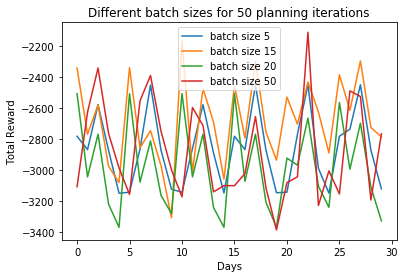

In [51]:
plt.figure()
plt.plot(rewards_p_50_batch_5, label = "batch size 5")
plt.plot(rewards_batch_15, label = "batch size 15")
plt.plot(rewards_p_50_batch_20, label = "batch size 20")
plt.plot(rewards_p_50_batch_50, label = "batch size 50")
plt.legend()
plt.title("Different batch sizes for 50 planning iterations")
plt.xlabel("Days")
plt.ylabel("Total Reward")
plt.show()


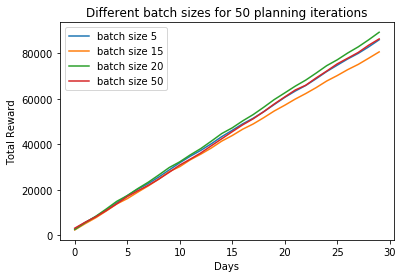

In [52]:
plt.figure()
plt.plot(np.cumsum(np.abs(rewards_p_50_batch_5)), label = "batch size 5")
plt.plot(np.cumsum(np.abs(rewards_batch_15)), label = "batch size 15")
plt.plot(np.cumsum(np.abs(rewards_p_50_batch_20)), label = "batch size 20")
plt.plot(np.cumsum(np.abs(rewards_p_50_batch_50)), label = "batch size 50")
plt.legend()
plt.title("Different batch sizes for 50 planning iterations")
plt.xlabel("Days")
plt.ylabel("Total Reward")
plt.show()

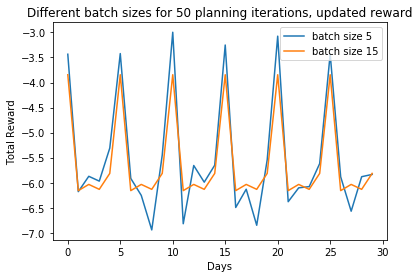

In [95]:
rewards_batch_5

plt.figure()
plt.plot(rewards_batch_5, label = "batch size 5")
plt.plot(rewards_batch_15, label = "batch size 15")
plt.legend()
plt.title("Different batch sizes for 50 planning iterations, updated reward")
plt.xlabel("Days")
plt.ylabel("Total Reward")
plt.show()


## Batch sizes for 10 planning iterations 

Text(0.5,1,'Different batch sizes with 10 planning iterations')

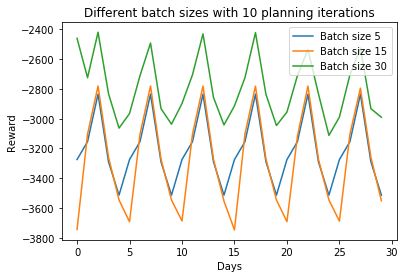

In [57]:
plt.figure()
plt.plot(rewards_batch_5, label = "Batch size 5")
plt.plot(rewards_batch_15, label = "Batch size 15")
plt.plot(rewards_batch_30, label = "Batch size 30")
plt.legend()
plt.xlabel("Days")
plt.ylabel("Reward")
plt.title("Different batch sizes with 10 planning iterations")

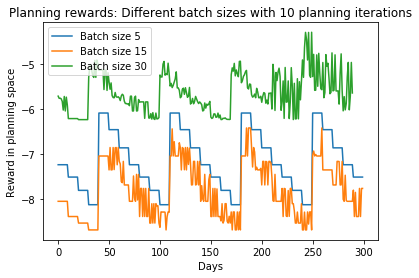

In [63]:
plt.figure()
plt.plot(planning_10_b_5, label = "Batch size 5")
plt.plot(planning_10_b_15, label = "Batch size 15")
plt.plot(planning_10_b_30, label = "Batch size 30")
plt.legend()
plt.xlabel("Days")
plt.ylabel("Reward in planning space")
plt.title("Planning rewards: Different batch sizes with 10 planning iterations")
plt.show()

????? Why is the reward so muh lower in the planning reward space?
?? also, why are the actions f'ed up? 

TODO: test the short term planning module reset

## "Long Term memory planning" versus "short term memory planning"

In [62]:
reward_15_lt, planning_rewards_15_lt = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 15, 
         batch_size_agent = 10,
         short_term_planning = False
         )

reward_30_lt, planning_rewards_30_lt = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 30, 
         batch_size_agent = 10,
         short_term_planning = False
         )

reward_45_lt, planning_rewards_45_lt = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 45, 
         batch_size_agent = 10,
         short_term_planning = False
         )

reward_60_lt, planning_rewards_60_lt = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 60, 
         batch_size_agent = 10,
         short_term_planning = False
         )


BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18
Day: 19
Day: 20
Day: 21
Day: 22
Day: 23
Day: 24
Day: 25
Day: 26
Day: 27
Day: 28
Day: 29
Day: 30
Day: 31
Loaded model from disk
--------------------
 planning step 0
action: [ 0.        0.       10.        9.849155  9.999996 10.        0.
  0.        0.        0.      ]
--------------------
 planning step 1
action: [ 0.        0.       10.        9.849155  9.999996 10.        0.
  0.        0.        0.      ]
--------------------
 planning step 2
action: [ 0.        0.       10.        9.849155  9.999996 10.        0.
  0.        0.        0.      ]
--------------------
 planning step 3
action: [ 0.        0.       10.        9.849155  9.999996 10.        0.
  0.        0.        0.      ]
--------------------
 planning step 4
action: [ 0.        0.       10.        9.849155  9.999996 10.        0.
  0.        0.    

Loaded model from disk
--------------------
 planning step 0
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9920750e+00 4.6253204e-05
 2.2888184e-05 9.9456444e+00 9.9955063e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 1
action: [1.000000e+01 0.000000e+00 1.000000e+01 9.997091e+00 3.385544e-05
 9.987160e+00 9.999905e+00 9.997225e+00 0.000000e+00 0.000000e+00]
--------------------
 planning step 2
action: [1.000000e+01 0.000000e+00 1.000000e+01 9.999126e+00 2.336502e-05
 0.000000e+00 1.000000e+01 9.997379e+00 0.000000e+00 0.000000e+00]
--------------------
 planning step 3
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9995270e+00 2.4318695e-05
 9.9996490e+00 9.9999838e+00 9.9959049e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 4
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9995556e+00 2.5749207e-05
 9.3731918e+00 0.0000000e+00 9.9924335e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 5
action: [1.000

--------------------------------------------------------------------------------
Day: 37
Loaded model from disk
--------------------
 planning step 0
action: [7.0095062e-05 0.0000000e+00 1.0000000e+01 9.9999990e+00 3.8266182e-03
 1.0000000e+01 9.9509201e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 1
action: [9.0122223e-05 0.0000000e+00 1.0000000e+01 9.9999990e+00 5.8979988e-03
 1.3952255e-03 9.6543674e+00 1.9073486e-06 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 2
action: [2.5939941e-04 0.0000000e+00 1.0000000e+01 9.9999971e+00 1.3759613e-02
 9.9897366e+00 4.4855742e+00 3.6239624e-05 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 3
action: [1.4166832e-03 0.0000000e+00 1.0000000e+01 9.9999924e+00 2.6730537e-02
 9.9892616e-02 0.0000000e+00 1.1010170e-03 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 4
action: [3.5762787e-03 0.0000000e+00 1.0000000e+01 9.9999790e+00 4.7739983e-02
 9.9999876e+00 

--------------------
 planning step 14
action: [8.962411e+00 0.000000e+00 1.000000e+01 1.000000e+01 6.208420e-04
 9.996544e+00 9.999860e+00 9.993903e+00 0.000000e+00 0.000000e+00]
--------------------------------------------------------------------------------
Day: 40
Loaded model from disk
--------------------
 planning step 0
action: [1.000000e+01 0.000000e+00 1.000000e+01 8.689691e+00 3.857665e-01
 7.009506e-05 1.000000e+01 9.949005e+00 0.000000e+00 0.000000e+00]
--------------------
 planning step 1
action: [10.         0.        10.         8.334924   1.2883842 10.
  9.99998    9.906984   0.         0.       ]
--------------------
 planning step 2
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 8.0158968e+00 3.3555198e+00
 1.8258095e-03 1.0000000e+01 9.8406515e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 3
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 8.8389158e+00 4.6872377e+00
 3.5762787e-05 1.0000000e+01 9.6612244e+00 0.0000000e+00 0.0000000e+00]

--------------------
 planning step 13
action: [ 0.8102126   0.         10.          9.999937    0.18276548  0.
  0.8105073   0.01264048  0.          0.        ]
--------------------
 planning step 14
action: [6.9090414e-01 0.0000000e+00 1.0000000e+01 9.9999609e+00 5.3685665e-02
 0.0000000e+00 9.9999962e+00 3.6897659e-03 0.0000000e+00 0.0000000e+00]
--------------------------------------------------------------------------------
Day: 43
Loaded model from disk
--------------------
 planning step 0
action: [ 0.        0.       10.        9.990937  4.521724  9.989502  0.
  0.        0.        0.      ]
--------------------
 planning step 1
action: [ 0.          0.         10.          9.993452    3.30688     0.
  0.01748276  0.          0.          0.        ]
--------------------
 planning step 2
action: [ 0.         0.        10.         9.990694   3.7737942  0.
  0.         0.         0.         0.       ]
--------------------
 planning step 3
action: [ 0.         0.        10.        

--------------------
 planning step 13
action: [ 9.39146     0.         10.          2.6208668   5.5216084   0.
  5.7029815   0.85422325  0.          0.        ]
--------------------
 planning step 14
action: [ 9.424128   0.        10.         1.4259915  5.662795   0.
 10.         0.4401822  0.         0.       ]
--------------------------------------------------------------------------------
Day: 46
Loaded model from disk
--------------------
 planning step 0
action: [ 0.02965593  0.         10.          9.99988     0.10918474  0.
 10.          0.13770056  0.          0.        ]
--------------------
 planning step 1
action: [1.3956547e-02 0.0000000e+00 1.0000000e+01 9.9998512e+00 3.5308361e-02
 9.8884258e+00 2.9735565e-03 6.5433502e-02 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 2
action: [4.4641495e-03 0.0000000e+00 1.0000000e+01 9.9998798e+00 1.3413906e-02
 1.3017654e-04 9.9746780e+00 6.0450554e-02 0.0000000e+00 0.0000000e+00]
--------------------
 planning ste

--------------------
 planning step 12
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 2.1361611e+00 5.1806974e-01
 9.9997807e+00 0.0000000e+00 1.0871887e-04 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 13
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 2.6846697e+00 7.3440456e-01
 9.9600687e+00 0.0000000e+00 2.0313263e-04 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 14
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 4.2697659e+00 8.7443113e-01
 0.0000000e+00 0.0000000e+00 2.7656555e-04 0.0000000e+00 0.0000000e+00]
--------------------------------------------------------------------------------
Day: 49
Loaded model from disk
--------------------
 planning step 0
action: [9.9707832e+00 0.0000000e+00 1.0000000e+01 1.1148453e-03 9.9461880e+00
 2.7169003e+00 4.5299530e-05 9.9988976e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 1
action: [9.9522552e+00 0.0000000e+00 1.0000000e+01 2.9673576e-03 9.9569387e+00
 1.0000000e+

--------------------
 planning step 11
action: [ 0.10078335  0.         10.          9.999901    0.01986694  8.617283
  0.01189756  3.4823403   0.          0.        ]
--------------------
 planning step 12
action: [ 0.07760715  0.         10.          9.99997     0.01291609  9.928761
  0.58228874  1.0635021   0.          0.        ]
--------------------
 planning step 13
action: [5.9182644e-02 0.0000000e+00 1.0000000e+01 9.9999847e+00 1.1132717e-02
 0.0000000e+00 4.7683716e-07 1.7414761e-01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 14
action: [3.4769058e-02 0.0000000e+00 1.0000000e+01 9.9999828e+00 2.6808739e-02
 6.9360733e-03 9.9870844e+00 2.2088051e-02 0.0000000e+00 0.0000000e+00]
--------------------------------------------------------------------------------
Day: 52
Loaded model from disk
--------------------
 planning step 0
action: [ 0.        0.       10.        8.638542  9.969187 10.        0.
  9.972729  0.        0.      ]
--------------------
 plannin

--------------------
 planning step 11
action: [2.8276443e-04 0.0000000e+00 1.0000000e+01 9.8527527e+00 6.5492740e+00
 1.5258789e-05 9.9395885e+00 6.9179535e-03 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 12
action: [2.541542e-04 0.000000e+00 1.000000e+01 9.677084e+00 6.893585e+00
 0.000000e+00 0.000000e+00 8.870125e-03 0.000000e+00 0.000000e+00]
--------------------
 planning step 13
action: [3.7240982e-04 0.0000000e+00 1.0000000e+01 9.3130398e+00 6.9372272e+00
 0.0000000e+00 9.9999466e+00 9.4466209e-03 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 14
action: [1.0881424e-03 0.0000000e+00 1.0000000e+01 8.4945107e+00 6.4218235e+00
 1.4305115e-06 3.5812855e-01 1.3015747e-02 0.0000000e+00 0.0000000e+00]
--------------------------------------------------------------------------------
Day: 55
Loaded model from disk
--------------------
 planning step 0
action: [0.00000000e+00 0.00000000e+00 1.00000000e+01 9.74199581e+00
 6.66817474e+00 1.04904175e-05 

--------------------
 planning step 10
action: [1.9073486e-06 0.0000000e+00 1.0000000e+01 3.0258298e+00 9.7725773e+00
 0.0000000e+00 9.8833599e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 11
action: [3.3378601e-06 0.0000000e+00 1.0000000e+01 1.0490468e+00 9.9998894e+00
 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 12
action: [1.0013580e-05 0.0000000e+00 1.0000000e+01 2.2295380e-01 3.4060764e-01
 9.0599060e-06 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 13
action: [4.6730042e-05 0.0000000e+00 1.0000000e+01 5.3997517e-02 1.9073486e-06
 0.0000000e+00 9.9906321e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 14
action: [2.9373169e-04 0.0000000e+00 1.0000000e+01 2.1113873e-02 0.0000000e+00
 1.8119812e-05 2.5957234e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------------------------------------

--------------------
 planning step 9
action: [4.9591064e-04 0.0000000e+00 1.0000000e+01 9.9915705e+00 9.7656479e+00
 0.0000000e+00 0.0000000e+00 7.1191788e-04 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 10
action: [1.6846657e-03 0.0000000e+00 1.0000000e+01 9.9803486e+00 1.1730194e-04
 0.0000000e+00 2.1879051e+00 6.9046021e-04 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 11
action: [4.6949387e-03 0.0000000e+00 1.0000000e+01 9.9445858e+00 4.8908234e-02
 0.0000000e+00 9.0199089e-01 6.8712234e-04 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 12
action: [8.9445114e-03 0.0000000e+00 1.0000000e+01 9.8329878e+00 3.6670146e+00
 0.0000000e+00 0.0000000e+00 5.1307678e-04 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 13
action: [1.8339634e-02 0.0000000e+00 1.0000000e+01 9.6318378e+00 0.0000000e+00
 0.0000000e+00 6.1702728e-04 7.7819824e-04 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 14
action: [2.6

--------------------
 planning step 18
action: [ 0. 10.  0.  0.  0.  0.  0. 10.  0.  0.]
--------------------
 planning step 19
action: [0.000000e+00 9.999999e+00 0.000000e+00 0.000000e+00 0.000000e+00
 0.000000e+00 0.000000e+00 1.000000e+01 0.000000e+00 3.104210e-04]
--------------------
 planning step 20
action: [0.00000e+00 1.00000e+01 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00
 0.00000e+00 1.00000e+01 0.00000e+00 3.33786e-05]
--------------------
 planning step 21
action: [ 0. 10.  0.  0.  0.  0.  0. 10.  0.  0.]
--------------------
 planning step 22
action: [ 0. 10.  0.  0.  0.  0.  0. 10.  0.  0.]
--------------------
 planning step 23
action: [ 0. 10.  0.  0.  0.  0.  0. 10.  0.  0.]
--------------------
 planning step 24
action: [ 0. 10.  0.  0.  0.  0.  0. 10.  0.  0.]
--------------------
 planning step 25
action: [ 0. 10.  0.  0.  0.  0.  0. 10.  0.  0.]
--------------------
 planning step 26
action: [0.0000000e+00 9.9990444e+00 0.0000000e+00 0.0000000e+00 0.0000000e+0

--------------------
 planning step 11
action: [ 0. 10.  0.  0.  0.  0.  0. 10.  0.  0.]
--------------------
 planning step 12
action: [ 0. 10.  0.  0.  0.  0.  0. 10.  0.  0.]
--------------------
 planning step 13
action: [ 0. 10.  0.  0.  0.  0.  0. 10.  0.  0.]
--------------------
 planning step 14
action: [ 0.       10.        0.        0.        0.        0.        0.
 10.        0.        9.999988]
--------------------
 planning step 15
action: [ 0.       10.        0.        0.        0.        0.        9.998858
 10.        0.        0.      ]
--------------------
 planning step 16
action: [0.000000e+00 1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00
 0.000000e+00 4.529953e-05 1.000000e+01 0.000000e+00 0.000000e+00]
--------------------
 planning step 17
action: [ 0.       10.        0.        0.        0.        0.        8.796487
 10.        0.        0.      ]
--------------------
 planning step 18
action: [ 0.        9.999982  0.        0.        0.        0.        

--------------------
 planning step 3
action: [0.0000000e+00 1.4781952e-05 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 2.4414062e-04]
--------------------
 planning step 4
action: [0.0000000e+00 1.2397766e-04 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 3.3686121e+00]
--------------------
 planning step 5
action: [ 0.        9.999974  0.        0.        0.        0.        0.
 10.        0.        0.      ]
--------------------
 planning step 6
action: [ 0.        9.691402  0.        0.        0.        0.        9.979573
 10.        0.        9.390245]
--------------------
 planning step 7
action: [ 0. 10.  0.  0.  0.  0.  0. 10.  0.  0.]
--------------------
 planning step 8
action: [ 0.        9.999958  0.        0.        0.        0.        0.
 10.        0.        9.843115]
--------------------
 planning step 9
action: [ 0.        9.999987  0.        0.        0.        0

--------------------
 planning step 1
action: [ 0.         1.9470298  0.         0.         0.         0.
  9.98772   10.         0.        10.       ]
--------------------
 planning step 2
action: [0.0000000e+00 1.2011528e-03 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 9.8895235e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 3
action: [ 0.        10.         0.         0.         0.         0.
  1.7812452 10.         0.         9.993604 ]
--------------------
 planning step 4
action: [ 0.         0.         0.         0.         0.         0.
  2.7401838 10.         0.        10.       ]
--------------------
 planning step 5
action: [0.00000000e+00 2.86102295e-06 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 1.04904175e-05 1.00000000e+01
 0.00000000e+00 1.00000000e+01]
--------------------
 planning step 6
action: [0.0000000e+00 2.3110580e-01 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.2874603e-05 1.0000000

--------------------
 planning step 22
action: [ 0.        9.999996  0.        0.        0.        0.        9.995167
 10.        0.        0.      ]
--------------------
 planning step 23
action: [ 0.          9.997726    0.          0.          0.          0.
 10.         10.          0.          0.01706076]
--------------------
 planning step 24
action: [0.0000000e+00 9.9996147e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 9.9993000e+00 1.0000000e+01 0.0000000e+00 1.4305115e-06]
--------------------
 planning step 25
action: [ 0.       10.        0.        0.        0.        0.        9.056939
 10.        0.        9.912807]
--------------------
 planning step 26
action: [ 0.       10.        0.        0.        0.        0.        9.971186
 10.        0.        0.      ]
--------------------
 planning step 27
action: [ 0.        9.999981  0.        0.        0.        0.       10.
 10.        0.        9.997133]
--------------------
 planning step 28
action: [ 0.   

--------------------
 planning step 16
action: [ 0.        9.999995  0.        0.        0.        0.       10.
 10.        0.        9.979963]
--------------------
 planning step 17
action: [0.0000000e+00 5.7492256e-01 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.9073486e-06]
--------------------
 planning step 18
action: [ 0.        9.989214  0.        0.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 19
action: [ 0.          0.46315098  0.          0.          0.          0.
  9.999668   10.          0.          9.992506  ]
--------------------
 planning step 20
action: [ 0.          0.20526743  0.          0.          0.          0.
  9.970138   10.          0.         10.        ]
--------------------
 planning step 21
action: [0.0000000e+00 2.3326874e-03 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 9.9990721e+00 1.0000000e+01 0.0000000e+00 9.9999990e+00]
--------

--------------------
 planning step 11
action: [ 0.        9.940439  0.        0.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 12
action: [0.0000000e+00 8.4932337e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 9.9998760e+00 1.0000000e+01 0.0000000e+00 9.6321106e-05]
--------------------
 planning step 13
action: [0.000000e+00 9.993802e+00 0.000000e+00 0.000000e+00 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 8.583069e-06]
--------------------
 planning step 14
action: [ 0.         10.          0.          0.          0.          0.
 10.         10.          0.          0.01197767]
--------------------
 planning step 15
action: [ 0.         10.          0.          0.          0.          0.
  0.66494274 10.          0.          9.980896  ]
--------------------
 planning step 16
action: [0.0000000e+00 9.9997520e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0

--------------------
 planning step 1
action: [0.000000e+00 3.973961e-03 0.000000e+00 0.000000e+00 0.000000e+00
 0.000000e+00 9.598074e+00 1.000000e+01 0.000000e+00 4.439354e-03]
--------------------
 planning step 2
action: [ 0.          0.15535355  0.          0.          0.          0.
  9.999882   10.          0.          0.1647706 ]
--------------------
 planning step 3
action: [ 0.         3.1450784  0.         0.         0.         0.
  9.92403   10.         0.        10.       ]
--------------------
 planning step 4
action: [0.000000e+00 1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00
 0.000000e+00 4.339218e-05 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 5
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.3841858e-03]
--------------------
 planning step 6
action: [0.0000000e+00 9.9984188e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 9.999637

--------------------
 planning step 22
action: [0.0000000e+00 7.1525574e-06 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 5.1450729e-04 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 23
action: [ 0.        0.        0.        0.        0.        0.        0.
 10.        0.        9.497649]
--------------------
 planning step 24
action: [ 0.         2.2944953  0.         0.         0.         0.
  3.2196798 10.         0.         9.999983 ]
--------------------
 planning step 25
action: [0.0000000e+00 6.2942505e-05 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 3.6767793e+00]
--------------------
 planning step 26
action: [0.0000000e+00 1.4305115e-05 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 3.0994415e-04 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 27
action: [ 0.         0.5448885  0.         0.         0.         0.
  9.762486  10.         0.

--------------------
 planning step 9
action: [ 0.          0.          0.          0.          0.          0.
  0.27601385 10.          0.          5.7683415 ]
--------------------
 planning step 10
action: [ 0.          0.15490723  0.          0.          0.          0.
  0.13016891 10.          0.          1.4890683 ]
--------------------
 planning step 11
action: [0.0000000e+00 1.0614395e-03 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 9.9999762e+00 1.0000000e+01 0.0000000e+00 1.1920929e-05]
--------------------
 planning step 12
action: [0.000000e+00 9.536743e-07 0.000000e+00 0.000000e+00 0.000000e+00
 0.000000e+00 0.000000e+00 1.000000e+01 0.000000e+00 9.998616e+00]
--------------------
 planning step 13
action: [ 0.          0.19652176  0.          0.          0.          0.
  9.999893   10.          0.         10.        ]
--------------------
 planning step 14
action: [0.000000e+00 7.419586e-04 0.000000e+00 0.000000e+00 0.000000e+00
 0.000000e+00 8.124781e-02 1.000

--------------------
 planning step 28
action: [ 0.       10.        0.        0.        0.        0.        4.170744
 10.        0.        9.999981]
--------------------
 planning step 29
action: [ 0.         0.7385874  0.         0.         0.         0.
  0.        10.         0.         9.999997 ]
--------------------------------------------------------------------------------
Day: 50
Loaded model from disk
--------------------
 planning step 0
action: [0.0000000e+00 9.9999943e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 4.7683716e-07 1.0000000e+01 0.0000000e+00 7.1354032e+00]
--------------------
 planning step 1
action: [0.0000000e+00 1.8322468e-02 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.5959740e-03 1.0000000e+01 0.0000000e+00 3.3001900e-03]
--------------------
 planning step 2
action: [ 0.       10.        0.        0.        0.        0.        9.992968
 10.        0.        9.99996 ]
--------------------
 planning step 3
action: [0.0000000e+

--------------------
 planning step 16
action: [0.0000000e+00 9.9999704e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 5.7315826e-04 1.0000000e+01 0.0000000e+00 9.4560909e+00]
--------------------
 planning step 17
action: [0.0000000e+00 1.1164951e-01 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.4305115e-06]
--------------------
 planning step 18
action: [ 0.        10.         0.         0.         0.         0.
  9.4346075 10.         0.         9.997853 ]
--------------------
 planning step 19
action: [ 0.          9.999666    0.          0.          0.          0.
  0.01341677 10.          0.         10.        ]
--------------------
 planning step 20
action: [ 0.          0.01460886  0.          0.          0.          0.
 10.         10.          0.          9.112453  ]
--------------------
 planning step 21
action: [ 0.         9.999769   0.         0.         0.         0.
  9.999999  10.         0.         7

--------------------
 planning step 8
action: [0.0000000e+00 7.6009731e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 2.0217896e-04 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 9
action: [ 0.          0.41122723  0.          0.          0.          0.
  0.         10.          0.          3.0770164 ]
--------------------
 planning step 10
action: [ 0.        9.989795  0.        0.        0.        0.        9.993923
 10.        0.        0.      ]
--------------------
 planning step 11
action: [0.0000000e+00 4.3487678e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 5.6934357e-04]
--------------------
 planning step 12
action: [0.0000000e+00 1.3263702e-02 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 4.0531158e-05 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 13
action: [0.000000e+00 1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00
 0.0000

--------------------
 planning step 27
action: [ 0.         9.999998   0.         0.         0.         0.
  1.7707801 10.         0.         9.965387 ]
--------------------
 planning step 28
action: [ 0.          0.61930704  0.          0.          0.          0.
  0.         10.          0.          0.04122543]
--------------------
 planning step 29
action: [ 0.        9.645748  0.        0.        0.        0.        0.
 10.        0.        9.999996]
--------------------------------------------------------------------------------
Day: 55
Loaded model from disk
--------------------
 planning step 0
action: [ 0.        9.999996  0.        0.        0.        0.        9.598621
 10.        0.        0.      ]
--------------------
 planning step 1
action: [ 0.          0.1717968   0.          0.          0.          0.
  0.51372004 10.          0.          0.        ]
--------------------
 planning step 2
action: [ 0.        9.999999  0.        0.        0.        0.        9.732744
 1

--------------------
 planning step 15
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.3866425e-03]
--------------------
 planning step 16
action: [ 0.       10.        0.        0.        0.        0.        0.
 10.        0.        9.999998]
--------------------
 planning step 17
action: [0.0000000e+00 9.9922581e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0728836e-04 1.0000000e+01 0.0000000e+00 3.3903122e-04]
--------------------
 planning step 18
action: [ 0.          8.931134    0.          0.          0.          0.
  9.565578   10.          0.          0.11411238]
--------------------
 planning step 19
action: [0.0000000e+00 3.8146973e-06 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.8840790e-02 1.0000000e+01 0.0000000e+00 3.8290024e-04]
--------------------
 planning step 20
action: [ 0.        0.        0.        0.        0.        0.        0.
 10.        

--------------------
 planning step 1
action: [ 0.          0.          0.          0.          0.          0.
  0.02518082 10.          0.          0.        ]
--------------------
 planning step 2
action: [ 0.        0.        0.        0.        0.        0.        9.992426
 10.        0.        9.698839]
--------------------
 planning step 3
action: [ 0.         0.         0.         0.         0.         0.
  0.6906786 10.         0.         5.244942 ]
--------------------
 planning step 4
action: [ 0.         2.2164736  0.         0.         0.         0.
  9.999828  10.         0.        10.       ]
--------------------
 planning step 5
action: [ 0.        0.        0.        0.        0.        0.        9.999978
 10.        0.        9.99981 ]
--------------------
 planning step 6
action: [ 0.         0.5023751  0.         0.         0.         0.
  0.        10.         0.        10.       ]
--------------------
 planning step 7
action: [ 0.        0.        0.        0.     

--------------------
 planning step 21
action: [0.000000e+00 9.742737e-03 0.000000e+00 0.000000e+00 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 0.000000e+00]
--------------------
 planning step 22
action: [0.000000e+00 6.175041e-04 0.000000e+00 0.000000e+00 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 0.000000e+00]
--------------------
 planning step 23
action: [ 0.        9.992657  0.        0.        0.        0.        8.584774
 10.        0.        0.      ]
--------------------
 planning step 24
action: [ 0.       9.99999  0.       0.       0.       0.      10.      10.
  0.       0.     ]
--------------------
 planning step 25
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.8181076e-04]
--------------------
 planning step 26
action: [ 0.         10.          0.          0.          0.          0.
  0.57601976 10.          0.          0.        ]
---

--------------------
 planning step 8
action: [10.         0.         0.         0.         0.6697221  3.2983131
  0.        10.         0.        10.       ]
--------------------
 planning step 9
action: [10.         0.         0.         0.         0.6697221  0.
  0.        10.         0.        10.       ]
--------------------
 planning step 10
action: [10.         0.         0.         0.         0.6697221  0.
  0.        10.         0.        10.       ]
--------------------
 planning step 11
action: [1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00 9.948978e+00
 1.821518e-04 9.678381e+00 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 12
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 9.9613724e+00
 0.0000000e+00 1.9073486e-06 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 13
action: [10.        0.        0.        0.        9.698528  4.201251  9.53141
 10.        0.       10.      ]
-----------------

--------------------
 planning step 14
action: [10.  0.  0.  0. 10. 10.  0. 10.  0. 10.]
--------------------
 planning step 15
action: [1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00 1.000000e+01
 1.000000e+01 9.536743e-07 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 16
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01
 5.8796406e-01 3.0994415e-05 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 17
action: [1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00 1.000000e+01
 9.536743e-07 0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 18
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01
 3.5476685e-03 2.1128654e-03 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 19
action: [10.          0.          0.          0.         10.          0.02719545
  0.         10.          0.         10.        ]
-

--------------------
 planning step 21
action: [10.        0.        0.        0.        9.999991  9.999825  0.
 10.        0.       10.      ]
--------------------
 planning step 22
action: [10.          0.          0.          0.          9.999992   10.
  0.05966806 10.          0.         10.        ]
--------------------
 planning step 23
action: [10.          0.          0.          0.          9.999996    9.999262
  0.12389612 10.          0.         10.        ]
--------------------
 planning step 24
action: [1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00 9.999998e+00
 9.999250e+00 9.441376e-05 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 25
action: [10.         0.         0.         0.         9.999998   9.9992695
 10.        10.         0.        10.       ]
--------------------
 planning step 26
action: [10.        0.        0.        0.        9.999997  9.999832  9.868494
 10.        0.       10.      ]
--------------------
 planning step 

--------------------
 planning step 28
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01
 0.0000000e+00 1.0204315e-04 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 29
action: [10.  0.  0.  0. 10.  0.  0. 10.  0. 10.]
--------------------
 planning step 30
action: [10.         0.         0.         0.        10.         5.0479827
  0.        10.         0.        10.       ]
--------------------
 planning step 31
action: [10.        0.        0.        0.       10.        3.088428  0.
 10.        0.       10.      ]
--------------------
 planning step 32
action: [10.        0.        0.        0.       10.       10.        9.983495
 10.        0.       10.      ]
--------------------
 planning step 33
action: [10.         0.         0.         0.        10.         9.998228
  0.5339446 10.         0.        10.       ]
--------------------
 planning step 34
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.00

--------------------
 planning step 33
action: [1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00 4.971431e+00
 1.461420e-01 7.332802e-03 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 34
action: [10.         0.         0.         0.         4.6818404 10.
  9.966406  10.         0.        10.       ]
--------------------
 planning step 35
action: [10.        0.        0.        0.        5.626947  9.999999  7.136981
 10.        0.       10.      ]
--------------------
 planning step 36
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 6.5463915e+00
 9.9999561e+00 1.9073486e-06 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 37
action: [10.        0.        0.        0.        8.588332  9.999983  9.947712
 10.        0.       10.      ]
--------------------
 planning step 38
action: [10.        0.        0.        0.        9.170761 10.       10.
 10.        0.       10.      ]
--------------------
 planning st

--------------------
 planning step 39
action: [10.          0.          0.          0.77472925  7.687931    9.995601
  7.730142   10.          0.         10.        ]
--------------------
 planning step 40
action: [10.          0.          0.          0.01350451  7.537383    0.
 10.         10.          0.         10.        ]
--------------------
 planning step 41
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 9.9754210e+00 6.1466899e+00
 4.2915344e-06 1.7642975e-05 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 42
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 3.9291382e-04 5.1207504e+00
 2.5844574e-04 1.8310642e-01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 43
action: [10.         0.         0.         9.993931   4.8584905  9.999485
  3.6438785 10.         0.        10.       ]
--------------------
 planning step 44
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 4.2915344e-06 5.6515217e+00
 9.7573547e+0

--------------------
 planning step 41
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 1.0000000e+01 1.3940237e+00
 0.0000000e+00 9.5367432e-07 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 42
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 9.9963226e+00 1.4971292e+00
 9.9997787e+00 3.8146973e-06 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 43
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 2.3841858e-06 9.6919298e-01
 7.1864085e+00 9.0599060e-06 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 44
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 1.0000000e+01 5.8466148e-01
 9.9898472e+00 6.1130524e-04 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------------------------------------------------------------------
Day: 38
Loaded model from disk
--------------------
 planning step 0
action: [1.000000e+01 0.000000e+00 0.000000e+00 3.633499e-04 9.996514e+00
 1.000000e+01 8.

--------------------
 planning step 44
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 9.9999990e+00 9.9956779e+00
 9.9599495e+00 5.1975250e-03 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------------------------------------------------------------------
Day: 39
Loaded model from disk
--------------------
 planning step 0
action: [10.          0.          0.          0.          9.985842    6.5454397
  0.03108311 10.          0.         10.        ]
--------------------
 planning step 1
action: [10.        0.        0.        9.997028  9.98687  10.        9.991832
 10.        0.       10.      ]
--------------------
 planning step 2
action: [10.          0.          0.          9.999952    9.991737    9.999977
  0.84254694 10.          0.         10.        ]
--------------------
 planning step 3
action: [10.         0.         0.        10.         9.991833   9.0534115
  0.        10.         0.        10.       ]
--------------------
 planning step 4
action: [10.     

--------------------
 planning step 2
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 9.9999714e+00 9.9991932e+00
 3.0334692e+00 1.4591217e-04 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 3
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 9.9991426e+00
 9.9999981e+00 6.9618225e-04 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 4
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 1.3828278e-05 9.9951534e+00
 9.9997644e+00 3.5076141e-02 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 5
action: [10.          0.          0.         10.          9.941189    0.12179279
 10.         10.          0.         10.        ]
--------------------
 planning step 6
action: [10.         0.         0.         3.3775804  9.600723   9.999998
  0.        10.         0.        10.       ]
--------------------
 planning step 7
action: [10.          0.          0.          0.          8.5372095 

--------------------
 planning step 5
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 4.2915344e-06 2.5173473e-01
 6.7919254e-02 9.9998703e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 6
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 1.8119812e-04 5.9634018e-01
 9.9999866e+00 1.1494160e-02 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 7
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 9.5844269e-05 1.7371938e+00
 9.9999981e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 8
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 7.6293945e-06 3.1764660e+00
 1.3160706e-04 9.5887480e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 9
action: [10.         0.         0.         2.8947752  2.818095   9.988171
  9.999979  10.         0.        10.       ]
--------------------
 planning step 10
action: [10.         0.         0.        10.  

--------------------
 planning step 6
action: [1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00 1.000000e+01
 8.414066e+00 7.438660e-05 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 7
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 9.9907131e+00 1.0000000e+01
 1.1983681e-01 9.5367432e-07 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 8
action: [10.        0.        0.       10.       10.        0.        9.999889
 10.        0.       10.      ]
--------------------
 planning step 9
action: [10.        0.        0.        9.893709 10.        0.        6.70187
 10.        0.       10.      ]
--------------------
 planning step 10
action: [10.         0.         0.         9.367084  10.         3.8762593
  0.        10.         0.        10.       ]
--------------------
 planning step 11
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 9.9906254e+00 1.0000000e+01
 0.0000000e+00 1.6403198e-04 1.0000000e+01 0.0000000e+00 

--------------------
 planning step 10
action: [1.00000e+01 0.00000e+00 0.00000e+00 0.00000e+00 1.00000e+01 4.04644e-03
 0.00000e+00 1.00000e+01 0.00000e+00 1.00000e+01]
--------------------
 planning step 11
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 9.9995527e+00 1.0000000e+01
 2.0534515e-02 9.2506409e-05 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 12
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 9.9992599e+00 1.0000000e+01
 1.3446808e-04 1.1920929e-05 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 13
action: [10.          0.          0.          0.02759886 10.          0.03977776
  0.01062775 10.          0.         10.        ]
--------------------
 planning step 14
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 8.9539146e+00 1.0000000e+01
 9.9998798e+00 5.7444572e-03 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 15
action: [10.  0.  0. 10. 10. 10.  0. 10.  0. 10.]
-

--------------------
 planning step 13
action: [10.          0.          0.          0.06828737 10.          2.7429025
  9.999994   10.          0.         10.        ]
--------------------
 planning step 14
action: [10.          0.          0.          9.996737   10.          9.999965
  0.05678129 10.          0.         10.        ]
--------------------
 planning step 15
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 9.9999943e+00 1.0000000e+01
 4.2629242e-04 5.3405762e-05 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 16
action: [10.        0.        0.       10.       10.       10.        9.996836
 10.        0.       10.      ]
--------------------
 planning step 17
action: [10.          0.          0.         10.         10.          9.636951
  0.50887775 10.          0.         10.        ]
--------------------
 planning step 18
action: [10.         0.         0.        10.        10.         3.4207234
  5.198098  10.         0.        10.    

--------------------
 planning step 17
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 4.8602037e+00 1.0000000e+01
 1.5354156e-04 1.0013580e-05 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 18
action: [10.          0.          0.          0.         10.          9.999887
  0.01429796 10.          0.         10.        ]
--------------------
 planning step 19
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01
 9.9718552e+00 4.7683716e-07 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 20
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 2.3365021e-05 1.0000000e+01
 7.2497873e+00 9.9999990e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 21
action: [10.         0.         0.         0.3152609 10.         9.999067
 10.        10.         0.        10.       ]
--------------------
 planning step 22
action: [10.        0.        0.        0.       10.        0.  

--------------------
 planning step 19
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 9.6314459e+00
 0.0000000e+00 4.7683716e-07 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 20
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 2.3841858e-06 8.8669662e+00
 1.0499477e-02 1.4423847e-02 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 21
action: [10.        0.        0.        0.        6.67108   9.999781  9.891436
 10.        0.       10.      ]
--------------------
 planning step 22
action: [10.        0.        0.        0.        6.639989  8.979366  0.
 10.        0.       10.      ]
--------------------
 planning step 23
action: [10.        0.        0.        0.        8.288695 10.        9.930987
 10.        0.       10.      ]
--------------------
 planning step 24
action: [10.          0.          0.          0.5834708   9.300051    9.885298
  0.01380539 10.          0.         10.        ]
--------

--------------------
 planning step 20
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 9.4679203e+00 1.0000000e+01
 1.1363804e+00 4.7683716e-07 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 21
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 1.8119812e-05 1.0000000e+01
 1.5683174e-03 9.0041151e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 22
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01
 9.9982605e+00 2.2411346e-05 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 23
action: [10.        0.        0.        9.997872 10.       10.        0.
 10.        0.       10.      ]
--------------------
 planning step 24
action: [10.        0.        0.        9.963167 10.        8.909628  0.
 10.        0.       10.      ]
--------------------
 planning step 25
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 1.1901855e-03 1.0000000e+01
 4.6634674e-04 0.0000000

--------------------
 planning step 22
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.2745385e+00
 5.3405762e-05 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 23
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 4.4703674e-01
 4.2438507e-04 1.2988853e-01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 24
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 1.1091232e-03 1.0159874e-01
 0.0000000e+00 2.1433353e-02 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 25
action: [10.          0.          0.          9.999941    0.03155422  9.999868
  9.4853115  10.          0.         10.        ]
--------------------
 planning step 26
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 3.1518936e-04 2.4086475e-02
 1.1301041e-04 9.7873707e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 27
action: [1.0000000e+01 0.0000000e

--------------------
 planning step 23
action: [10.          0.          0.          8.934953    0.93521357  0.
  0.         10.          0.         10.        ]
--------------------
 planning step 24
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 2.1421208e+00 1.0164759e+00
 1.3493061e-02 2.1457672e-05 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 25
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 5.8078766e-04 1.5326324e+00
 9.1198263e+00 8.0189657e-01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 26
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 1.5830994e-04 1.8604181e+00
 5.8035851e-03 1.0213852e-03 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 27
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 9.9999971e+00 1.5997384e+00
 3.2530794e+00 3.3378601e-06 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 28
action: [10.         0.         0.     

--------------------
 planning step 26
action: [10.          0.          0.         10.         10.          0.46305847
  6.587398   10.          0.         10.        ]
--------------------
 planning step 27
action: [10.          0.          0.          0.         10.          0.24165058
  3.1976795  10.          0.         10.        ]
--------------------
 planning step 28
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 1.3828278e-05 1.0000000e+01
 9.9997082e+00 9.9998970e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 29
action: [1.000000e+01 0.000000e+00 0.000000e+00 9.735092e+00 1.000000e+01
 9.999992e+00 5.531311e-05 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 30
action: [10.        0.        0.       10.       10.        9.950401  9.99988
 10.        0.       10.      ]
--------------------
 planning step 31
action: [10.         0.         0.         0.        10.         9.9939375
  9.505185  10.         0. 

--------------------
 planning step 30
action: [10.          0.          0.          0.02399158 10.          9.995924
  9.999997   10.          0.         10.        ]
--------------------
 planning step 31
action: [10.  0.  0.  0. 10.  0. 10. 10.  0. 10.]
--------------------
 planning step 32
action: [10.          0.          0.          9.7049265  10.          0.43373966
  1.4057636  10.          0.         10.        ]
--------------------
 planning step 33
action: [10.        0.        0.        9.999076 10.        9.996873  9.995736
 10.        0.       10.      ]
--------------------
 planning step 34
action: [10.        0.        0.        0.       10.       10.        9.969606
 10.        0.       10.      ]
--------------------
 planning step 35
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 6.5739679e-01 1.0000000e+01
 4.1007996e-05 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 36
action: [1.000000e+01 0.000000e+00 0.000000e

--------------------
 planning step 32
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 4.7683716e-07 9.6586704e-02
 9.9972095e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 33
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 4.7683716e-07 1.4219379e-01
 4.7683716e-07 1.6822815e-03 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 34
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 4.4050264e-01
 0.0000000e+00 4.9591064e-05 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 35
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 7.2383881e-04 4.9267673e-01
 0.0000000e+00 8.2529316e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 36
action: [10.          0.          0.          0.0185194   0.14953327  0.
  0.         10.          0.         10.        ]
--------------------
 planning step 37
action: [1.0000000e+01 0.0000000e+00 0.

--------------------
 planning step 35
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 2.1898088e+00 1.0000000e+01
 1.7904854e-01 1.6012192e-03 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 36
action: [1.000000e+01 0.000000e+00 0.000000e+00 9.986729e+00 1.000000e+01
 2.861023e-06 1.882925e-01 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 37
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 8.8109703e+00 1.0000000e+01
 2.8185844e-03 3.1046152e-01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 38
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 1.2255192e-02 1.0000000e+01
 9.9992085e+00 2.6178360e-04 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 39
action: [10.          0.          0.          0.         10.          9.998886
  0.01337337 10.          0.         10.        ]
--------------------
 planning step 40
action: [1.0000000e+01 0.0000000e+00 0.0000

--------------------
 planning step 37
action: [10.         0.         0.         0.         2.8448539  0.
  7.6192255 10.         0.        10.       ]
--------------------
 planning step 38
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 3.1265049e+00 2.6809254e+00
 4.7683716e-07 9.9925938e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 39
action: [10.         0.         0.         0.         1.9518983  9.371672
  0.        10.         0.        10.       ]
--------------------
 planning step 40
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 7.7724457e-05 1.7817655e+00
 8.5076027e+00 1.3013744e-01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 41
action: [10.         0.         0.         9.999926   1.4656134  9.65649
  9.999999  10.         0.        10.       ]
--------------------
 planning step 42
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 4.8147202e-02 1.6609378e+00
 1.5611649e-03 7.4458289e+00 1.0

--------------------
 planning step 39
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 5.4488707e-01
 1.0000000e+01 9.5367432e-07 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 40
action: [10.          0.          0.          0.          0.08580017  0.
  0.         10.          0.         10.        ]
--------------------
 planning step 41
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 2.8262138e-02
 0.0000000e+00 2.3393631e-03 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 42
action: [10.        0.        0.        0.        0.034091  0.        9.826134
 10.        0.       10.      ]
--------------------
 planning step 43
action: [10.          0.          0.          0.          0.08522606  0.
  0.         10.          0.         10.        ]
--------------------
 planning step 44
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 2.4840212e-01
 7.5340271e-05 2.3801756e-01

--------------------
 planning step 43
action: [10.         0.         0.         7.6057005 10.         0.
  9.991928  10.         0.        10.       ]
--------------------
 planning step 44
action: [10.        0.        0.        9.962322 10.        0.        9.971393
 10.        0.       10.      ]
--------------------------------------------------------------------------------
Day: 57
Loaded model from disk
--------------------
 planning step 0
action: [10.          0.          0.          0.          0.02251387  9.951172
  0.         10.          0.         10.        ]
--------------------
 planning step 1
action: [10.          0.          0.          9.999716    0.02742052  0.
  0.01389503 10.          0.         10.        ]
--------------------
 planning step 2
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 9.9526958e+00 2.7595997e-02
 4.7683716e-07 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 3
action: [10.         0.       

--------------------
 planning step 44
action: [10.          0.          0.          4.124303    0.03452826 10.
  0.         10.          0.         10.        ]
--------------------------------------------------------------------------------
Day: 58
Loaded model from disk
--------------------
 planning step 0
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 2.0980835e-05 5.9968138e-01
 9.9086761e-04 3.3424377e-02 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 1
action: [10.         0.         0.         9.032354   0.6714444  9.965614
  0.        10.         0.        10.       ]
--------------------
 planning step 2
action: [10.         0.         0.        10.         1.3490348  8.867784
  9.949085  10.         0.        10.       ]
--------------------
 planning step 3
action: [10.         0.         0.         9.283747   2.683219   3.0849147
  0.        10.         0.        10.       ]
--------------------
 planning step 4
action: [1.0000000e+01 0

--------------------------------------------------------------------------------
Day: 59
Loaded model from disk
--------------------
 planning step 0
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 7.9821277e+00
 4.9686432e-04 0.0000000e+00 1.4230728e-02 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 1
action: [10.        0.        0.       10.        7.367894  9.990813  0.
 10.        0.       10.      ]
--------------------
 planning step 2
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 8.6735306e+00 7.1194654e+00
 1.4705658e-03 3.8777184e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 3
action: [10.         0.         0.         0.         6.9403915  0.
  0.         0.         0.        10.       ]
--------------------
 planning step 4
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 7.4030552e+00
 9.9999866e+00 2.2978783e-03 9.9321823e+00 0.0000000e+00 1.0000000e+01]
--------------------
 plan

Loaded model from disk
--------------------
 planning step 0
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 4.4742584e-02 5.7899857e-01
 5.2452087e-06 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 1
action: [10.          0.          0.          0.07866192  0.27288055  0.04035378
  0.          0.          0.         10.        ]
--------------------
 planning step 2
action: [10.          0.          0.          0.          0.35946226  0.
  0.         10.          0.         10.        ]
--------------------
 planning step 3
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 6.4461136e-01
 0.0000000e+00 0.0000000e+00 1.9073486e-06 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 4
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 2.3666368e+00 1.4484956e+00
 1.4305115e-06 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 5
action: [1.000000e+01 0.000000e+00 0.00000

Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18
Day: 19
Day: 20
Day: 21
Day: 22
Day: 23
Day: 24
Day: 25
Day: 26
Day: 27
Day: 28
Day: 29
Day: 30
Day: 31
Loaded model from disk
--------------------
 planning step 0
action: [ 0.      0.     10.      0.      9.9804 10.      0.      0.     10.
  0.    ]
--------------------
 planning step 1
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 9.9878006e+00
 1.0000000e+01 0.0000000e+00 1.6593933e-04 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 2
action: [ 0.        0.       10.        0.        9.991278 10.        0.
  9.998491 10.        0.      ]
--------------------
 planning step 3
action: [ 0.        0.       10.        0.        9.987171 10.        0.
  0.       10.        0.      ]
--------------------
 planning step 4
action: [ 0.        0.       10.        0.        9.981383 10.        0.
  0.       10.        0.   

--------------------
 planning step 50
action: [ 0.        0.       10.        0.        5.904843 10.        0.
  0.       10.        0.      ]
--------------------
 planning step 51
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 3.4289875e+00
 1.0000000e+01 0.0000000e+00 1.1610985e-03 1.6850500e+00 0.0000000e+00]
--------------------
 planning step 52
action: [ 0.         0.        10.         0.         6.5000625 10.
  0.         0.        10.         0.       ]
--------------------
 planning step 53
action: [ 0.        0.       10.        0.        8.412129 10.        0.
  0.        0.        0.      ]
--------------------
 planning step 54
action: [ 0.         0.        10.         0.         1.5141723 10.
  0.         0.         9.999531   0.       ]
--------------------
 planning step 55
action: [ 0.        0.       10.        0.        7.839352 10.        0.
  9.999994  9.996143  0.      ]
--------------------
 planning step 56
action: [ 0.         0.        10

--------------------
 planning step 39
action: [ 0.         0.        10.         0.         0.         3.0212512
  0.         0.        10.         0.       ]
--------------------
 planning step 40
action: [ 0.         0.        10.         0.         0.         3.1861877
  0.         0.0149951 10.         0.       ]
--------------------
 planning step 41
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 4.2194624e+00 0.0000000e+00 2.9134750e-04 9.9787855e-01 0.0000000e+00]
--------------------
 planning step 42
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 5.4460673e+00 0.0000000e+00 6.5226555e-03 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 43
action: [ 0.         0.        10.         0.         0.         6.4718237
  0.         9.880761  10.         0.       ]
--------------------
 planning step 44
action: [ 0.        0.       10.        0.        0.        7.203598  0.
  9.679671 10.        0.    

--------------------
 planning step 26
action: [ 0.        0.       10.        0.        0.        9.99922   0.
  9.686291  0.        0.      ]
--------------------
 planning step 27
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.8215179e-04
 9.9992409e+00 0.0000000e+00 4.7683716e-06 7.6745510e-02 0.0000000e+00]
--------------------
 planning step 28
action: [0.000000e+00 0.000000e+00 1.000000e+01 0.000000e+00 0.000000e+00
 9.999363e+00 0.000000e+00 0.000000e+00 4.863739e-05 0.000000e+00]
--------------------
 planning step 29
action: [ 0.         0.        10.         0.         0.         9.9996395
  0.         9.929669  10.         0.       ]
--------------------
 planning step 30
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 9.9998198e+00 0.0000000e+00 3.5285950e-05 1.5159416e-01 0.0000000e+00]
--------------------
 planning step 31
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 9.9999046e+00 0.0

--------------------
 planning step 11
action: [0.0000000e+00 0.0000000e+00 1.6207695e-03 0.0000000e+00 1.5115738e-04
 2.0552158e-02 0.0000000e+00 1.0000000e+01 9.9999657e+00 0.0000000e+00]
--------------------
 planning step 12
action: [0.0000000e+00 0.0000000e+00 9.3989372e-03 0.0000000e+00 0.0000000e+00
 8.0776215e-04 0.0000000e+00 1.0000000e+01 9.9999990e+00 0.0000000e+00]
--------------------
 planning step 13
action: [ 0.          0.          0.03608942  0.          9.999777    1.0760698
  0.         10.         10.          0.        ]
--------------------
 planning step 14
action: [ 0.          0.          0.16376925  0.          9.999989    0.
  0.         10.          9.999375    0.        ]
--------------------
 planning step 15
action: [ 0.         0.         0.4233594  0.         9.969019   9.999044
  0.        10.         9.985582   0.       ]
--------------------
 planning step 16
action: [ 0.         0.         0.8182583  0.         1.4828873 10.
  0.        10.        

--------------------
 planning step 58
action: [0.         0.         0.14742947 0.         0.03155804 0.
 0.         8.743108   9.998638   0.        ]
--------------------
 planning step 59
action: [0.        0.        0.2562437 0.        9.997484  9.999996  0.
 9.9457855 9.99999   0.       ]
--------------------------------------------------------------------------------
Day: 35
Loaded model from disk
--------------------
 planning step 0
action: [0.        0.        9.995552  0.        4.5698304 9.999214  0.
 0.        3.3649893 0.       ]
--------------------
 planning step 1
action: [ 0.         0.         9.996404   0.         7.9195633  9.999002
  0.        10.         9.039      0.       ]
--------------------
 planning step 2
action: [0.0000000e+00 0.0000000e+00 9.9965000e+00 0.0000000e+00 7.8943324e+00
 9.9986610e+00 0.0000000e+00 4.7683716e-07 9.9977179e+00 0.0000000e+00]
--------------------
 planning step 3
action: [ 0.        0.        9.995926  0.        9.812216  9.9984

--------------------
 planning step 48
action: [0.        0.        9.734913  0.        2.3685656 8.413796  0.
 0.        9.656214  0.       ]
--------------------
 planning step 49
action: [0.       0.       9.50358  0.       6.889553 8.057169 0.       9.994152
 0.       0.      ]
--------------------
 planning step 50
action: [0.        0.        9.325679  0.        5.7981567 8.028748  0.
 0.        0.        0.       ]
--------------------
 planning step 51
action: [0.0000000e+00 0.0000000e+00 9.3588734e+00 0.0000000e+00 3.3374488e+00
 8.1533260e+00 0.0000000e+00 0.0000000e+00 7.0285797e-04 0.0000000e+00]
--------------------
 planning step 52
action: [0.        0.        9.48796   0.        6.4885645 8.610222  0.
 9.999162  0.        0.       ]
--------------------
 planning step 53
action: [0.0000000e+00 0.0000000e+00 9.6473370e+00 0.0000000e+00 1.3974977e+00
 8.9671402e+00 0.0000000e+00 3.0609477e+00 1.9073486e-06 0.0000000e+00]
--------------------
 planning step 54
action: [0.0

--------------------
 planning step 33
action: [ 0.          0.          0.03941727  0.          0.02374554  9.758956
  9.9999485  10.         10.          0.        ]
--------------------
 planning step 34
action: [0.0000000e+00 0.0000000e+00 4.0935040e-02 0.0000000e+00 2.9182434e-04
 2.3976851e-01 9.9998598e+00 1.6880035e-04 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 35
action: [0.0000000e+00 0.0000000e+00 3.4383774e-02 0.0000000e+00 7.4605942e-03
 3.6446302e+00 9.9997292e+00 9.9991684e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 36
action: [0.0000000e+00 0.0000000e+00 2.7489185e-02 0.0000000e+00 9.9986486e+00
 2.4018021e+00 9.9996452e+00 9.9977312e+00 7.4911118e-04 0.0000000e+00]
--------------------
 planning step 37
action: [ 0.          0.          0.02700424  0.          0.          1.246134
  9.999128    9.664937   10.          0.        ]
--------------------
 planning step 38
action: [0.0000000e+00 0.0000000e+00 2.5263309e-02 0.00

--------------------
 planning step 19
action: [0.0000000e+00 0.0000000e+00 2.3625045e+00 0.0000000e+00 2.8610229e-06
 6.6211033e-01 0.0000000e+00 1.3351440e-05 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 20
action: [0.0000000e+00 0.0000000e+00 2.0984931e+00 0.0000000e+00 9.9441147e+00
 8.2712173e-03 0.0000000e+00 6.1363502e+00 4.2769012e+00 0.0000000e+00]
--------------------
 planning step 21
action: [0.        0.        2.7275367 0.        0.        9.999498  0.
 0.        0.        0.       ]
--------------------
 planning step 22
action: [0.0000000e+00 0.0000000e+00 2.7647314e+00 0.0000000e+00 4.6157837e-04
 9.6938114e+00 0.0000000e+00 0.0000000e+00 3.8676834e-01 0.0000000e+00]
--------------------
 planning step 23
action: [0.       0.       3.173606 0.       9.99984  9.999999 0.       0.
 9.886602 0.      ]
--------------------
 planning step 24
action: [0.0000000e+00 0.0000000e+00 3.5479012e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 0.0000

--------------------
 planning step 5
action: [0.         0.         1.7941096  0.         0.05096149 6.0045433
 0.08054304 0.         9.999992   0.        ]
--------------------
 planning step 6
action: [ 0.          0.          1.5055678   0.          0.          5.837159
  0.03352499  9.550327   10.          0.        ]
--------------------
 planning step 7
action: [0.         0.         1.227797   0.         9.994329   6.8613462
 0.02686453 0.         9.98265    0.        ]
--------------------
 planning step 8
action: [0.0000000e+00 0.0000000e+00 1.0794411e+00 0.0000000e+00 4.7349930e-04
 5.3923030e+00 3.7250042e-02 7.5487757e+00 4.7683716e-07 0.0000000e+00]
--------------------
 planning step 9
action: [0.0000000e+00 0.0000000e+00 1.0073545e+00 0.0000000e+00 1.6212463e-05
 6.8102255e+00 8.8662148e-02 9.7170525e+00 9.3132782e+00 0.0000000e+00]
--------------------
 planning step 10
action: [ 0.         0.         1.0861304  0.         0.         7.77258
  0.1631341 10.        10. 

--------------------
 planning step 53
action: [0.        0.        3.2360446 0.        9.175028  3.2764106 0.7868161
 4.88409   9.99809   0.       ]
--------------------
 planning step 54
action: [0.         0.         2.9640431  0.         0.         4.638408
 0.62081385 0.         0.         0.        ]
--------------------
 planning step 55
action: [0.0000000e+00 0.0000000e+00 2.5699441e+00 0.0000000e+00 9.5367432e-07
 5.9919462e+00 5.7055187e-01 0.0000000e+00 9.9999981e+00 0.0000000e+00]
--------------------
 planning step 56
action: [ 0.          0.          2.223716    0.          9.768393    6.814911
  0.35913038 10.         10.          0.        ]
--------------------
 planning step 57
action: [0.0000000e+00 0.0000000e+00 1.7807922e+00 0.0000000e+00 0.0000000e+00
 7.3613663e+00 3.2447386e-01 1.5025139e-03 9.9487000e+00 0.0000000e+00]
--------------------
 planning step 58
action: [0.         0.         1.2426476  0.         0.         7.3670483
 0.48387098 0.         0.      

--------------------
 planning step 39
action: [0.0000000e+00 0.0000000e+00 4.6474237e+00 0.0000000e+00 6.7535071e+00
 8.0260658e+00 9.9989586e+00 5.1021576e-05 6.6352415e+00 0.0000000e+00]
--------------------
 planning step 40
action: [ 0.          0.          5.4562078   0.          0.03440428  7.9226685
  9.997836    9.999811   10.          0.        ]
--------------------
 planning step 41
action: [0.0000000e+00 0.0000000e+00 5.8746557e+00 0.0000000e+00 2.2751331e-02
 7.2254763e+00 9.9955444e+00 0.0000000e+00 1.5258789e-05 0.0000000e+00]
--------------------
 planning step 42
action: [0.0000000e+00 0.0000000e+00 5.7174320e+00 0.0000000e+00 1.2133598e-02
 6.2862425e+00 9.9912128e+00 1.2922287e-03 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 43
action: [0.0000000e+00 0.0000000e+00 5.0597606e+00 0.0000000e+00 1.1301041e-04
 4.6012869e+00 9.9888668e+00 4.7683716e-07 4.7683716e-07 0.0000000e+00]
--------------------
 planning step 44
action: [0.0000000e+00 0.0000000

--------------------
 planning step 23
action: [0.0000000e+00 0.0000000e+00 6.3276129e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 5.9127808e-05 0.0000000e+00 9.9907017e+00 0.0000000e+00]
--------------------
 planning step 24
action: [0.0000000e+00 0.0000000e+00 6.5848846e+00 0.0000000e+00 2.2490609e+00
 1.0000000e+01 2.4318695e-05 2.5749207e-05 9.9586620e+00 0.0000000e+00]
--------------------
 planning step 25
action: [0.0000000e+00 0.0000000e+00 7.1996036e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 5.7220459e-06 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 26
action: [0.0000000e+00 0.0000000e+00 7.7985950e+00 0.0000000e+00 2.5873184e-03
 9.9986420e+00 1.9073486e-06 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 27
action: [0.0000000e+00 0.0000000e+00 8.1197548e+00 0.0000000e+00 1.4305115e-06
 1.8144894e-01 4.7683716e-07 2.5321007e-02 5.7697296e-05 0.0000000e+00]
--------------------
 planning step 28
action: [0.

--------------------
 planning step 7
action: [0.0000000e+00 0.0000000e+00 7.5117378e+00 0.0000000e+00 0.0000000e+00
 1.6118672e+00 9.9699783e-01 9.9995022e+00 5.6362152e-04 0.0000000e+00]
--------------------
 planning step 8
action: [0.        0.        7.8631897 0.        1.4182928 1.2608404 1.1512468
 9.982483  3.4643009 0.       ]
--------------------
 planning step 9
action: [0.         0.         7.9404716  0.         0.         0.66320324
 1.5773604  9.670903   0.01174068 0.        ]
--------------------
 planning step 10
action: [ 0.          0.          7.784473    0.          0.09293127  0.5307369
  2.8345177   9.999998   10.          0.        ]
--------------------
 planning step 11
action: [0.0000000e+00 0.0000000e+00 7.6167722e+00 0.0000000e+00 3.2400799e-01
 7.5536680e-01 3.9250064e+00 1.6345978e-03 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 12
action: [ 0.          0.          7.6477776   0.         10.          1.6080647
  3.9378514   0.88374233 

--------------------
 planning step 53
action: [9.9996891e+00 0.0000000e+00 6.9229488e+00 0.0000000e+00 7.3242188e-04
 2.6025779e+00 3.3416748e-03 0.0000000e+00 9.9999638e+00 0.0000000e+00]
--------------------
 planning step 54
action: [1.0000000e+01 0.0000000e+00 6.4817152e+00 0.0000000e+00 0.0000000e+00
 2.1951153e+00 9.5815659e-03 2.8610229e-06 2.6321411e-04 0.0000000e+00]
--------------------
 planning step 55
action: [10.          0.          6.563059    0.          9.901158    5.252135
  0.02654648 10.          9.735574    0.        ]
--------------------
 planning step 56
action: [1.0000000e+01 0.0000000e+00 7.1531916e+00 0.0000000e+00 4.0102115e+00
 6.3671718e+00 3.6534786e-02 2.1457672e-04 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 57
action: [10.          0.          7.5312643   0.          0.          5.954294
  0.05227661 10.         10.          0.        ]
--------------------
 planning step 58
action: [0.000000e+00 0.000000e+00 8.000071e+00 0.00000

--------------------
 planning step 36
action: [8.7492657e+00 0.0000000e+00 2.2459030e-04 0.0000000e+00 9.4757385e+00
 1.0000000e+01 7.7342987e-04 0.0000000e+00 9.9621458e+00 0.0000000e+00]
--------------------
 planning step 37
action: [7.2514758e+00 0.0000000e+00 1.8501282e-04 0.0000000e+00 5.0544739e-05
 1.0000000e+01 1.2278557e-03 8.1607456e+00 9.9940319e+00 0.0000000e+00]
--------------------
 planning step 38
action: [0.0000000e+00 0.0000000e+00 1.2111664e-04 0.0000000e+00 5.0021267e-01
 1.0000000e+01 1.1477470e-03 1.5983582e-03 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 39
action: [1.7070770e-04 0.0000000e+00 8.6784363e-05 0.0000000e+00 0.0000000e+00
 1.0000000e+01 1.1529922e-03 4.7683716e-07 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 40
action: [1.8585253e-01 0.0000000e+00 8.2015991e-05 0.0000000e+00 0.0000000e+00
 1.0000000e+01 7.9441071e-04 1.0000000e+01 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 41
action: [1.

--------------------
 planning step 20
action: [7.5049782e+00 0.0000000e+00 8.7698879e+00 0.0000000e+00 5.9334731e+00
 6.7942238e+00 1.0632851e+00 1.6689301e-05 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 21
action: [0.        0.        8.572493  0.        9.998508  4.865546  1.2230282
 0.        0.        0.       ]
--------------------
 planning step 22
action: [0.0000000e+00 0.0000000e+00 7.9307671e+00 0.0000000e+00 4.3879509e-02
 5.0222707e+00 1.8175254e+00 1.9073486e-05 9.9807224e+00 0.0000000e+00]
--------------------
 planning step 23
action: [9.9346581e+00 0.0000000e+00 7.3464150e+00 0.0000000e+00 3.5052299e-03
 3.6690731e+00 2.1966431e+00 7.6866150e-04 4.5585632e-04 0.0000000e+00]
--------------------
 planning step 24
action: [0.37635756 0.         6.6715536  0.         9.906278   2.6926658
 2.6377735  0.06546211 9.999996   0.        ]
--------------------
 planning step 25
action: [0.        0.        6.195093  0.        0.        2.7508788 2.8239834
 0.

--------------------
 planning step 6
action: [9.9647503e+00 0.0000000e+00 1.2883565e+00 0.0000000e+00 6.6614151e-04
 6.8430057e+00 6.1982298e-01 9.6290464e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 7
action: [5.0588937e+00 0.0000000e+00 1.4155803e+00 0.0000000e+00 0.0000000e+00
 5.6775484e+00 7.6656199e-01 2.4318695e-05 1.9055843e-02 0.0000000e+00]
--------------------
 planning step 8
action: [7.2207451e-03 0.0000000e+00 1.4071105e+00 0.0000000e+00 1.0000000e+01
 9.4102030e+00 1.1667671e+00 6.8823814e-02 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 9
action: [1.0000000e+01 0.0000000e+00 1.3583229e+00 0.0000000e+00 8.1129074e-03
 9.8924475e+00 1.7630320e+00 7.8322983e-01 9.7895889e+00 0.0000000e+00]
--------------------
 planning step 10
action: [0.01157379 0.         1.3240342  0.         0.         8.348404
 2.4932141  9.993237   9.999955   0.        ]
--------------------
 planning step 11
action: [0.0000000e+00 0.0000000e+00 1.8119335e

--------------------
 planning step 52
action: [9.9999990e+00 0.0000000e+00 1.3711979e+00 0.0000000e+00 0.0000000e+00
 9.5652008e+00 2.8619471e+00 4.7683716e-07 1.4769278e+00 0.0000000e+00]
--------------------
 planning step 53
action: [1.0000000e+01 0.0000000e+00 1.4093969e+00 0.0000000e+00 6.1349869e-03
 2.1065047e+00 1.9444227e+00 4.0054321e-05 7.0650244e-01 0.0000000e+00]
--------------------
 planning step 54
action: [1.8162727e-03 0.0000000e+00 1.4678249e+00 0.0000000e+00 0.0000000e+00
 9.7248812e+00 1.0831518e+00 1.0547638e-03 1.9073486e-06 0.0000000e+00]
--------------------
 planning step 55
action: [10.          0.          1.5666542   0.          9.214957    0.91959
  0.6082959   0.08961582 10.          0.        ]
--------------------
 planning step 56
action: [ 9.99958     0.          1.4180768   0.          9.999999    9.80801
  0.45174885 10.          9.654358    0.        ]
--------------------
 planning step 57
action: [1.0000000e+01 0.0000000e+00 1.2992735e+00 0.0000

--------------------
 planning step 36
action: [9.5367432e-07 0.0000000e+00 4.8780441e-04 0.0000000e+00 0.0000000e+00
 9.8805504e+00 9.9592047e+00 9.8147583e+00 1.7783594e-01 0.0000000e+00]
--------------------
 planning step 37
action: [9.9999971e+00 0.0000000e+00 4.6682358e-04 0.0000000e+00 0.0000000e+00
 1.0000000e+01 9.9395475e+00 1.8529892e-03 5.0661354e+00 0.0000000e+00]
--------------------
 planning step 38
action: [1.000000e+01 0.000000e+00 4.286766e-04 0.000000e+00 7.648468e-04
 1.000000e+01 9.936765e+00 1.000000e+01 9.999647e+00 0.000000e+00]
--------------------
 planning step 39
action: [9.9999695e+00 0.0000000e+00 3.9005280e-04 0.0000000e+00 7.4341221e+00
 9.9999809e+00 9.9552097e+00 7.6770782e-05 9.9955969e+00 0.0000000e+00]
--------------------
 planning step 40
action: [3.7194252e-02 0.0000000e+00 4.0483475e-04 0.0000000e+00 0.0000000e+00
 1.0000000e+01 9.9728251e+00 0.0000000e+00 1.7014027e-02 0.0000000e+00]
--------------------
 planning step 41
action: [6.378174e-03

--------------------
 planning step 19
action: [3.8936491e+00 0.0000000e+00 1.7392635e-02 0.0000000e+00 9.9999943e+00
 1.0000000e+01 1.9021034e-03 1.2779236e-04 1.3836417e+00 0.0000000e+00]
--------------------
 planning step 20
action: [1.0000000e+01 0.0000000e+00 3.1430721e-02 0.0000000e+00 9.9999990e+00
 3.7709379e-01 9.3889236e-04 9.6971416e+00 9.9999895e+00 0.0000000e+00]
--------------------
 planning step 21
action: [5.5765309e+00 0.0000000e+00 4.9124718e-02 0.0000000e+00 3.9468098e-01
 1.0000000e+01 2.4414062e-04 2.1171570e-04 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 22
action: [0.0000000e+00 0.0000000e+00 6.9737911e-02 0.0000000e+00 0.0000000e+00
 9.9995880e+00 7.2002411e-05 1.6288757e-03 9.9893255e+00 0.0000000e+00]
--------------------
 planning step 23
action: [0.0000000e+00 0.0000000e+00 7.1898460e-02 0.0000000e+00 0.0000000e+00
 4.9583340e-01 2.4318695e-05 2.6811743e-01 7.0602417e-02 0.0000000e+00]
--------------------
 planning step 24
action: [9.

--------------------
 planning step 2
action: [9.998994   0.         3.090393   0.         0.         0.22851658
 0.30393457 0.         0.         0.        ]
--------------------
 planning step 3
action: [2.9164314e-02 0.0000000e+00 2.8909025e+00 0.0000000e+00 0.0000000e+00
 2.9394054e-01 1.8616104e-01 0.0000000e+00 2.1934509e-05 0.0000000e+00]
--------------------
 planning step 4
action: [3.3807755e-04 0.0000000e+00 2.8370054e+00 0.0000000e+00 0.0000000e+00
 2.9123831e-01 2.3260593e-02 0.0000000e+00 9.9986248e+00 0.0000000e+00]
--------------------
 planning step 5
action: [4.7683716e-07 0.0000000e+00 2.5504253e+00 0.0000000e+00 0.0000000e+00
 3.9149475e-01 4.7373772e-03 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 6
action: [7.0349216e-02 0.0000000e+00 2.2667873e+00 0.0000000e+00 1.0000000e+01
 6.5337133e-01 2.2392273e-03 0.0000000e+00 1.0013580e-05 0.0000000e+00]
--------------------
 planning step 7
action: [0.0000000e+00 0.0000000e+00 2.4860384e

--------------------
 planning step 46
action: [1.2455034e-01 0.0000000e+00 2.8844576e+00 0.0000000e+00 2.0027161e-05
 3.8249969e-02 5.8790874e-01 0.0000000e+00 5.8062077e-01 0.0000000e+00]
--------------------
 planning step 47
action: [6.945965   0.         4.1218767  0.         0.12318563 0.10605097
 1.5062284  0.         0.         0.        ]
--------------------
 planning step 48
action: [0.0000000e+00 0.0000000e+00 6.0558038e+00 0.0000000e+00 7.1525574e-06
 6.1270714e-02 2.0928881e+00 0.0000000e+00 9.9999952e+00 0.0000000e+00]
--------------------
 planning step 49
action: [9.5367432e-07 0.0000000e+00 8.2970133e+00 0.0000000e+00 0.0000000e+00
 8.0935478e-02 1.6283667e+00 0.0000000e+00 1.3172150e-02 0.0000000e+00]
--------------------
 planning step 50
action: [1.3618469e-03 0.0000000e+00 9.3070221e+00 0.0000000e+00 7.8372040e+00
 4.0350914e-02 2.9357719e-01 9.5367432e-07 1.6938210e-02 0.0000000e+00]
--------------------
 planning step 51
action: [0.0000000e+00 0.0000000e+00 9.64

--------------------
 planning step 30
action: [8.01569557e+00 0.00000000e+00 3.48091125e-05 0.00000000e+00
 0.00000000e+00 1.26748085e-02 1.30016327e-01 2.81333923e-05
 9.53674316e-07 0.00000000e+00]
--------------------
 planning step 31
action: [3.9100647e-05 0.0000000e+00 3.5762787e-05 0.0000000e+00 0.0000000e+00
 9.9999905e+00 2.4781847e-01 3.1152725e-02 8.9745522e-03 0.0000000e+00]
--------------------
 planning step 32
action: [0.0000000e+00 0.0000000e+00 5.0544739e-05 0.0000000e+00 0.0000000e+00
 1.0000000e+01 1.2993336e-01 9.9670238e+00 2.7697563e-02 0.0000000e+00]
--------------------
 planning step 33
action: [5.7064581e+00 0.0000000e+00 7.0571899e-05 0.0000000e+00 6.2936115e+00
 1.0000000e+01 3.2423019e-02 0.0000000e+00 9.9999771e+00 0.0000000e+00]
--------------------
 planning step 34
action: [1.0000000e+01 0.0000000e+00 9.1552734e-05 0.0000000e+00 1.9073486e-06
 0.0000000e+00 7.8339577e-03 0.0000000e+00 4.5155525e-02 0.0000000e+00]
--------------------
 planning step 35


--------------------
 planning step 13
action: [8.6370468e-02 0.0000000e+00 7.6630640e-01 0.0000000e+00 2.1303654e-02
 9.4896822e+00 4.7206879e-05 9.9987659e+00 9.9994669e+00 0.0000000e+00]
--------------------
 planning step 14
action: [6.8104696e-01 0.0000000e+00 6.6674995e-01 0.0000000e+00 5.5556297e-03
 1.0247231e-03 8.2015991e-05 2.3841858e-06 9.9589224e+00 0.0000000e+00]
--------------------
 planning step 15
action: [2.4897099e-01 0.0000000e+00 7.7612591e-01 0.0000000e+00 2.4266243e-03
 8.9576969e+00 1.1062622e-04 1.0000000e+01 9.8909206e+00 0.0000000e+00]
--------------------
 planning step 16
action: [0.0000000e+00 0.0000000e+00 1.0518775e+00 0.0000000e+00 3.3884048e-03
 9.9309769e+00 8.9645386e-05 9.9347248e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 17
action: [3.8719177e-04 0.0000000e+00 1.3205121e+00 0.0000000e+00 1.6119957e-02
 9.9973183e+00 8.0108643e-05 1.0818481e-02 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 18
action: [1.

--------------------
 planning step 57
action: [7.3556900e-03 0.0000000e+00 3.5440977e+00 0.0000000e+00 3.1010628e-02
 0.0000000e+00 1.4781952e-05 0.0000000e+00 9.9975395e+00 0.0000000e+00]
--------------------
 planning step 58
action: [9.9985123e+00 0.0000000e+00 3.6549568e+00 0.0000000e+00 3.2138348e-02
 9.9995365e+00 1.4781952e-05 1.5258789e-05 9.9997149e+00 0.0000000e+00]
--------------------
 planning step 59
action: [9.9998894e+00 0.0000000e+00 3.3580041e+00 0.0000000e+00 3.6515236e-02
 6.1876726e+00 1.4781952e-05 0.0000000e+00 4.1694641e-03 0.0000000e+00]
--------------------------------------------------------------------------------
Day: 50
Loaded model from disk
--------------------
 planning step 0
action: [9.9956875e+00 0.0000000e+00 1.3124261e+00 0.0000000e+00 0.0000000e+00
 8.0180483e+00 6.6716146e-01 2.7456284e-03 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 1
action: [10.          0.          1.3530102   0.          9.999452    9.999438
  0.52865076

--------------------
 planning step 42
action: [1.2922287e-04 0.0000000e+00 2.3132334e+00 0.0000000e+00 0.0000000e+00
 3.9325762e-01 1.2560353e+00 7.5168133e-02 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 43
action: [9.1758099e+00 0.0000000e+00 2.6397834e+00 0.0000000e+00 8.8691711e-05
 3.3914471e-01 9.6766567e-01 2.7862358e-01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 44
action: [9.961322  0.        2.9275298 0.        9.797225  0.4298296 0.518806
 9.989056  9.996272  0.       ]
--------------------
 planning step 45
action: [0.         0.         2.9415402  0.         0.         0.15552235
 0.11579609 0.         0.02549458 0.        ]
--------------------
 planning step 46
action: [4.7683716e-07 0.0000000e+00 2.1945450e+00 0.0000000e+00 1.0000000e+01
 2.8706360e-01 3.1289577e-02 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 47
action: [4.7683716e-07 0.0000000e+00 1.3827224e+00 0.0000000e+00 9.8690577e+00
 3.

--------------------
 planning step 27
action: [0.0000000e+00 0.0000000e+00 1.0004115e+00 0.0000000e+00 3.7415543e+00
 1.0000000e+01 0.0000000e+00 5.2452087e-06 9.9736805e+00 0.0000000e+00]
--------------------
 planning step 28
action: [0.         0.         2.0745895  0.         0.         9.998621
 0.         0.         0.03369284 0.        ]
--------------------
 planning step 29
action: [0.0000000e+00 0.0000000e+00 3.0294757e+00 0.0000000e+00 0.0000000e+00
 8.9543247e-01 0.0000000e+00 0.0000000e+00 2.9563904e-05 0.0000000e+00]
--------------------
 planning step 30
action: [0.        0.        3.1545157 0.        9.14511   9.9999275 0.
 0.        9.999851  0.       ]
--------------------
 planning step 31
action: [1.0000000e+01 0.0000000e+00 2.7130475e+00 0.0000000e+00 4.7683716e-07
 2.2834196e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 32
action: [8.1062317e-06 0.0000000e+00 2.5560503e+00 0.0000000e+00 1.3002396e-02
 2.6870508e

--------------------
 planning step 11
action: [1.0000000e+01 0.0000000e+00 8.2892275e+00 0.0000000e+00 6.9834714e+00
 1.0013580e-05 5.2452087e-06 0.0000000e+00 9.9976768e+00 0.0000000e+00]
--------------------
 planning step 12
action: [8.9826584e-03 0.0000000e+00 7.6986508e+00 0.0000000e+00 0.0000000e+00
 9.0475559e-02 3.8146973e-06 0.0000000e+00 9.9956160e+00 0.0000000e+00]
--------------------
 planning step 13
action: [9.9896965e+00 0.0000000e+00 6.6726370e+00 0.0000000e+00 0.0000000e+00
 9.9076643e+00 2.8610229e-06 0.0000000e+00 9.6292477e+00 0.0000000e+00]
--------------------
 planning step 14
action: [5.6133556e-01 0.0000000e+00 5.3086033e+00 0.0000000e+00 0.0000000e+00
 4.7683716e-07 2.3841858e-06 0.0000000e+00 2.8610229e-06 0.0000000e+00]
--------------------
 planning step 15
action: [2.6302338e-03 0.0000000e+00 3.8258755e+00 0.0000000e+00 1.6212463e-05
 4.7683716e-07 4.2915344e-06 0.0000000e+00 9.9719639e+00 0.0000000e+00]
--------------------
 planning step 16
action: [9.

--------------------
 planning step 55
action: [9.9999990e+00 0.0000000e+00 6.5599627e+00 0.0000000e+00 0.0000000e+00
 2.1947536e+00 3.3378601e-06 0.0000000e+00 3.1850815e-02 0.0000000e+00]
--------------------
 planning step 56
action: [1.0000000e+01 0.0000000e+00 8.3159113e+00 0.0000000e+00 0.0000000e+00
 3.1566620e-04 1.9073486e-06 4.7683716e-07 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 57
action: [9.9999981e+00 0.0000000e+00 9.0338249e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 9.5367432e-07 0.0000000e+00 7.1525574e-06 0.0000000e+00]
--------------------
 planning step 58
action: [9.798155e+00 0.000000e+00 9.349936e+00 0.000000e+00 0.000000e+00
 4.310608e-04 9.536743e-07 0.000000e+00 9.973282e+00 0.000000e+00]
--------------------
 planning step 59
action: [9.9938650e+00 0.0000000e+00 9.4167194e+00 0.0000000e+00 7.7432156e-02
 7.6096191e+00 9.5367432e-07 0.0000000e+00 9.9999990e+00 0.0000000e+00]
------------------------------------------------------------

--------------------
 planning step 38
action: [0.0000000e+00 0.0000000e+00 8.1731796e-02 0.0000000e+00 9.9975815e+00
 6.5665960e-01 8.4829330e-04 1.1420250e-02 5.6074181e+00 0.0000000e+00]
--------------------
 planning step 39
action: [4.8770704e+00 0.0000000e+00 1.2938118e-01 0.0000000e+00 0.0000000e+00
 2.6505671e+00 1.6446114e-03 0.0000000e+00 1.6064644e-03 0.0000000e+00]
--------------------
 planning step 40
action: [9.9994202e+00 0.0000000e+00 1.7864561e-01 0.0000000e+00 0.0000000e+00
 1.4420006e+00 2.6226044e-03 0.0000000e+00 1.2397766e-05 0.0000000e+00]
--------------------
 planning step 41
action: [2.1073341e-02 0.0000000e+00 2.0034838e-01 0.0000000e+00 0.0000000e+00
 7.3682928e-01 3.7746429e-03 1.4305115e-06 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 42
action: [1.0000000e+01 0.0000000e+00 2.0469809e-01 0.0000000e+00 6.1158180e-02
 5.7998228e-01 6.2994957e-03 0.0000000e+00 1.6087723e-01 0.0000000e+00]
--------------------
 planning step 43
action: [1.

--------------------
 planning step 22
action: [5.4556017e+00 0.0000000e+00 2.4660835e+00 0.0000000e+00 1.5265603e+00
 1.3160706e-04 8.7456703e-03 1.2636185e-04 9.9201298e+00 0.0000000e+00]
--------------------
 planning step 23
action: [6.0052853e+00 0.0000000e+00 3.3791506e+00 0.0000000e+00 1.3763382e+00
 5.4602647e+00 7.5535774e-03 4.2438507e-05 2.8610229e-06 0.0000000e+00]
--------------------
 planning step 24
action: [7.295003   0.         4.2177052  0.         1.1617944  7.282155
 0.00831842 0.         0.         0.        ]
--------------------
 planning step 25
action: [4.5161853  0.         4.514856   0.         0.80626345 8.36191
 0.01324987 9.99984    0.         0.        ]
--------------------
 planning step 26
action: [3.2467160e+00 0.0000000e+00 4.6518564e+00 0.0000000e+00 5.9848690e-01
 1.2642555e+00 2.4011135e-02 0.0000000e+00 9.7846985e-04 0.0000000e+00]
--------------------
 planning step 27
action: [1.2726595  0.         4.2721066  0.         0.6980076  0.01768494
 

--------------------
 planning step 7
action: [1.1108799e+00 0.0000000e+00 6.2865419e+00 0.0000000e+00 4.3623352e-01
 1.2317963e+00 3.3378601e-06 4.7683716e-07 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 8
action: [1.8284225e-01 0.0000000e+00 5.0139861e+00 0.0000000e+00 7.4386597e-05
 2.5881701e+00 4.7683716e-06 0.0000000e+00 9.8772898e+00 0.0000000e+00]
--------------------
 planning step 9
action: [1.7269993e-01 0.0000000e+00 4.3205233e+00 0.0000000e+00 0.0000000e+00
 2.4295304e+00 5.7220459e-06 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 10
action: [9.6646261e-01 0.0000000e+00 3.8953373e+00 0.0000000e+00 0.0000000e+00
 4.3330827e+00 3.8146973e-06 0.0000000e+00 9.3933029e+00 0.0000000e+00]
--------------------
 planning step 11
action: [3.9719486e-01 0.0000000e+00 4.3651848e+00 0.0000000e+00 0.0000000e+00
 2.4477358e+00 2.8610229e-06 0.0000000e+00 5.2452087e-06 0.0000000e+00]
--------------------
 planning step 12
action: [1.068

--------------------
 planning step 51
action: [1.1171956e+00 0.0000000e+00 4.0694637e+00 0.0000000e+00 9.7875156e+00
 1.4125032e+00 9.0599060e-06 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 52
action: [2.9079676e+00 0.0000000e+00 5.9620171e+00 0.0000000e+00 0.0000000e+00
 4.0006447e+00 5.7220459e-06 8.3985949e+00 1.6136169e-03 0.0000000e+00]
--------------------
 planning step 53
action: [4.1091452e+00 0.0000000e+00 6.9392681e+00 0.0000000e+00 7.9610925e+00
 4.2408848e-01 4.2915344e-06 0.0000000e+00 1.8901796e+00 0.0000000e+00]
--------------------
 planning step 54
action: [6.7881899e+00 0.0000000e+00 7.1916590e+00 0.0000000e+00 9.9258041e+00
 1.1675358e-01 4.2915344e-06 0.0000000e+00 3.0282784e-01 0.0000000e+00]
--------------------
 planning step 55
action: [6.0613756e+00 0.0000000e+00 6.6419792e+00 0.0000000e+00 9.5367432e-07
 2.8348780e-01 6.6757202e-06 0.0000000e+00 9.9222145e+00 0.0000000e+00]
--------------------
 planning step 56
action: [5.

--------------------
 planning step 36
action: [7.1870375e-01 0.0000000e+00 3.8325744e+00 0.0000000e+00 3.1811237e-02
 7.1393595e+00 0.0000000e+00 1.0013580e-05 9.9999990e+00 0.0000000e+00]
--------------------
 planning step 37
action: [0.6040282 0.        4.2111306 0.        9.809999  0.0405364 0.
 9.944085  4.993925  0.       ]
--------------------
 planning step 38
action: [1.8808434e+00 0.0000000e+00 3.7927761e+00 0.0000000e+00 9.5367432e-07
 1.6545773e-02 0.0000000e+00 4.1069984e-03 6.6742420e-02 0.0000000e+00]
--------------------
 planning step 39
action: [1.3361454e+00 0.0000000e+00 3.2160215e+00 0.0000000e+00 8.6784363e-05
 1.6513505e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 40
action: [5.9035912e+00 0.0000000e+00 2.6066647e+00 0.0000000e+00 0.0000000e+00
 2.2079945e-01 0.0000000e+00 1.9073486e-06 5.7135639e+00 0.0000000e+00]
--------------------
 planning step 41
action: [2.467968   0.         2.156806   0.         0.144

--------------------
 planning step 20
action: [7.5755119e-02 0.0000000e+00 2.0018816e-01 0.0000000e+00 0.0000000e+00
 2.4233818e-02 3.1471252e-05 0.0000000e+00 9.9999275e+00 0.0000000e+00]
--------------------
 planning step 21
action: [9.7444534e-02 0.0000000e+00 1.7334461e-01 0.0000000e+00 0.0000000e+00
 6.8782353e+00 4.1961670e-05 2.1028519e-04 9.1362000e-04 0.0000000e+00]
--------------------
 planning step 22
action: [2.4560928e-02 0.0000000e+00 1.3905144e-01 0.0000000e+00 0.0000000e+00
 2.5916719e+00 6.3896179e-05 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 23
action: [2.0591736e-02 0.0000000e+00 1.9834042e-01 0.0000000e+00 9.9998322e+00
 9.3460083e-05 7.0095062e-05 0.0000000e+00 8.9168549e-05 0.0000000e+00]
--------------------
 planning step 24
action: [2.2483349e-02 0.0000000e+00 3.2790232e-01 0.0000000e+00 8.1414146e+00
 6.6367650e+00 8.2015991e-05 0.0000000e+00 2.3789406e-03 0.0000000e+00]
--------------------
 planning step 25
action: [4.

--------------------
 planning step 3
action: [3.1239033e-02 0.0000000e+00 3.0136108e-04 0.0000000e+00 2.2802353e-03
 4.3010712e-04 9.9576740e+00 0.0000000e+00 9.7038870e+00 0.0000000e+00]
--------------------
 planning step 4
action: [3.6262989e-02 0.0000000e+00 2.1600723e-04 0.0000000e+00 9.3946428e+00
 3.4141541e-04 9.9677343e+00 4.4201593e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 5
action: [7.0252895e-02 0.0000000e+00 2.4890900e-04 0.0000000e+00 1.0328293e-03
 2.1219254e-04 9.9539948e+00 0.0000000e+00 5.2165985e-04 0.0000000e+00]
--------------------
 planning step 6
action: [1.6097450e-01 0.0000000e+00 4.3821335e-04 0.0000000e+00 1.7642975e-05
 3.4713745e-04 9.8760500e+00 2.8610229e-06 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 7
action: [3.5500431e-01 0.0000000e+00 8.2874298e-04 0.0000000e+00 7.6293945e-06
 5.2781105e-03 9.7615795e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 8
action: [5.185718

--------------------
 planning step 46
action: [3.7912369e-02 7.6346827e+00 4.4035912e-03 0.0000000e+00 1.1711121e-03
 2.2029877e-04 9.7536564e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 47
action: [4.3508530e-02 0.0000000e+00 4.6548843e-03 0.0000000e+00 9.9998274e+00
 1.2992022e+00 9.6955547e+00 0.0000000e+00 3.8034608e+00 0.0000000e+00]
--------------------
 planning step 48
action: [7.6714516e-02 4.0245056e-04 5.7020187e-03 0.0000000e+00 3.0203090e+00
 2.9897690e-04 9.5529213e+00 0.0000000e+00 9.9988070e+00 0.0000000e+00]
--------------------
 planning step 49
action: [1.3237810e-01 9.4405079e+00 6.1473846e-03 0.0000000e+00 0.0000000e+00
 1.7360687e-02 9.4175062e+00 0.0000000e+00 1.6689301e-05 0.0000000e+00]
--------------------
 planning step 50
action: [2.0972872e-01 3.7528648e+00 5.5165291e-03 0.0000000e+00 5.8555603e-04
 4.2915344e-06 9.4319916e+00 0.0000000e+00 9.9555740e+00 0.0000000e+00]
--------------------
 planning step 51
action: [2.

--------------------
 planning step 29
action: [1.3875961e-04 1.2922287e-04 2.1934509e-05 0.0000000e+00 0.0000000e+00
 9.9911690e-03 9.9996271e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 30
action: [2.9563904e-04 4.7683716e-07 3.5762787e-05 0.0000000e+00 4.7683716e-07
 4.5285711e+00 9.9995670e+00 0.0000000e+00 5.5313110e-05 0.0000000e+00]
--------------------
 planning step 31
action: [4.5919418e-04 1.0000000e+01 4.4822693e-05 0.0000000e+00 0.0000000e+00
 9.9703655e+00 9.9996386e+00 0.0000000e+00 4.7683716e-07 0.0000000e+00]
--------------------
 planning step 32
action: [4.0626526e-04 0.0000000e+00 4.1007996e-05 0.0000000e+00 2.2888184e-05
 5.4544544e-01 9.9998055e+00 0.0000000e+00 9.9993210e+00 0.0000000e+00]
--------------------
 planning step 33
action: [2.7894974e-04 4.5967102e-04 3.5762787e-05 0.0000000e+00 9.0769463e+00
 2.5219300e+00 9.9998837e+00 0.0000000e+00 1.8788338e-02 0.0000000e+00]
--------------------
 planning step 34
action: [1.

--------------------
 planning step 13
action: [2.7880621e-01 7.4119568e-03 1.1389816e+00 0.0000000e+00 2.7164507e-01
 2.2820282e-01 5.1461220e-01 0.0000000e+00 4.2915344e-06 0.0000000e+00]
--------------------
 planning step 14
action: [0.9100623  5.275685   0.8327255  0.         0.         0.00588512
 0.6607847  0.         0.         0.        ]
--------------------
 planning step 15
action: [5.3490252e+00 9.9999962e+00 6.0506630e-01 0.0000000e+00 0.0000000e+00
 2.5606155e-03 9.0523052e-01 0.0000000e+00 9.9994755e+00 0.0000000e+00]
--------------------
 planning step 16
action: [9.7269773e-01 9.9999971e+00 4.9461699e-01 0.0000000e+00 2.3610115e-02
 1.1687279e-03 9.6249914e-01 0.0000000e+00 4.7683716e-07 0.0000000e+00]
--------------------
 planning step 17
action: [8.7503481e-01 9.9863987e+00 4.8663616e-01 0.0000000e+00 0.0000000e+00
 9.5658302e-03 8.9000225e-01 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 18
action: [4.4703531e-01 9.9995136e+00 5.15

--------------------
 planning step 59
action: [1.0650439e+00 2.4366283e-01 1.9797304e+00 0.0000000e+00 9.4032288e-04
 4.3216038e-01 3.3513165e-01 0.0000000e+00 6.1035156e-05 0.0000000e+00]
--------------------------------------------------------------------------------
BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18
Day: 19
Day: 20
Day: 21
Day: 22
Day: 23
Day: 24
Day: 25
Day: 26
Day: 27
Day: 28
Day: 29
Day: 30
Day: 31
Loaded model from disk
--------------------
 planning step 0
action: [ 0.        0.        0.        0.        0.       10.       10.
  9.996759 10.        0.      ]
--------------------
 planning step 1
action: [ 0.  0.  0.  0.  0. 10. 10. 10. 10.  0.]
--------------------
 planning step 2
action: [ 0.        0.        0.        0.        0.       10.       10.
  9.093218 10.        0.      ]
--------------------
 planning step 3
action: [ 0.      

TypeError: new(): data must be a sequence (got NoneType)

In [96]:

reward_15_st, planning_rewards_15_st = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 15, 
         batch_size_agent = 10,
         short_term_planning = True
         )

reward_30_st, planning_rewards_30_st = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 30, 
         batch_size_agent = 10,
         short_term_planning = True
         )

reward_45_st, planning_rewards_45_st = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 45, 
         batch_size_agent = 10,
         short_term_planning = True
         )

reward_60_st, planning_rewards_60_st = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 60, 
         batch_size_agent = 10,
         short_term_planning = True
         )

BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18


KeyboardInterrupt: 

### Plot: Short term planning vs. long term planning rewards

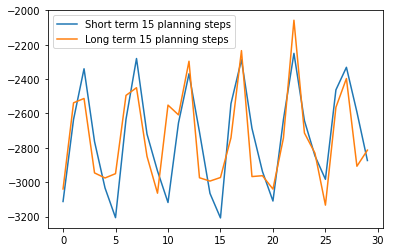

In [88]:
plt.figure()
plt.plot(reward_15_st, label = "Short term 15 planning steps")
# plt.plot(reward_30_st, label = "Short term 30 planning steps")
# plt.plot(reward_45_st, label = "Short term 45 planning steps")
# plt.plot(reward_60_st, label = "Short term 60 planning steps")
plt.plot(reward_15_lt, label = "Long term 15 planning steps")
# plt.plot(reward_30_lt, label = "Long term 30 planning steps")
# plt.plot(reward_45_lt, label = "Long term 45 planning steps")
# plt.plot(reward_60_lt, label = "Long term 60 planning steps")
plt.legend()
plt.show()


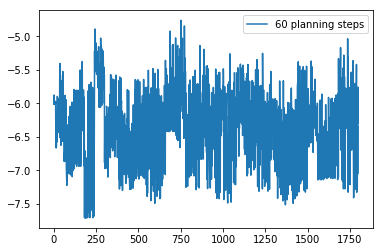

In [73]:
plt.figure()
# plt.plot(planning_rewards_15_lt, label = "15 planning steps")
# plt.plot(planning_rewards_30_lt, label = "30 planning steps")
# plt.plot(planning_rewards_45_lt, label = "45 planning steps")
plt.plot(planning_rewards_60_lt, label = "60 planning steps")
plt.legend()


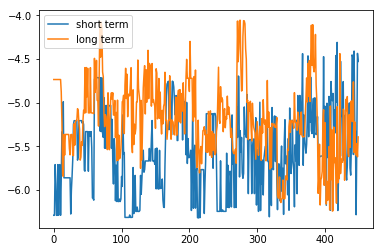

In [80]:
plt.figure()
plt.plot(planning_rewards_15_st, label = "short term")
plt.plot(planning_rewards_15_lt, label = "long term")
plt.legend()
plt.show()

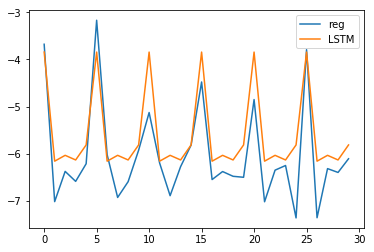

In [111]:
plt.figure()
plt.plot(reward_15_reg, label="reg")
plt.plot(rewards_batch_15, label = "LSTM")
plt.legend()
plt.show()

# Experiments to run tonight




In [187]:
baus = []
planning_baus = []

for i in range(10):
    bau, planning_bau = train(
             response_type_str = "mixed", 
             extra_train = 0, 
             energy = True,
             day_of_week = True,
             planning_model = False,
             one_day = True,
             planning_iterations = 50, 
             batch_size_agent = 5                                                                                                                               
             )
    baus.append(bau)
    planning_baus.append(planning_bau)


BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18
Day: 19
Day: 20
Day: 21
Day: 22
Day: 23
Day: 24
Day: 25
Day: 26
Day: 27
Day: 28
Day: 29
Day: 30
Day: 31
--------------------------------------------------------------------------------
Day: 32
--------------------------------------------------------------------------------
Day: 33
--------------------------------------------------------------------------------
Day: 34
--------------------------------------------------------------------------------
Day: 35
--------------------------------------------------------------------------------
Day: 36
--------------------------------------------------------------------------------
Day: 37
--------------------------------------------------------------------------------
Day: 38
--------------------------------------------------------------------------------
Day: 39
------------

--------------------------------------------------------------------------------
Day: 55
--------------------------------------------------------------------------------
Day: 56
--------------------------------------------------------------------------------
Day: 57
--------------------------------------------------------------------------------
Day: 58
--------------------------------------------------------------------------------
Day: 59
--------------------------------------------------------------------------------
Day: 60
--------------------------------------------------------------------------------
BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18
Day: 19
Day: 20
Day: 21
Day: 22
Day: 23
Day: 24
Day: 25
Day: 26
Day: 27
Day: 28
Day: 29
Day: 30
Day: 31
--------------------------------------------------------------------------------
Day: 32
--------------------

--------------------------------------------------------------------------------
Day: 49
--------------------------------------------------------------------------------
Day: 50
--------------------------------------------------------------------------------
Day: 51
--------------------------------------------------------------------------------
Day: 52
--------------------------------------------------------------------------------
Day: 53
--------------------------------------------------------------------------------
Day: 54
--------------------------------------------------------------------------------
Day: 55
--------------------------------------------------------------------------------
Day: 56
--------------------------------------------------------------------------------
Day: 57
--------------------------------------------------------------------------------
Day: 58
--------------------------------------------------------------------------------
Day: 59
---------------------

--------------------------------------------------------------------------------
Day: 43
--------------------------------------------------------------------------------
Day: 44
--------------------------------------------------------------------------------
Day: 45
--------------------------------------------------------------------------------
Day: 46
--------------------------------------------------------------------------------
Day: 47
--------------------------------------------------------------------------------
Day: 48
--------------------------------------------------------------------------------
Day: 49
--------------------------------------------------------------------------------
Day: 50
--------------------------------------------------------------------------------
Day: 51
--------------------------------------------------------------------------------
Day: 52
--------------------------------------------------------------------------------
Day: 53
---------------------

In [188]:
bau

[-4.670217526543363,
 -5.934569604298671,
 -5.772273277267525,
 -5.97654519829468,
 -5.978128145288192,
 -4.670217526543363,
 -5.934598957325739,
 -5.772273277267525,
 -5.976546620536306,
 -6.015691218918661,
 -4.670217526543363,
 -5.934598957325739,
 -5.772273277267525,
 -5.976546620536306,
 -5.978128145288192,
 -4.670217526543363,
 -5.934598957325739,
 -5.772273277267525,
 -5.976546620536306,
 -5.978128145288192,
 -4.670217526543363,
 -5.934598957325739,
 -5.772272492914472,
 -5.718404038795092,
 -5.954175760589229,
 -4.670217526543363,
 -5.934598957325739,
 -5.772273277267525,
 -5.976546620536306,
 -5.978128145288192]

Text(0.5,1,'RL Agent alone, reward over 30 days of the same price')

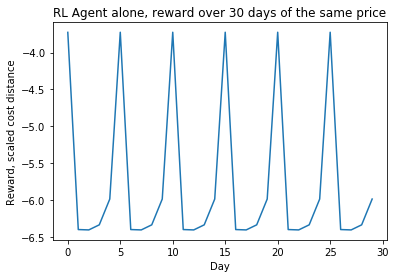

In [183]:
plt.figure()
plt.plot(bau)
plt.xlabel("Day")
plt.ylabel("Reward, scaled cost distance")
plt.title("RL Agent alone, reward over 30 days of the same price")

### Batch Sizes: need to graph and compare internally, currently

In [146]:
rewards_batch_5_nn, planning_b_5_nn = train(
         response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 50, 
         batch_size_agent = 5                                                                                                                               
         )

rewards_batch_20_nn, planning_b_20_nn = train(
         response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 50, 
         batch_size_agent = 20                                                                                                                               
         )

rewards_batch_50_nn, planning_b_35_nn = train(
         response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 50, 
         batch_size_agent = 35                                                                                                                                
         )

rewards_batch_50_nn, planning_b_50_nn = train(
         response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 50, 
         batch_size_agent = 50                                                                                                                               
         )

rewards_batch_50_nn_md, planning_b_50_nn_md = train(
         response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = False,
         planning_iterations = 50, 
         batch_size_agent = 50                                                                                                                               
         )

rewards_batch_5_ols, planning_b_5_ols = train(
         response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 50, 
         batch_size_agent = 5,
         planning_model_type = "OLS" 
         )

rewards_batch_20_ols, planning_b_20_ols = train(
         response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 50, 
         batch_size_agent = 20,
         planning_model_type = "OLS"                                                                                                                              
         )

rewards_batch_50_ols, planning_b_35_ols = train(
         response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 50, 
         batch_size_agent = 35,
         planning_model_type = "OLS"                                                                                                                               
         )

rewards_batch_50_ols, planning_b_50_ols = train(
         response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 50, 
         batch_size_agent = 50,
         planning_model_type = "OLS"                                                                                                                           
         )

rewards_batch_50_ols_md, planning_b_50_ols_md = train(
         response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = False,
         planning_iterations = 50, 
         batch_size_agent = 50,
         planning_model_type = "OLS"                                                                                                                           
         )

BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18
Day: 19
Day: 20
Day: 21
Day: 22
Day: 23
Day: 24
Day: 25
Day: 26
Day: 27
Day: 28
Day: 29
Day: 30
Day: 31
Loaded model from disk
--------------------
 planning step 0
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 4.7683716e-07 0.0000000e+00
 1.0000000e+01 0.0000000e+00 2.8500557e-03 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 1
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 2.8500557e-03 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 2
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 9.9958115e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 2.8500557e-03 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 3
action: [1.0000000e+01 0.0000000e+00 2.5300980e-03 0.0000000e+00 0.0000000e+00
 1.0000000e+01 0.

--------------------
 planning step 46
action: [10.          0.          0.441895   10.          0.          0.03264284
  0.          2.8252668   0.          0.        ]
--------------------
 planning step 47
action: [10.          0.          9.999764    9.996636    0.          0.05796051
  0.          3.757206    0.          0.        ]
--------------------
 planning step 48
action: [10.          0.          9.999999    0.          0.          0.18601036
  0.          5.593805    0.          0.        ]
--------------------
 planning step 49
action: [10.          0.          0.          9.895309    0.          0.96100616
  0.          5.989173    0.          0.        ]
--------------------------------------------------------------------------------
Day: 32
Loaded model from disk
--------------------
 planning step 0
action: [10.  0.  0. 10.  0. 10.  0. 10.  0.  0.]
--------------------
 planning step 1
action: [10.  0.  0.  0.  0. 10.  0. 10.  0.  0.]
--------------------
 planning s

--------------------
 planning step 2
action: [10.        0.        0.        9.999945  0.       10.        0.
  9.999889  0.        0.      ]
--------------------
 planning step 3
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 2.3317337e-04 0.0000000e+00
 1.0000000e+01 0.0000000e+00 9.9999027e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 4
action: [10.        0.        0.       10.        0.       10.        0.
  9.999913  0.        0.      ]
--------------------
 planning step 5
action: [10.        0.        0.        9.313793  0.       10.        0.
  9.99992   0.        0.      ]
--------------------
 planning step 6
action: [10.        0.        0.        0.        0.       10.        0.
  9.999915  0.        0.      ]
--------------------
 planning step 7
action: [10.        0.        0.        9.999971  0.       10.        0.
  9.999857  0.        0.      ]
--------------------
 planning step 8
action: [10.        0.        0.        9.998759  0.      

--------------------
 planning step 4
action: [10.         0.         0.         2.4345484  0.        10.
  0.         9.999899   0.         0.       ]
--------------------
 planning step 5
action: [1.0000000e+01 0.0000000e+00 5.1498413e-05 0.0000000e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 9.9999294e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 6
action: [10.          0.          0.          0.04732466  0.         10.
  0.          9.999949    0.          0.        ]
--------------------
 planning step 7
action: [1.0000000e+01 0.0000000e+00 1.0204315e-04 1.3589859e-04 0.0000000e+00
 1.0000000e+01 0.0000000e+00 9.9999447e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 8
action: [10.        0.        0.       10.        0.       10.        0.
  9.999916  0.        0.      ]
--------------------
 planning step 9
action: [1.000000e+01 0.000000e+00 9.954357e-02 5.883217e-03 0.000000e+00
 1.000000e+01 0.000000e+00 9.999872e+00 0.000000e+00 0

--------------------
 planning step 5
action: [1.0000000e+01 0.0000000e+00 4.7683716e-07 7.4181271e-01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 9.3818054e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 6
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 5.7435036e-03 0.0000000e+00
 1.0000000e+01 0.0000000e+00 9.0599995e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 7
action: [1.0000000e+01 0.0000000e+00 6.5844536e-02 1.8596649e-05 0.0000000e+00
 1.0000000e+01 0.0000000e+00 8.7386827e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 8
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 5.8174133e-05 0.0000000e+00
 1.0000000e+01 0.0000000e+00 9.1200943e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 9
action: [10.        0.        0.        9.999994  0.       10.        0.
  9.161587  0.        0.      ]
--------------------
 planning step 10
action: [10.         0.         6.92655    9.9999895  0.      

--------------------
 planning step 4
action: [1.00000000e+01 0.00000000e+00 8.11576843e-04 1.00000000e+01
 0.00000000e+00 1.00000000e+01 0.00000000e+00 1.46894455e-02
 0.00000000e+00 0.00000000e+00]
--------------------
 planning step 5
action: [1.000000e+01 0.000000e+00 9.419977e+00 9.387541e+00 0.000000e+00
 1.000000e+01 0.000000e+00 4.418373e-03 0.000000e+00 0.000000e+00]
--------------------
 planning step 6
action: [1.0000000e+01 0.0000000e+00 1.2340546e-03 0.0000000e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 3.2825470e-03 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 7
action: [1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00 0.000000e+00
 1.000000e+01 0.000000e+00 4.922867e-03 0.000000e+00 0.000000e+00]
--------------------
 planning step 8
action: [10.          0.          0.          9.621135    0.         10.
  0.          0.02320242  0.          0.        ]
--------------------
 planning step 9
action: [1.000000e+01 0.000000e+00 7.534027e-05 9.5367

--------------------
 planning step 1
action: [10.         0.         0.         4.8318906  0.        10.
  0.         9.999992   0.         0.       ]
--------------------
 planning step 2
action: [10.        0.       10.       10.        0.       10.        0.
  9.999998  0.        0.      ]
--------------------
 planning step 3
action: [1.000000e+01 0.000000e+00 9.536743e-07 9.993867e+00 0.000000e+00
 1.000000e+01 0.000000e+00 9.999999e+00 0.000000e+00 0.000000e+00]
--------------------
 planning step 4
action: [10.        0.       10.        9.995766  0.       10.        0.
  9.999999  0.        0.      ]
--------------------
 planning step 5
action: [10.        0.        9.873968  8.243595  0.       10.        0.
  9.999996  0.        0.      ]
--------------------
 planning step 6
action: [10.        0.        9.466785  9.259829  0.       10.        0.
  9.999988  0.        0.      ]
--------------------
 planning step 7
action: [10.        0.        9.999999  9.86561   0.       

--------------------
 planning step 1
action: [1.0000000e+01 0.0000000e+00 5.1851177e-01 3.8146973e-06 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.3571644e-01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 2
action: [1.0000000e+01 0.0000000e+00 9.8012295e+00 6.5946579e-04 0.0000000e+00
 1.0000000e+01 0.0000000e+00 6.9036007e-02 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 3
action: [10.          0.          9.742265    9.223883    0.         10.
  0.          0.07939529  0.          0.        ]
--------------------
 planning step 4
action: [10.         0.         9.982549   9.999998   0.        10.
  0.         0.1707182  0.         0.       ]
--------------------
 planning step 5
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 4.2991638e-03 0.0000000e+00
 1.0000000e+01 0.0000000e+00 5.1762486e-01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 6
action: [1.0000000e+01 0.0000000e+00 1.1534691e-03 2.8610229e-06 0.0000000e+00
 1.

Loaded model from disk
--------------------
 planning step 0
action: [10.         0.        10.         3.722421   0.        10.
  0.         1.6639404  0.         0.       ]
--------------------
 planning step 1
action: [10.         0.         9.963047  10.         0.        10.
  0.         1.4734955  0.         0.       ]
--------------------
 planning step 2
action: [10.         0.         9.777124   7.042112   0.        10.
  0.         0.7439947  0.         0.       ]
--------------------
 planning step 3
action: [10.          0.          9.997409   10.          0.         10.
  0.          0.15902233  0.          0.        ]
--------------------
 planning step 4
action: [1.0000000e+01 0.0000000e+00 3.9238930e-03 8.8410091e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.9182205e-02 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 5
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 2.2015572e-03 0.0000000e+00
 1.0000000e+01 0.0000000e+00 3.6172867e-03 0.0000000e+

--------------------
 planning step 46
action: [10.          0.          0.          9.858646    0.         10.
  0.          0.28916788  0.          0.        ]
--------------------
 planning step 47
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 3.8146973e-06 0.0000000e+00
 1.0000000e+01 0.0000000e+00 2.6831675e-01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 48
action: [10.          0.          0.          0.22704172  0.         10.
  0.          0.28348017  0.          0.        ]
--------------------
 planning step 49
action: [1.0000000e+01 0.0000000e+00 1.0013580e-05 7.9839797e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.7473364e-01 0.0000000e+00 0.0000000e+00]
--------------------------------------------------------------------------------
Day: 40
Loaded model from disk
--------------------
 planning step 0
action: [10.        0.        0.        0.        0.       10.        0.
  9.211174  0.        0.      ]
--------------------
 planning step 1
act

--------------------
 planning step 47
action: [1.0000000e+01 0.0000000e+00 9.2046013e+00 1.4305115e-06 0.0000000e+00
 1.0000000e+01 0.0000000e+00 8.7531071e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 48
action: [10.         0.         3.0435991  9.787112   0.        10.
  0.         8.538492   0.         0.       ]
--------------------
 planning step 49
action: [10.        0.        9.995267  9.977369  0.       10.        0.
  9.47046   0.        0.      ]
--------------------------------------------------------------------------------
Day: 41
Loaded model from disk
--------------------
 planning step 0
action: [1.0000000e+01 0.0000000e+00 1.9636154e-03 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 5.7459230e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 1
action: [10.         0.         9.3692875 10.         0.        10.
  0.         8.679605   0.         0.       ]
--------------------
 planning step 2
action: [1.0000000e+01

--------------------
 planning step 44
action: [1.0000000e+01 0.0000000e+00 4.7683716e-07 2.1246171e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.8416545e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 45
action: [10.          0.          0.04685307 10.          0.         10.
  0.          4.271443    0.          0.        ]
--------------------
 planning step 46
action: [10.         0.         9.002526   9.997572   0.        10.
  0.         3.2552116  0.         0.       ]
--------------------
 planning step 47
action: [1.0000000e+01 0.0000000e+00 2.0980835e-05 1.2370157e-01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 9.8419905e-01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 48
action: [10.          0.         10.         10.          0.         10.
  0.          0.21351862  0.          0.        ]
--------------------
 planning step 49
action: [10.          0.         10.         10.          0.         10.
  0.          0.03674936  0.   

--------------------
 planning step 44
action: [10.        0.       10.        0.        0.       10.        0.
  9.928305  0.        0.      ]
--------------------
 planning step 45
action: [10.          0.         10.          0.82336044  0.         10.
  0.          9.821451    0.          0.        ]
--------------------
 planning step 46
action: [10.          0.          0.02433252  0.          0.         10.
  0.          9.654162    0.          0.        ]
--------------------
 planning step 47
action: [10.        0.       10.       10.        0.       10.        0.
  8.626207  0.        0.      ]
--------------------
 planning step 48
action: [10.        0.        9.985462  0.        0.       10.        0.
  6.43715   0.        0.      ]
--------------------
 planning step 49
action: [10.         0.        10.         9.513315   0.        10.
  0.         6.1997485  0.         0.       ]
--------------------------------------------------------------------------------
Day: 43
Lo

--------------------
 planning step 43
action: [1.0000000e+01 0.0000000e+00 4.7683716e-07 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 3.6969614e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 44
action: [10.        0.       10.        8.459517  0.       10.        0.
  4.103662  0.        0.      ]
--------------------
 planning step 45
action: [10.         0.         0.         9.66515    0.        10.
  0.         4.2276917  0.         0.       ]
--------------------
 planning step 46
action: [10.          0.          0.          0.17819309  0.         10.
  0.          3.566558    0.          0.        ]
--------------------
 planning step 47
action: [10.         0.         9.999828   9.999834   0.        10.
  0.         3.2110896  0.         0.       ]
--------------------
 planning step 48
action: [10.        0.        0.        8.956995  0.       10.        0.
  2.053432  0.        0.      ]
--------------------
 planning step 49
action: [10.   

--------------------
 planning step 43
action: [1.0000000e+01 0.0000000e+00 3.2901764e-05 0.0000000e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 8.9407482e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 44
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 7.1525574e-05 0.0000000e+00
 1.0000000e+01 0.0000000e+00 9.3349237e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 45
action: [10.          0.          9.886036    0.12033033  0.         10.
  0.          9.539482    0.          0.        ]
--------------------
 planning step 46
action: [10.        0.       10.        9.724058  0.       10.        0.
  9.752103  0.        0.      ]
--------------------
 planning step 47
action: [10.        0.        8.473997 10.        0.       10.        0.
  9.822569  0.        0.      ]
--------------------
 planning step 48
action: [10.         0.        10.         1.7424247  0.        10.
  0.         9.8351555  0.         0.       ]
-----------------

--------------------
 planning step 42
action: [10.          0.          9.615444    9.856443    0.         10.
  0.          0.42344904  0.          0.        ]
--------------------
 planning step 43
action: [1.0000000e+01 0.0000000e+00 9.9995670e+00 5.2452087e-06 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.2039232e-01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 44
action: [1.0000000e+01 0.0000000e+00 1.5735626e-05 0.0000000e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 9.8871708e-02 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 45
action: [10.          0.         10.          0.          0.         10.
  0.          0.13873291  0.          0.        ]
--------------------
 planning step 46
action: [1.0000000e+01 0.0000000e+00 5.3787231e-04 9.4175968e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 2.9431534e-01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 47
action: [1.0000000e+01 0.0000000e+00 9.9919949e+00 6.7424774e-03 0.

--------------------
 planning step 42
action: [10.         0.         0.         9.999987   0.        10.
  0.         1.4240286  0.         0.       ]
--------------------
 planning step 43
action: [10.          0.          0.02732229  9.584738    0.         10.
  0.          1.5539045   0.          0.        ]
--------------------
 planning step 44
action: [10.        0.        9.983118  9.999999  0.       10.        0.
  3.345735  0.        0.      ]
--------------------
 planning step 45
action: [10.        0.        9.699238  9.603378  0.       10.        0.
  6.463064  0.        0.      ]
--------------------
 planning step 46
action: [1.000000e+01 0.000000e+00 5.722046e-06 9.875782e+00 0.000000e+00
 1.000000e+01 0.000000e+00 9.323662e+00 0.000000e+00 0.000000e+00]
--------------------
 planning step 47
action: [1.0000000e+01 0.0000000e+00 3.7670135e-05 0.0000000e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 9.8480225e+00 0.0000000e+00 0.0000000e+00]
--------------------
 plann

--------------------
 planning step 39
action: [1.00000000e+01 0.00000000e+00 8.29696655e-05 1.04494095e-01
 0.00000000e+00 1.00000000e+01 0.00000000e+00 1.57227039e-01
 0.00000000e+00 0.00000000e+00]
--------------------
 planning step 40
action: [10.          0.          0.          9.999386    0.         10.
  0.          0.10887623  0.          0.        ]
--------------------
 planning step 41
action: [1.000000e+01 0.000000e+00 9.536743e-07 8.819516e+00 0.000000e+00
 1.000000e+01 0.000000e+00 5.359173e-02 0.000000e+00 0.000000e+00]
--------------------
 planning step 42
action: [10.          0.         10.          0.          0.         10.
  0.          0.03372192  0.          0.        ]
--------------------
 planning step 43
action: [1.0000000e+01 0.0000000e+00 8.5830688e-06 4.2288303e-02 0.0000000e+00
 1.0000000e+01 0.0000000e+00 2.2182941e-02 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 44
action: [10.          0.          9.756762    0.06577015  0.      

--------------------
 planning step 38
action: [1.0000000e+01 0.0000000e+00 1.6241074e-03 0.0000000e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 6.3492336e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 39
action: [10.         0.         2.2916868  4.0042877  0.        10.
  0.         7.4215174  0.         0.       ]
--------------------
 planning step 40
action: [10.          0.          9.989714    0.05057287  0.         10.
  0.          7.9234896   0.          0.        ]
--------------------
 planning step 41
action: [1.0000000e+01 0.0000000e+00 2.8409958e-03 9.9632463e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 7.8910832e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 42
action: [10.         0.         8.821989   3.1365356  0.        10.
  0.         6.523996   0.         0.       ]
--------------------
 planning step 43
action: [10.         0.        10.         0.2100873  0.        10.
  0.         4.0561137  0.         0.       ]

--------------------
 planning step 37
action: [1.0000000e+01 0.0000000e+00 9.9819851e+00 2.1791458e-04 0.0000000e+00
 1.0000000e+01 0.0000000e+00 5.7363625e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 38
action: [10.         0.        10.         0.         0.        10.
  0.         5.7321854  0.         0.       ]
--------------------
 planning step 39
action: [10.         0.        10.         4.4204903  0.        10.
  0.         3.9992087  0.         0.       ]
--------------------
 planning step 40
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 3.8146973e-06 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.3327744e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 41
action: [10.         0.         9.999999  10.         0.        10.
  0.         0.5729027  0.         0.       ]
--------------------
 planning step 42
action: [1.0000000e+01 0.0000000e+00 5.6037903e-03 9.9938049e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 6.2224293e-01 

--------------------
 planning step 36
action: [1.0000000e+01 0.0000000e+00 6.9046021e-04 0.0000000e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 7.5147853e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 37
action: [10.         0.         0.         0.0542078  0.        10.
  0.         8.23144    0.         0.       ]
--------------------
 planning step 38
action: [10.        0.        9.999999  9.999315  0.       10.        0.
  6.744143  0.        0.      ]
--------------------
 planning step 39
action: [10.         0.         9.992836   3.0314608  0.        10.
  0.         3.9813962  0.         0.       ]
--------------------
 planning step 40
action: [10.         0.         3.843021   9.998293   0.        10.
  0.         2.6716342  0.         0.       ]
--------------------
 planning step 41
action: [10.         0.         9.996248   9.999462   0.        10.
  0.         2.6382422  0.         0.       ]
--------------------
 planning step 42
action: [10.   

--------------------
 planning step 36
action: [1.0000000e+01 0.0000000e+00 2.8834419e+00 8.1062317e-06 0.0000000e+00
 1.0000000e+01 0.0000000e+00 5.8358164e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 37
action: [10.         0.         0.         9.9993305  0.        10.
  0.         4.486722   0.         0.       ]
--------------------
 planning step 38
action: [10.        0.        0.        9.999986  0.       10.        0.
  4.22312   0.        0.      ]
--------------------
 planning step 39
action: [10.        0.        9.999938  0.        0.       10.        0.
  3.712339  0.        0.      ]
--------------------
 planning step 40
action: [10.         0.         6.6148653 10.         0.        10.
  0.         3.294255   0.         0.       ]
--------------------
 planning step 41
action: [10.         0.         9.98057    0.         0.        10.
  0.         2.6131754  0.         0.       ]
--------------------
 planning step 42
action: [10.         0. 

--------------------
 planning step 37
action: [10.         0.         0.         0.         0.        10.
  0.         1.0058885  0.         0.       ]
--------------------
 planning step 38
action: [1.0000000e+01 0.0000000e+00 3.4427643e-04 0.0000000e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 6.8633127e-01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 39
action: [1.0000000e+01 0.0000000e+00 5.1557417e+00 7.7600479e-03 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.2366686e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 40
action: [10.         0.         0.         9.326906   0.        10.
  0.         2.5499802  0.         0.       ]
--------------------
 planning step 41
action: [1.0000000e+01 0.0000000e+00 2.0456314e-04 7.7969971e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 4.0106211e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 42
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 9.5367432e-06 0.0000000e+00
 1.000

--------------------
 planning step 36
action: [1.0000000e+01 0.0000000e+00 4.7683716e-07 9.9999981e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.8839998e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 37
action: [1.0000000e+01 0.0000000e+00 1.7213821e-04 9.9972668e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.5569787e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 38
action: [10.          0.          0.01816511  9.999991    0.         10.
  0.          3.029964    0.          0.        ]
--------------------
 planning step 39
action: [1.000000e+01 0.000000e+00 9.819802e+00 9.536743e-07 0.000000e+00
 1.000000e+01 0.000000e+00 6.718664e+00 0.000000e+00 0.000000e+00]
--------------------
 planning step 40
action: [10.         0.         9.991735  10.         0.        10.
  0.         7.9086766  0.         0.       ]
--------------------
 planning step 41
action: [10.        0.        9.981321 10.        0.       10.        0.
  7.468094  0

--------------------
 planning step 34
action: [10.         0.         9.650743   9.987553   0.        10.
  0.         2.7417712  0.         0.       ]
--------------------
 planning step 35
action: [1.0000000e+01 0.0000000e+00 1.8367767e-03 4.3535233e-04 0.0000000e+00
 1.0000000e+01 0.0000000e+00 3.0078812e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 36
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 1.5735626e-05 0.0000000e+00
 1.0000000e+01 0.0000000e+00 3.1524878e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 37
action: [10.         0.        10.         0.         0.        10.
  0.         3.0420256  0.         0.       ]
--------------------
 planning step 38
action: [10.         0.        10.         8.020439   0.        10.
  0.         2.9200346  0.         0.       ]
--------------------
 planning step 39
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 2.5143623e-03 0.0000000e+00
 1.0000000e+01 0.0000000e+00 2.3606327e+00 

--------------------
 planning step 32
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 8.0585480e-05 0.0000000e+00
 1.0000000e+01 0.0000000e+00 2.5643644e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 33
action: [10.         0.         9.99505    0.         0.        10.
  0.         1.0495307  0.         0.       ]
--------------------
 planning step 34
action: [10.          0.          0.          9.99998     0.         10.
  0.          0.66510487  0.          0.        ]
--------------------
 planning step 35
action: [10.          0.          0.          0.17747164  0.         10.
  0.          0.66777325  0.          0.        ]
--------------------
 planning step 36
action: [10.          0.          0.          0.02231598  0.         10.
  0.          0.9212427   0.          0.        ]
--------------------
 planning step 37
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 7.0314407e-03 0.0000000e+00
 1.0000000e+01 0.0000000e+00 2.4077513e+00 0.0000000e

--------------------
 planning step 31
action: [1.000000e+01 0.000000e+00 8.136747e+00 7.944107e-04 0.000000e+00
 1.000000e+01 0.000000e+00 2.875680e+00 0.000000e+00 0.000000e+00]
--------------------
 planning step 32
action: [10.         0.         9.999993   0.         0.        10.
  0.         1.1840739  0.         0.       ]
--------------------
 planning step 33
action: [10.          0.          9.99842     0.02905083  0.         10.
  0.          0.696908    0.          0.        ]
--------------------
 planning step 34
action: [1.0000000e+01 0.0000000e+00 3.2186508e-04 9.5367432e-06 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0038400e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 35
action: [1.0000000e+01 0.0000000e+00 8.2605228e+00 8.5763931e-03 0.0000000e+00
 1.0000000e+01 0.0000000e+00 3.1735983e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 36
action: [10.         0.         9.974552   0.3644476  0.        10.
  0.         4.724

--------------------
 planning step 29
action: [1.0000000e+01 0.0000000e+00 4.2438507e-04 9.9998045e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.8649516e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 30
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 1.7642975e-05 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.4337158e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 31
action: [1.00000000e+01 0.00000000e+00 9.98643875e+00 1.02996826e-04
 0.00000000e+00 1.00000000e+01 0.00000000e+00 2.35715055e+00
 0.00000000e+00 0.00000000e+00]
--------------------
 planning step 32
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 4.7683716e-07 0.0000000e+00
 1.0000000e+01 0.0000000e+00 4.1614976e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 33
action: [10.        0.       10.        8.776077  0.       10.        0.
  4.99273   0.        0.      ]
--------------------
 planning step 34
action: [10.         0.        10.         9.9

--------------------
 planning step 27
action: [10.         0.         9.998007   0.         0.        10.
  0.         6.2405205  0.         0.       ]
--------------------
 planning step 28
action: [10.         0.         5.381812  10.         0.        10.
  0.         3.5349598  0.         0.       ]
--------------------
 planning step 29
action: [1.0000000e+01 0.0000000e+00 1.6279697e-02 2.7656555e-05 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.2370417e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 30
action: [1.0000000e+01 0.0000000e+00 9.5367432e-07 4.7683716e-07 0.0000000e+00
 1.0000000e+01 0.0000000e+00 6.9678497e-01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 31
action: [10.          0.          0.18102455  2.0966175   0.         10.
  0.          0.8679528   0.          0.        ]
--------------------
 planning step 32
action: [1.0000000e+01 0.0000000e+00 1.2335777e-03 9.9999771e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 2.623

--------------------
 planning step 25
action: [1.0000000e+01 0.0000000e+00 2.8614998e-03 0.0000000e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 2.2259605e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 26
action: [10.          0.          0.8547797   0.10133791  0.         10.
  0.          2.381802    0.          0.        ]
--------------------
 planning step 27
action: [1.0000000e+01 0.0000000e+00 7.6379776e-03 0.0000000e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 3.0101585e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 28
action: [10.         0.         9.5406     0.         0.        10.
  0.         3.7075977  0.         0.       ]
--------------------
 planning step 29
action: [10.          0.          0.01685047  0.          0.         10.
  0.          3.1909418   0.          0.        ]
--------------------
 planning step 30
action: [10.          0.          0.17671871  7.9475946   0.         10.
  0.          2.3272414   0.   

--------------------
 planning step 22
action: [10.         0.         9.981274   0.         0.        10.
  0.         3.4913049  0.         0.       ]
--------------------
 planning step 23
action: [1.0000000e+01 0.0000000e+00 9.6511841e-04 4.7683716e-07 0.0000000e+00
 1.0000000e+01 0.0000000e+00 4.0205240e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 24
action: [10.         0.         9.968954   4.0771933  0.        10.
  0.         3.0839949  0.         0.       ]
--------------------
 planning step 25
action: [10.         0.         9.577251   0.         0.        10.
  0.         1.9782367  0.         0.       ]
--------------------
 planning step 26
action: [10.          0.          0.22280598  9.999157    0.         10.
  0.          1.6184697   0.          0.        ]
--------------------
 planning step 27
action: [10.         0.         9.888853   0.         0.        10.
  0.         1.8023691  0.         0.       ]
--------------------
 planning step 

--------------------
 planning step 26
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 2.2411346e-05 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 27
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 28
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 29
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 8.149147e-04 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 30
action: [10. 10. 10. 10. 10.  0. 10.  0. 10. 10.]
--------------------
 planning step 31
action: [10.       10.       10.       10.       10.        0.        8.754974
  0.       10.       10.      ]
--------------------
 planning step 32
action: [10.        10.        10.        10.        10.         0.
  3.2805457  0.        10.        10.       ]
--------------------
 planning step 33
action: [10. 10. 10. 

--------------------
 planning step 36
action: [10. 10. 10. 10. 10.  0. 10.  0. 10. 10.]
--------------------
 planning step 37
action: [10.       10.       10.       10.       10.        0.        9.999978
  0.       10.       10.      ]
--------------------
 planning step 38
action: [10.       10.       10.       10.       10.        0.        9.999977
  0.       10.       10.      ]
--------------------
 planning step 39
action: [10.       10.       10.       10.       10.        0.        9.549013
  0.       10.       10.      ]
--------------------
 planning step 40
action: [10.       10.       10.       10.       10.        0.        9.999994
  0.       10.       10.      ]
--------------------
 planning step 41
action: [10.       10.       10.       10.       10.        0.        9.999835
  0.       10.       10.      ]
--------------------
 planning step 42
action: [10. 10. 10. 10. 10.  0. 10.  0. 10. 10.]
--------------------
 planning step 43
action: [10.       10.       10. 

--------------------
 planning step 45
action: [10.       10.       10.       10.       10.        0.        9.998255
  0.       10.       10.      ]
--------------------
 planning step 46
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 47
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 48
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 2.861023e-06 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 49
action: [10.       10.       10.       10.       10.        0.        9.707008
  0.       10.       10.      ]
--------------------------------------------------------------------------------
Day: 34
Loaded model from disk
--------------------
 planning step 0
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 9.536743e-07 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 1
action: [10. 

--------------------
 planning step 4
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 5
action: [10. 10. 10. 10. 10.  0. 10.  0. 10. 10.]
--------------------
 planning step 6
action: [10.       10.       10.       10.       10.        0.        7.561404
  0.       10.       10.      ]
--------------------
 planning step 7
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 5.722046e-06 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 8
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 4.1441917e-03 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 9
action: [10.      10.      10.      10.      10.       0.       9.99555  0.
 10.      10.     ]
--------------------
 planning step 10
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 11
action: [1.000000e+01 1.000000e+01 1.000000e+

--------------------
 planning step 11
action: [10.       10.       10.       10.       10.        0.        9.999939
  0.       10.       10.      ]
--------------------
 planning step 12
action: [10.         10.         10.         10.         10.          0.
  0.01997042  0.         10.         10.        ]
--------------------
 planning step 13
action: [10.       10.       10.       10.       10.        0.        9.644882
  0.       10.       10.      ]
--------------------
 planning step 14
action: [10.       10.       10.       10.       10.        0.        4.435652
  0.       10.       10.      ]
--------------------
 planning step 15
action: [10.       10.       10.       10.       10.        0.        0.880105
  0.       10.       10.      ]
--------------------
 planning step 16
action: [10.       10.       10.       10.       10.        0.        9.072315
  0.       10.       10.      ]
--------------------
 planning step 17
action: [10. 10. 10. 10. 10.  0. 10.  0. 10. 10.]

--------------------
 planning step 17
action: [10.       10.       10.       10.       10.        0.        9.999839
  0.       10.       10.      ]
--------------------
 planning step 18
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 8.755684e-03 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 19
action: [10.       10.       10.       10.       10.        0.        9.999996
  0.       10.       10.      ]
--------------------
 planning step 20
action: [10. 10. 10. 10. 10.  0. 10.  0. 10. 10.]
--------------------
 planning step 21
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 7.1177483e-03 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 22
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 23
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 5.4826736e-03 0.000

--------------------
 planning step 21
action: [10.         10.         10.         10.         10.          0.
  0.01839256  0.         10.         10.        ]
--------------------
 planning step 22
action: [10. 10. 10. 10. 10.  0. 10.  0. 10. 10.]
--------------------
 planning step 23
action: [10.         10.         10.         10.         10.          0.
  0.02929497  0.         10.         10.        ]
--------------------
 planning step 24
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.4305115e-05 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 25
action: [10. 10. 10. 10. 10.  0. 10.  0. 10. 10.]
--------------------
 planning step 26
action: [10.       10.       10.       10.       10.        0.        9.999851
  0.       10.       10.      ]
--------------------
 planning step 27
action: [10.       10.       10.       10.       10.        0.        5.325778
  0.       10.       10.      ]
--------

--------------------
 planning step 28
action: [10.       10.       10.       10.       10.        0.        5.696951
  0.       10.       10.      ]
--------------------
 planning step 29
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.2350082e-03 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 30
action: [10.       10.       10.       10.       10.        0.        9.999637
  0.       10.       10.      ]
--------------------
 planning step 31
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 3.1471252e-05 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 32
action: [10.         10.         10.         10.         10.          0.
  0.46202278  0.         10.         10.        ]
--------------------
 planning step 33
action: [10.       10.       10.       10.       10.        0.        9.963728
  0.       10.       10.      ]
--------

--------------------
 planning step 34
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 35
action: [10. 10. 10. 10. 10.  0. 10.  0. 10. 10.]
--------------------
 planning step 36
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 37
action: [10.        10.        10.        10.        10.         0.
  3.2961764  0.        10.        10.       ]
--------------------
 planning step 38
action: [10. 10. 10. 10. 10.  0. 10.  0. 10. 10.]
--------------------
 planning step 39
action: [10.         10.         10.         10.         10.          0.
  0.15826797  0.         10.         10.        ]
--------------------
 planning step 40
action: [10. 10. 10. 10. 10.  0. 10.  0. 10. 10.]
--------------------
 planning step 41
action: [10. 10. 10. 10. 10.  0. 10.  0. 10. 10.]
--------------------
 planning step 42
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 43
action: [1.0000000e+01 

--------------------
 planning step 46
action: [10. 10. 10. 10. 10.  0. 10.  0. 10. 10.]
--------------------
 planning step 47
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 8.816719e-04 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 48
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 3.695488e-04 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 49
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------------------------------------------------------------------
Day: 42
Loaded model from disk
--------------------
 planning step 0
action: [10.       10.       10.       10.       10.        0.        9.999998
  0.       10.       10.      ]
--------------------
 planning step 1
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 2
action: [10.       10.       10.       10.       10.        0.        9.998

--------------------
 planning step 3
action: [10. 10. 10. 10. 10.  0. 10.  0. 10. 10.]
--------------------
 planning step 4
action: [10. 10. 10. 10. 10.  0. 10.  0. 10. 10.]
--------------------
 planning step 5
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 2.8133392e-05 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 6
action: [10.       10.       10.       10.       10.        0.        9.859596
  0.       10.       10.      ]
--------------------
 planning step 7
action: [10.       10.       10.       10.       10.        0.        9.999285
  0.       10.       10.      ]
--------------------
 planning step 8
action: [10.       10.       10.       10.       10.        0.        9.797138
  0.       10.       10.      ]
--------------------
 planning step 9
action: [10.       10.       10.       10.       10.        0.        9.864008
  0.       10.       10.      ]
--------------------
 planning step 10


--------------------
 planning step 13
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 14
action: [10.       10.       10.       10.       10.        0.        9.999401
  0.       10.       10.      ]
--------------------
 planning step 15
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 16
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 4.7683716e-07 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 17
action: [10.        10.        10.        10.        10.         0.
  9.8574915  0.        10.        10.       ]
--------------------
 planning step 18
action: [10.       10.       10.       10.       10.        0.        9.975319
  0.       10.       10.      ]
--------------------
 planning step 19
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 20
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.0

--------------------
 planning step 20
action: [10.       10.       10.       10.       10.        0.        9.999996
  0.       10.       10.      ]
--------------------
 planning step 21
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 7.929325e-03 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 22
action: [10.        10.        10.        10.        10.         0.
  1.6585765  0.        10.        10.       ]
--------------------
 planning step 23
action: [10.        10.        10.        10.        10.         0.
  9.9999895  0.        10.        10.       ]
--------------------
 planning step 24
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.5616417e-03 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 25
action: [10. 10. 10. 10. 10.  0. 10.  0. 10. 10.]
--------------------
 planning step 26
action: [1.0000000e+01 1.0000000e+01 1.0000000

--------------------
 planning step 31
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 32
action: [10.         10.         10.         10.         10.          0.
  0.06974411  0.         10.         10.        ]
--------------------
 planning step 33
action: [10.        10.        10.        10.        10.         0.
  2.0181699  0.        10.        10.       ]
--------------------
 planning step 34
action: [10. 10. 10. 10. 10.  0. 10.  0. 10. 10.]
--------------------
 planning step 35
action: [10.         10.         10.         10.         10.          0.
  0.36646843  0.         10.         10.        ]
--------------------
 planning step 36
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 2.1791458e-04 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 37
action: [10.       10.       10.       10.       10.        0.        9.964276
  0.       10.       10.      ]
-----

--------------------
 planning step 37
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 38
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 39
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.3656616e-03 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 40
action: [10.       10.       10.       10.       10.        0.        8.289667
  0.       10.       10.      ]
--------------------
 planning step 41
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 9.279251e-04 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 42
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 43
action: [10.        10.        10.        10.        10.         0.
  1.0355344  0.        10.        10.       ]
--------------------
 planning step 44
action: [10. 10. 10. 

--------------------
 planning step 47
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 5.5122375e-03 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 48
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 49
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------------------------------------------------------------------
Day: 49
Loaded model from disk
--------------------
 planning step 0
action: [10. 10. 10. 10. 10.  0. 10.  0. 10. 10.]
--------------------
 planning step 1
action: [10. 10. 10. 10. 10.  0. 10.  0. 10. 10.]
--------------------
 planning step 2
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 3
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 4
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 5
action: [1.0000000e+01 1.0000000e+01 1.000

--------------------
 planning step 6
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.7499924e-04 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 7
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.6088486e-03 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 8
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 9
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 10
action: [10.        10.        10.        10.        10.         0.
  0.9262266  0.        10.        10.       ]
--------------------
 planning step 11
action: [10.       10.       10.       10.       10.        0.        9.998937
  0.       10.       10.      ]
--------------------
 planning step 12
action: [10.        10.        10.        10.        10.         0.
  7.9627566  0.        10.        10

--------------------
 planning step 17
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 2.4557114e-04 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 18
action: [10.       10.       10.       10.       10.        0.        9.995806
  0.       10.       10.      ]
--------------------
 planning step 19
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 20
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 7.724762e-05 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 21
action: [10.       10.       10.       10.       10.        0.        9.976982
  0.       10.       10.      ]
--------------------
 planning step 22
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 23
action: [10.         10.         10.         10.         10.          0.
  0.01443863  0.         10.         10.

--------------------
 planning step 28
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 29
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 30
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 31
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 2.6712418e-03 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 32
action: [10.       10.       10.       10.       10.        0.        6.876214
  0.       10.       10.      ]
--------------------
 planning step 33
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 34
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 35
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 4.7683716e-07 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 pla

--------------------
 planning step 45
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 4.7683716e-07 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 46
action: [10.       10.       10.       10.       10.        0.        9.991953
  0.       10.       10.      ]
--------------------
 planning step 47
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 48
action: [10.       10.       10.       10.       10.        0.        9.999334
  0.       10.       10.      ]
--------------------
 planning step 49
action: [10.        10.        10.        10.        10.         0.
  2.2620788  0.        10.        10.       ]
--------------------------------------------------------------------------------
Day: 54
Loaded model from disk
--------------------
 planning step 0
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 1
action: [1.0000000e+01 1.00000

--------------------
 planning step 3
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 4
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 3.528595e-05 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 5
action: [10.       10.       10.       10.       10.        0.        6.577635
  0.       10.       10.      ]
--------------------
 planning step 6
action: [10.        10.        10.        10.        10.         0.
  2.9990833  0.        10.        10.       ]
--------------------
 planning step 7
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.8167496e-04 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 8
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 9
action: [10.       10.       10.       10.       10.        0.        6.730087
  0.       10.       10.      ]
------

--------------------
 planning step 12
action: [10. 10. 10. 10. 10.  0. 10.  0. 10. 10.]
--------------------
 planning step 13
action: [10.       10.       10.       10.       10.        0.        9.999981
  0.       10.       10.      ]
--------------------
 planning step 14
action: [10.       10.       10.       10.       10.        0.        8.348095
  0.       10.       10.      ]
--------------------
 planning step 15
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 16
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 17
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 18
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 19
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 20
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 21
action: [10.        10.        10.    

--------------------
 planning step 27
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 28
action: [10.       10.       10.       10.       10.        0.        9.999911
  0.       10.       10.      ]
--------------------
 planning step 29
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 30
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 31
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 32
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 33
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 34
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 35
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 36
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 37
action: [1

--------------------
 planning step 44
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 45
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 46
action: [10.      10.      10.      10.      10.       0.       9.52075  0.
 10.      10.     ]
--------------------
 planning step 47
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 48
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 49
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 6.0129166e-04 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------------------------------------------------------------------
Day: 59
Loaded model from disk
--------------------
 planning step 0
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 3.8146973e-06 0.0000000e+00 1.0000000e+01 1.0000000e+01]
------------------

--------------------
 planning step 4
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 5
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 6
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 7
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 8
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 9
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 10
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 11
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 12
action: [10. 10. 10. 10. 10.  0.  0.  0. 10. 10.]
--------------------
 planning step 13
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.2350082e-04 0.0000000e+00 1.0000000e+01 1.0000000e+01]
---------------

--------------------
 planning step 13
action: [10.  0.  0.  0. 10. 10.  0.  0.  0. 10.]
--------------------
 planning step 14
action: [10.  0.  0.  0. 10. 10.  0.  0.  0. 10.]
--------------------
 planning step 15
action: [10.  0.  0.  0. 10. 10.  0.  0.  0. 10.]
--------------------
 planning step 16
action: [10.  0.  0.  0. 10. 10.  0.  0.  0. 10.]
--------------------
 planning step 17
action: [10.  0.  0.  0. 10. 10.  0.  0.  0. 10.]
--------------------
 planning step 18
action: [10.  0.  0.  0. 10. 10.  0.  0.  0. 10.]
--------------------
 planning step 19
action: [10.  0.  0.  0. 10. 10.  0.  0.  0. 10.]
--------------------
 planning step 20
action: [10.  0.  0.  0. 10. 10.  0.  0.  0. 10.]
--------------------
 planning step 21
action: [10.  0.  0.  0. 10. 10.  0.  0.  0. 10.]
--------------------
 planning step 22
action: [10.  0.  0.  0. 10. 10.  0.  0.  0. 10.]
--------------------
 planning step 23
action: [10.  0.  0.  0. 10. 10.  0.  0.  0. 10.]
--------------------


--------------------
 planning step 28
action: [10.        0.        0.        0.       10.       10.        0.
  9.999824  0.       10.      ]
--------------------
 planning step 29
action: [10.        0.       10.        0.       10.       10.        0.
  9.626339  0.       10.      ]
--------------------
 planning step 30
action: [10.         0.         9.841888   0.        10.        10.
  0.         9.9991865  0.        10.       ]
--------------------
 planning step 31
action: [10.        0.        9.971985  0.       10.       10.        0.
  9.999374  0.       10.      ]
--------------------
 planning step 32
action: [10.        0.        9.999999  0.       10.       10.        0.
  9.999737  0.       10.      ]
--------------------
 planning step 33
action: [10.        0.        9.999987  0.       10.       10.        0.
 10.        0.       10.      ]
--------------------
 planning step 34
action: [10.        0.        9.999947  0.       10.       10.        0.
  9.993729  0. 

--------------------
 planning step 29
action: [1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00 1.000000e+01
 1.000000e+01 0.000000e+00 6.771088e-05 0.000000e+00 1.000000e+01]
--------------------
 planning step 30
action: [10.  0.  0.  0. 10. 10.  0.  0.  0. 10.]
--------------------
 planning step 31
action: [10.         0.         9.996334   0.        10.        10.
  0.         0.8340416  0.        10.       ]
--------------------
 planning step 32
action: [10.        0.        0.        0.       10.       10.        0.
  9.922146  0.       10.      ]
--------------------
 planning step 33
action: [10.          0.          0.          0.         10.         10.
  0.          0.01137304  0.         10.        ]
--------------------
 planning step 34
action: [10.        0.        0.        0.       10.       10.        0.
  9.994972  0.       10.      ]
--------------------
 planning step 35
action: [1.0000000e+01 0.0000000e+00 4.9304438e-01 0.0000000e+00 1.0000000e+01
 1.0000000

--------------------
 planning step 29
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01
 1.0000000e+01 0.0000000e+00 1.4305115e-06 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 30
action: [1.0000000e+01 0.0000000e+00 1.2588501e-04 0.0000000e+00 1.0000000e+01
 1.0000000e+01 0.0000000e+00 9.9901466e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 31
action: [10.          0.          0.          0.         10.         10.
  0.          0.25527906  0.         10.        ]
--------------------
 planning step 32
action: [1.0000000e+01 0.0000000e+00 4.2533875e-04 0.0000000e+00 1.0000000e+01
 1.0000000e+01 0.0000000e+00 5.0747490e-01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 33
action: [10.        0.        9.891869  0.       10.       10.        0.
  9.999994  0.       10.      ]
--------------------
 planning step 34
action: [1.0000000e+01 0.0000000e+00 4.7683716e-07 0.0000000e+00 1.0000000e+01
 1.000

--------------------
 planning step 28
action: [10.         0.         1.1000752  0.        10.        10.
  0.        10.         0.        10.       ]
--------------------
 planning step 29
action: [10.          0.          9.998802    0.         10.         10.
  0.          0.02549362  0.         10.        ]
--------------------
 planning step 30
action: [1.0000000e+01 0.0000000e+00 6.1035156e-05 0.0000000e+00 1.0000000e+01
 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 31
action: [10.       0.       9.99963  0.      10.      10.       0.       0.
  0.      10.     ]
--------------------
 planning step 32
action: [10.          0.          0.26877594  0.         10.         10.
  0.          9.999999    0.         10.        ]
--------------------
 planning step 33
action: [1.000000e+01 0.000000e+00 3.337860e-06 0.000000e+00 1.000000e+01
 1.000000e+01 0.000000e+00 9.999989e+00 0.000000e+00 1.000000e+01]
------------------

--------------------
 planning step 30
action: [10.        0.        1.27543   0.       10.       10.        0.
  9.999971  0.       10.      ]
--------------------
 planning step 31
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 1.0000000e+01 0.0000000e+00 3.8146973e-06 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 32
action: [10.        0.        9.984125  0.       10.       10.        0.
  9.762632  0.       10.      ]
--------------------
 planning step 33
action: [10.         0.         9.999996   0.        10.        10.
  0.         2.4035091  0.        10.       ]
--------------------
 planning step 34
action: [10.  0. 10.  0. 10. 10.  0. 10.  0. 10.]
--------------------
 planning step 35
action: [1.000000e+01 0.000000e+00 6.484985e-05 0.000000e+00 1.000000e+01
 1.000000e+01 0.000000e+00 9.999870e+00 0.000000e+00 1.000000e+01]
--------------------
 planning step 36
action: [1.0000000e+01 0.0000000e+00 4.0626526e-04 0.0000000e

--------------------
 planning step 30
action: [10.        0.        9.998173  0.       10.       10.        0.
  0.        0.       10.      ]
--------------------
 planning step 31
action: [1.0000000e+01 0.0000000e+00 6.7758560e-04 0.0000000e+00 1.0000000e+01
 1.0000000e+01 0.0000000e+00 3.9100647e-05 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 32
action: [10.        0.        9.819765  0.       10.       10.        0.
  0.        0.       10.      ]
--------------------
 planning step 33
action: [10.  0.  0.  0. 10. 10.  0. 10.  0. 10.]
--------------------
 planning step 34
action: [1.000000e+01 0.000000e+00 9.536743e-07 0.000000e+00 1.000000e+01
 1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00 1.000000e+01]
--------------------
 planning step 35
action: [1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00 1.000000e+01
 1.000000e+01 0.000000e+00 2.861023e-06 0.000000e+00 1.000000e+01]
--------------------
 planning step 36
action: [10.        0.        0.  

--------------------
 planning step 31
action: [10.         0.         0.         0.        10.        10.
  0.         7.1621227  0.        10.       ]
--------------------
 planning step 32
action: [10.        0.        9.999933  0.       10.       10.        0.
 10.        0.       10.      ]
--------------------
 planning step 33
action: [10.        0.        9.999973  0.       10.       10.        0.
 10.        0.       10.      ]
--------------------
 planning step 34
action: [10.        0.        9.462575  0.       10.       10.        0.
  9.968845  0.       10.      ]
--------------------
 planning step 35
action: [10.         0.         0.7598419  0.        10.        10.
  0.         9.999882   0.        10.       ]
--------------------
 planning step 36
action: [10.        0.        9.999981  0.       10.       10.        0.
  9.910556  0.       10.      ]
--------------------
 planning step 37
action: [10.  0.  0.  0. 10. 10.  0. 10.  0. 10.]
--------------------
 plannin

--------------------
 planning step 32
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 1.0000000e+01 0.0000000e+00 2.3846626e-03 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 33
action: [10.        0.        9.999912  0.       10.       10.        0.
  0.        0.       10.      ]
--------------------
 planning step 34
action: [1.0000000e+01 0.0000000e+00 8.6300755e+00 0.0000000e+00 1.0000000e+01
 1.0000000e+01 0.0000000e+00 2.0503998e-05 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 35
action: [10.         0.        10.         0.        10.        10.
  0.         9.9999895  0.        10.       ]
--------------------
 planning step 36
action: [1.0000000e+01 0.0000000e+00 1.7642975e-05 0.0000000e+00 1.0000000e+01
 1.0000000e+01 0.0000000e+00 1.7166138e-05 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 37
action: [10.          0.          0.01891661  0.         10.         10.
  0.          0.     

--------------------
 planning step 31
action: [1.0000000e+01 0.0000000e+00 6.4905481e+00 0.0000000e+00 1.0000000e+01
 1.0000000e+01 0.0000000e+00 7.7314377e-03 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 32
action: [10.        0.        0.        0.       10.       10.        0.
  9.774603  0.       10.      ]
--------------------
 planning step 33
action: [1.0000000e+01 0.0000000e+00 5.3877831e-03 0.0000000e+00 1.0000000e+01
 1.0000000e+01 0.0000000e+00 1.5688014e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 34
action: [10.        0.        0.        0.       10.       10.        0.
  9.999292  0.       10.      ]
--------------------
 planning step 35
action: [10.          0.          0.          0.         10.         10.
  0.          0.93643427  0.         10.        ]
--------------------
 planning step 36
action: [10.  0.  0.  0. 10. 10.  0. 10.  0. 10.]
--------------------
 planning step 37
action: [1.0000000e+01 0.0000000e+00 8.487

--------------------
 planning step 32
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01
 1.0000000e+01 0.0000000e+00 4.1337013e-03 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 33
action: [10.        0.        9.903996  0.       10.       10.        0.
  0.        0.       10.      ]
--------------------
 planning step 34
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01
 1.0000000e+01 0.0000000e+00 2.7656555e-05 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 35
action: [1.0000000e+01 0.0000000e+00 1.7642975e-05 0.0000000e+00 1.0000000e+01
 1.0000000e+01 0.0000000e+00 1.0828972e-03 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 36
action: [10.        0.        0.        0.       10.       10.        0.
  9.999826  0.       10.      ]
--------------------
 planning step 37
action: [10.        0.        0.        0.       10.       10.        0.
  9.999876  0.       10.      

--------------------
 planning step 33
action: [10.          0.          0.36960173  0.         10.          0.
  0.          0.          0.         10.        ]
--------------------
 planning step 34
action: [10.          0.          9.999019    0.         10.          0.01097155
  0.          9.999889    0.         10.        ]
--------------------
 planning step 35
action: [1.0000000e+01 0.0000000e+00 8.7690353e-04 0.0000000e+00 1.0000000e+01
 1.0000000e+01 0.0000000e+00 6.7103066e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 36
action: [1.0000000e+01 0.0000000e+00 9.9998789e+00 0.0000000e+00 1.0000000e+01
 3.8623810e-05 0.0000000e+00 3.8833618e-03 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 37
action: [10.          0.          6.2483807   0.         10.          0.02270651
  0.          0.          0.         10.        ]
--------------------
 planning step 38
action: [10.          0.          0.06745005  0.         10.          5.3806863

--------------------
 planning step 31
action: [1.0000000e+01 0.0000000e+00 2.0456314e-04 0.0000000e+00 1.0000000e+01
 2.0699501e-03 0.0000000e+00 5.3410530e-03 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 32
action: [10.        0.        8.796341  0.       10.        9.991236  0.
  8.683584  0.       10.      ]
--------------------
 planning step 33
action: [10.         0.         0.5857878  0.        10.         8.075287
  0.         9.995574   0.        10.       ]
--------------------
 planning step 34
action: [10.          0.          0.0125351   0.         10.          0.10363388
  0.          9.951849    0.         10.        ]
--------------------
 planning step 35
action: [1.0000000e+01 0.0000000e+00 9.6117802e+00 0.0000000e+00 1.0000000e+01
 1.4305115e-06 0.0000000e+00 5.2452087e-06 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 36
action: [10.        0.        9.997742  0.       10.        9.999958  0.
  9.88831   0.       10.      ]
---

--------------------
 planning step 27
action: [10.          0.         10.          0.         10.          0.04773617
  0.          0.          0.         10.        ]
--------------------
 planning step 28
action: [1.0000000e+01 0.0000000e+00 5.7315826e-04 0.0000000e+00 1.0000000e+01
 1.0047054e-01 0.0000000e+00 9.9997149e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 29
action: [10.        0.        6.912276  0.       10.        9.999997  0.
  9.9132    0.       10.      ]
--------------------
 planning step 30
action: [10.        0.        9.951483  0.       10.        9.995321  0.
 10.        0.       10.      ]
--------------------
 planning step 31
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01
 4.1952133e-03 0.0000000e+00 1.8596649e-05 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 32
action: [1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00 1.000000e+01
 9.999951e+00 0.000000e+00 5.054474e-05 0.000000e

--------------------
 planning step 27
action: [10.         0.         1.0058775  0.        10.        10.
  0.         9.999945   0.        10.       ]
--------------------
 planning step 28
action: [10.        0.        9.971279  0.       10.       10.        0.
  0.        0.       10.      ]
--------------------
 planning step 29
action: [10.        0.        9.146513  0.       10.        8.50198   0.
  9.999873  0.       10.      ]
--------------------
 planning step 30
action: [1.0000000e+01 0.0000000e+00 3.0517578e-05 0.0000000e+00 1.0000000e+01
 1.0000000e+01 0.0000000e+00 1.3756642e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 31
action: [1.0000000e+01 0.0000000e+00 1.5258789e-05 0.0000000e+00 1.0000000e+01
 9.9996662e+00 0.0000000e+00 9.7488632e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 32
action: [10.         0.         9.879475   0.        10.         0.1561451
  0.        10.         0.        10.       ]
-------------------

--------------------
 planning step 24
action: [10.          0.          0.          0.         10.          9.999927
  0.          0.45608187  0.         10.        ]
--------------------
 planning step 25
action: [1.0000000e+01 0.0000000e+00 7.0042357e+00 0.0000000e+00 1.0000000e+01
 1.0013580e-05 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 26
action: [10.         0.         9.999991   0.        10.         1.3945217
  0.         9.9957485  0.        10.       ]
--------------------
 planning step 27
action: [10.        0.        0.        0.       10.        9.887419  0.
 10.        0.       10.      ]
--------------------
 planning step 28
action: [1.0000000e+01 0.0000000e+00 2.0895004e-03 0.0000000e+00 1.0000000e+01
 1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 29
action: [1.000000e+01 0.000000e+00 9.999880e+00 0.000000e+00 1.000000e+01
 1.859665e-05 0.000000e+00 9.999999

--------------------
 planning step 22
action: [10.          0.          9.999285    0.         10.          0.6492357
  0.          0.09069061  0.         10.        ]
--------------------
 planning step 23
action: [10.         0.         0.         0.        10.         9.999959
  0.         0.6492653  0.        10.       ]
--------------------
 planning step 24
action: [1.0000000e+01 0.0000000e+00 9.9096413e+00 0.0000000e+00 1.0000000e+01
 3.8146973e-06 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 25
action: [10.         0.         0.         0.        10.         2.0246544
  0.         9.861112   0.        10.       ]
--------------------
 planning step 26
action: [10.          0.          9.865455    0.         10.          0.28312778
  0.          0.          0.         10.        ]
--------------------
 planning step 27
action: [10.          0.          0.02432823  0.         10.          9.999912
  0.          9.579937    0.      

--------------------
 planning step 23
action: [1.0000000e+01 0.0000000e+00 2.3365021e-05 0.0000000e+00 1.0000000e+01
 4.5824051e-04 0.0000000e+00 2.4759293e-02 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 24
action: [10.         0.         1.1667051  0.        10.         9.998983
  0.        10.         0.        10.       ]
--------------------
 planning step 25
action: [10.        0.        0.        0.       10.       10.        0.
  8.468366  0.       10.      ]
--------------------
 planning step 26
action: [10.  0. 10.  0. 10. 10.  0. 10.  0. 10.]
--------------------
 planning step 27
action: [10.         0.         5.3912315  0.        10.        10.
  0.        10.         0.        10.       ]
--------------------
 planning step 28
action: [1.0000000e+01 0.0000000e+00 3.6120415e-03 0.0000000e+00 1.0000000e+01
 6.4494524e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 29
action: [1.0000000e+01 0.0000000e+00

--------------------
 planning step 21
action: [1.0000000e+01 0.0000000e+00 4.5814514e-03 0.0000000e+00 1.0000000e+01
 4.2438507e-05 0.0000000e+00 9.9999990e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 22
action: [10.        0.        9.999753  0.       10.       10.        0.
  9.99614   0.       10.      ]
--------------------
 planning step 23
action: [10.         0.        10.         0.        10.         9.999996
  0.         6.4858046  0.        10.       ]
--------------------
 planning step 24
action: [1.000000e+01 0.000000e+00 4.172325e-04 0.000000e+00 1.000000e+01
 1.000000e+01 0.000000e+00 9.999977e+00 0.000000e+00 1.000000e+01]
--------------------
 planning step 25
action: [10.         0.         0.2337923  0.        10.         9.999888
  0.        10.         0.        10.       ]
--------------------
 planning step 26
action: [1.0000000e+01 0.0000000e+00 7.3909760e-05 0.0000000e+00 1.0000000e+01
 9.8011036e+00 0.0000000e+00 1.5918064e-01 0.00000

--------------------
 planning step 21
action: [1.000000e+01 0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01
 0.000000e+00 0.000000e+00 5.197525e-05 0.000000e+00 1.000000e+01]
--------------------
 planning step 22
action: [10.         0.         3.1458116  0.        10.         9.999982
  0.         0.         0.        10.       ]
--------------------
 planning step 23
action: [10.        0.       10.        0.       10.        9.998267  0.
  9.997963  0.       10.      ]
--------------------
 planning step 24
action: [10.          0.          9.4539795   0.         10.          0.40287876
  0.          9.999037    0.         10.        ]
--------------------
 planning step 25
action: [10.       0.       9.99958  0.      10.       0.       0.      10.
  0.      10.     ]
--------------------
 planning step 26
action: [10.          0.          0.05849028  0.         10.          4.4929023
  0.          9.950193    0.         10.        ]
--------------------
 planning step 27
acti

--------------------
 planning step 18
action: [1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00 1.000000e+01
 4.673004e-05 0.000000e+00 9.932800e+00 0.000000e+00 1.000000e+01]
--------------------
 planning step 19
action: [1.0000000e+01 0.0000000e+00 4.7683716e-07 0.0000000e+00 1.0000000e+01
 1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 20
action: [10.        0.        9.999997  0.       10.       10.        0.
  0.        0.       10.      ]
--------------------
 planning step 21
action: [10.        0.        9.954853  0.       10.        6.028763  0.
  9.999218  0.       10.      ]
--------------------
 planning step 22
action: [1.0000000e+01 0.0000000e+00 9.9713554e+00 0.0000000e+00 1.0000000e+01
 7.1525574e-06 0.0000000e+00 9.5367432e-07 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 23
action: [10.        0.        9.999861  0.       10.        9.999989  0.
 10.        0.       10.      ]
--------

--------------------
 planning step 16
action: [1.0000000e+01 0.0000000e+00 9.6662836e+00 0.0000000e+00 1.0000000e+01
 3.4279823e-03 0.0000000e+00 3.3567953e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 17
action: [10.          0.          9.999371    0.         10.          0.02843904
  0.         10.          0.         10.        ]
--------------------
 planning step 18
action: [1.000000e+01 0.000000e+00 9.999996e+00 0.000000e+00 1.000000e+01
 0.000000e+00 0.000000e+00 7.276535e-04 0.000000e+00 1.000000e+01]
--------------------
 planning step 19
action: [1.0000000e+01 0.0000000e+00 9.9859171e+00 0.0000000e+00 1.0000000e+01
 1.9569397e-03 0.0000000e+00 9.9585247e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 20
action: [1.0000000e+01 0.0000000e+00 6.1265969e+00 0.0000000e+00 1.0000000e+01
 0.0000000e+00 0.0000000e+00 9.0169907e-04 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 21
action: [1.000000e+01 0.000000e+00 9.9526

--------------------
 planning step 14
action: [1.000000e+01 0.000000e+00 9.536743e-07 0.000000e+00 1.000000e+01
 2.025817e+00 0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 15
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 4.0019035e-02 0.0000000e+00 1.6164780e-04 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 16
action: [1.0000000e+01 0.0000000e+00 1.4286041e-03 0.0000000e+00 1.0000000e+01
 9.8809700e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 17
action: [10.        0.        0.        0.       10.        6.901426  0.
 10.        0.       10.      ]
--------------------
 planning step 18
action: [10.       0.       9.98764  0.      10.       0.       0.      10.
  0.      10.     ]
--------------------
 planning step 19
action: [1.0000000e+01 0.0000000e+00 1.1099243e-01 0.0000000e+00 1.0000000e+01
 1.0000000e+01 0.0000000e+00 1.6689301e-05 

--------------------
 planning step 12
action: [10.          0.          0.          0.         10.          9.999983
  0.          0.02810526  0.         10.        ]
--------------------
 planning step 13
action: [1.0000000e+01 0.0000000e+00 4.8208237e-04 0.0000000e+00 1.0000000e+01
 0.0000000e+00 0.0000000e+00 5.6500554e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 14
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 8.0795288e-03 0.0000000e+00 2.7777338e-01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 15
action: [1.0000000e+01 0.0000000e+00 3.3807755e-04 0.0000000e+00 1.0000000e+01
 8.8206100e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 16
action: [1.0000000e+01 0.0000000e+00 1.5506744e-02 0.0000000e+00 1.0000000e+01
 0.0000000e+00 0.0000000e+00 1.0967255e-04 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 17
action: [1.0000000e+01 0.0000000e

--------------------------------------------------------------------------------
Day: 45
--------------------------------------------------------------------------------
Day: 46
--------------------------------------------------------------------------------
Day: 47
--------------------------------------------------------------------------------
Day: 48
--------------------------------------------------------------------------------
Day: 49
--------------------------------------------------------------------------------
Day: 50
--------------------------------------------------------------------------------
Day: 51
--------------------------------------------------------------------------------
Day: 52
Loaded model from disk
--------------------
 planning step 0
action: [ 9.992071 10.       10.       10.       10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 1
action: [ 9.992071 10.       10.       10.       10.       10.       10.
  0.       

--------------------
 planning step 2
action: [ 1.4153266 10.        10.        10.        10.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 3
action: [ 5.404764 10.       10.       10.       10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 4
action: [ 8.746362 10.       10.       10.       10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 5
action: [ 8.348997 10.       10.       10.       10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 6
action: [ 5.1753283 10.        10.        10.        10.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 7
action: [ 2.2581325 10.        10.        10.        10.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 8
action: [ 2.5030904 10.        10.        10.        10.        10.
 10.     

--------------------
 planning step 7
action: [ 4.236285 10.       10.       10.       10.       10.       10.
  0.       10.        9.999968]
--------------------
 planning step 8
action: [ 4.4089727 10.        10.        10.        10.        10.
 10.         0.        10.         9.999847 ]
--------------------
 planning step 9
action: [ 4.6848736 10.        10.        10.        10.        10.
 10.         0.        10.         9.998886 ]
--------------------
 planning step 10
action: [ 4.842765 10.       10.       10.       10.       10.       10.
  0.       10.        9.983974]
--------------------
 planning step 11
action: [ 4.9150276 10.        10.        10.        10.        10.
 10.         0.        10.         9.483106 ]
--------------------
 planning step 12
action: [ 4.841918  10.        10.        10.        10.        10.
 10.         0.        10.         1.8954647]
--------------------
 planning step 13
action: [ 4.670822    9.999869   10.         10.         10.    

--------------------
 planning step 6
action: [ 8.329286   9.999966  10.        10.        10.        10.
 10.         9.9999485 10.         9.846121 ]
--------------------
 planning step 7
action: [8.053153e+00 6.761551e-04 1.000000e+01 1.000000e+01 1.000000e+01
 1.000000e+01 1.000000e+01 9.999871e+00 1.000000e+01 9.822234e+00]
--------------------
 planning step 8
action: [ 8.338941  0.       10.       10.       10.       10.       10.
  9.9998   10.        9.916718]
--------------------
 planning step 9
action: [ 8.90162   9.999975 10.       10.       10.       10.       10.
  9.999844 10.        9.981191]
--------------------
 planning step 10
action: [ 9.240812 10.       10.       10.       10.       10.       10.
  9.999918 10.        9.996716]
--------------------
 planning step 11
action: [ 9.1156    0.       10.       10.       10.       10.       10.
  9.999939 10.        9.999106]
--------------------
 planning step 12
action: [ 8.687778    0.05459881 10.         10.        

--------------------
 planning step 7
action: [6.9566231e+00 0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01
 1.0000000e+01 1.0000000e+01 2.2214794e-01 1.0000000e+01 4.7683716e-07]
--------------------
 planning step 8
action: [6.4203730e+00 0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01
 1.0000000e+01 1.0000000e+01 9.8035812e-02 1.0000000e+01 4.7683716e-07]
--------------------
 planning step 9
action: [ 6.5410166   0.         10.         10.         10.         10.
 10.          0.04905653 10.          0.        ]
--------------------
 planning step 10
action: [ 7.0949945   0.         10.         10.         10.         10.
 10.          0.02894783 10.          0.        ]
--------------------
 planning step 11
action: [7.4690909e+00 3.8146973e-06 1.0000000e+01 1.0000000e+01 1.0000000e+01
 1.0000000e+01 1.0000000e+01 2.6865959e-02 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 12
action: [ 7.6857295  0.        10.        10.        10.        10.
 1

--------------------
 planning step 2
action: [ 1.028305  9.838669 10.       10.       10.       10.       10.
  9.81025  10.        9.993893]
--------------------
 planning step 3
action: [1.0500548e+00 1.2874603e-05 1.0000000e+01 1.0000000e+01 1.0000000e+01
 1.0000000e+01 1.0000000e+01 9.6954956e+00 1.0000000e+01 9.9896469e+00]
--------------------
 planning step 4
action: [ 1.512641 10.       10.       10.       10.       10.       10.
  9.537501 10.        9.979166]
--------------------
 planning step 5
action: [ 2.5268939  9.9998865 10.        10.        10.        10.
 10.         9.642632  10.         9.9639015]
--------------------
 planning step 6
action: [ 2.5225701 10.        10.        10.        10.        10.
 10.         9.786407  10.         9.962847 ]
--------------------
 planning step 7
action: [ 1.4774215  9.999989  10.        10.        10.        10.
 10.         9.812382  10.         9.959631 ]
--------------------
 planning step 8
action: [ 0.8496647 10.        

--------------------
 planning step 3
action: [ 0.68853855  0.01194191 10.         10.         10.         10.
 10.          0.02908039 10.          1.7645607 ]
--------------------
 planning step 4
action: [ 0.7481446   9.999927   10.         10.         10.         10.
 10.          0.03526115 10.          1.9012446 ]
--------------------
 planning step 5
action: [ 0.6265712   9.999989   10.         10.         10.         10.
 10.          0.06938028 10.          3.0524826 ]
--------------------
 planning step 6
action: [ 0.61349916  6.455186   10.         10.         10.         10.
 10.          0.18138933 10.          4.4547553 ]
--------------------
 planning step 7
action: [ 0.50642586  9.407473   10.         10.         10.         10.
 10.          0.47758722 10.          5.667812  ]
--------------------
 planning step 8
action: [ 0.48455048  0.36376476 10.         10.         10.         10.
 10.          0.6277046  10.          5.5648303 ]
--------------------
 planning ste

--------------------
 planning step 3
action: [8.2421837e+00 1.6927719e-03 1.0000000e+01 1.0000000e+01 1.0000000e+01
 1.0000000e+01 1.0000000e+01 2.1962738e+00 1.0000000e+01 3.2925129e-02]
--------------------
 planning step 4
action: [ 8.663219   9.999998  10.        10.        10.        10.
 10.         1.6960666 10.         0.0392909]
--------------------
 planning step 5
action: [ 8.445155   10.         10.         10.         10.         10.
 10.          0.90306234 10.          0.03442478]
--------------------
 planning step 6
action: [8.0453854e+00 1.2397766e-05 1.0000000e+01 1.0000000e+01 1.0000000e+01
 1.0000000e+01 1.0000000e+01 4.5684195e-01 1.0000000e+01 2.0259857e-02]
--------------------
 planning step 7
action: [ 8.093034    9.999674   10.         10.         10.         10.
 10.          0.4354825  10.          0.01666927]
--------------------
 planning step 8
action: [ 8.283678    9.899351   10.         10.         10.         10.
 10.          0.6629162  10.         

--------------------
 planning step 2
action: [ 3.7929955 10.        10.        10.        10.        10.
 10.         4.101133  10.         7.210945 ]
--------------------
 planning step 3
action: [ 3.5774074  1.9048176 10.        10.        10.        10.
 10.         5.4673347 10.         7.7783527]
--------------------
 planning step 4
action: [ 3.2081192  9.87512   10.        10.        10.        10.
 10.         6.1892934 10.         8.338181 ]
--------------------
 planning step 5
action: [ 2.7146852  9.9039    10.        10.        10.        10.
 10.         4.8322787 10.         8.185289 ]
--------------------
 planning step 6
action: [ 2.7457092  3.5897157 10.        10.        10.        10.
 10.         3.1460795 10.         7.7749405]
--------------------
 planning step 7
action: [ 3.5749874  5.6851807 10.        10.        10.        10.
 10.         2.0938528 10.         6.9849925]
--------------------
 planning step 8
action: [ 4.2927365  2.3038461 10.        10.     

--------------------------------------------------------------------------------
Day: 35
--------------------------------------------------------------------------------
Day: 36
--------------------------------------------------------------------------------
Day: 37
--------------------------------------------------------------------------------
Day: 38
--------------------------------------------------------------------------------
Day: 39
--------------------------------------------------------------------------------
Day: 40
--------------------------------------------------------------------------------
Day: 41
--------------------------------------------------------------------------------
Day: 42
--------------------------------------------------------------------------------
Day: 43
--------------------------------------------------------------------------------
Day: 44
--------------------------------------------------------------------------------
Day: 45
---------------------

--------------------
 planning step 23
action: [10. 10.  0.  0. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 24
action: [10. 10.  0.  0. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 25
action: [10. 10.  0.  0. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 26
action: [10. 10.  0.  0. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 27
action: [10. 10.  0.  0. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 28
action: [10. 10.  0.  0. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 29
action: [10. 10.  0.  0. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 30
action: [10. 10.  0.  0. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 31
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 6.1273575e-04 1.0000000e+01
 0.0000000e+00 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 32
action: [1.000000e+01 1.000000e+01 0.000000e+00 2.861023e-0

--------------------
 planning step 37
action: [10.       10.        0.        9.999998 10.        0.        0.
 10.       10.        0.      ]
--------------------
 planning step 38
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 2.7656555e-05 1.0000000e+01
 0.0000000e+00 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 39
action: [10.         10.          0.          0.11575508 10.          0.
  0.         10.         10.          0.        ]
--------------------
 planning step 40
action: [1.000000e+01 1.000000e+01 0.000000e+00 9.536743e-07 1.000000e+01
 0.000000e+00 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00]
--------------------
 planning step 41
action: [10.       10.        0.        9.999341 10.        0.        0.
 10.       10.        0.      ]
--------------------
 planning step 42
action: [10. 10.  0.  0. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 43
action: [1.000000e+01 1.000000e+01 0.000000e+00 4.74

--------------------
 planning step 43
action: [10.       10.        0.        9.993837 10.        0.        0.
 10.       10.        0.      ]
--------------------
 planning step 44
action: [1.000000e+01 1.000000e+01 0.000000e+00 1.458168e-03 1.000000e+01
 0.000000e+00 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00]
--------------------
 planning step 45
action: [10.       10.        0.        9.999877 10.        0.        0.
 10.       10.        0.      ]
--------------------
 planning step 46
action: [10. 10.  0. 10. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 47
action: [10.       10.        0.        9.999904 10.        0.        0.
 10.       10.        0.      ]
--------------------
 planning step 48
action: [10. 10.  0. 10. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 49
action: [10.       10.        0.        9.343681 10.        0.        0.
 10.       10.        0.      ]
------------------------------------------------------------------

--------------------
 planning step 1
action: [10.       10.        0.        9.999035 10.        0.        0.
 10.       10.        0.      ]
--------------------
 planning step 2
action: [10. 10.  0. 10. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 3
action: [10.       10.        0.        9.998811 10.        0.        0.
 10.       10.        0.      ]
--------------------
 planning step 4
action: [10. 10.  0. 10. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 5
action: [10. 10.  0.  0. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 6
action: [10.      10.       0.       9.97514 10.       0.       0.      10.
 10.       0.     ]
--------------------
 planning step 7
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 5.1879883e-03 1.0000000e+01
 0.0000000e+00 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 8
action: [10. 10.  0.  0. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 9
a

--------------------
 planning step 8
action: [10. 10.  0.  0. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 9
action: [10.         10.          0.          0.02210617 10.          0.
  0.         10.         10.          0.        ]
--------------------
 planning step 10
action: [10.       10.        0.        9.996075 10.        0.        0.
 10.       10.        0.      ]
--------------------
 planning step 11
action: [10.       10.        0.        0.175416 10.        0.        0.
 10.       10.        0.      ]
--------------------
 planning step 12
action: [10.       10.        0.        6.610805 10.        0.        0.
 10.       10.        0.      ]
--------------------
 planning step 13
action: [10. 10.  0.  0. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 14
action: [10.       10.        0.        9.999681 10.        0.        0.
 10.       10.        0.      ]
--------------------
 planning step 15
action: [10.         10.          0.          0

--------------------
 planning step 16
action: [10.       10.        0.        9.995909 10.        0.        0.
 10.       10.        0.      ]
--------------------
 planning step 17
action: [10.       10.        0.        4.362796 10.        0.        0.
 10.       10.        0.      ]
--------------------
 planning step 18
action: [10. 10.  0. 10. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 19
action: [10.         10.          0.          0.37003803 10.          0.
  0.         10.         10.          0.        ]
--------------------
 planning step 20
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.7261505e-04 1.0000000e+01
 0.0000000e+00 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 21
action: [10.         10.          0.          0.23027658 10.          0.
  0.         10.         10.          0.        ]
--------------------
 planning step 22
action: [10.       10.        0.        9.799773 10.        0.        

--------------------
 planning step 26
action: [10. 10.  0.  0. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 27
action: [10. 10.  0. 10. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 28
action: [10. 10.  0.  0. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 29
action: [10. 10.  0.  0. 10.  0.  0. 10. 10.  0.]
--------------------
 planning step 30
action: [10.       10.        0.        9.999319 10.        0.        0.
 10.       10.        0.      ]
--------------------
 planning step 31
action: [10.         10.          0.          0.01451588 10.          0.
  0.         10.         10.          0.        ]
--------------------
 planning step 32
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 3.9815903e-04 1.0000000e+01
 0.0000000e+00 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 33
action: [10.        10.         0.         0.7667203 10.         0.
  0.        10.        10.         0.    

--------------------
 planning step 2
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 3
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 4
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 5
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 6
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 7
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 8
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 9
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 10
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 11
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 12
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 plannin

--------------------
 planning step 33
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 34
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 35
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 36
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 37
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 38
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 39
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 40
action: [ 0.         0.        10.         0.         0.         4.6120234
  0.        10.         0.        10.       ]
--------------------
 planning step 41
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 42
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 43


--------------------
 planning step 48
action: [ 0.        0.       10.        0.        0.        9.999956  0.
 10.        0.       10.      ]
--------------------
 planning step 49
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------------------------------------------------------------------
Day: 35
--------------------
 planning step 0
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 1
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 2
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 3
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 4.6010017e-03 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 4
action: [ 0.        0.       10.        0.        0.        3.288234  0.
 10.        0.       10.      ]
--------------------
 planning step 5
action: [0.000000e+00 0.000000e+00 1.000000e

--------------------
 planning step 11
action: [ 0.          0.         10.          0.          0.          0.90409803
  0.         10.          0.         10.        ]
--------------------
 planning step 12
action: [ 0.         0.        10.         0.         0.         9.9469385
  0.        10.         0.        10.       ]
--------------------
 planning step 13
action: [0.000000e+00 0.000000e+00 1.000000e+01 0.000000e+00 0.000000e+00
 9.536743e-07 0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 14
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 4.7683716e-07 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 15
action: [ 0.          0.         10.          0.          0.          0.12597418
  0.         10.          0.         10.        ]
--------------------
 planning step 16
action: [ 0.         0.        10.         0.         0.         4.7490277
  0.        10. 

--------------------
 planning step 20
action: [ 0.          0.         10.          0.          0.          0.07704687
  0.         10.          0.         10.        ]
--------------------
 planning step 21
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 22
action: [ 0.        0.       10.        0.        0.        9.907194  0.
 10.        0.       10.      ]
--------------------
 planning step 23
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.1444092e-05 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 24
action: [ 0.        0.       10.        0.        0.        9.979015  0.
 10.        0.       10.      ]
--------------------
 planning step 25
action: [ 0.        0.       10.        0.        0.        9.999981  0.
 10.        0.       10.      ]
--------------------
 planning step 26
action: [ 0.        0.       10.        0.        0.        9.999999  0.
 10.   

--------------------
 planning step 29
action: [ 0.  0. 10.  0.  0. 10.  0. 10.  0. 10.]
--------------------
 planning step 30
action: [ 0.  0. 10.  0.  0. 10.  0. 10.  0. 10.]
--------------------
 planning step 31
action: [ 0.       0.      10.       0.       0.       9.99997  0.      10.
  0.      10.     ]
--------------------
 planning step 32
action: [ 0.        0.       10.        0.        0.        9.999951  0.
 10.        0.       10.      ]
--------------------
 planning step 33
action: [ 0.        0.       10.        0.        0.        9.926933  0.
 10.        0.       10.      ]
--------------------
 planning step 34
action: [ 0.        0.       10.        0.        0.        9.999998  0.
 10.        0.       10.      ]
--------------------
 planning step 35
action: [ 0.        0.       10.        0.        0.        9.999996  0.
 10.        0.       10.      ]
--------------------
 planning step 36
action: [ 0.          0.         10.          0.          0.          0.

--------------------
 planning step 38
action: [ 0.        0.       10.        0.        0.        9.202709  0.
 10.        0.       10.      ]
--------------------
 planning step 39
action: [ 0.         0.        10.         0.         0.         6.3463492
  0.        10.         0.        10.       ]
--------------------
 planning step 40
action: [ 0.  0. 10.  0.  0. 10.  0. 10.  0. 10.]
--------------------
 planning step 41
action: [ 0.        0.       10.        0.        0.        9.951649  0.
 10.        0.       10.      ]
--------------------
 planning step 42
action: [0.000000e+00 0.000000e+00 1.000000e+01 0.000000e+00 0.000000e+00
 2.861023e-06 0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 43
action: [ 0.        0.       10.        0.        0.        9.935984  0.
 10.        0.       10.      ]
--------------------
 planning step 44
action: [ 0.        0.       10.        0.        0.        9.999389  0.
 10.        0.       10.   

--------------------
 planning step 45
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 46
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 47
action: [ 0.         0.        10.         0.         0.         9.9928875
  0.        10.         0.        10.       ]
--------------------
 planning step 48
action: [0.00000e+00 0.00000e+00 1.00000e+01 0.00000e+00 0.00000e+00 6.67572e-06
 0.00000e+00 1.00000e+01 0.00000e+00 1.00000e+01]
--------------------
 planning step 49
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------------------------------------------------------------------
Day: 41
--------------------
 planning step 0
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 2.5205612e-03 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 1
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 2

--------------------
 planning step 7
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 8
action: [ 0.        0.       10.        0.        0.        9.999953  0.
 10.        0.       10.      ]
--------------------
 planning step 9
action: [0.000000e+00 0.000000e+00 1.000000e+01 0.000000e+00 0.000000e+00
 5.722046e-06 0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 10
action: [ 0.  0. 10.  0.  0. 10.  0. 10.  0. 10.]
--------------------
 planning step 11
action: [ 0.        0.       10.        0.        0.        9.997937  0.
 10.        0.       10.      ]
--------------------
 planning step 12
action: [ 0.         0.        10.         0.         0.         5.4392486
  0.        10.         0.        10.       ]
--------------------
 planning step 13
action: [0.000000e+00 0.000000e+00 1.000000e+01 0.000000e+00 0.000000e+00
 9.536743e-07 0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01]
-----------------

--------------------
 planning step 19
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 3.1023026e-03 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 20
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 21
action: [ 0.        0.       10.        0.        0.        9.999937  0.
 10.        0.       10.      ]
--------------------
 planning step 22
action: [ 0.        0.       10.        0.        0.        6.882296  0.
 10.        0.       10.      ]
--------------------
 planning step 23
action: [ 0.        0.       10.        0.        0.        9.998855  0.
 10.        0.       10.      ]
--------------------
 planning step 24
action: [ 0.          0.         10.          0.          0.          0.01623774
  0.         10.          0.         10.        ]
--------------------
 planning step 25
action: [ 0.        0.       10.        0.        0.        7.022205  0.
 10.   

--------------------
 planning step 27
action: [ 0.  0. 10.  0.  0. 10.  0. 10.  0. 10.]
--------------------
 planning step 28
action: [ 0.         0.        10.         0.         0.         0.4691391
  0.        10.         0.        10.       ]
--------------------
 planning step 29
action: [ 0.  0. 10.  0.  0. 10.  0. 10.  0. 10.]
--------------------
 planning step 30
action: [ 0.  0. 10.  0.  0. 10.  0. 10.  0. 10.]
--------------------
 planning step 31
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.5277863e-03 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 32
action: [ 0.  0. 10.  0.  0. 10.  0. 10.  0. 10.]
--------------------
 planning step 33
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 34
action: [ 0.        0.       10.        0.        0.        9.986464  0.
 10.        0.       10.      ]
--------------------
 planning step 35
action: [ 0.  0. 10.  

--------------------
 planning step 39
action: [ 0.       0.      10.       0.       0.       9.94772  0.      10.
  0.      10.     ]
--------------------
 planning step 40
action: [ 0.        0.       10.        0.        0.        9.999786  0.
 10.        0.       10.      ]
--------------------
 planning step 41
action: [ 0.        0.       10.        0.        0.        9.999794  0.
 10.        0.       10.      ]
--------------------
 planning step 42
action: [ 0.        0.       10.        0.        0.        9.999983  0.
 10.        0.       10.      ]
--------------------
 planning step 43
action: [ 0.        0.       10.        0.        0.        9.996941  0.
 10.        0.       10.      ]
--------------------
 planning step 44
action: [ 0.  0. 10.  0.  0. 10.  0. 10.  0. 10.]
--------------------
 planning step 45
action: [ 0.        0.       10.        0.        0.        9.744161  0.
 10.        0.       10.      ]
--------------------
 planning step 46
action: [0.000000

--------------------
 planning step 43
action: [ 9.651381 10.       10.        0.        0.        0.        0.
 10.        0.       10.      ]
--------------------
 planning step 44
action: [10. 10. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 45
action: [10.        10.        10.         0.         5.3427415  0.
  0.        10.         0.        10.       ]
--------------------
 planning step 46
action: [5.723276e-01 1.000000e+01 1.000000e+01 0.000000e+00 0.000000e+00
 2.579689e-03 0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 47
action: [ 0.6005688  10.         10.          0.          0.01329517  9.995587
  0.         10.          0.         10.        ]
--------------------
 planning step 48
action: [9.9999447e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 5.4841042e-03
 3.2424927e-05 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 49
action: [8.940697e-04 1.000000e+01 1.

--------------------
 planning step 47
action: [9.9984674e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.4186702e+00
 3.3378601e-06 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 48
action: [4.652977e-03 1.000000e+01 1.000000e+01 0.000000e+00 9.999994e+00
 9.137249e-02 0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 49
action: [0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01
 9.536743e-07 0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------------------------------------------------------------------
Day: 48
--------------------
 planning step 0
action: [1.7480850e-03 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01
 6.8321457e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 1
action: [10. 10. 10.  0. 10.  0.  0. 10.  0. 10.]
--------------------
 planning step 2
action: [9.504068e+00 1.000000e+01 1.000000e+0

--------------------
 planning step 49
action: [5.3429604e-03 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------------------------------------------------------------------
Day: 49
--------------------
 planning step 0
action: [2.5744438e-03 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 3.3910880e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 1
action: [ 0.         10.         10.          0.          0.          0.07167625
  0.         10.          0.         10.        ]
--------------------
 planning step 2
action: [ 0.1409111 10.        10.         0.         0.         0.1115303
  0.        10.         0.        10.       ]
--------------------
 planning step 3
action: [9.79277611e+00 1.00000000e+01 1.00000000e+01 0.00000000e+00
 0.00000000e+00 1.04904175e-05 0.00000000e+00 1.00000000e+01
 0.00000000e+00 1.00000000e+01]
----

--------------------
 planning step 48
action: [ 0.       10.       10.        0.        0.        9.475451  0.
 10.        0.       10.      ]
--------------------
 planning step 49
action: [0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 0.000000e+00
 9.918213e-04 0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------------------------------------------------------------------
Day: 50
--------------------
 planning step 0
action: [ 0.03592539 10.         10.          0.          0.          0.
  0.         10.          0.         10.        ]
--------------------
 planning step 1
action: [5.2452087e-06 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 2
action: [9.5791817e-03 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 3.8146973e-06 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 3
action: [ 

--------------------
 planning step 3
action: [ 4.889454  9.999992 10.        0.        0.        0.        0.
 10.        0.       10.      ]
--------------------
 planning step 4
action: [ 9.147343 10.       10.        0.        0.        0.        0.
 10.        0.       10.      ]
--------------------
 planning step 5
action: [ 9.652861 10.       10.        0.        0.       10.        0.
 10.        0.       10.      ]
--------------------
 planning step 6
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 3.8337708e-04 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 7
action: [ 9.99994  10.       10.        0.        0.        9.897145  0.
 10.        0.       10.      ]
--------------------
 planning step 8
action: [10.        9.999999 10.        0.        0.        6.229541  0.
 10.        0.       10.      ]
--------------------
 planning step 9
action: [ 9.991611 10.       10.        0.        0.      

--------------------
 planning step 7
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 5.6176186e-03 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 8
action: [ 0.76087093 10.         10.          0.          0.          0.
  0.         10.          0.         10.        ]
--------------------
 planning step 9
action: [ 9.999526 10.       10.        0.        0.        0.        0.
 10.        0.       10.      ]
--------------------
 planning step 10
action: [9.993235e+00 1.000000e+01 1.000000e+01 0.000000e+00 0.000000e+00
 5.531311e-05 0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 11
action: [ 0. 10. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 12
action: [4.1618347e-03 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 9.9999723e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 13
action: [

--------------------
 planning step 14
action: [ 0.          0.         10.          0.          0.          0.43750095
  0.         10.          0.         10.        ]
--------------------
 planning step 15
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 16
action: [ 0.01081753  0.         10.          0.          0.          0.
  0.         10.          0.         10.        ]
--------------------
 planning step 17
action: [4.7683716e-07 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 9.9998398e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 18
action: [7.43866e-05 0.00000e+00 1.00000e+01 0.00000e+00 0.00000e+00 0.00000e+00
 0.00000e+00 1.00000e+01 0.00000e+00 1.00000e+01]
--------------------
 planning step 19
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.2946129e-03 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 plannin

--------------------
 planning step 15
action: [9.9999876e+00 1.4074898e-01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.0013580e-05 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 16
action: [3.7327290e-02 9.5367432e-07 1.0000000e+01 0.0000000e+00 0.0000000e+00
 2.8617382e-01 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 17
action: [0.000000e+00 5.158901e-03 1.000000e+01 0.000000e+00 0.000000e+00
 9.510526e+00 0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 18
action: [9.5367432e-07 1.4305115e-05 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.9073486e-06 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 19
action: [5.841255e-04 0.000000e+00 1.000000e+01 0.000000e+00 0.000000e+00
 4.046917e-03 0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 20
action: [ 0.79701376  0.0467300

--------------------
 planning step 15
action: [ 9.830779    0.04979658 10.          0.          0.         10.
  0.         10.          0.         10.        ]
--------------------
 planning step 16
action: [ 0.          0.03677511 10.          0.          0.          0.
  0.         10.          0.         10.        ]
--------------------
 planning step 17
action: [ 9.999998    0.01975203 10.          0.          0.          9.877754
  0.         10.          0.         10.        ]
--------------------
 planning step 18
action: [2.861023e-06 0.000000e+00 1.000000e+01 0.000000e+00 0.000000e+00
 9.174347e-04 0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 19
action: [ 0.       0.      10.       0.       0.       9.98168  0.      10.
  0.      10.     ]
--------------------
 planning step 20
action: [ 8.264068    0.         10.          0.          0.          0.15566301
  0.         10.          0.         10.        ]
--------------------
 p

--------------------
 planning step 14
action: [ 9.999959 10.       10.        0.        0.        4.360606  0.
 10.        0.       10.      ]
--------------------
 planning step 15
action: [9.9870071e+00 7.2697306e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 2.7370453e-04 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 16
action: [0.000000e+00 8.893490e-03 1.000000e+01 0.000000e+00 0.000000e+00
 5.531311e-05 0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 17
action: [ 5.5619173  8.939238  10.         0.         0.         0.
  0.        10.         0.        10.       ]
--------------------
 planning step 18
action: [ 0.  0. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 19
action: [6.1035156e-05 3.8845406e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.5433855e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 20
action: [ 0.   

--------------------
 planning step 15
action: [9.9991074e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 6.2942505e-05 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 16
action: [ 9.999996   9.999978  10.         0.         0.         6.1735225
  0.        10.         0.        10.       ]
--------------------
 planning step 17
action: [ 0.03616714 10.         10.          0.          0.          0.
  0.         10.          0.         10.        ]
--------------------
 planning step 18
action: [ 1.9091737  9.792454  10.         0.         0.         0.
  0.        10.         0.        10.       ]
--------------------
 planning step 19
action: [ 0.        9.999943 10.        0.        0.        0.        0.
 10.        0.       10.      ]
--------------------
 planning step 20
action: [5.2452087e-06 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.0151863e-03 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
-

--------------------
 planning step 20
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 4.7683716e-07 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 21
action: [0.0000000e+00 1.3217926e-03 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.5735626e-05 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 22
action: [ 0.05239916 10.         10.          0.          0.          9.999996
  0.         10.          0.         10.        ]
--------------------
 planning step 23
action: [2.093792e-03 1.000000e+01 1.000000e+01 0.000000e+00 0.000000e+00
 0.000000e+00 0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 24
action: [ 9.995722   3.0194566 10.         0.         0.         0.
  0.        10.         0.        10.       ]
--------------------
 planning step 25
action: [ 0.         9.998811  10.         0.         0.         5.5228906
  0. 

--------------------
 planning step 20
action: [1.8692017e-04 1.3498306e-02 1.0000000e+01 0.0000000e+00 0.0000000e+00
 8.5144043e-01 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 21
action: [ 8.550406    0.         10.          0.          0.          0.66823196
  0.         10.          0.         10.        ]
--------------------
 planning step 22
action: [ 9.999874  0.       10.        0.        0.       10.        0.
 10.        0.       10.      ]
--------------------
 planning step 23
action: [ 0.        8.154186 10.        0.        0.        0.        0.
 10.        0.       10.      ]
--------------------
 planning step 24
action: [ 2.1148176  0.        10.         0.         0.         2.226841
  0.        10.         0.        10.       ]
--------------------
 planning step 25
action: [6.2243319e-01 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 2.4795532e-05 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
---

--------------------
 planning step 21
action: [ 0.         10.         10.          0.          0.          0.07399845
  0.         10.          0.         10.        ]
--------------------
 planning step 22
action: [ 0. 10. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 23
action: [ 0.       10.       10.        0.        0.        9.999998  0.
 10.        0.       10.      ]
--------------------
 planning step 24
action: [2.0980835e-04 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 25
action: [0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 0.000000e+00
 1.185894e-03 0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 26
action: [ 0. 10. 10.  0.  0.  0.  0. 10.  0. 10.]
--------------------
 planning step 27
action: [ 0.        10.        10.         0.         0.         0.6796684
  0.        10.         

--------------------
 planning step 27
action: [ 9.999999 10.       10.       10.        0.       10.       10.
 10.        0.        0.      ]
--------------------
 planning step 28
action: [4.5189857e-03 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 29
action: [2.878666e-03 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00
 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00 0.000000e+00]
--------------------
 planning step 30
action: [2.7723312e-03 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 9.9793644e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 31
action: [ 0.01273203 10.         10.         10.          0.         10.
 10.          9.8239975   0.          0.        ]
--------------------
 planning step 32
action: [ 0.89120436 10.         10.         10.          0.         10.
 10.         10.      

--------------------
 planning step 30
action: [ 9.684929 10.       10.       10.        0.       10.       10.
 10.        0.        0.      ]
--------------------
 planning step 31
action: [7.2622299e-04 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 3.8671494e-04 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 32
action: [3.396988e-03 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00
 1.000000e+01 1.000000e+01 9.999997e+00 0.000000e+00 0.000000e+00]
--------------------
 planning step 33
action: [1.5354156e-04 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 34
action: [ 8.754515 10.       10.       10.        0.       10.       10.
 10.        0.        0.      ]
--------------------
 planning step 35
action: [ 0.50407743 10.         10.         10.          0.         10.
 10.          9.999998    0.          0.

--------------------
 planning step 31
action: [9.8744869e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 8.6873837e+00 0.0000000e+00 3.2424927e-05]
--------------------
 planning step 32
action: [10.      10.      10.      10.       0.      10.      10.       9.99969
  0.       0.     ]
--------------------
 planning step 33
action: [ 0.3842988 10.        10.        10.         0.        10.
 10.         9.999868   0.        10.       ]
--------------------
 planning step 34
action: [6.436348e-03 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00
 1.000000e+01 1.000000e+01 9.999807e+00 0.000000e+00 3.385544e-05]
--------------------
 planning step 35
action: [ 9.978038 10.       10.       10.        0.       10.       10.
  9.933409  0.        6.481241]
--------------------
 planning step 36
action: [9.9999914e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 5.2452087e-06 0.0000000e+00 1.6641617e-04]
---

--------------------
 planning step 28
action: [6.5517426e-04 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.2712479e-03
 1.0000000e+01 1.0000000e+01 9.9999962e+00 0.0000000e+00 9.9860907e+00]
--------------------
 planning step 29
action: [ 0.        10.        10.        10.        10.        10.
 10.         0.         0.         0.7637081]
--------------------
 planning step 30
action: [ 9.999999 10.       10.       10.        0.       10.       10.
 10.        0.        9.901817]
--------------------
 planning step 31
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 3.3378601e-06 0.0000000e+00 7.4860353e+00]
--------------------
 planning step 32
action: [ 0.172719  10.        10.        10.         1.0406139 10.
 10.         9.999581   0.         9.996891 ]
--------------------
 planning step 33
action: [10.       10.       10.       10.        0.       10.       10.
  6.786601  0.       10.      ]
--------------------
 plan

--------------------
 planning step 24
action: [2.8608322e-02 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.3637543e-04
 1.0000000e+01 1.0000000e+01 9.9652710e+00 0.0000000e+00 9.9995642e+00]
--------------------
 planning step 25
action: [5.006790e-05 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00
 1.000000e+01 1.000000e+01 9.856245e+00 0.000000e+00 9.536743e-07]
--------------------
 planning step 26
action: [9.9995861e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 5.2452087e-06
 1.0000000e+01 1.0000000e+01 2.0486805e+00 0.0000000e+00 9.9999657e+00]
--------------------
 planning step 27
action: [ 0.16892481 10.         10.         10.          9.9999695  10.
 10.         10.          0.          9.849264  ]
--------------------
 planning step 28
action: [ 9.973365   10.         10.         10.          0.45876598 10.
 10.          8.145847    0.          0.        ]
--------------------
 planning step 29
action: [10.       10.       10.       10.        0.       10.       10.
  9.

--------------------
 planning step 21
action: [ 0.         10.         10.         10.          3.0664873  10.
 10.          0.22220087  0.          0.0148859 ]
--------------------
 planning step 22
action: [ 9.953857 10.       10.       10.        9.757673 10.       10.
  9.964136  0.        9.999989]
--------------------
 planning step 23
action: [1.6822815e-03 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 1.0000000e+01 1.0000000e+01 6.1988831e-06 0.0000000e+00 9.9084930e+00]
--------------------
 planning step 24
action: [ 0.         10.         10.         10.          9.8432665  10.
 10.          0.03724051  0.          9.973526  ]
--------------------
 planning step 25
action: [8.6754074e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00 4.7683716e-06]
--------------------
 planning step 26
action: [ 0.42961073 10.         10.         10.          0.         10.
 10.          9.540251    0.         10.

--------------------
 planning step 17
action: [8.2432480e+00 1.0000000e+01 1.0000000e+01 2.6269712e+00 1.3333321e-02
 1.0000000e+01 1.0000000e+01 9.9685535e+00 0.0000000e+00 1.4305115e-06]
--------------------
 planning step 18
action: [9.9228373e+00 1.0000000e+01 1.0000000e+01 9.9994850e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 3.7341595e-02 0.0000000e+00 9.5367432e-07]
--------------------
 planning step 19
action: [10.       10.       10.        9.998256  0.       10.       10.
  0.        0.        0.      ]
--------------------
 planning step 20
action: [4.1247172e+00 1.0000000e+01 1.0000000e+01 1.2493134e-04 1.0000000e+01
 1.0000000e+01 1.0000000e+01 9.8757076e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 21
action: [1.8270206e-01 1.0000000e+01 1.0000000e+01 7.5340271e-05 6.6757202e-06
 1.0000000e+01 1.0000000e+01 1.1062622e-04 0.0000000e+00 6.6757202e-06]
--------------------
 planning step 22
action: [1.00845814e-01 1.00000000e+01 1.00000000e+01 9.9

--------------------
 planning step 13
action: [1.0098901e+00 1.0000000e+01 1.0000000e+01 8.1932507e+00 4.7683716e-07
 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00 4.8126578e+00]
--------------------
 planning step 14
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 7.7069530e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 2.0308495e-03 0.0000000e+00 1.5306473e-04]
--------------------
 planning step 15
action: [7.6672125e-01 1.0000000e+01 1.0000000e+01 1.5687943e-04 9.9971418e+00
 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.1310625e-01]
--------------------
 planning step 16
action: [1.7292881e-01 1.0000000e+01 1.0000000e+01 9.9995079e+00 9.2000961e-03
 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00 9.9983187e+00]
--------------------
 planning step 17
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 4.2795315e+00 3.8146973e-06
 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9821949e+00]
--------------------
 planning step 18
action: [ 0

--------------------
 planning step 8
action: [9.9981718e+00 1.0000000e+01 1.0000000e+01 9.9388504e+00 1.7309189e-04
 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9999495e+00]
--------------------
 planning step 9
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 7.8497028e+00 4.7683716e-07
 1.0000000e+01 1.0000000e+01 1.7642975e-05 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 10
action: [9.9997025e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 3.4809113e-05 0.0000000e+00 9.5815372e+00]
--------------------
 planning step 11
action: [ 9.881195   10.         10.          1.9549036   0.34729385 10.
 10.          9.999974    0.          9.999467  ]
--------------------
 planning step 12
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 2.6313305e-02 1.9550323e-05
 1.0000000e+01 1.0000000e+01 7.7442265e-01 0.0000000e+00 7.8234196e-02]
--------------------
 planning step 13
action: [1.0000000e+01 1.0000000e+01 1.00

--------------------
 planning step 3
action: [9.3570766e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.4305115e-05
 1.0000000e+01 1.0000000e+01 9.9461966e+00 0.0000000e+00 1.9073486e-06]
--------------------
 planning step 4
action: [ 8.599941  10.        10.         9.997129   0.        10.
 10.         1.1449339  0.         0.       ]
--------------------
 planning step 5
action: [10.        10.        10.         0.         0.        10.
 10.        10.         0.         0.0110364]
--------------------
 planning step 6
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.9073486e-06
 1.0000000e+01 1.0000000e+01 9.9933796e+00 0.0000000e+00 9.5367432e-07]
--------------------
 planning step 7
action: [9.9990549e+00 1.0000000e+01 1.0000000e+01 8.3847046e-03 7.0353155e+00
 1.0000000e+01 1.0000000e+01 9.9880629e+00 0.0000000e+00 5.0067902e-05]
--------------------
 planning step 8
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.3828278e-05 5.3834915e-04
 1.0000000e+

--------------------
 planning step 49
action: [8.583069e-06 1.000000e+01 1.000000e+01 6.457428e+00 1.000000e+01
 1.000000e+01 1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00]
--------------------------------------------------------------------------------
Day: 41
--------------------
 planning step 0
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 1.0000000e+01 1.0000000e+01 3.7074089e-03 0.0000000e+00 3.7383366e-01]
--------------------
 planning step 1
action: [9.7322397e+00 1.0000000e+01 1.0000000e+01 8.5611343e-03 9.9859238e-03
 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00 4.7683716e-04]
--------------------
 planning step 2
action: [2.0445395e-01 1.0000000e+01 1.0000000e+01 4.8747063e-03 4.3821335e-04
 1.0000000e+01 1.0000000e+01 7.1924515e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 3
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00 8.6589336e+00
 1.0000000e+01 1.0000000e+01 9.9239941e+00 0.00

--------------------
 planning step 45
action: [6.1061492e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.3407936e-02
 1.0000000e+01 1.0000000e+01 1.4199734e-02 0.0000000e+00 1.7824173e-03]
--------------------
 planning step 46
action: [ 9.998344 10.       10.        9.999998  3.468759 10.       10.
 10.        0.        0.      ]
--------------------
 planning step 47
action: [9.9999714e+00 1.0000000e+01 1.0000000e+01 2.9087067e-05 9.9999495e+00
 1.0000000e+01 1.0000000e+01 9.9998493e+00 0.0000000e+00 9.9999590e+00]
--------------------
 planning step 48
action: [1.0122066e+00 1.0000000e+01 1.0000000e+01 9.4060898e-03 9.8942051e+00
 1.0000000e+01 1.0000000e+01 9.9576197e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 49
action: [9.9999714e+00 1.0000000e+01 1.0000000e+01 2.1934509e-05 4.1093826e-03
 1.0000000e+01 1.0000000e+01 9.8298416e+00 0.0000000e+00 9.9972105e+00]
--------------------------------------------------------------------------------
Day: 42
-------

--------------------
 planning step 41
action: [9.9992161e+00 1.0000000e+01 1.0000000e+01 9.8474464e+00 1.0418892e-03
 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 42
action: [1.0839236e+00 1.0000000e+01 1.0000000e+01 9.9999352e+00 4.7683716e-07
 1.0000000e+01 1.0000000e+01 9.9966908e-01 0.0000000e+00 1.1444092e-05]
--------------------
 planning step 43
action: [ 0.12853336 10.         10.         10.          9.905639   10.
 10.         10.          0.          0.04869556]
--------------------
 planning step 44
action: [9.973307e+00 1.000000e+01 1.000000e+01 2.861023e-05 2.878189e-03
 1.000000e+01 1.000000e+01 9.386097e+00 0.000000e+00 0.000000e+00]
--------------------
 planning step 45
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 9.9990053e+00 3.2224655e-03
 1.0000000e+01 1.0000000e+01 9.9999914e+00 0.0000000e+00 9.9639044e+00]
--------------------
 planning step 46
action: [4.7683716e-07 1.0000000e+01 1.0000000e+0

--------------------
 planning step 35
action: [ 9.994735  10.        10.         4.2041497  0.        10.
 10.         0.         0.         9.999825 ]
--------------------
 planning step 36
action: [1.6641617e-04 1.0000000e+01 1.0000000e+01 9.9132271e+00 1.2826920e-03
 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.5702477e-02]
--------------------
 planning step 37
action: [1.000000e+01 1.000000e+01 1.000000e+01 9.999845e+00 9.991268e+00
 1.000000e+01 1.000000e+01 9.133682e-01 0.000000e+00 4.860878e-03]
--------------------
 planning step 38
action: [10.       10.       10.        0.        0.       10.       10.
  0.        0.        9.676699]
--------------------
 planning step 39
action: [9.103191e+00 1.000000e+01 1.000000e+01 9.634737e+00 0.000000e+00
 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00 4.626751e-03]
--------------------
 planning step 40
action: [9.7112150e+00 1.0000000e+01 1.0000000e+01 2.5944710e-03 0.0000000e+00
 1.0000000e+01 1.0000000e+01 3.7794

--------------------
 planning step 30
action: [9.6587124e+00 1.0000000e+01 1.0000000e+01 1.1248589e-03 9.8563576e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 31
action: [9.9999971e+00 1.0000000e+01 1.0000000e+01 1.2397766e-05 9.9943066e+00
 1.0000000e+01 1.0000000e+01 3.9134326e+00 0.0000000e+00 4.7683716e-07]
--------------------
 planning step 32
action: [9.4156265e-03 1.0000000e+01 1.0000000e+01 2.1914244e+00 1.0000000e+01
 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00 9.9999781e+00]
--------------------
 planning step 33
action: [ 0.       10.       10.        0.       10.       10.       10.
  0.        0.        8.873413]
--------------------
 planning step 34
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9476204e+00
 1.0000000e+01 1.0000000e+01 9.9999523e+00 0.0000000e+00 4.7683716e-07]
--------------------
 planning step 35
action: [2.0839643e-01 1.0000000e+01 1.0000000e+01 5.2452

--------------------
 planning step 26
action: [1.1677537e+00 1.0000000e+01 1.0000000e+01 9.9845390e+00 9.6316338e-03
 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00 7.8140621e+00]
--------------------
 planning step 27
action: [9.9999924e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 1.9073486e-06 0.0000000e+00 6.6864085e+00]
--------------------
 planning step 28
action: [ 0.12217617 10.         10.          9.999998    9.999815   10.
 10.          0.05544233  0.          1.2054262 ]
--------------------
 planning step 29
action: [ 8.673588 10.       10.        9.915207  8.527988 10.       10.
  9.963099  0.        9.99951 ]
--------------------
 planning step 30
action: [4.7683716e-07 1.0000000e+01 1.0000000e+01 9.9999962e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 4.7683716e-07 0.0000000e+00 4.4250488e-04]
--------------------
 planning step 31
action: [1.2755394e-03 1.0000000e+01 1.0000000e+01 1.3035684e+00 0.0000000e+00
 1.000

--------------------
 planning step 22
action: [9.9996843e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.6117096e-04]
--------------------
 planning step 23
action: [ 9.982464   10.         10.          9.871191    0.         10.
 10.          9.611253    0.          0.07461119]
--------------------
 planning step 24
action: [1.1311727e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.8276138e-04
 1.0000000e+01 1.0000000e+01 9.9929438e+00 0.0000000e+00 3.6211593e+00]
--------------------
 planning step 25
action: [ 0.        10.        10.         9.9999895  9.999998  10.
 10.         9.996083   0.        10.       ]
--------------------
 planning step 26
action: [9.9999971e+00 1.0000000e+01 1.0000000e+01 9.9940834e+00 2.9087067e-05
 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00 5.1765442e-03]
--------------------
 planning step 27
action: [ 9.999999   10.         10.          9.999997    0.08048439 10.
 10

--------------------
 planning step 18
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.8644333e-04 9.9962444e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00 4.7683716e-07]
--------------------
 planning step 19
action: [ 9.999944   10.         10.          9.998735    0.10156727 10.
 10.          7.6574535   0.          0.        ]
--------------------
 planning step 20
action: [ 0.05492401 10.         10.         10.          0.0808568  10.
 10.          0.07845688  0.          0.        ]
--------------------
 planning step 21
action: [ 0.         10.         10.          9.999947    0.         10.
 10.          0.01770639  0.          0.        ]
--------------------
 planning step 22
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 7.419586e-04
 1.000000e+01 1.000000e+01 1.859665e-05 0.000000e+00 0.000000e+00]
--------------------
 planning step 23
action: [6.8159103e-03 1.0000000e+01 1.0000000e+01 1.1989636e+00 9.9997511e+00
 1.0000000e+01 1.0000000e+

--------------------
 planning step 14
action: [ 9.999921 10.       10.        0.        9.999841 10.       10.
  9.999414  0.        0.      ]
--------------------
 planning step 15
action: [ 0. 10. 10.  0. 10. 10. 10.  0.  0.  0.]
--------------------
 planning step 16
action: [ 9.995252   10.         10.          7.396818    0.02588463 10.
 10.          0.          0.          0.        ]
--------------------
 planning step 17
action: [1.3821602e-02 1.0000000e+01 1.0000000e+01 4.7683716e-07 1.0000000e+01
 1.0000000e+01 1.0000000e+01 6.5017037e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 18
action: [9.9999943e+00 1.0000000e+01 1.0000000e+01 1.1288545e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 8.9731216e-03 0.0000000e+00 4.3392181e-05]
--------------------
 planning step 19
action: [1.00000000e+01 1.00000000e+01 1.00000000e+01 1.54771805e-02
 1.35637712e+00 1.00000000e+01 1.00000000e+01 5.44128704e+00
 0.00000000e+00 5.24520874e-06]
--------------------
 pl

--------------------
 planning step 10
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 2.8133392e-05 1.0000000e+01
 1.0000000e+01 1.0000000e+01 6.9582939e-02 0.0000000e+00 9.9817524e+00]
--------------------
 planning step 11
action: [ 9.999985   10.         10.          0.94144535  9.998503   10.
 10.          9.994166    0.         10.        ]
--------------------
 planning step 12
action: [4.7683716e-07 1.0000000e+01 1.0000000e+01 5.5355573e+00 4.7683716e-07
 1.0000000e+01 1.0000000e+01 7.2293425e+00 0.0000000e+00 6.3021564e-01]
--------------------
 planning step 13
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 9.9999981e+00 9.9999981e+00
 1.0000000e+01 1.0000000e+01 4.1103363e-04 0.0000000e+00 9.9995060e+00]
--------------------
 planning step 14
action: [ 0.         10.         10.          0.         10.         10.
 10.          0.13067293  0.          7.1796923 ]
--------------------
 planning step 15
action: [9.8474360e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.

--------------------
 planning step 7
action: [4.7683716e-07 1.0000000e+01 1.0000000e+01 6.1988831e-06 0.0000000e+00
 1.0000000e+01 1.0000000e+01 4.2490387e+00 0.0000000e+00 3.8423140e+00]
--------------------
 planning step 8
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 3.9567947e-03 1.0000000e+01
 1.0000000e+01 1.0000000e+01 7.3003769e-04 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 9
action: [ 9.999653  10.        10.         0.         9.999788  10.
 10.         0.         0.         4.3988953]
--------------------
 planning step 10
action: [1.14917755e-04 1.00000000e+01 1.00000000e+01 4.76837158e-06
 0.00000000e+00 1.00000000e+01 1.00000000e+01 1.00000000e+01
 0.00000000e+00 1.31607056e-04]
--------------------
 planning step 11
action: [4.7206879e-05 1.0000000e+01 1.0000000e+01 2.1793461e-01 1.0000000e+01
 1.0000000e+01 1.0000000e+01 3.2010107e+00 0.0000000e+00 1.4629364e-03]
--------------------
 planning step 12
action: [1.0000000e+01 1.0000000e+01 1.0

--------------------
 planning step 2
action: [8.5612392e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 2.0782545e+00
 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00 6.6280365e-05]
--------------------
 planning step 3
action: [6.4373016e-05 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.8610229e-06
 1.0000000e+01 1.0000000e+01 9.9994965e+00 0.0000000e+00 4.1705132e-02]
--------------------
 planning step 4
action: [ 0.        10.        10.         0.8913784  0.        10.
 10.         9.997858   0.         9.639946 ]
--------------------
 planning step 5
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 3.8146973e-06
 1.0000000e+01 1.0000000e+01 9.9713430e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 6
action: [3.3378601e-06 1.0000000e+01 1.0000000e+01 7.6293945e-06 9.9823570e+00
 1.0000000e+01 1.0000000e+01 5.0493717e-01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 7
action: [7.5832701e-01 1.0000000e+01 1.0000000e+01 1.1

--------------------
 planning step 49
action: [9.9886017e+00 1.0000000e+01 1.0000000e+01 9.7735977e+00 9.2506409e-05
 1.0000000e+01 1.0000000e+01 3.6239624e-05 0.0000000e+00 9.9996786e+00]
--------------------------------------------------------------------------------
Day: 52
--------------------
 planning step 0
action: [ 0.0252862 10.        10.         9.278301   1.2009466 10.
 10.        10.         0.         8.415901 ]
--------------------
 planning step 1
action: [ 0.0676651 10.        10.         9.315573   0.        10.
 10.         9.67144    0.         0.       ]
--------------------
 planning step 2
action: [9.9985867e+00 1.0000000e+01 1.0000000e+01 2.6302338e-03 1.4791012e-02
 1.0000000e+01 1.0000000e+01 9.9998569e+00 0.0000000e+00 8.5830688e-06]
--------------------
 planning step 3
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00 4.1395712e-01
 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00 4.7683716e-07]
--------------------
 planning step 4
a

--------------------
 planning step 44
action: [9.503140e+00 1.000000e+01 1.000000e+01 0.000000e+00 0.000000e+00
 1.000000e+01 1.000000e+01 5.645752e-04 0.000000e+00 9.937402e+00]
--------------------
 planning step 45
action: [9.9999962e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.4300346e-03
 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00 2.4795532e-05]
--------------------
 planning step 46
action: [ 9.98521   10.        10.         0.         0.1884718 10.
 10.         0.         0.         9.999998 ]
--------------------
 planning step 47
action: [2.3461723e-01 1.0000000e+01 1.0000000e+01 2.8610229e-06 5.8136654e-01
 1.0000000e+01 1.0000000e+01 7.4158063e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 48
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 2.6941299e-04 3.4564972e-02
 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00 2.1852016e-02]
--------------------
 planning step 49
action: [3.0604362e-02 1.0000000e+01 1.0000000e+01 9.28068

--------------------
 planning step 40
action: [ 0.       10.       10.        0.        9.999548 10.       10.
  0.        0.        4.222445]
--------------------
 planning step 41
action: [9.7030277e+00 1.0000000e+01 1.0000000e+01 9.9995623e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00 3.4108162e-03]
--------------------
 planning step 42
action: [3.1709671e-04 1.0000000e+01 1.0000000e+01 8.4400177e-05 2.8294563e-02
 1.0000000e+01 1.0000000e+01 6.9522858e-04 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 43
action: [5.7220459e-06 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9943295e+00
 1.0000000e+01 1.0000000e+01 5.3882599e-05 0.0000000e+00 1.5229702e-02]
--------------------
 planning step 44
action: [ 0.         10.         10.          0.          0.01574183 10.
 10.          0.          0.          0.        ]
--------------------
 planning step 45
action: [9.5367432e-07 1.0000000e+01 1.0000000e+01 9.9980736e+00 4.7683716e-07
 1.000

--------------------
 planning step 36
action: [7.050093e+00 1.000000e+01 1.000000e+01 9.999727e+00 2.534732e+00
 1.000000e+01 1.000000e+01 1.827240e-03 0.000000e+00 6.484985e-05]
--------------------
 planning step 37
action: [4.6627035e+00 1.0000000e+01 1.0000000e+01 9.4449663e-01 9.9997454e+00
 1.0000000e+01 1.0000000e+01 3.8146973e-06 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 38
action: [9.978035e+00 1.000000e+01 1.000000e+01 1.000000e+01 9.999980e+00
 1.000000e+01 1.000000e+01 9.935523e+00 0.000000e+00 9.536743e-07]
--------------------
 planning step 39
action: [10.        10.        10.         1.5731525  0.        10.
 10.         9.999355   0.         0.       ]
--------------------
 planning step 40
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 2.9667854e-02 6.4849854e-05
 1.0000000e+01 1.0000000e+01 5.4811954e-02 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 41
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 8.20159

--------------------
 planning step 32
action: [9.9991131e+00 1.0000000e+01 1.0000000e+01 9.9982071e+00 1.9073486e-06
 1.0000000e+01 1.0000000e+01 9.2521000e+00 0.0000000e+00 3.4713745e-04]
--------------------
 planning step 33
action: [8.1038074e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 3.7765503e-04 0.0000000e+00 4.2043853e+00]
--------------------
 planning step 34
action: [ 9.99958   10.        10.         9.999074   9.9997635 10.
 10.         9.999955   0.         9.999994 ]
--------------------
 planning step 35
action: [1.2874603e-05 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 7.6389313e-04 0.0000000e+00 6.8664551e-05]
--------------------
 planning step 36
action: [7.2264333e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 8.6402893e-04
 1.0000000e+01 1.0000000e+01 5.5954614e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 37
action: [1.0000000e+01 1.0000000e+01 1.0000000e+

--------------------
 planning step 27
action: [9.939194e-03 1.000000e+01 1.000000e+01 1.859665e-05 0.000000e+00
 1.000000e+01 1.000000e+01 4.673004e-05 0.000000e+00 9.999994e+00]
--------------------
 planning step 28
action: [9.9879189e+00 1.0000000e+01 1.0000000e+01 1.3017654e-04 1.0000000e+01
 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.2183285e-01]
--------------------
 planning step 29
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 6.6757202e-06 0.0000000e+00 1.3124771e+00]
--------------------
 planning step 30
action: [9.9999752e+00 1.0000000e+01 1.0000000e+01 3.8146973e-06 1.0000000e+01
 1.0000000e+01 1.0000000e+01 7.6293945e-06 0.0000000e+00 3.0612946e-04]
--------------------
 planning step 31
action: [9.7741871e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 3.6239624e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00 4.7683716e-07]
--------------------
 planning step 32
action: [2.6659966e-0

--------------------
 planning step 22
action: [9.999927e+00 1.000000e+01 1.000000e+01 9.999990e+00 9.536743e-07
 1.000000e+01 1.000000e+01 0.000000e+00 0.000000e+00 9.994819e+00]
--------------------
 planning step 23
action: [ 9.466513   10.         10.          9.999997    0.43073273 10.
 10.          0.          0.          0.        ]
--------------------
 planning step 24
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01
 1.0000000e+01 1.0000000e+01 3.8528442e-03 0.0000000e+00 1.3415337e-02]
--------------------
 planning step 25
action: [7.7701464e+00 1.0000000e+01 1.0000000e+01 2.7313232e-03 8.0585480e-05
 1.0000000e+01 1.0000000e+01 9.9998360e+00 0.0000000e+00 1.3732910e-04]
--------------------
 planning step 26
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 9.9949608e+00 9.9999971e+00
 1.0000000e+01 1.0000000e+01 3.3855438e-05 0.0000000e+00 4.0002155e-01]
--------------------
 planning step 27
action: [ 3.772355 10.       10.        9.881045 

--------------------
 planning step 17
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 3.8253021e-01 1.6984940e-03
 1.0000000e+01 1.0000000e+01 5.2928925e-05 0.0000000e+00 9.9965820e+00]
--------------------
 planning step 18
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 9.0800533e+00 1.9497871e-03
 1.0000000e+01 1.0000000e+01 1.6424279e+00 0.0000000e+00 1.9883540e+00]
--------------------
 planning step 19
action: [1.5976906e-02 1.0000000e+01 1.0000000e+01 4.2915344e-05 9.5367432e-07
 1.0000000e+01 1.0000000e+01 9.5367432e-07 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 20
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 4.1570663e-03 3.2238293e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 21
action: [1.4439106e-02 1.0000000e+01 1.0000000e+01 4.5986176e-03 9.9999084e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.6212463e-05]
--------------------
 planning step 22
action: [2.

--------------------
 planning step 12
action: [9.996878e+00 1.000000e+01 1.000000e+01 7.805510e+00 0.000000e+00
 1.000000e+01 1.000000e+01 2.579689e-04 0.000000e+00 9.999994e+00]
--------------------
 planning step 13
action: [ 9.999997 10.       10.        9.575542  9.999044 10.       10.
  0.177248  0.        9.985935]
--------------------
 planning step 14
action: [2.4796011e+00 1.0000000e+01 1.0000000e+01 1.2125969e-03 4.0593576e-01
 1.0000000e+01 1.0000000e+01 8.3719740e+00 0.0000000e+00 9.8293781e+00]
--------------------
 planning step 15
action: [ 0.        10.        10.         9.999998   0.        10.
 10.         3.2918031  0.         0.       ]
--------------------
 planning step 16
action: [5.1498413e-05 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 9.9999866e+00 0.0000000e+00 1.6880035e-04]
--------------------
 planning step 17
action: [2.7682304e-02 1.0000000e+01 1.0000000e+01 9.9999962e+00 2.1553040e-04
 1.0000000e+01 1.0000000e

--------------------
 planning step 7
action: [3.8175583e-03 1.0000000e+01 1.0000000e+01 9.8130379e+00 9.9999943e+00
 1.0000000e+01 1.0000000e+01 2.4903564e+00 0.0000000e+00 9.5367432e-07]
--------------------
 planning step 8
action: [ 9.999504 10.       10.        0.        9.999956 10.       10.
  0.        0.        9.999999]
--------------------
 planning step 9
action: [1.3558817e-01 1.0000000e+01 1.0000000e+01 8.0144043e+00 4.2722936e+00
 1.0000000e+01 1.0000000e+01 4.7683716e-07 0.0000000e+00 9.9996557e+00]
--------------------
 planning step 10
action: [9.8249435e-02 1.0000000e+01 1.0000000e+01 6.5708160e-04 1.0000000e+01
 1.0000000e+01 1.0000000e+01 6.2413216e-03 0.0000000e+00 9.5367432e-07]
--------------------
 planning step 11
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01
 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00 3.2615662e-04]
--------------------
 planning step 12
action: [ 0.15547848 10.         10.          0.          0.

Day: 30
Day: 31
--------------------------------------------------------------------------------
Day: 32
--------------------------------------------------------------------------------
Day: 33
--------------------------------------------------------------------------------
Day: 34
--------------------------------------------------------------------------------
Day: 35
--------------------------------------------------------------------------------
Day: 36
--------------------------------------------------------------------------------
Day: 37
--------------------
 planning step 0
action: [10.  0.  0. 10.  0. 10.  0. 10. 10. 10.]
--------------------
 planning step 1
action: [10.  0.  0. 10.  0. 10.  0. 10. 10. 10.]
--------------------
 planning step 2
action: [10.  0.  0. 10.  0. 10.  0. 10. 10. 10.]
--------------------
 planning step 3
action: [10.  0.  0. 10.  0. 10.  0. 10. 10. 10.]
--------------------
 planning step 4
action: [10.  0.  0. 10.  0. 10.  0. 10. 10. 10.]
----------

--------------------
 planning step 18
action: [10.        9.090201  0.       10.        0.       10.        0.
 10.       10.        9.998853]
--------------------
 planning step 19
action: [1.0000000e+01 1.0000000e+01 4.7683716e-07 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01 1.5703559e+00]
--------------------
 planning step 20
action: [10.         9.981512   7.3199186 10.         0.        10.
  0.        10.        10.        10.       ]
--------------------
 planning step 21
action: [10.        9.999913  9.998833 10.        0.       10.        0.
 10.       10.        9.999708]
--------------------
 planning step 22
action: [1.0000000e+01 8.6765289e-03 9.9985695e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01 9.9954414e+00]
--------------------
 planning step 23
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00
 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01 9.679794e-05]

--------------------
 planning step 16
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9728279e+00 4.7683716e-07]
--------------------
 planning step 17
action: [1.0000000e+01 1.0000000e+01 9.0599060e-06 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.4920235e-03 0.0000000e+00]
--------------------
 planning step 18
action: [10.         0.         1.1089396 10.         0.        10.
  0.        10.         9.995069   4.812614 ]
--------------------
 planning step 19
action: [1.000000e+01 1.000000e+01 9.999986e+00 1.000000e+01 0.000000e+00
 1.000000e+01 0.000000e+00 1.000000e+01 8.356416e+00 8.903027e-03]
--------------------
 planning step 20
action: [10.          9.986325    9.999853   10.          0.         10.
  0.         10.          0.23002052 10.        ]
--------------------
 planning step 21
action: [1.0000000e+01 2.9563904e-05 9.9990320e+00 1.0000000e+01 0.0000000e+00
 1.0000

--------------------
 planning step 12
action: [1.0000000e+01 1.1444092e-05 5.8042526e-02 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.3161659e-02 0.0000000e+00]
--------------------
 planning step 13
action: [1.0000000e+01 9.9670620e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.9073486e-06]
--------------------
 planning step 14
action: [10.          0.          0.21053171 10.          0.         10.
  0.         10.          0.          0.        ]
--------------------
 planning step 15
action: [1.0000000e+01 2.8610229e-06 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.2583733e-03 0.0000000e+00]
--------------------
 planning step 16
action: [1.0000000e+01 1.2397766e-05 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 17
action: [1.0000000e+01 9.9658966e-05 1.

--------------------
 planning step 9
action: [1.0000000e+01 1.9918013e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 4.7683716e-07 2.3814592e+00]
--------------------
 planning step 10
action: [1.0000000e+01 1.4305115e-06 1.9073486e-05 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 5.1975250e-05]
--------------------
 planning step 11
action: [1.0000000e+01 1.7642021e-02 1.3698578e-02 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 3.7193298e-05 0.0000000e+00]
--------------------
 planning step 12
action: [10.         10.          9.999462   10.          0.         10.
  0.         10.          0.05714941  9.999668  ]
--------------------
 planning step 13
action: [1.0000000e+01 8.2408905e-02 9.0699797e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.6895037e+00 2.0933151e-04]
--------------------
 planning step 14
action: [1.0000000e+01 0.0000000e+00 1.5

--------------------
 planning step 5
action: [1.0000000e+01 0.0000000e+00 9.9041281e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.9073486e-06 0.0000000e+00]
--------------------
 planning step 6
action: [1.0000000e+01 5.2824020e-03 9.9995956e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.6212463e-05 8.4261894e-03]
--------------------
 planning step 7
action: [10.         8.336734  10.        10.         0.        10.
  0.        10.         9.9999895  0.       ]
--------------------
 planning step 8
action: [1.00000000e+01 1.16539001e-03 1.00000000e+01 1.00000000e+01
 0.00000000e+00 1.00000000e+01 0.00000000e+00 1.00000000e+01
 8.45096111e+00 1.14917755e-04]
--------------------
 planning step 9
action: [10.        9.99489   9.975557 10.        0.       10.        0.
 10.        9.914877  5.507164]
--------------------
 planning step 10
action: [10.        8.286329  9.206746 10.        0.       10.        0.
 10.        9.9

--------------------
 planning step 3
action: [1.0000000e+01 0.0000000e+00 1.9073486e-05 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 3.1340089e+00 0.0000000e+00]
--------------------
 planning step 4
action: [1.000000e+01 0.000000e+00 9.983673e+00 1.000000e+01 0.000000e+00
 1.000000e+01 0.000000e+00 1.000000e+01 9.999164e+00 6.058693e-03]
--------------------
 planning step 5
action: [1.0000000e+01 9.9211426e+00 9.9913063e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 7.4898753e+00 1.9073486e-06]
--------------------
 planning step 6
action: [1.0000000e+01 4.7683716e-07 1.1205673e-04 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.5501976e-03 4.9591064e-05]
--------------------
 planning step 7
action: [1.000000e+01 0.000000e+00 3.194809e-05 1.000000e+01 0.000000e+00
 1.000000e+01 0.000000e+00 1.000000e+01 9.984812e+00 0.000000e+00]
--------------------
 planning step 8
action: [1.0000000e+01 1.6002655e-03 

--------------------------------------------------------------------------------
Day: 44
--------------------
 planning step 0
action: [1.0000000e+01 1.8494606e-02 3.0517578e-05 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01 4.7683716e-07]
--------------------
 planning step 1
action: [1.0000000e+01 1.0000000e+01 2.2411346e-05 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9978456e+00 1.2397766e-05]
--------------------
 planning step 2
action: [10.          0.          0.35167313 10.          0.         10.
  0.         10.         10.         10.        ]
--------------------
 planning step 3
action: [1.0000000e+01 0.0000000e+00 3.8623810e-05 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9987755e+00 9.9999962e+00]
--------------------
 planning step 4
action: [1.0000000e+01 1.2240410e-03 9.9992514e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.3606548

--------------------
 planning step 47
action: [1.0000000e+01 3.1471252e-05 9.9999752e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 48
action: [10.        10.         9.870918  10.         0.        10.
  0.        10.         0.         5.9957576]
--------------------
 planning step 49
action: [10.          0.02765036  9.835228   10.          0.         10.
  0.         10.          2.9187832   9.999921  ]
--------------------------------------------------------------------------------
Day: 45
--------------------
 planning step 0
action: [1.0000000e+01 1.5449524e-04 1.5070529e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.4224885e+00 9.9984894e+00]
--------------------
 planning step 1
action: [10.          0.08652639  0.         10.          0.         10.
  0.         10.          9.997146    6.3836336 ]
--------------------
 planning step 2
action: [10.      

--------------------
 planning step 43
action: [1.00000000e+01 1.04904175e-05 2.85932398e+00 1.00000000e+01
 0.00000000e+00 1.00000000e+01 0.00000000e+00 1.00000000e+01
 9.99881172e+00 1.14440918e-05]
--------------------
 planning step 44
action: [1.0000000e+01 0.0000000e+00 7.2956085e-05 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9942818e+00 1.0000000e+01]
--------------------
 planning step 45
action: [1.0000000e+01 8.1620216e-03 7.6911926e-02 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.5664673e-01 9.9995546e+00]
--------------------
 planning step 46
action: [1.0000000e+01 8.8114738e-03 9.9999981e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 3.4332275e-05 9.0599060e-06]
--------------------
 planning step 47
action: [10.          5.3223815   0.17412996 10.          0.         10.
  0.         10.         10.         10.        ]
--------------------
 planning step 48
action: [10.          0.0330

--------------------
 planning step 39
action: [1.0000000e+01 8.3563776e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0549874e+00 7.1573257e-04]
--------------------
 planning step 40
action: [1.0000000e+01 0.0000000e+00 9.8409386e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.9073486e-06 7.5470448e-02]
--------------------
 planning step 41
action: [10.         10.          0.         10.          0.         10.
  0.         10.          0.03456402  0.12456846]
--------------------
 planning step 42
action: [1.0000000e+01 0.0000000e+00 3.5605011e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 2.7298708e+00 9.3460083e-03]
--------------------
 planning step 43
action: [10.        10.         9.999954  10.         0.        10.
  0.        10.         0.         1.3639779]
--------------------
 planning step 44
action: [1.0000000e+01 1.4603443e+00 1.5735626e-05 1.0000000e+01 0.0000000e+

--------------------
 planning step 36
action: [10.          0.01908207  9.625528   10.          0.         10.
  0.         10.          0.947073    9.999234  ]
--------------------
 planning step 37
action: [1.0000000e+01 9.9996977e+00 2.6102066e-03 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.5242577e-02 1.0000000e+01]
--------------------
 planning step 38
action: [1.00000000e+01 1.04904175e-05 4.29153442e-06 1.00000000e+01
 0.00000000e+00 1.00000000e+01 0.00000000e+00 1.00000000e+01
 0.00000000e+00 3.81469727e-06]
--------------------
 planning step 39
action: [10.          0.69851446  9.108265   10.          0.         10.
  0.         10.          0.         10.        ]
--------------------
 planning step 40
action: [10.         9.970999   9.999947  10.         0.        10.
  0.        10.         0.         0.0244441]
--------------------
 planning step 41
action: [1.0000000e+01 1.0000000e+01 9.9999962e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01

--------------------
 planning step 33
action: [1.0000000e+01 3.5562515e-03 9.9981441e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9757290e+00 9.9999838e+00]
--------------------
 planning step 34
action: [10.        9.999701  0.       10.        0.       10.        0.
 10.        9.999989 10.      ]
--------------------
 planning step 35
action: [1.0000000e+01 3.5142899e-03 0.0000000e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 7.1424522e+00 1.8759251e-01]
--------------------
 planning step 36
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 5.9566498e-03 1.2072182e-01]
--------------------
 planning step 37
action: [1.0000000e+01 4.7683716e-07 3.8146973e-06 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 6.7640042e+00 1.0000000e+01]
--------------------
 planning step 38
action: [1.0000000e+01 0.0000000e+00 7.0877075e-03 1.0000

--------------------
 planning step 32
action: [1.000000e+01 6.675720e-06 9.498596e-04 1.000000e+01 0.000000e+00
 1.000000e+01 0.000000e+00 1.000000e+01 9.999506e+00 0.000000e+00]
--------------------
 planning step 33
action: [1.0000000e+01 1.8119812e-03 9.9999838e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9999390e+00 0.0000000e+00]
--------------------
 planning step 34
action: [10.        9.995981  9.999998 10.        0.       10.        0.
 10.       10.        0.      ]
--------------------
 planning step 35
action: [1.0000000e+01 0.0000000e+00 8.1618643e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9959955e+00 9.5367432e-07]
--------------------
 planning step 36
action: [1.0000000e+01 0.0000000e+00 2.4318695e-05 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 4.7683716e-07 0.0000000e+00]
--------------------
 planning step 37
action: [1.0000000e+01 0.0000000e+00 1.4548302e-03 1.0000000e+01 0.

--------------------
 planning step 29
action: [10.        9.994619  0.       10.        0.       10.        0.
 10.       10.       10.      ]
--------------------
 planning step 30
action: [10.        0.        9.999098 10.        0.       10.        0.
 10.       10.        9.99941 ]
--------------------
 planning step 31
action: [1.0000000e+01 9.9989386e+00 4.7683716e-07 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 4.9361229e-01 1.0000000e+01]
--------------------
 planning step 32
action: [10.        9.835215  9.999976 10.        0.       10.        0.
 10.        0.       10.      ]
--------------------
 planning step 33
action: [1.000000e+01 0.000000e+00 5.559921e-04 1.000000e+01 0.000000e+00
 1.000000e+01 0.000000e+00 1.000000e+01 5.625248e-03 9.999998e+00]
--------------------
 planning step 34
action: [10.          0.09389639  9.996471   10.          0.         10.
  0.         10.          0.          4.0979767 ]
--------------------
 planning step 

--------------------
 planning step 27
action: [10.         0.8363199  9.999891  10.         0.        10.
  0.        10.         8.45867    5.2235055]
--------------------
 planning step 28
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9999180e+00 3.4809113e-04]
--------------------
 planning step 29
action: [1.0000000e+01 3.2424927e-05 7.0942402e-02 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9993334e+00 2.1585655e-01]
--------------------
 planning step 30
action: [10.        0.        0.       10.        0.       10.        0.
 10.        9.999562  9.968195]
--------------------
 planning step 31
action: [10.       10.        9.105345 10.        0.       10.        0.
 10.        9.999813 10.      ]
--------------------
 planning step 32
action: [1.0000000e+01 5.7220459e-06 9.9998960e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9999895e+00 9.99

--------------------
 planning step 23
action: [1.0000000e+01 4.7683716e-07 0.0000000e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9996548e+00 9.9609480e+00]
--------------------
 planning step 24
action: [10.          0.03960705  5.458513   10.          0.         10.
  0.         10.          0.5342593   0.7819834 ]
--------------------
 planning step 25
action: [1.0000000e+01 0.0000000e+00 2.5272369e-05 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 2.7165413e-03 7.1768527e+00]
--------------------
 planning step 26
action: [1.0000000e+01 5.3362846e-03 0.0000000e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 9.9034433e+00]
--------------------
 planning step 27
action: [1.0000000e+01 9.9940157e+00 4.4649730e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.8973351e-03 4.7683716e-07]
--------------------
 planning step 28
action: [1.0000000e+01 2.9134750e-04 2.

--------------------
 planning step 19
action: [10.          1.1969593   0.11073065 10.          0.         10.
  0.         10.          0.          9.678698  ]
--------------------
 planning step 20
action: [1.0000000e+01 2.6702881e-05 0.0000000e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.3562691e+00 1.0000000e+01]
--------------------
 planning step 21
action: [1.00000000e+01 1.12146854e-01 9.53674316e-07 1.00000000e+01
 0.00000000e+00 1.00000000e+01 0.00000000e+00 1.00000000e+01
 9.00530052e+00 9.99999619e+00]
--------------------
 planning step 22
action: [1.0000000e+01 9.5367432e-07 2.8252602e-03 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 2.3651123e-04 1.0000000e+01]
--------------------
 planning step 23
action: [1.0000000e+01 1.8596649e-04 3.7193298e-05 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 2.8513098e-01 9.9926872e+00]
--------------------
 planning step 24
action: [10.          0.2263

--------------------
 planning step 16
action: [1.0000000e+01 0.0000000e+00 1.0013580e-05 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0538101e-04 1.0000000e+01]
--------------------
 planning step 17
action: [1.0000000e+01 0.0000000e+00 1.3303757e-04 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 2.8732109e-01 1.0000000e+01]
--------------------
 planning step 18
action: [1.0000000e+01 9.9915886e+00 8.4011030e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 2.6750565e-04 9.9999847e+00]
--------------------
 planning step 19
action: [10.        9.977823  0.       10.        0.       10.        0.
 10.        0.       10.      ]
--------------------
 planning step 20
action: [1.0000000e+01 6.6944323e+00 2.3050308e-03 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 5.6791306e-04 1.0000000e+01]
--------------------
 planning step 21
action: [1.0000000e+01 9.9991131e+00 1.6573048e-01 1.0000

--------------------
 planning step 13
action: [10.          0.3489809   0.01145077 10.          0.         10.
  0.         10.         10.          2.5557718 ]
--------------------
 planning step 14
action: [1.0000000e+01 2.3848295e-01 7.5817108e-05 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01 9.9999924e+00]
--------------------
 planning step 15
action: [10.        0.        0.       10.        0.       10.        0.
 10.        9.999851  9.999471]
--------------------
 planning step 16
action: [10.  0. 10. 10.  0. 10.  0. 10. 10.  0.]
--------------------
 planning step 17
action: [1.0000000e+01 9.1171265e-04 5.8073606e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 8.3923340e-05 2.2811890e-03]
--------------------
 planning step 18
action: [1.0000000e+01 1.0538101e-04 9.9999485e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9997501e+00 3.1849384e-02]
--------------------
 planning step

--------------------
 planning step 10
action: [10.        1.244864  0.       10.        0.       10.        0.
 10.        9.933962  9.999166]
--------------------
 planning step 11
action: [1.00000000e+01 1.04904175e-05 9.99990654e+00 1.00000000e+01
 0.00000000e+00 1.00000000e+01 0.00000000e+00 1.00000000e+01
 1.00000000e+01 1.00000000e+01]
--------------------
 planning step 12
action: [1.0000000e+01 1.3828278e-05 9.9999847e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9985685e+00 9.9999599e+00]
--------------------
 planning step 13
action: [1.0000000e+01 1.0000000e+01 3.9286613e-03 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.3818588e+00 1.6689301e-05]
--------------------
 planning step 14
action: [1.000000e+01 5.540848e-04 7.338524e-04 1.000000e+01 0.000000e+00
 1.000000e+01 0.000000e+00 1.000000e+01 1.199913e-02 1.000000e+01]
--------------------
 planning step 15
action: [10.        9.999918  0.       10.        0.    

--------------------
 planning step 8
action: [10.          0.          0.38742352 10.          0.         10.
  0.         10.         10.          9.990009  ]
--------------------
 planning step 9
action: [10.          0.06403971  0.01136875 10.          0.         10.
  0.         10.         10.          0.        ]
--------------------
 planning step 10
action: [10.        0.        0.       10.        0.       10.        0.
 10.       10.        9.905832]
--------------------
 planning step 11
action: [10.         0.         1.4195242 10.         0.        10.
  0.        10.         9.996444   9.820073 ]
--------------------
 planning step 12
action: [10.          0.          0.01501703 10.          0.         10.
  0.         10.          9.999645    9.931052  ]
--------------------
 planning step 13
action: [10.  0.  0. 10.  0. 10.  0. 10.  0.  0.]
--------------------
 planning step 14
action: [1.000000e+01 9.999979e+00 0.000000e+00 1.000000e+01 0.000000e+00
 1.000000e+01 0.0

--------------------
 planning step 6
action: [1.0000000e+01 2.8610229e-06 1.0716524e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9932613e+00 1.3523102e-03]
--------------------
 planning step 7
action: [10.          0.          0.         10.          0.         10.
  0.         10.          0.          0.27270985]
--------------------
 planning step 8
action: [1.0000000e+01 9.8968029e+00 6.9994926e-03 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.6857243e+00 1.0000000e+01]
--------------------
 planning step 9
action: [1.0000000e+01 4.7683716e-07 1.8123627e-02 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 10
action: [1.0000000e+01 0.0000000e+00 1.4305115e-06 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 2.0922997e+00]
--------------------
 planning step 11
action: [1.0000000e+01 0.0000000e+00 9.3583

--------------------
 planning step 1
action: [1.0000000e+01 2.0053368e+00 6.2855768e-01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.5367432e-07 3.9519596e+00]
--------------------
 planning step 2
action: [1.0000000e+01 1.8596649e-05 2.4604797e-04 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 4.7683716e-06 5.4809093e-02]
--------------------
 planning step 3
action: [1.000000e+01 6.675720e-06 1.000000e+01 1.000000e+01 0.000000e+00
 1.000000e+01 0.000000e+00 1.000000e+01 9.991831e+00 0.000000e+00]
--------------------
 planning step 4
action: [10.  0. 10. 10.  0. 10.  0. 10. 10.  0.]
--------------------
 planning step 5
action: [1.0000000e+01 3.9905989e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.7916250e-01 2.7942657e-04]
--------------------
 planning step 6
action: [1.0000000e+01 1.9073486e-06 0.0000000e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.6744

--------------------
 planning step 49
action: [10.        0.        9.999877 10.        0.       10.        0.
 10.        9.979044  0.      ]
--------------------------------------------------------------------------------
Day: 60
--------------------
 planning step 0
action: [1.0000000e+01 0.0000000e+00 6.9618225e-05 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 4.4132233e-02 9.8273726e+00]
--------------------
 planning step 1
action: [10.          0.02473402  9.864353   10.          0.         10.
  0.         10.         10.          0.06946754]
--------------------
 planning step 2
action: [1.0000000e+01 0.0000000e+00 7.4222088e-02 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 5.2452087e-06]
--------------------
 planning step 3
action: [1.0000000e+01 4.7683716e-07 1.3995171e-03 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.9998531e+00 1.0000000e+01]
--------------------
 planning step 4
a

--------------------
 planning step 46
action: [10.          9.999985    0.05891848 10.          0.         10.
  0.         10.          8.321392   10.        ]
--------------------
 planning step 47
action: [1.0000000e+01 9.9152880e+00 2.2529602e-02 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.5367432e-07 9.9999599e+00]
--------------------
 planning step 48
action: [1.0000000e+01 9.6217880e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 2.7656555e-05 7.0113616e+00]
--------------------
 planning step 49
action: [1.0000000e+01 9.5026875e+00 2.1934509e-05 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 9.6179962e-02 3.0382056e+00]
--------------------------------------------------------------------------------
BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18
Day: 19
Day: 20

--------------------
 planning step 35
action: [ 0.         4.2053638  0.        10.         0.         0.
  0.         0.        10.        10.       ]
--------------------
 planning step 36
action: [ 0.         4.2053638  0.        10.         0.         0.
  0.         0.        10.        10.       ]
--------------------
 planning step 37
action: [ 0.         4.2053638  0.        10.         0.         0.
  0.         0.        10.        10.       ]
--------------------
 planning step 38
action: [ 0.         4.2053638  0.        10.         0.         0.
  0.         0.        10.        10.       ]
--------------------
 planning step 39
action: [ 0.         4.2053638  0.        10.         0.         0.
  0.         0.        10.        10.       ]
--------------------
 planning step 40
action: [ 0.         4.2053638  0.        10.         0.         0.
  0.         0.        10.        10.       ]
--------------------
 planning step 41
action: [ 0.         4.2053638  0.        1

--------------------
 planning step 34
action: [ 0.        9.609673  0.       10.        9.998167  0.        0.
  0.        6.574811 10.      ]
--------------------
 planning step 35
action: [ 0.28709936  9.735588    0.         10.          9.999118    0.
  0.          0.          3.0336192  10.        ]
--------------------
 planning step 36
action: [ 9.999993   9.76256    0.        10.         9.9995365  0.
  0.         0.         1.1397166 10.       ]
--------------------
 planning step 37
action: [ 9.999998    9.693296    0.         10.          9.999607    0.
  0.          0.          0.60901546 10.        ]
--------------------
 planning step 38
action: [ 9.994117    9.469807    0.         10.          9.999445    0.
  0.          0.          0.53611183 10.        ]
--------------------
 planning step 39
action: [ 9.988478    9.092209    0.         10.          9.998876    0.
  0.          0.          0.68598795 10.        ]
--------------------
 planning step 40
action: [ 0.    

--------------------
 planning step 30
action: [1.0000000e+01 9.9982128e+00 0.0000000e+00 1.0000000e+01 1.1882782e-03
 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 31
action: [1.0000000e+01 9.9982843e+00 0.0000000e+00 1.0000000e+01 1.4190674e-03
 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 32
action: [5.0544739e-05 9.9984388e+00 0.0000000e+00 1.0000000e+01 1.9721985e-03
 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 33
action: [4.0919256e-01 9.9983768e+00 0.0000000e+00 1.0000000e+01 2.7599335e-03
 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 34
action: [9.997705e+00 9.998057e+00 0.000000e+00 1.000000e+01 3.496170e-03
 0.000000e+00 0.000000e+00 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 35
action: [3.5171509e-0

--------------------
 planning step 28
action: [ 0.01450586  2.3463705   0.         10.          1.6687317   0.
  0.          0.         10.         10.        ]
--------------------
 planning step 29
action: [5.2452087e-06 2.3565254e+00 0.0000000e+00 1.0000000e+01 2.2409801e+00
 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 30
action: [ 9.998484   2.996755   0.        10.         3.2212553  0.
  0.         0.        10.        10.       ]
--------------------
 planning step 31
action: [8.0728531e-04 3.6459653e+00 0.0000000e+00 1.0000000e+01 3.5989850e+00
 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 32
action: [ 9.9967165  3.8031337  0.        10.         3.5656111  0.
  0.         0.        10.        10.       ]
--------------------
 planning step 33
action: [4.0526390e-03 3.9113822e+00 0.0000000e+00 1.0000000e+01 2.6943922e+00
 0.0000000e+00 0.0000000e+00 0.000

--------------------
 planning step 28
action: [ 5.551295   5.543164   0.        10.         0.9475689  0.
  0.         0.         9.8820915 10.       ]
--------------------
 planning step 29
action: [ 0.         6.1912003  0.        10.         1.1727662  0.
  0.         0.         9.850548  10.       ]
--------------------
 planning step 30
action: [ 8.680458   5.1538587  0.        10.         2.2709565  0.
  0.         0.         9.734847  10.       ]
--------------------
 planning step 31
action: [ 9.999996   3.5038414  0.        10.         3.119955   0.
  0.         0.         9.522211  10.       ]
--------------------
 planning step 32
action: [ 9.985616   2.5255153  0.        10.         2.046898   0.
  0.         0.         9.430136  10.       ]
--------------------
 planning step 33
action: [ 0.         3.0784914  0.        10.         0.9075875  0.
  0.         0.         9.248607  10.       ]
--------------------
 planning step 34
action: [4.7683716e-07 4.5975037e+00 0.0000

--------------------
 planning step 24
action: [0.0000000e+00 9.9502478e+00 0.0000000e+00 1.0000000e+01 3.8208961e-03
 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 25
action: [1.1534214e-01 9.9642067e+00 0.0000000e+00 1.0000000e+01 3.1042099e-03
 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 26
action: [6.4849854e-05 9.9494610e+00 0.0000000e+00 1.0000000e+01 3.8614273e-03
 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 27
action: [1.0013580e-05 9.8979406e+00 0.0000000e+00 1.0000000e+01 4.8394203e-03
 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 28
action: [9.9669590e+00 9.8398514e+00 0.0000000e+00 1.0000000e+01 5.4388046e-03
 0.0000000e+00 0.0000000e+00 0.0000000e+00 4.7683716e-07 1.0000000e+01]
--------------------
 planning step 29
action: [9.

--------------------
 planning step 20
action: [ 0.0626812   7.754201    0.         10.          0.21387577  0.
  0.          0.          9.997445   10.        ]
--------------------
 planning step 21
action: [ 9.999968    8.365448    0.         10.          0.18339539  0.
  0.          0.          9.997839   10.        ]
--------------------
 planning step 22
action: [3.2901764e-05 8.9028978e+00 0.0000000e+00 1.0000000e+01 2.1652174e-01
 0.0000000e+00 0.0000000e+00 0.0000000e+00 9.9988556e+00 1.0000000e+01]
--------------------
 planning step 23
action: [ 0.          8.816795    0.         10.          0.35160494  0.
  0.          0.          9.999456   10.        ]
--------------------
 planning step 24
action: [ 8.027321   8.633079   0.        10.         0.5946989  0.
  0.         0.         9.9996605 10.       ]
--------------------
 planning step 25
action: [ 0.         8.374767   0.        10.         0.5959935  0.
  0.         0.         9.999786  10.       ]
------------------

--------------------
 planning step 17
action: [4.3864250e-03 9.9999981e+00 0.0000000e+00 1.0000000e+01 5.3977966e-04
 0.0000000e+00 0.0000000e+00 0.0000000e+00 9.9897385e-04 1.0000000e+01]
--------------------
 planning step 18
action: [5.4694128e+00 9.9999971e+00 0.0000000e+00 1.0000000e+01 7.4005127e-04
 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.1835098e-03 1.0000000e+01]
--------------------
 planning step 19
action: [9.3209457e+00 9.9999990e+00 0.0000000e+00 1.0000000e+01 5.2499771e-04
 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.3551712e-03 1.0000000e+01]
--------------------
 planning step 20
action: [9.9500370e+00 9.9999990e+00 0.0000000e+00 1.0000000e+01 3.8576126e-04
 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.4071465e-03 1.0000000e+01]
--------------------
 planning step 21
action: [0.0000000e+00 9.9999990e+00 0.0000000e+00 1.0000000e+01 3.0183792e-04
 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.7528534e-03 1.0000000e+01]
--------------------
 planning step 22
action: [3.

--------------------
 planning step 10
action: [ 7.3319345  9.999456   0.        10.         0.0186739  0.
  0.         0.         1.8959262 10.       ]
--------------------
 planning step 11
action: [ 9.999998    9.999567    0.         10.          0.01037598  0.
  0.          0.          2.8105052  10.        ]
--------------------
 planning step 12
action: [9.9847136e+00 9.9998951e+00 0.0000000e+00 1.0000000e+01 2.3231506e-03
 0.0000000e+00 0.0000000e+00 0.0000000e+00 3.3232951e+00 1.0000000e+01]
--------------------
 planning step 13
action: [0.0000000e+00 9.9999371e+00 0.0000000e+00 1.0000000e+01 8.4447861e-04
 0.0000000e+00 0.0000000e+00 0.0000000e+00 4.0383053e+00 1.0000000e+01]
--------------------
 planning step 14
action: [9.9991064e+00 9.9998178e+00 0.0000000e+00 1.0000000e+01 1.0156631e-03
 0.0000000e+00 0.0000000e+00 0.0000000e+00 4.1098776e+00 1.0000000e+01]
--------------------
 planning step 15
action: [9.4701328e+00 9.9992762e+00 0.0000000e+00 1.0000000e+01 3.5710335e-

--------------------------------------------------------------------------------
Day: 44
--------------------------------------------------------------------------------
Day: 45
--------------------------------------------------------------------------------
Day: 46
--------------------------------------------------------------------------------
Day: 47
--------------------------------------------------------------------------------
Day: 48
--------------------------------------------------------------------------------
Day: 49
--------------------------------------------------------------------------------
Day: 50
--------------------------------------------------------------------------------
Day: 51
--------------------------------------------------------------------------------
Day: 52
--------------------
 planning step 0
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 1
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 p

--------------------
 planning step 33
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 34
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 35
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 36
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 37
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 38
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 39
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 40
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 41
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 42
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 43
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------


--------------------
 planning step 24
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 25
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 26
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 27
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 28
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 29
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 30
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 31
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 32
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 33
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 34
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------


--------------------
 planning step 15
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 16
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 17
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 18
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 19
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 20
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 21
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 22
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 23
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 24
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 25
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------


--------------------
 planning step 6
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 7
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 8
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 9
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 10
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 11
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 12
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 13
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 14
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 15
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 16
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 pla

--------------------
 planning step 48
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 49
action: [10.  0. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------------------------------------------------------------------


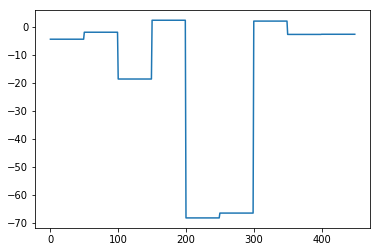

In [185]:
plt.figure()
plt.plot(planning_b_50_ols_md)
plt.show()

Text(0.5,1,'Varying batch sizes in neural net planning model')

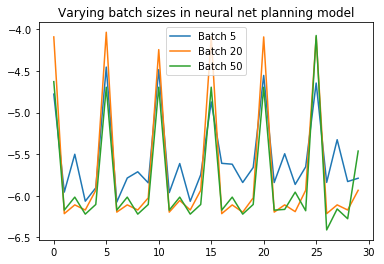

In [151]:
plt.figure()
plt.plot(rewards_batch_5_nn, label = "Batch 5")
plt.plot(rewards_batch_20_nn, label = "Batch 20")
plt.plot(rewards_batch_50_nn, label = "Batch 50")
plt.legend()
plt.title("Varying batch sizes in neural net planning model")

#### Nn's only, diff batch sizes

Text(0.5,1,'Planning reward varying batch sizes in neural net planning model')

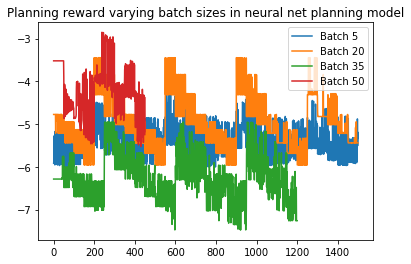

In [152]:
plt.figure()
plt.plot(planning_b_5_nn, label = "Batch 5")
plt.plot(planning_b_20_nn, label = "Batch 20")
plt.plot(planning_b_35_nn, label = "Batch 35")
plt.plot(planning_b_50_nn, label = "Batch 50")
plt.legend()
plt.title("Planning reward varying batch sizes in neural net planning model")

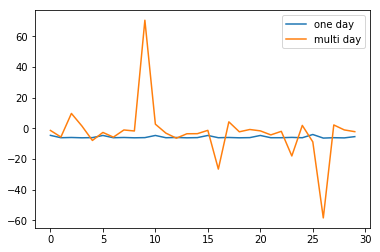

<Figure size 432x288 with 0 Axes>

In [153]:
plt.figure()
plt.plot(rewards_batch_50_nn, label = "one day")
plt.plot(rewards_batch_50_nn_md, label = "multi day")
plt.legend()
plt.figure()
plt.show()

#### OLS, batch sizes

Text(0.5,1,'Planning reward varying batch sizes in OLS planning model')

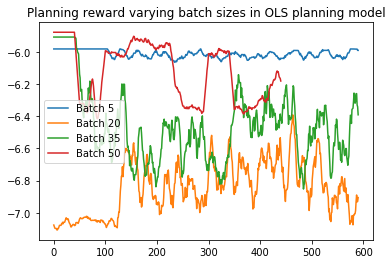

In [158]:
plt.figure()
plt.plot(moving_average(planning_b_5_ols[:600], n = 10), label = "Batch 5")
plt.plot(moving_average(planning_b_20_ols[:600], n = 10), label = "Batch 20")
plt.plot(moving_average(planning_b_35_ols[:600], n=10), label = "Batch 35")
plt.plot(moving_average(planning_b_50_ols[:600], n = 10), label = "Batch 50")
plt.legend()
plt.title("Planning reward varying batch sizes in OLS planning model")

Text(0.5,1,'Reward varying batch sizes in OLS planning model')

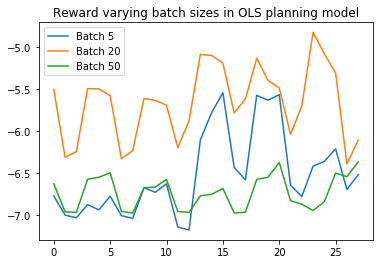

In [161]:
plt.figure()
plt.plot(moving_average(rewards_batch_5_ols), label = "Batch 5")
plt.plot(moving_average(rewards_batch_20_ols), label = "Batch 20")
plt.plot(moving_average(rewards_batch_50_ols), label = "Batch 50")
plt.legend()
plt.title("Reward varying batch sizes in OLS planning model")

#### NN vs OLS

Text(0.5,0.98,'Comparing OLS planning model to nn planning model with different batch sizes')

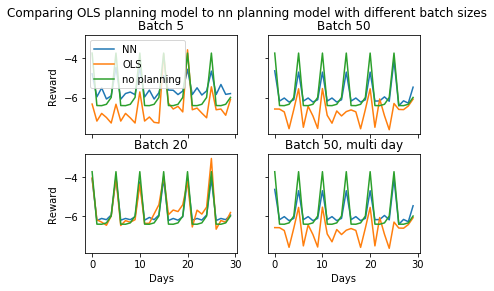

In [180]:
figure, axes = plt.subplots(2,2, sharey = True, sharex = True)

axes[0, 0].set_title("Batch 5")
axes[0, 0].plot(rewards_batch_5_nn, label = "NN")
axes[0, 0].plot(rewards_batch_5_ols, label = "OLS")
axes[0, 0].plot(bau, label = "no planning")
axes[0, 0].legend()

axes[1, 0].set_title("Batch 20")
axes[1, 0].plot(rewards_batch_20_nn, label = "NN")
axes[1, 0].plot(rewards_batch_20_ols, label = "OLS")
axes[1, 0].plot(bau, label = "no planning")

axes[0, 1].set_title("Batch 50")
axes[0, 1].plot(rewards_batch_50_nn, label = "NN")
axes[0, 1].plot(rewards_batch_50_ols, label = "OLS")
axes[0, 1].plot(bau, label = "no planning")

axes[1, 1].set_title("Batch 50, multi day")
axes[1, 1].plot(rewards_batch_50_nn, label = "NN")
axes[1, 1].plot(rewards_batch_50_ols, label = "OLS")
axes[1, 1].plot(bau, label = "no planning")

for ax in axes.flat:
    ax.set(xlabel = "Days", ylabel = "Reward ")
    ax.label_outer()

figure.suptitle("Comparing OLS planning model to nn planning model with different batch sizes")


### Regression: ST vs LT : done

In [112]:
reward_15_reg_st, planning_rewards_15_reg_st = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 15, 
         batch_size_agent = 10,
         short_term_planning = True,
         planning_model_type = "OLS"
         )

reward_45_reg_st, planning_rewards_45_reg_st = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 45, 
         batch_size_agent = 10,
         short_term_planning = True,
         planning_model_type = "OLS"
         )

reward_75_reg_st, planning_rewards_75_reg_st = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 75, 
         batch_size_agent = 10,
         short_term_planning = True,
         planning_model_type = "OLS"
         )

reward_105_reg_st, planning_rewards_105_reg_st = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 105, 
         batch_size_agent = 10,
         short_term_planning = True,
         planning_model_type = "OLS"
         )

reward_200_reg_st, planning_rewards_200_reg_st = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 200, 
         batch_size_agent = 10,
         short_term_planning = True,
         planning_model_type = "OLS"
         )


reward_15_reg_lt, planning_rewards_15_reg_lt = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 15, 
         batch_size_agent = 10,
         short_term_planning = False,
         planning_model_type = "OLS"
         )

reward_45_reg_lt, planning_rewards_45_reg_lt = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 45, 
         batch_size_agent = 10,
         short_term_planning = False,
         planning_model_type = "OLS"
         )

reward_75_reg_lt, planning_rewards_75_reg_lt = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 75, 
         batch_size_agent = 10,
         short_term_planning = False,
         planning_model_type = "OLS"
         )

reward_105_reg_lt, planning_rewards_105_reg_lt = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 105, 
         batch_size_agent = 10,
         short_term_planning = False,
         planning_model_type = "OLS"
         )

reward_200_reg_lt, planning_rewards_200_reg_lt = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 200, 
         batch_size_agent = 10,
         short_term_planning = False,
         planning_model_type = "OLS"
         )




BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18
Day: 19
Day: 20
Day: 21
Day: 22
Day: 23
Day: 24
Day: 25
Day: 26
Day: 27
Day: 28
Day: 29
Day: 30
Day: 31
--------------------
 planning step 0
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 5.7657924e+00
 1.0000000e+01 4.7683716e-07 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 1
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 5.7657924e+00
 1.0000000e+01 4.7683716e-07 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 2
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 5.7657924e+00
 9.9999990e+00 4.7683716e-07 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 3
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 5.7657924e+00
 1.0000000e+01 4.7683716e-07 1.0000000e+

--------------------
 planning step 12
action: [5.302429e-04 1.000000e+01 0.000000e+00 0.000000e+00 9.999605e+00
 0.000000e+00 0.000000e+00 1.000000e+01 0.000000e+00 0.000000e+00]
--------------------
 planning step 13
action: [3.0145645e-03 1.0000000e+01 0.0000000e+00 0.0000000e+00 9.9997911e+00
 0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 14
action: [2.4166584e-02 1.0000000e+01 0.0000000e+00 0.0000000e+00 9.9998236e+00
 8.8262558e-04 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------------------------------------------------------------------
Day: 34
--------------------
 planning step 0
action: [ 0.23388052 10.          0.          0.          9.9931555   0.
  0.         10.          0.          0.        ]
--------------------
 planning step 1
action: [ 0.23388052 10.          0.          0.          9.9931555   0.
  0.         10.          0.          0.        ]
--------------------
 plannin

--------------------
 planning step 13
action: [2.5747204e-01 1.0000000e+01 0.0000000e+00 0.0000000e+00 6.7243576e-03
 0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 14
action: [ 1.2987714  10.          0.          0.          0.01626539  0.23195934
  0.         10.          0.          0.        ]
--------------------------------------------------------------------------------
Day: 37
--------------------
 planning step 0
action: [4.6705246e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 6.8034172e-02
 5.1155090e-03 9.5367432e-07 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 1
action: [4.6705251e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 6.8034172e-02
 1.7644882e-02 9.5367432e-07 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 2
action: [4.6705246e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 6.8034172e-02
 1.3132572e-02 9.5367432e-07 1.0000000e+01 0.0000000e+00

--------------------
 planning step 14
action: [7.1261024e-01 1.0000000e+01 1.2540817e-04 0.0000000e+00 9.9939013e+00
 9.9901257e+00 6.8750439e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------------------------------------------------------------------
Day: 40
--------------------
 planning step 0
action: [ 8.417101 10.        0.        0.        8.05991   9.938114  8.963551
 10.        0.        0.      ]
--------------------
 planning step 1
action: [ 8.417101 10.        0.        0.        8.05991  10.        8.963551
 10.        0.        0.      ]
--------------------
 planning step 2
action: [ 8.417101 10.        0.        0.        8.05991   9.970914  8.963551
 10.        0.        0.      ]
--------------------
 planning step 3
action: [ 8.417101  10.         1.3161163  0.         8.05991   10.
  8.963551  10.         0.         0.       ]
--------------------
 planning step 4
action: [ 8.417101 10.        0.        0.        8.05991   0.        8.963551
 10. 

--------------------
 planning step 1
action: [ 9.995834   10.          9.999998    0.          4.9051847   0.82484245
  9.99996    10.          0.          0.        ]
--------------------
 planning step 2
action: [ 9.995834  10.         0.         0.         4.9051847  2.8561454
  9.99996   10.         0.         0.       ]
--------------------
 planning step 3
action: [9.9958344e+00 1.0000000e+01 9.5367432e-07 0.0000000e+00 4.9051847e+00
 1.0000000e+01 9.9999599e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 4
action: [ 9.995834  10.         0.         0.         4.9051847 10.
  9.99996   10.         0.         0.       ]
--------------------
 planning step 5
action: [9.9958344e+00 1.0000000e+01 4.3869019e-05 0.0000000e+00 4.9051847e+00
 9.9999876e+00 9.9999599e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 6
action: [ 9.995834   10.          0.06803036  0.          4.9051847   3.0674787
  9.99996    10.        

--------------------
 planning step 1
action: [9.9729824e+00 1.0000000e+01 9.9999971e+00 0.0000000e+00 9.9277687e+00
 9.5367432e-07 7.8105927e-04 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 2
action: [9.9729824e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9277687e+00
 2.1295547e-03 7.8105927e-04 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 3
action: [9.9729824e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9277687e+00
 9.9951725e+00 7.8105927e-04 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 4
action: [9.9729824e+00 1.0000000e+01 9.9999924e+00 0.0000000e+00 9.9277687e+00
 9.9999828e+00 7.8105927e-04 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 5
action: [9.9729824e+00 1.0000000e+01 9.9999733e+00 0.0000000e+00 9.9277687e+00
 9.9789505e+00 7.8105927e-04 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 6
action: [9.972982

--------------------
 planning step 1
action: [ 9.998749   10.          9.998537    0.          0.10026503  7.033501
  9.998855    9.999868    0.          0.        ]
--------------------
 planning step 2
action: [ 9.998749   10.         10.          0.          0.10026503  0.
  9.998855   10.          0.          0.        ]
--------------------
 planning step 3
action: [9.99874878e+00 1.00000000e+01 9.99860954e+00 0.00000000e+00
 1.00265026e-01 8.64982605e-04 9.99885464e+00 1.00000000e+01
 0.00000000e+00 0.00000000e+00]
--------------------
 planning step 4
action: [9.99874878e+00 1.00000000e+01 8.75663757e-03 0.00000000e+00
 1.00265026e-01 9.89845276e+00 9.99885464e+00 1.00000000e+01
 0.00000000e+00 0.00000000e+00]
--------------------
 planning step 5
action: [9.99874878e+00 1.00000000e+01 1.40953541e-01 0.00000000e+00
 1.00265026e-01 1.25694275e-03 9.99885464e+00 1.00000000e+01
 0.00000000e+00 0.00000000e+00]
--------------------
 planning step 6
action: [9.99874878e+00 1.00000000

--------------------
 planning step 1
action: [1.3182116e-01 1.0000000e+01 5.7220459e-06 0.0000000e+00 5.5886750e+00
 0.0000000e+00 9.6124525e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 2
action: [ 0.13182116 10.          0.10704803  0.          5.588675    9.999931
  9.6124525  10.          0.          0.        ]
--------------------
 planning step 3
action: [1.3182116e-01 1.0000000e+01 0.0000000e+00 0.0000000e+00 5.5886750e+00
 7.0004463e-03 9.6124525e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 4
action: [ 0.13182116 10.          6.567994    0.          5.588675   10.
  9.6124525  10.          0.          0.        ]
--------------------
 planning step 5
action: [ 0.13182116 10.         10.          0.          5.588675    1.9264026
  9.6124525  10.          0.          0.        ]
--------------------
 planning step 6
action: [1.3182116e-01 1.0000000e+01 5.8440399e+00 0.0000000e+00 5.5886750e+00
 4.768371

--------------------
 planning step 1
action: [ 4.328534  10.         9.996788   0.         3.898098   0.4456396
  9.975321   0.6764116  0.         0.       ]
--------------------
 planning step 2
action: [ 4.328534 10.        0.        0.        3.898098  0.        9.975321
  9.99992   0.        0.      ]
--------------------
 planning step 3
action: [ 4.328534 10.        9.999996  0.        3.898098 10.        9.975321
 10.        0.        0.      ]
--------------------
 planning step 4
action: [ 4.328534 10.        9.999988  0.        3.898098  9.678403  9.975321
  9.688737  0.        0.      ]
--------------------
 planning step 5
action: [ 4.328534 10.        9.999998  0.        3.898098  9.994351  9.975321
  9.448412  0.        0.      ]
--------------------
 planning step 6
action: [4.328534e+00 1.000000e+01 5.194187e-03 0.000000e+00 3.898098e+00
 8.627974e+00 9.975321e+00 1.000000e+01 0.000000e+00 0.000000e+00]
--------------------
 planning step 7
action: [ 4.328534 10.      

--------------------
 planning step 2
action: [2.7396011e-01 1.0000000e+01 2.0165443e-03 0.0000000e+00 3.8621902e-02
 8.1062317e-05 6.6518784e-04 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 3
action: [2.7396011e-01 1.0000000e+01 8.4556341e-01 0.0000000e+00 3.8621902e-02
 3.2403965e+00 6.6518784e-04 9.9979773e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 4
action: [2.7396011e-01 1.0000000e+01 4.2915344e-06 0.0000000e+00 3.8621902e-02
 1.2425232e-01 6.6518784e-04 9.9995222e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 5
action: [2.7396011e-01 1.0000000e+01 0.0000000e+00 0.0000000e+00 3.8621902e-02
 9.4224644e-01 6.6518784e-04 2.3076487e-01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 6
action: [2.7396011e-01 1.0000000e+01 2.2888184e-05 0.0000000e+00 3.8621902e-02
 0.0000000e+00 6.6518784e-04 1.4638901e-04 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 7
action: [2.739601

--------------------
 planning step 4
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0. 10.]
--------------------
 planning step 5
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0. 10.]
--------------------
 planning step 6
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0. 10.]
--------------------
 planning step 7
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0. 10.]
--------------------
 planning step 8
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0. 10.]
--------------------
 planning step 9
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0. 10.]
--------------------
 planning step 10
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0. 10.]
--------------------
 planning step 11
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0. 10.]
--------------------
 planning step 12
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0. 10.]
--------------------
 planning step 13
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0. 10.]
--------------------
 planning step 14
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0. 10.]
--------------------
 plann

--------------------
 planning step 30
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 31
action: [ 0.         10.          0.         10.         10.          0.
 10.          0.05252457  0.          0.        ]
--------------------
 planning step 32
action: [ 0.      10.       0.      10.      10.       0.      10.       9.99999
  0.       0.     ]
--------------------
 planning step 33
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999998  0.        0.      ]
--------------------
 planning step 34
action: [ 0.      10.       0.      10.      10.       0.      10.       9.99997
  0.       0.     ]
--------------------
 planning step 35
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.458334  0.        0.      ]
--------------------
 planning step 36
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 37
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0.  0.]
---

--------------------
 planning step 44
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999998  0.        0.      ]
--------------------------------------------------------------------------------
Day: 34
--------------------
 planning step 0
action: [ 0.       10.        0.       10.       10.        0.       10.
  8.952331  0.        0.      ]
--------------------
 planning step 1
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999996  0.        0.      ]
--------------------
 planning step 2
action: [ 0.     10.      0.     10.     10.      0.     10.      9.9776  0.
  0.    ]
--------------------
 planning step 3
action: [ 0.      10.       0.      10.      10.       0.      10.       9.84902
  0.       0.     ]
--------------------
 planning step 4
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.869476  0.        0.      ]
--------------------
 planning step 5
action: [ 0. 10.  0. 10. 10.  0. 10.

--------------------
 planning step 13
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999878  0.        0.      ]
--------------------
 planning step 14
action: [ 0.        10.         0.        10.        10.         0.
 10.         6.8508244  0.         0.       ]
--------------------
 planning step 15
action: [ 0.        10.         0.        10.        10.         0.
 10.         8.3958845  0.         0.       ]
--------------------
 planning step 16
action: [ 0.        10.         0.        10.        10.         0.
 10.         7.8683643  0.         0.       ]
--------------------
 planning step 17
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.9583702e-03 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 18
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.8024445e-04 0.0000000e+00 0.0000000e+00]
-----------------

--------------------
 planning step 26
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 27
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999992  0.        0.      ]
--------------------
 planning step 28
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 29
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 30
action: [ 0.        10.         0.        10.        10.         0.
 10.         6.5263176  0.         0.       ]
--------------------
 planning step 31
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.984478  0.        0.      ]
--------------------
 planning step 32
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999765  0.        0.      ]
--------------------
 planning step 33
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 34
action: [ 0.       1

--------------------
 planning step 40
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 41
action: [ 0.       10.        0.       10.       10.        0.       10.
  8.599002  0.        0.      ]
--------------------
 planning step 42
action: [ 0.        10.         0.        10.        10.         0.
 10.         6.6439342  0.         0.       ]
--------------------
 planning step 43
action: [ 0.         10.          0.         10.         10.          0.
 10.          0.14200974  0.          0.        ]
--------------------
 planning step 44
action: [ 0.         10.          0.         10.         10.          0.
 10.          0.04813004  0.          0.        ]
--------------------------------------------------------------------------------
Day: 38
--------------------
 planning step 0
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.5449524e-04 0.0000000e+00 0.0000000e+00]
------------

--------------------
 planning step 6
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 7
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 8
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 9
action: [ 0.         10.          0.         10.         10.          0.
 10.          0.01299286  0.          0.        ]
--------------------
 planning step 10
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999973  0.        0.      ]
--------------------
 planning step 11
action: [ 0.       10.        0.       10.       10.        0.       10.
  7.526886  0.        0.      ]
--------------------
 planning step 12
action: [ 0.         10.          0.         10.         10.          0.
 10.          0.32894707  0.          0.        ]
--------------------
 planning step 13
action: [ 0.        10.         0.        10.        10.         0.
 10.         3.890

--------------------
 planning step 20
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.997267  0.        0.      ]
--------------------
 planning step 21
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.998511  0.        0.      ]
--------------------
 planning step 22
action: [ 0.        10.         0.        10.        10.         0.
 10.         4.8354797  0.         0.       ]
--------------------
 planning step 23
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 24
action: [ 0.         10.          0.         10.         10.          0.
 10.          0.20236635  0.          0.        ]
--------------------
 planning step 25
action: [ 0.        10.         0.        10.        10.         0.
 10.         1.9104681  0.         0.       ]
--------------------
 planning step 26
action: [ 0.      10.       0.      10.      10.       0.      10.       9.94244
  0.       0.     ]
---------------

--------------------
 planning step 32
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 33
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 34
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 35
action: [ 0.       10.        0.       10.       10.        0.       10.
  8.601206  0.        0.      ]
--------------------
 planning step 36
action: [ 0.        10.         0.        10.        10.         0.
 10.         0.1475339  0.         0.       ]
--------------------
 planning step 37
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.7683716e-07 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 38
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 39
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999996  0.        0.      ]
-------------

--------------------
 planning step 5
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 6
action: [0.00000e+00 1.00000e+01 0.00000e+00 1.00000e+01 1.00000e+01 0.00000e+00
 1.00000e+01 1.57547e-03 0.00000e+00 0.00000e+00]
--------------------
 planning step 7
action: [ 0.         10.          0.         10.         10.          0.
 10.          0.14662123  0.          0.        ]
--------------------
 planning step 8
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 9
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.983669  0.        0.      ]
--------------------
 planning step 10
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 11
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999922  0.        0.      ]
--------------------
 planning step 12
action: [ 0.       10.        0.       10.       10.        0.       10.
  8.51

--------------------
 planning step 18
action: [ 0.       10.        0.       10.       10.        0.       10.
  7.646213  0.        0.      ]
--------------------
 planning step 19
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999917  0.        0.      ]
--------------------
 planning step 20
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 21
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999891  0.        0.      ]
--------------------
 planning step 22
action: [0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 9.536743e-07 0.000000e+00 0.000000e+00]
--------------------
 planning step 23
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999969  0.        0.      ]
--------------------
 planning step 24
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999984  0.        0.      ]
-----------

--------------------
 planning step 33
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999998  0.        0.      ]
--------------------
 planning step 34
action: [ 0.        10.         0.        10.        10.         0.
 10.         1.9817016  0.         0.       ]
--------------------
 planning step 35
action: [ 0.         10.          0.         10.         10.          0.
 10.          0.03047705  0.          0.        ]
--------------------
 planning step 36
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 37
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999998  0.        0.      ]
--------------------
 planning step 38
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 39
action: [ 0.        10.         0.        10.        10.         0.
 10.         0.1257906  0.         0.       ]
--------------------
 planning step 40
action: [ 0. 10.  0. 10. 10

--------------------
 planning step 5
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999224  0.        0.      ]
--------------------
 planning step 6
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 7
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 8
action: [ 0.         10.          0.         10.         10.          0.
 10.          0.01970005  0.          0.        ]
--------------------
 planning step 9
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999901  0.        0.      ]
--------------------
 planning step 10
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.995966  0.        0.      ]
--------------------
 planning step 11
action: [ 0.        10.         0.        10.        10.         0.
 10.         0.4777584  0.         0.       ]
--------------------
 planning step 12
action: [ 0.        10.         0.       

--------------------
 planning step 20
action: [ 0.         10.          0.         10.         10.          0.
 10.          0.03222084  0.          0.        ]
--------------------
 planning step 21
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 22
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 23
action: [ 0.        10.         0.        10.        10.         0.
 10.         1.9089556  0.         0.       ]
--------------------
 planning step 24
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.997725  0.        0.      ]
--------------------
 planning step 25
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.412432  0.        0.      ]
--------------------
 planning step 26
action: [0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 1.244545e-04 0.000000e+00 0.000000e+00]
--------------------
 planning step 27


--------------------
 planning step 36
action: [ 0.       10.        0.       10.       10.        0.       10.
  6.860944  0.        0.      ]
--------------------
 planning step 37
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 38
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999584  0.        0.      ]
--------------------
 planning step 39
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 40
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999992  0.        0.      ]
--------------------
 planning step 41
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 42
action: [ 0.         10.          0.         10.         10.          0.
 10.          0.02173615  0.          0.        ]
--------------------
 planning step 43
action: [ 0.        10.         0.        10.        10.         0.
 10.         0.3994236  0.      

--------------------
 planning step 7
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 8
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 3.4332275e-05 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 9
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 10
action: [ 0.       10.        0.       10.       10.        0.       10.
  6.489708  0.        0.      ]
--------------------
 planning step 11
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.915559  0.        0.      ]
--------------------
 planning step 12
action: [ 0.        10.         0.        10.        10.         0.
 10.         9.9977665  0.         0.       ]
--------------------
 planning step 13
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 14
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0.  0.]
----------------

--------------------
 planning step 23
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 6.1917305e-03 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 24
action: [ 0.        10.         0.        10.        10.         0.
 10.         8.9857435  0.         0.       ]
--------------------
 planning step 25
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 8.4962845e-03 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 26
action: [ 0.       10.        0.       10.       10.        0.       10.
  4.505554  0.        0.      ]
--------------------
 planning step 27
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.8160553e-05 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 28
action: [0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.0000

--------------------
 planning step 37
action: [ 0.       10.        0.       10.       10.        0.       10.
  8.622633  0.        0.      ]
--------------------
 planning step 38
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 39
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 40
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.976161  0.        0.      ]
--------------------
 planning step 41
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.2915344e-05 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 42
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.992181  0.        0.      ]
--------------------
 planning step 43
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.5926361e-04 0.0000000e+00 0.0000000e+00]
----------

--------------------
 planning step 4
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.910338  0.        0.      ]
--------------------
 planning step 5
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.8624535e-03 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 6
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 7
action: [ 0.       10.        0.       10.       10.        0.       10.
  8.104652  0.        0.      ]
--------------------
 planning step 8
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.989964  0.        0.      ]
--------------------
 planning step 9
action: [ 0.       10.        0.       10.       10.        0.       10.
  5.631868  0.        0.      ]
--------------------
 planning step 10
action: [ 0.         10.          0.         10.         10.          0.
 10.          0.07752514  0.          0

--------------------
 planning step 17
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 18
action: [0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 6.108284e-04 0.000000e+00 0.000000e+00]
--------------------
 planning step 19
action: [0.0000e+00 1.0000e+01 0.0000e+00 1.0000e+01 1.0000e+01 0.0000e+00
 1.0000e+01 7.0858e-04 0.0000e+00 0.0000e+00]
--------------------
 planning step 20
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 7.5883865e-03 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 21
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 22
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999991  0.        0.      ]
--------------------
 planning step 23
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4

--------------------
 planning step 29
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 30
action: [ 0.        10.         0.        10.        10.         0.
 10.         5.1607533  0.         0.       ]
--------------------
 planning step 31
action: [0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 6.904602e-04 0.000000e+00 0.000000e+00]
--------------------
 planning step 32
action: [ 0.         10.          0.         10.         10.          0.
 10.          0.02724314  0.          0.        ]
--------------------
 planning step 33
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.1587143e-04 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 34
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 35
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.00

--------------------
 planning step 40
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 41
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.9264221e-04 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 42
action: [ 0.        10.         0.        10.        10.         0.
 10.         1.0944967  0.         0.       ]
--------------------
 planning step 43
action: [0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 1.106739e-03 0.000000e+00 0.000000e+00]
--------------------
 planning step 44
action: [ 0. 10.  0. 10. 10.  0. 10.  0.  0.  0.]
--------------------------------------------------------------------------------
Day: 59
--------------------
 planning step 0
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.998008  0.        0.      ]
--------------------
 planning step 1
action: [0.0000000e+00 1.0000

--------------------
 planning step 10
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 11
action: [ 0. 10.  0. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 12
action: [0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.7656555e-05 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 13
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.158693  0.        0.      ]
--------------------
 planning step 14
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.962782  0.        0.      ]
--------------------
 planning step 15
action: [ 0.       10.        0.       10.       10.        0.       10.
  9.999786  0.        0.      ]
--------------------
 planning step 16
action: [ 0.        10.         0.        10.        10.         0.
 10.         7.2426143  0.         0.       ]
--------------------
 planning step 17
action: 

--------------------
 planning step 28
action: [10. 10. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 29
action: [10. 10. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 30
action: [10. 10. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 31
action: [10. 10. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 32
action: [10. 10. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 33
action: [10. 10. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 34
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 7.499695e-03 0.000000e+00]
--------------------
 planning step 35
action: [10. 10. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 36
action: [10.       10.       10.       10.        0.        0.       10.
 10.        9.999859  0.      ]
--------------------
 planning step 37
action: [10. 1

--------------------
 planning step 24
action: [10.         10.         10.         10.          0.          0.
 10.         10.          0.03130198  0.        ]
--------------------
 planning step 25
action: [10.      10.      10.      10.       0.       0.      10.      10.
  9.92083  0.     ]
--------------------
 planning step 26
action: [10. 10. 10. 10.  0.  0. 10. 10. 10.  0.]
--------------------
 planning step 27
action: [10. 10. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 28
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 8.106232e-06 0.000000e+00]
--------------------
 planning step 29
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 6.1035156e-05 0.0000000e+00]
--------------------
 planning step 30
action: [10. 10. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 31
action: [10.       10.     

--------------------
 planning step 8
action: [10.         10.         10.         10.          0.          0.
 10.         10.          0.84619236  0.        ]
--------------------
 planning step 9
action: [10.        10.        10.        10.         0.         0.
 10.        10.         6.2735424  0.       ]
--------------------
 planning step 10
action: [10. 10. 10. 10.  0.  0. 10. 10. 10.  0.]
--------------------
 planning step 11
action: [10. 10. 10. 10.  0.  0. 10. 10. 10.  0.]
--------------------
 planning step 12
action: [10.        10.        10.        10.         0.         0.
 10.        10.         1.0336823  0.       ]
--------------------
 planning step 13
action: [10.      10.      10.      10.       0.       0.      10.      10.
  9.99999  0.     ]
--------------------
 planning step 14
action: [10.       10.       10.       10.        0.        0.       10.
 10.        9.999784  0.      ]
--------------------
 planning step 15
action: [10.      10.      10.      10

--------------------
 planning step 65
action: [10.        10.        10.        10.         0.         0.
 10.        10.         0.7323623  0.       ]
--------------------
 planning step 66
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 4.7683716e-07 0.0000000e+00]
--------------------
 planning step 67
action: [10.       10.       10.       10.        0.        0.       10.
 10.        9.999998  0.      ]
--------------------
 planning step 68
action: [10.       10.       10.       10.        0.        0.       10.
 10.        9.945238  0.      ]
--------------------
 planning step 69
action: [10.       10.       10.       10.        0.        0.       10.
 10.        9.994527  0.      ]
--------------------
 planning step 70
action: [10. 10. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 71
action: [10.         10.         10.         10.          0.          0.
 10.         10.        

--------------------
 planning step 47
action: [10.      10.      10.      10.       0.       0.      10.      10.
  9.99552  0.     ]
--------------------
 planning step 48
action: [10.       10.       10.       10.        0.        0.       10.
 10.        9.994825  0.      ]
--------------------
 planning step 49
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 4.7683716e-06 0.0000000e+00]
--------------------
 planning step 50
action: [10.       10.       10.       10.        0.        0.       10.
 10.        9.999982  0.      ]
--------------------
 planning step 51
action: [10.       10.       10.       10.        0.        0.       10.
 10.        9.999903  0.      ]
--------------------
 planning step 52
action: [10.       10.       10.       10.        0.        0.       10.
 10.        9.997921  0.      ]
--------------------
 planning step 53
action: [10.       10.       10.       10.        0.        

--------------------
 planning step 27
action: [1.0000000e+01 2.3031235e-03 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 1.4296961e-01 0.0000000e+00]
--------------------
 planning step 28
action: [1.0000000e+01 9.4643784e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 2.8486252e-03 0.0000000e+00]
--------------------
 planning step 29
action: [1.0000000e+01 6.0939789e-04 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 8.2969666e-05 0.0000000e+00]
--------------------
 planning step 30
action: [10.         0.1527934 10.        10.         0.         0.
 10.        10.         9.996849   0.       ]
--------------------
 planning step 31
action: [10.          0.85361624 10.         10.          0.          0.
 10.         10.          2.8208523   0.        ]
--------------------
 planning step 32
action: [10.          0.03040504 10.         10.          0.          0.
 10

--------------------
 planning step 2
action: [10.       10.       10.       10.        0.        0.       10.
 10.        8.360844  0.      ]
--------------------
 planning step 3
action: [1.000000e+01 1.335144e-05 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 9.420916e+00 0.000000e+00]
--------------------
 planning step 4
action: [10.          0.59387445 10.         10.          0.          0.
 10.         10.          8.86731     0.        ]
--------------------
 planning step 5
action: [10. 10. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 6
action: [10.         4.4901123 10.        10.         0.         0.
 10.        10.         9.999847   0.       ]
--------------------
 planning step 7
action: [1.0000000e+01 8.3398819e-04 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 1.7642975e-05 0.0000000e+00]
--------------------
 planning step 8
action: [10.        2.577877 10.       10.        

--------------------
 planning step 58
action: [10.          0.03579521 10.         10.          0.          0.
 10.         10.          0.0340867   0.        ]
--------------------
 planning step 59
action: [10.        9.999365 10.       10.        0.        0.       10.
 10.        2.08394   0.      ]
--------------------
 planning step 60
action: [1.0000000e+01 3.9625168e-04 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 61
action: [10.         10.         10.         10.          0.          0.
 10.         10.          0.38003016  0.        ]
--------------------
 planning step 62
action: [1.0000000e+01 4.7683716e-07 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 9.9648762e+00 0.0000000e+00]
--------------------
 planning step 63
action: [10.        9.982522 10.       10.        0.        0.       10.
 10.        0.        0.      ]
--------

--------------------
 planning step 34
action: [10.        9.991007 10.       10.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 35
action: [10.        9.999638 10.       10.        0.        0.       10.
 10.        9.999437  0.      ]
--------------------
 planning step 36
action: [10.         10.         10.         10.          0.          0.
 10.         10.          0.05844307  0.        ]
--------------------
 planning step 37
action: [10.       10.       10.       10.        0.        0.       10.
 10.        9.073843  0.      ]
--------------------
 planning step 38
action: [10.        10.        10.        10.         0.         0.
 10.        10.         3.1023812  0.       ]
--------------------
 planning step 39
action: [10. 10. 10. 10.  0.  0. 10. 10. 10.  0.]
--------------------
 planning step 40
action: [10.        10.        10.        10.         0.         0.
 10.        10.         3.0076246  0.       ]
-----------

--------------------
 planning step 12
action: [10.        0.       10.       10.        0.        0.       10.
 10.        9.999626  0.      ]
--------------------
 planning step 13
action: [10.       10.       10.       10.        0.        0.       10.
 10.        9.999935  0.      ]
--------------------
 planning step 14
action: [1.000000e+01 1.001358e-05 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 9.999981e+00 0.000000e+00]
--------------------
 planning step 15
action: [10.        10.        10.        10.         0.         0.
 10.        10.         4.6673226  0.       ]
--------------------
 planning step 16
action: [10.        0.       10.       10.        0.        0.       10.
 10.        9.995127  0.      ]
--------------------
 planning step 17
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 1.9073486e-06 0.0000000e+00]
--------------------
 planning step 18
action

--------------------
 planning step 65
action: [10.         1.6971362 10.        10.         0.         0.
 10.        10.         5.6232414  0.       ]
--------------------
 planning step 66
action: [1.0000000e+01 9.9190435e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 1.9073486e-06 0.0000000e+00]
--------------------
 planning step 67
action: [10.          0.09751987 10.         10.          0.          0.
 10.         10.          9.865225    0.        ]
--------------------
 planning step 68
action: [1.0000000e+01 1.1062622e-04 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 9.9941263e+00 0.0000000e+00]
--------------------
 planning step 69
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 9.536743e-07 0.000000e+00]
--------------------
 planning step 70
action: [10.          0.         10.         10.          0.          0.
 10.         

--------------------
 planning step 43
action: [1.0000000e+01 6.3608265e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 4.7969818e-04 0.0000000e+00]
--------------------
 planning step 44
action: [10.          0.01289845 10.         10.          0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 45
action: [10.         0.        10.        10.         0.         0.
 10.        10.         9.9988785  0.       ]
--------------------
 planning step 46
action: [10.        4.374169 10.       10.        0.        0.       10.
 10.        9.636171  0.      ]
--------------------
 planning step 47
action: [10.         0.6635499 10.        10.         0.         0.
 10.        10.        10.         0.       ]
--------------------
 planning step 48
action: [10.  0. 10. 10.  0.  0. 10. 10. 10.  0.]
--------------------
 planning step 49
action: [10.        2.492724 10.       10.        0.        0.       1

--------------------
 planning step 20
action: [10.        9.999985 10.       10.        0.        0.       10.
 10.        9.998798  0.      ]
--------------------
 planning step 21
action: [10.        9.999936 10.       10.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 22
action: [1.000000e+01 9.904385e-03 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00]
--------------------
 planning step 23
action: [1.0000000e+01 2.9087067e-05 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 24
action: [10.        9.89566  10.       10.        0.        0.       10.
 10.        9.999999  0.      ]
--------------------
 planning step 25
action: [10.         9.999994  10.        10.         0.         0.
 10.        10.         1.2506175  0.       ]
--------------------
 planning step 26
action

--------------------
 planning step 70
action: [10.          0.62800837 10.         10.          0.          0.
 10.         10.          9.982569    0.        ]
--------------------
 planning step 71
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 9.536743e-07 0.000000e+00]
--------------------
 planning step 72
action: [10.        9.997872 10.       10.        0.        0.       10.
 10.        9.391571  0.      ]
--------------------
 planning step 73
action: [1.000000e+01 5.718422e-02 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 8.106232e-05 0.000000e+00]
--------------------
 planning step 74
action: [1.0000000e+01 7.6241493e-03 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 9.5530910e+00 0.0000000e+00]
--------------------------------------------------------------------------------
Day: 41
--------------------
 planning step 0
action: [1.000000

--------------------
 planning step 43
action: [10.        8.767784 10.       10.        0.        0.       10.
 10.        9.994386  0.      ]
--------------------
 planning step 44
action: [10.       10.       10.       10.        0.        0.       10.
 10.        9.987541  0.      ]
--------------------
 planning step 45
action: [10.          9.999996   10.         10.          0.          0.
 10.         10.          0.23280907  0.        ]
--------------------
 planning step 46
action: [1.000000e+01 9.059906e-06 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 9.999964e+00 0.000000e+00]
--------------------
 planning step 47
action: [1.0000000e+01 4.3861566e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 5.9127808e-05 0.0000000e+00]
--------------------
 planning step 48
action: [10.        9.999992 10.       10.        0.        0.       10.
 10.        5.822466  0.      ]
--------------------
 planning step 

--------------------
 planning step 19
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 9.303093e-04 0.000000e+00]
--------------------
 planning step 20
action: [1.00000000e+01 1.04904175e-05 1.00000000e+01 1.00000000e+01
 0.00000000e+00 0.00000000e+00 1.00000000e+01 1.00000000e+01
 0.00000000e+00 0.00000000e+00]
--------------------
 planning step 21
action: [1.000000e+01 9.999784e+00 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 9.536743e-07 0.000000e+00]
--------------------
 planning step 22
action: [1.000000e+01 9.775162e-05 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 9.785182e+00 0.000000e+00]
--------------------
 planning step 23
action: [10.         10.         10.         10.          0.          0.
 10.         10.          0.26634884  0.        ]
--------------------
 planning step 24
action: [10.        0.       10.       10.        0.      

--------------------
 planning step 72
action: [10.          0.21472406 10.         10.          0.          0.
 10.         10.          2.56763     0.        ]
--------------------
 planning step 73
action: [10.  0. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 74
action: [10.  0. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------------------------------------------------------------------
Day: 43
--------------------
 planning step 0
action: [10.          0.11045504 10.         10.          0.          0.
 10.         10.          9.997133    0.        ]
--------------------
 planning step 1
action: [10.        9.999086 10.       10.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 2
action: [10.         5.1977987 10.        10.         0.         0.
 10.        10.         1.3430798  0.       ]
--------------------
 planning step 3
action: [10.        5.071618 10.       10.        0.        0.       10.
 10.

--------------------
 planning step 49
action: [10.         3.4721584 10.        10.         0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 50
action: [10.        0.       10.       10.        0.        0.       10.
 10.        9.999997  0.      ]
--------------------
 planning step 51
action: [1.000000e+01 9.918213e-05 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00]
--------------------
 planning step 52
action: [1.000000e+01 8.134842e-04 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 9.594131e+00 0.000000e+00]
--------------------
 planning step 53
action: [10.        0.       10.       10.        0.        0.       10.
 10.        9.999825  0.      ]
--------------------
 planning step 54
action: [10.          0.         10.         10.          0.          0.
 10.         10.          0.11663723  0.        ]
--------------------
 planning step 5

--------------------
 planning step 25
action: [10.        9.955706 10.       10.        0.        0.       10.
 10.       10.        0.      ]
--------------------
 planning step 26
action: [10.        9.999978 10.       10.        0.        0.       10.
 10.       10.        0.      ]
--------------------
 planning step 27
action: [10.       10.       10.       10.        0.        0.       10.
 10.        9.999952  0.      ]
--------------------
 planning step 28
action: [1.0000000e+01 9.9998083e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 1.4781952e-05 0.0000000e+00]
--------------------
 planning step 29
action: [10. 10. 10. 10.  0.  0. 10. 10. 10.  0.]
--------------------
 planning step 30
action: [10.          0.07435608 10.         10.          0.          0.
 10.         10.          9.864691    0.        ]
--------------------
 planning step 31
action: [1.0000000e+01 1.3403893e-03 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.000000

--------------------
 planning step 2
action: [10.         9.744732  10.        10.         0.         0.
 10.        10.         2.6417887  0.       ]
--------------------
 planning step 3
action: [10.        9.999998 10.       10.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 4
action: [10.        9.971775 10.       10.        0.        0.       10.
 10.        9.422358  0.      ]
--------------------
 planning step 5
action: [10.          9.815134   10.         10.          0.          0.
 10.         10.          0.03295469  0.        ]
--------------------
 planning step 6
action: [1.0000000e+01 4.6730042e-04 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 3.6615038e-01 0.0000000e+00]
--------------------
 planning step 7
action: [10.        10.        10.        10.         0.         0.
 10.        10.         9.9976635  0.       ]
--------------------
 planning step 8
action: [1.0000000e+01

--------------------
 planning step 53
action: [10.        10.        10.        10.         0.         0.
 10.        10.         0.5471163  0.       ]
--------------------
 planning step 54
action: [1.0000000e+01 1.9025803e-04 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 9.9996567e+00 0.0000000e+00]
--------------------
 planning step 55
action: [10.        4.599601 10.       10.        0.        0.       10.
 10.        9.999046  0.      ]
--------------------
 planning step 56
action: [10.         7.7083864 10.        10.         0.         0.
 10.        10.         8.734741   0.       ]
--------------------
 planning step 57
action: [10. 10. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 58
action: [1.000000e+01 6.442070e-04 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 5.425453e-03 0.000000e+00]
--------------------
 planning step 59
action: [1.000000e+01 6.260872e-04 1.000000e+01 1.00

--------------------
 planning step 30
action: [10.  0. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 31
action: [1.0000000e+01 2.8610229e-06 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 5.8117948e+00 0.0000000e+00]
--------------------
 planning step 32
action: [10.          9.912936   10.         10.          0.          0.
 10.         10.          0.02058268  0.        ]
--------------------
 planning step 33
action: [10.         10.         10.         10.          0.          0.
 10.         10.          0.57666874  0.        ]
--------------------
 planning step 34
action: [10.        9.999985 10.       10.        0.        0.       10.
 10.        9.268686  0.      ]
--------------------
 planning step 35
action: [1.0000000e+01 9.9999733e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 1.9435883e-03 0.0000000e+00]
--------------------
 planning step 36
action: [1.0000000e+01 9

--------------------
 planning step 6
action: [10.         1.0405498 10.        10.         0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 7
action: [10.        9.965305 10.       10.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 8
action: [1.000000e+01 3.672123e-03 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 9.967310e+00 0.000000e+00]
--------------------
 planning step 9
action: [1.000000e+01 9.536743e-07 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 0.000000e+00]
--------------------
 planning step 10
action: [1.0000000e+01 1.1444092e-05 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 2.5892258e-04 0.0000000e+00]
--------------------
 planning step 11
action: [10. 10. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 12
action: [10.  0. 10. 10.  0. 

--------------------
 planning step 58
action: [10. 10. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 59
action: [10.        9.602457 10.       10.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 60
action: [10.  0. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 61
action: [10.        10.        10.        10.         0.         0.
 10.        10.         3.5178876  0.       ]
--------------------
 planning step 62
action: [10.  0. 10. 10.  0.  0. 10. 10. 10.  0.]
--------------------
 planning step 63
action: [1.000000e+01 2.193451e-05 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 9.999804e+00 0.000000e+00]
--------------------
 planning step 64
action: [10.         0.0267992 10.        10.         0.         0.
 10.        10.         9.999971   0.       ]
--------------------
 planning step 65
action: [10.         9.9965925 10.        10.         0.        

--------------------
 planning step 36
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 1.9073486e-06 0.0000000e+00]
--------------------
 planning step 37
action: [1.0000000e+01 7.5531006e-04 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 6.6280365e-05 0.0000000e+00]
--------------------
 planning step 38
action: [10.       10.       10.       10.        0.        0.       10.
 10.        9.998043  0.      ]
--------------------
 planning step 39
action: [10.        8.640666 10.       10.        0.        0.       10.
 10.       10.        0.      ]
--------------------
 planning step 40
action: [1.0000000e+01 4.2250586e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 7.5340271e-05 0.0000000e+00]
--------------------
 planning step 41
action: [1.0000000e+01 2.3555756e-04 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000

--------------------
 planning step 11
action: [10.        9.999987 10.       10.        0.        0.       10.
 10.        9.999983  0.      ]
--------------------
 planning step 12
action: [10.       10.       10.       10.        0.        0.       10.
 10.        9.406054  0.      ]
--------------------
 planning step 13
action: [10.        9.967983 10.       10.        0.        0.       10.
 10.       10.        0.      ]
--------------------
 planning step 14
action: [10.         10.         10.         10.          0.          0.
 10.         10.          0.01000977  0.        ]
--------------------
 planning step 15
action: [1.0000000e+01 9.7851486e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 1.9073486e-06 0.0000000e+00]
--------------------
 planning step 16
action: [1.0000000e+01 7.5531006e-04 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 1.4305115e-06 0.0000000e+00]
--------------------
 plan

--------------------
 planning step 64
action: [1.000000e+01 1.531601e-03 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 0.000000e+00]
--------------------
 planning step 65
action: [1.000000e+01 9.059906e-06 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 0.000000e+00]
--------------------
 planning step 66
action: [10.  0. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 67
action: [1.0000000e+01 5.4423285e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 3.3378601e-05 0.0000000e+00]
--------------------
 planning step 68
action: [10.        0.       10.       10.        0.        0.       10.
 10.        9.953871  0.      ]
--------------------
 planning step 69
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 2.3841858e-06 0.0000000e+00]
--------------------
 plann

--------------------
 planning step 42
action: [10.          9.872044   10.         10.          0.          0.
 10.         10.          0.02970171  0.        ]
--------------------
 planning step 43
action: [10.        9.812902 10.       10.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 44
action: [1.0000000e+01 2.4981499e-03 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 45
action: [10.          0.13244677 10.         10.          0.          0.
 10.         10.          9.950129    0.        ]
--------------------
 planning step 46
action: [1.000000e+01 9.931559e+00 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 2.861023e-06 0.000000e+00]
--------------------
 planning step 47
action: [10.          0.02513313 10.         10.          0.          0.
 10.         10.          3.8560126   0.        ]


--------------------
 planning step 19
action: [1.000000e+01 4.386902e-04 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 9.999993e+00 0.000000e+00]
--------------------
 planning step 20
action: [10.  0. 10. 10.  0.  0. 10. 10. 10.  0.]
--------------------
 planning step 21
action: [10.  0. 10. 10.  0.  0. 10. 10. 10.  0.]
--------------------
 planning step 22
action: [1.0000000e+01 4.7683716e-07 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 23
action: [10.          0.39434052 10.         10.          0.          0.
 10.         10.          0.08654451  0.        ]
--------------------
 planning step 24
action: [10.         9.945585  10.        10.         0.         0.
 10.        10.         1.4880037  0.       ]
--------------------
 planning step 25
action: [10.         0.        10.        10.         0.         0.
 10.        10.         1.2489

--------------------
 planning step 72
action: [10.         3.1814566 10.        10.         0.         0.
 10.        10.         0.8761797  0.       ]
--------------------
 planning step 73
action: [1.0000000e+01 9.7920656e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 2.0074844e-04 0.0000000e+00]
--------------------
 planning step 74
action: [1.000000e+01 1.750946e-03 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 9.997410e+00 0.000000e+00]
--------------------------------------------------------------------------------
Day: 52
--------------------
 planning step 0
action: [10.  0. 10. 10.  0.  0. 10. 10. 10.  0.]
--------------------
 planning step 1
action: [1.0000000e+01 7.0562363e-03 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 6.6328049e-04 0.0000000e+00]
--------------------
 planning step 2
action: [10.         9.98716   10.        10.         0.         0.
 10. 

--------------------
 planning step 48
action: [10.        9.994905 10.       10.        0.        0.       10.
 10.       10.        0.      ]
--------------------
 planning step 49
action: [10. 10. 10. 10.  0.  0. 10. 10. 10.  0.]
--------------------
 planning step 50
action: [10.         0.5158253 10.        10.         0.         0.
 10.        10.        10.         0.       ]
--------------------
 planning step 51
action: [1.0000000e+01 1.3665676e-02 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 2.3083687e-03 0.0000000e+00]
--------------------
 planning step 52
action: [10.       10.       10.       10.        0.        0.       10.
 10.        9.997425  0.      ]
--------------------
 planning step 53
action: [10.        0.       10.       10.        0.        0.       10.
 10.        8.029285  0.      ]
--------------------
 planning step 54
action: [1.0000000e+01 1.7166138e-04 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0

--------------------
 planning step 25
action: [1.0000000e+01 4.2390823e-04 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 9.9169598e+00 0.0000000e+00]
--------------------
 planning step 26
action: [1.0000000e+01 4.9443913e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 3.8194656e-04 0.0000000e+00]
--------------------
 planning step 27
action: [1.0000000e+01 1.0766983e-03 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 2.1934509e-05 0.0000000e+00]
--------------------
 planning step 28
action: [10.        9.999329 10.       10.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 29
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 4.055023e-03 0.000000e+00]
--------------------
 planning step 30
action: [10. 10. 10. 10.  0.  0. 10. 10.  0.  0.]
-----------------

--------------------
 planning step 2
action: [10. 10. 10. 10.  0.  0. 10. 10. 10.  0.]
--------------------
 planning step 3
action: [10.        9.999728 10.       10.        0.        0.       10.
 10.        9.969522  0.      ]
--------------------
 planning step 4
action: [10.       10.       10.       10.        0.        0.       10.
 10.        9.927143  0.      ]
--------------------
 planning step 5
action: [1.0000000e+01 9.9999981e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 4.7683716e-07 0.0000000e+00]
--------------------
 planning step 6
action: [10.        9.999999 10.       10.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 7
action: [10.        9.999996 10.       10.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 8
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.000

--------------------
 planning step 56
action: [1.000000e+01 9.059906e-06 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 9.996523e+00 0.000000e+00]
--------------------
 planning step 57
action: [10.       9.99997 10.      10.       0.       0.      10.      10.
 10.       0.     ]
--------------------
 planning step 58
action: [1.0000000e+01 1.1170006e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 9.5367432e-07 0.0000000e+00]
--------------------
 planning step 59
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 4.7683716e-07 0.0000000e+00]
--------------------
 planning step 60
action: [1.000000e+01 9.316444e-03 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00]
--------------------
 planning step 61
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000

--------------------
 planning step 31
action: [10.        9.998941 10.       10.        0.        0.       10.
 10.       10.        0.      ]
--------------------
 planning step 32
action: [10.  0. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 33
action: [10.          0.01556301 10.         10.          0.          0.
 10.         10.          9.416658    0.        ]
--------------------
 planning step 34
action: [10.  0. 10. 10.  0.  0. 10. 10. 10.  0.]
--------------------
 planning step 35
action: [1.000000e+01 9.999995e+00 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 2.861023e-06 0.000000e+00]
--------------------
 planning step 36
action: [10.          0.06443501 10.         10.          0.          0.
 10.         10.         10.          0.        ]
--------------------
 planning step 37
action: [10.        8.361162 10.       10.        0.        0.       10.
 10.        9.99999   0.      ]
--------------------
 planning

--------------------
 planning step 7
action: [10.          0.16417408 10.         10.          0.          0.
 10.         10.          8.489129    0.        ]
--------------------
 planning step 8
action: [10.        4.420377 10.       10.        0.        0.       10.
 10.        9.042533  0.      ]
--------------------
 planning step 9
action: [10.       10.       10.       10.        0.        0.       10.
 10.        9.999789  0.      ]
--------------------
 planning step 10
action: [10.  0. 10. 10.  0.  0. 10. 10. 10.  0.]
--------------------
 planning step 11
action: [10.        2.013569 10.       10.        0.        0.       10.
 10.        9.999092  0.      ]
--------------------
 planning step 12
action: [1.0000000e+01 2.5386333e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 7.7056885e-04 0.0000000e+00]
--------------------
 planning step 13
action: [10.        10.        10.        10.         0.         0.
 10.        10.        

--------------------
 planning step 60
action: [10.          0.01725769 10.         10.          0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 61
action: [10.          0.04101133 10.         10.          0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 62
action: [10.        9.555914 10.       10.        0.        0.       10.
 10.        9.938511  0.      ]
--------------------
 planning step 63
action: [10.       10.       10.       10.        0.        0.       10.
 10.        9.548556  0.      ]
--------------------
 planning step 64
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 1.3923645e-04 0.0000000e+00]
--------------------
 planning step 65
action: [10.        0.       10.       10.        0.        0.       10.
 10.        9.999964  0.      ]
--------------------
 planning step 66
action: [10.   

--------------------
 planning step 36
action: [1.0000000e+01 3.4093857e-04 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 37
action: [10.        0.       10.       10.        0.        0.       10.
 10.        9.993239  0.      ]
--------------------
 planning step 38
action: [1.000000e+01 9.983980e+00 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 2.861023e-06 0.000000e+00]
--------------------
 planning step 39
action: [10.        9.617487 10.       10.        0.        0.       10.
 10.        9.999893  0.      ]
--------------------
 planning step 40
action: [10.        9.073492 10.       10.        0.        0.       10.
 10.        9.864266  0.      ]
--------------------
 planning step 41
action: [10. 10. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 42
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e

--------------------
 planning step 15
action: [10.          9.881547   10.         10.          0.          0.
 10.         10.          0.11256981  0.        ]
--------------------
 planning step 16
action: [10.  0. 10. 10.  0.  0. 10. 10. 10.  0.]
--------------------
 planning step 17
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 9.536743e-07 0.000000e+00]
--------------------
 planning step 18
action: [10.          0.02255392 10.         10.          0.          0.
 10.         10.          9.999502    0.        ]
--------------------
 planning step 19
action: [1.0000000e+01 9.9999905e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 1.4066696e-04 0.0000000e+00]
--------------------
 planning step 20
action: [10.        9.999999 10.       10.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 21
action: [10.         9.7168665 10.

--------------------
 planning step 66
action: [10.        0.       10.       10.        0.        0.       10.
 10.        9.863462  0.      ]
--------------------
 planning step 67
action: [1.0000000e+01 2.7006817e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 1.9345284e-03 0.0000000e+00]
--------------------
 planning step 68
action: [10.          0.01320887 10.         10.          0.          0.
 10.         10.          0.5408459   0.        ]
--------------------
 planning step 69
action: [10.        9.999213 10.       10.        0.        0.       10.
 10.        9.998096  0.      ]
--------------------
 planning step 70
action: [10.  0. 10. 10.  0.  0. 10. 10. 10.  0.]
--------------------
 planning step 71
action: [1.000000e+01 4.529953e-05 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 9.999998e+00 0.000000e+00]
--------------------
 planning step 72
action: [10.        10.        10.        10.       

--------------------
 planning step 44
action: [1.0000000e+01 1.6899586e-02 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 4.8732758e-04 0.0000000e+00]
--------------------
 planning step 45
action: [10.        0.       10.       10.        0.        0.       10.
 10.        9.996466  0.      ]
--------------------
 planning step 46
action: [1.0000000e+01 4.4378967e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 1.7166138e-05 0.0000000e+00]
--------------------
 planning step 47
action: [1.0000000e+01 4.7683716e-07 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 9.9920464e+00 0.0000000e+00]
--------------------
 planning step 48
action: [1.0000000e+01 9.9999895e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 4.6777725e-04 0.0000000e+00]
--------------------
 planning step 49
action: [1.0000000e+01 3.4332275e-05 1.0000000e+01 1.0000

--------------------
 planning step 19
action: [10.         10.         10.         10.          0.          0.
 10.         10.          0.05476475  0.        ]
--------------------
 planning step 20
action: [10.        9.196836 10.       10.        0.        0.       10.
 10.        9.973053  0.      ]
--------------------
 planning step 21
action: [10.  0. 10. 10.  0.  0. 10. 10. 10.  0.]
--------------------
 planning step 22
action: [10.        9.999983 10.       10.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 23
action: [10.        9.999684 10.       10.        0.        0.       10.
 10.        9.479565  0.      ]
--------------------
 planning step 24
action: [10.  0. 10. 10.  0.  0. 10. 10. 10.  0.]
--------------------
 planning step 25
action: [10.        9.988973 10.       10.        0.        0.       10.
 10.        9.999994  0.      ]
--------------------
 planning step 26
action: [1.0000000e+01 9.9999962e+00 1.000000

--------------------
 planning step 72
action: [10.  0. 10. 10.  0.  0. 10. 10. 10.  0.]
--------------------
 planning step 73
action: [1.0000000e+01 8.9693069e-04 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 3.2043982e-01 0.0000000e+00]
--------------------
 planning step 74
action: [1.000000e+01 9.999998e+00 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 2.608776e-03 0.000000e+00]
--------------------------------------------------------------------------------
BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18
Day: 19
Day: 20
Day: 21
Day: 22
Day: 23
Day: 24
Day: 25
Day: 26
Day: 27
Day: 28
Day: 29
Day: 30
Day: 31
--------------------
 planning step 0
action: [ 0.        0.       10.        0.        9.968951 10.        0.
  0.       10.       10.      ]
--------------------
 planning step 1
act

--------------------
 planning step 50
action: [ 0.        0.       10.        0.        3.426638 10.        0.
  0.       10.       10.      ]
--------------------
 planning step 51
action: [ 0.         0.        10.         0.         3.8989344 10.
  0.         0.        10.        10.       ]
--------------------
 planning step 52
action: [ 0.         0.        10.         0.         4.2762628 10.
  0.         0.        10.        10.       ]
--------------------
 planning step 53
action: [ 0.        0.       10.        0.        4.181793 10.        0.
  0.       10.       10.      ]
--------------------
 planning step 54
action: [ 0.        0.       10.        0.        3.707884 10.        0.
  0.       10.       10.      ]
--------------------
 planning step 55
action: [ 0.         0.        10.         0.         3.3108053 10.
  0.         0.        10.        10.       ]
--------------------
 planning step 56
action: [ 0.         0.        10.         0.         3.3444066 10.
  

--------------------------------------------------------------------------------
Day: 32
--------------------
 planning step 0
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
--------------------
 planning step 1
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
--------------------
 planning step 2
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
--------------------
 planning step 3
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
--------------------
 planning step 4
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
--------------------
 planning step 5
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
--------------------
 planning step 6
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
--------------------
 planning step 7
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
--------------------
 planning step 8
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
--------------------
 planning step 9
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
--------------------
 planning 

--------------------
 planning step 92
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
--------------------
 planning step 93
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
--------------------
 planning step 94
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
--------------------
 planning step 95
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
--------------------
 planning step 96
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
--------------------
 planning step 97
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
--------------------
 planning step 98
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
--------------------
 planning step 99
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
--------------------
 planning step 100
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
--------------------
 planning step 101
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
--------------------
 planning step 102
action: [ 0.  0. 10.  0. 10. 10.  0.  0. 10. 10.]
------------------

--------------------
 planning step 44
action: [ 0.          0.         10.          0.          2.913327   10.
  0.          0.         10.          0.24828339]
--------------------
 planning step 45
action: [0.0000000e+00 0.0000000e+00 4.3058395e-04 0.0000000e+00 2.3123705e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.0000000e+01 5.5836678e-02]
--------------------
 planning step 46
action: [ 0.          0.          4.0762434   0.          2.7030172  10.
  0.          0.         10.          0.10892534]
--------------------
 planning step 47
action: [ 0.         0.         9.999931   0.         4.040987  10.
  0.         0.        10.         1.3033061]
--------------------
 planning step 48
action: [0.0000000e+00 0.0000000e+00 7.0524216e-04 0.0000000e+00 4.9481955e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.0000000e+01 8.4344616e+00]
--------------------
 planning step 49
action: [ 0.         0.         9.998108   0.         5.4214444 10.
  0.         0.        10.         9

--------------------
 planning step 95
action: [0.0000000e+00 0.0000000e+00 9.9999800e+00 0.0000000e+00 3.1500158e+00
 1.0000000e+01 2.7942657e-04 0.0000000e+00 1.0000000e+01 5.5357742e+00]
--------------------
 planning step 96
action: [ 0.         0.         2.1067967  0.         2.968301  10.
  0.         0.        10.         5.1278706]
--------------------
 planning step 97
action: [ 0.         0.         9.423164   0.         3.0561001 10.
  0.         0.        10.         4.641558 ]
--------------------
 planning step 98
action: [ 0.         0.         0.         0.         3.1667864 10.
  0.         0.        10.         3.997838 ]
--------------------
 planning step 99
action: [ 0.         0.         9.995964   0.         3.164185  10.
  0.         0.        10.         3.9626663]
--------------------
 planning step 100
action: [0.0000000e+00 0.0000000e+00 2.8100049e+00 0.0000000e+00 2.9652262e+00
 1.0000000e+01 3.3378601e-06 0.0000000e+00 1.0000000e+01 4.3980994e+00]
-------

--------------------
 planning step 40
action: [ 0.        0.       10.        0.        0.       10.        8.317607
  0.       10.       10.      ]
--------------------
 planning step 41
action: [0.0000000e+00 0.0000000e+00 9.9999962e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 2.5815964e-03 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 42
action: [ 0.        0.        9.998213  0.        0.       10.        9.678956
  0.       10.       10.      ]
--------------------
 planning step 43
action: [ 0.          0.          2.0125895   0.          0.         10.
  0.01496363  0.         10.         10.        ]
--------------------
 planning step 44
action: [ 0.        0.        9.999984  0.        0.       10.        9.817789
  0.       10.       10.      ]
--------------------
 planning step 45
action: [0.0000000e+00 0.0000000e+00 2.5577545e-03 0.0000000e+00 0.0000000e+00
 1.0000000e+01 9.8556805e+00 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------

--------------------
 planning step 92
action: [ 0.  0.  0.  0.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 93
action: [ 0.        0.        9.943093  0.        0.       10.        0.
  0.       10.       10.      ]
--------------------
 planning step 94
action: [ 0.        0.        9.99941   0.        0.       10.        9.793023
  0.       10.       10.      ]
--------------------
 planning step 95
action: [ 0.        0.        9.01386   0.        0.       10.        9.910723
  0.       10.       10.      ]
--------------------
 planning step 96
action: [0.0000000e+00 0.0000000e+00 3.9002385e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 9.0599060e-06 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 97
action: [ 0.        0.        9.999863  0.        0.       10.        9.999122
  0.       10.       10.      ]
--------------------
 planning step 98
action: [0.000000e+00 0.000000e+00 9.536743e-06 0.000000e+00 0.000000e+00
 1.000000e+01 

--------------------
 planning step 37
action: [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 1.69862938e+00 1.00000000e+01 1.21593475e-04 0.00000000e+00
 1.00000000e+01 6.21392012e+00]
--------------------
 planning step 38
action: [ 0.          0.          0.          0.          2.2500992  10.
  0.03633451  0.         10.          4.6168904 ]
--------------------
 planning step 39
action: [ 0.         0.        10.         0.         3.5751064 10.
  9.999615   0.        10.         3.377489 ]
--------------------
 planning step 40
action: [ 0.        0.        0.        0.        4.934974 10.        9.990389
  0.       10.        3.354946]
--------------------
 planning step 41
action: [ 0.          0.          0.10807991  0.          6.213736   10.
 10.          0.         10.          4.633805  ]
--------------------
 planning step 42
action: [ 0.         0.         0.         0.         5.543547  10.
  9.999998   0.        10.         5.6598597]
-------------------

--------------------
 planning step 87
action: [ 0.         0.         0.         0.         4.531414  10.
  0.         0.        10.         4.1135807]
--------------------
 planning step 88
action: [0.0000000e+00 0.0000000e+00 9.9999752e+00 0.0000000e+00 3.2233286e+00
 1.0000000e+01 6.5665245e-03 0.0000000e+00 1.0000000e+01 4.7600660e+00]
--------------------
 planning step 89
action: [ 0.         0.         0.         0.         2.3336747 10.
  9.999611   0.        10.         5.1529946]
--------------------
 planning step 90
action: [0.000000e+00 0.000000e+00 1.000000e+01 0.000000e+00 2.372278e+00
 1.000000e+01 5.006790e-05 0.000000e+00 1.000000e+01 5.488210e+00]
--------------------
 planning step 91
action: [ 0.         0.         9.997389   0.         3.051905  10.
  9.999996   0.        10.         4.8873177]
--------------------
 planning step 92
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 4.1356759e+00
 1.0000000e+01 1.7638206e-03 0.0000000e+00 1.0000000e

--------------------
 planning step 30
action: [0.0000000e+00 0.0000000e+00 4.2915344e-06 0.0000000e+00 0.0000000e+00
 1.0000000e+01 4.7683716e-07 0.0000000e+00 1.0000000e+01 1.5405469e+00]
--------------------
 planning step 31
action: [ 0.          0.          9.984775    0.          0.         10.
  0.26974916  0.         10.          9.089875  ]
--------------------
 planning step 32
action: [ 0.        0.        9.392785  0.        0.       10.        8.609274
  0.       10.        9.821617]
--------------------
 planning step 33
action: [ 0.          0.          0.01084423  0.          0.         10.
  0.          0.         10.          9.696384  ]
--------------------
 planning step 34
action: [ 0.        0.        9.240258  0.        0.       10.        0.
  0.       10.        7.144614]
--------------------
 planning step 35
action: [ 0.          0.          9.99999     0.          0.         10.
  9.993597    0.         10.          0.85977125]
--------------------
 planning

--------------------
 planning step 79
action: [ 0.        0.        9.999005  0.        0.       10.        9.998825
  0.       10.        5.078245]
--------------------
 planning step 80
action: [ 0.          0.          0.52884865  0.          0.         10.
 10.          0.         10.          4.5849776 ]
--------------------
 planning step 81
action: [ 0.         0.         0.9833641  0.         0.        10.
 10.         0.        10.         3.838454 ]
--------------------
 planning step 82
action: [0.0000000e+00 0.0000000e+00 6.3078308e-01 0.0000000e+00 0.0000000e+00
 1.0000000e+01 4.1646957e-03 0.0000000e+00 1.0000000e+01 3.8105087e+00]
--------------------
 planning step 83
action: [0.0000000e+00 0.0000000e+00 6.6778183e-02 0.0000000e+00 0.0000000e+00
 1.0000000e+01 5.3977966e-04 0.0000000e+00 1.0000000e+01 4.3536501e+00]
--------------------
 planning step 84
action: [0.00000000e+00 0.00000000e+00 3.53813171e-04 0.00000000e+00
 0.00000000e+00 1.00000000e+01 1.08549595e-01 0

--------------------
 planning step 22
action: [0.0000000e+00 0.0000000e+00 1.1444092e-05 0.0000000e+00 6.0782294e+00
 1.0000000e+01 1.7775254e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 23
action: [0.0000000e+00 0.0000000e+00 2.4318695e-05 0.0000000e+00 9.0390425e+00
 1.0000000e+01 1.0967255e-05 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 24
action: [0.000000e+00 0.000000e+00 7.343292e-05 0.000000e+00 9.025352e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 0.000000e+00]
--------------------
 planning step 25
action: [ 0.          0.          0.17213917  0.          6.5199175  10.
  0.          0.         10.          0.        ]
--------------------
 planning step 26
action: [ 0.         0.         0.         0.         1.3319354 10.
  9.908319   0.        10.         0.       ]
--------------------
 planning step 27
action: [ 0.          0.          9.999999    0.          0.4070239  10.
  0.02522278 

--------------------
 planning step 71
action: [ 0.         0.        10.         0.         6.5148687 10.
  9.909087   0.        10.         0.       ]
--------------------
 planning step 72
action: [ 0.         0.         9.976797   0.         5.6191754 10.
  1.3061576  0.        10.         0.       ]
--------------------
 planning step 73
action: [ 0.         0.         9.999987   0.         3.4058492 10.
  9.999819   0.        10.         0.       ]
--------------------
 planning step 74
action: [ 0.          0.          0.02290154  0.          1.696614   10.
  0.          0.         10.          0.        ]
--------------------
 planning step 75
action: [ 0.        0.        8.233076  0.        1.654135 10.        9.396002
  0.       10.        0.      ]
--------------------
 planning step 76
action: [ 0.          0.          0.02799702  0.          2.8831422  10.
  0.20421171  0.         10.          0.        ]
--------------------
 planning step 77
action: [0.0000000e+00 0.000

--------------------
 planning step 16
action: [ 0.          0.          0.13178158  0.          0.         10.
  0.10287809  0.         10.          6.066055  ]
--------------------
 planning step 17
action: [ 0.         0.        10.         0.         0.        10.
  0.         0.        10.         7.7530518]
--------------------
 planning step 18
action: [ 0.         0.        10.         0.         0.        10.
  8.46578    0.        10.         6.7173204]
--------------------
 planning step 19
action: [0.0000000e+00 0.0000000e+00 9.9746685e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 5.1975250e-05 0.0000000e+00 1.0000000e+01 3.0988517e+00]
--------------------
 planning step 20
action: [0.0000000e+00 0.0000000e+00 4.7683716e-07 0.0000000e+00 0.0000000e+00
 1.0000000e+01 2.9292870e-01 0.0000000e+00 1.0000000e+01 1.5963039e+00]
--------------------
 planning step 21
action: [ 0.         0.         9.999993   0.         0.        10.
  0.2574029  0.        10.         2.1548967]

--------------------
 planning step 65
action: [0.0000000e+00 0.0000000e+00 3.1275468e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 1.9073486e-05 0.0000000e+00 1.0000000e+01 3.6863198e+00]
--------------------
 planning step 66
action: [ 0.          0.         10.          0.          0.         10.
  0.06307364  0.         10.          2.9884677 ]
--------------------
 planning step 67
action: [0.0000000e+00 0.0000000e+00 9.6567631e-02 0.0000000e+00 0.0000000e+00
 1.0000000e+01 3.0517578e-05 0.0000000e+00 1.0000000e+01 3.3306348e+00]
--------------------
 planning step 68
action: [0.0000000e+00 0.0000000e+00 4.0221214e-03 0.0000000e+00 0.0000000e+00
 1.0000000e+01 3.2244573e+00 0.0000000e+00 1.0000000e+01 4.4088964e+00]
--------------------
 planning step 69
action: [0.0000000e+00 0.0000000e+00 4.1303005e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 3.7341118e-03 0.0000000e+00 1.0000000e+01 5.0216498e+00]
--------------------
 planning step 70
action: [ 0.         0.         9.99969

--------------------
 planning step 9
action: [ 0.         0.         3.2035725  0.         4.054566  10.
  0.         0.        10.         0.       ]
--------------------
 planning step 10
action: [ 0.        0.       10.        0.        4.054566 10.        9.599697
  0.       10.        0.      ]
--------------------
 planning step 11
action: [0.000000e+00 0.000000e+00 9.998759e+00 0.000000e+00 3.753446e+00
 1.000000e+01 8.340359e-03 0.000000e+00 1.000000e+01 0.000000e+00]
--------------------
 planning step 12
action: [ 0.         0.        10.         0.         3.0832076 10.
  0.         0.        10.         0.       ]
--------------------
 planning step 13
action: [0.0000000e+00 0.0000000e+00 6.1182976e-03 0.0000000e+00 2.4596155e+00
 1.0000000e+01 8.5208654e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 14
action: [ 0.         0.         0.7529769  0.         2.1362028 10.
  0.         0.        10.         0.       ]
--------------------
 

--------------------
 planning step 58
action: [9.99984169e+00 0.00000000e+00 1.04904175e-05 0.00000000e+00
 2.56265259e+00 1.00000000e+01 9.99585533e+00 0.00000000e+00
 1.00000000e+01 0.00000000e+00]
--------------------
 planning step 59
action: [10.         0.         2.8110437  0.         2.7305582 10.
  9.999989   0.        10.         0.       ]
--------------------
 planning step 60
action: [10.         0.        10.         0.         3.2759619 10.
  9.991506   0.        10.         0.       ]
--------------------
 planning step 61
action: [6.0120249e-01 0.0000000e+00 1.0000000e+01 0.0000000e+00 3.0522051e+00
 1.0000000e+01 5.8689117e-03 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 62
action: [3.9777756e-03 0.0000000e+00 1.0858536e-02 0.0000000e+00 2.5834341e+00
 1.0000000e+01 2.8610229e-06 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 63
action: [9.5367432e-07 0.0000000e+00 1.0000000e+01 0.0000000e+00 2.6662946

--------------------
 planning step 1
action: [5.3526597e+00 0.0000000e+00 8.9717522e+00 0.0000000e+00 9.6321106e-04
 1.0000000e+01 5.0983429e-03 0.0000000e+00 1.0000000e+01 1.6713142e-03]
--------------------
 planning step 2
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 9.6321106e-04
 1.0000000e+01 9.9989004e+00 0.0000000e+00 1.0000000e+01 1.6713142e-03]
--------------------
 planning step 3
action: [9.9999962e+00 0.0000000e+00 2.0378699e+00 0.0000000e+00 9.6321106e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.6713142e-03]
--------------------
 planning step 4
action: [5.0559344e+00 0.0000000e+00 9.9999905e+00 0.0000000e+00 9.6321106e-04
 1.0000000e+01 9.9999990e+00 0.0000000e+00 1.0000000e+01 1.6713142e-03]
--------------------
 planning step 5
action: [9.9999790e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 9.6321106e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.6713142e-03]
--------------------
 planning step 6
action: [7.343292

--------------------
 planning step 49
action: [2.8610229e-06 0.0000000e+00 9.9078217e+00 0.0000000e+00 4.0359006e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.0000000e+01 2.5701244e+00]
--------------------
 planning step 50
action: [ 8.3635     0.        10.         0.         2.590875  10.
  9.992125   0.        10.         4.0755124]
--------------------
 planning step 51
action: [ 9.985583   0.         9.999851   0.         1.8425393 10.
  9.930109   0.        10.         5.1551094]
--------------------
 planning step 52
action: [9.9999752e+00 0.0000000e+00 9.9986401e+00 0.0000000e+00 1.8457136e+00
 1.0000000e+01 1.9421577e-03 0.0000000e+00 1.0000000e+01 5.5877161e+00]
--------------------
 planning step 53
action: [7.6198578e-04 0.0000000e+00 1.7351627e-02 0.0000000e+00 2.3947577e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.0000000e+01 4.5286427e+00]
--------------------
 planning step 54
action: [ 9.999985   0.         9.999939   0.         3.0938747 10.
  0.3783207  0.  

--------------------
 planning step 97
action: [ 8.747478   0.         0.         0.         4.325131  10.
  0.         0.        10.         3.6952996]
--------------------
 planning step 98
action: [6.6258783e+00 0.0000000e+00 3.8146973e-05 0.0000000e+00 4.1862912e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.0000000e+01 3.7384171e+00]
--------------------
 planning step 99
action: [4.7683716e-07 0.0000000e+00 0.0000000e+00 0.0000000e+00 3.1673293e+00
 1.0000000e+01 9.9999199e+00 0.0000000e+00 1.0000000e+01 3.8232832e+00]
--------------------
 planning step 100
action: [ 5.6843643  0.        10.         0.         1.8458154 10.
  9.999977   0.        10.         4.1103067]
--------------------
 planning step 101
action: [2.3880005e-03 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.3042965e+00
 1.0000000e+01 9.6985550e+00 0.0000000e+00 1.0000000e+01 4.5334454e+00]
--------------------
 planning step 102
action: [ 9.999997   0.        10.         0.         1.6044805 10.
 10.         0

--------------------
 planning step 38
action: [ 8.967768   0.        10.         0.         1.5427957 10.
 10.         0.        10.         8.306187 ]
--------------------
 planning step 39
action: [ 9.99888    0.         0.         0.         0.8931961 10.
  9.999991   0.        10.         4.169573 ]
--------------------
 planning step 40
action: [7.4791651e+00 0.0000000e+00 3.6954880e-04 0.0000000e+00 1.5390980e+00
 1.0000000e+01 2.0061111e-01 0.0000000e+00 1.0000000e+01 8.9550543e-01]
--------------------
 planning step 41
action: [9.9987926e+00 0.0000000e+00 1.2274649e+00 0.0000000e+00 3.0226049e+00
 1.0000000e+01 1.7642975e-05 0.0000000e+00 1.0000000e+01 1.3324604e+00]
--------------------
 planning step 42
action: [ 9.636105    0.          0.01341009  0.          4.3635564  10.
  9.991249    0.         10.          4.9930005 ]
--------------------
 planning step 43
action: [ 6.4208875  0.         9.878408   0.         3.9239583 10.
  9.739225   0.        10.         8.425    ]

--------------------
 planning step 87
action: [ 0.02013826  0.          0.33450794  0.          3.1992588  10.
  8.6709      0.         10.          2.8613467 ]
--------------------
 planning step 88
action: [3.7479401e-04 0.0000000e+00 9.9999971e+00 0.0000000e+00 2.5039122e+00
 1.0000000e+01 9.9999943e+00 0.0000000e+00 1.0000000e+01 3.5907526e+00]
--------------------
 planning step 89
action: [ 0.         0.         9.898675   0.         2.2541943 10.
  9.519358   0.        10.         4.601318 ]
--------------------
 planning step 90
action: [0.0000000e+00 0.0000000e+00 9.2389278e+00 0.0000000e+00 2.5799134e+00
 1.0000000e+01 1.4028549e-03 0.0000000e+00 1.0000000e+01 4.9177980e+00]
--------------------
 planning step 91
action: [6.7901611e-04 0.0000000e+00 1.0000000e+01 0.0000000e+00 3.1449227e+00
 1.0000000e+01 9.9979172e+00 0.0000000e+00 1.0000000e+01 4.7759790e+00]
--------------------
 planning step 92
action: [10.          0.          9.999987    0.          3.1051154  10.
  0

--------------------
 planning step 30
action: [9.3883524e+00 0.0000000e+00 3.1948090e-05 0.0000000e+00 1.8818855e-02
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 31
action: [9.9999962e+00 0.0000000e+00 5.7220459e-05 0.0000000e+00 1.5577316e-02
 1.0000000e+01 2.3129818e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 32
action: [1.5974045e-04 0.0000000e+00 9.9999943e+00 0.0000000e+00 8.6192131e-02
 1.0000000e+01 9.7623196e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 33
action: [2.6392937e-03 0.0000000e+00 3.8847923e-03 0.0000000e+00 1.8225064e+00
 1.0000000e+01 9.9973879e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 34
action: [1.5502453e-02 0.0000000e+00 1.0000000e+01 0.0000000e+00 8.7579899e+00
 1.0000000e+01 1.5740395e-03 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 35
action: [4.

--------------------
 planning step 78
action: [9.8598766e+00 0.0000000e+00 9.8479767e+00 0.0000000e+00 3.5381761e+00
 1.0000000e+01 3.6001205e-04 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 79
action: [0.000000e+00 0.000000e+00 1.000000e+01 0.000000e+00 3.054083e+00
 1.000000e+01 4.911423e-04 0.000000e+00 1.000000e+01 0.000000e+00]
--------------------
 planning step 80
action: [0.0000000e+00 0.0000000e+00 5.5885315e-04 0.0000000e+00 2.4409640e+00
 1.0000000e+01 7.5589256e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 81
action: [3.6150320e+00 0.0000000e+00 1.7353058e-02 0.0000000e+00 2.1321983e+00
 1.0000000e+01 4.7683716e-07 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 82
action: [1.7042160e-03 0.0000000e+00 0.0000000e+00 0.0000000e+00 2.2746847e+00
 1.0000000e+01 6.8267756e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 83
action: [1.0600567e-0

--------------------
 planning step 19
action: [6.928444e-04 0.000000e+00 0.000000e+00 0.000000e+00 0.000000e+00
 1.000000e+01 9.999998e+00 0.000000e+00 1.000000e+01 9.368250e+00]
--------------------
 planning step 20
action: [ 0.20135069  0.          4.823913    0.          0.         10.
  0.          0.         10.          7.1839714 ]
--------------------
 planning step 21
action: [10.          0.          0.34891653  0.          0.         10.
  9.9994335   0.         10.          1.3083568 ]
--------------------
 planning step 22
action: [6.5449715e-02 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.0000000e+01 1.8596649e-05 0.0000000e+00 1.0000000e+01 4.1526604e-01]
--------------------
 planning step 23
action: [1.0000000e+01 0.0000000e+00 9.7128983e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 1.4305115e-06 0.0000000e+00 1.0000000e+01 8.8624811e-01]
--------------------
 planning step 24
action: [9.8037720e-04 0.0000000e+00 9.9995270e+00 0.0000000e+00 0.0000000e+0

--------------------
 planning step 67
action: [ 9.999991  0.       10.        0.        0.       10.        9.999693
  0.       10.        3.28135 ]
--------------------
 planning step 68
action: [1.9791126e-02 0.0000000e+00 9.9997482e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 5.2452087e-06 0.0000000e+00 1.0000000e+01 3.2245002e+00]
--------------------
 planning step 69
action: [ 0.3233285  0.        10.         0.         0.        10.
  9.999955   0.        10.         3.181291 ]
--------------------
 planning step 70
action: [ 9.999679   0.         9.997652   0.         0.        10.
 10.         0.        10.         3.6217139]
--------------------
 planning step 71
action: [ 0.         0.         0.022542   0.         0.        10.
  0.         0.        10.         4.3315597]
--------------------
 planning step 72
action: [8.2683563e-04 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 2.2554398e-04 0.0000000e+00 1.0000000e+01 4.6598620e+00]
-----------

--------------------
 planning step 10
action: [6.0990386e+00 0.0000000e+00 4.3777657e-01 0.0000000e+00 0.0000000e+00
 1.0000000e+01 7.6293945e-06 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 11
action: [1.8744469e-03 0.0000000e+00 9.9589987e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 9.9955759e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 12
action: [ 0.  0. 10.  0.  0. 10.  0.  0. 10.  0.]
--------------------
 planning step 13
action: [ 0.        0.        8.922246  0.        0.       10.       10.
  0.       10.        0.      ]
--------------------
 planning step 14
action: [1.8596649e-05 0.0000000e+00 3.4993854e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 2.7847290e-04 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 15
action: [ 9.2425375  0.         9.999971   0.         0.        10.
  9.886517   0.        10.         0.       ]
--------------------
 planning step 16
actio

--------------------
 planning step 57
action: [ 0.43796825  0.          9.999808    0.          8.655348   10.
  0.03601456  0.          0.          0.97077036]
--------------------
 planning step 58
action: [ 9.999999   0.         9.999999   0.         6.6515417 10.
  9.247654   0.         0.         2.3245807]
--------------------
 planning step 59
action: [1.8949509e-03 0.0000000e+00 9.9930897e+00 0.0000000e+00 2.5429931e+00
 1.0000000e+01 2.8217793e-02 0.0000000e+00 2.9087067e-05 5.0930681e+00]
--------------------
 planning step 60
action: [2.3841858e-06 0.0000000e+00 9.9976864e+00 0.0000000e+00 6.7834234e-01
 1.0000000e+01 9.8129463e+00 0.0000000e+00 1.3551712e-03 6.8207674e+00]
--------------------
 planning step 61
action: [0.0000000e+00 0.0000000e+00 5.9661865e-03 0.0000000e+00 3.0688000e-01
 1.0000000e+01 9.9670906e+00 0.0000000e+00 9.8872004e+00 6.3935280e+00]
--------------------
 planning step 62
action: [ 0.09229088  0.         10.          0.          0.25295687 10.
  1

--------------------
 planning step 104
action: [1.0000000e+01 0.0000000e+00 8.1305504e-03 0.0000000e+00 3.2643607e+00
 1.0000000e+01 9.9935246e+00 0.0000000e+00 0.0000000e+00 3.9793367e+00]
--------------------------------------------------------------------------------
Day: 45
--------------------
 planning step 0
action: [10.          0.         10.          0.         10.         10.
 10.          0.          0.03854847  2.8082628 ]
--------------------
 planning step 1
action: [ 9.433887    0.          9.98441     0.         10.         10.
  0.          0.          0.14648104  2.8082628 ]
--------------------
 planning step 2
action: [10.         0.         9.998012   0.        10.        10.
  9.999941   0.         9.991405   2.8082628]
--------------------
 planning step 3
action: [9.9998741e+00 0.0000000e+00 3.0177116e-02 0.0000000e+00 1.0000000e+01
 1.0000000e+01 7.5817108e-05 0.0000000e+00 0.0000000e+00 2.8082628e+00]
--------------------
 planning step 4
action: [1.0000000e

--------------------
 planning step 47
action: [3.0558395e-01 0.0000000e+00 1.7294884e-03 0.0000000e+00 1.0000000e+01
 1.0000000e+01 7.9608917e+00 0.0000000e+00 1.2948656e-01 4.2452693e+00]
--------------------
 planning step 48
action: [1.00000000e+01 0.00000000e+00 1.04904175e-05 0.00000000e+00
 1.00000000e+01 1.00000000e+01 9.99980545e+00 0.00000000e+00
 1.00000000e+01 3.47936678e+00]
--------------------
 planning step 49
action: [8.4070225e+00 0.0000000e+00 1.0347366e-04 0.0000000e+00 1.0000000e+01
 1.0000000e+01 1.0000000e+01 0.0000000e+00 5.8307352e+00 3.2632017e+00]
--------------------
 planning step 50
action: [10.         0.         5.9748907  0.        10.        10.
 10.         0.        10.         3.684789 ]
--------------------
 planning step 51
action: [9.9950485e+00 0.0000000e+00 9.2925358e+00 0.0000000e+00 1.0000000e+01
 1.0000000e+01 1.0670757e-01 0.0000000e+00 9.5367432e-07 4.4271822e+00]
--------------------
 planning step 52
action: [9.9966698e+00 0.0000000e+00 

--------------------
 planning step 93
action: [9.9999781e+00 0.0000000e+00 3.8146973e-06 0.0000000e+00 1.0000000e+01
 1.0000000e+01 9.9996700e+00 0.0000000e+00 9.1509829e+00 3.6782231e+00]
--------------------
 planning step 94
action: [1.6751289e-03 0.0000000e+00 2.4318695e-05 0.0000000e+00 1.0000000e+01
 1.0000000e+01 9.9999943e+00 0.0000000e+00 1.0000000e+01 3.2478750e+00]
--------------------
 planning step 95
action: [ 9.958782   0.        10.         0.        10.        10.
  9.996681   0.         9.998673   3.2232084]
--------------------
 planning step 96
action: [6.6916251e+00 0.0000000e+00 8.0442429e-03 0.0000000e+00 1.0000000e+01
 1.0000000e+01 0.0000000e+00 0.0000000e+00 9.9999962e+00 3.5662413e+00]
--------------------
 planning step 97
action: [ 0.91576624  0.          9.132019    0.         10.         10.
  6.0937796   0.          9.993132    4.1514974 ]
--------------------
 planning step 98
action: [ 2.053645   0.        10.         0.        10.        10.
 10.    

--------------------
 planning step 33
action: [ 0.          0.          9.999964    0.          7.8871193  10.
  9.999999    0.          0.10904551  7.584308  ]
--------------------
 planning step 34
action: [ 9.999657    0.          3.6525035   0.          5.8539133  10.
  0.16318083  0.          7.8061075   6.9724417 ]
--------------------
 planning step 35
action: [ 9.842819    0.          0.09665966  0.          1.7398593  10.
  0.07043743  0.          0.          2.9306984 ]
--------------------
 planning step 36
action: [1.4305115e-06 0.0000000e+00 3.4942150e-02 0.0000000e+00 6.3269520e-01
 1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.1968682e+00]
--------------------
 planning step 37
action: [ 0.         0.         9.99794    0.         0.6969795 10.
  9.990429   0.         5.3195853  1.8614216]
--------------------
 planning step 38
action: [4.8882723e-01 0.0000000e+00 3.7613106e+00 0.0000000e+00 2.0973155e+00
 1.0000000e+01 8.7144375e-02 0.0000000e+00 9.7751617e

--------------------
 planning step 80
action: [1.8959808e-01 0.0000000e+00 0.0000000e+00 0.0000000e+00 2.7987812e+00
 1.0000000e+01 3.9672852e-04 0.0000000e+00 8.7862587e-01 4.9601579e+00]
--------------------
 planning step 81
action: [9.5949945e+00 0.0000000e+00 4.7683716e-07 0.0000000e+00 2.0521817e+00
 1.0000000e+01 5.7535648e-02 0.0000000e+00 1.9550323e-05 5.6601739e+00]
--------------------
 planning step 82
action: [10.          0.          0.92454815  0.          2.0927691  10.
  7.8931427   0.          0.          4.4965386 ]
--------------------
 planning step 83
action: [ 9.999999   0.         0.         0.         2.8957415 10.
  7.1592145  0.         0.         3.0038447]
--------------------
 planning step 84
action: [2.1459165e+00 0.0000000e+00 6.6040039e-02 0.0000000e+00 3.6195359e+00
 1.0000000e+01 9.9966135e+00 0.0000000e+00 8.9673996e-03 3.1259172e+00]
--------------------
 planning step 85
action: [ 6.628212   0.         9.999985   0.         3.501997  10.
 10.    

--------------------
 planning step 20
action: [9.9999275e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01
 1.0000000e+01 2.8821402e+00 0.0000000e+00 9.2496872e-03 8.8890142e+00]
--------------------
 planning step 21
action: [5.2452087e-06 0.0000000e+00 9.2122507e+00 0.0000000e+00 1.0000000e+01
 1.0000000e+01 9.8036594e+00 0.0000000e+00 0.0000000e+00 9.0587940e+00]
--------------------
 planning step 22
action: [9.99998665e+00 0.00000000e+00 1.00000000e+01 0.00000000e+00
 1.00000000e+01 1.00000000e+01 9.99982452e+00 0.00000000e+00
 1.13487244e-04 5.26184130e+00]
--------------------
 planning step 23
action: [9.9507313e+00 0.0000000e+00 8.2669001e+00 0.0000000e+00 1.0000000e+01
 1.0000000e+01 5.7220459e-05 0.0000000e+00 0.0000000e+00 1.0932281e+00]
--------------------
 planning step 24
action: [ 6.288497   0.         5.0540204  0.        10.        10.
 10.         0.         9.999991   0.9662037]
--------------------
 planning step 25
action: [ 9.999899    0.         10. 

--------------------
 planning step 67
action: [ 9.170588    0.         10.          0.          0.08662319 10.
  9.743341    0.          9.98826     4.8171887 ]
--------------------
 planning step 68
action: [ 1.0064716   0.          9.999777    0.          0.18250322 10.
  0.          0.          0.          2.5384297 ]
--------------------
 planning step 69
action: [1.1382580e-01 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.3408837e+00
 1.0000000e+01 4.3439865e-04 0.0000000e+00 1.7321587e-02 3.0871320e+00]
--------------------
 planning step 70
action: [1.0000000e+01 0.0000000e+00 3.9625168e-04 0.0000000e+00 7.3336668e+00
 1.0000000e+01 7.7247620e-05 0.0000000e+00 9.9999886e+00 5.1255894e+00]
--------------------
 planning step 71
action: [1.0000000e+01 0.0000000e+00 3.0002594e-03 0.0000000e+00 9.0983028e+00
 1.0000000e+01 2.4795532e-05 0.0000000e+00 0.0000000e+00 6.4825201e+00]
--------------------
 planning step 72
action: [3.7309647e-02 0.0000000e+00 4.3190789e+00 0.0000000e+00 8.

--------------------
 planning step 8
action: [9.9916134e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 6.5593338e-01
 1.0000000e+01 5.4466548e+00 0.0000000e+00 1.4305115e-06 9.9947348e+00]
--------------------
 planning step 9
action: [3.3899307e-02 0.0000000e+00 0.0000000e+00 0.0000000e+00 6.5593338e-01
 1.0000000e+01 2.3841858e-06 0.0000000e+00 0.0000000e+00 9.9947348e+00]
--------------------
 planning step 10
action: [4.7523260e-01 0.0000000e+00 4.2915344e-06 0.0000000e+00 6.5593338e-01
 1.0000000e+01 3.4779549e-01 0.0000000e+00 9.9999542e+00 9.9947348e+00]
--------------------
 planning step 11
action: [2.5749207e-05 0.0000000e+00 2.6702881e-05 0.0000000e+00 6.3736343e-01
 1.0000000e+01 9.9799404e+00 0.0000000e+00 3.5475397e-01 9.9797144e+00]
--------------------
 planning step 12
action: [2.2888184e-05 0.0000000e+00 9.8861160e+00 0.0000000e+00 1.0034201e+00
 1.0000000e+01 2.6855469e-03 0.0000000e+00 6.8347955e+00 9.7589607e+00]
--------------------
 planning step 13
action: [9.99

--------------------
 planning step 54
action: [ 0.         0.         9.9938965  0.         3.4102468 10.
  9.997774   0.         0.         2.7861183]
--------------------
 planning step 55
action: [ 9.997079   0.        10.         0.         2.280416  10.
  9.96776    0.         7.6863375  2.4078622]
--------------------
 planning step 56
action: [1.2038326e-01 0.0000000e+00 7.3432922e-05 0.0000000e+00 1.6834414e+00
 1.0000000e+01 3.0284755e+00 0.0000000e+00 1.8672943e-02 2.7974212e+00]
--------------------
 planning step 57
action: [9.5480461e+00 0.0000000e+00 9.5367432e-07 0.0000000e+00 1.8426099e+00
 1.0000000e+01 9.9999628e+00 0.0000000e+00 0.0000000e+00 3.7284286e+00]
--------------------
 planning step 58
action: [ 9.999908   0.         9.982471   0.         2.2981038 10.
  8.864216   0.         0.         4.4627585]
--------------------
 planning step 59
action: [ 9.998885   0.        10.         0.         3.0978086 10.
  9.995414   0.         0.         4.409166 ]
--------

--------------------
 planning step 101
action: [ 9.999931    0.          0.15620756  0.          3.6784236  10.
  9.969606    0.          0.          3.0202713 ]
--------------------
 planning step 102
action: [ 0.         0.        10.         0.         2.9350572 10.
 10.         0.         2.1737912  3.3091178]
--------------------
 planning step 103
action: [ 9.953364    0.          0.01684856  0.          2.2462275  10.
  0.40261936  0.          0.07672501  3.455925  ]
--------------------
 planning step 104
action: [10.         0.         9.588533   0.         1.7720537 10.
 10.         0.         9.999996   3.3189187]
--------------------------------------------------------------------------------
Day: 49
--------------------
 planning step 0
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 6.4468384e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9964409e+00 9.8051014e+00]
--------------------
 planning step 1
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01

--------------------
 planning step 41
action: [10.         0.         6.0283346  0.         4.1698484 10.
  7.6889153  0.         6.2868776  1.3941526]
--------------------
 planning step 42
action: [ 9.29127     0.          9.807164    0.          5.123088   10.
  0.54634666  0.          9.998057    1.2752972 ]
--------------------
 planning step 43
action: [ 9.229659    0.          4.7096543   0.          5.888485   10.
  0.07689381  0.         10.          1.795116  ]
--------------------
 planning step 44
action: [ 0.01006222  0.         10.          0.          5.5519657  10.
  9.897322    0.          9.999932    2.925136  ]
--------------------
 planning step 45
action: [ 0.04385996  0.          9.999937    0.          4.1592503  10.
  9.868312    0.          8.506799    4.0713544 ]
--------------------
 planning step 46
action: [9.9999895e+00 0.0000000e+00 1.1208746e+00 0.0000000e+00 2.3185980e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 6.4182281e-04 4.4116893e+00]
---------

--------------------
 planning step 87
action: [ 1.2239983   0.         10.          0.          2.344862   10.
  0.09030104  0.          0.          3.1658096 ]
--------------------
 planning step 88
action: [2.2602081e-04 0.0000000e+00 3.0469894e-04 0.0000000e+00 3.1483259e+00
 1.0000000e+01 2.7165413e-03 0.0000000e+00 0.0000000e+00 3.2371085e+00]
--------------------
 planning step 89
action: [10.         0.        10.         0.         3.8704684 10.
  9.511587   0.         0.         2.8594308]
--------------------
 planning step 90
action: [ 2.2724543  0.         9.68382    0.         3.80074   10.
  9.931232   0.         0.         2.389352 ]
--------------------
 planning step 91
action: [0.000000e+00 0.000000e+00 9.679794e-05 0.000000e+00 3.153352e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.859665e-05 2.163969e+00]
--------------------
 planning step 92
action: [ 9.999723   0.        10.         0.         2.5246334 10.
 10.         0.         9.816774   2.2202568]
---------

--------------------
 planning step 29
action: [0.0000000e+00 0.0000000e+00 8.1062317e-06 0.0000000e+00 2.9288032e+00
 1.0000000e+01 9.9996977e+00 0.0000000e+00 4.1656494e-03 4.2069106e+00]
--------------------
 planning step 30
action: [ 0.          0.          0.34097052  0.          6.6373425  10.
  9.863149    0.          0.09231853  8.323402  ]
--------------------
 planning step 31
action: [5.4075561e+00 0.0000000e+00 4.1007996e-05 0.0000000e+00 7.9869947e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 2.9687881e-02 8.7115746e+00]
--------------------
 planning step 32
action: [ 9.723684   0.         7.2988863  0.         7.3934927 10.
  0.0165658  0.         1.1805587  6.7403646]
--------------------
 planning step 33
action: [10.          0.          0.03910828  0.          4.92499    10.
  0.12283564  0.          0.          1.8427742 ]
--------------------
 planning step 34
action: [10.         0.         8.055971   0.         2.6069453 10.
  9.970926   0.         0.         0

--------------------
 planning step 77
action: [1.9025803e-04 0.0000000e+00 9.9989452e+00 0.0000000e+00 3.0031347e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 6.2084198e-04 3.2029314e+00]
--------------------
 planning step 78
action: [ 9.998669   0.         1.3889649  0.         2.6802962 10.
  9.990289   0.         0.         3.520379 ]
--------------------
 planning step 79
action: [9.75069904e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 2.75235677e+00 1.00000000e+01 1.18255615e-04 0.00000000e+00
 2.93016434e-03 3.69138765e+00]
--------------------
 planning step 80
action: [5.7969093e-03 0.0000000e+00 0.0000000e+00 0.0000000e+00 2.7762570e+00
 1.0000000e+01 7.3276997e-02 0.0000000e+00 0.0000000e+00 3.3684421e+00]
--------------------
 planning step 81
action: [9.952890e+00 0.000000e+00 0.000000e+00 0.000000e+00 2.797244e+00
 1.000000e+01 1.668930e-05 0.000000e+00 0.000000e+00 2.781220e+00]
--------------------
 planning step 82
action: [10.         0.         0.         0.  

--------------------
 planning step 18
action: [ 0.53236055  0.          0.12334967  0.          7.2944803  10.
  0.844975    0.          9.999763    9.889542  ]
--------------------
 planning step 19
action: [ 0.         0.         9.99983    0.         1.1931202 10.
  1.0520673  0.         0.3430562  7.516697 ]
--------------------
 planning step 20
action: [1.2874603e-05 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.2947941e-01
 1.0000000e+01 9.9998493e+00 0.0000000e+00 1.3252094e+00 4.3631315e-01]
--------------------
 planning step 21
action: [0.0000000e+00 0.0000000e+00 4.8484802e-03 0.0000000e+00 4.8264503e-02
 1.0000000e+01 2.1683300e+00 0.0000000e+00 9.9491596e+00 5.0672531e-02]
--------------------
 planning step 22
action: [ 0.          0.         10.          0.          0.06072617 10.
 10.          0.          4.6507797   0.03796482]
--------------------
 planning step 23
action: [5.0692558e-03 0.0000000e+00 0.0000000e+00 0.0000000e+00 2.3439598e-01
 1.0000000e+01 9.9999962e

--------------------
 planning step 63
action: [2.5149488e-01 0.0000000e+00 0.0000000e+00 0.0000000e+00 2.6968427e+00
 1.0000000e+01 6.7710876e-05 0.0000000e+00 1.0000000e+01 5.2948651e+00]
--------------------
 planning step 64
action: [ 9.366089   0.         9.999996   0.         3.4682589 10.
  9.999995   0.         0.         4.962441 ]
--------------------
 planning step 65
action: [ 0.07326508  0.          9.729579    0.          3.7872999  10.
  9.999109    0.          0.          4.7544446 ]
--------------------
 planning step 66
action: [10.         0.         2.9668026  0.         3.7423422 10.
  0.         0.         0.         3.856708 ]
--------------------
 planning step 67
action: [9.9550819e+00 0.0000000e+00 6.7176819e-02 0.0000000e+00 3.3680711e+00
 1.0000000e+01 2.3416519e-02 0.0000000e+00 2.8610229e-06 2.7581043e+00]
--------------------
 planning step 68
action: [10.         0.         9.996054   0.         2.9923499 10.
  9.999952   0.         9.058622   2.3023267]

--------------------
 planning step 4
action: [5.722046e-06 0.000000e+00 0.000000e+00 0.000000e+00 0.000000e+00
 1.000000e+01 9.999924e+00 0.000000e+00 8.291721e-03 1.000000e+01]
--------------------
 planning step 5
action: [ 0.  0.  0.  0.  0. 10. 10.  0.  0. 10.]
--------------------
 planning step 6
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 7.2307587e-03 0.0000000e+00 8.1062317e-06 1.0000000e+01]
--------------------
 planning step 7
action: [ 0.        0.        0.        0.        0.       10.        9.999998
  0.        0.       10.      ]
--------------------
 planning step 8
action: [2.861023e-06 0.000000e+00 0.000000e+00 0.000000e+00 0.000000e+00
 1.000000e+01 9.998526e+00 0.000000e+00 0.000000e+00 1.000000e+01]
--------------------
 planning step 9
action: [0.000000e+00 0.000000e+00 2.193451e-05 0.000000e+00 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 0.000000e+00 1.000000e+01]
--------------------
 planning step 1

--------------------
 planning step 52
action: [1.0000000e+01 0.0000000e+00 9.9981022e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 3.9663315e-03 8.7516804e+00]
--------------------
 planning step 53
action: [10.          0.          9.505871    0.          0.         10.
  0.45852184  0.          0.18726921  2.1058125 ]
--------------------
 planning step 54
action: [1.2423878e+00 0.0000000e+00 5.2928925e-05 0.0000000e+00 0.0000000e+00
 1.0000000e+01 1.8596649e-04 0.0000000e+00 9.9998512e+00 3.3648396e-01]
--------------------
 planning step 55
action: [9.8623962e+00 0.0000000e+00 4.8637390e-05 0.0000000e+00 0.0000000e+00
 1.0000000e+01 8.6215000e+00 0.0000000e+00 7.5446796e+00 5.9951305e-01]
--------------------
 planning step 56
action: [ 0.         0.        10.         0.         0.        10.
  9.999992   0.         9.999983   5.0813127]
--------------------
 planning step 57
action: [4.5251846e-04 0.0000000e+00 9.9999990e+00 0.0000000e+00 0.0000000e+

--------------------
 planning step 98
action: [1.0000000e+01 0.0000000e+00 6.9279671e-03 0.0000000e+00 0.0000000e+00
 1.0000000e+01 8.0376387e-01 0.0000000e+00 9.0401773e+00 3.2111721e+00]
--------------------
 planning step 99
action: [1.0000000e+01 0.0000000e+00 1.6116402e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 6.2942505e-05 0.0000000e+00 0.0000000e+00 2.0618076e+00]
--------------------
 planning step 100
action: [9.7442665e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 8.2015991e-04 0.0000000e+00 0.0000000e+00 3.4394717e+00]
--------------------
 planning step 101
action: [9.9996605e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.0000000e+01 5.2452087e-06 0.0000000e+00 1.9073486e-06 5.4048514e+00]
--------------------
 planning step 102
action: [3.1661987e-04 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.0000000e+01 9.5230246e-01 0.0000000e+00 1.0000000e+01 5.5535865e+00]
--------------------
 planning step 103
action:

--------------------
 planning step 37
action: [ 0.01290894  0.          0.17521572  0.          0.89425516 10.
  9.950489    0.          0.          0.02250767]
--------------------
 planning step 38
action: [ 9.992233    0.          9.999016    0.          2.281155   10.
  0.          0.          0.02360392  0.07514095]
--------------------
 planning step 39
action: [ 0.0177412   0.          9.412493    0.          5.2934027  10.
  0.34991837  0.          9.864142    0.6499233 ]
--------------------
 planning step 40
action: [1.3828278e-05 0.0000000e+00 9.9999981e+00 0.0000000e+00 7.6826925e+00
 1.0000000e+01 1.9073486e-06 0.0000000e+00 2.7589226e-01 5.2944193e+00]
--------------------
 planning step 41
action: [1.4670372e-02 0.0000000e+00 9.4621019e+00 0.0000000e+00 8.1351633e+00
 1.0000000e+01 2.5749207e-05 0.0000000e+00 2.8610229e-06 9.0833817e+00]
--------------------
 planning step 42
action: [6.1698742e+00 0.0000000e+00 7.0571899e-05 0.0000000e+00 6.6585388e+00
 1.0000000e+01 9

--------------------
 planning step 84
action: [9.9998970e+00 0.0000000e+00 9.9999838e+00 0.0000000e+00 2.2251983e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 6.6757202e-06 4.6064157e+00]
--------------------
 planning step 85
action: [ 9.678797    0.         10.          0.          2.885486   10.
  9.999993    0.          0.77619696  3.8774724 ]
--------------------
 planning step 86
action: [10.         0.         1.2668934  0.         3.953115  10.
  0.         0.         0.         3.1580482]
--------------------
 planning step 87
action: [3.9181089e-01 0.0000000e+00 3.2343864e-03 0.0000000e+00 4.5946822e+00
 1.0000000e+01 1.4305115e-06 0.0000000e+00 1.9955826e-01 3.0412440e+00]
--------------------
 planning step 88
action: [ 9.983984   0.         9.9998865  0.         4.7110577 10.
  0.         0.         9.895962   3.664339 ]
--------------------
 planning step 89
action: [9.9658966e-05 0.0000000e+00 9.9997883e+00 0.0000000e+00 4.4533377e+00
 1.0000000e+01 2.8610229e-06 0.000

--------------------
 planning step 25
action: [1.0851762e+00 0.0000000e+00 1.6226301e+00 0.0000000e+00 1.0000000e+01
 1.0000000e+01 3.8146973e-06 0.0000000e+00 6.9265366e-03 4.5768166e-01]
--------------------
 planning step 26
action: [4.0950298e-02 0.0000000e+00 2.2215843e-03 0.0000000e+00 1.0000000e+01
 1.0000000e+01 3.1604767e-02 0.0000000e+00 9.9998245e+00 1.7988529e+00]
--------------------
 planning step 27
action: [ 9.999996   0.         9.991422   0.        10.        10.
  0.         0.         6.0875416  5.9059753]
--------------------
 planning step 28
action: [ 9.999999   0.         9.760791   0.        10.        10.
  0.6914668  0.         2.1888733  8.456388 ]
--------------------
 planning step 29
action: [1.6819525e-01 0.0000000e+00 5.7220459e-06 0.0000000e+00 1.0000000e+01
 1.0000000e+01 2.9706955e-04 0.0000000e+00 8.6890011e+00 8.7690563e+00]
--------------------
 planning step 30
action: [3.775301e-01 0.000000e+00 9.775162e-05 0.000000e+00 1.000000e+01
 1.000000e+

--------------------
 planning step 71
action: [2.7072811e-01 0.0000000e+00 6.1616898e-03 0.0000000e+00 2.0965285e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 9.9112740e+00 3.7564263e+00]
--------------------
 planning step 72
action: [ 8.912538   0.         9.719969   0.         3.4115386 10.
  2.6279085  0.         0.         3.5802355]
--------------------
 planning step 73
action: [ 5.236619   0.        10.         0.         4.4261847 10.
  9.906781   0.         9.999741   3.6379585]
--------------------
 planning step 74
action: [9.9999828e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 4.3276839e+00
 1.0000000e+01 1.1920929e-05 0.0000000e+00 2.8800964e-04 3.7138181e+00]
--------------------
 planning step 75
action: [1.0000000e+01 0.0000000e+00 1.2664795e-03 0.0000000e+00 3.2625146e+00
 1.0000000e+01 8.0314255e+00 0.0000000e+00 7.7461100e+00 3.5196447e+00]
--------------------
 planning step 76
action: [ 9.994754    0.          0.16872692  0.          1.9741192  10.
  0.        

--------------------
 planning step 12
action: [ 0.          0.          0.01160765  0.          0.         10.
  0.1426096   0.          0.          2.7590032 ]
--------------------
 planning step 13
action: [2.3841858e-06 0.0000000e+00 9.5227919e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 6.8664551e-05 8.9409351e+00]
--------------------
 planning step 14
action: [5.2404404e-04 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
 1.0000000e+01 2.5876570e-01 0.0000000e+00 0.0000000e+00 9.7438765e+00]
--------------------
 planning step 15
action: [ 0.         0.         1.2677884  0.         0.        10.
 10.         0.         9.566875   9.70727  ]
--------------------
 planning step 16
action: [0.00000000e+00 0.00000000e+00 1.90734863e-06 0.00000000e+00
 0.00000000e+00 1.00000000e+01 8.34370804e+00 0.00000000e+00
 1.14917755e-04 8.66029167e+00]
--------------------
 planning step 17
action: [1.1968613e-04 0.0000000e+00 9.9998169e+00 0.0000000e+00 

--------------------
 planning step 58
action: [ 9.992231   0.        10.         0.         0.6168442 10.
  9.96332    0.         9.99943    4.433768 ]
--------------------
 planning step 59
action: [9.5367432e-07 0.0000000e+00 9.9986591e+00 0.0000000e+00 2.2452369e+00
 1.0000000e+01 3.3378601e-06 0.0000000e+00 9.6797943e-05 4.3086309e+00]
--------------------
 planning step 60
action: [8.6870193e-03 0.0000000e+00 8.5512276e+00 0.0000000e+00 5.3171644e+00
 1.0000000e+01 9.9999952e+00 0.0000000e+00 4.0270634e+00 3.9874623e+00]
--------------------
 planning step 61
action: [4.9924850e-04 0.0000000e+00 1.0000000e+01 0.0000000e+00 6.7097116e+00
 1.0000000e+01 9.9999981e+00 0.0000000e+00 3.8146973e-06 3.3506565e+00]
--------------------
 planning step 62
action: [ 8.696104    0.          0.01546097  0.          5.6219106  10.
  8.61884     0.          9.999958    3.2839732 ]
--------------------
 planning step 63
action: [ 0.         0.         9.482277   0.         2.5782373 10.
  9.9599

--------------------------------------------------------------------------------
Day: 56
--------------------
 planning step 0
action: [ 0.         0.         6.8483944  0.         3.1178796 10.
  9.987404   0.         9.999329   9.997482 ]
--------------------
 planning step 1
action: [ 3.7294335   0.          0.06592417  0.          3.1178796  10.
  0.29944038  0.          9.999979    9.997482  ]
--------------------
 planning step 2
action: [9.9999981e+00 0.0000000e+00 9.9991379e+00 0.0000000e+00 3.1178796e+00
 1.0000000e+01 9.9993620e+00 0.0000000e+00 2.2912025e-03 9.9974823e+00]
--------------------
 planning step 3
action: [9.9999218e+00 0.0000000e+00 8.0385685e-02 0.0000000e+00 3.1178796e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.6021729e-04 9.9974823e+00]
--------------------
 planning step 4
action: [ 4.4548173  0.         1.4852247  0.         3.1178796 10.
  9.998995   0.         0.6494317  9.997482 ]
--------------------
 planning step 5
action: [ 0.01213598  0.      

--------------------
 planning step 46
action: [1.0000000e+01 0.0000000e+00 9.9999371e+00 0.0000000e+00 4.7765160e-01
 1.0000000e+01 1.0000000e+01 0.0000000e+00 3.8146973e-06 4.8692203e+00]
--------------------
 planning step 47
action: [ 0.          0.         10.          0.          0.46321678 10.
  0.          0.         10.          6.438932  ]
--------------------
 planning step 48
action: [4.2203283e-01 0.0000000e+00 2.8610229e-05 0.0000000e+00 1.1593757e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.3667631e+00 6.2820697e+00]
--------------------
 planning step 49
action: [1.0000000e+01 0.0000000e+00 9.9988976e+00 0.0000000e+00 3.9378347e+00
 1.0000000e+01 1.6212463e-05 0.0000000e+00 0.0000000e+00 4.5649910e+00]
--------------------
 planning step 50
action: [10.         0.        10.         0.         6.9606037 10.
  7.3275476  0.         1.8846388  3.0791988]
--------------------
 planning step 51
action: [ 0.         0.         9.999987   0.         7.1736484 10.
  0.    

--------------------
 planning step 93
action: [8.8214874e-05 0.0000000e+00 9.9999847e+00 0.0000000e+00 2.8765159e+00
 1.0000000e+01 9.4413757e-05 0.0000000e+00 0.0000000e+00 5.6935949e+00]
--------------------
 planning step 94
action: [3.3545494e-03 0.0000000e+00 9.0508461e-03 0.0000000e+00 2.9874282e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 9.9999523e+00 5.4163866e+00]
--------------------
 planning step 95
action: [ 0.         0.         9.999949   0.         3.16983   10.
  9.999947   0.         8.732643   4.0421157]
--------------------
 planning step 96
action: [ 9.985734    0.          9.715612    0.          3.096984   10.
  8.91578     0.          0.31820536  3.2100098 ]
--------------------
 planning step 97
action: [ 0.          0.          0.42586946  0.          3.1921823  10.
  0.48906994  0.          0.07145023  3.2880995 ]
--------------------
 planning step 98
action: [9.9765406e+00 0.0000000e+00 9.9996338e+00 0.0000000e+00 2.9737263e+00
 1.0000000e+01 0.0000000e

--------------------
 planning step 34
action: [1.4660835e-02 0.0000000e+00 9.9650269e+00 0.0000000e+00 9.0219421e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.8119812e-05 3.3857698e+00]
--------------------
 planning step 35
action: [0.0000000e+00 0.0000000e+00 9.9760284e+00 0.0000000e+00 9.4950752e+00
 1.0000000e+01 7.0571899e-05 0.0000000e+00 4.7683716e-06 6.0357070e+00]
--------------------
 planning step 36
action: [0.0000000e+00 0.0000000e+00 2.1352768e-03 0.0000000e+00 9.0762825e+00
 1.0000000e+01 5.7220459e-06 0.0000000e+00 9.9997816e+00 6.4878168e+00]
--------------------
 planning step 37
action: [4.3487549e-04 0.0000000e+00 9.9998655e+00 0.0000000e+00 5.8476839e+00
 1.0000000e+01 2.1171570e-04 0.0000000e+00 1.7414093e-03 4.6150265e+00]
--------------------
 planning step 38
action: [ 9.998335   0.        10.         0.         0.9834323 10.
  0.         0.         0.         2.9713247]
--------------------
 planning step 39
action: [ 9.74641     0.          9.999998    0.

--------------------
 planning step 80
action: [9.9998732e+00 0.0000000e+00 9.9999838e+00 0.0000000e+00 9.0656853e-01
 1.0000000e+01 1.9073486e-06 0.0000000e+00 9.9987450e+00 4.7332468e+00]
--------------------
 planning step 81
action: [0.0000000e+00 0.0000000e+00 9.9997158e+00 0.0000000e+00 1.2505393e+00
 1.0000000e+01 8.4913235e+00 0.0000000e+00 1.5687943e-04 6.4952836e+00]
--------------------
 planning step 82
action: [9.5367432e-07 0.0000000e+00 9.9999971e+00 0.0000000e+00 2.3618703e+00
 1.0000000e+01 8.5830688e-05 0.0000000e+00 5.5875778e-03 6.5797129e+00]
--------------------
 planning step 83
action: [ 0.          0.          9.630443    0.          4.1475673  10.
 10.          0.          0.78461885  4.680908  ]
--------------------
 planning step 84
action: [9.9979362e+00 0.0000000e+00 1.4331794e+00 0.0000000e+00 5.4418068e+00
 1.0000000e+01 1.7642975e-05 0.0000000e+00 0.0000000e+00 2.6266541e+00]
--------------------
 planning step 85
action: [1.0000000e+01 0.0000000e+00 3.

--------------------
 planning step 21
action: [0.0000000e+00 0.0000000e+00 9.9956770e+00 0.0000000e+00 1.9473646e+00
 1.0000000e+01 2.2888184e-05 0.0000000e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 22
action: [2.0027161e-05 0.0000000e+00 3.0574849e+00 0.0000000e+00 3.7311738e+00
 1.0000000e+01 3.8146973e-06 0.0000000e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 23
action: [0.0000000e+00 0.0000000e+00 6.6757202e-06 0.0000000e+00 5.6106195e+00
 1.0000000e+01 1.1524525e+00 0.0000000e+00 9.0074539e-04 1.0000000e+01]
--------------------
 planning step 24
action: [3.8623810e-05 0.0000000e+00 9.0093174e+00 0.0000000e+00 6.3373337e+00
 1.0000000e+01 2.4461746e-04 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 25
action: [4.7683716e-07 0.0000000e+00 1.0000000e+01 0.0000000e+00 5.6511207e+00
 1.0000000e+01 9.1993256e+00 0.0000000e+00 1.3570833e-01 1.0000000e+01]
--------------------
 planning step 26
action: [3.

--------------------
 planning step 67
action: [ 9.44047    0.         9.997284   9.999927   2.8029392 10.
  0.         0.         9.944199  10.       ]
--------------------
 planning step 68
action: [3.8623333e-02 0.0000000e+00 6.5452313e+00 1.9550323e-05 3.2491622e+00
 1.0000000e+01 5.7797298e+00 0.0000000e+00 9.6935749e-02 1.0000000e+01]
--------------------
 planning step 69
action: [9.9961481e+00 0.0000000e+00 9.8915920e+00 1.0000000e+01 3.4454818e+00
 1.0000000e+01 1.3785362e-03 0.0000000e+00 9.8144646e+00 1.0000000e+01]
--------------------
 planning step 70
action: [1.2259483e-03 0.0000000e+00 9.9999619e+00 1.0000000e+01 3.2607851e+00
 1.0000000e+01 1.3618946e-01 0.0000000e+00 9.9810200e+00 1.0000000e+01]
--------------------
 planning step 71
action: [0.0000000e+00 0.0000000e+00 3.8146973e-06 1.0000000e+01 2.7337477e+00
 1.0000000e+01 4.9391747e-02 0.0000000e+00 1.6687202e-01 1.0000000e+01]
--------------------
 planning step 72
action: [1.7070770e-04 0.0000000e+00 9.9976530e+

--------------------
 planning step 8
action: [2.0134802e+00 0.0000000e+00 9.9980450e+00 4.7683716e-07 9.9306641e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.6658306e-02 1.0000000e+01]
--------------------
 planning step 9
action: [2.114296e-03 0.000000e+00 9.999308e+00 1.000000e+01 9.930664e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 10
action: [6.0014725e-03 0.0000000e+00 6.1922073e-03 9.9999123e+00 9.9306641e+00
 1.0000000e+01 8.0448103e+00 0.0000000e+00 1.1444092e-05 1.0000000e+01]
--------------------
 planning step 11
action: [ 0.        0.        0.       10.        9.828917 10.        0.
  0.        9.999999 10.      ]
--------------------
 planning step 12
action: [1.9073486e-06 0.0000000e+00 2.3387909e-02 9.9991589e+00 9.2724924e+00
 1.0000000e+01 2.6750565e-04 0.0000000e+00 4.3377876e-03 1.0000000e+01]
--------------------
 planning step 13
action: [1.3399124e-04 0.0000000e+00 1.0000000e+01 9.9998627e+00 6.29

--------------------
 planning step 54
action: [2.9177666e-03 0.0000000e+00 9.9999990e+00 1.0000000e+01 3.3981586e+00
 1.0000000e+01 3.5545566e+00 0.0000000e+00 4.7683716e-07 1.0000000e+01]
--------------------
 planning step 55
action: [ 0.          0.          9.941023    8.449093    4.2011733  10.
  0.05958176  0.          0.         10.        ]
--------------------
 planning step 56
action: [0.00000000e+00 0.00000000e+00 2.43186951e-05 5.20885944e+00
 4.07233000e+00 1.00000000e+01 9.76902294e+00 0.00000000e+00
 1.06669426e-01 1.00000000e+01]
--------------------
 planning step 57
action: [2.0091343e-01 0.0000000e+00 9.9687414e+00 4.1007996e-05 3.3157005e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 58
action: [ 3.1312244   0.         10.          0.04601336  2.5030475  10.
  2.5765648   0.          0.         10.        ]
--------------------
 planning step 59
action: [9.9990559e+00 0.0000000e+00 0.0000000e+00 1.000

--------------------
 planning step 98
action: [9.9997902e+00 0.0000000e+00 1.6641617e-04 9.9999619e+00 2.5401173e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.5367432e-07 1.0000000e+01]
--------------------
 planning step 99
action: [9.9995174e+00 0.0000000e+00 1.3828278e-05 9.9990559e+00 2.3191049e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 8.3024397e+00 1.0000000e+01]
--------------------
 planning step 100
action: [9.9999466e+00 0.0000000e+00 9.5367432e-07 5.3636074e-02 2.2221956e+00
 1.0000000e+01 9.9999809e+00 0.0000000e+00 3.3722496e+00 1.0000000e+01]
--------------------
 planning step 101
action: [2.1438599e-03 0.0000000e+00 5.2747726e-03 0.0000000e+00 2.4659195e+00
 1.0000000e+01 4.3792343e-01 0.0000000e+00 9.9994431e+00 1.0000000e+01]
--------------------
 planning step 102
action: [ 9.998094   0.         9.936174  10.         2.7662597 10.
  0.         0.         1.4456301 10.       ]
--------------------
 planning step 103
action: [ 9.980897    0.          8.676891  

--------------------
 planning step 37
action: [4.7683716e-07 0.0000000e+00 2.7754340e+00 3.3378601e-06 1.3345923e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 2.2343349e-01 1.0000000e+01]
--------------------
 planning step 38
action: [9.9999905e+00 0.0000000e+00 9.2574787e+00 1.8548965e-04 4.7235227e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 4.3988657e+00 1.0000000e+01]
--------------------
 planning step 39
action: [0.0000000e+00 0.0000000e+00 4.7683716e-06 4.2965708e+00 7.6465034e+00
 1.0000000e+01 9.9997616e+00 0.0000000e+00 9.9999313e+00 1.0000000e+01]
--------------------
 planning step 40
action: [9.5367432e-07 0.0000000e+00 1.0051298e-01 4.0770531e-02 7.9439497e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9874477e+00 1.0000000e+01]
--------------------
 planning step 41
action: [0.0000000e+00 0.0000000e+00 9.9894714e+00 4.2915344e-06 5.9813156e+00
 1.0000000e+01 9.8800316e+00 0.0000000e+00 9.9999981e+00 1.0000000e+01]
--------------------
 planning step 42
action: [0.

--------------------
 planning step 83
action: [9.7143421e+00 0.0000000e+00 5.2452087e-06 9.9999714e+00 3.0847049e+00
 1.0000000e+01 2.3326416e+00 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 84
action: [1.0000000e+01 0.0000000e+00 0.0000000e+00 9.7817650e+00 3.3185196e+00
 1.0000000e+01 9.5367432e-07 0.0000000e+00 9.9997034e+00 1.0000000e+01]
--------------------
 planning step 85
action: [0.0000000e+00 0.0000000e+00 3.9606094e-03 5.0435066e-03 2.8764000e+00
 1.0000000e+01 9.8719826e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 86
action: [6.0558319e-05 0.0000000e+00 9.9999638e+00 6.2576556e+00 2.4056892e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 3.2820225e-02 1.0000000e+01]
--------------------
 planning step 87
action: [9.8228455e-05 0.0000000e+00 1.0000000e+01 3.4437180e-03 2.2053089e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.0786285e-02 1.0000000e+01]
--------------------
 planning step 88
action: [1.

--------------------
 planning step 24
action: [10.         7.2984457  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 25
action: [10.         3.0666842  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 26
action: [10.         1.1731567  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 27
action: [10.         1.0312018  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 28
action: [10.        2.059989  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 29
action: [10.         5.1294117  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 30
action: [10.        7.800168  0.       10.        0.

--------------------
 planning step 79
action: [10.       4.01981  0.      10.       0.      10.       0.       0.
 10.       0.     ]
--------------------
 planning step 80
action: [10.         3.9252696  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 81
action: [10.        4.185131  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 82
action: [10.         4.5215282  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 83
action: [10.         4.5933776  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 84
action: [10.         4.3441844  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 85
action: [10.        4.040278  0.       10.        0.       10.        

--------------------
 planning step 134
action: [10.         3.9373205  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 135
action: [10.         4.1410522  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 136
action: [10.         4.2457466  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 137
action: [10.         4.1210365  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 138
action: [10.         3.9524112  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 139
action: [10.         4.0380187  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 140
action: [10.        4.242699  0.    

--------------------
 planning step 189
action: [10.         4.2135587  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 190
action: [10.         3.8278322  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 191
action: [10.         3.8412166  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 192
action: [10.        4.194279  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 193
action: [10.         4.2866297  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 194
action: [10.        3.989749  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 195
action: [10.        3.825642  0.       10.        0.  

--------------------
 planning step 42
action: [10.         0.6716671  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 43
action: [10.         6.3471804  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 44
action: [10.        9.257801  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 45
action: [10.        9.032947  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 46
action: [10.         5.0643024  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 47
action: [10.         1.1947134  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 48
action: [10.         1.0112543  0.        10.         0.     

--------------------
 planning step 97
action: [10.        4.693533  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 98
action: [10.        3.726836  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 99
action: [10.        3.733492  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 100
action: [10.        4.610772  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 101
action: [10.         5.2712054  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 102
action: [10.        5.348824  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 103
action: [10.         4.6174088  0.        10.         0.        10.
  0.         0. 

--------------------
 planning step 152
action: [10.         4.1523123  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 153
action: [10.        4.067187  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 154
action: [10.       4.32715  0.      10.       0.      10.       0.       0.
 10.       0.     ]
--------------------
 planning step 155
action: [10.         4.5366774  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 156
action: [10.        4.402027  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 157
action: [10.        4.162394  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 158
action: [10.         4.1535907  0.        10.         0.        10.
  0.         

--------------------
 planning step 7
action: [10.        1.199862  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 8
action: [10.        1.199862  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 9
action: [10.        1.199862  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 10
action: [10.        1.199862  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 11
action: [10.        3.300236  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 12
action: [10.        6.954606  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 13
action: [10.         7.9575653  0.        10.         0.        10.
  0.         0.        10.      

--------------------
 planning step 63
action: [10.         4.2072663  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 64
action: [10.        4.295393  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 65
action: [10.         4.2538157  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 66
action: [10.        4.134733  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 67
action: [10.        4.059344  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 68
action: [10.       4.09389  0.      10.       0.      10.       0.       0.
 10.       0.     ]
--------------------
 planning step 69
action: [10.         4.1941895  0.        10.         0.        10.
  0.         0.     

--------------------
 planning step 119
action: [10.         4.0243945  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 120
action: [10.        4.104355  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 121
action: [10.         4.2624626  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 122
action: [10.         4.3246493  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 123
action: [10.         4.2336297  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 124
action: [10.         4.0990663  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 125
action: [10.         4.0652514  0.        10.

--------------------
 planning step 174
action: [1.000000e+01 4.743963e+00 0.000000e+00 8.678436e-05 0.000000e+00
 1.000000e+01 0.000000e+00 0.000000e+00 1.000000e+01 0.000000e+00]
--------------------
 planning step 175
action: [10.          3.8613882   0.          0.08127403  0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 176
action: [10.         3.5965676  0.         6.605958   0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 177
action: [1.0000000e+01 3.9609194e+00 0.0000000e+00 4.7683716e-07 0.0000000e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 178
action: [1.0000000e+01 4.4910731e+00 0.0000000e+00 1.4781952e-05 0.0000000e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 179
action: [10.        4.797848  0.        9.997815  0.       10.        0.
  0.   

--------------------
 planning step 26
action: [10.         3.2254424  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 27
action: [10.         3.0201588  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 28
action: [10.         3.6674569  0.         9.999667   0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 29
action: [10.        4.659392  0.        9.999861  0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 30
action: [1.0000000e+01 4.8905902e+00 0.0000000e+00 5.1674843e-03 0.0000000e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 31
action: [10.         5.2363267  0.         9.999988   0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 32
action: [10.   

--------------------
 planning step 79
action: [10.         4.2542677  0.         0.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 80
action: [10.         3.2092645  0.         0.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 81
action: [1.0000000e+01 2.6824696e+00 0.0000000e+00 1.9168854e-04 0.0000000e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 82
action: [10.         2.9437444  0.         0.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 83
action: [10.         3.5039923  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 84
action: [10.         3.8624864  0.         0.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 85
action

--------------------
 planning step 130
action: [10.         2.8524587  0.         9.727898   0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 131
action: [10.         2.9012773  0.         0.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 132
action: [10.        3.744627  0.        9.999992  0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 133
action: [10.        4.715851  0.        4.724209  0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 134
action: [10.          4.664298    0.          0.04666805  0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 135
action: [10.          3.6159906   0.          0.44739246  0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 136
action: [1.0000000e+01 2.4556856e+00

--------------------
 planning step 182
action: [10.         2.3886275  0.         9.999844   0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 183
action: [1.000000e+01 3.607846e+00 0.000000e+00 8.678436e-05 0.000000e+00
 1.000000e+01 0.000000e+00 0.000000e+00 1.000000e+01 0.000000e+00]
--------------------
 planning step 184
action: [10.          4.7621064   0.          0.62382364  0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 185
action: [10.         4.9454226  0.         9.985384   0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 186
action: [1.0000000e+01 4.7160640e+00 0.0000000e+00 2.7532578e-03 0.0000000e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 187
action: [10.        3.477331  0.        9.963221  0.       10.        0.
  0.       10.        0.      ]
------------

--------------------
 planning step 33
action: [10.        6.550076  0.        0.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 34
action: [10.         2.6953034  0.         9.993216   0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 35
action: [1.0000000e+01 1.1465993e+00 0.0000000e+00 3.2424927e-05 0.0000000e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 36
action: [10.         1.5337095  0.         9.774693   0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 37
action: [1.0000000e+01 4.5811396e+00 0.0000000e+00 7.8201294e-05 0.0000000e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00]
--------------------
 planning step 38
action: [1.0000000e+01 7.0132074e+00 0.0000000e+00 2.8610229e-06 0.0000000e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.0000000

--------------------
 planning step 87
action: [10.        3.490334  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 88
action: [10.         3.2778423  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 89
action: [10.        3.357338  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 90
action: [10.         3.6108327  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 91
action: [10.         3.7378268  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 92
action: [10.         3.8814893  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 93
action: [10.         3.8795443  0.        10.         0.     

--------------------
 planning step 142
action: [10.        3.768794  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 143
action: [10.         3.7364926  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 144
action: [10.       3.70793  0.      10.       0.      10.       0.       0.
 10.       0.     ]
--------------------
 planning step 145
action: [10.         3.7734241  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 146
action: [10.         3.8446941  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 147
action: [10.        3.835228  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 148
action: [10.        3.762737  0.       10.        0.       10.        0.

--------------------
 planning step 197
action: [10.         3.7172716  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 198
action: [10.         3.7213445  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 199
action: [10.         3.7202613  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------------------------------------------------------------------
Day: 36
--------------------
 planning step 0
action: [10.          0.32034683  0.         10.          0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 1
action: [10.          0.32034683  0.         10.          0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 2
action: [10.          0.32034683  0.         10.          0.         10.
  0.          0.

--------------------
 planning step 51
action: [10.         2.7306147  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 52
action: [10.         4.9174314  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 53
action: [10.        6.574192  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 54
action: [10.         4.0412097  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 55
action: [10.         1.6597791  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 56
action: [10.         2.0478392  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 57
action: [10.         4.8434076  0.        10.       

--------------------
 planning step 106
action: [10.        2.488918  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 107
action: [10.         2.3924556  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 108
action: [10.       4.00197  0.      10.       0.      10.       0.       0.
 10.       0.     ]
--------------------
 planning step 109
action: [10.        5.016333  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 110
action: [10.         5.9310207  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 111
action: [10.         3.5313616  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 112
action: [10.         1.8803911  0.        10.         0.        10.
  0.

--------------------
 planning step 161
action: [10.         4.1118627  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 162
action: [10.         2.8601162  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 163
action: [10.         2.7235494  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 164
action: [10.         3.7393713  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 165
action: [10.         4.3880177  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 166
action: [10.        4.043779  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 167
action: [10.         2.9809456  0.        10.

--------------------
 planning step 15
action: [10.        2.232168  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 16
action: [10.        2.310122  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 17
action: [10.         5.3894715  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 18
action: [10.         5.6833706  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 19
action: [10.         2.6563354  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 20
action: [10.         2.4794378  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 21
action: [10.        5.140325  0.       10.        0.       10

--------------------
 planning step 70
action: [10.         3.9902735  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 71
action: [10.        4.183602  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 72
action: [10.         3.8533397  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 73
action: [10.         3.7204347  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 74
action: [10.         3.8962207  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 75
action: [10.         3.9976037  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 76
action: [10.         3.8266919  0.        10.       

--------------------
 planning step 125
action: [10.        3.979401  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 126
action: [10.         3.9146538  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 127
action: [10.         3.9601045  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 128
action: [10.        4.010802  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 129
action: [10.         3.9607706  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 130
action: [10.         3.9276936  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 131
action: [10.         3.9817412  0.        10.         

--------------------
 planning step 180
action: [10.         3.7863903  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 181
action: [10.         3.9376247  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 182
action: [10.        4.049618  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 183
action: [10.         3.8762527  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 184
action: [10.         3.8348062  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 185
action: [10.        4.005259  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 186
action: [10.         3.9860203  0.        10.         

--------------------
 planning step 33
action: [10.        2.164394  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 34
action: [10.        3.129507  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 35
action: [10.        4.955654  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 36
action: [10.        6.398244  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 37
action: [10.         3.8061402  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 38
action: [10.         1.3993394  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 39
action: [10.         1.4490342  0.        10.         0.        10.
  0.       

--------------------
 planning step 89
action: [10.         2.9016023  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 90
action: [10.         2.7806935  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 91
action: [10.        3.234588  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 92
action: [10.         3.6124475  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 93
action: [10.         3.3630114  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 94
action: [10.         2.9157434  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 95
action: [10.         2.8966544  0.        10.       

--------------------
 planning step 144
action: [10.         3.6585972  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 145
action: [10.         3.2161818  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 146
action: [10.         3.4006162  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 147
action: [10.         3.9118469  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 148
action: [10.        4.004934  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 149
action: [10.        3.581571  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 150
action: [10.         3.2896633  0.        10.         

--------------------
 planning step 199
action: [10.         3.5432887  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------------------------------------------------------------------
Day: 39
--------------------
 planning step 0
action: [10.        9.040313  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 1
action: [10.        9.040313  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 2
action: [10.        9.040313  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 3
action: [10.        9.040313  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 4
action: [10.        9.040313  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 5
acti

--------------------
 planning step 54
action: [10.         3.3105044  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 55
action: [10.         3.8957398  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 56
action: [10.         3.2241325  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 57
action: [10.         2.3747363  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 58
action: [10.         2.3289175  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 59
action: [10.         3.0348492  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 60
action: [10.         3.6318016  0.        1

--------------------
 planning step 109
action: [10.         2.8548725  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 110
action: [10.         2.8347049  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 111
action: [10.         2.8090675  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 112
action: [10.         2.8101735  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 113
action: [10.         2.8316371  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 114
action: [10.        2.840823  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 115
action: [10.         2.8240733  0.        10.

--------------------
 planning step 163
action: [10.         2.7323356  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 164
action: [10.         2.7277467  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 165
action: [10.         2.7371943  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 166
action: [10.         2.7430913  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 167
action: [10.         2.7346392  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 168
action: [10.        2.722664  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 169
action: [10.         2.7222898  0.        10.

--------------------
 planning step 16
action: [10.         4.6607084  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 17
action: [10.        3.373069  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 18
action: [10.        1.195857  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 19
action: [10.         1.5853758  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 20
action: [10.        4.204057  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 21
action: [10.         3.6517787  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 22
action: [10.         1.4813743  0.        10.         0.        10.
  

--------------------
 planning step 71
action: [10.       2.77607  0.      10.       0.      10.       0.       0.
 10.       0.     ]
--------------------
 planning step 72
action: [10.         2.7263772  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 73
action: [10.        2.746639  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 74
action: [10.         2.7911863  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 75
action: [10.         2.7722616  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 76
action: [10.         2.7338054  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 77
action: [10.        2.753047  0.       10.        0.       10.        

--------------------
 planning step 126
action: [10.        2.951552  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 127
action: [10.         2.2689247  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 128
action: [10.        2.584136  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 129
action: [10.         3.2263143  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 130
action: [10.         2.8161297  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 131
action: [10.        2.330208  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 132
action: [10.         2.6972086  0.        10.         0.       

--------------------
 planning step 181
action: [10.        2.688951  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 182
action: [10.         2.7320213  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 183
action: [10.         2.7162704  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 184
action: [10.         2.6799414  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 185
action: [10.         2.7004714  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 186
action: [10.        2.727558  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 187
action: [10.        2.701547  0.       10.        0.  

--------------------
 planning step 35
action: [10.         2.9255345  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 36
action: [10.        2.633351  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 37
action: [10.        2.870244  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 38
action: [10.         2.9844627  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 39
action: [10.         2.6923523  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 40
action: [10.         2.7795084  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 41
action: [10.        2.996062  0.       10.        0.       10

--------------------
 planning step 90
action: [10.         3.3445954  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 91
action: [10.         2.6625838  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 92
action: [10.         2.6093144  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 93
action: [10.        3.253528  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 94
action: [10.         2.8200998  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 95
action: [10.         2.5722415  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 96
action: [10.         3.1279542  0.        10.       

--------------------
 planning step 145
action: [10.         2.8512719  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 146
action: [10.        2.973237  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 147
action: [10.         2.7952857  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 148
action: [10.         2.8362336  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 149
action: [10.         2.9615297  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 150
action: [10.         2.8158803  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 151
action: [10.         2.8272893  0.        10.

--------------------------------------------------------------------------------
Day: 42
--------------------
 planning step 0
action: [10.         3.9017572  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 1
action: [10.         3.9017572  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 2
action: [10.         3.9017572  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 3
action: [10.         3.9017572  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 4
action: [10.         3.9017572  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 5
action: [10.         3.9017572  0.        10.         0.        10.
  0.         0.        10.         0.       ]

--------------------
 planning step 54
action: [10.          0.52336264  0.         10.          0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 55
action: [10.         7.2459803  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 56
action: [10.        7.139643  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 57
action: [10.         0.7291231  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 58
action: [10.          0.69954586  0.         10.          0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 59
action: [10.       6.09711  0.      10.       0.      10.       0.       0.
 10.       0.     ]
--------------------
 planning step 60
action: [10.         6.0725718  0.        10.       

--------------------
 planning step 109
action: [10.       4.63102  0.      10.       0.      10.       0.       0.
 10.       0.     ]
--------------------
 planning step 110
action: [10.         1.8586421  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 111
action: [10.         2.6223688  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 112
action: [10.         5.4869065  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 113
action: [10.        4.120797  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 114
action: [10.         1.9397161  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 115
action: [10.         3.0291395  0.        10.         0.       

--------------------
 planning step 164
action: [10.         3.3899927  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 165
action: [10.        3.178718  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 166
action: [10.         3.0768218  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 167
action: [10.         3.3021452  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 168
action: [10.         4.1158185  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 169
action: [10.        3.681836  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 170
action: [10.        3.087437  0.       10.        0.  

--------------------
 planning step 18
action: [10.         1.0896387  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 19
action: [10.         2.3194757  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 20
action: [10.        5.337107  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 21
action: [10.        5.200968  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 22
action: [10.         3.2949862  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 23
action: [10.         1.5824714  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 24
action: [10.         1.6711788  0.        10.         0.     

--------------------
 planning step 73
action: [10.        2.871047  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 74
action: [10.       2.97642  0.      10.       0.      10.       0.       0.
 10.       0.     ]
--------------------
 planning step 75
action: [10.        2.693306  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 76
action: [10.         2.4904609  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 77
action: [10.        2.638348  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 78
action: [10.         2.8991418  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 79
action: [10.         2.8701296  0.        10.         0.        10.
  0.         0.     

--------------------
 planning step 128
action: [10.         2.6176748  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 129
action: [10.         2.6464999  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 130
action: [10.         2.2882712  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 131
action: [10.         2.1699853  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 132
action: [10.        2.437273  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 133
action: [10.         2.6412687  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 134
action: [10.         2.4359794  0.        10.

--------------------
 planning step 183
action: [10.         2.6239905  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 184
action: [10.         2.5895147  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 185
action: [10.        2.620389  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 186
action: [10.         2.6587427  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 187
action: [10.         2.6396492  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 188
action: [10.         2.5985882  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 189
action: [10.         2.6033533  0.        10.

--------------------
 planning step 36
action: [10.         2.2263265  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 37
action: [10.         2.4821343  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 38
action: [10.         2.1330893  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 39
action: [10.         1.8329561  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 40
action: [10.         1.9924865  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 41
action: [10.        2.360632  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 42
action: [10.         2.3344064  0.        10.       

--------------------
 planning step 91
action: [10.        2.453326  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 92
action: [10.         2.5429752  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 93
action: [10.         2.3735156  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 94
action: [10.         2.2373202  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 95
action: [10.         2.3291028  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 96
action: [10.         2.4895108  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 97
action: [10.        2.457655  0.       10.        0.

--------------------
 planning step 146
action: [10.         2.3090518  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 147
action: [10.         2.2964535  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 148
action: [10.         2.2898996  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 149
action: [10.         2.2971013  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 150
action: [10.        2.302804  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 151
action: [10.         2.2959843  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 152
action: [10.        2.286873  0.       10.   

--------------------------------------------------------------------------------
Day: 45
--------------------
 planning step 0
action: [10.        4.328272  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 1
action: [10.        4.328272  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 2
action: [10.        4.328272  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 3
action: [10.        4.328272  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 4
action: [10.        4.328272  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 5
action: [10.        4.328272  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 6
action: [10.   

--------------------
 planning step 55
action: [10.         2.4839878  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 56
action: [10.         2.5648522  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 57
action: [10.         1.9778333  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 58
action: [10.        2.061362  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 59
action: [10.        2.589125  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 60
action: [10.         2.3557458  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 61
action: [10.         1.9756067  0.        10.         0.     

--------------------
 planning step 110
action: [10.         2.2378325  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 111
action: [10.        2.707562  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 112
action: [10.         2.7385302  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 113
action: [10.         2.2999313  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 114
action: [10.         2.3820426  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 115
action: [10.        2.763187  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 116
action: [10.         2.5741289  0.        10.         

--------------------
 planning step 164
action: [10.       2.41732  0.      10.       0.      10.       0.       0.
 10.       0.     ]
--------------------
 planning step 165
action: [10.         2.6437187  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 166
action: [10.         2.5301268  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 167
action: [10.         2.3708806  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 168
action: [10.         2.5234127  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 169
action: [10.         2.6168296  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 170
action: [10.         2.4413166  0.        10.         

--------------------
 planning step 18
action: [10.         4.9689603  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 19
action: [10.        5.696624  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 20
action: [10.          0.38473272  0.         10.          0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 21
action: [10.         0.5356116  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 22
action: [10.       6.39473  0.      10.       0.      10.       0.       0.
 10.       0.     ]
--------------------
 planning step 23
action: [10.         4.1370864  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 24
action: [10.          0.32376385  0.         10.          0. 

--------------------
 planning step 73
action: [10.         2.3032308  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 74
action: [10.        2.236052  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 75
action: [10.         3.0767798  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 76
action: [10.        2.836453  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 77
action: [10.        2.193513  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 78
action: [10.         2.5864532  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 79
action: [10.         3.0857182  0.        10.         0.        10.
  

--------------------
 planning step 128
action: [10.        2.212343  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 129
action: [10.        2.824964  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 130
action: [10.         3.0328267  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 131
action: [10.        2.365254  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 132
action: [10.         2.4695344  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 133
action: [10.         3.0390534  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 134
action: [10.         2.6755414  0.        10.         0.       

--------------------
 planning step 183
action: [10.         2.5698469  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 184
action: [10.         2.8346713  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 185
action: [10.        2.728657  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 186
action: [10.         2.5485902  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 187
action: [10.         2.7323751  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 188
action: [10.         2.8056881  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 189
action: [10.         2.6008215  0.        10.

--------------------
 planning step 38
action: [10.        6.166019  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 39
action: [10.         7.1355085  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 40
action: [10.         0.7694783  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 41
action: [10.         0.8867922  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 42
action: [10.        6.875326  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 43
action: [10.        4.971915  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 44
action: [10.         2.7875853  0.        10.         0.        10.
  

--------------------
 planning step 93
action: [10.         2.9401095  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 94
action: [10.         2.6024666  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 95
action: [10.         2.7807918  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 96
action: [10.         2.9436188  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 97
action: [10.         2.6467893  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 98
action: [10.         2.7591393  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 99
action: [10.         2.9392464  0.        1

--------------------
 planning step 147
action: [10.         3.0313768  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 148
action: [10.         2.7257686  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 149
action: [10.         2.8557718  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 150
action: [10.         3.0164163  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 151
action: [10.         2.7523084  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 152
action: [10.         2.8570483  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 153
action: [10.         3.0027723  0.  

--------------------
 planning step 1
action: [10.       5.13029  0.      10.       0.      10.       0.       0.
 10.       0.     ]
--------------------
 planning step 2
action: [10.       5.13029  0.      10.       0.      10.       0.       0.
 10.       0.     ]
--------------------
 planning step 3
action: [10.       5.13029  0.      10.       0.      10.       0.       0.
 10.       0.     ]
--------------------
 planning step 4
action: [10.         5.1302896  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 5
action: [10.         5.1302896  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 6
action: [10.         5.1302896  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 7
action: [10.         5.1302896  0.        10.         0.        10.
  0.         0.        10.         0

--------------------
 planning step 56
action: [10.         2.4701593  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 57
action: [10.        2.051635  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 58
action: [10.         1.9985147  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 59
action: [10.        2.367195  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 60
action: [10.         2.4218872  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 61
action: [10.         2.0806777  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 62
action: [10.         2.0459204  0.        10.         0.     

--------------------
 planning step 111
action: [10.         2.0993724  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 112
action: [10.         2.2577133  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 113
action: [10.         2.6664588  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 114
action: [10.         2.4786382  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 115
action: [10.        2.138759  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 116
action: [10.       2.29902  0.      10.       0.      10.       0.       0.
 10.       0.     ]
--------------------
 planning step 117
action: [10.         2.6157608  0.        10.         0.       

--------------------
 planning step 165
action: [10.         2.3310533  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 166
action: [10.         2.3275356  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 167
action: [10.         2.3531616  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 168
action: [10.        2.350825  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 169
action: [10.         2.3269634  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 170
action: [10.         2.3308692  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 171
action: [10.         2.3504992  0.        10.

--------------------
 planning step 19
action: [10.         2.1519744  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 20
action: [10.         1.8198581  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 21
action: [10.         2.1143517  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 22
action: [10.         2.4721625  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 23
action: [10.         2.1620333  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 24
action: [10.         1.8373706  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 25
action: [10.         2.0258613  0.        1

--------------------
 planning step 74
action: [10.         2.1232488  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 75
action: [10.         2.0142224  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 76
action: [10.         1.9784884  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 77
action: [10.       2.07368  0.      10.       0.      10.       0.       0.
 10.       0.     ]
--------------------
 planning step 78
action: [10.         2.1038117  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 79
action: [10.         2.0140781  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 80
action: [10.         1.9890847  0.        10.         0.     

--------------------
 planning step 129
action: [10.         1.9528904  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 130
action: [10.        1.984062  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 131
action: [10.         1.9994278  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 132
action: [10.         1.9668136  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 133
action: [10.         1.9548697  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 134
action: [10.         1.9832947  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 135
action: [10.        1.988003  0.       10.   

--------------------
 planning step 183
action: [10.         1.9140711  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 184
action: [10.         1.9129438  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 185
action: [10.         1.9093225  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 186
action: [10.         1.9092343  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 187
action: [10.         1.9097588  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 188
action: [10.         1.9071839  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 189
action: [10.         1.9050798  0.  

--------------------
 planning step 37
action: [10.          0.66891813  0.         10.          0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 38
action: [10.        4.757613  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 39
action: [10.        6.315599  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 40
action: [10.         1.1401415  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 41
action: [10.          0.49875212  0.         10.          0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 42
action: [10.         1.9853659  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 43
action: [10.        5.743015  0.       10. 

--------------------
 planning step 91
action: [10.         1.9744391  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 92
action: [10.         2.5230083  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 93
action: [10.         2.5381663  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 94
action: [10.         1.6006887  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 95
action: [10.        1.655967  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 96
action: [10.        2.514091  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 97
action: [10.         2.3552995  0.        10.         0.     

--------------------
 planning step 145
action: [10.         2.2510557  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 146
action: [10.         2.3075418  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 147
action: [10.         2.2957494  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 148
action: [10.         2.2470653  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 149
action: [10.         2.2623887  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 150
action: [10.         2.3055449  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 151
action: [10.         2.2869623  0.  

--------------------------------------------------------------------------------
Day: 51
--------------------
 planning step 0
action: [10.          0.13314962  0.         10.          0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 1
action: [10.          0.13314962  0.         10.          0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 2
action: [10.          0.13314962  0.         10.          0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 3
action: [10.          0.13314962  0.         10.          0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 4
action: [10.          0.13314962  0.         10.          0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 5
action: [10.          0.13314962  0.         10.          0.        

--------------------
 planning step 53
action: [10.         2.0213685  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 54
action: [10.         1.5442255  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 55
action: [10.         2.4563992  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 56
action: [10.        2.611854  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 57
action: [10.         1.6721334  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 58
action: [10.         1.9289551  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 59
action: [10.        2.747638  0.       10.        0.

--------------------
 planning step 108
action: [10.         2.1418822  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 109
action: [10.         2.2679937  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 110
action: [10.        2.735143  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 111
action: [10.         2.3946047  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 112
action: [10.        2.148671  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 113
action: [10.         2.5369349  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 114
action: [10.         2.6074693  0.        10.         

--------------------
 planning step 162
action: [10.        2.070669  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 163
action: [10.        1.859303  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 164
action: [10.         2.5072374  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 165
action: [10.         2.3160071  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 166
action: [10.         1.8673575  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 167
action: [10.         2.8173404  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 168
action: [10.         2.8172865  0.        10.         

--------------------
 planning step 15
action: [10.         6.2314496  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 16
action: [10.          0.52891827  0.         10.          0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 17
action: [10.          0.93829393  0.         10.          0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 18
action: [10.        7.331812  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 19
action: [10.         2.5443947  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 20
action: [10.         0.3802209  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 21
action: [10.        2.201353  0.  

--------------------
 planning step 69
action: [10.         1.3648188  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 70
action: [10.        5.646743  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 71
action: [10.         3.1180477  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 72
action: [10.          0.77211237  0.         10.          0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 73
action: [10.         1.7163877  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 74
action: [10.        6.185923  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 75
action: [10.         3.7608132  0.        10.       

--------------------
 planning step 123
action: [10.         1.1351061  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 124
action: [10.         2.8104634  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 125
action: [10.        5.230266  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 126
action: [10.        3.653195  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 127
action: [10.         1.3099389  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 128
action: [10.         1.9703007  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 129
action: [10.        4.336423  0.       10.        0.  

--------------------
 planning step 178
action: [10.         2.7819247  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 179
action: [10.         2.6617317  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 180
action: [10.         2.5467107  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 181
action: [10.        2.681637  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 182
action: [10.        2.759116  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 183
action: [10.         2.6194077  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 184
action: [10.         2.5884106  0.        10.         

--------------------
 planning step 32
action: [10.        1.966469  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 33
action: [10.         2.0155587  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 34
action: [10.         2.3907075  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 35
action: [10.         2.5567846  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 36
action: [10.         2.2714348  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 37
action: [10.         2.0005732  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 38
action: [10.         2.0815957  0.        10.       

--------------------
 planning step 87
action: [10.         2.2881773  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 88
action: [10.         2.3665724  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 89
action: [10.        2.326474  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 90
action: [10.         2.2374818  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 91
action: [10.        2.228899  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 92
action: [10.         2.3043308  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 93
action: [10.        2.349773  0.       10.        0.       10

--------------------
 planning step 141
action: [10.         2.1856058  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 142
action: [10.         2.2753644  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 143
action: [10.        2.322084  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 144
action: [10.        2.257677  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 145
action: [10.         2.1896744  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 146
action: [10.         2.2163653  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 147
action: [10.        2.288578  0.       10.        0.  

--------------------
 planning step 195
action: [10.         2.2097583  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 196
action: [10.         2.2065284  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 197
action: [10.         2.2107496  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 198
action: [10.         2.2136188  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 199
action: [10.         2.2096398  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------------------------------------------------------------------
Day: 54
--------------------
 planning step 0
action: [10.        4.930914  0.       10.        0.       10.        0.
  0.       10.        0.      

--------------------
 planning step 49
action: [10.         1.7045212  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 50
action: [10.         1.8649774  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 51
action: [10.         1.8252025  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 52
action: [10.         1.6670558  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 53
action: [10.         1.6284931  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 54
action: [10.         1.7473624  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 55
action: [10.         1.8467383  0.        1

--------------------
 planning step 103
action: [10.         1.7356393  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 104
action: [10.         1.7122874  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 105
action: [10.         1.8937061  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 106
action: [10.         2.0050516  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 107
action: [10.         1.8759015  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 108
action: [10.        1.728842  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 109
action: [10.         1.7683425  0.        10.

--------------------
 planning step 157
action: [10.         1.8059244  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 158
action: [10.         1.7968302  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 159
action: [10.         1.7851434  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 160
action: [10.         1.7874217  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 161
action: [10.         1.7969344  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 162
action: [10.         1.7967036  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 163
action: [10.         1.7863297  0.  

--------------------
 planning step 10
action: [10.         7.5841594  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 11
action: [10.         0.5765352  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 12
action: [10.          0.11815023  0.         10.          0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 13
action: [10.          0.38843775  0.         10.          0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 14
action: [10.         5.0713797  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 15
action: [10.        9.302849  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 16
action: [10.         8.2046585  0.

--------------------
 planning step 64
action: [10.         1.4993856  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 65
action: [10.         1.3008807  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 66
action: [10.         2.0122561  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 67
action: [10.        2.588483  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 68
action: [10.         1.8458655  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 69
action: [10.         1.3776243  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 70
action: [10.        1.730833  0.       10.        0.

--------------------
 planning step 118
action: [10.         2.3030705  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 119
action: [10.         1.9419262  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 120
action: [10.         1.9248261  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 121
action: [10.         2.2409117  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 122
action: [10.         2.3388078  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 123
action: [10.         2.0597138  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 124
action: [10.         1.9279861  0.  

--------------------
 planning step 173
action: [10.         2.1447725  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 174
action: [10.        2.129323  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 175
action: [10.         2.1150708  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 176
action: [10.         2.1271434  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 177
action: [10.         2.1420453  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 178
action: [10.       2.13377  0.      10.       0.      10.       0.       0.
 10.       0.     ]
--------------------
 planning step 179
action: [10.         2.1195314  0.        10.         0.       

--------------------
 planning step 26
action: [10.         1.9994211  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 27
action: [10.         7.2751656  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 28
action: [10.         4.0718317  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 29
action: [10.          0.25370502  0.         10.          0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 30
action: [10.          0.16207314  0.         10.          0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 31
action: [10.         1.2860034  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 32
action: [10.        7.306

--------------------
 planning step 81
action: [10.         2.7163765  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 82
action: [10.        2.358813  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 83
action: [10.       1.91325  0.      10.       0.      10.       0.       0.
 10.       0.     ]
--------------------
 planning step 84
action: [10.         2.1160593  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 85
action: [10.         2.5938513  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 86
action: [10.         2.4366307  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 87
action: [10.         2.0136034  0.        10.         0.        10.
  

--------------------
 planning step 136
action: [10.         1.8030641  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 137
action: [10.         1.7647266  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 138
action: [10.        2.275276  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 139
action: [10.         2.3183897  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 140
action: [10.         1.8449559  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 141
action: [10.         1.8235736  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 142
action: [10.         2.2423851  0.        10.

--------------------
 planning step 190
action: [10.         1.7545815  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 191
action: [10.         1.7976179  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 192
action: [10.         2.4058776  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 193
action: [10.         2.3026648  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 194
action: [10.         1.7821476  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 195
action: [10.         1.8935194  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 196
action: [10.         2.3813205  0.  

--------------------
 planning step 43
action: [10.        2.953937  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 44
action: [10.         3.8895483  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 45
action: [10.         1.8290827  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 46
action: [10.         1.6593685  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 47
action: [10.         3.3651476  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 48
action: [10.        3.179268  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 49
action: [10.         1.7130923  0.        10.         0.     

--------------------
 planning step 98
action: [10.         2.2243426  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 99
action: [10.         2.1722767  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 100
action: [10.         2.5213149  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 101
action: [10.         2.4340084  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 102
action: [10.         2.1627495  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 103
action: [10.         2.3403397  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 104
action: [10.         2.5293803  0.    

--------------------
 planning step 152
action: [10.         2.4160683  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 153
action: [10.         2.4275508  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 154
action: [10.         2.4067698  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 155
action: [10.         2.4093916  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 156
action: [10.         2.4295359  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 157
action: [10.        2.420503  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 158
action: [10.         2.4098804  0.        10.

--------------------
 planning step 6
action: [10.         2.4944086  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 7
action: [10.         2.4944086  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 8
action: [10.         2.4944086  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 9
action: [10.         2.4944086  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 10
action: [10.         2.4944086  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 11
action: [10.        2.456734  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 12
action: [10.         2.4237013  0.        10.         0.

--------------------
 planning step 61
action: [10.         1.8624611  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 62
action: [10.         1.9039752  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 63
action: [10.         2.0593212  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 64
action: [10.        2.071961  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 65
action: [10.         1.9366317  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 66
action: [10.         1.8880162  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 67
action: [10.        1.991971  0.       10.        0.

--------------------
 planning step 115
action: [10.         2.1239614  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 116
action: [10.        1.997149  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 117
action: [10.         1.8034289  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 118
action: [10.         1.8596842  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 119
action: [10.         2.4099514  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 120
action: [10.        2.535444  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 121
action: [10.         2.0394351  0.        10.         

--------------------
 planning step 169
action: [10.         2.1250787  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 170
action: [10.         2.0977986  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 171
action: [10.         2.1206574  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 172
action: [10.        2.149589  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 173
action: [10.        2.133605  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 174
action: [10.        2.103262  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 175
action: [10.         2.1097388  0.        10.         0.       

--------------------
 planning step 23
action: [10.          0.86011505  0.         10.          0.         10.
  0.          0.         10.          0.        ]
--------------------
 planning step 24
action: [10.         1.1513658  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 25
action: [10.         2.6721878  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 26
action: [10.         3.0820944  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 27
action: [10.        1.552324  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 28
action: [10.        0.995069  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 29
action: [10.         1.4485786  0.        10.       

--------------------
 planning step 78
action: [10.         1.8460608  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 79
action: [10.         1.8073506  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 80
action: [10.         1.7287388  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 81
action: [10.         1.7320416  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 82
action: [10.        1.802669  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 83
action: [10.        1.824255  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 84
action: [10.         1.7654791  0.        10.         0.     

--------------------
 planning step 132
action: [10.         1.7294235  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 133
action: [10.         1.7256207  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 134
action: [10.         1.7207832  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 135
action: [10.         1.7212996  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 136
action: [10.         1.7243681  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 137
action: [10.         1.7232466  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 138
action: [10.         1.7184961  0.  

--------------------
 planning step 186
action: [10.        1.673814  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 187
action: [10.         1.6730406  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 188
action: [10.         1.6723287  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 189
action: [10.         1.6715798  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 190
action: [10.        1.670536  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 191
action: [10.         1.6692281  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 192
action: [10.         1.6684031  0.        10.         

--------------------
 planning step 40
action: [10.         1.0814948  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 41
action: [10.         2.0197036  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 42
action: [10.         3.1972854  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 43
action: [10.         1.9030976  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 44
action: [10.         1.1984515  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 45
action: [10.         1.7658975  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 46
action: [10.         2.8904548  0.        1

--------------------
 planning step 95
action: [10.        2.221948  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 96
action: [10.         1.8863952  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 97
action: [10.        1.774756  0.       10.        0.       10.        0.
  0.       10.        0.      ]
--------------------
 planning step 98
action: [10.         2.0515249  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 99
action: [10.         2.1811035  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 100
action: [10.         1.9164853  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 101
action: [10.         1.8108635  0.        10.         0.   

--------------------
 planning step 149
action: [10.         2.0295005  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 150
action: [10.         2.0664237  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 151
action: [10.         1.9425778  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 152
action: [10.         1.9172363  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 153
action: [10.         2.0280817  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 154
action: [10.         2.0470743  0.        10.         0.        10.
  0.         0.        10.         0.       ]
--------------------
 planning step 155
action: [10.         1.9450989  0.  

--------------------
 planning step 1
action: [0.000000e+00 0.000000e+00 2.861023e-06 1.000000e+01 0.000000e+00
 1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00 0.000000e+00]
--------------------
 planning step 2
action: [0.000000e+00 0.000000e+00 2.861023e-06 1.000000e+01 0.000000e+00
 1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00 0.000000e+00]
--------------------
 planning step 3
action: [0.000000e+00 0.000000e+00 2.861023e-06 1.000000e+01 0.000000e+00
 1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00 0.000000e+00]
--------------------
 planning step 4
action: [0.000000e+00 0.000000e+00 2.861023e-06 1.000000e+01 0.000000e+00
 1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00 0.000000e+00]
--------------------
 planning step 5
action: [0.000000e+00 0.000000e+00 2.861023e-06 1.000000e+01 0.000000e+00
 1.000000e+01 0.000000e+00 0.000000e+00 0.000000e+00 0.000000e+00]
--------------------
 planning step 6
action: [0.000000e+00 0.000000e+00 2.861023e-06 1.000000e+01 0.0000

--------------------
 planning step 5
action: [0.0000000e+00 0.0000000e+00 1.9668367e+00 1.0000000e+01 0.0000000e+00
 4.7683716e-06 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 6
action: [ 0.        0.        2.231283 10.        0.        0.        0.
  0.        0.        0.      ]
--------------------
 planning step 7
action: [0.0000000e+00 0.0000000e+00 2.4325528e+00 1.0000000e+01 0.0000000e+00
 6.9112778e-03 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 8
action: [ 0.         0.         2.4926984 10.         0.         0.
  0.         0.         0.         0.       ]
--------------------
 planning step 9
action: [0.0000000e+00 0.0000000e+00 2.5286517e+00 1.0000000e+01 0.0000000e+00
 1.9073486e-06 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 10
action: [ 0.          0.          2.4832652  10.          0.          0.12029219
  0.          9.96

--------------------
 planning step 10
action: [0.0000000e+00 0.0000000e+00 9.9997311e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.4305115e-06 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 11
action: [0.000000e+00 0.000000e+00 9.999750e+00 1.000000e+01 0.000000e+00
 1.000000e+01 0.000000e+00 2.861023e-06 0.000000e+00 0.000000e+00]
--------------------
 planning step 12
action: [0.0000000e+00 0.0000000e+00 9.9998035e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 4.2915344e-05 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 13
action: [ 0.        0.        9.99988  10.        0.       10.        0.
  9.999958  0.        0.      ]
--------------------
 planning step 14
action: [ 0.        0.        9.999933 10.        0.       10.        0.
  9.999993  0.        0.      ]
--------------------------------------------------------------------------------
Day: 38
--------------------
 planning step 0
action: [ 0.        0.   

--------------------
 planning step 14
action: [ 0.          0.          1.6289454  10.          0.          9.999942
  0.          0.37335682  0.          0.        ]
--------------------------------------------------------------------------------
Day: 41
--------------------
 planning step 0
action: [0.0000000e+00 0.0000000e+00 3.2262125e+00 1.0000000e+01 0.0000000e+00
 9.9999714e+00 0.0000000e+00 2.1791458e-03 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 1
action: [ 0.        0.        4.176369 10.        0.       10.        0.
  0.        0.        0.      ]
--------------------
 planning step 2
action: [ 0.        0.        4.944657 10.        0.       10.        0.
  0.        0.        0.      ]
--------------------
 planning step 3
action: [ 0.        0.        5.334454 10.        0.       10.        0.
  9.71569   0.        0.      ]
--------------------
 planning step 4
action: [ 0.        0.        5.908226 10.        0.       10.        0.
  9.999997  0.

--------------------
 planning step 5
action: [ 0.         0.         5.197206  10.         0.         1.9219635
  0.        10.         0.         0.       ]
--------------------
 planning step 6
action: [0.0000000e+00 0.0000000e+00 4.1084666e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.5735626e-05 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 7
action: [ 0.         0.         2.6429458 10.         0.         9.999319
  0.         9.999459   0.         0.       ]
--------------------
 planning step 8
action: [ 0.         0.         1.4191208 10.         0.         9.9924135
  0.         9.536959   0.         0.       ]
--------------------
 planning step 9
action: [0.0000000e+00 0.0000000e+00 7.3493528e-01 1.0000000e+01 0.0000000e+00
 4.7683716e-07 0.0000000e+00 9.8493843e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 10
action: [ 0.          0.          0.57205725 10.          0.         10.
  0.         10.          0.      

--------------------
 planning step 8
action: [ 0.          0.          3.4144757  10.          0.          0.50713825
  0.          8.025007    0.          0.        ]
--------------------
 planning step 9
action: [ 0.         0.         3.7676868 10.         0.        10.
  0.         9.87739    0.         0.       ]
--------------------
 planning step 10
action: [0.0000000e+00 0.0000000e+00 4.1649632e+00 1.0000000e+01 0.0000000e+00
 6.4563751e-04 0.0000000e+00 4.7683716e-07 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 11
action: [ 0.         0.         4.1484785 10.         0.         9.99198
  0.         0.         0.         0.       ]
--------------------
 planning step 12
action: [0.0000000e+00 0.0000000e+00 3.9355164e+00 1.0000000e+01 0.0000000e+00
 2.2531791e+00 0.0000000e+00 3.8156509e-03 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 13
action: [ 0.          0.          3.2612984  10.          0.          9.999997
  0.          0.0777916

--------------------
 planning step 12
action: [ 0.        0.        5.011646 10.        0.        0.        0.
 10.        0.        0.      ]
--------------------
 planning step 13
action: [0.0000000e+00 0.0000000e+00 7.4823937e+00 1.0000000e+01 0.0000000e+00
 7.3909760e-05 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 14
action: [ 0.        0.        8.204835 10.        0.        9.99997   0.
  9.990641  0.        0.      ]
--------------------------------------------------------------------------------
Day: 51
--------------------
 planning step 0
action: [0.0000000e+00 0.0000000e+00 6.5376053e+00 1.0000000e+01 0.0000000e+00
 9.5367432e-07 0.0000000e+00 1.5621662e-02 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 1
action: [0.0000000e+00 0.0000000e+00 5.0343537e+00 1.0000000e+01 0.0000000e+00
 1.2874603e-05 0.0000000e+00 2.2068501e-02 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 2
action: [ 0.     

--------------------
 planning step 14
action: [ 0.         0.         3.743792  10.         0.         3.7465775
  0.         0.         0.         0.       ]
--------------------------------------------------------------------------------
Day: 54
--------------------
 planning step 0
action: [ 0.          0.          3.6598706  10.          0.          9.999998
  0.          0.03835583  0.          0.        ]
--------------------
 planning step 1
action: [ 0.         0.         3.7674246 10.         0.         9.999987
  0.         9.999466   0.         0.       ]
--------------------
 planning step 2
action: [0.0000000e+00 0.0000000e+00 3.3545177e+00 1.0000000e+01 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.1920929e-05 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 3
action: [ 0.         0.         2.7380865 10.         0.         2.7506683
  0.         0.         0.         0.       ]
--------------------
 planning step 4
action: [ 0.         0.         1.832754

--------------------
 planning step 4
action: [0.0000000e+00 0.0000000e+00 2.7151186e+00 1.0000000e+01 0.0000000e+00
 0.0000000e+00 0.0000000e+00 8.4400177e-05 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 5
action: [ 0.         0.         2.9229589 10.         0.         9.999994
  0.         9.999977   0.         0.       ]
--------------------
 planning step 6
action: [0.0000000e+00 0.0000000e+00 3.3191929e+00 1.0000000e+01 0.0000000e+00
 4.7683716e-07 0.0000000e+00 4.1787243e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 7
action: [ 0.         0.         3.5397918 10.         0.         0.
  0.        10.         0.         0.       ]
--------------------
 planning step 8
action: [0.0000000e+00 0.0000000e+00 3.9269109e+00 1.0000000e+01 0.0000000e+00
 5.3024292e-04 0.0000000e+00 1.9121170e-04 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 9
action: [ 0.         0.         4.638097  10.         0.         0.
  0.         3.39

--------------------
 planning step 8
action: [ 0.         0.         3.5258286 10.         0.         0.
  0.         0.         0.         0.       ]
--------------------
 planning step 9
action: [ 0.         0.         4.230723  10.         0.         1.4919295
  0.         0.2758093  0.         0.       ]
--------------------
 planning step 10
action: [0.0000000e+00 0.0000000e+00 4.8071628e+00 1.0000000e+01 0.0000000e+00
 1.7261505e-04 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 11
action: [0.0000000e+00 0.0000000e+00 5.5922675e+00 1.0000000e+01 0.0000000e+00
 1.4305115e-06 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 12
action: [0.0000000e+00 0.0000000e+00 5.8349996e+00 1.0000000e+01 0.0000000e+00
 0.0000000e+00 0.0000000e+00 9.3593597e-03 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 13
action: [0.0000000e+00 0.0000000e+00 5.8937974e+00 1.0000000e+01 0.0000000e+00
 

--------------------
 planning step 29
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 30
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 31
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 32
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 33
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 34
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 35
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 36
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 37
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 38
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 39
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------


--------------------
 planning step 30
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 31
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 32
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 33
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 34
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 35
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 36
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 37
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 38
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 39
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 40
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------


--------------------
 planning step 31
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 32
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 33
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 34
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 35
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 36
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 37
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 38
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 39
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 40
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 41
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------


--------------------
 planning step 32
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 33
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 34
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 35
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 36
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 37
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 38
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 39
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 40
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 41
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 42
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------


--------------------
 planning step 33
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 34
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 35
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 36
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 37
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 38
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 39
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 40
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 41
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 42
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 43
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------


--------------------
 planning step 34
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 35
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 36
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 37
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 38
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 39
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 40
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 41
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 42
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 43
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 44
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
---------------------

--------------------
 planning step 35
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 36
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 37
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 38
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 39
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 40
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 41
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 42
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 43
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 44
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------------------------------------------------------------------
Day: 45
--------------------


--------------------
 planning step 36
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 37
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 38
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 39
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 40
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 41
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 42
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 43
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 44
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------------------------------------------------------------------
Day: 47
--------------------
 planning step 0
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 

--------------------
 planning step 37
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 38
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 39
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 40
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 41
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 42
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 43
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 44
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------------------------------------------------------------------
Day: 49
--------------------
 planning step 0
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 1
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 p

--------------------
 planning step 38
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 39
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 40
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 41
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 42
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 43
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 44
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------------------------------------------------------------------
Day: 51
--------------------
 planning step 0
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 1
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 2
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 pl

--------------------
 planning step 39
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 40
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 41
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 42
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 43
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 44
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------------------------------------------------------------------
Day: 53
--------------------
 planning step 0
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 1
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 2
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 3
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 pla

--------------------
 planning step 40
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 41
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 42
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 43
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 44
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------------------------------------------------------------------
Day: 55
--------------------
 planning step 0
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 1
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 2
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 3
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 4
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 plan

--------------------
 planning step 41
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 42
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 43
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 44
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------------------------------------------------------------------
Day: 57
--------------------
 planning step 0
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 1
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 2
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 3
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 4
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 5
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 plann

--------------------
 planning step 42
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 43
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 44
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------------------------------------------------------------------
Day: 59
--------------------
 planning step 0
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 1
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 2
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 3
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 4
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 5
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 6
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planni

--------------------
 planning step 43
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------
 planning step 44
action: [10. 10. 10.  0. 10. 10.  0. 10. 10.  0.]
--------------------------------------------------------------------------------
BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18
Day: 19
Day: 20
Day: 21
Day: 22
Day: 23
Day: 24
Day: 25
Day: 26
Day: 27
Day: 28
Day: 29
Day: 30
Day: 31
--------------------
 planning step 0
action: [0.000000e+00 2.861023e-06 1.000000e+01 0.000000e+00 1.000000e+01
 1.000000e+01 0.000000e+00 1.000000e+01 9.999892e+00 0.000000e+00]
--------------------
 planning step 1
action: [0.000000e+00 2.861023e-06 1.000000e+01 0.000000e+00 1.000000e+01
 1.000000e+01 0.000000e+00 1.000000e+01 9.999892e+00 0.000000e+00]
--------------------
 planning step 2
action: [0.000000e+00 2.861023e-06 1.000000e+01 0.000000e+00 1.000000

--------------------
 planning step 47
action: [ 0.         2.1757457 10.         0.        10.        10.
  0.        10.         4.2488647  0.       ]
--------------------
 planning step 48
action: [ 0.         1.9223275 10.         0.        10.        10.
  0.        10.         5.1966834  0.       ]
--------------------
 planning step 49
action: [ 0.         1.8256078 10.         0.        10.        10.
  0.        10.         5.9838753  0.       ]
--------------------
 planning step 50
action: [ 0.         1.7720711 10.         0.        10.        10.
  0.        10.         6.105775   0.       ]
--------------------
 planning step 51
action: [ 0.         1.8321548 10.         0.        10.        10.
  0.        10.         5.801335   0.       ]
--------------------
 planning step 52
action: [ 0.         2.0147724 10.         0.        10.        10.
  0.        10.         5.1896615  0.       ]
--------------------
 planning step 53
action: [ 0.        2.386336 10.        0. 

--------------------
 planning step 24
action: [ 9.848963  9.429575 10.        0.       10.        5.889225  0.
 10.        3.222905  0.      ]
--------------------
 planning step 25
action: [ 9.999733   9.343628  10.         0.        10.         5.3058276
  0.        10.         3.1618717  0.       ]
--------------------
 planning step 26
action: [4.7683716e-07 9.3434334e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 4.8936095e+00 0.0000000e+00 1.0000000e+01 3.5884767e+00 0.0000000e+00]
--------------------
 planning step 27
action: [ 9.999577  9.445734 10.        0.       10.        4.568622  0.
 10.        3.625271  0.      ]
--------------------
 planning step 28
action: [ 1.0097075  9.345831  10.         0.        10.         4.088862
  0.        10.         3.1033077  0.       ]
--------------------
 planning step 29
action: [ 5.4201765  9.2677145 10.         0.        10.         3.6428542
  0.        10.         1.9688318  0.       ]
--------------------
 planning step 30
acti

--------------------
 planning step 74
action: [10.         6.031223  10.         0.        10.         4.915401
  0.        10.         3.4240942  0.       ]
--------------------------------------------------------------------------------
Day: 33
--------------------
 planning step 0
action: [ 0.44574594  9.977475   10.          0.         10.          9.995225
  0.         10.          9.997804    0.        ]
--------------------
 planning step 1
action: [ 9.999088   9.970418  10.         0.        10.         9.994043
  0.        10.         9.9974575  0.       ]
--------------------
 planning step 2
action: [6.5751076e-03 9.9581013e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 9.9941540e+00 0.0000000e+00 1.0000000e+01 9.9976244e+00 0.0000000e+00]
--------------------
 planning step 3
action: [ 3.7945685  9.927491  10.         0.        10.         9.992552
  0.        10.         9.9967575  0.       ]
--------------------
 planning step 4
action: [ 9.999945  9.899034 10.        0.

--------------------
 planning step 50
action: [10.        9.656857 10.        0.       10.        9.979165  0.
 10.        9.983548  0.      ]
--------------------
 planning step 51
action: [6.213188e-04 9.283780e+00 1.000000e+01 0.000000e+00 1.000000e+01
 9.965583e+00 0.000000e+00 1.000000e+01 9.962439e+00 0.000000e+00]
--------------------
 planning step 52
action: [4.7683716e-07 8.4809132e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 9.9221458e+00 0.0000000e+00 1.0000000e+01 9.8993626e+00 0.0000000e+00]
--------------------
 planning step 53
action: [2.3555756e-04 7.4265766e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 9.8297024e+00 0.0000000e+00 1.0000000e+01 9.7846375e+00 0.0000000e+00]
--------------------
 planning step 54
action: [ 9.979744   7.6007423 10.         0.        10.         9.826148
  0.        10.         9.828739   0.       ]
--------------------
 planning step 55
action: [ 0.0558548  7.9624414 10.         0.        10.         9.837845
  0.        10.         

--------------------
 planning step 23
action: [ 8.2759     3.2382784 10.         0.        10.         0.066854
  0.        10.         9.85249    0.       ]
--------------------
 planning step 24
action: [ 7.725221    2.8855257  10.          0.         10.          0.07455969
  0.         10.          9.778631    0.        ]
--------------------
 planning step 25
action: [ 9.981247    2.0987668  10.          0.         10.          0.04414701
  0.         10.          9.605585    0.        ]
--------------------
 planning step 26
action: [ 2.6666627   1.8161848  10.          0.         10.          0.02260256
  0.         10.          9.5494375   0.        ]
--------------------
 planning step 27
action: [ 9.99686     2.176677   10.          0.         10.          0.01174021
  0.         10.          9.694757    0.        ]
--------------------
 planning step 28
action: [1.0000000e+01 2.8323097e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 5.9528351e-03 0.0000000e+00 1.0000000e+01 

--------------------
 planning step 70
action: [2.8610229e-05 7.2429562e-01 1.0000000e+01 0.0000000e+00 1.0000000e+01
 1.2845039e-02 0.0000000e+00 1.0000000e+01 8.6039600e+00 0.0000000e+00]
--------------------
 planning step 71
action: [ 0.56223965  0.99682903 10.          0.         10.          0.02480221
  0.         10.          8.775713    0.        ]
--------------------
 planning step 72
action: [ 9.72513    1.7347546 10.         0.        10.         0.0411315
  0.        10.         9.204313   0.       ]
--------------------
 planning step 73
action: [10.          3.087883   10.          0.         10.          0.05749655
  0.         10.          9.59919     0.        ]
--------------------
 planning step 74
action: [ 9.87698     4.465589   10.          0.         10.          0.06188202
  0.         10.          9.790007    0.        ]
--------------------------------------------------------------------------------
Day: 35
--------------------
 planning step 0
action: [ 9.9

--------------------
 planning step 41
action: [ 0.19147491  2.5027795  10.          0.         10.          0.03412437
  0.         10.          9.370544    0.        ]
--------------------
 planning step 42
action: [ 8.343374    2.1164703  10.          0.         10.          0.03906727
  0.         10.          9.23477     0.        ]
--------------------
 planning step 43
action: [4.7206879e-05 1.5644872e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 3.5438061e-02 0.0000000e+00 1.0000000e+01 9.0618982e+00 0.0000000e+00]
--------------------
 planning step 44
action: [ 9.993929    1.1655924  10.          0.         10.          0.02931929
  0.         10.          8.799168    0.        ]
--------------------
 planning step 45
action: [2.5749207e-05 9.6112967e-01 1.0000000e+01 0.0000000e+00 1.0000000e+01
 3.0795574e-02 0.0000000e+00 1.0000000e+01 8.3898945e+00 0.0000000e+00]
--------------------
 planning step 46
action: [10.          0.9466553  10.          0.         10.          0

--------------------
 planning step 12
action: [10.         6.329404  10.         0.        10.         9.351919
  0.        10.         0.9156742  0.       ]
--------------------
 planning step 13
action: [1.7986298e-03 7.1387515e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 9.5476265e+00 0.0000000e+00 1.0000000e+01 1.0942445e+00 0.0000000e+00]
--------------------
 planning step 14
action: [ 9.921273   7.6805863 10.         0.        10.         9.611885
  0.        10.         1.5525484  0.       ]
--------------------
 planning step 15
action: [ 9.9999895  7.767167  10.         0.        10.         9.540685
  0.        10.         2.2282302  0.       ]
--------------------
 planning step 16
action: [ 9.267175   7.4215775 10.         0.        10.         9.573126
  0.        10.         2.628      0.       ]
--------------------
 planning step 17
action: [ 9.953199  6.72113  10.        0.       10.        9.56813   0.
 10.        2.896311  0.      ]
--------------------
 planning

--------------------
 planning step 62
action: [3.7384033e-04 4.1764884e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 6.4959116e+00 0.0000000e+00 1.0000000e+01 5.5843930e+00 0.0000000e+00]
--------------------
 planning step 63
action: [ 0.01206207  4.405957   10.          0.         10.          5.7338324
  0.         10.          4.967465    0.        ]
--------------------
 planning step 64
action: [ 0.         4.723121  10.         0.        10.         4.9951696
  0.        10.         4.4042788  0.       ]
--------------------
 planning step 65
action: [ 0.16822243  5.233465   10.          0.         10.          5.075445
  0.         10.          3.6468847   0.        ]
--------------------
 planning step 66
action: [ 0.23812675  5.576252   10.          0.         10.          5.9307556
  0.         10.          2.2753823   0.        ]
--------------------
 planning step 67
action: [ 9.99995    6.297086  10.         0.        10.         7.001243
  0.        10.         1.87918

--------------------
 planning step 32
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 1.0919571e-03 0.0000000e+00 1.0000000e+01 1.0943413e-03 0.0000000e+00]
--------------------
 planning step 33
action: [9.9994659e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 7.4863434e-04 0.0000000e+00 1.0000000e+01 1.0972023e-03 0.0000000e+00]
--------------------
 planning step 34
action: [9.9926987e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 5.5122375e-04 0.0000000e+00 1.0000000e+01 1.3866425e-03 0.0000000e+00]
--------------------
 planning step 35
action: [9.992417e+00 0.000000e+00 1.000000e+01 0.000000e+00 1.000000e+01
 4.916191e-04 0.000000e+00 1.000000e+01 2.421379e-03 0.000000e+00]
--------------------
 planning step 36
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 4.3201447e-04 0.0000000e+00 1.0000000e+01 2.6516914e-03 0.0000000e+00]
--------------------
 planning step 37
action: [0.0000000e+0

--------------------
 planning step 1
action: [ 0.23343849  3.5414433  10.          0.         10.          2.81356
  0.         10.          6.186249    0.        ]
--------------------
 planning step 2
action: [8.4877014e-05 4.8407640e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 3.9427423e+00 0.0000000e+00 1.0000000e+01 6.8692060e+00 0.0000000e+00]
--------------------
 planning step 3
action: [10.         5.888507  10.         0.        10.         4.6837177
  0.        10.         7.4972277  0.       ]
--------------------
 planning step 4
action: [ 0.         6.8348365 10.         0.        10.         5.3850923
  0.        10.         8.076763   0.       ]
--------------------
 planning step 5
action: [10.         6.401074  10.         0.        10.         4.88201
  0.        10.         7.4769382  0.       ]
--------------------
 planning step 6
action: [ 9.767187   5.6596737 10.         0.        10.         4.139445
  0.        10.         6.610985   0.       ]
------------

--------------------
 planning step 52
action: [10.         2.6869946 10.         0.        10.         3.1785038
  0.        10.         2.9888117  0.       ]
--------------------
 planning step 53
action: [ 9.999847   2.6478398 10.         0.        10.         2.5723898
  0.        10.         3.082128   0.       ]
--------------------
 planning step 54
action: [ 7.8049936  3.1375723 10.         0.        10.         2.180965
  0.        10.         3.687031   0.       ]
--------------------
 planning step 55
action: [1.0108948e-04 3.7195559e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 2.2991288e+00 0.0000000e+00 1.0000000e+01 3.5698972e+00 0.0000000e+00]
--------------------
 planning step 56
action: [ 9.102595   4.1282635 10.         0.        10.         2.382071
  0.        10.         3.7982106  0.       ]
--------------------
 planning step 57
action: [ 0.06247473  4.413068   10.          0.         10.          2.5960195
  0.         10.          3.970149    0.        ]
---

--------------------
 planning step 23
action: [0.0000000e+00 5.6696415e-02 1.0000000e+01 0.0000000e+00 1.0000000e+01
 6.6040373e+00 0.0000000e+00 1.0000000e+01 2.0585060e-03 0.0000000e+00]
--------------------
 planning step 24
action: [1.0412290e+00 5.5256844e-02 1.0000000e+01 0.0000000e+00 1.0000000e+01
 5.7882423e+00 0.0000000e+00 1.0000000e+01 3.5610199e-03 0.0000000e+00]
--------------------
 planning step 25
action: [3.2107067e-01 7.0735931e-02 1.0000000e+01 0.0000000e+00 1.0000000e+01
 5.5021620e+00 0.0000000e+00 1.0000000e+01 5.4416656e-03 0.0000000e+00]
--------------------
 planning step 26
action: [9.2083416e+00 9.7799301e-02 1.0000000e+01 0.0000000e+00 1.0000000e+01
 5.5653057e+00 0.0000000e+00 1.0000000e+01 4.6386719e-03 0.0000000e+00]
--------------------
 planning step 27
action: [1.0000000e+01 1.4124346e-01 1.0000000e+01 0.0000000e+00 1.0000000e+01
 6.0389414e+00 0.0000000e+00 1.0000000e+01 2.7647018e-03 0.0000000e+00]
--------------------
 planning step 28
action: [1.

--------------------
 planning step 67
action: [1.8234253e-03 4.0417242e-01 1.0000000e+01 0.0000000e+00 1.0000000e+01
 5.2976408e+00 0.0000000e+00 1.0000000e+01 5.5341721e-03 0.0000000e+00]
--------------------
 planning step 68
action: [ 0.18203402  0.43293238 10.          0.         10.          5.5447674
  0.         10.          0.01171255  0.        ]
--------------------
 planning step 69
action: [9.3152580e+00 3.7042904e-01 1.0000000e+01 0.0000000e+00 1.0000000e+01
 4.5239944e+00 5.5503845e-04 1.0000000e+01 1.7138004e-02 0.0000000e+00]
--------------------
 planning step 70
action: [ 9.999189    0.32284927 10.          0.         10.          3.6871781
  0.         10.          0.01726675  0.        ]
--------------------
 planning step 71
action: [2.6273727e-04 2.6589251e-01 1.0000000e+01 0.0000000e+00 1.0000000e+01
 3.3628595e+00 0.0000000e+00 1.0000000e+01 8.0313683e-03 0.0000000e+00]
--------------------
 planning step 72
action: [0.0000000e+00 2.7718163e-01 1.0000000e+01 0.

--------------------
 planning step 39
action: [1.0000000e+01 4.6826315e-01 1.0000000e+01 0.0000000e+00 1.0000000e+01
 1.9463062e-01 1.9550323e-05 1.0000000e+01 4.9248838e-01 0.0000000e+00]
--------------------
 planning step 40
action: [ 0.07003689  0.6865425  10.          0.         10.          0.2622261
  2.5916739  10.          0.5076041   0.        ]
--------------------
 planning step 41
action: [4.0359497e-03 1.1395283e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 4.1894627e-01 1.9073486e-06 1.0000000e+01 6.9453478e-01 0.0000000e+00]
--------------------
 planning step 42
action: [0.0000000e+00 1.5444551e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 6.6477537e-01 1.3828278e-05 1.0000000e+01 9.0787172e-01 0.0000000e+00]
--------------------
 planning step 43
action: [3.5761356e-02 1.3019321e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 7.7038240e-01 4.6110153e-04 1.0000000e+01 9.6884155e-01 0.0000000e+00]
--------------------
 planning step 44
action: [2.6698112e-03 8.1027937

--------------------
 planning step 10
action: [10.          1.566534   10.          0.         10.          3.5696838
 10.         10.          0.04770327  0.        ]
--------------------
 planning step 11
action: [ 8.734938    1.1053691  10.          0.         10.          4.077524
 10.         10.          0.04728365  0.        ]
--------------------
 planning step 12
action: [10.          0.83415174 10.          0.         10.          4.098749
 10.         10.          0.0559721   0.        ]
--------------------
 planning step 13
action: [1.1777878e-04 6.1158657e-01 1.0000000e+01 0.0000000e+00 1.0000000e+01
 3.3345993e+00 9.9999886e+00 1.0000000e+01 5.7299614e-02 0.0000000e+00]
--------------------
 planning step 14
action: [ 9.762291    0.41895723 10.          0.         10.          2.2355452
 10.         10.          0.03644514  0.        ]
--------------------
 planning step 15
action: [ 0.          0.41420126 10.          0.         10.          1.263901
 10.         10.  

--------------------
 planning step 58
action: [ 3.359639    1.5029831  10.          0.         10.          2.471007
 10.         10.          0.07217789  0.        ]
--------------------
 planning step 59
action: [ 0.          1.5017436  10.          0.         10.          2.219358
 10.         10.          0.10012817  0.        ]
--------------------
 planning step 60
action: [10.          1.2562122  10.          0.         10.          1.8543985
 10.         10.          0.06072998  0.        ]
--------------------
 planning step 61
action: [2.3841858e-06 1.0517769e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 1.6206493e+00 1.0000000e+01 1.0000000e+01 3.5022259e-02 0.0000000e+00]
--------------------
 planning step 62
action: [ 9.999982    1.053103   10.          0.         10.          1.4159296
 10.         10.          0.03199959  0.        ]
--------------------
 planning step 63
action: [ 9.999887    1.0828435  10.          0.         10.          1.2580972
 10.         10. 

--------------------
 planning step 34
action: [ 9.999999  9.908885 10.        0.       10.        9.580952 10.
 10.        9.983143  0.      ]
--------------------
 planning step 35
action: [ 1.1674442  9.931292  10.         0.        10.         9.453885
 10.        10.         9.989443   0.       ]
--------------------
 planning step 36
action: [10.        9.954128 10.        0.       10.        9.384897  9.999996
 10.        9.994909  0.      ]
--------------------
 planning step 37
action: [ 2.0368743  9.9615965 10.         0.        10.         9.383148
  9.999996  10.         9.996262   0.       ]
--------------------
 planning step 38
action: [10.        9.954067 10.        0.       10.        9.455874  9.999997
 10.        9.996723  0.      ]
--------------------
 planning step 39
action: [ 9.999998   9.9271755 10.         0.        10.         9.551143
 10.        10.         9.996298   0.       ]
--------------------
 planning step 40
action: [10.        9.885995 10.        

--------------------
 planning step 10
action: [1.0299683e-03 9.8206520e-02 1.0000000e+01 0.0000000e+00 1.0000000e+01
 2.8323271e+00 1.5418150e+00 1.0000000e+01 9.4052582e+00 0.0000000e+00]
--------------------
 planning step 11
action: [ 9.999999    0.07655048 10.          0.         10.          2.531375
 10.         10.          9.511255    0.        ]
--------------------
 planning step 12
action: [2.7375221e-03 5.3124905e-02 1.0000000e+01 0.0000000e+00 1.0000000e+01
 1.8153262e+00 3.9753361e+00 1.0000000e+01 9.4674845e+00 0.0000000e+00]
--------------------
 planning step 13
action: [10.          0.04951811 10.          0.         10.          1.1836324
  9.737614   10.          9.585678    0.        ]
--------------------
 planning step 14
action: [ 1.2645519   0.05959225 10.          0.         10.          1.0013006
 10.         10.          9.653246    0.        ]
--------------------
 planning step 15
action: [1.3642311e-03 8.0227375e-02 1.0000000e+01 0.0000000e+00 1.0000000e

--------------------
 planning step 57
action: [4.2915344e-06 6.4014435e-02 1.0000000e+01 0.0000000e+00 1.0000000e+01
 2.7695227e+00 1.0000000e+01 1.0000000e+01 5.1273804e+00 0.0000000e+00]
--------------------
 planning step 58
action: [ 0.85265064  0.04613781 10.          0.         10.          1.9675088
 10.         10.          4.309722    0.        ]
--------------------
 planning step 59
action: [ 9.999692    0.03241014 10.          0.         10.          1.284946
  0.3816061  10.          3.251969    0.        ]
--------------------
 planning step 60
action: [ 9.999226    0.025105   10.          0.         10.          0.76787186
 10.         10.          2.7811043   0.        ]
--------------------
 planning step 61
action: [ 9.999558    0.02792883 10.          0.         10.          0.61471367
 10.         10.          3.1122406   0.        ]
--------------------
 planning step 62
action: [4.7683716e-07 3.2122612e-02 1.0000000e+01 0.0000000e+00 1.0000000e+01
 4.8447180e-01 

--------------------
 planning step 30
action: [ 9.99852   9.276722 10.        0.       10.        9.745222  9.999884
 10.        4.734048  0.      ]
--------------------
 planning step 31
action: [ 0.25859404  9.097712   10.          0.         10.          9.712626
 10.         10.          4.52675     0.        ]
--------------------
 planning step 32
action: [ 4.6424937  9.063683  10.         0.        10.         9.751253
  9.999988  10.         5.0084577  0.       ]
--------------------
 planning step 33
action: [ 0.         8.73793   10.         0.        10.         9.756107
 10.        10.         4.2800384  0.       ]
--------------------
 planning step 34
action: [10.         8.601713  10.         0.        10.         9.762817
 10.        10.         4.1919208  0.       ]
--------------------
 planning step 35
action: [ 9.99793   8.456024 10.        0.       10.        9.747136  9.979308
 10.        3.980388  0.      ]
--------------------
 planning step 36
action: [ 0.0453

--------------------
 planning step 4
action: [3.8661194e-01 2.7374268e-02 1.0000000e+01 0.0000000e+00 1.0000000e+01
 7.6125379e+00 1.3923645e-04 1.0000000e+01 3.6573410e-02 0.0000000e+00]
--------------------
 planning step 5
action: [ 9.995495    0.02788782 10.          0.         10.          7.2621274
  0.         10.          0.03808546  0.        ]
--------------------
 planning step 6
action: [ 0.          0.03177261 10.          0.         10.          6.6117187
  0.01136446 10.          0.04574203  0.        ]
--------------------
 planning step 7
action: [ 0.          0.04809141 10.          0.         10.          6.283258
  0.         10.          0.06576109  0.        ]
--------------------
 planning step 8
action: [9.9999332e+00 8.0397129e-02 1.0000000e+01 0.0000000e+00 1.0000000e+01
 6.6949921e+00 7.0571899e-05 1.0000000e+01 8.9214325e-02 0.0000000e+00]
--------------------
 planning step 9
action: [ 0.25575924  0.10765743 10.          0.         10.          7.313163
  

--------------------
 planning step 51
action: [10.          0.04445934 10.          0.         10.          7.831274
  2.503808   10.          0.02447748  0.        ]
--------------------
 planning step 52
action: [5.0301552e-03 3.5421848e-02 1.0000000e+01 0.0000000e+00 1.0000000e+01
 7.5350485e+00 0.0000000e+00 1.0000000e+01 1.9800663e-02 0.0000000e+00]
--------------------
 planning step 53
action: [9.2884655e+00 4.8613071e-02 1.0000000e+01 0.0000000e+00 1.0000000e+01
 7.3114762e+00 1.9550323e-05 1.0000000e+01 3.3798218e-02 0.0000000e+00]
--------------------
 planning step 54
action: [4.5194149e-02 6.8048000e-02 1.0000000e+01 0.0000000e+00 1.0000000e+01
 6.7201376e+00 4.2915344e-05 1.0000000e+01 6.6310883e-02 0.0000000e+00]
--------------------
 planning step 55
action: [2.17247009e-03 1.15899086e-01 1.00000000e+01 0.00000000e+00
 1.00000000e+01 5.80618382e+00 1.72084808e-01 1.00000000e+01
 1.35293961e-01 0.00000000e+00]
--------------------
 planning step 56
action: [10.          

--------------------
 planning step 22
action: [10.          0.17078972 10.          0.         10.          0.07433271
  6.73769    10.          0.02382088  0.        ]
--------------------
 planning step 23
action: [10.          0.13628292 10.          0.         10.          0.04910278
 10.         10.          0.02693987  0.        ]
--------------------
 planning step 24
action: [1.1143684e-03 1.6895628e-01 1.0000000e+01 0.0000000e+00 1.0000000e+01
 4.4717312e-02 4.2076111e-03 1.0000000e+01 5.2725315e-02 0.0000000e+00]
--------------------
 planning step 25
action: [ 9.97323     0.34525585 10.          0.         10.          0.06135988
  9.999998   10.          0.18466902  0.        ]
--------------------
 planning step 26
action: [ 0.32985592  0.6726022  10.          0.         10.          0.08771706
  9.992361   10.          0.48362398  0.        ]
--------------------
 planning step 27
action: [ 9.061367    0.81688404 10.          0.         10.          0.12568188
 10.      

--------------------
 planning step 68
action: [ 9.999996    0.43464327 10.          0.         10.          0.13281918
  9.995782   10.          0.0529685   0.        ]
--------------------
 planning step 69
action: [5.9127808e-05 6.9420528e-01 1.0000000e+01 0.0000000e+00 1.0000000e+01
 8.9652061e-02 0.0000000e+00 1.0000000e+01 7.2834015e-02 0.0000000e+00]
--------------------
 planning step 70
action: [3.4332275e-05 1.2777882e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 6.9661617e-02 1.0000000e+01 1.0000000e+01 1.6507530e-01 0.0000000e+00]
--------------------
 planning step 71
action: [ 9.546972    1.4977202  10.          0.         10.          0.06680012
 10.         10.          0.19630098  0.        ]
--------------------
 planning step 72
action: [ 9.999983    1.2383964  10.          0.         10.          0.06295776
 10.         10.          0.17417383  0.        ]
--------------------
 planning step 73
action: [ 1.4715693   0.8258996  10.          0.         10.          0

--------------------
 planning step 41
action: [ 0.32370615  4.1703405  10.          0.         10.          4.80426
  9.999998   10.          1.2439208   0.        ]
--------------------
 planning step 42
action: [ 0.         3.8300176 10.         0.        10.         3.8471785
  9.999996  10.         1.1798284  0.       ]
--------------------
 planning step 43
action: [ 0.36182737  3.2184324  10.          0.         10.          2.93618
  9.994368   10.          0.8519373   0.        ]
--------------------
 planning step 44
action: [ 9.999978   2.374545  10.         0.        10.         1.9050555
  9.99902   10.         0.5502615  0.       ]
--------------------
 planning step 45
action: [7.3733330e-03 1.6171231e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 1.3444085e+00 9.9999962e+00 1.0000000e+01 3.5180187e-01 0.0000000e+00]
--------------------
 planning step 46
action: [ 9.886404    1.5618727  10.          0.         10.          1.1559286
 10.         10.          0.34990788 

--------------------
 planning step 15
action: [10.         9.945978  10.         0.        10.         7.275668
  9.997751  10.         4.5514827  0.       ]
--------------------
 planning step 16
action: [ 9.965693  9.92859  10.        0.       10.        6.10418  10.
 10.        4.575537  0.      ]
--------------------
 planning step 17
action: [ 9.934444  9.916661 10.        0.       10.        4.251445 10.
 10.        4.190485  0.      ]
--------------------
 planning step 18
action: [10.         9.924593  10.         0.        10.         3.2807374
  9.999976  10.         4.7259235  0.       ]
--------------------
 planning step 19
action: [10.         9.938417  10.         0.        10.         2.69659
 10.        10.         4.8763247  0.       ]
--------------------
 planning step 20
action: [ 9.999915   9.923299  10.         0.        10.         2.1293302
  8.848164  10.         2.2761884  0.       ]
--------------------
 planning step 21
action: [10.         9.925692  10.  

--------------------
 planning step 66
action: [10.          9.93915    10.          0.         10.          4.6087084
 10.         10.          0.84905195  0.        ]
--------------------
 planning step 67
action: [ 8.347626   9.921175  10.         0.        10.         3.5282931
 10.        10.         1.2518156  0.       ]
--------------------
 planning step 68
action: [2.5472641e-03 9.8826685e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 2.4979589e+00 1.0000000e+01 1.0000000e+01 1.2807300e+00 0.0000000e+00]
--------------------
 planning step 69
action: [ 9.998328   9.833761  10.         0.        10.         1.9731407
 10.        10.         0.9463973  0.       ]
--------------------
 planning step 70
action: [10.          9.78845    10.          0.         10.          1.8091295
 10.         10.          0.68599415  0.        ]
--------------------
 planning step 71
action: [ 9.999805   9.791072  10.         0.        10.         1.9252224
 10.        10.         0.5835972  0. 

--------------------
 planning step 40
action: [ 9.999968    0.93483067 10.          0.         10.          2.2019897
 10.         10.          0.25701427  0.        ]
--------------------
 planning step 41
action: [ 0.15591669  2.4645786  10.          0.         10.          2.7531786
 10.         10.          0.64275026  0.        ]
--------------------
 planning step 42
action: [10.         4.797753  10.         0.        10.         3.3499846
 10.        10.         1.6147795  0.       ]
--------------------
 planning step 43
action: [2.0928383e-03 6.1862392e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 3.3776426e+00 1.0000000e+01 1.0000000e+01 2.5167251e+00 0.0000000e+00]
--------------------
 planning step 44
action: [ 9.868824   5.7665744 10.         0.        10.         2.7299337
  9.982782  10.         1.8305812  0.       ]
--------------------
 planning step 45
action: [10.          3.5887856  10.          0.         10.          1.6879873
 10.         10.          0.66479

--------------------
 planning step 13
action: [ 1.7208815  9.933641  10.         0.        10.         6.654026
  9.99996   10.         4.1364675  0.       ]
--------------------
 planning step 14
action: [10.         9.909932  10.         0.        10.         6.6092105
 10.        10.         4.5021462  0.       ]
--------------------
 planning step 15
action: [ 9.999268   9.924343  10.         0.        10.         6.8058743
 10.        10.         6.0931416  0.       ]
--------------------
 planning step 16
action: [ 9.999484   9.958067  10.         0.        10.         7.2819853
 10.        10.         8.076355   0.       ]
--------------------
 planning step 17
action: [ 8.387857   9.977936  10.         0.        10.         7.5623693
 10.        10.         8.969751   0.       ]
--------------------
 planning step 18
action: [ 9.999496   9.9859085 10.         0.        10.         7.3804893
  9.999997  10.         9.121178   0.       ]
--------------------
 planning step 19
ac

--------------------
 planning step 64
action: [ 3.3333302  9.765329  10.         0.        10.         6.237297
 10.        10.         7.305601   0.       ]
--------------------
 planning step 65
action: [ 9.999996   9.842499  10.         0.        10.         6.5825915
 10.        10.         7.9470806  0.       ]
--------------------
 planning step 66
action: [ 7.7025814  9.837282  10.         0.        10.         6.061982
 10.        10.         7.0707893  0.       ]
--------------------
 planning step 67
action: [ 9.999758   9.845844  10.         0.        10.         5.2819586
 10.        10.         5.8055954  0.       ]
--------------------
 planning step 68
action: [ 7.146756    9.870773   10.          0.         10.          4.6416903
  0.97558355 10.          4.3098903   0.        ]
--------------------
 planning step 69
action: [ 9.964912   9.911177  10.         0.        10.         4.444006
 10.        10.         3.9114711  0.       ]
--------------------
 planning ste

--------------------
 planning step 36
action: [ 8.648054    0.8620286  10.          0.         10.          0.72134876
 10.         10.          0.76993084  0.        ]
--------------------
 planning step 37
action: [1.7061234e-03 8.2237720e-01 1.0000000e+01 0.0000000e+00 1.0000000e+01
 5.2041245e-01 9.9999933e+00 1.0000000e+01 6.2045050e-01 0.0000000e+00]
--------------------
 planning step 38
action: [10.          0.832674   10.          0.         10.          0.39876032
 10.         10.          0.4440484   0.        ]
--------------------
 planning step 39
action: [ 0.          0.91252565 10.          0.         10.          0.42544794
 10.         10.          0.18599558  0.        ]
--------------------
 planning step 40
action: [7.7247620e-05 9.6092796e-01 1.0000000e+01 0.0000000e+00 1.0000000e+01
 5.5490685e-01 1.0000000e+01 1.0000000e+01 7.3299885e-02 0.0000000e+00]
--------------------
 planning step 41
action: [ 0.17220116  0.8024111  10.          0.         10.          0

--------------------
 planning step 8
action: [ 9.999083   9.354475  10.         0.        10.         4.658662
 10.        10.         2.9848156  0.       ]
--------------------
 planning step 9
action: [ 0.         9.377863  10.         0.        10.         4.4869227
 10.        10.         2.9163427  0.       ]
--------------------
 planning step 10
action: [ 9.997082   9.214246  10.         0.        10.         3.7133584
 10.        10.         1.6870034  0.       ]
--------------------
 planning step 11
action: [1.4858246e-03 9.0323391e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 3.1044772e+00 1.0000000e+01 1.0000000e+01 8.0127621e-01 0.0000000e+00]
--------------------
 planning step 12
action: [ 0.          8.497613   10.          0.         10.          2.3099918
  7.932211   10.          0.31824303  0.        ]
--------------------
 planning step 13
action: [ 9.999875    8.361584   10.          0.         10.          1.972218
 10.         10.          0.22199345  0.      

--------------------
 planning step 57
action: [ 0.26222944  8.836546   10.          0.         10.          4.421323
  9.981354   10.          1.8034604   0.        ]
--------------------
 planning step 58
action: [8.0776215e-04 9.1698151e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 5.8501320e+00 1.0000000e+01 1.0000000e+01 2.0001137e+00 0.0000000e+00]
--------------------
 planning step 59
action: [ 0.         8.89933   10.         0.        10.         5.572303
 10.        10.         1.1423149  0.       ]
--------------------
 planning step 60
action: [2.913475e-04 8.272049e+00 1.000000e+01 0.000000e+00 1.000000e+01
 4.585638e+00 1.000000e+01 1.000000e+01 6.151333e-01 0.000000e+00]
--------------------
 planning step 61
action: [1.4052391e-03 8.0820971e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 3.5208926e+00 5.2452087e-06 1.0000000e+01 5.1575375e-01 0.0000000e+00]
--------------------
 planning step 62
action: [6.3323975e-04 7.7744818e+00 1.0000000e+01 0.0000000e+00 1.0000000

--------------------
 planning step 29
action: [10.          0.17791986 10.          0.         10.          1.4726987
 10.         10.          1.080229    0.        ]
--------------------
 planning step 30
action: [ 9.811321    0.09818554 10.          0.         10.          1.4338222
 10.         10.          0.5132694   0.        ]
--------------------
 planning step 31
action: [ 9.999994    0.08554125 10.          0.         10.          1.4706967
  9.9991255  10.          0.4038329   0.        ]
--------------------
 planning step 32
action: [ 0.09046221  0.13036633 10.          0.         10.          1.5493875
 10.         10.          0.6040535   0.        ]
--------------------
 planning step 33
action: [ 9.999996    0.23647499 10.          0.         10.          1.5866966
  9.995565   10.          1.1978331   0.        ]
--------------------
 planning step 34
action: [ 7.7900724   0.32191944 10.          0.         10.          1.046824
 10.         10.          2.259164   

--------------------
 planning step 1
action: [1.2397766e-05 3.8977008e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 2.7604861e+00 1.0000000e+01 1.0000000e+01 2.8759487e+00 0.0000000e+00]
--------------------
 planning step 2
action: [ 9.911034   3.975493  10.         0.        10.         3.2088459
  9.999983  10.         2.3182979  0.       ]
--------------------
 planning step 3
action: [3.8504601e-03 4.1262116e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 3.5786085e+00 1.0000000e+01 1.0000000e+01 1.8196640e+00 0.0000000e+00]
--------------------
 planning step 4
action: [ 0.         3.6952825 10.         0.        10.         3.4858804
  9.978411  10.         1.0004771  0.       ]
--------------------
 planning step 5
action: [1.0013580e-05 3.7349277e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 3.6167269e+00 1.0000000e+01 1.0000000e+01 7.6021767e-01 0.0000000e+00]
--------------------
 planning step 6
action: [ 0.0622282  4.3120284 10.         0.        10.         3.882618
 10

--------------------
 planning step 49
action: [ 9.999976   6.304402  10.         0.        10.         5.329316
  9.962616  10.         2.7700262  0.       ]
--------------------
 planning step 50
action: [ 9.999936   5.85357   10.         0.        10.         4.2985554
  0.        10.         1.7312024  0.       ]
--------------------
 planning step 51
action: [2.0027161e-05 6.0778408e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 3.4545302e+00 6.1039824e+00 1.0000000e+01 1.1011515e+00 0.0000000e+00]
--------------------
 planning step 52
action: [1.0862350e-03 6.3697596e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01
 2.7937145e+00 9.9999886e+00 1.0000000e+01 6.8801832e-01 0.0000000e+00]
--------------------
 planning step 53
action: [ 0.09309006  6.4072404  10.          0.         10.          2.4581904
  9.99995    10.          0.5151949   0.        ]
--------------------
 planning step 54
action: [ 0.          6.4128904  10.          0.         10.          2.1280665
  0.         

--------------------
 planning step 21
action: [ 0.         9.912728  10.         0.         0.         6.8845816
 10.        10.         7.2009187  0.       ]
--------------------
 planning step 22
action: [ 0.         9.876168  10.         0.         0.         6.1287255
  9.889568  10.         5.421814   0.       ]
--------------------
 planning step 23
action: [ 9.99891   9.866671 10.        0.        9.972496  5.553068  9.993063
 10.        4.426624  0.      ]
--------------------
 planning step 24
action: [4.2915344e-06 9.8781996e+00 1.0000000e+01 0.0000000e+00 9.2198868e+00
 4.9642901e+00 9.9999599e+00 1.0000000e+01 3.4462829e+00 0.0000000e+00]
--------------------
 planning step 25
action: [9.3889236e-04 9.9097481e+00 1.0000000e+01 0.0000000e+00 9.5367432e-07
 4.8238521e+00 1.0000000e+01 1.0000000e+01 3.1573229e+00 0.0000000e+00]
--------------------
 planning step 26
action: [10.         9.944485  10.         0.         2.3341746  5.23187
  9.928264  10.         3.3134727  0. 

--------------------
 planning step 69
action: [ 0.         9.292588  10.         0.         0.         4.6231346
  9.999996  10.         3.668666   0.       ]
--------------------
 planning step 70
action: [ 4.9043436  9.226023  10.         0.        10.         4.835511
 10.        10.         3.4421196  0.       ]
--------------------
 planning step 71
action: [7.6293945e-06 9.0712118e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 4.8273153e+00 1.0000000e+01 1.0000000e+01 2.4522314e+00 0.0000000e+00]
--------------------
 planning step 72
action: [ 0.          9.0240555  10.          0.          0.05635929  4.2971954
 10.         10.          1.4902163   0.        ]
--------------------
 planning step 73
action: [ 0.         9.141442  10.         0.         9.999899   3.9391358
  9.999864  10.         1.0978079  0.       ]
--------------------
 planning step 74
action: [ 0.          9.340958   10.          0.          5.7648473   3.849244
 10.         10.          0.79018784  0.    

--------------------
 planning step 38
action: [1.0000000e+01 3.2901764e-05 1.0000000e+01 0.0000000e+00 9.5963488e+00
 1.8938494e-01 0.0000000e+00 1.0000000e+01 2.2903645e+00 0.0000000e+00]
--------------------
 planning step 39
action: [9.1016769e-01 4.4822693e-05 1.0000000e+01 0.0000000e+00 1.9073486e-06
 1.6837168e-01 9.9999809e+00 1.0000000e+01 2.0351264e+00 0.0000000e+00]
--------------------
 planning step 40
action: [9.7202864e+00 6.3896179e-05 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.9842100e-01 9.9999924e+00 1.0000000e+01 1.5156016e+00 0.0000000e+00]
--------------------
 planning step 41
action: [9.9999981e+00 8.5830688e-05 1.0000000e+01 0.0000000e+00 4.7683716e-07
 2.4487448e-01 0.0000000e+00 1.0000000e+01 9.9586105e-01 0.0000000e+00]
--------------------
 planning step 42
action: [9.9999905e+00 1.1396408e-04 1.0000000e+01 0.0000000e+00 0.0000000e+00
 3.2018995e-01 1.4305115e-06 1.0000000e+01 8.0473232e-01 0.0000000e+00]
--------------------
 planning step 43
action: [9.

--------------------
 planning step 6
action: [7.5637007e+00 6.8182945e-03 1.0000000e+01 0.0000000e+00 9.9894028e+00
 8.8063192e-01 5.8298774e+00 1.0000000e+01 3.3778024e+00 0.0000000e+00]
--------------------
 planning step 7
action: [0.0000000e+00 4.6286583e-03 1.0000000e+01 0.0000000e+00 5.3596497e-04
 7.5753593e-01 9.9997864e+00 1.0000000e+01 2.6633101e+00 0.0000000e+00]
--------------------
 planning step 8
action: [6.8071318e-01 4.0574074e-03 1.0000000e+01 0.0000000e+00 0.0000000e+00
 6.8921709e-01 1.0000000e+01 1.0000000e+01 2.6398573e+00 0.0000000e+00]
--------------------
 planning step 9
action: [9.1573334e+00 4.4293404e-03 1.0000000e+01 0.0000000e+00 9.9999628e+00
 7.1505642e-01 1.0000000e+01 1.0000000e+01 2.9069588e+00 0.0000000e+00]
--------------------
 planning step 10
action: [1.0000000e+01 4.2791367e-03 1.0000000e+01 0.0000000e+00 2.9315948e-03
 7.0585823e-01 9.9999409e+00 1.0000000e+01 2.8240941e+00 0.0000000e+00]
--------------------
 planning step 11
action: [4.7683

--------------------
 planning step 50
action: [9.9180431e+00 1.6733170e-02 1.0000000e+01 0.0000000e+00 5.9404373e-03
 2.4357047e+00 1.0000000e+01 1.0000000e+01 4.9549665e+00 0.0000000e+00]
--------------------
 planning step 51
action: [9.9871140e+00 1.3390064e-02 1.0000000e+01 0.0000000e+00 1.4305115e-05
 1.5124366e+00 1.0000000e+01 1.0000000e+01 1.8507769e+00 0.0000000e+00]
--------------------
 planning step 52
action: [ 8.738946    0.01239872 10.          0.         10.          0.63831425
  9.999994   10.          0.64671326  0.        ]
--------------------
 planning step 53
action: [ 0.          0.01060677 10.          0.          9.997966    0.31140137
 10.         10.          0.37270355  0.        ]
--------------------
 planning step 54
action: [ 9.950801    0.01164484 10.          0.          0.          0.20309496
  9.999996   10.          0.38881826  0.        ]
--------------------
 planning step 55
action: [9.9188938e+00 1.2925625e-02 1.0000000e+01 0.0000000e+00 1.4305

--------------------
 planning step 21
action: [ 0.01788378  0.05448771 10.          0.          0.          5.4179206
  0.         10.          7.5770154   0.        ]
--------------------
 planning step 22
action: [0.0000000e+00 5.8832645e-02 1.0000000e+01 0.0000000e+00 6.2714477e+00
 6.3912024e+00 1.1444092e-05 1.0000000e+01 8.2174988e+00 0.0000000e+00]
--------------------
 planning step 23
action: [3.9181042e-01 4.5437336e-02 1.0000000e+01 0.0000000e+00 2.0098686e-02
 6.7193971e+00 5.0354004e-04 1.0000000e+01 7.2537646e+00 0.0000000e+00]
--------------------
 planning step 24
action: [0.0000000e+00 4.1874409e-02 1.0000000e+01 0.0000000e+00 0.0000000e+00
 6.7744570e+00 2.8610229e-06 1.0000000e+01 5.9791913e+00 0.0000000e+00]
--------------------
 planning step 25
action: [ 9.997576    0.03822613 10.          0.          9.977639    6.2304053
 10.         10.          4.2688675   0.        ]
--------------------
 planning step 26
action: [9.2029572e-05 4.4046402e-02 1.0000000e+01 0.

--------------------
 planning step 67
action: [7.4806919e+00 8.4272385e-02 1.0000000e+01 0.0000000e+00 5.9366226e-04
 4.9940104e+00 9.9999847e+00 1.0000000e+01 3.8365557e+00 0.0000000e+00]
--------------------
 planning step 68
action: [9.99264050e+00 1.17785454e-01 1.00000000e+01 0.00000000e+00
 9.99779034e+00 5.23445940e+00 1.49726868e-04 1.00000000e+01
 2.96106696e+00 0.00000000e+00]
--------------------
 planning step 69
action: [2.2602081e-04 1.7488861e-01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 5.7668500e+00 7.0405664e+00 1.0000000e+01 2.3706541e+00 0.0000000e+00]
--------------------
 planning step 70
action: [6.61182404e-02 2.00307846e-01 1.00000000e+01 0.00000000e+00
 9.53674316e-07 5.98260784e+00 1.04904175e-05 1.00000000e+01
 1.97705173e+00 0.00000000e+00]
--------------------
 planning step 71
action: [ 9.514682   0.238904  10.         0.         0.         6.225815
 10.        10.         1.8882017  0.       ]
--------------------
 planning step 72
action: [ 0.        

--------------------
 planning step 37
action: [10.         0.5162859 10.         0.         1.7620528  2.3826659
  3.1279943 10.         2.7815034  0.       ]
--------------------
 planning step 38
action: [ 6.106909    0.54462814 10.          0.          0.          2.1163056
  0.12398958 10.          2.8384855   0.        ]
--------------------
 planning step 39
action: [ 4.579448    0.5683179  10.          0.          0.13299656  2.140446
  0.3668313  10.          2.9311447   0.        ]
--------------------
 planning step 40
action: [3.3378601e-06 6.2004328e-01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 2.5972404e+00 9.9986458e+00 1.0000000e+01 3.4040165e+00 0.0000000e+00]
--------------------
 planning step 41
action: [ 9.992484   0.6280513 10.         0.         0.         3.4153404
  0.        10.         3.7259195  0.       ]
--------------------
 planning step 42
action: [7.6293945e-06 6.0926867e-01 1.0000000e+01 0.0000000e+00 2.3841858e-06
 3.8473988e+00 2.2029877e-04 1.0000

--------------------
 planning step 8
action: [ 0.          7.4094324  10.          0.          0.26629496  0.2545786
  0.         10.          0.11754513  0.        ]
--------------------
 planning step 9
action: [9.6114388e+00 7.2002058e+00 1.0000000e+01 0.0000000e+00 1.6212463e-05
 2.4205637e-01 1.0000000e+01 1.0000000e+01 1.3121319e-01 0.0000000e+00]
--------------------
 planning step 10
action: [1.9073486e-06 7.4943571e+00 1.0000000e+01 0.0000000e+00 9.9940395e+00
 2.6627588e-01 1.0000000e+01 1.0000000e+01 2.0516205e-01 0.0000000e+00]
--------------------
 planning step 11
action: [2.7656555e-05 7.6472640e+00 1.0000000e+01 0.0000000e+00 9.9998684e+00
 2.8098011e-01 1.2945366e-01 1.0000000e+01 2.9332876e-01 0.0000000e+00]
--------------------
 planning step 12
action: [ 0.          8.0756855  10.          0.          9.956868    0.33758736
  9.998608   10.          0.4535718   0.        ]
--------------------
 planning step 13
action: [ 0.          8.435359   10.          0.      

--------------------
 planning step 54
action: [ 2.1083817   6.777685   10.          0.          0.          0.20365763
  9.976371   10.          0.2653761   0.        ]
--------------------
 planning step 55
action: [ 1.118314    6.459159   10.          0.          0.          0.28313875
  9.982702   10.          0.3875246   0.        ]
--------------------
 planning step 56
action: [2.6369095e-04 6.5411711e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 4.3660450e-01 1.0000000e+01 1.0000000e+01 5.7249641e-01 0.0000000e+00]
--------------------
 planning step 57
action: [3.862381e-05 6.327287e+00 1.000000e+01 0.000000e+00 5.495450e+00
 6.647048e-01 1.000000e+01 1.000000e+01 7.934451e-01 0.000000e+00]
--------------------
 planning step 58
action: [ 0.          6.2408943  10.          0.          9.999432    0.77209044
 10.         10.          0.76368713  0.        ]
--------------------
 planning step 59
action: [ 0.          5.9695196  10.          0.          0.          0.5824218
 

--------------------
 planning step 39
action: [10.        7.797701 10.       10.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 40
action: [2.462100e+00 9.975507e+00 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 9.536743e-07]
--------------------
 planning step 41
action: [1.000000e+01 9.994003e+00 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 4.339218e-05]
--------------------
 planning step 42
action: [ 9.992552  9.985617 10.       10.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 43
action: [1.000000e+01 9.763786e+00 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 6.675720e-06]
--------------------
 planning step 44
action: [ 9.999891  3.921956 10.       10.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planni

--------------------
 planning step 90
action: [10.         5.5308847 10.        10.         0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 91
action: [6.1988831e-06 5.1539555e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9987144e+00]
--------------------
 planning step 92
action: [1.9788742e-04 4.8160625e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 5.3869343e-01]
--------------------
 planning step 93
action: [8.309364e-03 4.905162e+00 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 94
action: [1.9025803e-04 4.9978824e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9998150e+00]
--------------------
 planning step 95
action: [ 2.5579185  4.732175  10.        10.         0.  

--------------------
 planning step 35
action: [4.7683716e-07 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 8.4781647e-04]
--------------------
 planning step 36
action: [ 0.04942989  0.         10.         10.          0.          0.
 10.         10.          0.          9.999979  ]
--------------------
 planning step 37
action: [ 9.999683    0.         10.         10.          0.          0.
 10.         10.          0.          0.08014584]
--------------------
 planning step 38
action: [ 0.  0. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 39
action: [9.6297264e-03 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0953903e-02]
--------------------
 planning step 40
action: [ 9.999992  0.       10.       10.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 41
action: [9.988872e+00 0.

--------------------
 planning step 87
action: [ 0.09852171  0.         10.         10.          0.          0.
 10.         10.          0.          9.999017  ]
--------------------
 planning step 88
action: [ 1.3830421  0.        10.        10.         0.         0.
 10.        10.         0.         9.987492 ]
--------------------
 planning step 89
action: [ 0.  0. 10. 10.  0.  0. 10. 10.  0.  0.]
--------------------
 planning step 90
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 7.1525574e-06]
--------------------
 planning step 91
action: [ 0.8219485  0.        10.        10.         0.         0.
 10.        10.         0.         6.708422 ]
--------------------
 planning step 92
action: [9.0849142e+00 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.9073486e-06]
--------------------
 planning step 93
action: [4.7683716e-07 0

--------------------
 planning step 33
action: [ 9.930992   1.8566918 10.        10.         0.         0.
 10.        10.         0.         9.997648 ]
--------------------
 planning step 34
action: [ 9.723654   1.2526121 10.        10.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 35
action: [4.9362183e-03 6.7078686e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9999485e+00]
--------------------
 planning step 36
action: [ 0.         0.5260105 10.        10.         0.         0.
 10.        10.         0.         9.998431 ]
--------------------
 planning step 37
action: [ 0.02410126  0.9075165  10.         10.          0.          0.
 10.         10.          0.          0.04690886]
--------------------
 planning step 38
action: [ 0.14757061  1.852881   10.         10.          0.          0.
 10.         10.          0.          9.815302  ]
--------------------
 plann

--------------------
 planning step 84
action: [9.9927120e+00 1.7274201e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.5367432e-07]
--------------------
 planning step 85
action: [10.         3.8534865 10.        10.         0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 86
action: [2.0980835e-05 6.0234609e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.6067505e-02]
--------------------
 planning step 87
action: [ 0.        5.153899 10.       10.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 88
action: [ 9.995312  2.995039 10.       10.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 89
action: [9.9997635e+00 1.4830093e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 5.72

--------------------
 planning step 25
action: [0.0000000e+00 1.2397766e-05 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 26
action: [1.6212463e-05 4.7683716e-05 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.8952112e+00]
--------------------
 planning step 27
action: [7.104874e-05 9.202957e-05 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 1.411438e-04]
--------------------
 planning step 28
action: [0.0000000e+00 9.7751617e-05 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0547638e-03]
--------------------
 planning step 29
action: [0.000000e+00 7.915497e-05 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 9.358378e+00]
--------------------
 planning step 30
action: [1.1520863e-02 2.765655

--------------------
 planning step 71
action: [9.2169075e+00 2.4299674e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.9359589e-04]
--------------------
 planning step 72
action: [ 9.999918    0.47968245 10.         10.          0.          0.
 10.         10.          0.          9.999944  ]
--------------------
 planning step 73
action: [ 0.          0.34788322 10.         10.          0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 74
action: [3.8146973e-06 6.4338779e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9998751e+00]
--------------------
 planning step 75
action: [10.        3.313696 10.       10.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 76
action: [ 0.14980698  6.1095223  10.         10.          0.          0.
 10.         10.          0.          9.

--------------------
 planning step 14
action: [8.0070496e-03 1.5645027e-03 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 15
action: [9.9999943e+00 4.3621063e-03 1.0000000e+01 9.1119289e-02 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.4439287e-01]
--------------------
 planning step 16
action: [1.1248589e-03 3.5042763e-03 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 4.7545238e+00]
--------------------
 planning step 17
action: [0.0000000e+00 1.4801025e-03 1.0000000e+01 9.9999962e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 18
action: [0.0000000e+00 4.3916702e-04 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 3.4670186e+00]
--------------------
 planning step 19
action: [1.

--------------------
 planning step 61
action: [ 9.817037  5.627787 10.        9.999936  0.        0.       10.
 10.        0.        9.999973]
--------------------
 planning step 62
action: [9.9999990e+00 6.4041643e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.8133392e-05]
--------------------
 planning step 63
action: [ 9.89304   5.375077 10.        9.966162  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 64
action: [ 9.999978  4.292918 10.        9.991997  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 65
action: [1.9311905e-04 3.2910972e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.7037868e-02]
--------------------
 planning step 66
action: [ 0.06545591  4.821418   10.          0.01516676  0.          0.
 10.         10.          0.          0.        ]
--------------------
 plan

--------------------
 planning step 5
action: [1.0000000e+01 9.9999561e+00 1.0000000e+01 9.9304352e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 4.2915344e-06]
--------------------
 planning step 6
action: [9.9028978e+00 9.9999332e+00 1.0000000e+01 2.2072792e-03 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 7
action: [1.0000000e+01 9.9998226e+00 1.0000000e+01 3.0942895e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 8.5706711e-03]
--------------------
 planning step 8
action: [1.0000000e+01 9.9996452e+00 1.0000000e+01 1.4305115e-06 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 9
action: [1.0000000e+01 9.9996204e+00 1.0000000e+01 1.0528564e-03 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 7.0276260e-03]
--------------------
 planning step 10
action: [ 9.9999

--------------------
 planning step 55
action: [10.        9.87162  10.        9.810902  0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 56
action: [ 9.999863    9.888932   10.          0.48827028  0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 57
action: [1.0000000e+01 9.9656477e+00 1.0000000e+01 9.9999943e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.7166138e-05]
--------------------
 planning step 58
action: [10.        9.994437 10.        9.999664  0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 59
action: [10.        9.997244 10.        0.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 60
action: [10.          9.996597   10.         10.          0.          0.
 10.         10.          0.          0.07402372]
--------------------
 planning step 61
action: [ 9.996

--------------------
 planning step 104
action: [0.0000000e+00 9.9981222e+00 1.0000000e+01 2.0503998e-05 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 3.0040741e-05]
--------------------------------------------------------------------------------
Day: 37
--------------------
 planning step 0
action: [1.40094757e-03 9.94595528e+00 1.00000000e+01 1.30262375e-02
 0.00000000e+00 0.00000000e+00 1.00000000e+01 1.00000000e+01
 0.00000000e+00 9.78784370e+00]
--------------------
 planning step 1
action: [1.3589859e-04 9.8897476e+00 1.0000000e+01 9.9982491e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 2
action: [2.8324127e-04 9.7785816e+00 1.0000000e+01 9.9998646e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 3
action: [10.        9.879255 10.        9.986767  0.        0.       10.
 10.        0.       10.      ]

--------------------
 planning step 47
action: [9.9999981e+00 2.9450035e-01 1.0000000e+01 9.7985554e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 4.5204163e-04]
--------------------
 planning step 48
action: [ 1.2146983   0.97073936 10.          9.925717    0.          0.
 10.         10.          0.          0.09404612]
--------------------
 planning step 49
action: [3.1499863e-03 1.1564217e+00 1.0000000e+01 9.2325897e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 6.5866208e+00]
--------------------
 planning step 50
action: [ 9.233818   1.0664592 10.         3.1651103  0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 51
action: [0.0000000e+00 1.3689122e+00 1.0000000e+01 9.5367432e-07 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9999828e+00]
--------------------
 planning step 52
action: [1.15055084e-01 1.41756773e+00 1.00000000e+01 0.00000000e+00
 0.0000

--------------------
 planning step 94
action: [9.9950352e+00 3.4304333e-01 1.0000000e+01 8.9230785e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 6.3066483e-03]
--------------------
 planning step 95
action: [0.0000000e+00 5.9244108e-01 1.0000000e+01 1.9316673e-03 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.8905880e+00]
--------------------
 planning step 96
action: [6.5326691e-05 1.0707979e+00 1.0000000e+01 9.9999771e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 7.3540688e-02]
--------------------
 planning step 97
action: [ 8.4336815   1.4612517  10.          9.950565    0.          0.
 10.         10.          0.          0.51028824]
--------------------
 planning step 98
action: [0.0000000e+00 3.1696367e+00 1.0000000e+01 3.0755997e-04 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 99
action: [1.1444092e-05 5.0559211e+00 1.

--------------------
 planning step 36
action: [ 9.968795    0.26135254 10.          9.5839405   0.          0.
 10.         10.          0.          9.9985485 ]
--------------------
 planning step 37
action: [ 9.999989   0.201015  10.        10.         0.         0.
 10.        10.         0.         1.5364909]
--------------------
 planning step 38
action: [ 0.          0.36488342 10.         10.          0.          0.
 10.         10.          0.          9.99992   ]
--------------------
 planning step 39
action: [1.4305115e-06 1.6367807e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 3.7670135e-05]
--------------------
 planning step 40
action: [ 0.         3.1690555 10.         0.         0.         0.
 10.        10.         0.         9.808322 ]
--------------------
 planning step 41
action: [ 0.         4.7801294 10.        10.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 plann

--------------------
 planning step 86
action: [1.2974739e-03 8.7441730e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 87
action: [5.7220459e-06 4.6670866e-01 1.0000000e+01 9.9228840e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 88
action: [3.7670135e-05 4.1300344e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 89
action: [0.0000000e+00 5.6454515e-01 1.0000000e+01 1.6231537e-03 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9995718e+00]
--------------------
 planning step 90
action: [ 0.         1.6576757 10.        10.         0.         0.
 10.        10.         0.         9.995849 ]
--------------------
 planning step 91
action: [ 8.848902    3.1028862  10.         10.

--------------------
 planning step 29
action: [ 9.991388  6.772272 10.        5.536033  0.        0.       10.
 10.        0.        9.62863 ]
--------------------
 planning step 30
action: [ 0.19794893  8.024299   10.         10.          0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 31
action: [10.        8.642974 10.       10.        0.        0.       10.
 10.        0.        0.60041 ]
--------------------
 planning step 32
action: [9.4348946e+00 8.4092836e+00 1.0000000e+01 9.6920967e-02 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 8.2969666e-05]
--------------------
 planning step 33
action: [10.        8.078392 10.        9.9926    0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 34
action: [10.         7.4818244 10.         9.999956   0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 35
action: [2.5491714e-03 7

--------------------
 planning step 76
action: [10.        2.040977 10.        0.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 77
action: [1.8119812e-05 1.8095362e+00 1.0000000e+01 2.2409325e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 78
action: [ 8.6775675   2.0201893  10.          0.          0.          0.
 10.         10.          0.          0.01948166]
--------------------
 planning step 79
action: [ 0.         2.1172216 10.         2.1129866  0.         0.
 10.        10.         0.         9.201007 ]
--------------------
 planning step 80
action: [ 0.         3.504581  10.         9.9549265  0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 81
action: [ 0.         3.0313983 10.         0.         0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 82
action

--------------------
 planning step 18
action: [ 0.          0.97960854 10.         10.          0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 19
action: [ 9.999651   0.5541744 10.         0.1677537  0.         0.
 10.        10.         0.         9.860548 ]
--------------------
 planning step 20
action: [0.0000000e+00 3.0136871e-01 1.0000000e+01 9.0599060e-06 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.6456223e+00]
--------------------
 planning step 21
action: [ 0.31790638  0.3078103  10.          5.36075     0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 22
action: [9.5480490e+00 9.1826534e-01 1.0000000e+01 1.5559196e-03 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 6.9651942e+00]
--------------------
 planning step 23
action: [5.5839396e-01 2.6466146e+00 1.0000000e+01 1.6622543e-03 0.0000000e+00
 0.0000000e+00 1.0000000e

--------------------
 planning step 66
action: [4.7683716e-07 1.6088595e+00 1.0000000e+01 4.6545606e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 8.6243296e-01]
--------------------
 planning step 67
action: [ 9.999846    0.82065725 10.          9.930256    0.          0.
 10.         10.          0.          0.8162136 ]
--------------------
 planning step 68
action: [ 9.251908    0.43586588 10.         10.          0.          0.
 10.         10.          0.          5.669945  ]
--------------------
 planning step 69
action: [ 9.999996    0.42453575 10.          9.999999    0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 70
action: [0.000000e+00 5.138583e-01 1.000000e+01 2.784729e-04 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 9.992685e+00]
--------------------
 planning step 71
action: [9.7503662e-03 8.0273914e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+

--------------------
 planning step 7
action: [10.         0.1777525 10.         9.999828   0.         0.
 10.        10.         0.         8.820749 ]
--------------------
 planning step 8
action: [ 0.4512925  0.3104596 10.         9.896008   0.         0.
 10.        10.         0.         6.5417404]
--------------------
 planning step 9
action: [10.          0.45011234 10.          9.043787    0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 10
action: [ 9.999984    0.27539682 10.          9.306636    0.          0.
 10.         10.          0.          0.01185036]
--------------------
 planning step 11
action: [ 0.          0.25842333 10.          0.02944803  0.          0.
 10.         10.          0.          0.01339579]
--------------------
 planning step 12
action: [4.5776367e-05 3.4825230e-01 1.0000000e+01 1.4340401e-02 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------


--------------------
 planning step 56
action: [ 0.          0.03495026 10.          0.6656575   0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 57
action: [ 5.3362794   0.06383705 10.          5.744637    0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 58
action: [10.          0.37408304 10.          0.02713728  0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 59
action: [0.0000000e+00 6.3935328e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.2220612e-04]
--------------------
 planning step 60
action: [ 0.          0.26107502 10.          0.04178476  0.          0.
 10.         10.          0.          1.7068288 ]
--------------------
 planning step 61
action: [ 0.          0.20402384 10.          1.0458903   0.          0.
 10.         10.          0.          9.977882  ]


--------------------
 planning step 103
action: [9.9488039e+00 5.6953144e-01 1.0000000e+01 5.8984756e-03 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 4.6536922e-02]
--------------------
 planning step 104
action: [ 9.982998    0.62050676 10.          0.17892504  0.          0.
 10.         10.          0.          0.        ]
--------------------------------------------------------------------------------
Day: 42
--------------------
 planning step 0
action: [2.6453106e+00 2.2533941e-01 1.0000000e+01 8.1145544e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 5.4836273e-05]
--------------------
 planning step 1
action: [0.0000000e+00 1.8128347e-01 1.0000000e+01 8.0375671e-03 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 5.8409467e+00]
--------------------
 planning step 2
action: [9.5367432e-07 2.6516151e-01 1.0000000e+01 3.9286613e-03 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.136

--------------------
 planning step 44
action: [1.3828278e-05 6.9732237e-01 1.0000000e+01 8.3324623e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.6870456e+00]
--------------------
 planning step 45
action: [ 0.02454567  0.44016075 10.          9.999919    0.          0.
 10.         10.          0.          0.02322721]
--------------------
 planning step 46
action: [9.5033646e-04 1.4692593e-01 1.0000000e+01 8.9020729e-02 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 47
action: [ 0.7006116   0.06652784 10.          9.992342    0.          0.
 10.         10.          0.          7.1092324 ]
--------------------
 planning step 48
action: [2.11715698e-04 1.06122494e-01 1.00000000e+01 2.78255510e+00
 0.00000000e+00 0.00000000e+00 1.00000000e+01 1.00000000e+01
 0.00000000e+00 0.00000000e+00]
--------------------
 planning step 49
action: [1.7356873e-04 2.9655886e-01 1.0000000e+01 3.967

--------------------
 planning step 90
action: [ 0.         1.8017707 10.         9.457285   0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 91
action: [7.1525574e-06 4.2086887e-01 1.0000000e+01 7.7152252e-04 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9994774e+00]
--------------------
 planning step 92
action: [4.2288780e-02 1.2232447e-01 1.0000000e+01 9.7785072e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.4305115e-06]
--------------------
 planning step 93
action: [ 9.999907    0.14591885 10.          8.964418    0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 94
action: [9.9948597e+00 4.4376516e-01 1.0000000e+01 1.2550402e-01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.4305115e-06]
--------------------
 planning step 95
action: [9.536743e-07 9.460478e-01 1.000000e+01 0.000000e+00 0.000000e+00
 0

--------------------
 planning step 31
action: [9.9974728e+00 8.6776114e+00 1.0000000e+01 1.2464523e-03 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 4.7683716e-07]
--------------------
 planning step 32
action: [ 0.95287895  8.370098   10.          9.829742    0.          0.
 10.         10.          0.          9.999977  ]
--------------------
 planning step 33
action: [9.5367432e-07 3.8820782e+00 1.0000000e+01 9.9960203e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.3655109e-02]
--------------------
 planning step 34
action: [ 0.         1.7310014 10.         9.029281   0.         0.
 10.        10.         0.         9.747401 ]
--------------------
 planning step 35
action: [3.3495903e-02 2.3936632e+00 1.0000000e+01 9.5367432e-07 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0910034e-03]
--------------------
 planning step 36
action: [1.5020370e-04 5.7944775e+00 1.0000000e+01 0.0000000e+00 0.0000000e+

--------------------
 planning step 79
action: [ 3.0012894  4.370676  10.         0.         0.         0.
 10.        10.         0.         9.526802 ]
--------------------
 planning step 80
action: [9.5154781e+00 4.1213412e+00 1.0000000e+01 4.2915344e-06 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 4.3539882e+00]
--------------------
 planning step 81
action: [5.5917168e-01 5.5231090e+00 1.0000000e+01 1.3685226e-04 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 6.5326691e-05]
--------------------
 planning step 82
action: [ 0.         4.717358  10.         0.         0.         0.
 10.        10.         0.         0.9139118]
--------------------
 planning step 83
action: [10.         5.4880505 10.         0.         0.         0.
 10.        10.         0.         9.883398 ]
--------------------
 planning step 84
action: [10.        5.963482 10.        0.        0.        0.       10.
 10.        0.        9.998985]
-----------------

--------------------
 planning step 22
action: [1.7089844e-03 4.3525205e+00 1.0000000e+01 9.9999905e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.2259893e+00]
--------------------
 planning step 23
action: [9.9999847e+00 2.2968709e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 5.2871704e-03]
--------------------
 planning step 24
action: [7.9531670e-03 2.9240808e+00 1.0000000e+01 3.1804671e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 3.7555695e-03]
--------------------
 planning step 25
action: [ 4.042399  5.742519 10.       10.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 26
action: [4.7683716e-07 8.0617466e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.3841858e-06]
--------------------
 planning step 27
action: [0.0000000e+00 8.7631779e+00 1.0000000e+01 1.2817

--------------------
 planning step 70
action: [ 0.          4.6151943  10.          9.998615    0.          0.
 10.         10.          0.          0.05240917]
--------------------
 planning step 71
action: [ 0.         4.6370726 10.        10.         0.         0.
 10.        10.         0.         9.734882 ]
--------------------
 planning step 72
action: [ 0.0361371  3.1670861 10.         1.6397536  0.         0.
 10.        10.         0.         2.949048 ]
--------------------
 planning step 73
action: [4.4822693e-05 3.5429831e+00 1.0000000e+01 9.9999809e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.8695564e+00]
--------------------
 planning step 74
action: [1.4305115e-06 5.8654370e+00 1.0000000e+01 2.8764248e-02 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 4.7683716e-07]
--------------------
 planning step 75
action: [ 0.02500248  7.620981   10.         10.          0.          0.
 10.         10.          0.          0.

--------------------
 planning step 11
action: [0.0000000e+00 4.4655323e-02 1.0000000e+01 6.2776480e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.1934509e-05]
--------------------
 planning step 12
action: [ 9.993639    0.29438353 10.          2.7994494   0.          0.
 10.         10.          0.          2.14252   ]
--------------------
 planning step 13
action: [1.04904175e-05 1.63370991e+00 1.00000000e+01 2.86102295e-06
 0.00000000e+00 0.00000000e+00 1.00000000e+01 1.00000000e+01
 0.00000000e+00 1.40753794e+00]
--------------------
 planning step 14
action: [ 0.08778906  2.266891   10.          9.998716    0.          0.
 10.         10.          0.          1.256418  ]
--------------------
 planning step 15
action: [ 0.          0.72537327 10.          0.03896284  0.          0.
 10.         10.          0.          9.999837  ]
--------------------
 planning step 16
action: [ 9.337971    0.30163145 10.         10.          0.          0.
 10.       

--------------------
 planning step 59
action: [2.0174980e-03 1.3186023e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 60
action: [2.3841858e-05 3.7241983e-01 1.0000000e+01 2.2852421e-02 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9999971e+00]
--------------------
 planning step 61
action: [9.5367432e-07 2.1209764e-01 1.0000000e+01 9.9991875e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 6.4553213e-01]
--------------------
 planning step 62
action: [ 0.          0.33001137 10.          9.950371    0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 63
action: [2.9259312e+00 1.0123310e+00 1.0000000e+01 9.9999905e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.9073486e-06]
--------------------
 planning step 64
action: [ 0.         1.6268528 10.     

--------------------
 planning step 2
action: [9.0599060e-06 9.4892502e-02 1.0000000e+01 4.7779083e-04 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 3.8146973e-06]
--------------------
 planning step 3
action: [3.1423569e-04 5.5608273e-02 1.0000000e+01 9.9999409e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9996796e+00]
--------------------
 planning step 4
action: [3.7178993e-03 2.3311615e-02 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 5
action: [ 0.          0.02498674 10.          0.22156906  0.          0.
 10.         10.          0.          9.978728  ]
--------------------
 planning step 6
action: [9.5367432e-07 3.7768364e-02 1.0000000e+01 9.9978199e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 5.7193332e+00]
--------------------
 planning step 7
action: [ 0.0324235   0.03828382 10.         

--------------------
 planning step 49
action: [ 5.8861527   0.35057116 10.          5.7547164   0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 50
action: [2.55765915e-02 1.80572033e-01 1.00000000e+01 0.00000000e+00
 0.00000000e+00 0.00000000e+00 1.00000000e+01 1.00000000e+01
 0.00000000e+00 1.20162964e-04]
--------------------
 planning step 51
action: [10.          0.16058588 10.          7.855862    0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 52
action: [5.9118271e-03 2.1193457e-01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.4055252e-02]
--------------------
 planning step 53
action: [0.0000000e+00 1.4524364e-01 1.0000000e+01 8.3322525e-03 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 54
action: [3.1948090e-05 9.6248150e-02 1.0000000e+01 5.556

--------------------
 planning step 95
action: [5.7220459e-06 1.3714886e-01 1.0000000e+01 8.1062317e-06 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.3910494e+00]
--------------------
 planning step 96
action: [ 9.999836    0.22615862 10.         10.          0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 97
action: [1.0000000e+01 3.6116743e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 3.3631325e-03]
--------------------
 planning step 98
action: [ 9.997114   0.3786006 10.        10.         0.         0.
 10.        10.         0.         3.3967807]
--------------------
 planning step 99
action: [8.5371590e+00 3.4811974e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.5993118e-03]
--------------------
 planning step 100
action: [9.9916344e+00 1.4210415e-01 1.0000000e+01 9.9999809e+00 0.0000000e

--------------------
 planning step 37
action: [ 0.         0.3187189 10.         0.         0.         0.
 10.        10.         0.         0.9174433]
--------------------
 planning step 38
action: [1.9035339e-03 5.9778214e-02 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 39
action: [ 0.          0.04051161 10.          0.          0.          0.
 10.         10.          0.          2.2793489 ]
--------------------
 planning step 40
action: [1.04904175e-05 1.62400723e-01 1.00000000e+01 1.14440918e-05
 0.00000000e+00 0.00000000e+00 1.00000000e+01 1.00000000e+01
 0.00000000e+00 1.00000000e+01]
--------------------
 planning step 41
action: [ 0.        1.267416 10.        0.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 42
action: [9.9775238e+00 3.9671390e+00 1.0000000e+01 3.1280518e-04 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0

--------------------
 planning step 84
action: [5.9905052e-03 1.8450308e-01 1.0000000e+01 1.4441588e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.5206709e-01]
--------------------
 planning step 85
action: [9.999993e+00 4.035182e-01 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 8.535385e-05]
--------------------
 planning step 86
action: [2.3198128e-03 1.4131632e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9931078e+00]
--------------------
 planning step 87
action: [ 0.          2.477504   10.          0.          0.          0.
 10.         10.          0.          0.02942276]
--------------------
 planning step 88
action: [ 0.        3.182231 10.        9.580365  0.        0.       10.
 10.        0.        9.996628]
--------------------
 planning step 89
action: [0.0000000e+00 2.3627582e+00 1.0000000e+01 3.1185150e-04 0.0000000e+00
 0.0000000e+00 1

--------------------
 planning step 25
action: [ 9.897955    0.07808352 10.          0.          0.          0.
 10.         10.          0.          9.999988  ]
--------------------
 planning step 26
action: [ 9.828418    0.08444309 10.          9.999933    0.          0.
 10.         10.          0.          1.9158607 ]
--------------------
 planning step 27
action: [ 9.349763    0.10728407 10.          0.25278425  0.          0.
 10.         10.          0.          9.998868  ]
--------------------
 planning step 28
action: [ 0.          0.17078447 10.          0.8010807   0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 29
action: [0.0000000e+00 4.7713661e-01 1.0000000e+01 4.7683716e-07 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9967394e+00]
--------------------
 planning step 30
action: [10.          0.5527611  10.          0.01272774  0.          0.
 10.         10.          0.          0.02374125]


--------------------
 planning step 72
action: [ 9.899536    0.02831793 10.          9.975878    0.          0.
 10.         10.          0.          9.205559  ]
--------------------
 planning step 73
action: [9.682280e+00 9.939575e-02 1.000000e+01 2.861023e-06 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 9.999971e+00]
--------------------
 planning step 74
action: [ 0.          0.49001694 10.          6.4674034   0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 75
action: [1.000000e+01 7.982464e-01 1.000000e+01 5.078316e-04 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 3.504753e-04]
--------------------
 planning step 76
action: [0.0000000e+00 3.0563164e-01 1.0000000e+01 9.5367432e-07 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 3.6993027e-03]
--------------------
 planning step 77
action: [ 0.          0.06576204 10.          0.05606937  0.          0.
 10.         1

--------------------
 planning step 15
action: [4.7683716e-07 9.7470665e-01 1.0000000e+01 2.0596695e-01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 16
action: [0.000000e+00 8.614998e-01 1.000000e+01 0.000000e+00 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 9.536743e-07]
--------------------
 planning step 17
action: [ 0.          0.34533882 10.          9.999918    0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 18
action: [0.0000000e+00 2.4182940e-01 1.0000000e+01 2.5262833e-03 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 19
action: [ 0.          0.40444183 10.          7.214349    0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 20
action: [3.5662651e-03 1.2264469e+00 1.0000000e+01 2.9325485e-02 0.0000000e+0

--------------------
 planning step 62
action: [ 0.          0.4383998  10.          0.10261059  0.          0.
 10.         10.          0.          9.825787  ]
--------------------
 planning step 63
action: [0.0000000e+00 8.6317968e-01 1.0000000e+01 5.9986115e-04 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.8750744e+00]
--------------------
 planning step 64
action: [ 3.7770324  1.9513822 10.        10.         0.         0.
 10.        10.         0.         9.940933 ]
--------------------
 planning step 65
action: [1.0000000e+01 1.3565559e+00 1.0000000e+01 9.9945030e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 5.9604645e-05]
--------------------
 planning step 66
action: [ 2.3959737   0.69741344 10.          0.          0.          0.
 10.         10.          0.          9.868266  ]
--------------------
 planning step 67
action: [ 0.          0.36917353 10.          9.999121    0.          0.
 10.         10.          0.   

--------------------
 planning step 4
action: [0.0000000e+00 1.1295004e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 4.4918060e-04]
--------------------
 planning step 5
action: [8.5830688e-06 3.9069748e-01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.1916161e-02]
--------------------
 planning step 6
action: [ 0.         0.2845707 10.         9.945567   0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 7
action: [0.0000000e+00 3.0150223e-01 1.0000000e+01 3.9224815e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 6.6757202e-06]
--------------------
 planning step 8
action: [ 7.949677    0.61129475 10.          9.980529    0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 9
action: [2.8610229e-06 1.6272976e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.

--------------------
 planning step 51
action: [ 0.          0.78005886 10.          1.32448     0.          0.
 10.         10.          0.          9.991768  ]
--------------------
 planning step 52
action: [4.7683716e-07 4.9852943e-01 1.0000000e+01 9.9999599e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 53
action: [ 0.          0.4598012  10.          9.979845    0.          0.
 10.         10.          0.          0.18619728]
--------------------
 planning step 54
action: [ 9.999997   0.6620617 10.         9.996849   0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 55
action: [0.000000e+00 1.026217e+00 1.000000e+01 9.999872e+00 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 6.980896e-04]
--------------------
 planning step 56
action: [0.0000000e+00 1.2893910e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000

--------------------
 planning step 98
action: [ 0.         0.7346134 10.         0.         0.         0.
 10.        10.         0.         9.979176 ]
--------------------
 planning step 99
action: [0.0000000e+00 1.1899257e+00 1.0000000e+01 3.3378601e-06 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9999800e+00]
--------------------
 planning step 100
action: [0.0000000e+00 1.2298930e+00 1.0000000e+01 4.7683716e-07 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.8354416e-01]
--------------------
 planning step 101
action: [ 0.         1.1613166 10.         0.         0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 102
action: [0.0000000e+00 1.0386589e+00 1.0000000e+01 1.5533447e-02 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.2411346e-05]
--------------------
 planning step 103
action: [ 0.        0.947783 10.        9.989748  0.        0.       10.
 10.    

--------------------
 planning step 40
action: [9.157658e-03 8.677454e-01 1.000000e+01 5.722046e-06 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 0.000000e+00]
--------------------
 planning step 41
action: [10.          0.67628956 10.          0.          0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 42
action: [2.7656555e-05 8.1210423e-01 1.0000000e+01 9.5367432e-07 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 43
action: [ 2.1942186  1.0548882 10.         7.949233   0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 44
action: [1.000000e+01 1.364919e+00 1.000000e+01 0.000000e+00 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 9.536743e-06]
--------------------
 planning step 45
action: [ 0.03858757  1.2092626  10.          9.468833    0.          0.
 10.         10.       

--------------------
 planning step 87
action: [9.9999552e+00 6.9590378e-01 1.0000000e+01 4.4679642e-04 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 88
action: [1.0000000e+01 5.7371569e-01 1.0000000e+01 1.2378216e-02 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 3.5905838e-04]
--------------------
 planning step 89
action: [1.0000000e+01 7.4925995e-01 1.0000000e+01 1.4305115e-04 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.2397766e-05]
--------------------
 planning step 90
action: [4.9352646e-04 9.3609285e-01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 91
action: [ 0.03292704  1.1934509  10.          0.01294708  0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 92
action: [9.9373016e+00 1.4226148e+00 1.

--------------------
 planning step 28
action: [8.9645386e-05 1.7133245e+00 1.0000000e+01 6.4778671e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 29
action: [ 0.         0.9067764 10.         0.7188091  0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 30
action: [ 0.          0.56341696 10.         10.          0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 31
action: [ 0.         0.4229312 10.         0.         0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 32
action: [ 0.        0.701602 10.        0.        0.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 33
action: [0.0000000e+00 8.0206776e-01 1.0000000e+01 8.0051193e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.6536713e-03]
--------

--------------------
 planning step 76
action: [ 0.         0.6230736 10.        10.         0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 77
action: [ 0.          0.29944658 10.          0.3646474   0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 78
action: [9.5367432e-07 4.1340113e-01 1.0000000e+01 1.1920929e-05 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 79
action: [ 9.999264    0.60497046 10.          0.03114033  0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 80
action: [9.5367432e-07 1.4662716e+00 1.0000000e+01 9.7522335e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 81
action: [0.00000000e+00 7.61238098e-01 1.00000000e+01 1.00000000e+01
 0.00000000e+00 0.00000000e+00 1.00

--------------------
 planning step 18
action: [ 0.          0.56393576 10.          9.999996    0.          0.
 10.         10.          0.          1.0949576 ]
--------------------
 planning step 19
action: [2.3841858e-06 8.1667900e-01 1.0000000e+01 9.9889526e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 20
action: [9.0341568e-03 4.6551085e-01 1.0000000e+01 9.9999990e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 21
action: [1.9073486e-06 1.8733454e-01 1.0000000e+01 7.8916550e-04 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.5367432e-07]
--------------------
 planning step 22
action: [0.0000000e+00 1.5989780e-01 1.0000000e+01 3.6239624e-05 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.7676334e+00]
--------------------
 planning step 23
action: [ 0.          0.30375338 10.   

--------------------
 planning step 64
action: [0.0000000e+00 5.1950169e-01 1.0000000e+01 3.0876637e-02 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 4.0721893e-04]
--------------------
 planning step 65
action: [0.000000e+00 4.401121e-01 1.000000e+01 9.999786e+00 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 9.763241e-03]
--------------------
 planning step 66
action: [5.6676383e+00 5.8309031e-01 1.0000000e+01 5.7411194e-04 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9140797e+00]
--------------------
 planning step 67
action: [0.000000e+00 8.916321e-01 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 5.440235e-03]
--------------------
 planning step 68
action: [ 0.         1.1881173 10.        10.         0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 69
action: [0.0000000e+00 1.2482433e+00 1.0000000e+01 8.4658842e+00 0.0

--------------------
 planning step 5
action: [ 9.967841   0.3393979 10.        10.         0.         0.
 10.        10.         0.         0.8922534]
--------------------
 planning step 6
action: [5.4640770e-03 9.2856836e-01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 7
action: [7.6293945e-06 1.2710061e+00 1.0000000e+01 9.8797560e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 8
action: [0.0000000e+00 6.8231535e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 7.4911118e-04]
--------------------
 planning step 9
action: [9.3871469e+00 5.0918102e-01 1.0000000e+01 2.4939060e-02 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.5511513e-03]
--------------------
 planning step 10
action: [6.7234039e-05 4.4861889e-01 1.0000000e+01 0.

--------------------
 planning step 52
action: [ 0.          0.36222124 10.          0.          0.          0.
 10.         10.          0.          9.995045  ]
--------------------
 planning step 53
action: [1.0013580e-05 3.5838413e-01 1.0000000e+01 9.1096907e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 54
action: [ 9.998194    0.79757786 10.          0.          0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 55
action: [0.0000000e+00 2.3318009e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 4.3816566e-03]
--------------------
 planning step 56
action: [0.000000e+00 3.042976e+00 1.000000e+01 0.000000e+00 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 7.422924e-03]
--------------------
 planning step 57
action: [4.7683716e-07 1.3342443e+00 1.0000000e+01 0.0000000e+00 0.0000000e+0

--------------------
 planning step 100
action: [0.0000000e+00 1.7934752e-01 1.0000000e+01 2.0155907e-03 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9998035e+00]
--------------------
 planning step 101
action: [9.5367432e-07 1.6393948e-01 1.0000000e+01 9.9999962e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.7993755e+00]
--------------------
 planning step 102
action: [ 0.          0.24243402 10.          0.          0.          0.
 10.         10.          0.          9.999732  ]
--------------------
 planning step 103
action: [1.6937256e-03 3.5405254e-01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.3841858e-06]
--------------------
 planning step 104
action: [ 0.          0.59937525 10.          0.0340147   0.          0.
 10.         10.          0.          9.929088  ]
--------------------------------------------------------------------------------
Day: 55
------------

--------------------
 planning step 40
action: [2.9087067e-05 3.6048598e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 41
action: [ 0.         1.9957829 10.        10.         0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 42
action: [0.0000000e+00 5.6893015e-01 1.0000000e+01 2.1457672e-05 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 43
action: [10.          0.23118591 10.         10.          0.          0.
 10.         10.          0.          0.01621294]
--------------------
 planning step 44
action: [0.0000000e+00 1.9391441e-01 1.0000000e+01 4.7683716e-07 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 45
action: [0.0000000e+00 3.9004898e-01 1.0000000e+01 0.0000000e+00 0.0000000e+

--------------------
 planning step 87
action: [ 0.          0.15734291 10.         10.          0.          0.
 10.         10.          0.          9.996382  ]
--------------------
 planning step 88
action: [ 0.27364445  0.17044449 10.          0.          0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 89
action: [ 0.         0.4630952 10.         0.         0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 90
action: [0.0000000e+00 2.1034842e+00 1.0000000e+01 1.9073486e-06 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9720020e+00]
--------------------
 planning step 91
action: [ 0.06451035  2.9158297  10.          0.          0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 92
action: [ 6.4740343  1.080801  10.         9.999712   0.         0.
 10.        10.         0.         0.       ]
------------------

--------------------
 planning step 29
action: [1.9644785e-01 2.3102903e-01 1.0000000e+01 1.2221594e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 4.7206879e-05]
--------------------
 planning step 30
action: [ 0.          0.19481325 10.          6.9433594   0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 31
action: [ 0.28043365  0.2736678  10.          0.58490515  0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 32
action: [4.2486191e-04 7.6186085e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 33
action: [ 0.01024628  1.7353477  10.          9.999985    0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 34
action: [ 9.997885   1.1731255 10.         9.999608   0.         0.
 10.        10.         0. 

--------------------
 planning step 76
action: [3.3378601e-06 7.4193668e-01 1.0000000e+01 7.3234653e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 77
action: [2.861023e-06 4.134102e-01 1.000000e+01 8.885703e+00 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 3.337860e-06]
--------------------
 planning step 78
action: [ 0.          0.27579737 10.          0.          0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 79
action: [0.0000000e+00 3.1388092e-01 1.0000000e+01 1.9073486e-06 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 80
action: [ 0.          0.38053322 10.          9.793366    0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 81
action: [4.8303604e-04 4.1316414e-01 1.0000000e+01 9.9999847e+00 0.0000000e+0

--------------------
 planning step 17
action: [ 0.          0.12550306 10.          0.          0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 18
action: [0.000000e+00 9.642029e-02 1.000000e+01 2.155304e-04 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 3.392100e+00]
--------------------
 planning step 19
action: [ 0.          0.17456007 10.          0.          0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 20
action: [ 0.         0.3365655 10.         9.999954   0.         0.
 10.        10.         0.         9.997715 ]
--------------------
 planning step 21
action: [0.0000000e+00 2.3133135e-01 1.0000000e+01 9.9734535e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.5163422e-04]
--------------------
 planning step 22
action: [0.0000000e+00 1.3018179e-01 1.0000000e+01 4.7683716e-07 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000

--------------------
 planning step 64
action: [0.0000000e+00 4.9115658e-02 1.0000000e+01 1.8248558e-03 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.6255379e-03]
--------------------
 planning step 65
action: [ 0.          0.04987001 10.          9.981094    0.          0.
 10.         10.          0.          3.0658705 ]
--------------------
 planning step 66
action: [0.0000000e+00 8.1451416e-02 1.0000000e+01 3.3378601e-06 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 6.1988831e-06]
--------------------
 planning step 67
action: [10.         0.1818862 10.         9.999999   0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 68
action: [0.0000000e+00 2.2924423e-01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 8.0156326e-04]
--------------------
 planning step 69
action: [0.0000000e+00 1.5950537e-01 1.0000000e+01 6.2465668e-05 0.0000000e+

--------------------
 planning step 6
action: [0.0000000e+00 1.4768629e+00 1.0000000e+01 9.8176537e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 5.2452087e-06]
--------------------
 planning step 7
action: [ 0.         2.6475325 10.         0.         0.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 8
action: [9.9445019e+00 4.6029997e+00 1.0000000e+01 3.4103394e-03 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 6.3419342e-05]
--------------------
 planning step 9
action: [4.4870377e-04 5.3723788e+00 1.0000000e+01 9.9993954e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.3849487e-02]
--------------------
 planning step 10
action: [8.5353851e-05 1.4535985e+00 1.0000000e+01 9.3872309e-01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 6.8383217e-03]
--------------------
 planning step 11
action: [ 0.         0.3712635 10.         7.5271225

--------------------
 planning step 52
action: [1.2865067e-03 9.7908878e-01 1.0000000e+01 9.9999781e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 53
action: [9.9043331e+00 1.0089054e+00 1.0000000e+01 6.7124367e-03 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 54
action: [ 0.         1.1005449 10.         0.         0.         0.
 10.        10.         0.         5.210987 ]
--------------------
 planning step 55
action: [9.7188950e-03 1.4079752e+00 1.0000000e+01 8.5248785e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 56
action: [5.2685738e-03 1.2635245e+00 1.0000000e+01 1.7166138e-05 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.6422689e+00]
--------------------
 planning step 57
action: [1.6112328e-03 1.4796190e+00 1.0000000e+

--------------------
 planning step 100
action: [ 0.          1.1079881  10.          0.04023647  0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 101
action: [ 0.         1.8842995 10.         0.0104723  0.         0.
 10.        10.         0.         2.7426596]
--------------------
 planning step 102
action: [9.9997301e+00 1.3918293e+00 1.0000000e+01 2.8610229e-06 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 3.8146973e-06]
--------------------
 planning step 103
action: [5.2452087e-06 7.2735548e-01 1.0000000e+01 9.9945641e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 104
action: [5.5079460e-03 5.4973698e-01 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 3.1816854e+00]
--------------------------------------------------------------------------------
Day: 59
--------------------


--------------------
 planning step 42
action: [ 1.4944167  0.8021593 10.         9.999999   0.         0.
 10.        10.         0.         9.996664 ]
--------------------
 planning step 43
action: [ 0.         0.7007513 10.         9.999748   0.         0.
 10.        10.         0.         7.881414 ]
--------------------
 planning step 44
action: [ 0.         0.8281517 10.         7.616903   0.         0.
 10.        10.         0.         9.997988 ]
--------------------
 planning step 45
action: [ 0.        1.206387 10.        9.999994  0.        0.       10.
 10.        0.        9.999663]
--------------------
 planning step 46
action: [9.045124e-03 9.801965e-01 1.000000e+01 9.921955e+00 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 47
action: [ 0.         0.8068447 10.         7.1930647  0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 48
action: [0.0000000e+00 9.

--------------------
 planning step 90
action: [ 8.9305725   0.51352024 10.          9.846483    0.          0.
 10.         10.          0.          0.02658129]
--------------------
 planning step 91
action: [ 0.          0.47440672 10.          2.0979774   0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 92
action: [8.6212158e-04 4.8432922e-01 1.0000000e+01 2.8610229e-06 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 3.7432904e+00]
--------------------
 planning step 93
action: [ 0.          0.46943235 10.         10.          0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 94
action: [0.0000000e+00 3.6431885e-01 1.0000000e+01 4.0960312e-04 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 95
action: [0.0000000e+00 4.0562534e-01 1.0000000e+01 7.4947834e-02 0.0000000e+00
 0.0000000e+00 1

--------------------
 planning step 31
action: [6.6076698e+00 1.2559867e+00 1.0000000e+01 2.6858292e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 4.7492981e-04]
--------------------
 planning step 32
action: [0.0000000e+00 4.0910053e-01 1.0000000e+01 4.2915344e-06 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.4925003e-04]
--------------------
 planning step 33
action: [0.0000000e+00 2.4133778e-01 1.0000000e+01 9.9999599e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 8.1634521e-04]
--------------------
 planning step 34
action: [0.0000000e+00 3.3572578e-01 1.0000000e+01 3.8242340e-04 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 5.9667110e-02]
--------------------
 planning step 35
action: [ 1.7298207  1.0014989 10.        10.         0.         0.
 10.        10.         0.         9.9999695]
--------------------
 planning step 36
action: [4.1007996e-05 2.4335504e+00 1.0000000e+

--------------------
 planning step 78
action: [ 0.          0.09838867 10.          2.8050623   0.          0.
 10.         10.          0.          9.999736  ]
--------------------
 planning step 79
action: [0.0000000e+00 4.6375751e-02 1.0000000e+01 2.3841858e-06 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 8.5830688e-06]
--------------------
 planning step 80
action: [0.0000000e+00 6.1117172e-02 1.0000000e+01 5.2525997e-02 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 8.1062317e-06]
--------------------
 planning step 81
action: [ 0.02128649  0.19786835 10.          9.997632    0.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 82
action: [ 0.          1.2278736  10.          0.          0.          0.
 10.         10.          0.          0.54605865]
--------------------
 planning step 83
action: [0.000000e+00 2.981787e+00 1.000000e+01 1.000000e+01 0.000000e+00
 0.000000e+00 1.00000

--------------------
 planning step 24
action: [ 0.  0.  0.  0.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 25
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 5.2452087e-06 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 26
action: [ 0.  0.  0. 10.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 27
action: [ 0.  0.  0.  0.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 28
action: [ 0.        0.        0.        9.954824  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 29
action: [ 0.        0.        0.        7.501355  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 30
action: [ 0.  0.  0. 10.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 31
action: [ 0.       0.       0.       9.59324  0.      10.      10.       0.
 10.      10.     ]
--------------------
 planning 

--------------------
 planning step 84
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 6.8159103e-03 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 85
action: [ 0.  0.  0. 10.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 86
action: [ 0.      0.      0.      9.9996  0.     10.     10.      0.     10.
 10.    ]
--------------------
 planning step 87
action: [ 0.        0.        0.        9.993807  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 88
action: [ 0.  0.  0. 10.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 89
action: [ 0.          0.          0.          0.84906197  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 90
action: [ 0.  0.  0. 10.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 91
action: [ 0.  0.  0. 10.  0. 10. 10.  0. 10. 10.]
--------------------
 

--------------------
 planning step 144
action: [ 0.          0.          0.          0.12319946  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 145
action: [ 0.  0.  0.  0.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 146
action: [ 0.        0.        0.        1.384295  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 147
action: [ 0.  0.  0.  0.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 148
action: [0.000000e+00 0.000000e+00 0.000000e+00 6.246567e-05 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 149
action: [0.00000e+00 0.00000e+00 0.00000e+00 6.67572e-06 0.00000e+00 1.00000e+01
 1.00000e+01 0.00000e+00 1.00000e+01 1.00000e+01]
--------------------
 planning step 150
action: [ 0.          0.          0.          0.02262306  0.         10.
 10.          0.         10.         10.       

--------------------
 planning step 3
action: [ 0.         0.         0.         5.7603035  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 4
action: [ 0.         0.         0.         5.1874905  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 5
action: [ 0.         0.         0.         6.7951884  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 6
action: [ 0.        0.        0.        8.228121  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 7
action: [ 0.         0.         0.         4.7552876  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 8
action: [ 0.         0.         0.         5.3601575  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 9
action: [ 0.      0.      0.      8.6045  0.     10.     10

--------------------
 planning step 63
action: [ 0.         0.         0.         2.3008835  3.0206609 10.
 10.         0.        10.        10.       ]
--------------------
 planning step 64
action: [ 0.  0.  0. 10.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 65
action: [ 0.        0.        0.       10.        9.813976 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 66
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 9.8505650e+00 4.7683716e-07
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 67
action: [ 0.        0.        0.        9.999997  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 68
action: [0.000000e+00 0.000000e+00 0.000000e+00 1.000000e+01 1.859665e-05
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 69
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e

--------------------
 planning step 115
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 8.5830688e-06 1.4847755e-02
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 116
action: [ 0.          0.          0.          0.34310007 10.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 117
action: [ 0.        0.        0.        0.        9.999992 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 118
action: [ 0.         0.         0.         1.9168634  9.94167   10.
 10.         0.        10.        10.       ]
--------------------
 planning step 119
action: [ 0.          0.          0.          0.          0.20700645 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 120
action: [ 0.      0.      0.      9.9839 10.     10.     10.      0.     10.
 10.    ]
--------------------
 planning step 121
action: [ 0.  0. 

--------------------
 planning step 168
action: [ 0.          0.          0.          8.787631    0.07786846 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 169
action: [ 0.          0.          0.          0.12881756  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 170
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 7.6293945e-05
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 171
action: [ 0.  0.  0. 10.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 172
action: [ 0.  0.  0. 10.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 173
action: [ 0.          0.          0.          0.01518965  0.42096615 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 174
action: [ 0.         0.         0.         6.5331855  9.999974  10.
 10.         0.        10.      

--------------------
 planning step 22
action: [0.00000e+00 0.00000e+00 0.00000e+00 6.46019e-03 0.00000e+00 1.00000e+01
 1.00000e+01 0.00000e+00 1.00000e+01 1.00000e+01]
--------------------
 planning step 23
action: [ 0.        0.        0.        9.930204  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 24
action: [0.000000e+00 0.000000e+00 0.000000e+00 1.000000e+01 7.915497e-05
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 25
action: [ 0.  0.  0. 10.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 26
action: [0.000000e+00 0.000000e+00 0.000000e+00 9.999842e+00 2.861023e-06
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 27
action: [ 0.          0.          0.          9.999999    0.03708744 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 28
action: [ 0.        0.        0.    

--------------------
 planning step 78
action: [ 0.          0.          0.         10.          0.14743328 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 79
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01 1.4305115e-06
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 80
action: [ 0.        0.        0.       10.        6.237648 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 81
action: [ 0.          0.          0.         10.          0.74783564 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 82
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01 3.8146973e-06
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 83
action: [ 0.  0.  0. 10.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 84
action: [ 0.  0.  0. 10.

--------------------
 planning step 134
action: [ 0.          0.          0.          0.04151726  9.998008   10.
 10.          0.         10.         10.        ]
--------------------
 planning step 135
action: [0.000000e+00 0.000000e+00 0.000000e+00 2.861023e-06 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 136
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 3.1646426e+00 9.5367432e-07
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 137
action: [ 0.        0.        0.        9.155405  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 138
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 3.0517578e-05
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 139
action: [0.000000e+00 0.000000e+00 0.000000e+00 9.999989e+00 4.053116e-05
 1.000000e+01 1

--------------------
 planning step 186
action: [ 0.        0.        0.       10.        8.923776 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 187
action: [ 0.        0.        0.       10.        9.999316 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 188
action: [ 0.        0.        0.       10.        9.999998 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 189
action: [ 0.        0.        0.        9.999197 10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 190
action: [ 0.         0.         0.         9.9999075  9.928202  10.
 10.         0.        10.        10.       ]
--------------------
 planning step 191
action: [ 0.  0.  0. 10. 10. 10. 10.  0. 10. 10.]
--------------------
 planning step 192
action: [ 0.        0.        0.        9.999997 10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning 

--------------------
 planning step 41
action: [ 0.          0.          0.          0.16275024  9.998784   10.
 10.          0.         10.         10.        ]
--------------------
 planning step 42
action: [ 0.  0.  0. 10. 10. 10. 10.  0. 10. 10.]
--------------------
 planning step 43
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.6579628e-03 3.9261749e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 44
action: [0.000000e+00 0.000000e+00 0.000000e+00 1.335144e-05 4.129936e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 45
action: [0.000000e+00 0.000000e+00 0.000000e+00 3.721714e-03 1.000000e+01
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 46
action: [ 0.        0.        0.        8.643568  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 47
action: [0.00000

--------------------
 planning step 91
action: [ 0.       0.       0.       9.99972 10.      10.      10.       0.
 10.      10.     ]
--------------------
 planning step 92
action: [ 0.        0.        0.        9.997558 10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 93
action: [ 0.          0.          0.          0.02035189  1.1313412  10.
 10.          0.         10.         10.        ]
--------------------
 planning step 94
action: [ 0.          0.          0.          0.6387048   0.43083477 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 95
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 8.6455345e-03 9.9999962e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 96
action: [ 0.         0.         0.         4.1494493 10.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 97
action: [ 0.  0

--------------------
 planning step 143
action: [ 0.  0.  0.  0. 10. 10. 10.  0. 10. 10.]
--------------------
 planning step 144
action: [0.000000e+00 0.000000e+00 0.000000e+00 1.000000e+01 1.962185e-03
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 145
action: [ 0.          0.          0.          0.39282608  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 146
action: [ 0.  0.  0. 10. 10. 10. 10.  0. 10. 10.]
--------------------
 planning step 147
action: [ 0.         0.         0.         0.2873478  9.710255  10.
 10.         0.        10.        10.       ]
--------------------
 planning step 148
action: [ 0.  0.  0. 10. 10. 10. 10.  0. 10. 10.]
--------------------
 planning step 149
action: [ 0.          0.          0.          0.08464289  4.668791   10.
 10.          0.         10.         10.        ]
--------------------
 planning step 150
action: [ 0.        0.       

--------------------
 planning step 196
action: [ 0.        0.        0.        8.269052 10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 197
action: [ 0.          0.          0.         10.          0.11521626 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 198
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 2.7742386e-03 3.0040741e-05
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 199
action: [ 0.          0.          0.          9.998388    0.41522455 10.
 10.          0.         10.         10.        ]
--------------------------------------------------------------------------------
Day: 35
--------------------
 planning step 0
action: [ 0.        0.        0.        9.967105 10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 1
action: [0.000000e+00 0.000000e+00 0.000000e+00 9.975550e+00 3.03077

--------------------
 planning step 48
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 9.9820242e+00 7.1525574e-05
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 49
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 3.0493736e-03 1.0000000e+01
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 50
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 7.6293945e-06 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 51
action: [ 0.        0.        0.        5.514914 10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 52
action: [ 0.        0.        0.        9.972505  8.53968  10.       10.
  0.       10.       10.      ]
--------------------
 planning step 53
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.4305115e-06 9.8983898e+00
 1.0000000e+01 1.0000000

--------------------
 planning step 100
action: [0.000000e+00 0.000000e+00 0.000000e+00 2.702713e-03 1.000000e+01
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 101
action: [ 0.        0.        0.        0.        9.999198 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 102
action: [ 0.  0.  0.  0. 10. 10. 10.  0. 10. 10.]
--------------------
 planning step 103
action: [ 0.  0.  0.  0.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 104
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 5.6557655e-03 1.0000000e+01
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 105
action: [0.000000e+00 0.000000e+00 0.000000e+00 8.583069e-06 9.994316e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 106
action: [ 0.  0.  0.  0. 10. 10. 10.  0. 10. 10.]
--------------------
 planning s

--------------------
 planning step 154
action: [ 0.        0.        0.        9.999922 10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 155
action: [ 0.         0.         0.         4.6680026  9.979601  10.
 10.         0.        10.        10.       ]
--------------------
 planning step 156
action: [ 0.        0.        0.        9.962675  9.999865 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 157
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 5.1259995e-03 9.6710567e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 158
action: [ 0.        0.        0.        9.994381 10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 159
action: [ 0.        0.        0.        9.994208  9.999484 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 160
action: [ 0.        0.        0.   

--------------------
 planning step 5
action: [ 0.        0.        0.        7.126251 10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 6
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 9.8660889e+00 2.3984909e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 7
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 6.6661835e-04 9.4600649e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 8
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 5.4439402e-01 4.7683716e-07
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 9
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 4.7683716e-07 1.0000000e+01
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 10
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0013580e-

--------------------
 planning step 57
action: [ 0.        0.        0.        1.057467  1.818428 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 58
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 3.8146973e-06 9.9994373e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 59
action: [ 0.          0.          0.          8.215461    0.45345926 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 60
action: [ 0.        0.        0.        9.999976 10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 61
action: [ 0.        0.        0.        9.999998 10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 62
action: [ 0.          0.          0.          0.03722572  8.8081255  10.
 10.          0.         10.         10.        ]
--------------------
 planning step 63
action: [0.0000

--------------------
 planning step 108
action: [ 0.          0.          0.          4.631113    0.02993202 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 109
action: [ 0.  0.  0.  0. 10. 10. 10.  0. 10. 10.]
--------------------
 planning step 110
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 4.7683716e-07 2.6479292e-01
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 111
action: [ 0.          0.          0.          0.          0.16640663 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 112
action: [ 0.        0.        0.        0.        9.999881 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 113
action: [ 0.         0.         0.         3.0131726  9.999998  10.
 10.         0.        10.        10.       ]
--------------------
 planning step 114
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 2.4

--------------------
 planning step 160
action: [0.000000e+00 0.000000e+00 0.000000e+00 7.534027e-05 1.000000e+01
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 161
action: [ 0.        0.        0.       10.        9.995134 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 162
action: [ 0.        0.        0.        0.        9.999371 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 163
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 7.6293945e-06 9.9999218e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 164
action: [ 0.        0.        0.        0.        9.999998 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 165
action: [ 0.  0.  0.  0. 10. 10. 10.  0. 10. 10.]
--------------------
 planning step 166
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 7.7829547e+0

--------------------
 planning step 13
action: [ 0.        0.        0.        9.999996  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 14
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 7.1525574e-06 2.1214485e-03
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 15
action: [ 0.         0.         0.         4.6269608  9.881186  10.
 10.         0.        10.        10.       ]
--------------------
 planning step 16
action: [0.000000e+00 0.000000e+00 0.000000e+00 6.119800e+00 5.340576e-05
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 17
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 9.2697144e-04 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 18
action: [ 0.         0.         0.         9.9786625  7.6202765 10.
 10.         0.        10.        10

--------------------
 planning step 64
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 6.6280365e-05
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 65
action: [ 0.        0.        0.        9.987244  8.232441 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 66
action: [0.000000e+00 0.000000e+00 0.000000e+00 9.536743e-07 5.478859e-04
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 67
action: [ 0.  0.  0.  0. 10. 10. 10.  0. 10. 10.]
--------------------
 planning step 68
action: [ 0.         0.         0.         2.3015733  9.999998  10.
 10.         0.        10.        10.       ]
--------------------
 planning step 69
action: [ 0.  0.  0. 10. 10. 10. 10.  0. 10. 10.]
--------------------
 planning step 70
action: [ 0.        0.        0.        0.        9.965504 10.       10.
  0.       10.       10.      ]
-----------

--------------------
 planning step 116
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 4.2915344e-06
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 117
action: [ 0.          0.          0.          9.999937    0.01147652 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 118
action: [ 0.         0.         0.         5.3786454  9.0520115 10.
 10.         0.        10.        10.       ]
--------------------
 planning step 119
action: [ 0.          0.          0.          0.10785055  0.01383734 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 120
action: [ 0.        0.        0.       10.        9.999833 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 121
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 3.2620430e-03 4.2915344e-06
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.000000

--------------------
 planning step 171
action: [ 0.          0.          0.          0.13555765  5.841967   10.
 10.          0.         10.         10.        ]
--------------------
 planning step 172
action: [ 0.         0.         0.         1.8926859  9.984118  10.
 10.         0.        10.        10.       ]
--------------------
 planning step 173
action: [ 0.  0.  0. 10. 10. 10. 10.  0. 10. 10.]
--------------------
 planning step 174
action: [ 0.         0.         0.         1.5575218  5.9508886 10.
 10.         0.        10.        10.       ]
--------------------
 planning step 175
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 9.9993553e+00 4.5490265e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 176
action: [ 0.        0.        0.       10.        9.947626 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 177
action: [ 0.          0.          0.          4.8644733   0.046

--------------------
 planning step 23
action: [ 0.       0.       0.      10.       9.99999 10.      10.       0.
 10.      10.     ]
--------------------
 planning step 24
action: [ 0.          0.          0.          0.01965809 10.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 25
action: [ 0.         0.         0.         1.0149682  9.995455  10.
 10.         0.        10.        10.       ]
--------------------
 planning step 26
action: [0.000000e+00 0.000000e+00 0.000000e+00 0.000000e+00 4.005432e-05
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 27
action: [ 0.        0.        0.        9.083555  9.940845 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 28
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 4.9009323e-03 2.5796890e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 

--------------------
 planning step 74
action: [ 0.        0.        0.        9.465155  9.999981 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 75
action: [ 0.        0.        0.        9.620969  9.646498 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 76
action: [ 0.        0.        0.        9.990569  5.876878 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 77
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 9.4938278e-04 1.4400482e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 78
action: [ 0.          0.          0.          0.          0.35688686 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 79
action: [ 0.        0.        0.        9.999999  9.538029 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 80
action: [ 0.        0.        0. 

--------------------
 planning step 126
action: [ 0.        0.        0.       10.        9.395798 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 127
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.7929077e-04 9.9999962e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 128
action: [0.000000e+00 0.000000e+00 0.000000e+00 5.841255e-04 1.000000e+01
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 129
action: [ 0.        0.        0.        9.977144  8.033802 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 130
action: [ 0.  0.  0.  0. 10. 10. 10.  0. 10. 10.]
--------------------
 planning step 131
action: [ 0.         0.         0.         5.4599996  9.204274  10.
 10.         0.        10.        10.       ]
--------------------
 planning step 132
action: [ 0.          0.          0.          0.154674

--------------------
 planning step 180
action: [ 0.         0.         0.         5.7743487 10.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 181
action: [ 0.        0.        0.        9.995857 10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 182
action: [ 0.        0.        0.        9.999989  7.393201 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 183
action: [ 0.        0.        0.        9.998926  9.999346 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 184
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01 1.6393661e-03
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 185
action: [0.000000e+00 0.000000e+00 0.000000e+00 9.536743e-07 1.000000e+01
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 186

--------------------
 planning step 31
action: [ 0.  0.  0.  0. 10. 10. 10.  0. 10. 10.]
--------------------
 planning step 32
action: [ 0.        0.        0.        9.322672 10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 33
action: [ 0.       0.       0.       9.99478  0.      10.      10.       0.
 10.      10.     ]
--------------------
 planning step 34
action: [0.000000e+00 0.000000e+00 0.000000e+00 2.032280e-03 9.807201e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 35
action: [ 0.        0.        0.        0.        9.991932 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 36
action: [ 0.        0.        0.        7.001601  9.315109 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 37
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.1444092e-04 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0

--------------------
 planning step 81
action: [0.000000e+00 0.000000e+00 0.000000e+00 0.000000e+00 9.536743e-07
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 82
action: [ 0.          0.          0.          0.04733181  9.9999485  10.
 10.          0.         10.         10.        ]
--------------------
 planning step 83
action: [ 0.        0.        0.        9.318354  8.360786 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 84
action: [ 0.        0.        0.        9.999796  9.999668 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 85
action: [ 0.          0.          0.          3.5566545   0.40534353 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 86
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01 5.6009293e-03
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
------------------

--------------------
 planning step 131
action: [ 0.          0.          0.          0.01297712  8.485695   10.
 10.          0.         10.         10.        ]
--------------------
 planning step 132
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 9.9415398e+00 5.9986115e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 133
action: [ 0.         0.         0.         0.0998559  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 134
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 9.9318514e+00 9.4890594e-05
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 135
action: [0.000000e+00 0.000000e+00 0.000000e+00 4.869586e+00 5.045891e-03
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 136
action: [ 0.         0.         0.         7.1014347  0.0362339 10.
 10.        

--------------------
 planning step 182
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0251999e-04 7.1525574e-06
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 183
action: [ 0.        0.        0.        9.995687  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 184
action: [ 0.  0.  0. 10. 10. 10. 10.  0. 10. 10.]
--------------------
 planning step 185
action: [ 0.        0.        0.        9.999229 10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 186
action: [ 0.        0.        0.        9.996681 10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 187
action: [ 0.         0.         0.         0.2001195  9.93133   10.
 10.         0.        10.        10.       ]
--------------------
 planning step 188
action: [ 0.         0.         0.         8.9539995  0.        10.
 10.         0.       

--------------------
 planning step 34
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 9.9999857e+00 1.5010834e-03
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 35
action: [0.000000e+00 0.000000e+00 0.000000e+00 9.999025e+00 6.675720e-06
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 36
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 5.2782154e-01 2.0551682e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 37
action: [ 0.        0.        0.        6.776331 10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 38
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.5869141e-03 2.7948141e-01
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 39
action: [ 0.         0.         0.         9.6024475  0.2419095 10.

--------------------
 planning step 83
action: [ 0.        0.        0.        9.999999 10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 84
action: [ 0.         0.         0.         2.9007123 10.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 85
action: [ 0.        0.        0.        9.999886 10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 86
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0538101e-04 9.9999943e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 87
action: [ 0.        0.        0.        8.801907  9.995794 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 88
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.8129349e-03 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step

--------------------
 planning step 133
action: [ 0.        0.        0.       10.        4.224562 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 134
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 9.9994650e+00 3.8146973e-06
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 135
action: [ 0.        0.        0.        0.        9.794154 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 136
action: [0.000000e+00 0.000000e+00 0.000000e+00 9.536743e-07 2.708435e-04
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 137
action: [ 0.         0.         0.         3.3681147  9.999977  10.
 10.         0.        10.        10.       ]
--------------------
 planning step 138
action: [ 0.        0.        0.        0.        7.643485 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 139

--------------------
 planning step 185
action: [ 0.       0.       0.       9.99716 10.      10.      10.       0.
 10.      10.     ]
--------------------
 planning step 186
action: [ 0.          0.          0.          0.          0.24080086 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 187
action: [ 0.  0.  0.  0.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 188
action: [ 0.        0.        0.        9.530043  9.999999 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 189
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 4.7683716e-07 3.9191246e-03
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 190
action: [0.000000e+00 0.000000e+00 0.000000e+00 2.547264e-03 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 191
action: [ 0.        0.        0.        0.        9.82

--------------------
 planning step 36
action: [ 0.        0.        0.        9.391623  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 37
action: [0.000000e+00 0.000000e+00 0.000000e+00 7.343292e-05 6.754923e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 38
action: [0.000000e+00 0.000000e+00 0.000000e+00 9.755154e+00 2.951622e-04
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 39
action: [ 0.          0.          0.          2.7797744   0.02643776 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 40
action: [ 0.        0.        0.        9.999999  9.775821 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 41
action: [ 0.        0.        0.        9.999968  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 42
action:

--------------------
 planning step 89
action: [ 0.        0.        0.        0.        9.276403 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 90
action: [ 0.          0.          0.          0.14441872  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 91
action: [0.000000e+00 0.000000e+00 0.000000e+00 0.000000e+00 9.212494e-04
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 92
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 4.1394234e-03
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 93
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 3.3493042e-03 8.2949781e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 94
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 2.0980835e-05 0.0000000e+00
 1.0000000e+01 1

--------------------
 planning step 144
action: [ 0.         0.         0.         5.4900374  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 145
action: [ 0.          0.          0.          0.01368713  0.04803467 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 146
action: [ 0.          0.          0.          0.02895451  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 147
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.4305115e-06 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 148
action: [ 0.        0.        0.        9.990777  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 149
action: [ 0.          0.          0.          0.          0.01367855 10.
 10.          0.         10.         10.        ]
--------------------


--------------------
 planning step 199
action: [ 0.         0.         0.         0.         7.0995445 10.
 10.         0.        10.        10.       ]
--------------------------------------------------------------------------------
Day: 42
--------------------
 planning step 0
action: [0.000000e+00 0.000000e+00 0.000000e+00 1.707077e-04 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 1
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0590553e-03 5.6218867e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 2
action: [ 0.        0.        0.        9.99136   9.999997 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 3
action: [ 0.          0.          0.          9.999913    0.01030922 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 4
action: [0.0000000e+00 0.0000000e+00 0.0000000e

--------------------
 planning step 51
action: [ 0.  0.  0.  0.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 52
action: [ 0.        0.        0.       10.        9.260353 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 53
action: [ 0.        0.        0.        9.921611  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 54
action: [ 0.        0.        0.       10.        4.346403 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 55
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0013580e-05 3.3955574e-03
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 56
action: [ 0.        0.        0.        9.998247  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 57
action: [ 0.       0.       0.       9.99937  0.      10.      10.       0.
 10.      10.     ]
----------

--------------------
 planning step 105
action: [ 0.        0.        0.        9.999996  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 106
action: [ 0.  0.  0. 10.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 107
action: [ 0.        0.        0.        9.999999  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 108
action: [ 0.          0.          0.          0.06754732  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 109
action: [ 0.        0.        0.        9.251503  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 110
action: [ 0.  0.  0. 10.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 111
action: [ 0.         0.         0.         4.5937366  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 112
action: [ 0.         0.     

--------------------
 planning step 159
action: [ 0.        0.        0.        9.999739  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 160
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 2.0395041e-01 8.0633163e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 161
action: [ 0.        0.        0.        9.916494  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 162
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.7974377e-02 3.8738251e-03
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 163
action: [ 0.        0.        0.        9.999789  4.530754 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 164
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.8119812e-05 2.8610229e-06
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.00000

--------------------
 planning step 9
action: [ 0.          0.          0.          0.43660975  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 10
action: [ 0.  0.  0. 10.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 11
action: [ 0.        0.        0.        0.        9.976376 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 12
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 9.9998703e+00 1.0032654e-03
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 13
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 7.1649027e-01 4.7683716e-07
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 14
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 3.5390854e-03 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 

--------------------
 planning step 60
action: [ 0.         0.         0.         9.999994   7.5985527 10.
 10.         0.        10.        10.       ]
--------------------
 planning step 61
action: [ 0.         0.         0.         9.96863    0.7523112 10.
 10.         0.        10.        10.       ]
--------------------
 planning step 62
action: [ 0.         0.         0.         0.         9.9996195 10.
 10.         0.        10.        10.       ]
--------------------
 planning step 63
action: [ 0.         0.         0.        10.         0.4671154 10.
 10.         0.        10.        10.       ]
--------------------
 planning step 64
action: [ 0.        0.        0.        9.999993 10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 65
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 9.5367432e-07 1.8440499e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 66
action: [ 0.   

--------------------
 planning step 113
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.9073486e-06 9.9652834e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 114
action: [ 0.         0.         0.         9.999993   9.9998665 10.
 10.         0.        10.        10.       ]
--------------------
 planning step 115
action: [ 0.          0.          0.          0.55580425  0.03003645 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 116
action: [0.000000e+00 0.000000e+00 0.000000e+00 9.055921e+00 2.593994e-04
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 117
action: [ 0.          0.          0.         10.          0.01339817 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 118
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 9.9733381e+00 2.5749207e-05
 1.0000000e+01 1.0000000e+01 

--------------------
 planning step 164
action: [ 0.          0.          0.          0.05338097  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 165
action: [ 0.         0.         0.         1.0432467  9.991181  10.
 10.         0.        10.        10.       ]
--------------------
 planning step 166
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 8.8147945e+00 1.5258789e-05
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 167
action: [ 0.        0.        0.       10.        9.999994 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 168
action: [ 0.          0.          0.         10.          0.01002216 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 169
action: [ 0.        0.        0.        4.956784  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 170

--------------------
 planning step 15
action: [ 0.        0.        0.        9.999989  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 16
action: [ 0.         0.         0.         2.1702332  9.999935  10.
 10.         0.        10.        10.       ]
--------------------
 planning step 17
action: [ 0.  0.  0. 10.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 18
action: [0.000000e+00 0.000000e+00 0.000000e+00 1.000000e+01 7.791996e-03
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 19
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.3828278e-05 8.3800344e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 20
action: [ 0.  0.  0. 10. 10. 10. 10.  0. 10. 10.]
--------------------
 planning step 21
action: [ 0.         0.         0.         9.349356   1.3454146 10.
 10.         0.        10.        10.       ]
--

--------------------
 planning step 69
action: [ 0.         0.         0.         0.3992877  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 70
action: [ 0.         0.         0.         9.7727165  0.0126605 10.
 10.         0.        10.        10.       ]
--------------------
 planning step 71
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 9.9893246e+00 4.6873093e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 72
action: [ 0.  0.  0.  0.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 73
action: [ 0.        0.        0.        0.        9.941347 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 74
action: [ 0.        0.        0.        9.998609  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 75
action: [ 0.          0.          0.          0.10091829  0.         10.
 10.          0

--------------------
 planning step 118
action: [ 0.        0.        0.        9.999882  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 119
action: [ 0.       0.       9.89103  0.       0.      10.      10.       0.
 10.      10.     ]
--------------------
 planning step 120
action: [ 0.          0.          0.          0.04224348  9.71525    10.
 10.          0.         10.         10.        ]
--------------------
 planning step 121
action: [ 0.          0.          9.9988      0.08969831  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 122
action: [ 0.          0.         10.          0.          0.07890415 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 123
action: [ 0.        0.        0.        5.251624  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 124
action: [ 0.        0.        0.        9.999

--------------------
 planning step 167
action: [0.0000000e+00 0.0000000e+00 7.1334839e-04 9.9999695e+00 1.0000000e+01
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 168
action: [0.0000000e+00 0.0000000e+00 9.8819733e-03 1.0000000e+01 1.7384815e-01
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 169
action: [0.0000000e+00 0.0000000e+00 2.5701523e-04 1.0000000e+01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 170
action: [ 0.         0.         0.8223529 10.         0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 171
action: [0.0000000e+00 0.0000000e+00 9.3435593e+00 2.2742176e-01 4.7683716e-07
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 172
action: [ 0.          0.          0.      

--------------------
 planning step 16
action: [ 0.          0.          6.3591166   0.73617744  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 17
action: [0.0000000e+00 0.0000000e+00 2.2125244e-04 9.9828825e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 18
action: [ 0.         0.        10.         1.5810826  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 19
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 3.5452843e-03 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 20
action: [ 0.          0.          0.5715084   0.03501606  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 21
action: [ 0.        0.        9.99998   5.903493  0.       10.       10.
  0.       10.       10.      ]

--------------------
 planning step 65
action: [ 0.        0.        9.992177  9.999996  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 66
action: [0.0000000e+00 0.0000000e+00 9.9941244e+00 7.1622372e-02 2.3412704e-03
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 67
action: [ 0.          0.          9.999996    0.18045521  0.9446368  10.
 10.          0.         10.         10.        ]
--------------------
 planning step 68
action: [0.0000000e+00 0.0000000e+00 6.7737198e+00 4.7683716e-07 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 69
action: [0.000000e+00 0.000000e+00 0.000000e+00 9.536743e-07 9.739877e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 70
action: [0.0000000e+00 0.0000000e+00 6.3614368e-02 0.0000000e+00 4.7683716e-07
 1.0000000e+01 1

--------------------
 planning step 114
action: [0.0000000e+00 0.0000000e+00 4.7683716e-07 0.0000000e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 115
action: [0.0000000e+00 0.0000000e+00 1.5258789e-05 2.4313927e-03 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 116
action: [ 0.          0.          0.          9.999979    0.48552704 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 117
action: [0.000000e+00 0.000000e+00 4.260063e-03 1.000000e+01 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 118
action: [ 0.          0.          0.66670704  9.9985485   0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 119
action: [0.000000e+00 0.000000e+00 0.000000e+00 1.000000e+01 9.212494e-

--------------------
 planning step 162
action: [ 0.        0.       10.        9.999991  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 163
action: [ 0.        0.        9.676313  9.94952  10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 164
action: [ 0.        0.        9.969545 10.        9.999754 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 165
action: [ 0.        0.        0.       10.        9.321598 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 166
action: [0.000000e+00 0.000000e+00 3.900528e-04 9.651590e+00 4.138565e-02
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 167
action: [0.0000000e+00 0.0000000e+00 6.0713520e+00 1.4824867e-03 9.9998550e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 168
action: 

--------------------
 planning step 10
action: [0.0000000e+00 0.0000000e+00 6.7806244e-04 9.0879440e-01 9.9827890e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 11
action: [ 0.         0.         9.9998865  9.9999895  2.9588475 10.
 10.         0.        10.        10.       ]
--------------------
 planning step 12
action: [0.0000000e+00 0.0000000e+00 3.3378601e-04 2.4163246e-02 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 13
action: [ 0.         0.         4.9477015 10.         0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 14
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 9.9994965e+00 1.2350082e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 15
action: [ 0.          0.          0.          0.33014297  0.         10.
 10.        

--------------------
 planning step 58
action: [ 0.         0.        10.         9.999994   0.6627984 10.
 10.         0.        10.        10.       ]
--------------------
 planning step 59
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 3.8623810e-05 6.6999435e-02
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 60
action: [0.0000000e+00 0.0000000e+00 1.9272804e-02 2.4318695e-05 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 61
action: [0.0000000e+00 0.0000000e+00 2.2888184e-05 5.8409500e-01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 62
action: [ 0.          0.          0.17086887  4.201766    0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 63
action: [0.0000000e+00 0.0000000e+00 2.6750565e-04 7.9807835e+00 0.0000000e+

--------------------
 planning step 108
action: [0.0000000e+00 0.0000000e+00 2.2888184e-05 0.0000000e+00 2.8657913e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 109
action: [ 0.        0.       10.        0.        9.999273 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 110
action: [0.000000e+00 0.000000e+00 1.000000e+01 9.059906e-06 9.999999e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 111
action: [0.0000000e+00 0.0000000e+00 1.3828278e-05 0.0000000e+00 4.5621872e-02
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 112
action: [ 0.        0.        9.999532  0.       10.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 113
action: [ 0.        0.        9.995699  0.        9.997337 10.       10.
  0.       10.       10.      ]
--

--------------------
 planning step 159
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 1.7585278e-02 1.9807816e-03
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 160
action: [ 0.        0.       10.        9.959507  2.070675 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 161
action: [0.0000000e+00 0.0000000e+00 9.9999962e+00 8.6628361e+00 4.7683716e-07
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 162
action: [ 0.          0.         10.          0.19830418  0.02672625 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 163
action: [ 0.        0.        9.992268  9.986099  9.939934 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 164
action: [0.0000000e+00 0.0000000e+00 4.7683716e-07 1.0000000e+01 6.7289829e-02
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0

--------------------
 planning step 10
action: [ 0.        0.        9.999915  9.999983  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 11
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.3923645e-04 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 12
action: [0.0000000e+00 0.0000000e+00 9.9975739e+00 2.5844574e-04 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 13
action: [0.0000000e+00 0.0000000e+00 1.7833710e-04 1.9073486e-06 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 14
action: [0.000000e+00 0.000000e+00 9.536743e-07 1.000000e+01 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 15
action: [ 0.  0. 10.  0.  0. 10. 10.  0. 10. 10.]
-----------------

--------------------
 planning step 59
action: [ 0.         0.         9.083555   3.3789616  6.0536885 10.
 10.         0.        10.        10.       ]
--------------------
 planning step 60
action: [0.0000000e+00 0.0000000e+00 1.4305115e-05 9.1682377e+00 9.5844269e-05
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 61
action: [0.000000e+00 0.000000e+00 9.536743e-07 1.000000e+01 1.000000e+01
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 62
action: [ 0.          0.          0.01279259  2.1222835   9.297107   10.
 10.          0.         10.         10.        ]
--------------------
 planning step 63
action: [0.000000e+00 0.000000e+00 0.000000e+00 4.005432e-05 6.675720e-06
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 64
action: [ 0.          0.          0.          0.25643778  0.         10.
 10.          0.       

--------------------
 planning step 109
action: [0.0000000e+00 0.0000000e+00 5.6385994e-03 0.0000000e+00 2.5459766e-02
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 110
action: [ 0.        0.        9.999368  0.        0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 111
action: [ 0.          0.          9.181337    4.6923404   0.04949284 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 112
action: [ 0.         0.        10.         0.         4.6423974 10.
 10.         0.        10.        10.       ]
--------------------
 planning step 113
action: [ 0.        0.        4.29812   9.999998  2.048135 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 114
action: [ 0.        0.       10.        0.        9.572298 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 115
action: [ 0.     

--------------------
 planning step 158
action: [ 0.          0.          9.83692    10.          0.09592819 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 159
action: [0.0000000e+00 0.0000000e+00 8.9090157e-01 2.0933151e-04 1.6656399e-02
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 160
action: [0.0000000e+00 0.0000000e+00 9.9999752e+00 2.6607513e-04 4.0818782e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 161
action: [0.0000000e+00 0.0000000e+00 1.2392998e-03 9.9975395e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 162
action: [0.0000000e+00 0.0000000e+00 9.9998569e+00 9.9998875e+00 1.9741058e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 163
action: [0.0000000e+00 0.0000000e

--------------------
 planning step 4
action: [ 0.          0.          0.01142263  0.          0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 5
action: [0.0000000e+00 0.0000000e+00 6.1988831e-06 4.5776367e-05 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 6
action: [ 0.          0.         10.          0.10695267  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 7
action: [ 0.          0.          0.          0.24055338  5.224274   10.
 10.          0.         10.         10.        ]
--------------------
 planning step 8
action: [ 0.          0.          1.8731613   0.32656097  0.76899624 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 9
action: [ 0.  0.  0.  0.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 10
action: [ 0.  0.  0.  0.  0. 10. 10.  0.

--------------------
 planning step 53
action: [ 0.          0.          0.12605953  9.999981    0.34532356 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 54
action: [ 0.          0.          9.716536    1.360451    0.01172161 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 55
action: [0.000000e+00 0.000000e+00 3.991127e-04 1.000000e+01 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 56
action: [0.000000e+00 0.000000e+00 7.322343e+00 8.703394e-01 3.598690e-03
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 57
action: [ 0.          0.         10.          0.30820417  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 58
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 8.2410612e+00 4.7683716e-07
 1.0000000e+01 1.0000000e+01 0.00000

--------------------
 planning step 102
action: [ 0.          0.          0.          9.996614    0.01028252 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 103
action: [ 0.         0.         9.994127   0.5410719  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 104
action: [0.0000000e+00 0.0000000e+00 2.1026993e-01 7.7724457e-05 8.8106155e-02
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 105
action: [0.0000000e+00 0.0000000e+00 9.5250540e+00 9.3724470e+00 1.0533333e-03
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 106
action: [0.0000000e+00 0.0000000e+00 1.8309255e+00 4.7683716e-07 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 107
action: [0.0000000e+00 0.0000000e+00 1.3923311e-01 8.3581524e+00 4.768

--------------------
 planning step 150
action: [ 0.        0.        8.557318  0.        0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 151
action: [0.0000000e+00 0.0000000e+00 7.7342987e-04 1.0000000e+01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 152
action: [0.0000000e+00 0.0000000e+00 1.7642975e-05 3.7604666e-01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 153
action: [0.000000e+00 0.000000e+00 0.000000e+00 6.303787e-04 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 154
action: [0.0000000e+00 0.0000000e+00 9.9967203e+00 8.4114075e-04 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 155
action: [ 0.  0.  0.  0.  0. 10. 10.  0. 10. 10.]
-----------

--------------------
 planning step 199
action: [ 0.         0.         9.69009    6.2669773  0.        10.
 10.         0.        10.        10.       ]
--------------------------------------------------------------------------------
Day: 49
--------------------
 planning step 0
action: [ 0.         0.         5.5475464  9.999994   0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 1
action: [0.000000e+00 0.000000e+00 1.000000e+01 6.580353e-05 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 2
action: [0.0000000e+00 0.0000000e+00 8.8714905e+00 0.0000000e+00 3.9291382e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 3
action: [0.0000000e+00 0.0000000e+00 9.9881039e+00 0.0000000e+00 4.7779083e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 4
action: [0

--------------------
 planning step 48
action: [ 0.        0.        0.        8.5438    9.999973 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 49
action: [ 0.         0.         9.99901    6.0399866  9.998574  10.
 10.         0.        10.        10.       ]
--------------------
 planning step 50
action: [0.0000000e+00 0.0000000e+00 9.8702450e+00 1.3682461e-01 3.1375885e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 51
action: [0.00000000e+00 0.00000000e+00 1.04904175e-05 2.36940384e-03
 0.00000000e+00 1.00000000e+01 1.00000000e+01 0.00000000e+00
 1.00000000e+01 1.00000000e+01]
--------------------
 planning step 52
action: [0.0000000e+00 0.0000000e+00 9.5367432e-07 4.7683716e-07 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 53
action: [0.0000000e+00 0.0000000e+00 9.9936895e+00 4.2915344e-06 9.7471504e+00
 1.0

--------------------
 planning step 97
action: [ 0.          0.          0.          0.01660919  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 98
action: [0.0000000e+00 0.0000000e+00 3.4046173e-04 1.8735123e-01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 99
action: [0.000000e+00 0.000000e+00 7.004738e-04 0.000000e+00 1.000000e+01
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 100
action: [ 0.         0.         9.999779   9.268331   0.5098443 10.
 10.         0.        10.        10.       ]
--------------------
 planning step 101
action: [ 0.        0.       10.        9.866172  6.682626 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 102
action: [0.000000e+00 0.000000e+00 7.534027e-05 9.997606e+00 1.000000e+01
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.

--------------------
 planning step 143
action: [0.0000000e+00 0.0000000e+00 9.9997654e+00 9.8501816e+00 4.7683716e-07
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 144
action: [ 0.          0.          0.          0.01288509  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 145
action: [0.0000000e+00 0.0000000e+00 2.7656555e-05 0.0000000e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 146
action: [ 0.         0.         3.8625302  0.         0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 147
action: [ 0.  0.  0.  0.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 148
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 9.9929771e+00 1.8906593e-03
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------

--------------------
 planning step 191
action: [0.000000e+00 0.000000e+00 4.234791e-03 1.000000e+01 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 192
action: [ 0.         0.         7.983363  10.         0.4230132 10.
 10.         0.        10.        10.       ]
--------------------
 planning step 193
action: [0.000000e+00 0.000000e+00 1.296997e-04 0.000000e+00 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 194
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 9.9998598e+00 1.1873245e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 195
action: [ 0.          0.          0.02171707  0.          0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 196
action: [0.000000e+00 0.000000e+00 7.853508e-04 9.536743e-07 9.974613e+00
 1.000000e+01 1.

--------------------
 planning step 40
action: [0.0000000e+00 0.0000000e+00 1.5258789e-05 1.0000000e+01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 41
action: [ 0.          0.          0.07711029  9.990103    0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 42
action: [0.00000000e+00 0.00000000e+00 1.08242035e-04 0.00000000e+00
 1.10340118e-03 1.00000000e+01 1.00000000e+01 0.00000000e+00
 1.00000000e+01 1.00000000e+01]
--------------------
 planning step 43
action: [ 0.          0.         10.          0.24093914  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 44
action: [0.0000000e+00 0.0000000e+00 9.9999981e+00 6.2117577e-03 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 45
action: [ 0.          0.          0.77324486  0.        

--------------------
 planning step 90
action: [ 0.        0.        0.        3.710866  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 91
action: [0.0000000e+00 0.0000000e+00 5.3586960e-03 5.2806807e-01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 92
action: [ 0.         0.         0.6980648  5.2189775  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 93
action: [ 0.        0.        9.974768  2.506711  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 94
action: [0.000000e+00 0.000000e+00 2.064228e-03 4.985358e+00 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 95
action: [ 0.        0.        9.999994  4.38009   0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 96
action

--------------------
 planning step 141
action: [ 0.         0.         9.8881855  1.1080661  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 142
action: [ 0.        0.        9.922412  1.614121  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 143
action: [ 0.         0.         9.999358   2.1107838  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 144
action: [ 0.        0.       10.        1.414962  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 145
action: [0.0000000e+00 0.0000000e+00 4.7111511e-04 1.0305336e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 146
action: [ 0.         0.         9.924705   1.5428641  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 147
action: [0.000000

--------------------
 planning step 191
action: [ 0.         0.         9.98891    5.0115247  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 192
action: [ 0.         0.         9.998098   6.5142107  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 193
action: [ 0.         0.         0.         2.8958597  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 194
action: [ 0.          0.          1.9955101   0.25394964  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 195
action: [ 0.          0.          0.11739302  0.08942223  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 196
action: [ 0.          0.         10.          0.11310863  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 197
action: [

--------------------
 planning step 42
action: [ 0.         0.         0.         2.0473874  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 43
action: [0.0000000e+00 0.0000000e+00 4.7683716e-07 1.0892863e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 44
action: [0.0000000e+00 0.0000000e+00 3.8814545e-04 2.0980835e-05 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 45
action: [ 0.        0.        3.677144  9.187491  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 46
action: [ 0.        0.        0.        9.673318  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 47
action: [ 0.         0.         0.         3.1022787  0.        10.
 10.         0.        10.        10.       ]
--------------------
 plan

--------------------
 planning step 93
action: [0.0000000e+00 0.0000000e+00 1.4305115e-05 2.0265865e-01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 94
action: [ 0.          0.          0.78925896  0.01580954  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 95
action: [ 0.         0.         0.         3.4081662  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 96
action: [ 0.     0.     0.     2.158  0.    10.    10.     0.    10.    10.   ]
--------------------
 planning step 97
action: [0.0000000e+00 0.0000000e+00 1.9073486e-06 5.5729065e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 98
action: [ 0.         0.         0.         2.1518924  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning st

--------------------
 planning step 142
action: [ 0.       0.       0.       9.99999  0.      10.      10.       0.
 10.      10.     ]
--------------------
 planning step 143
action: [0.0000000e+00 0.0000000e+00 9.9999037e+00 3.1896420e+00 4.7683716e-06
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 144
action: [ 0.         0.         8.506155   9.9698105  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 145
action: [ 0.          0.          5.102768    0.13877058  9.999979   10.
 10.          0.         10.         10.        ]
--------------------
 planning step 146
action: [ 0.        0.        9.99732   9.610012  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 147
action: [ 0.         0.         0.         2.7951927  9.999996  10.
 10.         0.        10.        10.       ]
--------------------
 planning step 148
action: [0.000000

--------------------
 planning step 190
action: [ 0.         0.         2.7675886  4.1481037  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 191
action: [ 0.       0.       0.       8.59642  0.      10.      10.       0.
 10.      10.     ]
--------------------
 planning step 192
action: [0.0000000e+00 0.0000000e+00 9.5367432e-07 5.1610947e-01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 193
action: [0.0000000e+00 0.0000000e+00 4.7683716e-07 5.5681896e-01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 194
action: [ 0.          0.          0.10908699  1.2074292   0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 195
action: [ 0.         0.         9.999619   2.4125204  0.        10.
 10.         0.        10.        10.       ]
-----------

--------------------
 planning step 39
action: [ 0.       0.       0.       8.32129  0.      10.      10.       0.
 10.      10.     ]
--------------------
 planning step 40
action: [0.0000000e+00 0.0000000e+00 3.6759377e-03 9.9999704e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 41
action: [0.000000e+00 0.000000e+00 1.000000e+01 3.194809e-05 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 42
action: [ 0.        0.        0.        9.999944  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 43
action: [ 0.          0.          0.38123894  0.0553298   0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 44
action: [ 0.          0.          0.          0.17725849  0.         10.
 10.          0.         10.         10.        ]
--------------------
 plann

--------------------
 planning step 89
action: [ 0.  0.  0. 10.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 90
action: [0.000000e+00 0.000000e+00 0.000000e+00 7.672310e-04 5.712724e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 91
action: [0.000000e+00 0.000000e+00 8.010864e-05 7.772446e-05 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 92
action: [ 0.        0.        0.        8.052447  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 93
action: [0.0000000e+00 0.0000000e+00 1.1301041e-04 4.4054031e-02 5.2404404e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 94
action: [ 0.          0.          0.          0.01585054  9.979794   10.
 10.          0.         10.         10.        ]
--------------------
 planning step 95
action: [0.00000

--------------------
 planning step 139
action: [ 0.         0.         0.         1.2972727  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 140
action: [ 0.          0.          8.161201    0.02830791  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 141
action: [0.00000000e+00 0.00000000e+00 6.81877136e-05 1.27391815e-02
 4.95910645e-05 1.00000000e+01 1.00000000e+01 0.00000000e+00
 1.00000000e+01 1.00000000e+01]
--------------------
 planning step 142
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 2.0055294e-02 8.2969666e-05
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 143
action: [ 0.  0.  0. 10.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 144
action: [ 0.       0.       9.99999 10.       0.      10.      10.       0.
 10.      10.     ]
--------------------
 planning step 145
action: [0.0000000e+00 0

--------------------
 planning step 188
action: [ 0.          0.          0.03041077 10.          0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 189
action: [ 0.  0.  0.  0.  0. 10. 10.  0. 10. 10.]
--------------------
 planning step 190
action: [0.0000000e+00 0.0000000e+00 7.3818684e-01 6.3443184e-03 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 191
action: [ 0.       0.       9.99885  0.       0.      10.      10.       0.
 10.      10.     ]
--------------------
 planning step 192
action: [0.0000000e+00 0.0000000e+00 9.4890594e-05 9.9997835e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 193
action: [0.000000e+00 0.000000e+00 0.000000e+00 2.670288e-05 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 194
action: 

--------------------
 planning step 37
action: [0.000000e+00 0.000000e+00 9.536743e-07 3.654871e-01 9.536743e-07
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 38
action: [ 0.          0.          0.03325224  0.16705704  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 39
action: [0.0000000e+00 0.0000000e+00 2.8705597e-04 5.1585875e+00 2.3742199e-01
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 40
action: [ 0.         0.         4.5759945  9.822258   0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 41
action: [0.0000000e+00 0.0000000e+00 5.6781769e-03 2.5257616e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 42
action: [0.0000000e+00 0.0000000e+00 9.8616762e+00 3.8004637e-01 4.7683716e-07
 1.0000

--------------------
 planning step 87
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 6.6419601e-02 1.4305115e-06
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 88
action: [0.0000000e+00 0.0000000e+00 4.7683716e-07 2.7209859e+00 3.0379295e-03
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 89
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 1.8021319e+00 5.8956146e-03
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 90
action: [0.000000e+00 0.000000e+00 9.536743e-07 5.285261e+00 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 91
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 6.6699514e+00 7.5817108e-05
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 92
action: [ 0.         

--------------------
 planning step 134
action: [ 0.          0.          0.04010916  0.7981763   0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 135
action: [ 0.         0.         0.         1.2285628 10.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 136
action: [ 0.          0.          9.999567    1.9616985   0.10701084 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 137
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 2.2891526e+00 7.1525574e-05
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 138
action: [ 0.         0.         0.         7.8234687  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 139
action: [0.000000e+00 0.000000e+00 0.000000e+00 7.090955e-01 6.198883e-06
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000

--------------------
 planning step 183
action: [ 0.          0.          0.20010948  0.8142748   8.751846   10.
 10.          0.         10.         10.        ]
--------------------
 planning step 184
action: [0.0000000e+00 0.0000000e+00 7.4386597e-05 1.3775554e+00 1.9073486e-06
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 185
action: [ 0.         0.         9.951658   1.7409964  3.312748  10.
 10.         0.        10.        10.       ]
--------------------
 planning step 186
action: [ 0.          0.          0.18978167  2.278905    0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 187
action: [0.0000000e+00 0.0000000e+00 6.4659119e-04 1.9697573e+00 6.6757202e-06
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 188
action: [0.0000000e+00 0.0000000e+00 3.7574768e-04 7.2736125e+00 9.9745026e+00
 1.0000000e+01 1.00

--------------------
 planning step 30
action: [0.0000000e+00 0.0000000e+00 4.7683716e-07 1.7228496e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 31
action: [0.0000000e+00 0.0000000e+00 8.5067749e-04 9.5378351e-01 1.5830994e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 32
action: [0.0000000e+00 0.0000000e+00 9.4890594e-05 9.8755360e-01 9.9999809e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 33
action: [0.0000000e+00 0.0000000e+00 1.9073486e-05 1.4100409e+00 3.8711624e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 34
action: [ 0.        0.        9.87605   5.485507  9.941822 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 35
action: [0.0000000e+00 0.0000000e+00 7.4748468e+00 3.3500

--------------------
 planning step 78
action: [ 0.          0.          9.907903    0.05749941  9.977127   10.
 10.          0.         10.         10.        ]
--------------------
 planning step 79
action: [0.0000000e+00 0.0000000e+00 2.8429031e-03 5.0498343e+00 9.9999809e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 80
action: [0.00000000e+00 0.00000000e+00 1.06334686e-04 3.78345633e+00
 4.29153442e-06 1.00000000e+01 1.00000000e+01 0.00000000e+00
 1.00000000e+01 1.00000000e+01]
--------------------
 planning step 81
action: [ 0.          0.          0.11304235  6.3880577   2.967474   10.
 10.          0.         10.         10.        ]
--------------------
 planning step 82
action: [ 0.          0.          0.64021873  9.892786   10.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 83
action: [0.0000000e+00 0.0000000e+00 3.6239624e-04 2.0995188e-01 9.9999838e+00
 1.00

--------------------
 planning step 126
action: [0.000000e+00 0.000000e+00 9.999937e+00 7.344246e-02 8.764744e-03
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 127
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 3.7073660e-01 3.4809113e-05
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 128
action: [ 0.         0.         3.4656894  2.5160303  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 129
action: [0.0000000e+00 0.0000000e+00 9.9883862e+00 2.1264026e+00 4.7683716e-06
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 130
action: [ 0.         0.         1.0753994  2.2898884  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 131
action: [ 0.         0.        10.         0.6938486  0.        10.
 10.         0.      

--------------------
 planning step 174
action: [0.000000e+00 0.000000e+00 9.992225e+00 9.895176e+00 2.796173e-03
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 175
action: [0.0000000e+00 0.0000000e+00 9.4890594e-05 6.2416377e+00 4.9414163e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 176
action: [ 0.         0.         9.999985   2.5244763  1.8787365 10.
 10.         0.        10.        10.       ]
--------------------
 planning step 177
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 2.9798272e+00 1.8358231e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 178
action: [ 0.         0.         9.012434   3.8310313  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 179
action: [0.0000000e+00 0.0000000e+00 1.5163422e-04 2.3977070e+00 0.0000000e+00
 1.0000000

--------------------
 planning step 23
action: [ 0.         0.         9.507304   0.3514204  3.7059326 10.
 10.         0.        10.        10.       ]
--------------------
 planning step 24
action: [ 0.          0.          9.999944    0.49433947  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 25
action: [0.0000000e+00 0.0000000e+00 1.0461330e-02 5.0868225e-01 5.2452087e-06
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 26
action: [ 0.          0.          9.413124    0.81481266  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 27
action: [0.0000000e+00 0.0000000e+00 5.6266785e-05 3.1404910e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 28
action: [0.0000000e+00 0.0000000e+00 4.6687126e-03 6.4602022e+00 0.0000000e+00
 1.0000000e+01 1.0000000e

--------------------
 planning step 73
action: [0.0000000e+00 0.0000000e+00 1.9550323e-05 2.3517990e-01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 74
action: [ 0.         0.         9.999988   1.5981743  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 75
action: [ 0.          0.          0.          0.34933662  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 76
action: [ 0.         0.         0.         0.7383261  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 77
action: [ 0.         0.         0.         0.9432287  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 78
action: [ 0.         0.         0.         1.4763925  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 

--------------------
 planning step 123
action: [ 0.        0.        0.        0.835773  9.923299 10.       10.
  0.       10.       10.      ]
--------------------
 planning step 124
action: [0.0000000e+00 0.0000000e+00 6.8225861e-03 2.3917131e+00 5.4550171e-04
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 125
action: [ 0.         0.         0.         3.5813344  3.6856036 10.
 10.         0.        10.        10.       ]
--------------------
 planning step 126
action: [ 0.         0.         0.         1.6804338  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 127
action: [ 0.         0.         0.         1.0937116  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 128
action: [0.0000000e+00 0.0000000e+00 1.3564110e-02 1.9482565e-01 6.6757202e-06
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
-----------

--------------------
 planning step 172
action: [ 0.         0.         0.         1.01717    9.9677925 10.
 10.         0.        10.        10.       ]
--------------------
 planning step 173
action: [0.0000000e+00 0.0000000e+00 0.0000000e+00 1.4208028e+00 2.1104813e-03
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 174
action: [ 0.         0.         0.         1.0489697 10.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 175
action: [0.0000000e+00 0.0000000e+00 1.1920929e-05 2.6409559e+00 9.9997683e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 176
action: [0.0000000e+00 0.0000000e+00 3.6239624e-05 7.9915047e-02 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 177
action: [ 0.          0.          2.8910449   3.0274603   0.31815004 10.
 10.  

--------------------
 planning step 20
action: [0.000000e+00 0.000000e+00 5.722046e-06 6.413412e-01 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 21
action: [ 0.         0.         0.         2.6442442 10.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 22
action: [ 0.          0.          0.          6.3835487   0.01788568 10.
 10.          0.         10.         10.        ]
--------------------
 planning step 23
action: [0.0000000e+00 0.0000000e+00 6.5279007e-04 1.5689609e+00 9.9999990e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 24
action: [0.0000000e+00 0.0000000e+00 1.3208389e-04 9.4823065e+00 4.7683716e-07
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 25
action: [ 0.        0.        8.125553  9.801816  0.       10.       10.
  0.       10

--------------------
 planning step 70
action: [ 0.          0.          0.          0.20047903  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 71
action: [ 0.          0.          9.999296    0.69357634  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 72
action: [0.0000000e+00 0.0000000e+00 7.6293945e-06 1.3747528e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 73
action: [ 0.         0.         0.         2.1441529  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 74
action: [0.0000000e+00 0.0000000e+00 1.0876656e-03 2.7589211e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 75
action: [ 0.         0.         0.         2.0883546  0.        10.
 10.         0.        10.        10

--------------------
 planning step 120
action: [ 0.          0.          0.02699757  0.6585078   0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 121
action: [0.000000e+00 0.000000e+00 9.498596e-04 5.105238e-01 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 122
action: [ 0.          0.          0.04205704  1.320257    0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 123
action: [ 0.         0.         0.         2.6621027  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 124
action: [ 0.         0.         0.         2.5428514  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 125
action: [0.000000e+00 0.000000e+00 9.536743e-07 8.709121e-01 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
----

--------------------
 planning step 171
action: [ 0.         0.         0.         3.4688437  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 172
action: [0.0000000e+00 0.0000000e+00 4.7683716e-07 2.3290319e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 173
action: [ 0.          0.          0.          0.19014978  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 174
action: [ 0.         0.         0.         2.4843364  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 175
action: [ 0.         0.         0.         2.8219936  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 176
action: [ 0.         0.         0.         1.2591603  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning

--------------------
 planning step 23
action: [ 0.         0.         9.9996395  1.1073482  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 24
action: [0.0000000e+00 0.0000000e+00 5.2452087e-06 2.7595625e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 25
action: [ 0.         0.         0.         2.8868861  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 26
action: [ 0.         0.         9.58393    3.1527472  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 27
action: [ 0.         0.         9.49291    3.0392632  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 28
action: [ 0.        0.        0.        4.161707  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 29
action: [ 0.   

--------------------
 planning step 75
action: [ 0.         0.         0.         2.0716305  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 76
action: [ 0.        0.        0.        2.579896  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 77
action: [ 0.         0.         0.         1.9601467  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 78
action: [ 0.         0.         0.         0.8890481  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 79
action: [ 0.          0.          0.          0.41553116  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 80
action: [ 0.        0.        0.        0.299747  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 81
action: [ 0.         0.         0.         0.8979311

--------------------
 planning step 128
action: [ 0.         0.         0.         2.8307076  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 129
action: [ 0.         0.         0.         3.6666293  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 130
action: [ 0.        0.        8.317869  2.949054  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 131
action: [ 0.         0.         0.         1.1715415  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 132
action: [0.0000000e+00 0.0000000e+00 4.7683716e-07 5.5660295e-01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 133
action: [ 0.        0.        0.        0.661356  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 134
action: [ 0.     

--------------------
 planning step 179
action: [ 0.         0.         0.         3.5686932  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 180
action: [ 0.         0.         0.         0.8565235  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 181
action: [ 0.          0.          0.          0.25846195  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 182
action: [ 0.          0.          0.          0.32507753  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 183
action: [ 0.         0.         0.         0.9761696  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 184
action: [ 0.         0.         0.         3.3651717  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 185
action: [ 0.      

--------------------
 planning step 30
action: [ 0.         0.         9.511499   5.5064836  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 31
action: [0.0000000e+00 0.0000000e+00 6.1035156e-05 5.4903574e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 32
action: [ 0.         0.         9.985233   2.6857765  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 33
action: [ 0.          0.          3.7867503   0.32497215  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 34
action: [ 0.         0.         9.999784   1.7396808  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 35
action: [0.0000000e+00 0.0000000e+00 7.2870255e-03 1.9384730e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]

--------------------
 planning step 81
action: [ 0.          0.          1.490809    0.04381561  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 82
action: [0.0000000e+00 0.0000000e+00 4.7683716e-07 4.4149303e-01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 83
action: [ 0.         0.         0.         0.5946307  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 84
action: [ 0.        0.        9.39477   4.183696  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 85
action: [0.0000000e+00 0.0000000e+00 1.2397766e-05 2.6663849e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 86
action: [ 0.         0.         0.         1.5137565  0.        10.
 10.         0.        10.        10.       ]
--------

--------------------
 planning step 131
action: [ 0.         0.         0.         0.5568223  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 132
action: [ 0.         0.         0.         1.8055007  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 133
action: [ 0.         0.         0.         1.3066106  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 134
action: [ 0.          0.          0.          0.21268034  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 135
action: [ 0.        0.        0.        1.086787  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 136
action: [ 0.         0.         9.883956   0.3124056  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 137
action: [ 0.         0.         9.80

--------------------
 planning step 183
action: [0.0000000e+00 0.0000000e+00 1.4781952e-05 6.4256473e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 184
action: [0.0000000e+00 0.0000000e+00 2.4228096e-03 3.3994362e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 185
action: [ 0.         0.         0.         0.1726799  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 186
action: [ 0.          0.          0.          0.13336468  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 187
action: [ 0.         0.         1.8012242  6.2575994  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 188
action: [0.0000000e+00 0.0000000e+00 1.0013580e-05 8.1136675e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01

--------------------
 planning step 33
action: [ 0.         0.         0.         0.7033453  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 34
action: [ 0.         0.         0.         1.5671358  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 35
action: [ 0.         0.         0.         0.8376069  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 36
action: [ 0.         0.         0.         1.7111034  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 37
action: [ 0.         0.         0.         1.8389616  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 38
action: [ 0.        0.        0.        8.427777  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 39
action: [ 0.          0.          0.          0.1985

--------------------
 planning step 84
action: [ 0.         0.         0.         5.4554243  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 85
action: [0.0000000e+00 0.0000000e+00 4.4822693e-05 3.0569019e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 86
action: [0.0000000e+00 0.0000000e+00 4.4679642e-04 5.8973150e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 87
action: [ 0.         0.         5.97045    1.1466839  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 88
action: [ 0.         0.         0.         1.7905979  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 89
action: [ 0.          0.          3.884788    0.32831907  0.         10.
 10.          0.         10.         10.        ]

--------------------
 planning step 135
action: [ 0.          0.          0.01831484  1.8123245   0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 136
action: [ 0.          0.          0.          0.13091946  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 137
action: [ 0.         0.         0.         0.9457493  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 138
action: [ 0.         0.         0.         6.3661075  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 139
action: [ 0.          0.          0.          0.35232353  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 140
action: [ 0.        0.        0.        1.215868  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 141
action: [ 0.      

--------------------
 planning step 186
action: [0.0000000e+00 0.0000000e+00 1.5730858e-03 1.5895274e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 187
action: [0.0000000e+00 0.0000000e+00 1.9598007e-04 5.5852461e-01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 188
action: [ 0.         0.         0.         2.2923055  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 189
action: [ 0.          0.          0.          0.26151276  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 190
action: [ 0.        0.        0.        5.732576  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 191
action: [ 0.         0.         0.         2.2542975  0.        10.
 10.         0.        10.        10.       ]
--

--------------------
 planning step 37
action: [ 0.        0.       10.        7.614534  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 38
action: [0.0000000e+00 0.0000000e+00 1.5239716e-03 2.6212692e-02 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 39
action: [0.0000000e+00 0.0000000e+00 4.1007996e-05 2.4713612e-01 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 40
action: [ 0.         0.         9.998875   2.4770741  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 41
action: [ 0.        0.        9.225573  0.817606  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step 42
action: [ 0.        0.        0.        2.561149  0.       10.       10.
  0.       10.       10.      ]
--------------------
 planning step

--------------------
 planning step 89
action: [0.000000e+00 0.000000e+00 2.336502e-05 6.290574e-01 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 90
action: [ 0.          0.          0.          0.71545506  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 91
action: [ 0.          0.          0.          0.68679714  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 92
action: [0.000000e+00 0.000000e+00 2.002716e-05 2.920840e+00 0.000000e+00
 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01]
--------------------
 planning step 93
action: [ 0.         0.         0.         6.5914707  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 94
action: [ 0.        0.        0.        8.780893  0.       10.       10.
  0.       10.       10.      ]
-------------------

--------------------
 planning step 139
action: [ 0.         0.         0.         0.4429822  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 140
action: [0.0000000e+00 0.0000000e+00 1.2040138e-03 4.7826991e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 141
action: [ 0.       0.       0.       5.13908  0.      10.      10.       0.
 10.      10.     ]
--------------------
 planning step 142
action: [ 0.         0.         0.         7.6265206  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 143
action: [ 0.          0.          8.464662    0.73973083  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 144
action: [ 0.         0.         0.         0.6400118  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 145
action: 

--------------------
 planning step 189
action: [0.0000000e+00 0.0000000e+00 1.9125938e-03 3.1835542e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 190
action: [0.0000000e+00 0.0000000e+00 4.7683716e-07 1.9475758e+00 0.0000000e+00
 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01]
--------------------
 planning step 191
action: [ 0.          0.          0.          0.39175558  0.         10.
 10.          0.         10.         10.        ]
--------------------
 planning step 192
action: [ 0.         0.         0.         3.5537133  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 193
action: [ 0.         0.         1.7692366  7.1897817  0.        10.
 10.         0.        10.        10.       ]
--------------------
 planning step 194
action: [ 0.         0.         5.84223    2.6338267  0.        10.
 10.         0.        10.        10.  

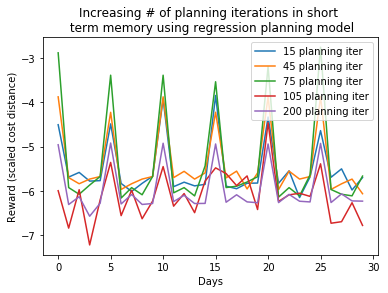

In [123]:
plt.figure()
plt.plot(reward_15_reg_st, label = "15 planning iter")
plt.plot(reward_45_reg_st, label = "45 planning iter")
plt.plot(reward_75_reg_st, label = "75 planning iter")
plt.plot(reward_105_reg_st, label = "105 planning iter")
plt.plot(reward_200_reg_st, label = "200 planning iter")
plt.legend()
plt.xlabel("Days")
plt.ylabel("Reward (scaled cost distance)")
plt.title("Increasing # of planning iterations in short \n term memory using regression planning model")
plt.show()

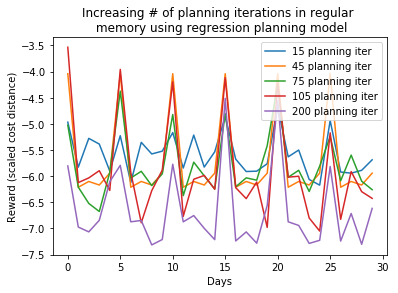

In [126]:
plt.figure()
plt.plot(reward_15_reg_lt, label = "15 planning iter")
plt.plot(reward_45_reg_lt, label = "45 planning iter")
plt.plot(reward_75_reg_lt, label = "75 planning iter")
plt.plot(reward_105_reg_lt, label = "105 planning iter")
plt.plot(reward_200_reg_lt, label = "200 planning iter")
plt.legend()
plt.xlabel("Days")
plt.ylabel("Reward (scaled cost distance)")
plt.title("Increasing # of planning iterations in regular \n memory using regression planning model")
plt.show()

Text(0.5,0.98,'Comparing short term versus long term memory using regression planning model\n\n')

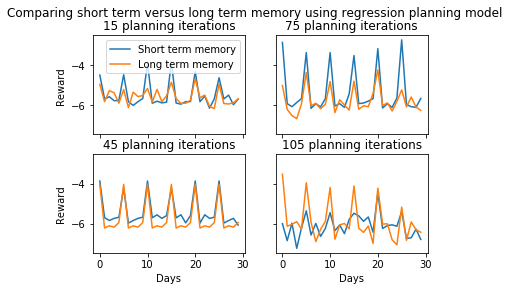

In [182]:
figure, axes = plt.subplots(2,2, sharey = True, sharex = True)

axes[0, 0].set_title("15 planning iterations")
axes[0, 0].plot(reward_15_reg_st, label = "Short term memory")
axes[0, 0].plot(reward_15_reg_lt, label = "Long term memory")
axes[0, 0].legend()

axes[1, 0].set_title("45 planning iterations")
axes[1, 0].plot(reward_45_reg_st, label = "Short term memory")
axes[1, 0].plot(reward_45_reg_lt, label = "Long term memory")

axes[0, 1].set_title("75 planning iterations")
axes[0, 1].plot(reward_75_reg_st, label = "Short term memory")
axes[0, 1].plot(reward_75_reg_lt, label = "Long term memory")

axes[1, 1].set_title("105 planning iterations")
axes[1, 1].plot(reward_105_reg_st, label = "Short term memory, 105 planning iter")
axes[1, 1].plot(reward_105_reg_lt, label = "Long term memory, 105 planning iter")


for ax in axes.flat:
    ax.set(xlabel = "Days", ylabel = "Reward ")
    ax.label_outer()

figure.suptitle("Comparing short term versus long term memory using regression planning model\n\n")


Text(0.5,0.98,'Comparing short term versus long term memory using regression planning model\n\n')

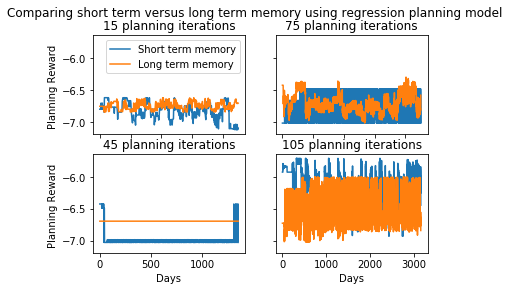

In [145]:
figure, axes = plt.subplots(2,2, sharey = True)

axes[0, 0].set_title("15 planning iterations")
axes[0, 0].plot(planning_rewards_15_reg_st, label = "Short term memory")
axes[0, 0].plot(planning_rewards_15_reg_lt, label = "Long term memory")
axes[0, 0].legend()

axes[1, 0].set_title("45 planning iterations")
axes[1, 0].plot(planning_rewards_45_reg_st, label = "Short term memory")
axes[1, 0].plot(planning_rewards_45_reg_lt, label = "Long term memory")

axes[0, 1].set_title("75 planning iterations")
axes[0, 1].plot(planning_rewards_75_reg_st, label = "Short term memory")
axes[0, 1].plot(planning_rewards_75_reg_lt, label = "Long term memory")

axes[1, 1].set_title("105 planning iterations")
plt.plot(planning_rewards_105_reg_st, label = "Short term memory, 105 planning iter")
plt.plot(planning_rewards_105_reg_lt, label = "Long term memory, 105 planning iter")

for ax in axes.flat:
    ax.set(xlabel = "Days", ylabel = "Planning Reward ")
    ax.label_outer()

figure.suptitle("Comparing short term versus long term memory using regression planning model\n\n")

## Short vs. Long term planning, regression, Multi-day

### Short Term versus long term with LSTM: need to graph and compare to regression above 

In [147]:

reward_15_st_md, planning_rewards_15_st_md = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = False,
         planning_iterations = 15, 
         batch_size_agent = 10,
         short_term_planning = True
         )

reward_30_st_md, planning_rewards_30_st_md = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = False,
         planning_iterations = 30, 
         batch_size_agent = 10,
         short_term_planning = True
         )

reward_45_st_md, planning_rewards_45_st_md = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = False,
         planning_iterations = 45, 
         batch_size_agent = 10,
         short_term_planning = True
         )

reward_60_st_md, planning_rewards_60_st_md = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = False,
         planning_iterations = 60, 
         batch_size_agent = 10,
         short_term_planning = True
         )

reward_15_lt_md, planning_rewards_15_lt_md = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = False,
         planning_iterations = 15, 
         batch_size_agent = 10,
         short_term_planning = False
         )

reward_30_lt_md, planning_rewards_30_lt_md = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = False,
         planning_iterations = 30, 
         batch_size_agent = 10,
         short_term_planning = False
         )

reward_45_lt_md, planning_rewards_45_lt_md = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = False,
         planning_iterations = 45, 
         batch_size_agent = 10,
         short_term_planning = False
         )

reward_60_lt_md, planning_rewards_60_lt_md = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = False,
         planning_iterations = 60, 
         batch_size_agent = 10,
         short_term_planning = False
         )


BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18
Day: 19
Day: 20
Day: 21
Day: 22
Day: 23
Day: 24
Day: 25
Day: 26
Day: 27
Day: 28
Day: 29
Day: 30
Day: 31
Loaded model from disk
--------------------
 planning step 0
action: [10.  0. 10.  0.  0. 10.  0. 10.  0. 10.]
--------------------
 planning step 1
action: [10.  0. 10.  0.  0. 10.  0. 10.  0. 10.]
--------------------
 planning step 2
action: [10.          0.         10.          0.          0.         10.
  0.         10.          0.10343218 10.        ]
--------------------
 planning step 3
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.0000000e+01 4.2915344e-06 1.0000000e+01]
--------------------
 planning step 4
action: [10.         0.        10.         0.         0.        10.
  0.         9.992446   0.4846959 10.       ]
--------------------
 p

--------------------
 planning step 11
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 8.4388342e+00 2.8572083e-03 1.0000000e+01]
--------------------
 planning step 12
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 1.7204285e-03 3.2485209e+00 1.0000000e+01]
--------------------
 planning step 13
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 8.5830688e-06 3.6993632e+00 1.0000000e+01]
--------------------
 planning step 14
action: [10.          0.         10.          0.          0.          9.995561
  0.          0.          0.01006794 10.        ]
--------------------------------------------------------------------------------
Day: 35
Loaded model from disk
--------------------
 planning step 0
action: [10.        0.       10.        0.        0.        9.999983  0.
  0.       10.       10.      ]
-------

--------------------------------------------------------------------------------
Day: 38
Loaded model from disk
--------------------
 planning step 0
action: [9.999897e+00 0.000000e+00 1.000000e+01 0.000000e+00 0.000000e+00
 0.000000e+00 0.000000e+00 1.000000e+01 6.198883e-06 1.000000e+01]
--------------------
 planning step 1
action: [4.0683746e-03 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 0.0000000e+00 1.0000000e+01 9.9999905e+00 1.0000000e+01]
--------------------
 planning step 2
action: [9.999420e+00 0.000000e+00 1.000000e+01 0.000000e+00 0.000000e+00
 0.000000e+00 0.000000e+00 1.000000e+01 7.123947e-04 1.000000e+01]
--------------------
 planning step 3
action: [ 9.989499  0.       10.        0.        0.        0.        0.
  9.999975  9.88889  10.      ]
--------------------
 planning step 4
action: [ 9.327436  0.       10.        0.        0.        0.        0.
 10.        0.       10.      ]
--------------------
 planning step 5
action: [ 9.97017

--------------------
 planning step 1
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 2.2535324e-03 0.0000000e+00 1.1677742e-03 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 2
action: [9.7802963e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 2.6865005e-03 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 3
action: [10.          0.         10.          0.          0.          9.999992
  0.          0.01947689  0.         10.        ]
--------------------
 planning step 4
action: [ 0.12595463  0.         10.          0.          0.          0.02364063
  0.          9.652119    0.         10.        ]
--------------------
 planning step 5
action: [10.        0.       10.        0.        0.        9.802805  0.
  0.        9.999529 10.      ]
--------------------
 planning step 6
action: [10.          0.         10.          0.          0.          0.03721952
  0.          9.999968  

--------------------
 planning step 4
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 9.7775764e+00 0.0000000e+00 0.0000000e+00 1.8119812e-05 1.0000000e+01]
--------------------
 planning step 5
action: [9.9981956e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 9.9840736e+00 0.0000000e+00 3.4332275e-05 9.0938444e+00 1.0000000e+01]
--------------------
 planning step 6
action: [9.9966011e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 2.0041466e-03 0.0000000e+00 0.0000000e+00 6.6000080e-01 1.0000000e+01]
--------------------
 planning step 7
action: [ 1.5273511  0.        10.         0.         0.        10.
  0.         0.        10.        10.       ]
--------------------
 planning step 8
action: [ 0.        0.       10.        0.        0.        5.026867  0.
  0.        9.99986  10.      ]
--------------------
 planning step 9
action: [7.501602e-03 0.000000e+00 1.000000e+01 0.000000e+00 0.000000e+00
 6.130999e+00 0.000000e+00

--------------------
 planning step 7
action: [5.8174133e-05 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 0.0000000e+00 9.9624844e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 8
action: [1.5989733e-01 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 0.0000000e+00 0.0000000e+00 1.9073486e-06 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 9
action: [0.000000e+00 0.000000e+00 1.000000e+01 0.000000e+00 0.000000e+00
 9.536743e-07 0.000000e+00 7.296321e+00 0.000000e+00 1.000000e+01]
--------------------
 planning step 10
action: [1.7261207e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 2.9850006e-04 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 11
action: [ 9.482519    0.         10.          0.          0.          0.
  0.          0.24878836  0.         10.        ]
--------------------
 planning step 12
action: [0.0000000e+00 0.0000000e+00 1.0000000e+01 0

--------------------
 planning step 14
action: [10.  0. 10.  0.  0. 10.  0.  0.  0. 10.]
--------------------------------------------------------------------------------
Day: 51
Loaded model from disk
--------------------
 planning step 0
action: [10.        0.       10.        0.        0.        9.996207  0.
  9.961814  0.       10.      ]
--------------------
 planning step 1
action: [9.9999990e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 9.9972515e+00 0.0000000e+00 1.4061928e-03 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 2
action: [ 9.981233  0.       10.        0.        0.        9.999005  0.
  0.        0.       10.      ]
--------------------
 planning step 3
action: [ 9.999249  0.       10.        0.        0.        9.956435  0.
 10.        0.       10.      ]
--------------------
 planning step 4
action: [ 0.        0.       10.        0.        0.        9.863036  0.
 10.        0.       10.      ]
--------------------
 planning step 5


--------------------
 planning step 1
action: [ 9.673784  0.       10.        0.        0.       10.        0.
  0.        0.       10.      ]
--------------------
 planning step 2
action: [ 9.995556  0.       10.        0.        0.       10.        0.
  0.        0.       10.      ]
--------------------
 planning step 3
action: [ 9.9795685   0.         10.          0.          0.         10.
  0.          0.21186876  0.         10.        ]
--------------------
 planning step 4
action: [10.        0.       10.        0.        0.        9.999999  0.
  9.999997  0.       10.      ]
--------------------
 planning step 5
action: [ 9.994682  0.       10.        0.        0.       10.        0.
  0.        0.       10.      ]
--------------------
 planning step 6
action: [10.  0. 10.  0.  0. 10.  0.  0.  0. 10.]
--------------------
 planning step 7
action: [ 9.459658  0.       10.        0.        0.        9.999737  0.
  9.994362  0.       10.      ]
--------------------
 planning step 

--------------------
 planning step 7
action: [ 0.         0.        10.         0.         0.         2.0852401
  0.        10.         0.        10.       ]
--------------------
 planning step 8
action: [ 0.        0.       10.        0.        0.        9.859812  0.
 10.        0.       10.      ]
--------------------
 planning step 9
action: [ 9.999842   0.        10.         0.         0.         0.
  0.         1.2875733  0.        10.       ]
--------------------
 planning step 10
action: [5.2452087e-06 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 2.0265102e-02 0.0000000e+00 9.9974308e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 11
action: [8.9459419e-03 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 4.5300293e-01 0.0000000e+00 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 12
action: [ 7.863467    0.         10.          0.          0.          0.
  0.          0.01334667  0.         10.        ]
----

--------------------
 planning step 10
action: [5.1879883e-03 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.2964966e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 11
action: [ 9.964338  0.       10.        0.        0.        9.999996  0.
  0.        0.       10.      ]
--------------------
 planning step 12
action: [1.0000000e+01 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.6260147e-04 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 13
action: [ 0.        0.       10.        0.        0.        9.983596  0.
  0.        0.       10.      ]
--------------------
 planning step 14
action: [9.8817635e+00 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.4305115e-06 0.0000000e+00 2.2125244e-04 0.0000000e+00 1.0000000e+01]
--------------------------------------------------------------------------------
BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day

--------------------
 planning step 23
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 5.0086975e-03 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 24
action: [ 0.       10.       10.       10.        0.       10.        9.982249
 10.        0.        0.      ]
--------------------
 planning step 25
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 3.8146973e-06 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 26
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 1.7080307e-03 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 27
action: [ 0. 10. 10. 10.  0. 10. 10. 10.  0.  0.]
--------------------
 planning step 28
action: [ 0.       10.       10.       10.        0.       10.        9.999649
 10.        0.        0.      ]
--------------------
 planning step 29
ac

--------------------
 planning step 19
action: [ 0.       10.       10.       10.        0.       10.        9.999804
 10.        0.        0.      ]
--------------------
 planning step 20
action: [ 0. 10. 10. 10.  0. 10.  0. 10.  0.  0.]
--------------------
 planning step 21
action: [ 0. 10. 10. 10.  0. 10.  0. 10.  0.  0.]
--------------------
 planning step 22
action: [ 0.         10.         10.         10.          0.         10.
  0.02460098 10.          0.          0.        ]
--------------------
 planning step 23
action: [0.000000e+00 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00
 1.000000e+01 5.836487e-04 1.000000e+01 0.000000e+00 0.000000e+00]
--------------------
 planning step 24
action: [0.00000e+00 1.00000e+01 1.00000e+01 1.00000e+01 0.00000e+00 1.00000e+01
 3.33786e-06 1.00000e+01 0.00000e+00 0.00000e+00]
--------------------
 planning step 25
action: [ 0. 10. 10. 10.  0. 10.  0. 10.  0.  0.]
--------------------
 planning step 26
action: [ 0.      10.      10.  

--------------------
 planning step 19
action: [ 0.        10.        10.        10.         0.        10.
  3.6806965 10.         0.         0.       ]
--------------------
 planning step 20
action: [ 0. 10. 10. 10.  0. 10. 10. 10.  0.  0.]
--------------------
 planning step 21
action: [ 0.       10.       10.       10.        0.       10.        9.876022
 10.        0.        0.      ]
--------------------
 planning step 22
action: [ 0. 10. 10. 10.  0. 10. 10. 10.  0.  0.]
--------------------
 planning step 23
action: [ 0.        10.        10.        10.         0.        10.
  1.6341009 10.         0.         0.       ]
--------------------
 planning step 24
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 2.3841858e-06 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 25
action: [ 0. 10. 10. 10.  0. 10. 10. 10.  0.  0.]
--------------------
 planning step 26
action: [ 0. 10. 10. 10.  0. 10. 10. 10.  0.  0.

--------------------
 planning step 18
action: [ 0. 10. 10. 10.  0. 10.  0. 10.  0.  0.]
--------------------
 planning step 19
action: [ 0.         10.         10.         10.          0.         10.
  0.03015327 10.          0.          0.        ]
--------------------
 planning step 20
action: [ 0.       10.       10.       10.        0.       10.        9.945859
 10.        0.        0.      ]
--------------------
 planning step 21
action: [0.000000e+00 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00
 1.000000e+01 9.536743e-07 1.000000e+01 0.000000e+00 0.000000e+00]
--------------------
 planning step 22
action: [ 0. 10. 10. 10.  0. 10.  0. 10.  0.  0.]
--------------------
 planning step 23
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 2.3460388e-04 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 24
action: [ 0. 10. 10. 10.  0. 10.  0. 10.  0.  0.]
--------------------
 planning step 25
action: [0.0

--------------------
 planning step 18
action: [ 0.       10.       10.       10.        0.       10.        9.123554
 10.        0.        0.      ]
--------------------
 planning step 19
action: [ 0.         10.         10.         10.          0.         10.
  0.19915438 10.          0.          0.        ]
--------------------
 planning step 20
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 4.7683716e-07 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 21
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 4.2915344e-06 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 22
action: [ 0. 10. 10. 10.  0. 10. 10. 10.  0.  0.]
--------------------
 planning step 23
action: [ 0. 10. 10. 10.  0. 10.  0. 10.  0.  0.]
--------------------
 planning step 24
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+

--------------------
 planning step 13
action: [ 0.       10.       10.       10.        0.       10.        9.173729
 10.        0.        0.      ]
--------------------
 planning step 14
action: [ 0.         10.         10.         10.          0.         10.
  0.82692385 10.          0.          0.        ]
--------------------
 planning step 15
action: [ 0.         10.         10.         10.          0.         10.
  0.08658361 10.          0.          0.        ]
--------------------
 planning step 16
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 7.1144104e-04 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 17
action: [ 0.      10.      10.      10.       0.      10.       9.99247 10.
  0.       0.     ]
--------------------
 planning step 18
action: [ 0. 10. 10. 10.  0. 10.  0. 10.  0.  0.]
--------------------
 planning step 19
action: [ 0. 10. 10. 10.  0. 10.  0. 10.  0.  0.]
--------------------
 p

--------------------
 planning step 6
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 4.8160553e-05 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 7
action: [ 0. 10. 10. 10.  0. 10.  0. 10.  0.  0.]
--------------------
 planning step 8
action: [ 0.       10.       10.       10.        0.       10.        9.993449
 10.        0.        0.      ]
--------------------
 planning step 9
action: [ 0.       10.       10.       10.        0.       10.        9.836044
 10.        0.        0.      ]
--------------------
 planning step 10
action: [ 0.      10.      10.      10.       0.      10.       9.91522 10.
  0.       0.     ]
--------------------
 planning step 11
action: [ 0.        10.        10.        10.         0.        10.
  4.0612698 10.         0.         0.       ]
--------------------
 planning step 12
action: [0.00000e+00 1.00000e+01 1.00000e+01 1.00000e+01 0.00000e+00 1.00000e+01
 7.43866e-05 1.00

--------------------
 planning step 2
action: [ 0.       10.       10.       10.        0.       10.        9.999981
 10.        0.        0.      ]
--------------------
 planning step 3
action: [ 0.       10.       10.       10.        0.       10.        9.979312
 10.        0.        0.      ]
--------------------
 planning step 4
action: [ 0. 10. 10. 10.  0. 10. 10. 10.  0.  0.]
--------------------
 planning step 5
action: [ 0.       10.       10.       10.        0.       10.        9.968622
 10.        0.        0.      ]
--------------------
 planning step 6
action: [ 0.        10.        10.        10.         0.        10.
  0.5029235 10.         0.         0.       ]
--------------------
 planning step 7
action: [ 0. 10. 10. 10.  0. 10. 10. 10.  0.  0.]
--------------------
 planning step 8
action: [ 0.         10.         10.         10.          0.         10.
  0.07740879 10.          0.          0.        ]
--------------------
 planning step 9
action: [ 0.        10.   

--------------------
 planning step 28
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 4.7683716e-06 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 29
action: [ 0.       10.       10.       10.        0.       10.        9.996876
 10.        0.        0.      ]
--------------------------------------------------------------------------------
Day: 48
Loaded model from disk
--------------------
 planning step 0
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 4.7683716e-07 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 1
action: [ 0.        10.        10.        10.         0.        10.
  5.0152082 10.         0.         0.       ]
--------------------
 planning step 2
action: [ 0.       10.       10.       10.        0.       10.        6.580423
 10.        0.        0.      ]
--------------------
 planning step 3
action: [ 0. 10. 10.

--------------------
 planning step 25
action: [ 0.        10.        10.        10.         0.        10.
  9.9999275 10.         0.         0.       ]
--------------------
 planning step 26
action: [ 0. 10. 10. 10.  0. 10. 10. 10.  0.  0.]
--------------------
 planning step 27
action: [ 0.         10.         10.         10.          0.         10.
  0.21239758 10.          0.          0.        ]
--------------------
 planning step 28
action: [ 0. 10. 10. 10.  0. 10.  0. 10.  0.  0.]
--------------------
 planning step 29
action: [0.000000e+00 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00
 1.000000e+01 8.659363e-04 1.000000e+01 0.000000e+00 0.000000e+00]
--------------------------------------------------------------------------------
Day: 50
Loaded model from disk
--------------------
 planning step 0
action: [ 0.       10.       10.       10.        0.       10.        9.967474
 10.        0.        0.      ]
--------------------
 planning step 1
action: [ 0. 10. 10. 10.  0.

--------------------
 planning step 20
action: [ 0.      10.      10.      10.       0.      10.       9.99998 10.
  0.       0.     ]
--------------------
 planning step 21
action: [ 0.       10.       10.       10.        0.       10.        9.945692
 10.        0.        0.      ]
--------------------
 planning step 22
action: [ 0.         10.         10.         10.          0.         10.
  0.30063963 10.          0.          0.        ]
--------------------
 planning step 23
action: [ 0.        10.        10.        10.         0.        10.
  4.0031705 10.         0.         0.       ]
--------------------
 planning step 24
action: [0.000000e+00 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00
 1.000000e+01 4.673004e-05 1.000000e+01 0.000000e+00 0.000000e+00]
--------------------
 planning step 25
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 7.9631805e-04 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning

--------------------
 planning step 15
action: [ 0. 10. 10. 10.  0. 10.  0. 10.  0.  0.]
--------------------
 planning step 16
action: [ 0.         10.         10.         10.          0.         10.
  0.03432512 10.          0.          0.        ]
--------------------
 planning step 17
action: [ 0.       10.       10.       10.        0.       10.        9.999294
 10.        0.        0.      ]
--------------------
 planning step 18
action: [ 0. 10. 10. 10.  0. 10.  0. 10.  0.  0.]
--------------------
 planning step 19
action: [ 0. 10. 10. 10.  0. 10.  0. 10.  0.  0.]
--------------------
 planning step 20
action: [ 0. 10. 10. 10.  0. 10.  0. 10.  0.  0.]
--------------------
 planning step 21
action: [0.000000e+00 1.000000e+01 1.000000e+01 1.000000e+01 0.000000e+00
 1.000000e+01 2.202034e-03 1.000000e+01 0.000000e+00 0.000000e+00]
--------------------
 planning step 22
action: [ 0. 10. 10. 10.  0. 10.  0. 10.  0.  0.]
--------------------
 planning step 23
action: [ 0.        10. 

--------------------
 planning step 15
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 1.3828278e-05 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 16
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 4.4441223e-04 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 17
action: [ 0.       10.       10.       10.        0.       10.        9.993132
 10.        0.        0.      ]
--------------------
 planning step 18
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 4.7683716e-07 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 19
action: [ 0.        10.        10.        10.         0.        10.
  9.9999895 10.         0.         0.       ]
--------------------
 planning step 20
action: [ 0.         10.         10.         10.          0.         10.
  0.22849798 10

--------------------
 planning step 11
action: [ 0. 10. 10. 10.  0. 10. 10. 10.  0.  0.]
--------------------
 planning step 12
action: [ 0. 10. 10. 10.  0. 10. 10. 10.  0.  0.]
--------------------
 planning step 13
action: [ 0.       10.       10.       10.        0.       10.        9.999996
 10.        0.        0.      ]
--------------------
 planning step 14
action: [ 0. 10. 10. 10.  0. 10. 10. 10.  0.  0.]
--------------------
 planning step 15
action: [ 0.        10.        10.        10.         0.        10.
  2.5914066 10.         0.         0.       ]
--------------------
 planning step 16
action: [ 0. 10. 10. 10.  0. 10. 10. 10.  0.  0.]
--------------------
 planning step 17
action: [ 0.       10.       10.       10.        0.       10.        9.999994
 10.        0.        0.      ]
--------------------
 planning step 18
action: [ 0.       10.       10.       10.        0.       10.        9.998557
 10.        0.        0.      ]
--------------------
 planning step 19
ac

--------------------
 planning step 11
action: [0.0000000e+00 1.0000000e+01 1.0000000e+01 1.0000000e+01 0.0000000e+00
 1.0000000e+01 6.2088966e-03 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 12
action: [ 0. 10. 10. 10.  0. 10. 10. 10.  0.  0.]
--------------------
 planning step 13
action: [ 0. 10. 10. 10.  0. 10. 10. 10.  0.  0.]
--------------------
 planning step 14
action: [ 0.        10.        10.        10.         0.        10.
  5.9965763 10.         0.         0.       ]
--------------------
 planning step 15
action: [ 0.       10.       10.       10.        0.       10.        9.999998
 10.        0.        0.      ]
--------------------
 planning step 16
action: [ 0.        10.        10.        10.         0.        10.
  7.4683194 10.         0.         0.       ]
--------------------
 planning step 17
action: [ 0.      10.      10.      10.       0.      10.       3.17629 10.
  0.       0.     ]
--------------------
 planning step 18
ac

--------------------
 planning step 8
action: [10.  0. 10.  0.  0. 10.  0.  0.  0. 10.]
--------------------
 planning step 9
action: [10.  0. 10.  0.  0. 10.  0.  0.  0. 10.]
--------------------
 planning step 10
action: [10.  0. 10.  0.  0. 10.  0.  0.  0. 10.]
--------------------
 planning step 11
action: [10.  0. 10.  0.  0. 10.  0.  0.  0. 10.]
--------------------
 planning step 12
action: [10.  0. 10.  0.  0. 10.  0.  0.  0. 10.]
--------------------
 planning step 13
action: [10.  0. 10.  0.  0. 10.  0.  0.  0. 10.]
--------------------
 planning step 14
action: [10.  0. 10.  0.  0. 10.  0.  0.  0. 10.]
--------------------
 planning step 15
action: [10.  0. 10.  0.  0. 10.  0.  0.  0. 10.]
--------------------
 planning step 16
action: [10.  0. 10.  0.  0. 10.  0.  0.  0. 10.]
--------------------
 planning step 17
action: [10.  0. 10.  0.  0. 10.  0.  0.  0. 10.]
--------------------
 planning step 18
action: [10.  0. 10.  0.  0. 10.  0.  0.  0. 10.]
--------------------
 p

--------------------------------------------------------------------------------
Day: 33
Loaded model from disk
--------------------
 planning step 0
action: [ 9.609064  0.       10.        0.        0.       10.        0.
  0.        0.       10.      ]
--------------------
 planning step 1
action: [10.  0. 10.  0.  0. 10.  0.  0.  0. 10.]
--------------------
 planning step 2
action: [ 5.8282127  0.        10.         0.         0.        10.
  0.         0.         0.        10.       ]
--------------------
 planning step 3
action: [1.9550323e-05 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00
 1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 4
action: [ 4.8674793  0.        10.         0.         0.        10.
  0.         0.         0.        10.       ]
--------------------
 planning step 5
action: [10.  0. 10.  0.  0. 10.  0.  0.  0. 10.]
--------------------
 planning step 6
action: [ 9.945449  0.       10.      

KeyboardInterrupt: 

### Batch size with regression: need to graph

In [148]:
reward_200_reg_batch_10, planning_rewards_200_reg_batch_10 = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 200, 
         batch_size_agent = 10,
         short_term_planning = True,
         planning_model_type = "OLS"
         )

reward_200_reg_batch_50, planning_rewards_200_reg_batch_50 = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 200, 
         batch_size_agent = 50,
         short_term_planning = True,
         planning_model_type = "OLS"
         )

reward_200_reg_batch_100, planning_rewards_200_reg_batch_100 = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 200, 
         batch_size_agent = 100,
         short_term_planning = True,
         planning_model_type = "OLS"
         )

reward_200_reg_batch_150, planning_rewards_200_reg_batch_150 = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 200, 
         batch_size_agent = 150,
         short_term_planning = True,
         planning_model_type = "OLS"
         )

reward_200_reg_batch_100, planning_rewards_200_reg_batch_100 = train(response_type_str = "mixed", 
         extra_train = 0, 
         energy = True,
         day_of_week = True,
         planning_model = True,
         one_day = True,
         planning_iterations = 200, 
         batch_size_agent = 100,
         short_term_planning = True,
         planning_model_type = "OLS"
         )

BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18
Day: 19
Day: 20
Day: 21
Day: 22
Day: 23
Day: 24
Day: 25
Day: 26
Day: 27
Day: 28
Day: 29
Day: 30
Day: 31
--------------------
 planning step 0
action: [10.        10.        10.        10.        10.         0.
 10.        10.         0.         0.5867028]
--------------------
 planning step 1
action: [10.        10.        10.        10.        10.         0.
 10.        10.         0.         0.5867028]
--------------------
 planning step 2
action: [10.        10.        10.        10.        10.         0.
 10.        10.         0.         0.5867028]
--------------------
 planning step 3
action: [10.        10.        10.        10.        10.         0.
 10.        10.         0.         0.5867028]
--------------------
 planning step 4
action: [10.        10.        10.        10.        10.         0.
 10.      

--------------------
 planning step 50
action: [10.        10.         9.999993  10.        10.         0.
 10.         9.998802   0.         2.1379037]
--------------------
 planning step 51
action: [1.0000000e+01 1.0000000e+01 9.9999056e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 5.7220459e-06 0.0000000e+00 3.3444476e+00]
--------------------
 planning step 52
action: [1.0000000e+01 1.0000000e+01 4.7683716e-06 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9999990e+00 0.0000000e+00 1.7867053e+00]
--------------------
 planning step 53
action: [1.0000000e+01 1.0000000e+01 9.9999981e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.8610229e-06 0.0000000e+00 1.1112018e+00]
--------------------
 planning step 54
action: [1.0000000e+01 1.0000000e+01 2.4046216e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.5367432e-07 0.0000000e+00 5.8891096e+00]
--------------------
 planning step 55
action: [1.0000000e+01 1.0000000e+01 3.0994415e-

--------------------
 planning step 99
action: [10.        10.         9.999996  10.        10.         0.
 10.         9.999996   0.         3.0102825]
--------------------
 planning step 100
action: [1.0000000e+01 1.0000000e+01 3.9577484e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 3.8146973e-06 0.0000000e+00 6.8141441e+00]
--------------------
 planning step 101
action: [10.         10.          0.         10.         10.          0.
 10.          9.999994    0.          0.41571903]
--------------------
 planning step 102
action: [10.        10.         9.999999  10.        10.         0.
 10.         4.9123626  0.         9.285928 ]
--------------------
 planning step 103
action: [10.         10.          0.01721096 10.         10.          0.
 10.          0.03539515  0.          8.945503  ]
--------------------
 planning step 104
action: [10.         10.          9.947226   10.         10.          0.
 10.          9.978651    0.          0.27685928]
-------------

--------------------
 planning step 148
action: [10.         10.          9.99996    10.         10.          0.
 10.          5.560279    0.          0.31950283]
--------------------
 planning step 149
action: [10.       10.       10.       10.       10.        0.       10.
  9.942537  0.        8.239391]
--------------------
 planning step 150
action: [1.000000e+01 1.000000e+01 8.010864e-05 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 9.985075e+00 0.000000e+00 2.553123e+00]
--------------------
 planning step 151
action: [1.0000000e+01 1.0000000e+01 5.1305580e-01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.8968582e-03 0.0000000e+00 1.0587029e+00]
--------------------
 planning step 152
action: [10.        10.         9.99712   10.        10.         0.
 10.         2.5408487  0.         2.0093746]
--------------------
 planning step 153
action: [10.        10.         9.998402  10.        10.         0.
 10.         9.986818   0.         1.9017699]
------------

--------------------
 planning step 197
action: [10.       10.       10.       10.       10.        0.       10.
  9.989942  0.        1.038547]
--------------------
 planning step 198
action: [10.         10.          9.999998   10.         10.          0.
 10.          0.          0.          0.01158476]
--------------------
 planning step 199
action: [1.0000000e+01 1.0000000e+01 7.2956085e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9999971e+00 0.0000000e+00 3.9570427e+00]
--------------------------------------------------------------------------------
Day: 32
--------------------
 planning step 0
action: [10.       10.        9.991616 10.       10.        0.       10.
  9.999999  0.        9.997244]
--------------------
 planning step 1
action: [10.        10.         9.6754465 10.        10.         0.
 10.         9.97994    0.         9.997244 ]
--------------------
 planning step 2
action: [10.       10.       10.       10.       10.        0.       10.
  9.99

--------------------
 planning step 46
action: [10.        10.         0.8146267 10.        10.         0.
 10.        10.         0.         0.       ]
--------------------
 planning step 47
action: [1.000000e+01 1.000000e+01 2.002716e-05 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 8.469299e+00 0.000000e+00 5.006790e-05]
--------------------
 planning step 48
action: [1.0000000e+01 1.0000000e+01 4.2406726e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.7683716e-07 0.0000000e+00 1.7166138e-05]
--------------------
 planning step 49
action: [10.         10.          9.997094   10.         10.          0.
 10.          9.99941     0.          0.62115955]
--------------------
 planning step 50
action: [10.       10.        9.869734 10.       10.        0.       10.
 10.        0.        9.999419]
--------------------
 planning step 51
action: [1.0000000e+01 1.0000000e+01 1.4352798e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9999990e+00 0.0000000e

--------------------
 planning step 95
action: [10.        10.         1.0704994 10.        10.         0.
 10.         9.995749   0.         0.       ]
--------------------
 planning step 96
action: [10.        10.         9.654779  10.        10.         0.
 10.         1.7388453  0.         9.999981 ]
--------------------
 planning step 97
action: [10.         10.          5.310112   10.         10.          0.
 10.          0.09309006  0.          0.        ]
--------------------
 planning step 98
action: [10.       10.        9.432504 10.       10.        0.       10.
  9.298918  0.       10.      ]
--------------------
 planning step 99
action: [10.       10.        0.       10.       10.        0.       10.
  9.998163  0.        0.      ]
--------------------
 planning step 100
action: [10.         10.          6.6737556  10.         10.          0.
 10.          9.999939    0.          0.09035397]
--------------------
 planning step 101
action: [1.0000000e+01 1.0000000e+01 1.44

--------------------
 planning step 144
action: [1.0000000e+01 1.0000000e+01 9.9945946e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.4781952e-05 0.0000000e+00 9.9970407e+00]
--------------------
 planning step 145
action: [1.0000000e+01 1.0000000e+01 4.3046093e-01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.7434597e-02 0.0000000e+00 3.1962395e-03]
--------------------
 planning step 146
action: [1.000000e+01 1.000000e+01 9.609572e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 2.861023e-06 0.000000e+00 0.000000e+00]
--------------------
 planning step 147
action: [10.       10.        9.615891 10.       10.        0.       10.
  0.        0.       10.      ]
--------------------
 planning step 148
action: [10.         10.          0.02111244 10.         10.          0.
 10.          9.149963    0.          9.9996395 ]
--------------------
 planning step 149
action: [10.       10.        0.       10.       10.        0.       10.
  9.999998  0.  

--------------------
 planning step 193
action: [10.       10.        9.999996 10.       10.        0.       10.
  9.744932  0.        9.177852]
--------------------
 planning step 194
action: [1.0000000e+01 1.0000000e+01 1.5115738e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.8717930e+00]
--------------------
 planning step 195
action: [10.       10.        9.983909 10.       10.        0.       10.
  9.217837  0.       10.      ]
--------------------
 planning step 196
action: [1.0000000e+01 1.0000000e+01 1.8119812e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9999847e+00 0.0000000e+00 9.3917713e+00]
--------------------
 planning step 197
action: [1.0000000e+01 1.0000000e+01 2.2206159e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.7683716e-07 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 198
action: [10.       10.       10.       10.       10.        0.       10.
  9.999769  0.       10.

--------------------
 planning step 42
action: [1.000000e+01 1.000000e+01 9.987196e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 9.031052e+00 0.000000e+00 3.862381e-05]
--------------------
 planning step 43
action: [10.       10.        9.328865 10.       10.        0.       10.
  9.999889  0.        0.      ]
--------------------
 planning step 44
action: [10.        10.         0.7534938 10.        10.         0.
 10.         5.213706   0.         3.837308 ]
--------------------
 planning step 45
action: [10.        10.         9.999906  10.        10.         0.
 10.        10.         0.         1.5171394]
--------------------
 planning step 46
action: [1.0000000e+01 1.0000000e+01 9.9937992e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9998789e+00 0.0000000e+00 1.5258789e-05]
--------------------
 planning step 47
action: [1.0000000e+01 1.0000000e+01 6.6280365e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 8.7786541e+00 0.0000000e+00 9.857

--------------------
 planning step 92
action: [1.000000e+01 1.000000e+01 4.673004e-05 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 0.000000e+00 0.000000e+00 1.000000e+01]
--------------------
 planning step 93
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 6.5722466e-03]
--------------------
 planning step 94
action: [10.       10.       10.       10.       10.        0.       10.
  9.030604  0.       10.      ]
--------------------
 planning step 95
action: [1.0000000e+01 1.0000000e+01 8.2578468e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9728651e+00 0.0000000e+00 2.7227402e-04]
--------------------
 planning step 96
action: [10.        10.         9.998808  10.        10.         0.
 10.         1.1443951  0.         7.7413826]
--------------------
 planning step 97
action: [1.0000000e+01 1.0000000e+01 9.9999638e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e

--------------------
 planning step 140
action: [10.        10.         0.5186372 10.        10.         0.
 10.         7.003835   0.         0.       ]
--------------------
 planning step 141
action: [10.       10.        2.564481 10.       10.        0.       10.
  9.985453  0.        9.999989]
--------------------
 planning step 142
action: [10.        10.         6.8881254 10.        10.         0.
 10.         9.957848   0.         0.       ]
--------------------
 planning step 143
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 3.2520294e-04]
--------------------
 planning step 144
action: [10.         10.          0.         10.         10.          0.
 10.         10.          0.          0.14055204]
--------------------
 planning step 145
action: [10.       10.       10.       10.       10.        0.       10.
  9.415841  0.       10.      ]
--------------------
 planning step 146
action: 

--------------------
 planning step 188
action: [10.         10.          9.987486   10.         10.          0.
 10.          9.99443     0.          0.02368546]
--------------------
 planning step 189
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 6.6757202e-06 0.0000000e+00 1.9814491e-02]
--------------------
 planning step 190
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9999752e+00 0.0000000e+00 7.6293945e-06]
--------------------
 planning step 191
action: [10.         10.         10.         10.         10.          0.
 10.          9.999241    0.          0.01426983]
--------------------
 planning step 192
action: [1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 4.005432e-05 0.000000e+00 0.000000e+00]
--------------------
 planning step 193
action: [10. 10. 10. 10. 10.  0. 10.  0.  0.  0.]
--------------------


--------------------
 planning step 38
action: [1.0000000e+01 1.0000000e+01 4.7683716e-07 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.1923087e+00 0.0000000e+00 2.3603439e-04]
--------------------
 planning step 39
action: [1.0000000e+01 1.0000000e+01 5.5354443e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.6202526e+00 0.0000000e+00 1.6546249e-04]
--------------------
 planning step 40
action: [1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 9.971741e+00 0.000000e+00 7.390976e-05]
--------------------
 planning step 41
action: [1.0000000e+01 1.0000000e+01 3.0009270e-02 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.9073486e-06 0.0000000e+00 9.8087606e+00]
--------------------
 planning step 42
action: [10.       10.        9.999947 10.       10.        0.       10.
  0.        0.        9.96311 ]
--------------------
 planning step 43
action: [10. 10. 10. 10. 10.  0. 10.  0.  0. 10.]
-----------------

--------------------
 planning step 86
action: [10.         10.          9.999857   10.         10.          0.
 10.          9.999996    0.          0.12546968]
--------------------
 planning step 87
action: [10.       10.       10.       10.       10.        0.       10.
  9.999992  0.        0.      ]
--------------------
 planning step 88
action: [1.0000000e+01 1.0000000e+01 7.3909760e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 7.2015038e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 89
action: [1.000000e+01 1.000000e+01 7.997036e-03 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 6.198883e-06 0.000000e+00 4.339218e-05]
--------------------
 planning step 90
action: [1.0000000e+01 1.0000000e+01 1.8172264e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.5278769e-01 0.0000000e+00 3.3378601e-06]
--------------------
 planning step 91
action: [1.000000e+01 1.000000e+01 9.644766e-01 1.000000e+01 1.000000e+01
 0.000000e+00 1.00000

--------------------
 planning step 135
action: [10.       10.        9.973529 10.       10.        0.       10.
  0.        0.        9.99978 ]
--------------------
 planning step 136
action: [10.         10.          0.02657318 10.         10.          0.
 10.          9.918717    0.          0.        ]
--------------------
 planning step 137
action: [10.       10.        9.999996 10.       10.        0.       10.
  2.29262   0.        0.      ]
--------------------
 planning step 138
action: [10.         10.          9.999977   10.         10.          0.
 10.          0.07375336  0.          9.858633  ]
--------------------
 planning step 139
action: [1.0000000e+01 1.0000000e+01 2.4299622e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9999828e+00 0.0000000e+00 9.3978748e+00]
--------------------
 planning step 140
action: [1.0000000e+01 1.0000000e+01 9.8111782e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.2915344e-06 0.0000000e+00 9.9999504e+00]
--

--------------------
 planning step 185
action: [10. 10.  0. 10. 10.  0. 10. 10.  0. 10.]
--------------------
 planning step 186
action: [10.       10.        9.992078 10.       10.        0.       10.
  7.109516  0.        0.      ]
--------------------
 planning step 187
action: [10. 10.  0. 10. 10.  0. 10. 10.  0. 10.]
--------------------
 planning step 188
action: [10.         10.          9.999996   10.         10.          0.
 10.          0.          0.          0.15777254]
--------------------
 planning step 189
action: [10.         10.          0.         10.         10.          0.
 10.          9.999952    0.          0.18378687]
--------------------
 planning step 190
action: [1.0000000e+01 1.0000000e+01 1.4214516e-02 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.3910208e+00 0.0000000e+00 2.4795532e-05]
--------------------
 planning step 191
action: [10.       10.        0.       10.       10.        0.       10.
  9.999508  0.        8.478949]
-------------

--------------------
 planning step 34
action: [10.         10.          9.542744   10.         10.          0.
 10.          0.02746773  0.          6.3184505 ]
--------------------
 planning step 35
action: [10.        10.         6.5505533 10.        10.         0.
 10.         9.999977   0.         9.999569 ]
--------------------
 planning step 36
action: [1.0000000e+01 1.0000000e+01 9.9986744e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 3.7384033e-04 0.0000000e+00 9.9999990e+00]
--------------------
 planning step 37
action: [10.         10.         10.         10.         10.          0.
 10.          0.          0.          0.26826572]
--------------------
 planning step 38
action: [1.0000000e+01 1.0000000e+01 9.4893551e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.4305115e-06 0.0000000e+00 9.9912281e+00]
--------------------
 planning step 39
action: [1.0000000e+01 1.0000000e+01 8.8204813e-01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e

--------------------
 planning step 83
action: [10.         10.          0.29821205 10.         10.          0.
 10.          0.29001188  0.         10.        ]
--------------------
 planning step 84
action: [10.       10.        9.99995  10.       10.        0.       10.
 10.        0.        9.999763]
--------------------
 planning step 85
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.8599243e-03 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 86
action: [1.0000000e+01 1.0000000e+01 4.4504452e-01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 3.5285950e-05 0.0000000e+00 9.9997406e+00]
--------------------
 planning step 87
action: [1.0000000e+01 1.0000000e+01 1.1199570e-01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.9073486e-06 0.0000000e+00 6.6757202e-06]
--------------------
 planning step 88
action: [1.0000000e+01 1.0000000e+01 2.7656555e-05 1.0000000e+01 1.0000000e+01
 0.000

--------------------
 planning step 131
action: [10.       10.        0.       10.       10.        0.       10.
 10.        0.        9.971693]
--------------------
 planning step 132
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 5.1355362e-04 0.0000000e+00 4.3120384e-03]
--------------------
 planning step 133
action: [10.        10.         4.9510384 10.        10.         0.
 10.        10.         0.         9.999889 ]
--------------------
 planning step 134
action: [10.        10.         0.        10.        10.         0.
 10.         9.9998455  0.         9.992336 ]
--------------------
 planning step 135
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9999886e+00 0.0000000e+00 1.9292831e-03]
--------------------
 planning step 136
action: [10.        10.         1.3403976 10.        10.         0.
 10.        10.         0.         1.500596 ]
-----------

--------------------
 planning step 180
action: [1.0000000e+01 1.0000000e+01 9.5367432e-07 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 4.4240885e+00]
--------------------
 planning step 181
action: [10.       10.        9.999902 10.       10.        0.       10.
  9.973153  0.        0.      ]
--------------------
 planning step 182
action: [1.000000e+01 1.000000e+01 9.994865e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 9.536743e-07 0.000000e+00 5.054474e-05]
--------------------
 planning step 183
action: [1.0000000e+01 1.0000000e+01 2.3643780e-01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.6784668e-04]
--------------------
 planning step 184
action: [10.         10.          0.04591179 10.         10.          0.
 10.          0.          0.          6.312567  ]
--------------------
 planning step 185
action: [10.       10.        9.999733 10.       10.        0.       10.
  9.932959  0.  

--------------------
 planning step 28
action: [10.       10.       10.       10.       10.        0.       10.
  9.994564  0.        9.9987  ]
--------------------
 planning step 29
action: [1.0000000e+01 1.0000000e+01 9.9999866e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.8683300e+00 0.0000000e+00 3.0403137e-03]
--------------------
 planning step 30
action: [1.0000000e+01 1.0000000e+01 9.9999781e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 5.8174133e-04 0.0000000e+00 2.0093918e-03]
--------------------
 planning step 31
action: [1.0000000e+01 1.0000000e+01 3.4108162e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.1730194e-04]
--------------------
 planning step 32
action: [10.        10.         0.        10.        10.         0.
 10.        10.         0.         1.4000292]
--------------------
 planning step 33
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 1.0000

--------------------
 planning step 77
action: [10.         10.          0.06028748 10.         10.          0.
 10.          9.998255    0.         10.        ]
--------------------
 planning step 78
action: [10.         10.          0.         10.         10.          0.
 10.          0.90863323  0.         10.        ]
--------------------
 planning step 79
action: [10.         10.          0.90520287 10.         10.          0.
 10.          9.673164    0.          9.997887  ]
--------------------
 planning step 80
action: [1.0000000e+01 1.0000000e+01 3.3051877e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9609985e+00 0.0000000e+00 8.5821152e-03]
--------------------
 planning step 81
action: [1.0000000e+01 1.0000000e+01 9.8869781e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.7683716e-07 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 82
action: [10.       10.        9.999866 10.       10.        0.       10.
  1.155127  0.        

--------------------
 planning step 126
action: [1.000000e+01 1.000000e+01 5.874634e-03 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 8.552595e+00 0.000000e+00 9.933426e+00]
--------------------
 planning step 127
action: [10.         10.          6.4792953  10.         10.          0.
 10.          0.          0.          0.18376398]
--------------------
 planning step 128
action: [1.0000000e+01 1.0000000e+01 1.1867046e-02 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 8.4722157e+00 0.0000000e+00 6.8540573e-03]
--------------------
 planning step 129
action: [10.         10.          0.06649876 10.         10.          0.
 10.          8.046677    0.          0.        ]
--------------------
 planning step 130
action: [10.       10.        9.999992 10.       10.        0.       10.
  9.999951  0.        6.005225]
--------------------
 planning step 131
action: [10.       10.        9.986962 10.       10.        0.       10.
  0.        0.        9.259971]
------------

--------------------
 planning step 176
action: [10.         10.          0.25767517 10.         10.          0.
 10.          9.999998    0.          0.        ]
--------------------
 planning step 177
action: [10.       10.        0.       10.       10.        0.       10.
  9.999996  0.        0.      ]
--------------------
 planning step 178
action: [10.         10.          0.88236284 10.         10.          0.
 10.          9.999996    0.          2.0035636 ]
--------------------
 planning step 179
action: [1.0000000e+01 1.0000000e+01 5.1689148e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.6750336e-02]
--------------------
 planning step 180
action: [1.0000000e+01 1.0000000e+01 9.9999676e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.4596939e-02 0.0000000e+00 6.0567856e-03]
--------------------
 planning step 181
action: [10. 10. 10. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 182
action: [1.000000

--------------------
 planning step 26
action: [1.0000000e+01 1.0000000e+01 4.2915344e-06 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 8.5830688e-06]
--------------------
 planning step 27
action: [1.0000000e+01 1.0000000e+01 4.0626526e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.0599060e-06 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 28
action: [1.000000e+01 1.000000e+01 9.999999e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 5.888939e-04 0.000000e+00 9.995008e+00]
--------------------
 planning step 29
action: [1.000000e+01 1.000000e+01 8.406639e-04 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 5.207405e-01 0.000000e+00 1.000000e+01]
--------------------
 planning step 30
action: [10.         10.          0.         10.         10.          0.
 10.          9.9912815   0.          0.96413517]
--------------------
 planning step 31
action: [1.0000000e+01 1.0000000e+01 9.9999590e+00 1.000000

--------------------
 planning step 75
action: [1.0000000e+01 1.0000000e+01 9.9999714e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.4798393e-02 0.0000000e+00 1.1019707e-03]
--------------------
 planning step 76
action: [10.        10.         1.368973  10.        10.         0.
 10.         0.0523057  0.         9.848472 ]
--------------------
 planning step 77
action: [1.000000e+01 1.000000e+01 9.888441e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 7.616067e+00 0.000000e+00 9.536743e-07]
--------------------
 planning step 78
action: [10.       10.       10.       10.       10.        0.       10.
  9.998145  0.        9.999921]
--------------------
 planning step 79
action: [10.         10.          0.06528568 10.         10.          0.
 10.         10.          0.          8.911612  ]
--------------------
 planning step 80
action: [10.       10.        9.239523 10.       10.        0.       10.
 10.        0.        9.999647]
--------------------
 plann

--------------------
 planning step 125
action: [1.0000000e+01 1.0000000e+01 9.5367432e-07 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9951172e+00 0.0000000e+00 6.9618225e-05]
--------------------
 planning step 126
action: [1.0000000e+01 1.0000000e+01 9.9990540e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.8133392e-05]
--------------------
 planning step 127
action: [1.000000e+01 1.000000e+01 9.999993e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 2.667427e-03 0.000000e+00 0.000000e+00]
--------------------
 planning step 128
action: [10. 10. 10. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 129
action: [1.0000000e+01 1.0000000e+01 5.2452087e-06 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.4109612e-03 0.0000000e+00 1.6613960e-02]
--------------------
 planning step 130
action: [10.       10.        9.999972 10.       10.        0.       10.
  9.999478  0.        9.722191]
-----------

--------------------
 planning step 173
action: [1.0000000e+01 1.0000000e+01 1.3802910e-01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9516268e+00 0.0000000e+00 4.7683716e-07]
--------------------
 planning step 174
action: [10.        10.         2.0892909 10.        10.         0.
 10.         9.999991   0.         8.0442705]
--------------------
 planning step 175
action: [1.0000000e+01 1.0000000e+01 2.7656555e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 176
action: [10.       10.        8.717887 10.       10.        0.       10.
  9.626255  0.        0.      ]
--------------------
 planning step 177
action: [1.0000000e+01 1.0000000e+01 9.9999275e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 8.2826614e-04 0.0000000e+00 9.9604120e+00]
--------------------
 planning step 178
action: [1.0000000e+01 1.0000000e+01 4.7683716e-07 1.0000000e+01 1.0000000e+01
 0.000000

--------------------
 planning step 22
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 8.9120865e-04]
--------------------
 planning step 23
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 2.193451e-05 0.000000e+00 9.069261e+00]
--------------------
 planning step 24
action: [10.       10.        9.999865 10.       10.        0.       10.
  0.        0.        8.331301]
--------------------
 planning step 25
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.2915344e-06 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 26
action: [10.         10.          9.999981   10.         10.          0.
 10.          0.16661406  0.          9.9834    ]
--------------------
 planning step 27
action: [1.000000e+01 1.000000e+01 1.335144e-05 1.000000e+01 1.000000e+01
 0.000000e+00 1.00000

--------------------
 planning step 70
action: [10.       10.        9.998421 10.       10.        0.       10.
  6.808873  0.        9.641592]
--------------------
 planning step 71
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9893827e+00 0.0000000e+00 2.3841858e-06]
--------------------
 planning step 72
action: [1.0000000e+01 1.0000000e+01 9.9999981e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.9962361e+00 0.0000000e+00 5.5980682e-03]
--------------------
 planning step 73
action: [1.000000e+01 1.000000e+01 9.876381e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 6.198883e-06 0.000000e+00 9.999914e+00]
--------------------
 planning step 74
action: [1.0000000e+01 1.0000000e+01 9.9684639e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.3360252e-03 0.0000000e+00 7.5756454e-01]
--------------------
 planning step 75
action: [10.         10.          9.691776   10.         10.       

--------------------
 planning step 120
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.9087067e-05 0.0000000e+00 9.8153248e+00]
--------------------
 planning step 121
action: [10.         10.          0.02923393 10.         10.          0.
 10.          9.998069    0.          0.        ]
--------------------
 planning step 122
action: [1.0000000e+01 1.0000000e+01 9.9999962e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.3736954e-03 0.0000000e+00 2.3365021e-04]
--------------------
 planning step 123
action: [1.0000000e+01 1.0000000e+01 7.7640195e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 5.5313110e-05 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 124
action: [1.0000000e+01 1.0000000e+01 9.9425201e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 3.8146973e-06]
--------------------
 planning step 125
action: [1.0000000e+01 1.0000000e

--------------------
 planning step 168
action: [10.       10.       10.       10.       10.        0.       10.
  9.876594  0.        0.      ]
--------------------
 planning step 169
action: [1.0000000e+01 1.0000000e+01 5.9192848e-01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.6650429e-03 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 170
action: [10.       10.        9.994186 10.       10.        0.       10.
  9.999759  0.        0.      ]
--------------------
 planning step 171
action: [1.0000000e+01 1.0000000e+01 4.7683716e-07 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 8.5830688e-06 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 172
action: [10.         10.          0.72406435 10.         10.          0.
 10.          9.963705    0.          0.2078762 ]
--------------------
 planning step 173
action: [1.0000000e+01 1.0000000e+01 9.9996758e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 7.3428583e-01 0.0

--------------------
 planning step 16
action: [10. 10. 10. 10. 10.  0. 10.  0.  0. 10.]
--------------------
 planning step 17
action: [1.000000e+01 1.000000e+01 8.236599e-02 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 5.264282e-04 0.000000e+00 2.079010e-04]
--------------------
 planning step 18
action: [10.        10.         4.1103296 10.        10.         0.
 10.         0.         0.         9.999994 ]
--------------------
 planning step 19
action: [10.        10.         9.999998  10.        10.         0.
 10.         0.         0.         3.5964544]
--------------------
 planning step 20
action: [10.         10.         10.         10.         10.          0.
 10.          9.999901    0.          0.71275043]
--------------------
 planning step 21
action: [10.       10.       10.       10.       10.        0.       10.
  0.        0.        9.999999]
--------------------
 planning step 22
action: [10.       10.        9.999174 10.       10.        0.       10.
 10.   

--------------------
 planning step 64
action: [1.0000000e+01 1.0000000e+01 9.9407768e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 3.0412674e-03 0.0000000e+00 7.5955977e+00]
--------------------
 planning step 65
action: [1.0000000e+01 1.0000000e+01 1.4353275e-02 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9998493e+00 0.0000000e+00 5.2452087e-06]
--------------------
 planning step 66
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.6117096e-04 0.0000000e+00 9.9999971e+00]
--------------------
 planning step 67
action: [10.       10.        0.       10.       10.        0.       10.
  9.997915  0.        9.981907]
--------------------
 planning step 68
action: [10.        10.        10.        10.        10.         0.
 10.         0.         0.         0.0239687]
--------------------
 planning step 69
action: [10.         10.          0.32421398 10.         10.          0.
 10.          0.     

--------------------
 planning step 114
action: [10.       10.       10.       10.       10.        0.       10.
  9.999995  0.        3.190842]
--------------------
 planning step 115
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 8.535385e-05]
--------------------
 planning step 116
action: [10.        10.        10.        10.        10.         0.
 10.        10.         0.         5.4479146]
--------------------
 planning step 117
action: [10.       10.       10.       10.       10.        0.       10.
  9.999998  0.        0.      ]
--------------------
 planning step 118
action: [1.0000000e+01 1.0000000e+01 9.9996166e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9999542e+00 0.0000000e+00 5.2452087e-06]
--------------------
 planning step 119
action: [10.       10.        9.999994 10.       10.        0.       10.
  9.207899  0.        0.      ]
--------------------
 planning step 120

--------------------
 planning step 162
action: [1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 7.157326e-04 0.000000e+00 9.999999e+00]
--------------------
 planning step 163
action: [1.0000000e+01 1.0000000e+01 1.9550323e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.4146729e-03 0.0000000e+00 1.9073486e-06]
--------------------
 planning step 164
action: [1.0000000e+01 1.0000000e+01 4.7683716e-07 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 9.0599060e-06]
--------------------
 planning step 165
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 5.5003166e-03 0.0000000e+00 9.9911051e+00]
--------------------
 planning step 166
action: [10.        10.         2.3213687 10.        10.         0.
 10.         9.994922   0.         9.996372 ]
--------------------
 planning step 167
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1

--------------------
 planning step 10
action: [1.0000000e+01 1.0000000e+01 9.9999104e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.4390087e+00 0.0000000e+00 5.0258636e-04]
--------------------
 planning step 11
action: [10.       10.        5.747779 10.       10.        0.       10.
  9.733629  0.        0.      ]
--------------------
 planning step 12
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9983816e+00 0.0000000e+00 1.2588501e-04]
--------------------
 planning step 13
action: [1.0000000e+01 1.0000000e+01 5.3448677e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 5.3405762e-05 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 14
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9999990e+00 0.0000000e+00 1.9073486e-06]
--------------------
 planning step 15
action: [1.0000000e+01 1.0000000e+01 4.2915344e-04 1.0000

--------------------
 planning step 58
action: [10.         10.          0.72624826 10.         10.          0.
 10.          9.999916    0.         10.        ]
--------------------
 planning step 59
action: [10.        10.         7.8362927 10.        10.         0.
 10.         0.         0.         9.999293 ]
--------------------
 planning step 60
action: [10.         10.          9.902582   10.         10.          0.
 10.          0.01445246  0.          9.999998  ]
--------------------
 planning step 61
action: [10.       10.        9.95076  10.       10.        0.       10.
  9.999893  0.       10.      ]
--------------------
 planning step 62
action: [10.         10.          0.67987967 10.         10.          0.
 10.          0.          0.          0.0330739 ]
--------------------
 planning step 63
action: [1.0000000e+01 1.0000000e+01 3.0469894e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9982834e+00]
--------------------
 plann

--------------------
 planning step 109
action: [1.0000000e+01 1.0000000e+01 4.7683716e-07 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.6355782e+00 0.0000000e+00 9.9999714e+00]
--------------------
 planning step 110
action: [10.       10.        9.999994 10.       10.        0.       10.
  0.        0.        0.      ]
--------------------
 planning step 111
action: [10.        10.         9.992789  10.        10.         0.
 10.        10.         0.         9.9620285]
--------------------
 planning step 112
action: [10. 10. 10. 10. 10.  0. 10.  0.  0.  0.]
--------------------
 planning step 113
action: [10.       10.        9.999481 10.       10.        0.       10.
 10.        0.        9.99872 ]
--------------------
 planning step 114
action: [10.      10.       0.      10.      10.       0.      10.       9.97419
  0.       0.     ]
--------------------
 planning step 115
action: [1.0000000e+01 1.0000000e+01 2.7370453e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 

--------------------
 planning step 160
action: [1.0000000e+01 1.0000000e+01 1.6232026e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 5.7220459e-06]
--------------------
 planning step 161
action: [1.0000000e+01 1.0000000e+01 9.9948740e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9483738e+00 0.0000000e+00 2.3841858e-05]
--------------------
 planning step 162
action: [1.0000000e+01 1.0000000e+01 9.9998989e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.5177002e-04]
--------------------
 planning step 163
action: [10.        10.         1.5895877 10.        10.         0.
 10.        10.         0.         9.999992 ]
--------------------
 planning step 164
action: [10.        10.         0.        10.        10.         0.
 10.         9.998758   0.         8.2413845]
--------------------
 planning step 165
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.00

--------------------
 planning step 8
action: [10.        10.        10.        10.        10.         0.
 10.         9.958139   0.         5.6957455]
--------------------
 planning step 9
action: [10.       10.        9.999841 10.       10.        0.       10.
 10.        0.        9.56003 ]
--------------------
 planning step 10
action: [10. 10. 10. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 11
action: [10.        10.         3.9104502 10.        10.         0.
 10.         9.994691   0.        10.       ]
--------------------
 planning step 12
action: [10.       10.       10.       10.       10.        0.       10.
  9.999838  0.        9.997044]
--------------------
 planning step 13
action: [10.       10.       10.       10.       10.        0.       10.
  9.977818  0.        0.      ]
--------------------
 planning step 14
action: [10.        10.         3.6445918 10.        10.         0.
 10.        10.         0.         9.9982815]
--------------------
 

--------------------
 planning step 59
action: [10.         10.          0.         10.         10.          0.
 10.          9.999851    0.          0.14844227]
--------------------
 planning step 60
action: [10.        10.         0.        10.        10.         0.
 10.         0.4156103  0.        10.       ]
--------------------
 planning step 61
action: [10. 10.  0. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 62
action: [10.       10.        9.999737 10.       10.        0.       10.
 10.        0.        9.995739]
--------------------
 planning step 63
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 5.8089910e+00 0.0000000e+00 3.0179024e-03]
--------------------
 planning step 64
action: [10.        10.        10.        10.        10.         0.
 10.         5.8186245  0.         9.719135 ]
--------------------
 planning step 65
action: [10.         10.         10.         10.         10.          

--------------------
 planning step 110
action: [1.0000000e+01 1.0000000e+01 2.1839142e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.8878155e+00 0.0000000e+00 8.9428158e+00]
--------------------
 planning step 111
action: [10.         10.          9.996899   10.         10.          0.
 10.          0.05729342  0.          9.99687   ]
--------------------
 planning step 112
action: [1.0000000e+01 1.0000000e+01 8.6744080e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.7172203e+00 0.0000000e+00 1.9073486e-06]
--------------------
 planning step 113
action: [1.000000e+01 1.000000e+01 3.671646e-05 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 1.595974e-03]
--------------------
 planning step 114
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 5.2452087e-06]
--------------------
 planning step 115
action: [10.       10.        0.       10. 

--------------------
 planning step 159
action: [10.         10.          0.01988506 10.         10.          0.
 10.          9.947067    0.          0.7249999 ]
--------------------
 planning step 160
action: [10.         10.         10.         10.         10.          0.
 10.          0.06064272  0.          9.999998  ]
--------------------
 planning step 161
action: [10.       10.        9.999995 10.       10.        0.       10.
  9.835876  0.        0.      ]
--------------------
 planning step 162
action: [10.         10.          0.41237068 10.         10.          0.
 10.          3.4015033   0.          9.917504  ]
--------------------
 planning step 163
action: [1.0000000e+01 1.0000000e+01 5.7136025e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 5.9604645e-05 0.0000000e+00 3.8980007e-02]
--------------------
 planning step 164
action: [10.        10.         3.6259503 10.        10.         0.
 10.         0.         0.         8.759494 ]
--------------------


--------------------
 planning step 10
action: [1.0000000e+01 1.0000000e+01 2.5320053e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9831028e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 11
action: [10.       10.       10.       10.       10.        0.       10.
 10.        0.        9.844593]
--------------------
 planning step 12
action: [1.0000000e+01 1.0000000e+01 9.9999428e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 5.2685738e-03 0.0000000e+00 9.9399529e+00]
--------------------
 planning step 13
action: [10.         10.         10.         10.         10.          0.
 10.          9.994454    0.          0.02194834]
--------------------
 planning step 14
action: [1.0000000e+01 1.0000000e+01 9.9999485e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.9675488e+00 0.0000000e+00 5.7220459e-06]
--------------------
 planning step 15
action: [10.       10.        9.999995 10.       10.        0.       10.
  9.931459  

--------------------
 planning step 60
action: [1.00000000e+01 1.00000000e+01 1.11579895e-04 1.00000000e+01
 1.00000000e+01 0.00000000e+00 1.00000000e+01 3.67274284e-02
 0.00000000e+00 1.12479687e-01]
--------------------
 planning step 61
action: [1.0000000e+01 1.0000000e+01 1.4305115e-06 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9999990e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 62
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 6.5665245e-03 0.0000000e+00 1.6880035e-04]
--------------------
 planning step 63
action: [10.        10.         9.999993  10.        10.         0.
 10.         7.0964146  0.         0.       ]
--------------------
 planning step 64
action: [10.         10.         10.         10.         10.          0.
 10.          0.10354137  0.          9.99987   ]
--------------------
 planning step 65
action: [10. 10. 10. 10. 10.  0. 10. 10.  0.  0.]
---------------

--------------------
 planning step 109
action: [1.0000000e+01 1.0000000e+01 2.9087067e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.2988904e+00 0.0000000e+00 9.9999962e+00]
--------------------
 planning step 110
action: [1.0000000e+01 1.0000000e+01 3.5333633e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 5.3882599e-05 0.0000000e+00 3.8623810e-05]
--------------------
 planning step 111
action: [10.        10.         7.3479395 10.        10.         0.
 10.         0.2010622  0.         7.6598816]
--------------------
 planning step 112
action: [10.        10.         1.9503336 10.        10.         0.
 10.         0.         0.         9.999999 ]
--------------------
 planning step 113
action: [1.0000000e+01 1.0000000e+01 8.0527887e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.1457672e-05 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 114
action: [1.0000000e+01 1.0000000e+01 4.7683716e-06 1.0000000e+01 1.0000000e+01


--------------------
 planning step 158
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.5258789e-05 0.0000000e+00 6.5932465e+00]
--------------------
 planning step 159
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 7.8110695e-03 0.0000000e+00 9.9999275e+00]
--------------------
 planning step 160
action: [1.0000000e+01 1.0000000e+01 2.0065308e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.1232376e-02]
--------------------
 planning step 161
action: [1.000000e+01 1.000000e+01 1.859665e-05 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 9.997274e+00 0.000000e+00 0.000000e+00]
--------------------
 planning step 162
action: [1.0000000e+01 1.0000000e+01 9.9566174e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0929108e-03 0.0000000e+00 9.9999962e+00]
--------------------
 planning step 163
action: [10.   

--------------------
 planning step 7
action: [1.0000000e+01 1.0000000e+01 3.3378601e-06 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 3.5347939e-03 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 8
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0499954e-03 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 9
action: [1.0000000e+01 1.0000000e+01 1.2614727e-02 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.5367432e-07 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 10
action: [10.         10.          0.06012487 10.         10.          0.
 10.          0.          0.          9.954458  ]
--------------------
 planning step 11
action: [10.        10.         1.141608  10.        10.         0.
 10.         6.4709167  0.         8.30361  ]
--------------------
 planning step 12
action: [10.       10.       10.       10.       10.        0.       10.
  0.  

--------------------
 planning step 57
action: [10.        10.         9.997654  10.        10.         0.
 10.         2.8552096  0.         9.99216  ]
--------------------
 planning step 58
action: [10.       10.       10.       10.       10.        0.       10.
  9.996342  0.        6.993808]
--------------------
 planning step 59
action: [1.0000000e+01 1.0000000e+01 9.9992027e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9973850e+00 0.0000000e+00 5.6743622e-05]
--------------------
 planning step 60
action: [10.         10.          0.07087135 10.         10.          0.
 10.          1.166265    0.          9.9999275 ]
--------------------
 planning step 61
action: [10.         10.          2.5991497  10.         10.          0.
 10.         10.          0.          0.04217243]
--------------------
 planning step 62
action: [1.0000000e+01 1.0000000e+01 1.9550323e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9738817e+00]

--------------------
 planning step 107
action: [10.         10.          0.10899878 10.         10.          0.
 10.          1.3229773   0.          0.1111846 ]
--------------------
 planning step 108
action: [1.0000000e+01 1.0000000e+01 8.4693365e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.4781952e-05]
--------------------
 planning step 109
action: [1.0000000e+01 1.0000000e+01 4.2038918e-02 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 3.8938522e-03]
--------------------
 planning step 110
action: [10.         10.          5.9404793  10.         10.          0.
 10.          0.59151745  0.          9.998169  ]
--------------------
 planning step 111
action: [10.       10.       10.       10.       10.        0.       10.
  9.999999  0.        9.999996]
--------------------
 planning step 112
action: [1.0000000e+01 1.0000000e+01 2.5182152e-01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01

--------------------
 planning step 155
action: [10.        10.         9.9922695 10.        10.         0.
 10.         0.         0.         8.019911 ]
--------------------
 planning step 156
action: [10.        10.         9.977073  10.        10.         0.
 10.         9.499966   0.         9.2485485]
--------------------
 planning step 157
action: [10.         10.          0.02717781 10.         10.          0.
 10.          0.          0.          0.13406944]
--------------------
 planning step 158
action: [10.       10.        8.941364 10.       10.        0.       10.
  9.953537  0.        9.931379]
--------------------
 planning step 159
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 9.999994e+00 0.000000e+00 9.059906e-06]
--------------------
 planning step 160
action: [1.000000e+01 1.000000e+01 9.999950e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 4.339218e-05 0.000000e+00 9.995662e+00]
--------------------
 

--------------------
 planning step 4
action: [10.         10.          0.05145311 10.         10.          0.
 10.          9.999739    0.          9.977376  ]
--------------------
 planning step 5
action: [1.0000000e+01 1.0000000e+01 6.1988831e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.3224125e-02]
--------------------
 planning step 6
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.3572903e-02 0.0000000e+00 5.6076050e-04]
--------------------
 planning step 7
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 3.9844513e-03 0.0000000e+00 3.4332275e-05]
--------------------
 planning step 8
action: [1.0000000e+01 1.0000000e+01 9.9937487e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 5.9375763e-03]
--------------------
 planning step 9
action: [1.0000000e+01 1.0000000e+01 9.999996

--------------------
 planning step 53
action: [1.000000e+01 1.000000e+01 6.675720e-06 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 9.999985e+00 0.000000e+00 9.681162e+00]
--------------------
 planning step 54
action: [10.       10.        0.       10.       10.        0.       10.
  9.618369  0.        8.777443]
--------------------
 planning step 55
action: [1.0000000e+01 1.0000000e+01 4.2915344e-06 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.4504566e+00 0.0000000e+00 9.9999275e+00]
--------------------
 planning step 56
action: [10.         10.          9.999897   10.         10.          0.
 10.          9.921731    0.          0.01516247]
--------------------
 planning step 57
action: [1.0000000e+01 1.0000000e+01 9.0312958e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9782505e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 58
action: [10.         10.          9.922346   10.         10.          0.
 10.          0.027367

--------------------
 planning step 103
action: [1.0000000e+01 1.0000000e+01 1.0671616e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9938412e+00 0.0000000e+00 9.9909229e+00]
--------------------
 planning step 104
action: [10.       10.        9.999332 10.       10.        0.       10.
  0.        0.        0.      ]
--------------------
 planning step 105
action: [10.       10.        9.816763 10.       10.        0.       10.
  0.        0.        9.28759 ]
--------------------
 planning step 106
action: [10.         10.         10.         10.         10.          0.
 10.          0.          0.          0.18110466]
--------------------
 planning step 107
action: [10.        10.         6.6245775 10.        10.         0.
 10.         0.         0.         9.999998 ]
--------------------
 planning step 108
action: [1.0000000e+01 1.0000000e+01 1.5797982e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.4350624e-03 0.0000000e+00 9.8332672e+00]
-----------

--------------------
 planning step 153
action: [1.0000000e+01 1.0000000e+01 4.5805612e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.9454956e-04 0.0000000e+00 3.3102036e-03]
--------------------
 planning step 154
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.5125704e+00 0.0000000e+00 1.9073486e-06]
--------------------
 planning step 155
action: [10.         10.          8.594249   10.         10.          0.
 10.          9.887732    0.          0.01241302]
--------------------
 planning step 156
action: [10.         10.         10.         10.         10.          0.
 10.          0.74521685  0.          2.8018625 ]
--------------------
 planning step 157
action: [10.        10.         1.4381459 10.        10.         0.
 10.         0.         0.         9.995307 ]
--------------------
 planning step 158
action: [1.0000000e+01 1.0000000e+01 9.9992952e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.00

--------------------
 planning step 2
action: [10.        10.         9.9997835 10.        10.         0.
 10.         0.         0.         9.955297 ]
--------------------
 planning step 3
action: [1.0000000e+01 1.0000000e+01 9.2258310e-01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 6.0081482e-05 0.0000000e+00 9.9999990e+00]
--------------------
 planning step 4
action: [10.       10.        9.999841 10.       10.        0.       10.
  9.999888  0.        0.      ]
--------------------
 planning step 5
action: [10.        10.         7.1150727 10.        10.         0.
 10.         9.999569   0.         6.3019705]
--------------------
 planning step 6
action: [1.00000000e+01 1.00000000e+01 1.00000000e+01 1.00000000e+01
 1.00000000e+01 0.00000000e+00 1.00000000e+01 9.99999142e+00
 0.00000000e+00 1.21593475e-04]
--------------------
 planning step 7
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.5687943e-04 0.00

--------------------
 planning step 51
action: [1.0000000e+01 1.0000000e+01 9.7757759e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.2779236e-04 0.0000000e+00 9.9942293e+00]
--------------------
 planning step 52
action: [10.         10.          0.41334724 10.         10.          0.
 10.          9.989582    0.          2.5754378 ]
--------------------
 planning step 53
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 9.999977e+00 0.000000e+00 3.250599e-03]
--------------------
 planning step 54
action: [1.0000000e+01 1.0000000e+01 1.9636154e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9936695e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 55
action: [10.         10.          9.999047   10.         10.          0.
 10.          0.12453032  0.         10.        ]
--------------------
 planning step 56
action: [1.0000000e+01 1.0000000e+01 6.0631466e-01 1.0000000e+01 1.0000000e+0

--------------------
 planning step 101
action: [10.        10.         9.999694  10.        10.         0.
 10.         9.999975   0.         3.3054717]
--------------------
 planning step 102
action: [10.         10.          0.7913079  10.         10.          0.
 10.          0.01805449  0.          9.999489  ]
--------------------
 planning step 103
action: [1.0000000e+01 1.0000000e+01 5.2452087e-06 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 104
action: [10.         10.          9.999999   10.         10.          0.
 10.          0.6015296   0.          0.02422285]
--------------------
 planning step 105
action: [10.         10.          0.40802526 10.         10.          0.
 10.          9.999996    0.          0.01752567]
--------------------
 planning step 106
action: [10.       10.        9.92456  10.       10.        0.       10.
  9.999981  0.        9.049927]
--------------------


--------------------
 planning step 152
action: [1.0000000e+01 1.0000000e+01 3.0265331e-02 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.6164780e-04 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 153
action: [10.       10.        9.999973 10.       10.        0.       10.
  9.998206  0.        9.990498]
--------------------
 planning step 154
action: [10.       10.       10.       10.       10.        0.       10.
  9.995519  0.        0.      ]
--------------------
 planning step 155
action: [1.0000000e+01 1.0000000e+01 9.9999981e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.1267252e+00 0.0000000e+00 2.0046234e-03]
--------------------
 planning step 156
action: [1.0000000e+01 1.0000000e+01 1.1415482e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9993134e+00]
--------------------
 planning step 157
action: [10.       10.        9.999954 10.       10.        0.       10.
  9.999989  0.        8.

--------------------
 planning step 1
action: [1.0000000e+01 1.0000000e+01 1.0862350e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9999695e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 2
action: [10. 10. 10. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 3
action: [10.       10.        0.       10.       10.        0.       10.
  1.020524  0.        0.      ]
--------------------
 planning step 4
action: [10.       10.        8.924131 10.       10.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 5
action: [10.        10.         0.8191261 10.        10.         0.
 10.         9.999983   0.         0.       ]
--------------------
 planning step 6
action: [10.       10.        0.       10.       10.        0.       10.
  9.999999  0.        0.      ]
--------------------
 planning step 7
action: [1.0000000e+01 1.0000000e+01 9.9154549e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e

--------------------
 planning step 51
action: [1.0000000e+01 1.0000000e+01 2.1557808e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.9563904e-05]
--------------------
 planning step 52
action: [10.         10.          0.10858154 10.         10.          0.
 10.         10.          0.          0.        ]
--------------------
 planning step 53
action: [1.0000000e+01 1.0000000e+01 9.9999762e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.9073486e-06 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 54
action: [10.         10.          0.         10.         10.          0.
 10.          9.878677    0.          0.13134193]
--------------------
 planning step 55
action: [1.0000000e+01 1.0000000e+01 7.1964993e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0013580e-05 0.0000000e+00 9.9997253e+00]
--------------------
 planning step 56
action: [1.0000000e+01 1.0000000e+01 1.2102127e-03 1.0000000e+01 1.

--------------------
 planning step 101
action: [10.       10.        0.       10.       10.        0.       10.
  8.547757  0.        0.      ]
--------------------
 planning step 102
action: [10.        10.         1.3886836 10.        10.         0.
 10.         9.999991   0.         0.       ]
--------------------
 planning step 103
action: [10.       10.       10.       10.       10.        0.       10.
  9.616201  0.        0.      ]
--------------------
 planning step 104
action: [1.000000e+01 1.000000e+01 8.583069e-06 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 0.000000e+00]
--------------------
 planning step 105
action: [1.0000000e+01 1.0000000e+01 1.4305115e-06 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.1102893e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 106
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.3967037e-02 0.0000000e+00 1.769065

--------------------
 planning step 150
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.3841858e-06 0.0000000e+00 7.6685619e+00]
--------------------
 planning step 151
action: [1.0000000e+01 1.0000000e+01 2.3841858e-06 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 152
action: [1.000000e+01 1.000000e+01 9.999867e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 1.335144e-05 0.000000e+00 0.000000e+00]
--------------------
 planning step 153
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9999962e+00 0.0000000e+00 8.2969666e-05]
--------------------
 planning step 154
action: [1.000000e+01 1.000000e+01 4.363537e-03 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 9.999999e+00 0.000000e+00 4.570961e-03]
--------------------
 planning step 155
action: [1.0000000e+01 1.

--------------------
 planning step 197
action: [10.         10.          9.99987    10.         10.          0.
 10.          0.03721857  0.          2.6204615 ]
--------------------
 planning step 198
action: [10.         10.          0.787693   10.         10.          0.
 10.          0.16041708  0.          4.710322  ]
--------------------
 planning step 199
action: [10.        10.         0.        10.        10.         0.
 10.         0.7473583  0.        10.       ]
--------------------------------------------------------------------------------
Day: 47
--------------------
 planning step 0
action: [1.0000000e+01 1.0000000e+01 2.9405117e-02 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 6.6757202e-06 0.0000000e+00 1.2752533e-02]
--------------------
 planning step 1
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 4.494667e-03 0.000000e+00 9.668137e+00]
--------------------
 planning step 2
action: [1.0000000e+01 1.

--------------------
 planning step 44
action: [1.0000000e+01 1.0000000e+01 2.7322769e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9999952e+00 0.0000000e+00 4.4107437e-04]
--------------------
 planning step 45
action: [1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 7.376671e-04 0.000000e+00 9.536743e-07]
--------------------
 planning step 46
action: [1.0000000e+01 1.0000000e+01 1.5735626e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.0547638e-03]
--------------------
 planning step 47
action: [10.       10.        9.999353 10.       10.        0.       10.
  9.999969  0.        9.999994]
--------------------
 planning step 48
action: [10.         10.          0.04491472 10.         10.          0.
 10.          9.5861025   0.          9.999988  ]
--------------------
 planning step 49
action: [10.       10.        9.95657  10.       10.        0.       10.
  8.603548  0.       1

--------------------
 planning step 94
action: [1.0000000e+01 1.0000000e+01 1.3399124e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9535751e+00 0.0000000e+00 6.3261986e-03]
--------------------
 planning step 95
action: [10.      10.       0.      10.      10.       0.      10.      10.
  0.       9.99715]
--------------------
 planning step 96
action: [1.0000000e+01 1.0000000e+01 7.5135517e-01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 5.1498413e-05 0.0000000e+00 1.4215469e-02]
--------------------
 planning step 97
action: [10.        10.         9.98465   10.        10.         0.
 10.        10.         0.         1.4932361]
--------------------
 planning step 98
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 9.998644e+00 0.000000e+00 9.335995e-03]
--------------------
 planning step 99
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.908

--------------------
 planning step 143
action: [10.       10.        0.       10.       10.        0.       10.
  9.999971  0.        0.      ]
--------------------
 planning step 144
action: [10.         10.          1.1851625  10.         10.          0.
 10.         10.          0.          0.17067719]
--------------------
 planning step 145
action: [1.0000000e+01 1.0000000e+01 2.1262169e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.5699940e+00 0.0000000e+00 9.9999275e+00]
--------------------
 planning step 146
action: [10.         10.         10.         10.         10.          0.
 10.          0.16192818  0.          0.02498055]
--------------------
 planning step 147
action: [10.       10.        0.       10.       10.        0.       10.
 10.        0.        9.999999]
--------------------
 planning step 148
action: [1.0000000e+01 1.0000000e+01 4.6253204e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.1932302e+00 0.0000000e+00 1.8596649e-05]
--

--------------------
 planning step 192
action: [1.0000000e+01 1.0000000e+01 2.9182434e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.8610229e-06 0.0000000e+00 9.9999990e+00]
--------------------
 planning step 193
action: [1.0000000e+01 1.0000000e+01 1.4029503e-02 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.3841858e-06 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 194
action: [1.0000000e+01 1.0000000e+01 4.5693398e-02 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.8610229e-06 0.0000000e+00 9.9989891e+00]
--------------------
 planning step 195
action: [1.0000000e+01 1.0000000e+01 2.2363663e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.5558472e-04]
--------------------
 planning step 196
action: [10.         10.          9.999796   10.         10.          0.
 10.          0.24108315  0.          1.4023516 ]
--------------------
 planning step 197
action: [1.0000000e+01 1.0000000e

--------------------
 planning step 41
action: [1.0000000e+01 1.0000000e+01 3.1013489e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.7206879e-05 0.0000000e+00 9.9997425e+00]
--------------------
 planning step 42
action: [1.0000000e+01 1.0000000e+01 3.6430359e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.9073486e-06 0.0000000e+00 6.6757202e-05]
--------------------
 planning step 43
action: [1.0000000e+01 1.0000000e+01 4.6044312e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 2.5658607e-03]
--------------------
 planning step 44
action: [10.       10.        9.39526  10.       10.        0.       10.
  9.992109  0.        5.146232]
--------------------
 planning step 45
action: [10.       10.        9.997    10.       10.        0.       10.
  9.986261  0.        0.      ]
--------------------
 planning step 46
action: [10.       10.       10.       10.       10.        0.       10.
 10.        0.        9.999837

--------------------
 planning step 92
action: [10.         10.         10.         10.         10.          0.
 10.          0.0109024   0.          0.02998066]
--------------------
 planning step 93
action: [1.0000000e+01 1.0000000e+01 3.5134649e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.6593933e-04 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 94
action: [1.0000000e+01 1.0000000e+01 9.5350571e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.9974709e-03 0.0000000e+00 9.9999981e+00]
--------------------
 planning step 95
action: [10.        10.         0.        10.        10.         0.
 10.         9.9839735  0.         7.8757334]
--------------------
 planning step 96
action: [10.       10.        9.415598 10.       10.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 97
action: [10.         10.          0.8547797  10.         10.          0.
 10.          0.          0.          0.02449703]

--------------------
 planning step 140
action: [10.       10.        9.999905 10.       10.        0.       10.
 10.        0.        6.99059 ]
--------------------
 planning step 141
action: [1.0000000e+01 1.0000000e+01 2.0217896e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.9073486e-06 0.0000000e+00 4.3821335e-04]
--------------------
 planning step 142
action: [1.000000e+01 1.000000e+01 8.516176e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 1.490593e-03]
--------------------
 planning step 143
action: [10.        10.         2.576099  10.        10.         0.
 10.        10.         0.         2.9962327]
--------------------
 planning step 144
action: [1.0000000e+01 1.0000000e+01 6.8860054e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.7166138e-05 0.0000000e+00 1.3828278e-05]
--------------------
 planning step 145
action: [1.0000000e+01 1.0000000e+01 3.0885124e-01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.00

--------------------
 planning step 189
action: [1.0000000e+01 1.0000000e+01 2.6946068e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.0629787e-01 0.0000000e+00 2.3851395e-03]
--------------------
 planning step 190
action: [1.000000e+01 1.000000e+01 8.125305e-04 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 8.948083e+00 0.000000e+00 7.262659e-02]
--------------------
 planning step 191
action: [10.       10.        9.99908  10.       10.        0.       10.
  9.999992  0.        9.999992]
--------------------
 planning step 192
action: [10.         10.         10.         10.         10.          0.
 10.          1.266077    0.          0.07396936]
--------------------
 planning step 193
action: [1.0000000e+01 1.0000000e+01 9.9785900e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 7.6293945e-06 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 194
action: [1.000000e+01 1.000000e+01 9.999842e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1

--------------------
 planning step 38
action: [10.       10.        9.903694 10.       10.        0.       10.
  9.883923  0.        7.421622]
--------------------
 planning step 39
action: [1.0000000e+01 1.0000000e+01 6.3323975e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.8400726e+00 0.0000000e+00 9.5367432e-07]
--------------------
 planning step 40
action: [10.        10.        10.        10.        10.         0.
 10.         0.         0.         0.2206397]
--------------------
 planning step 41
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.2997856e-03 0.0000000e+00 9.4323072e+00]
--------------------
 planning step 42
action: [10.         10.          5.9212155  10.         10.          0.
 10.          0.02873611  0.          0.01086426]
--------------------
 planning step 43
action: [1.0000000e+01 1.0000000e+01 2.4318695e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 8.5046673e+00 

--------------------
 planning step 86
action: [1.000000e+01 1.000000e+01 6.675720e-06 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 9.536743e-07 0.000000e+00 9.999973e+00]
--------------------
 planning step 87
action: [1.0000000e+01 1.0000000e+01 9.9917831e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.9073486e-06]
--------------------
 planning step 88
action: [10.        10.        10.        10.        10.         0.
 10.        10.         0.         5.5116563]
--------------------
 planning step 89
action: [1.0000000e+01 1.0000000e+01 9.5367432e-06 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9859753e+00 0.0000000e+00 4.5776367e-04]
--------------------
 planning step 90
action: [10.        10.         9.999426  10.        10.         0.
 10.         9.999985   0.         0.6756959]
--------------------
 planning step 91
action: [10.        10.         0.        10.        10.         0.
 10.         0.6487417  0. 

--------------------
 planning step 135
action: [1.0000000e+01 1.0000000e+01 9.9999714e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.8384171e+00 0.0000000e+00 1.4929771e-03]
--------------------
 planning step 136
action: [1.0000000e+01 1.0000000e+01 5.6076050e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.9013023e-01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 137
action: [10.       10.        9.998802 10.       10.        0.       10.
  0.        0.        9.999958]
--------------------
 planning step 138
action: [10.       10.        9.999949 10.       10.        0.       10.
 10.        0.        9.976188]
--------------------
 planning step 139
action: [10.       10.        9.669957 10.       10.        0.       10.
 10.        0.        9.99994 ]
--------------------
 planning step 140
action: [10.        10.         9.998478  10.        10.         0.
 10.         9.994913   0.         7.3534794]
--------------------
 plannin

--------------------
 planning step 183
action: [10.       10.        9.999999 10.       10.        0.       10.
  0.        0.        0.      ]
--------------------
 planning step 184
action: [10.       10.        9.99601  10.       10.        0.       10.
  9.989147  0.        0.      ]
--------------------
 planning step 185
action: [1.0000000e+01 1.0000000e+01 9.9998474e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.6712275e-01 0.0000000e+00 4.7683716e-07]
--------------------
 planning step 186
action: [10.       10.        8.88251  10.       10.        0.       10.
  9.934273  0.       10.      ]
--------------------
 planning step 187
action: [1.0000000e+01 1.0000000e+01 7.2781749e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.9836426e-04 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 188
action: [10.         10.          1.8918016  10.         10.          0.
 10.          0.03591776  0.          9.997851  ]
--------------------

--------------------
 planning step 34
action: [10.         10.          0.33927536 10.         10.          0.
 10.          9.988874    0.          1.2879729 ]
--------------------
 planning step 35
action: [10.        10.        10.        10.        10.         0.
 10.         8.1634865  0.         9.999994 ]
--------------------
 planning step 36
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 4.781246e-03 0.000000e+00 9.999899e+00]
--------------------
 planning step 37
action: [1.0000000e+01 1.0000000e+01 8.7969704e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 3.6239624e-05 0.0000000e+00 9.9998493e+00]
--------------------
 planning step 38
action: [10.        10.         1.2590692 10.        10.         0.
 10.         9.999998   0.         0.       ]
--------------------
 planning step 39
action: [1.0000000e+01 1.0000000e+01 4.7683716e-07 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 0.0000000e+00 0

--------------------
 planning step 83
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 3.5905838e-04 0.0000000e+00 5.3328514e-02]
--------------------
 planning step 84
action: [10.       10.       10.       10.       10.        0.       10.
 10.        0.        9.909205]
--------------------
 planning step 85
action: [10. 10. 10. 10. 10.  0. 10. 10.  0. 10.]
--------------------
 planning step 86
action: [10.       10.        9.982947 10.       10.        0.       10.
  7.980161  0.        8.11244 ]
--------------------
 planning step 87
action: [10. 10. 10. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 88
action: [10.         10.          4.1557875  10.         10.          0.
 10.          0.02458572  0.         10.        ]
--------------------
 planning step 89
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.9420853e-04 0.0000000e+00 0.00000

--------------------
 planning step 133
action: [1.0000000e+01 1.0000000e+01 5.8172879e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.8048286e-03 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 134
action: [1.0000000e+01 1.0000000e+01 2.4829865e-02 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 3.1881332e-03 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 135
action: [1.0000000e+01 1.0000000e+01 1.8174171e-02 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.4495850e-04 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 136
action: [10.       10.       10.       10.       10.        0.       10.
  0.        0.        9.999694]
--------------------
 planning step 137
action: [10.       10.        9.897926 10.       10.        0.       10.
  9.999998  0.       10.      ]
--------------------
 planning step 138
action: [10.        10.         9.99999   10.        10.         0.
 10.         4.7254705  0.   

--------------------
 planning step 183
action: [10.        10.         6.9240108 10.        10.         0.
 10.         0.         0.         0.       ]
--------------------
 planning step 184
action: [10.       10.        9.973143 10.       10.        0.       10.
  4.798826  0.        9.980626]
--------------------
 planning step 185
action: [10.       10.       10.       10.       10.        0.       10.
  9.998218  0.       10.      ]
--------------------
 planning step 186
action: [10.         10.         10.         10.         10.          0.
 10.          0.06865597  0.          0.1072607 ]
--------------------
 planning step 187
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.9073486e-06]
--------------------
 planning step 188
action: [10.        10.         9.434618  10.        10.         0.
 10.         9.999995   0.         0.8955889]
--------------------
 planning step 189
action: 

--------------------
 planning step 35
action: [1.0000000e+01 1.0000000e+01 2.3202896e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.9816787e+00 0.0000000e+00 9.6427031e+00]
--------------------
 planning step 36
action: [1.0000000e+01 1.0000000e+01 1.4305115e-06 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 3.3377552e-01]
--------------------
 planning step 37
action: [1.000000e+01 1.000000e+01 9.999999e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 9.830475e-03 0.000000e+00 5.722046e-06]
--------------------
 planning step 38
action: [10.        10.         0.1610899 10.        10.         0.
 10.         9.967667   0.         9.999994 ]
--------------------
 planning step 39
action: [1.0000000e+01 1.0000000e+01 9.5367432e-07 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.2220612e-04]
--------------------
 planning step 40
action: [1.0000000e+01 1.0000000e+01 5.8174133e-05 1.00000

--------------------
 planning step 84
action: [1.0000000e+01 1.0000000e+01 8.8596344e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 8.9139738e+00 0.0000000e+00 2.1171570e-04]
--------------------
 planning step 85
action: [1.0000000e+01 1.0000000e+01 9.9842520e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9999561e+00 0.0000000e+00 2.4700165e-04]
--------------------
 planning step 86
action: [10.         10.          0.         10.         10.          0.
 10.          0.06498241  0.          2.1222043 ]
--------------------
 planning step 87
action: [1.0000000e+01 1.0000000e+01 5.2452087e-06 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.5963240e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 88
action: [10.       10.        9.742775 10.       10.        0.       10.
  0.        0.        8.992519]
--------------------
 planning step 89
action: [1.000000e+01 1.000000e+01 8.019447e-03 1.000000e+01 1.000000e+01
 0.000000e+

--------------------
 planning step 134
action: [10.       10.       10.       10.       10.        0.       10.
  9.217655  0.        0.      ]
--------------------
 planning step 135
action: [1.0000000e+01 1.0000000e+01 9.9986019e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9767590e+00 0.0000000e+00 4.7683716e-07]
--------------------
 planning step 136
action: [1.0000000e+01 1.0000000e+01 1.4052572e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.3408985e-01 0.0000000e+00 3.0326843e-03]
--------------------
 planning step 137
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9999962e+00 0.0000000e+00 2.3841858e-04]
--------------------
 planning step 138
action: [1.000000e+01 1.000000e+01 8.636435e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 1.859665e-05 0.000000e+00 9.453037e+00]
--------------------
 planning step 139
action: [10.        10.         1.2392724 10.        10.     

--------------------
 planning step 184
action: [10.        10.        10.        10.        10.         0.
 10.         0.0310688  0.         8.822326 ]
--------------------
 planning step 185
action: [10.        10.         9.999999  10.        10.         0.
 10.         9.963367   0.         7.9420004]
--------------------
 planning step 186
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 7.3432922e-05 0.0000000e+00 9.5329285e-03]
--------------------
 planning step 187
action: [10.         10.          0.01423264 10.         10.          0.
 10.          9.999636    0.         10.        ]
--------------------
 planning step 188
action: [1.0000000e+01 1.0000000e+01 9.9999847e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.3418198e-03 0.0000000e+00 9.9999962e+00]
--------------------
 planning step 189
action: [1.0000000e+01 1.0000000e+01 5.2452087e-06 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01

--------------------
 planning step 35
action: [10.       10.        9.932739 10.       10.        0.       10.
  0.        0.       10.      ]
--------------------
 planning step 36
action: [10.       10.        9.999918 10.       10.        0.       10.
  9.966425  0.        9.998713]
--------------------
 planning step 37
action: [10.        10.         0.2704463 10.        10.         0.
 10.         0.         0.         9.996768 ]
--------------------
 planning step 38
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 3.7145615e-04]
--------------------
 planning step 39
action: [1.0000000e+01 1.0000000e+01 1.4781952e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.3208084e+00 0.0000000e+00 5.4130535e+00]
--------------------
 planning step 40
action: [10.       10.        9.999966 10.       10.        0.       10.
  0.        0.       10.      ]
--------------------
 planning step

--------------------
 planning step 85
action: [10.         10.          9.997107   10.         10.          0.
 10.          4.0743265   0.          0.05778933]
--------------------
 planning step 86
action: [10.         10.          0.09308672 10.         10.          0.
 10.         10.          0.          0.88587713]
--------------------
 planning step 87
action: [10.       10.        9.999989 10.       10.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 88
action: [10.       10.       10.       10.       10.        0.       10.
  9.985246  0.        9.874836]
--------------------
 planning step 89
action: [10.        10.         9.999915  10.        10.         0.
 10.         9.9616165  0.         0.       ]
--------------------
 planning step 90
action: [10.         10.          0.01571131 10.         10.          0.
 10.          9.99997     0.          9.99999   ]
--------------------
 planning step 91
action: [10.       10.       10.  

--------------------
 planning step 136
action: [10. 10.  0. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 137
action: [10.       10.        9.97396  10.       10.        0.       10.
 10.        0.        9.917339]
--------------------
 planning step 138
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9939690e+00 0.0000000e+00 5.6505203e-03]
--------------------
 planning step 139
action: [1.000000e+01 1.000000e+01 9.999982e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 9.993238e+00 0.000000e+00 3.299713e-04]
--------------------
 planning step 140
action: [10.       10.        0.       10.       10.        0.       10.
  8.343843  0.        9.919458]
--------------------
 planning step 141
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.7814636e-03 0.0000000e+00 1.8598766e+00]
--------------------
 planning step 142
action: [10.     

--------------------
 planning step 186
action: [10.       10.        9.999994 10.       10.        0.       10.
  5.166807  0.        0.      ]
--------------------
 planning step 187
action: [10.        10.        10.        10.        10.         0.
 10.         2.4064326  0.         0.       ]
--------------------
 planning step 188
action: [1.000000e+01 1.000000e+01 9.966541e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 9.855408e+00 0.000000e+00 3.719330e-05]
--------------------
 planning step 189
action: [10.       10.        9.875841 10.       10.        0.       10.
  9.999999  0.        9.999952]
--------------------
 planning step 190
action: [1.0000000e+01 1.0000000e+01 9.8944721e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.3828278e-05 0.0000000e+00 7.2479248e-05]
--------------------
 planning step 191
action: [10. 10. 10. 10. 10.  0. 10. 10.  0. 10.]
--------------------
 planning step 192
action: [10.       10.       10.       10.       10.  

--------------------
 planning step 36
action: [10.        10.         9.190294  10.        10.         0.
 10.         3.5410407  0.         9.916847 ]
--------------------
 planning step 37
action: [1.00000000e+01 1.00000000e+01 1.01609969e+00 1.00000000e+01
 1.00000000e+01 0.00000000e+00 1.00000000e+01 4.85567093e-01
 0.00000000e+00 1.21593475e-04]
--------------------
 planning step 38
action: [10.        10.         0.        10.        10.         0.
 10.         9.9981785  0.         1.3040323]
--------------------
 planning step 39
action: [10.        10.         3.1657453 10.        10.         0.
 10.        10.         0.         0.3304   ]
--------------------
 planning step 40
action: [1.0000000e+01 1.0000000e+01 9.9999990e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 6.2761307e-03]
--------------------
 planning step 41
action: [10.         10.          9.999998   10.         10.          0.
 10.          9.293814    0.          

--------------------
 planning step 85
action: [10.       10.        9.999999 10.       10.        0.       10.
 10.        0.        9.983147]
--------------------
 planning step 86
action: [1.0000000e+01 1.0000000e+01 2.7179718e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 9.9999990e+00]
--------------------
 planning step 87
action: [1.0000000e+01 1.0000000e+01 9.9676752e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.9259453e-03]
--------------------
 planning step 88
action: [10.         10.          9.999994   10.         10.          0.
 10.          9.999638    0.          0.21129656]
--------------------
 planning step 89
action: [10.        10.        10.        10.        10.         0.
 10.         4.181119   0.         1.1151612]
--------------------
 planning step 90
action: [10.         10.          9.999999   10.         10.          0.
 10.          0.21025038  0.          9.999998  ]

--------------------
 planning step 135
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 1.5258789e-05]
--------------------
 planning step 136
action: [10.         10.          0.         10.         10.          0.
 10.          0.          0.          0.46723938]
--------------------
 planning step 137
action: [10.       10.        9.999737 10.       10.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 138
action: [1.0000000e+01 1.0000000e+01 1.0061264e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 4.0721893e-03]
--------------------
 planning step 139
action: [10.       10.        9.909993 10.       10.        0.       10.
  8.62787   0.        0.      ]
--------------------
 planning step 140
action: [10.       10.       10.       10.       10.        0.       10.
 10.        0.        9.999959]
--------------------

--------------------
 planning step 183
action: [10.       10.        9.996418 10.       10.        0.       10.
  3.747426  0.        9.999993]
--------------------
 planning step 184
action: [10.         10.          9.999765   10.         10.          0.
 10.          0.07874966  0.          0.6431408 ]
--------------------
 planning step 185
action: [10.        10.         1.5782988 10.        10.         0.
 10.         5.2751083  0.         9.999968 ]
--------------------
 planning step 186
action: [10.       10.        9.997925 10.       10.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 187
action: [1.000000e+01 1.000000e+01 9.629317e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 9.741783e-04]
--------------------
 planning step 188
action: [10.       10.       10.       10.       10.        0.       10.
 10.        0.        9.999958]
--------------------
 planning step 189
action: [10.         10.   

--------------------
 planning step 33
action: [10.       10.       10.       10.       10.        0.       10.
 10.        0.        3.521685]
--------------------
 planning step 34
action: [1.0000000e+01 1.0000000e+01 4.2915344e-06 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.7704239e-04]
--------------------
 planning step 35
action: [1.0000000e+01 1.0000000e+01 1.9073486e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9943123e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 36
action: [10.      10.      10.      10.      10.       0.      10.      10.
  0.       9.89732]
--------------------
 planning step 37
action: [10.       10.       10.       10.       10.        0.       10.
  9.986196  0.        9.975199]
--------------------
 planning step 38
action: [1.0000000e+01 1.0000000e+01 4.9591064e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 5.5043368e+00 0.0000000e+00 9.6765738e+00]
-------

--------------------
 planning step 81
action: [1.0000000e+01 1.0000000e+01 4.5857430e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.6168165e-01 0.0000000e+00 3.4332275e-05]
--------------------
 planning step 82
action: [1.0000000e+01 1.0000000e+01 1.7838478e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.6975403e-04 0.0000000e+00 6.2465668e-05]
--------------------
 planning step 83
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 3.3378601e-05 0.0000000e+00 5.8234997e+00]
--------------------
 planning step 84
action: [1.0000000e+01 1.0000000e+01 8.3017349e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9999809e+00 0.0000000e+00 6.1196737e+00]
--------------------
 planning step 85
action: [10.         10.          0.01764679 10.         10.          0.
 10.          6.690525    0.         10.        ]
--------------------
 planning step 86
action: [1.000000e+01 1.000000e+01 0.00

--------------------
 planning step 131
action: [1.000000e+01 1.000000e+01 6.771088e-05 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 0.000000e+00 0.000000e+00 6.752968e-03]
--------------------
 planning step 132
action: [10.        10.         1.4172649 10.        10.         0.
 10.         9.994204   0.         5.5962796]
--------------------
 planning step 133
action: [1.0000000e+01 1.0000000e+01 3.2901764e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 8.7163448e-02 0.0000000e+00 9.9926128e+00]
--------------------
 planning step 134
action: [10.        10.         5.2090983 10.        10.         0.
 10.         9.999961   0.         0.       ]
--------------------
 planning step 135
action: [10.        10.         9.3703985 10.        10.         0.
 10.        10.         0.         9.999999 ]
--------------------
 planning step 136
action: [10.        10.         0.        10.        10.         0.
 10.        10.         0.         6.1738787]
------------

--------------------
 planning step 180
action: [1.0000000e+01 1.0000000e+01 8.5103207e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0229111e-02 0.0000000e+00 7.6293945e-06]
--------------------
 planning step 181
action: [1.000000e+01 1.000000e+01 9.393692e-05 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 8.791943e+00 0.000000e+00 9.932503e+00]
--------------------
 planning step 182
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 0.000000e+00 0.000000e+00 5.722046e-06]
--------------------
 planning step 183
action: [1.0000000e+01 1.0000000e+01 1.1253357e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9871626e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 184
action: [1.0000000e+01 1.0000000e+01 9.0000963e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.3608255e-01 0.0000000e+00 6.4830780e-03]
--------------------
 planning step 185
action: [10.       10.   

--------------------
 planning step 29
action: [1.0000000e+01 1.0000000e+01 4.7278404e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.0282650e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 30
action: [10.        10.        10.        10.        10.         0.
 10.        10.         0.         5.0273232]
--------------------
 planning step 31
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.2698174e-03 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 32
action: [1.0000000e+01 1.0000000e+01 2.1743774e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.0454865e-02 0.0000000e+00 4.3878555e-03]
--------------------
 planning step 33
action: [10.       10.       10.       10.       10.        0.       10.
  9.994471  0.        9.999981]
--------------------
 planning step 34
action: [10.        10.         7.7172184 10.        10.         0.
 10.        10.         0.

--------------------
 planning step 79
action: [1.0000000e+01 1.0000000e+01 1.3573170e-02 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9999981e+00 0.0000000e+00 1.9073486e-06]
--------------------
 planning step 80
action: [10.       10.        0.       10.       10.        0.       10.
 10.        0.        9.339076]
--------------------
 planning step 81
action: [10.       10.       10.       10.       10.        0.       10.
  8.078678  0.        0.      ]
--------------------
 planning step 82
action: [1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 8.459091e-03 0.000000e+00 4.460287e-02]
--------------------
 planning step 83
action: [10.        10.        10.        10.        10.         0.
 10.         3.7041197  0.        10.       ]
--------------------
 planning step 84
action: [10.       10.        9.999851 10.       10.        0.       10.
  9.998432  0.        0.      ]
--------------------
 planning step 85
action

--------------------
 planning step 130
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 1.601696e-03]
--------------------
 planning step 131
action: [10.       10.        9.999054 10.       10.        0.       10.
  9.99856   0.        0.      ]
--------------------
 planning step 132
action: [10.         10.          0.02159071 10.         10.          0.
 10.          9.999994    0.          9.951044  ]
--------------------
 planning step 133
action: [10.         10.          0.09111357 10.         10.          0.
 10.          0.03832769  0.          0.        ]
--------------------
 planning step 134
action: [1.0000000e+01 1.0000000e+01 1.7261505e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.7683716e-07 0.0000000e+00 8.8573847e+00]
--------------------
 planning step 135
action: [10.         10.          1.2987719  10.         10.          0.
 10.          0.44276047  0.          0.    

--------------------
 planning step 178
action: [10.       10.        9.990717 10.       10.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 179
action: [1.0000000e+01 1.0000000e+01 1.0836601e-02 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 3.7765503e-04]
--------------------
 planning step 180
action: [1.0000000e+01 1.0000000e+01 9.9999380e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 5.2452087e-06]
--------------------
 planning step 181
action: [10.         10.         10.         10.         10.          0.
 10.          0.35035133  0.          0.        ]
--------------------
 planning step 182
action: [10.        10.         4.648858  10.        10.         0.
 10.         4.3896227  0.         9.999884 ]
--------------------
 planning step 183
action: [1.0000000e+01 1.0000000e+01 4.3010712e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.561569

--------------------
 planning step 27
action: [10.        10.         9.684346  10.        10.         0.
 10.         9.999603   0.         4.6205425]
--------------------
 planning step 28
action: [1.000000e+01 1.000000e+01 7.884026e-03 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 8.106232e-05 0.000000e+00 9.989035e+00]
--------------------
 planning step 29
action: [10.       10.        9.999985 10.       10.        0.       10.
  9.711061  0.       10.      ]
--------------------
 planning step 30
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 3.5898933e+00 0.0000000e+00 8.6741447e-03]
--------------------
 planning step 31
action: [1.0000000e+01 1.0000000e+01 2.8924942e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9995413e+00 0.0000000e+00 9.9999943e+00]
--------------------
 planning step 32
action: [10.         10.          0.7366319  10.         10.          0.
 10.          0.13237906  0.   

--------------------
 planning step 75
action: [10.       10.       10.       10.       10.        0.       10.
  9.996435  0.        9.999994]
--------------------
 planning step 76
action: [10.       10.       10.       10.       10.        0.       10.
  9.969639  0.        9.990674]
--------------------
 planning step 77
action: [10.       10.       10.       10.       10.        0.       10.
  9.406618  0.        9.999998]
--------------------
 planning step 78
action: [1.0000000e+01 1.0000000e+01 9.9997692e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.2927485e-01 0.0000000e+00 1.4305115e-06]
--------------------
 planning step 79
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.4305115e-06 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 80
action: [10.         10.          0.7105694  10.         10.          0.
 10.          9.999985    0.          0.38092422]
--------------------
 plan

--------------------
 planning step 125
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 8.9645386e-05 0.0000000e+00 4.4765472e-03]
--------------------
 planning step 126
action: [10.        10.         0.0270319 10.        10.         0.
 10.         9.981995   0.         0.       ]
--------------------
 planning step 127
action: [10.        10.         1.7198057 10.        10.         0.
 10.        10.         0.         9.9046   ]
--------------------
 planning step 128
action: [10.       10.        9.991512 10.       10.        0.       10.
  9.99991   0.        9.890218]
--------------------
 planning step 129
action: [1.0000000e+01 1.0000000e+01 7.6293945e-06 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 7.8682899e-03 0.0000000e+00 5.9238863e-01]
--------------------
 planning step 130
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 5.7729182e+00 0.0

--------------------
 planning step 175
action: [10.         10.          0.17659426 10.         10.          0.
 10.          9.535834    0.          7.595393  ]
--------------------
 planning step 176
action: [10.         10.         10.         10.         10.          0.
 10.          9.99765     0.          0.44447327]
--------------------
 planning step 177
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 9.536743e-07 0.000000e+00 9.536743e-06]
--------------------
 planning step 178
action: [10.         10.          9.999996   10.         10.          0.
 10.          0.02629948  0.          9.571203  ]
--------------------
 planning step 179
action: [1.0000000e+01 1.0000000e+01 5.4883957e-04 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9995747e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 180
action: [1.000000e+01 1.000000e+01 8.904263e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+0

--------------------
 planning step 25
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 9.999898e+00 0.000000e+00 6.245613e-03]
--------------------
 planning step 26
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.4686584e-03 0.0000000e+00 6.7758560e-03]
--------------------
 planning step 27
action: [10.       10.        0.       10.       10.        0.       10.
  9.996493  0.        9.997021]
--------------------
 planning step 28
action: [1.0000000e+01 1.0000000e+01 2.4318695e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9999981e+00 0.0000000e+00 9.9568119e+00]
--------------------
 planning step 29
action: [10.         10.          0.18582535 10.         10.          0.
 10.          9.9999485   0.          9.539236  ]
--------------------
 planning step 30
action: [10.         10.          0.         10.         10.          0.
 10.          0.035385

--------------------
 planning step 74
action: [1.0000000e+01 1.0000000e+01 4.7683716e-07 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00 5.2404404e-04]
--------------------
 planning step 75
action: [10.       10.        9.984463 10.       10.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 76
action: [10.        10.         1.0261557 10.        10.         0.
 10.         9.9845085  0.        10.       ]
--------------------
 planning step 77
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 5.7220459e-06 0.0000000e+00 9.1957617e-01]
--------------------
 planning step 78
action: [10.         10.          9.998455   10.         10.          0.
 10.         10.          0.          0.05854654]
--------------------
 planning step 79
action: [10.       10.        9.826477 10.       10.        0.       10.
  9.998767  0.        0.      ]
-----------------

--------------------
 planning step 122
action: [10.       10.        0.       10.       10.        0.       10.
  0.        0.        9.999918]
--------------------
 planning step 123
action: [1.0000000e+01 1.0000000e+01 2.2249222e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0597291e+00 0.0000000e+00 5.6594615e+00]
--------------------
 planning step 124
action: [10.         10.          9.999812   10.         10.          0.
 10.          0.38368273  0.          9.622124  ]
--------------------
 planning step 125
action: [10.       10.        9.999998 10.       10.        0.       10.
 10.        0.        0.      ]
--------------------
 planning step 126
action: [1.0000000e+01 1.0000000e+01 9.9979267e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.8582454e+00 0.0000000e+00 7.9302788e-03]
--------------------
 planning step 127
action: [10.        10.         7.244545  10.        10.         0.
 10.         8.7658615  0.         4.591758 ]
-----------

--------------------
 planning step 172
action: [1.0000000e+01 1.0000000e+01 2.2888184e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.8732758e-04 0.0000000e+00 9.9781551e+00]
--------------------
 planning step 173
action: [10.        10.         3.1198902 10.        10.         0.
 10.        10.         0.         1.7342739]
--------------------
 planning step 174
action: [1.0000000e+01 1.0000000e+01 1.7466545e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 2.1873331e-01]
--------------------
 planning step 175
action: [1.000000e+01 1.000000e+01 3.704071e-03 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 9.882454e+00 0.000000e+00 1.411438e-04]
--------------------
 planning step 176
action: [10.        10.         8.06884   10.        10.         0.
 10.         4.2667127  0.         1.7341814]
--------------------
 planning step 177
action: [10.       10.        9.978453 10.       10.        0.       10.
  9.983235  0.  

--------------------
 planning step 23
action: [10.       10.        0.       10.       10.        0.       10.
  9.073864  0.       10.      ]
--------------------
 planning step 24
action: [10.       10.        9.957466 10.       10.        0.       10.
  9.978937  0.        9.999999]
--------------------
 planning step 25
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 7.438183e-03 0.000000e+00 9.995413e+00]
--------------------
 planning step 26
action: [10.         10.          1.4185035  10.         10.          0.
 10.         10.          0.          0.40834808]
--------------------
 planning step 27
action: [1.0000000e+01 1.0000000e+01 4.7683716e-07 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.5815964e-03 0.0000000e+00 2.2487640e-03]
--------------------
 planning step 28
action: [10.         10.          9.734522   10.         10.          0.
 10.         10.          0.          0.34617138]
------------------

--------------------
 planning step 72
action: [1.0000000e+01 1.0000000e+01 3.4721756e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.1484833e-05 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 73
action: [1.0000000e+01 1.0000000e+01 9.9928818e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.0265579e-04 0.0000000e+00 9.9989223e+00]
--------------------
 planning step 74
action: [1.0000000e+01 1.0000000e+01 1.9073486e-06 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9999542e+00 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 75
action: [10.       10.        9.999983 10.       10.        0.       10.
  9.992338  0.        9.950155]
--------------------
 planning step 76
action: [10.        10.         9.999542  10.        10.         0.
 10.        10.         0.         6.4540834]
--------------------
 planning step 77
action: [10.         10.          0.01128483 10.         10.          0.
 10.          9.92625

--------------------
 planning step 121
action: [10.       10.        9.999969 10.       10.        0.       10.
  0.        0.        9.815411]
--------------------
 planning step 122
action: [1.000000e+01 1.000000e+01 9.536743e-07 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 6.723404e-05 0.000000e+00 2.002716e-05]
--------------------
 planning step 123
action: [10.        10.         1.9344878 10.        10.         0.
 10.         3.4378192  0.         8.613763 ]
--------------------
 planning step 124
action: [10.       10.        9.970562 10.       10.        0.       10.
  0.        0.       10.      ]
--------------------
 planning step 125
action: [10.       10.        1.123878 10.       10.        0.       10.
  9.998995  0.        0.      ]
--------------------
 planning step 126
action: [1.000000e+01 1.000000e+01 5.722046e-06 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 6.350994e-03 0.000000e+00 9.635618e+00]
--------------------
 planning step 127
action: [

--------------------
 planning step 171
action: [10.         10.          0.27993917 10.         10.          0.
 10.          0.          0.          0.        ]
--------------------
 planning step 172
action: [10. 10. 10. 10. 10.  0. 10. 10.  0.  0.]
--------------------
 planning step 173
action: [1.0000000e+01 1.0000000e+01 9.9947262e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9993324e+00 0.0000000e+00 4.9738884e-03]
--------------------
 planning step 174
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 5.042076e-03 0.000000e+00 0.000000e+00]
--------------------
 planning step 175
action: [1.0000000e+01 1.0000000e+01 4.2165279e-02 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 2.3990631e-02 0.0000000e+00 9.5367432e-07]
--------------------
 planning step 176
action: [1.0000000e+01 1.0000000e+01 9.9999990e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.239776

--------------------
 planning step 20
action: [1.0000000e+01 1.0000000e+01 9.5367432e-07 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9999580e+00 0.0000000e+00 6.0081482e-05]
--------------------
 planning step 21
action: [1.0000000e+01 1.0000000e+01 9.9885254e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.7683716e-07 0.0000000e+00 5.4264069e-04]
--------------------
 planning step 22
action: [1.0000000e+01 1.0000000e+01 1.1444092e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 6.4349174e-03 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 23
action: [1.0000000e+01 1.0000000e+01 2.0270348e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 4.0250726e+00 0.0000000e+00 1.5004158e-02]
--------------------
 planning step 24
action: [1.000000e+01 1.000000e+01 9.998960e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.000000e+01 9.998332e+00 0.000000e+00 4.968643e-04]
--------------------
 planning step 25
action: [1.0000000e+0

--------------------
 planning step 69
action: [10.       10.        9.999428 10.       10.        0.       10.
  0.552732  0.        9.300035]
--------------------
 planning step 70
action: [10.        10.        10.        10.        10.         0.
  9.658991  10.         0.         4.0633254]
--------------------
 planning step 71
action: [1.0000000e+01 1.0000000e+01 4.7683716e-07 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 3.1224170e+00 0.0000000e+00 1.1181831e-02]
--------------------
 planning step 72
action: [1.0000000e+01 1.0000000e+01 1.9073486e-06 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 9.9570141e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 73
action: [10.         10.          9.751013   10.         10.          0.
  9.444314   10.          0.          0.01998711]
--------------------
 planning step 74
action: [10.         10.         10.         10.         10.          0.
  0.07239771  0.01052809  0.          9.999851  ]

--------------------
 planning step 115
action: [1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01 1.0000000e+01
 0.0000000e+00 9.9999981e+00 9.9999886e+00 0.0000000e+00 2.5849342e-03]
--------------------
 planning step 116
action: [1.0000000e+01 1.0000000e+01 4.8441887e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 9.9633236e+00 0.0000000e+00 0.0000000e+00 9.9556522e+00]
--------------------
 planning step 117
action: [1.0000000e+01 1.0000000e+01 9.9998226e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 4.3535233e-04 1.3065338e-04 0.0000000e+00 9.2535019e-03]
--------------------
 planning step 118
action: [1.0000000e+01 1.0000000e+01 4.0054321e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 0.0000000e+00 4.1601276e-01 0.0000000e+00 2.7739620e-01]
--------------------
 planning step 119
action: [1.0000000e+01 1.0000000e+01 9.9471340e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.9001961e-03 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 120
actio

--------------------
 planning step 163
action: [1.0000000e+01 1.0000000e+01 9.9999990e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 9.9999943e+00 9.9999990e+00 0.0000000e+00 7.1048737e-04]
--------------------
 planning step 164
action: [1.00000000e+01 1.00000000e+01 6.15908146e+00 1.00000000e+01
 1.00000000e+01 0.00000000e+00 1.11579895e-04 9.99999619e+00
 0.00000000e+00 1.66609764e-01]
--------------------
 planning step 165
action: [1.0000000e+01 1.0000000e+01 2.8133392e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 6.0397334e+00 4.7683716e-07 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 166
action: [10.        10.         0.        10.        10.         0.
  3.0884857 10.         0.         7.849737 ]
--------------------
 planning step 167
action: [1.0000000e+01 1.0000000e+01 1.0355473e-02 1.0000000e+01 1.0000000e+01
 0.0000000e+00 9.9711685e+00 9.9999924e+00 0.0000000e+00 1.2683868e-04]
--------------------
 planning step 168
action: [1.0000000e+01 1.000000

--------------------
 planning step 8
action: [1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01
 0.000000e+00 1.068373e+00 1.000000e+01 0.000000e+00 5.722046e-06]
--------------------
 planning step 9
action: [1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 4.2915344e-06]
--------------------
 planning step 10
action: [1.0000000e+01 1.0000000e+01 3.7345886e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 9.7396221e+00 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 11
action: [10.       10.        0.       10.       10.        0.       10.
 10.        0.        6.076504]
--------------------
 planning step 12
action: [1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01 1.000000e+01
 0.000000e+00 9.626379e+00 9.999965e+00 0.000000e+00 6.389618e-05]
--------------------
 planning step 13
action: [10.       10.        9.03902  10.       10.        0.        6.302023


--------------------
 planning step 56
action: [10.         10.          9.985808   10.         10.          0.
  0.41388464 10.          0.          9.711831  ]
--------------------
 planning step 57
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 6.198883e-06 8.586688e-01 0.000000e+00 9.677473e+00]
--------------------
 planning step 58
action: [1.0000000e+01 1.0000000e+01 9.5367432e-07 1.0000000e+01 1.0000000e+01
 0.0000000e+00 9.9999962e+00 9.9999847e+00 0.0000000e+00 3.4725475e-01]
--------------------
 planning step 59
action: [1.0000000e+01 1.0000000e+01 7.3909760e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 5.7411194e-04 9.4715042e+00 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 60
action: [1.0000000e+01 1.0000000e+01 9.9985828e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 0.0000000e+00 1.7817497e-02 0.0000000e+00 1.8715858e-03]
--------------------
 planning step 61
action: [1.0000000e+01 1.0000000e+01 9.9999104e+0

--------------------
 planning step 103
action: [1.0000000e+01 1.0000000e+01 1.1920929e-05 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.0000000e+01 5.8174133e-05 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 104
action: [10.         10.          0.         10.         10.          0.
  0.          0.01228952  0.          0.        ]
--------------------
 planning step 105
action: [10.       10.        9.964246 10.       10.        0.        9.992117
 10.        0.        9.644613]
--------------------
 planning step 106
action: [10.         10.         10.         10.         10.          0.
  9.999975    9.770629    0.          0.14412212]
--------------------
 planning step 107
action: [10.       10.        9.981231 10.       10.        0.       10.
 10.        0.        9.999916]
--------------------
 planning step 108
action: [10.       10.       10.       10.       10.        0.        9.999727
 10.        0.       10.      ]
--------------------
 planning step 

--------------------
 planning step 150
action: [1.0000000e+01 1.0000000e+01 1.9216537e-03 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.9606125e+00 6.8569183e-04 0.0000000e+00 0.0000000e+00]
--------------------
 planning step 151
action: [10.         10.         10.         10.         10.          0.
  0.52917576  9.908045    0.          0.22395515]
--------------------
 planning step 152
action: [10.         10.          9.999998   10.         10.          0.
  0.01419163 10.          0.          0.        ]
--------------------
 planning step 153
action: [10.        10.         0.3131051 10.        10.         0.
  0.         9.999946   0.         9.99828  ]
--------------------
 planning step 154
action: [1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01 1.000000e+01
 0.000000e+00 0.000000e+00 1.335144e-05 0.000000e+00 1.000000e+01]
--------------------
 planning step 155
action: [10.         10.          6.6695766  10.         10.          0.
  0.30346346 10.          0.       

--------------------
 planning step 197
action: [10.       10.       10.       10.       10.        0.        0.
  9.99614   0.        9.998369]
--------------------
 planning step 198
action: [10.        10.         0.0711174 10.        10.         0.
  0.         9.997526   0.         9.999084 ]
--------------------
 planning step 199
action: [1.0000000e+01 1.0000000e+01 9.9999971e+00 1.0000000e+01 1.0000000e+01
 0.0000000e+00 1.7642975e-05 1.0000000e+01 0.0000000e+00 0.0000000e+00]
--------------------------------------------------------------------------------
BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18
Day: 19
Day: 20
Day: 21
Day: 22
Day: 23
Day: 24
Day: 25
Day: 26
Day: 27
Day: 28
Day: 29
Day: 30
Day: 31
--------------------------------------------------------------------------------
Day: 32
----------------------------------------------------------------

--------------------
 planning step 37
action: [10.         10.          9.998201    0.05046892  0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 38
action: [10.       10.        9.998201  9.999613  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 39
action: [10.       10.        9.998201 10.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 40
action: [10.       10.        9.998201  9.206353  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 41
action: [10.       10.        9.998201 10.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 42
action: [10.       10.        9.998201  9.999729  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 43
action: [10.       10.        9.998201 10.        0.        0.       10.
 10.  

--------------------
 planning step 90
action: [1.000000e+01 1.000000e+01 4.825546e+00 8.749962e-04 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 91
action: [10.         10.          4.0783324   0.01252127  0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 92
action: [1.00000000e+01 1.00000000e+01 5.32543564e+00 1.04904175e-05
 0.00000000e+00 0.00000000e+00 1.00000000e+01 1.00000000e+01
 0.00000000e+00 1.00000000e+01]
--------------------
 planning step 93
action: [10.        10.         6.6968784  9.999968   0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 94
action: [1.0000000e+01 1.0000000e+01 6.6705618e+00 5.1641464e-04 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 95
action: [10.        10.         5.3952565  9.104341   0.         0.
 10.   

--------------------
 planning step 141
action: [10.       10.        5.225834 10.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 142
action: [10.       10.        5.932595  9.999983  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 143
action: [10.        10.         6.3115077  9.979392   0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 144
action: [10.        10.         5.5227404  9.99955    0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 145
action: [1.000000e+01 1.000000e+01 5.295697e+00 1.244545e-04 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 146
action: [1.0000000e+01 1.0000000e+01 5.8178697e+00 2.6912689e-03 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning

--------------------
 planning step 192
action: [10.       10.        5.997434 10.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 193
action: [1.00000000e+01 1.00000000e+01 5.86874771e+00 1.04904175e-05
 0.00000000e+00 0.00000000e+00 1.00000000e+01 1.00000000e+01
 0.00000000e+00 1.00000000e+01]
--------------------
 planning step 194
action: [10.         10.          4.7004647   0.03859472  0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 195
action: [10.        10.         4.5101995  9.997286   0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 196
action: [1.0000000e+01 1.0000000e+01 6.2185593e+00 5.2642822e-04 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 197
action: [10.        10.         6.6304903  8.539615   0.         0.
 10.        10.         0.        10.

--------------------
 planning step 42
action: [1.0000000e+01 1.0000000e+01 9.9995861e+00 2.3841858e-06 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 43
action: [10.       10.        9.999586  2.242533  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 44
action: [10.       10.        9.999586  0.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 45
action: [10.        10.         9.999586   0.5037718  0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 46
action: [10.       10.        9.999586  0.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 47
action: [10.       10.        9.999586 10.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 48
action: [10.        10.         9.999586  

--------------------
 planning step 94
action: [10.        10.         5.8486967  0.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 95
action: [10.       10.        4.472583  9.668266  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 96
action: [10.       10.        3.886211  9.396069  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 97
action: [10.       10.        4.576017  0.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 98
action: [10.        10.         5.8061056 10.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 99
action: [10.       10.        6.300156  0.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 100
action: [10.        10.         5.6457286  0.         0.         0.
 10.      

--------------------
 planning step 145
action: [10.        10.         4.9768486 10.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 146
action: [10.        10.         4.7903805  9.984333   0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 147
action: [10.       10.        4.607738 10.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 148
action: [10.         10.          4.921275    0.06361294  0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 149
action: [10.       10.        5.466109  9.861522  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 150
action: [10.       10.        5.535685  9.999943  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 151
action: [10.       10.        5.249285 10.        0.  

--------------------
 planning step 198
action: [10.        10.         4.8941855  9.83296    0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 199
action: [10.        10.         4.7165174  0.         0.         0.
 10.        10.         0.        10.       ]
--------------------------------------------------------------------------------
Day: 54
--------------------
 planning step 0
action: [10.       10.        9.951975  9.989538  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 1
action: [10.       10.        9.951975  9.99998   0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 2
action: [10.         10.          9.951975    0.07961369  0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 3
action: [10.       10.        9.951975  9.984152  0.        0.       10.
 10.        0.       10.      ]
-------------

--------------------
 planning step 50
action: [10.       10.        9.951975  0.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 51
action: [10.       10.        9.622993  9.999863  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 52
action: [10.        10.         3.7565122  0.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 53
action: [10.         10.          0.36358404 10.          0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 54
action: [10.         10.          0.21745872 10.          0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 55
action: [10.       10.        0.857388  0.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 56
action: [10.        10.         6.5206165 10.       

--------------------
 planning step 103
action: [10.       10.        4.814811  9.980978  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 104
action: [10.       10.        4.068039  9.999996  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 105
action: [10.         10.          4.5769725   0.01797152  0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 106
action: [10.        10.         5.696755   1.6352391  0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 107
action: [10.       10.        5.982295 10.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 108
action: [10.       10.        5.18668   9.999952  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 109
action: [1.0000000e+01 1.0000000e+01 4.5068598e+00 4.7683716e-0

--------------------
 planning step 155
action: [10.        10.         4.8131733  9.994595   0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 156
action: [10.         10.          4.362301    0.19917774  0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 157
action: [1.0000000e+01 1.0000000e+01 4.5419483e+00 2.3841858e-06 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 158
action: [10.        10.         5.1091523 10.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 159
action: [1.000000e+01 1.000000e+01 5.534476e+00 9.074211e-04 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 160
action: [10.       10.        4.984098  0.        0.        0.       10.
 10.        0.       10.      ]
------------

--------------------
 planning step 5
action: [1.0000000e+01 1.0000000e+01 4.9591064e-05 5.9937954e-02 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 6
action: [1.0000000e+01 1.0000000e+01 4.9591064e-05 3.4276009e-02 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 7
action: [9.9998703e+00 1.0000000e+01 4.9591064e-05 9.7770567e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 8
action: [1.0000000e+01 1.0000000e+01 4.9591064e-05 9.9999580e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 9
action: [1.0000000e+01 1.0000000e+01 4.9591064e-05 9.9471130e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 10
action: [1.00000

--------------------
 planning step 49
action: [1.0000000e+01 1.0000000e+01 4.9591064e-05 8.6588001e-01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 50
action: [1.0000000e+01 1.0000000e+01 4.9591064e-05 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 51
action: [1.0000000e+01 1.0000000e+01 1.1558533e-03 9.9999390e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 52
action: [10.         10.          0.43972445 10.          0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 53
action: [10.       10.        9.941118  9.997177  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 54
action: [10.       10.        9.999224 10.        0.        0.       10.
 10.        

--------------------
 planning step 99
action: [9.202957e-05 1.000000e+01 5.267093e+00 5.845823e-01 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 100
action: [ 0.02544212 10.          3.6403048   9.960886    0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 101
action: [9.9955893e+00 1.0000000e+01 3.9510531e+00 1.4781952e-05 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 102
action: [2.8610229e-06 1.0000000e+01 5.8213024e+00 1.7184067e-01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 103
action: [ 0.4060092 10.         6.298753   0.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 104
action: [ 0.        10.         4.831065   2.9418032  0.         0.
 10.        1

--------------------
 planning step 149
action: [ 3.0409534 10.         5.398975   9.999966   0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 150
action: [2.8133392e-05 1.0000000e+01 4.8014436e+00 1.5382290e-02 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 151
action: [ 9.485664 10.        4.230058 10.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 152
action: [ 5.120078 10.        4.862619  9.999454  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 153
action: [1.8576288e-01 1.0000000e+01 5.3914199e+00 2.0027161e-05 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 154
action: [ 9.999971  10.         5.1965027  0.         0.         0.
 10.        10.         0.        10.       ]
--------------------

--------------------
 planning step 199
action: [3.1566620e-04 1.0000000e+01 5.7078595e+00 9.9880085e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------------------------------------------------------------------
Day: 56
--------------------
 planning step 0
action: [ 9.999998 10.        9.999999  0.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 1
action: [ 0.       10.        9.999999  0.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 2
action: [9.9999428e+00 1.0000000e+01 9.9999990e+00 4.7683716e-07 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 3
action: [10.       10.        9.999999  0.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 4
action: [ 9.885582 10.        9.999999  0.        0.        0.  

--------------------
 planning step 53
action: [2.1934509e-05 1.0000000e+01 5.6067228e-01 1.2397766e-05 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 54
action: [3.5438538e-03 1.0000000e+01 8.0881119e-03 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 55
action: [0.000000e+00 1.000000e+01 2.820015e-03 9.536743e-07 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 56
action: [ 0.         10.          0.01624012  0.          0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 57
action: [0.0000000e+00 1.0000000e+01 9.9737835e-01 4.8160553e-05 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 58
action: [4.5776367e-04 1.0000000e+01 9.7650070e+0

--------------------
 planning step 101
action: [10.       10.        5.585762  9.969189  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 102
action: [ 7.745885  10.         5.9966273 10.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 103
action: [6.5629101e-01 1.0000000e+01 4.7835426e+00 3.0708313e-04 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 104
action: [1.0000000e+01 1.0000000e+01 3.7418685e+00 9.5367432e-07 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 105
action: [ 0.36416006 10.          3.9714365   0.73894644  0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 106
action: [ 9.997103 10.        5.222699 10.        0.        0.       10.
 10.        0.       10.      ]
-----------

--------------------
 planning step 150
action: [10.        10.         4.8611174  9.998272   0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 151
action: [2.8610229e-06 1.0000000e+01 4.4811535e+00 9.9655809e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 152
action: [10.        10.         4.7499447  0.636415   0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 153
action: [ 0.99043655 10.          4.93303     0.          0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 154
action: [ 9.999989  10.         4.9123883  9.299129   0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 155
action: [ 0.        10.         4.9426184  9.999863   0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning

--------------------------------------------------------------------------------
Day: 57
--------------------
 planning step 0
action: [ 9.999948  10.         2.3910892 10.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 1
action: [9.5367432e-07 1.0000000e+01 2.3910892e+00 9.9999990e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 2
action: [ 8.1380825 10.         2.3910892 10.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 3
action: [ 9.446772  10.         2.3910892 10.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 4
action: [ 0.        10.         2.3910892 10.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 5
action: [2.8228760e-04 1.0000000e+01 2.3910892e+00 1.0000000e+01 0.0000000e+

--------------------
 planning step 50
action: [ 9.95739   10.         2.3910892 10.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 51
action: [ 0.        10.         7.2296505 10.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 52
action: [ 9.999502 10.        7.0778    9.99964   0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 53
action: [ 9.775892  10.         2.8264542  9.989824   0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 54
action: [ 0.        10.         3.6396267  9.999982   0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 55
action: [10.       10.        7.329645 10.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 56
action: [ 0.       10.        6.336935 10.        0.        0

--------------------
 planning step 101
action: [1.000000e+01 1.000000e+01 6.324708e+00 8.583069e-06 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 102
action: [9.5367432e-07 1.0000000e+01 5.8570199e+00 4.7683716e-07 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 103
action: [ 9.962143 10.        3.296452  9.999861  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 104
action: [9.999289e+00 1.000000e+01 3.968879e+00 9.536743e-07 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 105
action: [ 9.986731 10.        7.001203 10.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 106
action: [10.        10.         5.3460507  9.999999   0.         0.
 10.        10.         0.        10.       ]
---

--------------------
 planning step 152
action: [ 0.60010433 10.          4.867718    9.999999    0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 153
action: [ 9.996687 10.        4.757035 10.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 154
action: [ 9.272988 10.        4.839162  9.988718  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 155
action: [ 9.33797   10.         5.2737274  0.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 156
action: [1.9073486e-06 1.0000000e+01 5.8957829e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 157
action: [0.0000000e+00 1.0000000e+01 4.6936755e+00 3.3807755e-04 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
-----------

--------------------
 planning step 2
action: [9.3548546e+00 1.0000000e+01 5.1742983e+00 1.9073486e-06 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 3
action: [ 0.25220013 10.          5.1742983   1.0150313   0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 4
action: [ 0.02815533 10.          5.1742983   0.          0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 5
action: [ 9.925965  10.         5.1742983 10.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 6
action: [ 9.99996   10.         5.1742983  0.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 7
action: [ 0.43536997 10.          5.1742983   0.10178328  0.          0.
 10.         10.          0.         10.        ]
--------------------
 pl

--------------------
 planning step 53
action: [8.637905e-03 1.000000e+01 4.297687e+00 9.999844e+00 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 54
action: [ 9.999861  10.         3.9446526  0.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 55
action: [4.485817e-01 1.000000e+01 4.219955e+00 9.536743e-07 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 56
action: [ 0.       10.        4.679276  0.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 57
action: [ 1.2396147 10.         4.7980447  0.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 58
action: [2.3841858e-06 1.0000000e+01 4.6139407e+00 7.6984420e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]


--------------------
 planning step 104
action: [9.995493e+00 1.000000e+01 4.749422e+00 6.872654e-03 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 105
action: [ 1.019567  10.         4.8353596  0.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 106
action: [ 9.999449 10.        4.689035 10.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 107
action: [9.0788250e+00 1.0000000e+01 4.3862634e+00 1.8405914e-03 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 108
action: [ 7.475022  10.         4.157743   0.0957365  0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 109
action: [9.9966593e+00 1.0000000e+01 4.3914223e+00 3.2777786e-03 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00

--------------------
 planning step 153
action: [ 0.        10.         4.514658   1.2431362  0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 154
action: [ 0.09366608 10.          4.6472344   9.999955    0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 155
action: [9.9999866e+00 1.0000000e+01 4.5053973e+00 2.3555756e-04 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 156
action: [ 9.998629 10.        4.413847 10.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 157
action: [3.1798568e+00 1.0000000e+01 4.4843836e+00 5.0544739e-05 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 158
action: [10.        10.         4.3699     9.9972515  0.         0.
 10.        10.         0.        10.       ]
--

--------------------
 planning step 3
action: [ 0.         10.          0.02260876  9.759516    0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 4
action: [4.5700073e-03 1.0000000e+01 2.2608757e-02 9.8634109e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 5
action: [ 9.999975   10.          0.02260876  9.993229    0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 6
action: [ 9.829702   10.          0.02260876  9.979738    0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 7
action: [1.0605240e-01 1.0000000e+01 2.2608757e-02 5.6295395e-03 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 8
action: [ 9.969937   10.          0.02260876  0.25753403  0.          0.
 10.         10.          0.

--------------------
 planning step 51
action: [10.         10.          0.14794445  4.5207353   0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 52
action: [10.       10.        3.988058  9.377144  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 53
action: [ 9.741381  10.         9.534615   1.3317037  0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 54
action: [1.2725191e+00 1.0000000e+01 9.8267555e+00 3.4308434e-03 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 55
action: [ 9.999999 10.        9.42848   9.999977  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 56
action: [1.4781952e-05 1.0000000e+01 4.3671141e+00 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
-----------------

--------------------
 planning step 100
action: [ 0.       10.        3.487373 10.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 101
action: [0.0000000e+00 1.0000000e+01 3.4924412e+00 6.4277649e-04 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 102
action: [8.117676e-03 1.000000e+01 4.553512e+00 9.999824e+00 0.000000e+00
 0.000000e+00 1.000000e+01 1.000000e+01 0.000000e+00 1.000000e+01]
--------------------
 planning step 103
action: [ 2.9058049 10.         5.2342334  2.308364   0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 104
action: [7.1964264e-03 1.0000000e+01 5.0226779e+00 9.3310547e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 105
action: [ 2.6777463 10.         4.6289053  0.         0.         0.
 10.        10.         0.    

--------------------
 planning step 150
action: [7.1079302e-01 1.0000000e+01 5.3306880e+00 1.7166138e-05 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 151
action: [ 9.870457  10.         4.3465095 10.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 152
action: [ 0.4587655 10.         3.5620198 10.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 153
action: [ 9.998064 10.        3.7623   10.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 154
action: [10.       10.        4.834277 10.        0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 155
action: [ 9.843196 10.        5.481285  9.442711  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 156
action: [0.0000000e+00 1.0

--------------------
 planning step 199
action: [1.3828278e-05 1.0000000e+01 4.6459723e+00 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------------------------------------------------------------------
Day: 60
--------------------
 planning step 0
action: [9.9871531e+00 1.0000000e+01 5.5122204e+00 4.7683716e-07 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 1
action: [ 9.857312  10.         5.5122204  8.120554   0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 2
action: [9.1342926e-03 1.0000000e+01 5.5122204e+00 1.0000000e+01 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 3
action: [ 0.        10.         5.5122204  9.969512   0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 4


--------------------
 planning step 48
action: [3.0994415e-05 1.0000000e+01 5.5122204e+00 9.9994602e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 49
action: [ 0.02642345 10.          5.5122204  10.          0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 50
action: [10.        10.         5.5122204  9.994758   0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 51
action: [3.3378601e-06 1.0000000e+01 4.0883846e+00 9.9514694e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 52
action: [9.8307533e+00 1.0000000e+01 3.3407707e+00 4.7683716e-07 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 53
action: [1.5754035e+00 1.0000000e+01 3.9501977e+00 1.8596649e-05 0.0000000e+

--------------------
 planning step 98
action: [ 9.957745 10.        4.538743  9.972168  0.        0.       10.
 10.        0.       10.      ]
--------------------
 planning step 99
action: [ 9.999973  10.         4.6691427  9.99998    0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 100
action: [1.9073486e-06 1.0000000e+01 4.5672679e+00 0.0000000e+00 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------
 planning step 101
action: [ 0.7124996 10.         4.736925   9.999548   0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 102
action: [ 9.999969   10.          4.4667726   0.01645947  0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 103
action: [ 9.997162  10.         3.8098843  0.         0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 104
a

--------------------
 planning step 149
action: [ 9.1784935 10.         5.7947288  9.998612   0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 150
action: [ 0.        10.         4.2544036  9.96963    0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 151
action: [ 0.14706993 10.          2.8277495   9.280345    0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 152
action: [ 0.        10.         4.1417913  9.999999   0.         0.
 10.        10.         0.        10.       ]
--------------------
 planning step 153
action: [ 0.20233297 10.          5.7502084   0.01310539  0.          0.
 10.         10.          0.         10.        ]
--------------------
 planning step 154
action: [9.9999008e+00 1.0000000e+01 5.0346041e+00 1.6117096e-04 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------


--------------------
 planning step 199
action: [4.5776367e-05 1.0000000e+01 4.4574709e+00 2.7864456e-02 0.0000000e+00
 0.0000000e+00 1.0000000e+01 1.0000000e+01 0.0000000e+00 1.0000000e+01]
--------------------------------------------------------------------------------
BehavSimEnv Initialized
20
10
Day: 0
Day: 1
Day: 2
Day: 3
Day: 4
Day: 5
Day: 6
Day: 7
Day: 8
Day: 9
Day: 10
Day: 11
Day: 12
Day: 13
Day: 14
Day: 15
Day: 16
Day: 17
Day: 18
Day: 19
Day: 20
Day: 21
Day: 22
Day: 23
Day: 24
Day: 25
Day: 26
Day: 27
Day: 28
Day: 29
Day: 30
Day: 31
--------------------------------------------------------------------------------
Day: 32
--------------------------------------------------------------------------------
Day: 33
--------------------------------------------------------------------------------
Day: 34
--------------------------------------------------------------------------------
Day: 35
--------------------------------------------------------------------------------
Day: 36
-------

--------------------------------------------------------------------------------
Day: 52
--------------------------------------------------------------------------------
Day: 53
--------------------------------------------------------------------------------
Day: 54
--------------------------------------------------------------------------------
Day: 55
--------------------------------------------------------------------------------
Day: 56
--------------------------------------------------------------------------------
Day: 57
--------------------------------------------------------------------------------
Day: 58
--------------------------------------------------------------------------------
Day: 59
--------------------------------------------------------------------------------
Day: 60
--------------------------------------------------------------------------------


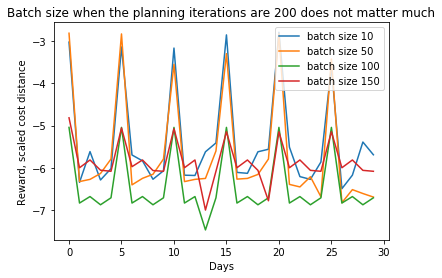

In [168]:
plt.figure()
plt.plot(reward_200_reg_batch_10, label = "batch size 10")
plt.plot(reward_200_reg_batch_50, label = "batch size 50")
plt.plot(reward_200_reg_batch_100, label = "batch size 100")
plt.plot(reward_200_reg_batch_150, label = "batch size 150")
plt.legend()
plt.title("Batch size when the planning iterations are 200 does not matter much")
plt.xlabel("Days")
plt.ylabel("Reward, scaled cost distance")
plt.show()

Text(0,0.5,'Reward, scaled cost distance')

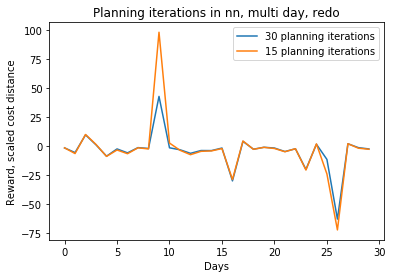

In [176]:
plt.figure()
plt.plot(reward_30_st_md, label = "30 planning iterations")
plt.plot(reward_15_st_md, label = "15 planning iterations")
plt.legend()
plt.title("Planning iterations in nn, multi day, redo")
plt.xlabel("Days")
plt.ylabel("Reward, scaled cost distance")

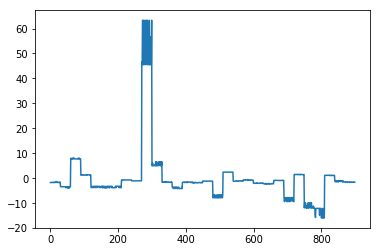

In [177]:
plt.figure()
plt.plot(planning_rewards_30_st_md)
plt.label()